# Aprendizagem HW 5 - Machine Learning

*   Diogo Silva, 98776
*   Tiago Melo, 98773





## Imports



* [tensorflow](https://www.tensorflow.org/): the neural network library
* [tensorflow_datasets](https://www.tensorflow.org/datasets): provides the datasets that we will use
* [numpy](https://numpy.org/): we will use it to store the data in array format for visualization
* [sklearn](https://scikit-learn.org/): provides a [PCA](https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html) implementation that we will use for visualization
* [matplotlib](https://matplotlib.org/): plotting library for visualization




In [2]:
import tensorflow as tf
import tensorflow_datasets as tfds

import numpy as np

import sklearn.decomposition
import matplotlib.pyplot as plt

from keras.utils import to_categorical

## Data

We will be using the [MNIST](https://archive.ics.uci.edu/ml/datasets/iris) dataset, which contains a number of handwritten digits: 
database of handwritten digits, available from this page, has a training set of 60,000 examples, and a test set of 10,000 examples. It is a subset of a larger set available from NIST.

### Load Datasets

In [3]:
mnist_data, mnist_info = tfds.load('mnist', with_info=True)

### Data Analysis & Profiling

In [4]:
print(mnist_info)

tfds.core.DatasetInfo(
    name='mnist',
    version=1.0.0,
    description='The MNIST database of handwritten digits.',
    urls=['https://storage.googleapis.com/cvdf-datasets/mnist/'],
    features=FeaturesDict({
        'image': Image(shape=(28, 28, 1), dtype=tf.uint8),
        'label': ClassLabel(shape=(), dtype=tf.int64, num_classes=10),
    }),
    total_num_examples=70000,
    splits={
        'test': 10000,
        'train': 60000,
    },
    supervised_keys=('image', 'label'),
    citation="""@article{lecun2010mnist,
      title={MNIST handwritten digit database},
      author={LeCun, Yann and Cortes, Corinna and Burges, CJ},
      journal={ATT Labs [Online]. Available: http://yann. lecun. com/exdb/mnist},
      volume={2},
      year={2010}
    }""",
    redistribution_info=,
)



So we know we have:

*   60 000 train samples (85.71%)
*   10 000 test samples (14.29%)

And that our inputs are images (of shape 28,28,1) and our labels are integers with 10 possible classes

#### Convert to NP Arrays

In [4]:
mnist_train_x = np.asarray([instance['image'] for instance in tfds.as_numpy(mnist_data['train'])])
mnist_train_y = np.asarray([instance['label'] for instance in tfds.as_numpy(mnist_data['train'])])

mnist_test_x = np.asarray([instance['image'] for instance in tfds.as_numpy(mnist_data['test'])])
mnist_test_y = np.asarray([instance['label'] for instance in tfds.as_numpy(mnist_data['test'])])

#### Examples

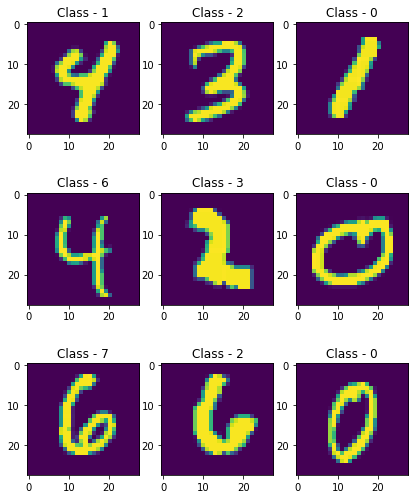

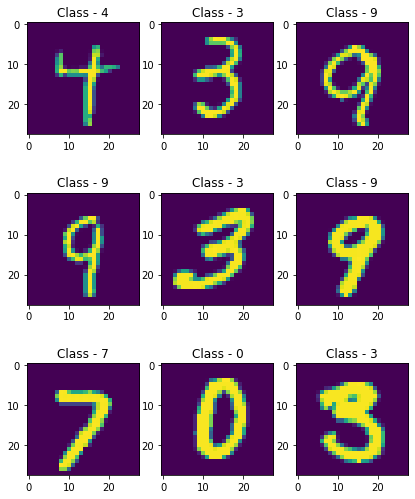

In [5]:
# Train Examples
plt.figure(figsize=(1.8 * 3, 2.4 * 3))
plt.title("Train Examples")

plt.subplots_adjust(bottom=0, left=.01, right=.99, top=.90, hspace=.35)

id = 1
for i in range(0,3):
  for j in range(0,3):
    rand_numb = np.random.randint(0, len(mnist_train_x))
    f, c = mnist_train_x[rand_numb].reshape(28,28), mnist_train_y[rand_numb]

    plt.subplot(3, 3, id)
    plt.imshow(f)
    plt.title("Class - " + str(c))
    

    id += 1

# Test Examples
plt.figure(figsize=(1.8 * 3, 2.4 * 3))
plt.title("Train Examples")

plt.subplots_adjust(bottom=0, left=.01, right=.99, top=.90, hspace=.35)

id = 1
for i in range(0,3):
  for j in range(0,3):
    rand_numb = np.random.randint(0, len(mnist_test_x))
    f, c = mnist_test_x[rand_numb].reshape(28,28), mnist_test_y[rand_numb]

    plt.subplot(3, 3, id)
    plt.imshow(f)
    plt.title("Class - " + str(c))
    

    id += 1

### Class Distribution

"\nfig, axs = plt.subplots(2)\nfig.suptitle('Number of samples per label')\n\noccurances = np.unique(mnist_train_y, return_counts=True)\n\naxs[0].bar(occurances[0], occurances[1], width=0.8)\naxs[0].set(xlabel='Class', ylabel='Occurances')\naxs[0].set_title('Train Set')\n\noccurances = np.unique(mnist_test_y, return_counts=True)\n\naxs[1].bar(occurances[0], occurances[1], width=0.8)\naxs[1].set(xlabel='Class', ylabel='Occurances')\naxs[1].set_title('Test Set')\n"

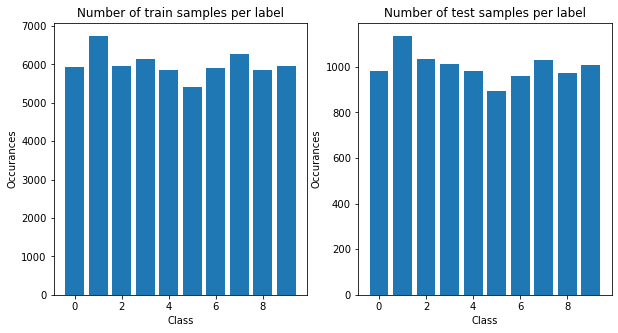

In [6]:
plt.figure(figsize=(10, 5))

occurances = np.unique(mnist_train_y, return_counts=True)

plt.subplot(1,2,1)
plt.bar(occurances[0], occurances[1], width=0.8)
plt.xlabel("Class")
plt.ylabel("Occurances")
plt.title("Number of train samples per label")

occurances = np.unique(mnist_test_y, return_counts=True)

plt.subplot(1,2,2)
plt.bar(occurances[0], occurances[1], width=0.8)
plt.xlabel("Class")
plt.ylabel("Occurances")
plt.title("Number of test samples per label")

'''
fig, axs = plt.subplots(2)
fig.suptitle('Number of samples per label')

occurances = np.unique(mnist_train_y, return_counts=True)

axs[0].bar(occurances[0], occurances[1], width=0.8)
axs[0].set(xlabel='Class', ylabel='Occurances')
axs[0].set_title('Train Set')

occurances = np.unique(mnist_test_y, return_counts=True)

axs[1].bar(occurances[0], occurances[1], width=0.8)
axs[1].set(xlabel='Class', ylabel='Occurances')
axs[1].set_title('Test Set')
'''

### Check if linearly separable

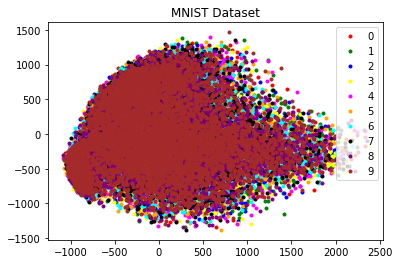

In [7]:
pca = sklearn.decomposition.PCA(n_components=2)
mnist_2d = pca.fit_transform(mnist_train_x.reshape((60000,28*28)))

mnist_classes = mnist_info.features['label'].names
colors = ['red', 'green', 'blue', 'yellow', 'magenta', 'orange', 'cyan', 'black', 'purple', 'brown']

plt.figure()
plt.title('MNIST Dataset')
for i in range(mnist_info.features['label'].num_classes):
    plt.plot(*mnist_2d[np.where(mnist_train_y==i)].T, colors[i],linestyle='none', marker='.', label=mnist_classes[i])
plt.legend(loc='best')
plt.show()

## Feed-Forward Networks

### Load & Preprocess Dataset

In [4]:
(ds_train, ds_test), ds_info = tfds.load(
    'mnist',
    split=['train', 'test'],
    shuffle_files=True,
    as_supervised=True,
    with_info=True,
)

In [5]:
full = mnist_info.splits['train'].num_examples
train_size = int(0.85 * full)
val_size = int(0.15 * full)

train_dataset = ds_train.take(train_size)
val_dataset = ds_train.skip(train_size)

print(train_dataset, val_dataset)

<TakeDataset shapes: ((28, 28, 1), ()), types: (tf.uint8, tf.int64)> <SkipDataset shapes: ((28, 28, 1), ()), types: (tf.uint8, tf.int64)>


In [6]:
def normalize_img(image, label):
  """Normalizes images: `uint8` -> `float32`."""
  return tf.cast(image, tf.float32) / 255., label

# Train Pipeline
ds_train = ds_train.map(
    normalize_img, num_parallel_calls=tf.data.experimental.AUTOTUNE) # TFDS provide the images as tf.uint8, while the model expect tf.float32, so normalize images
ds_train = ds_train.cache() # As the dataset fit in memory, cache before shuffling for better performance.
ds_train = ds_train.shuffle(ds_info.splits['train'].num_examples) # For true randomness, set the shuffle buffer to the full dataset size.
ds_train = ds_train.batch(128) # Batch after shuffling to get unique batches at each epoch.
ds_train = ds_train.prefetch(tf.data.experimental.AUTOTUNE) # Good practice to end the pipeline by prefetching for performances

# Validation Pipeline
ds_val = val_dataset.map(
    normalize_img, num_parallel_calls=tf.data.experimental.AUTOTUNE)
ds_val = ds_val.batch(128)
ds_val = ds_val.cache()
ds_val = ds_val.prefetch(tf.data.experimental.AUTOTUNE)

# Test Pipeline
ds_test = ds_test.map(
    normalize_img, num_parallel_calls=tf.data.experimental.AUTOTUNE)
ds_test = ds_test.batch(128)
ds_test = ds_test.cache()
ds_test = ds_test.prefetch(tf.data.experimental.AUTOTUNE)

### Models

In [7]:
#no_epochs = 10
no_epochs = 1000

#### Default Network

1 Hidden Layers
256 Neurons per hidden layer
Softmax Activation function

In [12]:
# Definition
default_layer_model = tf.keras.Sequential(name='default_net')
default_layer_model.add(tf.keras.layers.Input(mnist_info.features['image'].shape)) # Input
default_layer_model.add(tf.keras.layers.Flatten(input_shape=(28, 28))) # Flatten
default_layer_model.add(tf.keras.layers.Dense(256, activation='tanh', name='hidden')) # Hidden
default_layer_model.add(tf.keras.layers.Dense(mnist_info.features['label'].num_classes, activation='softmax', name='output')) #Output

default_layer_model.compile(loss='sparse_categorical_crossentropy', optimizer='sgd', metrics=['accuracy'])

default_layer_model.summary()


Model: "default_net"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten (Flatten)            (None, 784)               0         
_________________________________________________________________
hidden (Dense)               (None, 256)               200960    
_________________________________________________________________
output (Dense)               (None, 10)                2570      
Total params: 203,530
Trainable params: 203,530
Non-trainable params: 0
_________________________________________________________________


In [13]:
# Training

# Stopping Callbacks
earlystop = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=50, verbose=1)
checkpoint = tf.keras.callbacks.ModelCheckpoint('ff_default.h5', monitor='val_accuracy', verbose=1, save_best_only=True)

default_layer_model_train = default_layer_model.fit(ds_train, validation_data=ds_val, callbacks=[earlystop,checkpoint], epochs=no_epochs, batch_size=128)

Epoch 1/1000
    464/Unknown - 1s 1ms/step - loss: 0.9942 - accuracy: 0.7660
Epoch 00001: val_accuracy improved from -inf to 0.84933, saving model to ff_default.h5
469/469 [==============================] - 2s 4ms/step - loss: 0.9903 - accuracy: 0.7669 - val_loss: 0.6075 - val_accuracy: 0.8493
Epoch 2/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.5203 - accuracy: 0.8688
Epoch 00002: val_accuracy improved from 0.84933 to 0.87333, saving model to ff_default.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.5171 - accuracy: 0.8698 - val_loss: 0.4748 - val_accuracy: 0.8733
Epoch 3/1000
467/469 [============================>.] - ETA: 0s - loss: 0.4335 - accuracy: 0.8840
Epoch 00003: val_accuracy improved from 0.87333 to 0.88333, saving model to ff_default.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.4331 - accuracy: 0.8841 - val_loss: 0.4227 - val_accuracy: 0.8833
Epoch 4/1000
437/469 [==========================>...] - ETA: 0s - l

Epoch 27/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.2403 - accuracy: 0.9332
Epoch 00027: val_accuracy improved from 0.92811 to 0.92944, saving model to ff_default.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.2401 - accuracy: 0.9332 - val_loss: 0.2498 - val_accuracy: 0.9294
Epoch 28/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.2365 - accuracy: 0.9344
Epoch 00028: val_accuracy did not improve from 0.92944
469/469 [==============================] - 1s 1ms/step - loss: 0.2369 - accuracy: 0.9343 - val_loss: 0.2468 - val_accuracy: 0.9291
Epoch 29/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.2332 - accuracy: 0.9351
Epoch 00029: val_accuracy improved from 0.92944 to 0.93167, saving model to ff_default.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.2339 - accuracy: 0.9347 - val_loss: 0.2437 - val_accuracy: 0.9317
Epoch 30/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.

Epoch 53/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.1764 - accuracy: 0.9505
Epoch 00053: val_accuracy improved from 0.94733 to 0.94944, saving model to ff_default.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.1754 - accuracy: 0.9509 - val_loss: 0.1822 - val_accuracy: 0.9494
Epoch 54/1000
460/469 [============================>.] - ETA: 0s - loss: 0.1738 - accuracy: 0.9515
Epoch 00054: val_accuracy did not improve from 0.94944
469/469 [==============================] - 1s 1ms/step - loss: 0.1736 - accuracy: 0.9515 - val_loss: 0.1804 - val_accuracy: 0.9490
Epoch 55/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.1713 - accuracy: 0.9526
Epoch 00055: val_accuracy improved from 0.94944 to 0.94978, saving model to ff_default.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.1717 - accuracy: 0.9524 - val_loss: 0.1784 - val_accuracy: 0.9498
Epoch 56/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.

Epoch 106/1000
467/469 [============================>.] - ETA: 0s - loss: 0.1086 - accuracy: 0.9700
Epoch 00106: val_accuracy improved from 0.96978 to 0.97044, saving model to ff_default.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.1085 - accuracy: 0.9700 - val_loss: 0.1129 - val_accuracy: 0.9704
Epoch 107/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.1081 - accuracy: 0.9705
Epoch 00107: val_accuracy did not improve from 0.97044
469/469 [==============================] - 1s 1ms/step - loss: 0.1077 - accuracy: 0.9705 - val_loss: 0.1120 - val_accuracy: 0.9703
Epoch 108/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.1068 - accuracy: 0.9704
Epoch 00108: val_accuracy improved from 0.97044 to 0.97056, saving model to ff_default.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.1069 - accuracy: 0.9704 - val_loss: 0.1111 - val_accuracy: 0.9706
Epoch 109/1000
421/469 [=========================>....] - ETA: 0s - loss

Epoch 133/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.0904 - accuracy: 0.9757 ETA: 0s - loss: 0.0913 - accuracy: 
Epoch 00133: val_accuracy did not improve from 0.97533
469/469 [==============================] - 1s 1ms/step - loss: 0.0898 - accuracy: 0.9757 - val_loss: 0.0937 - val_accuracy: 0.9752
Epoch 134/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.0894 - accuracy: 0.9757
Epoch 00134: val_accuracy improved from 0.97533 to 0.97544, saving model to ff_default.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0892 - accuracy: 0.9758 - val_loss: 0.0930 - val_accuracy: 0.9754
Epoch 135/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.0887 - accuracy: 0.9755
Epoch 00135: val_accuracy improved from 0.97544 to 0.97611, saving model to ff_default.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0886 - accuracy: 0.9757 - val_loss: 0.0930 - val_accuracy: 0.9761
Epoch 136/1000
435/469 [============

Epoch 188/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.0653 - accuracy: 0.9835
Epoch 00188: val_accuracy did not improve from 0.98322
469/469 [==============================] - 1s 1ms/step - loss: 0.0652 - accuracy: 0.9833 - val_loss: 0.0692 - val_accuracy: 0.9824
Epoch 189/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.0651 - accuracy: 0.9833
Epoch 00189: val_accuracy did not improve from 0.98322
469/469 [==============================] - 1s 1ms/step - loss: 0.0649 - accuracy: 0.9834 - val_loss: 0.0686 - val_accuracy: 0.9829
Epoch 190/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.0640 - accuracy: 0.9835
Epoch 00190: val_accuracy improved from 0.98322 to 0.98333, saving model to ff_default.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0645 - accuracy: 0.9835 - val_loss: 0.0682 - val_accuracy: 0.9833
Epoch 191/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.0642 - accuracy: 0.9838
Epoch 0

Epoch 216/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.0568 - accuracy: 0.9857
Epoch 00216: val_accuracy did not improve from 0.98511
469/469 [==============================] - 1s 1ms/step - loss: 0.0567 - accuracy: 0.9857 - val_loss: 0.0604 - val_accuracy: 0.9847
Epoch 217/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0566 - accuracy: 0.9856
Epoch 00217: val_accuracy did not improve from 0.98511
469/469 [==============================] - 1s 1ms/step - loss: 0.0564 - accuracy: 0.9857 - val_loss: 0.0600 - val_accuracy: 0.9851
Epoch 218/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.0561 - accuracy: 0.9860
Epoch 00218: val_accuracy improved from 0.98511 to 0.98522, saving model to ff_default.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0561 - accuracy: 0.9859 - val_loss: 0.0600 - val_accuracy: 0.9852
Epoch 219/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.0562 - accuracy: 0.9859
Epoch 0

Epoch 271/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.0437 - accuracy: 0.9897
Epoch 00271: val_accuracy did not improve from 0.98867
469/469 [==============================] - 1s 1ms/step - loss: 0.0441 - accuracy: 0.9896 - val_loss: 0.0475 - val_accuracy: 0.9887
Epoch 272/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.0437 - accuracy: 0.9898
Epoch 00272: val_accuracy did not improve from 0.98867
469/469 [==============================] - 1s 1ms/step - loss: 0.0440 - accuracy: 0.9896 - val_loss: 0.0473 - val_accuracy: 0.9884
Epoch 273/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.0436 - accuracy: 0.9896
Epoch 00273: val_accuracy improved from 0.98867 to 0.98911, saving model to ff_default.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0437 - accuracy: 0.9897 - val_loss: 0.0471 - val_accuracy: 0.9891
Epoch 274/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.0436 - accuracy: 0.9899
Epoch 0

Epoch 299/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.0388 - accuracy: 0.9913
Epoch 00299: val_accuracy improved from 0.99078 to 0.99100, saving model to ff_default.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0393 - accuracy: 0.9913 - val_loss: 0.0424 - val_accuracy: 0.9910
Epoch 300/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.0392 - accuracy: 0.9913
Epoch 00300: val_accuracy did not improve from 0.99100
469/469 [==============================] - 1s 1ms/step - loss: 0.0391 - accuracy: 0.9913 - val_loss: 0.0423 - val_accuracy: 0.9906
Epoch 301/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.0385 - accuracy: 0.9914
Epoch 00301: val_accuracy did not improve from 0.99100
469/469 [==============================] - 1s 1ms/step - loss: 0.0390 - accuracy: 0.9913 - val_loss: 0.0420 - val_accuracy: 0.9907
Epoch 302/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.0389 - accuracy: 0.9915
Epoch 0

445/469 [===========================>..] - ETA: 0s - loss: 0.0354 - accuracy: 0.9924
Epoch 00327: val_accuracy did not improve from 0.99178
469/469 [==============================] - 1s 1ms/step - loss: 0.0351 - accuracy: 0.9924 - val_loss: 0.0380 - val_accuracy: 0.9918
Epoch 328/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.0348 - accuracy: 0.9924
Epoch 00328: val_accuracy did not improve from 0.99178
469/469 [==============================] - 1s 1ms/step - loss: 0.0349 - accuracy: 0.9924 - val_loss: 0.0380 - val_accuracy: 0.9914
Epoch 329/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.0352 - accuracy: 0.9924
Epoch 00329: val_accuracy did not improve from 0.99178
469/469 [==============================] - 1s 1ms/step - loss: 0.0348 - accuracy: 0.9925 - val_loss: 0.0377 - val_accuracy: 0.9917
Epoch 330/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.0347 - accuracy: 0.9925
Epoch 00330: val_accuracy did not improve from 0.99178
46

Epoch 355/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.0316 - accuracy: 0.9936
Epoch 00355: val_accuracy did not improve from 0.99256
469/469 [==============================] - 1s 1ms/step - loss: 0.0315 - accuracy: 0.9935 - val_loss: 0.0344 - val_accuracy: 0.9924
Epoch 356/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.0310 - accuracy: 0.9935
Epoch 00356: val_accuracy did not improve from 0.99256
469/469 [==============================] - 1s 1ms/step - loss: 0.0314 - accuracy: 0.9936 - val_loss: 0.0342 - val_accuracy: 0.9926
Epoch 357/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.0314 - accuracy: 0.9934
Epoch 00357: val_accuracy improved from 0.99256 to 0.99267, saving model to ff_default.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0313 - accuracy: 0.9935 - val_loss: 0.0340 - val_accuracy: 0.9927
Epoch 358/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.0313 - accuracy: 0.9936
Epoch 0

Epoch 383/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.0285 - accuracy: 0.9945
Epoch 00383: val_accuracy did not improve from 0.99378
469/469 [==============================] - 1s 1ms/step - loss: 0.0284 - accuracy: 0.9945 - val_loss: 0.0310 - val_accuracy: 0.9936
Epoch 384/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.0280 - accuracy: 0.9944
Epoch 00384: val_accuracy did not improve from 0.99378
469/469 [==============================] - 1s 1ms/step - loss: 0.0283 - accuracy: 0.9945 - val_loss: 0.0309 - val_accuracy: 0.9937
Epoch 385/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.0284 - accuracy: 0.9945
Epoch 00385: val_accuracy did not improve from 0.99378
469/469 [==============================] - 1s 1ms/step - loss: 0.0282 - accuracy: 0.9946 - val_loss: 0.0308 - val_accuracy: 0.9938
Epoch 386/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.0281 - accuracy: 0.9945
Epoch 00386: val_accuracy did not improve 

Epoch 411/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.0256 - accuracy: 0.9953
Epoch 00411: val_accuracy did not improve from 0.99478
469/469 [==============================] - 1s 1ms/step - loss: 0.0257 - accuracy: 0.9953 - val_loss: 0.0281 - val_accuracy: 0.9948
Epoch 412/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.0255 - accuracy: 0.9954
Epoch 00412: val_accuracy did not improve from 0.99478
469/469 [==============================] - 1s 1ms/step - loss: 0.0256 - accuracy: 0.9954 - val_loss: 0.0281 - val_accuracy: 0.9946
Epoch 413/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.0256 - accuracy: 0.9952
Epoch 00413: val_accuracy did not improve from 0.99478
469/469 [==============================] - 1s 1ms/step - loss: 0.0255 - accuracy: 0.9953 - val_loss: 0.0279 - val_accuracy: 0.9948
Epoch 414/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.0254 - accuracy: 0.9954
Epoch 00414: val_accuracy improved from 0.

433/469 [==========================>...] - ETA: 0s - loss: 0.0233 - accuracy: 0.9959
Epoch 00439: val_accuracy did not improve from 0.99544
469/469 [==============================] - 1s 1ms/step - loss: 0.0233 - accuracy: 0.9959 - val_loss: 0.0256 - val_accuracy: 0.9952
Epoch 440/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0230 - accuracy: 0.9961
Epoch 00440: val_accuracy did not improve from 0.99544
469/469 [==============================] - 1s 1ms/step - loss: 0.0232 - accuracy: 0.9960 - val_loss: 0.0255 - val_accuracy: 0.9953
Epoch 441/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.0233 - accuracy: 0.9959
Epoch 00441: val_accuracy did not improve from 0.99544
469/469 [==============================] - 1s 1ms/step - loss: 0.0231 - accuracy: 0.9959 - val_loss: 0.0254 - val_accuracy: 0.9953
Epoch 442/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.0230 - accuracy: 0.9961
Epoch 00442: val_accuracy did not improve from 0.99544
46

432/469 [==========================>...] - ETA: 0s - loss: 0.0193 - accuracy: 0.9973
Epoch 00495: val_accuracy did not improve from 0.99667
469/469 [==============================] - 1s 1ms/step - loss: 0.0193 - accuracy: 0.9973 - val_loss: 0.0213 - val_accuracy: 0.9967
Epoch 496/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.0189 - accuracy: 0.9974
Epoch 00496: val_accuracy did not improve from 0.99667
469/469 [==============================] - 1s 1ms/step - loss: 0.0193 - accuracy: 0.9973 - val_loss: 0.0213 - val_accuracy: 0.9966
Epoch 497/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.0193 - accuracy: 0.9975
Epoch 00497: val_accuracy did not improve from 0.99667
469/469 [==============================] - 1s 1ms/step - loss: 0.0192 - accuracy: 0.9974 - val_loss: 0.0211 - val_accuracy: 0.9967
Epoch 498/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.0190 - accuracy: 0.9974
Epoch 00498: val_accuracy did not improve from 0.99667
46

Epoch 524/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0177 - accuracy: 0.9977
Epoch 00524: val_accuracy did not improve from 0.99700
469/469 [==============================] - 1s 1ms/step - loss: 0.0176 - accuracy: 0.9977 - val_loss: 0.0194 - val_accuracy: 0.9969
Epoch 525/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.0175 - accuracy: 0.9978
Epoch 00525: val_accuracy did not improve from 0.99700
469/469 [==============================] - 1s 1ms/step - loss: 0.0176 - accuracy: 0.9978 - val_loss: 0.0195 - val_accuracy: 0.9970
Epoch 526/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.0177 - accuracy: 0.9976
Epoch 00526: val_accuracy did not improve from 0.99700
469/469 [==============================] - 1s 1ms/step - loss: 0.0175 - accuracy: 0.9977 - val_loss: 0.0194 - val_accuracy: 0.9970
Epoch 527/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.0175 - accuracy: 0.9979
Epoch 00527: val_accuracy did not improve 

416/469 [=========================>....] - ETA: 0s - loss: 0.0150 - accuracy: 0.9983
Epoch 00580: val_accuracy did not improve from 0.99778
469/469 [==============================] - 1s 1ms/step - loss: 0.0149 - accuracy: 0.9983 - val_loss: 0.0166 - val_accuracy: 0.9976
Epoch 581/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0148 - accuracy: 0.9983
Epoch 00581: val_accuracy did not improve from 0.99778
469/469 [==============================] - 1s 1ms/step - loss: 0.0149 - accuracy: 0.9983 - val_loss: 0.0165 - val_accuracy: 0.9978
Epoch 582/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.0148 - accuracy: 0.9983
Epoch 00582: val_accuracy improved from 0.99778 to 0.99789, saving model to ff_default.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0148 - accuracy: 0.9983 - val_loss: 0.0165 - val_accuracy: 0.9979
Epoch 583/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.0145 - accuracy: 0.9984
Epoch 00583: val_accur

463/469 [============================>.] - ETA: 0s - loss: 0.0127 - accuracy: 0.9989
Epoch 00636: val_accuracy did not improve from 0.99867
469/469 [==============================] - 1s 1ms/step - loss: 0.0128 - accuracy: 0.9989 - val_loss: 0.0141 - val_accuracy: 0.9986
Epoch 637/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.0129 - accuracy: 0.9989
Epoch 00637: val_accuracy improved from 0.99867 to 0.99878, saving model to ff_default.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0127 - accuracy: 0.9989 - val_loss: 0.0141 - val_accuracy: 0.9988
Epoch 638/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0126 - accuracy: 0.9989
Epoch 00638: val_accuracy did not improve from 0.99878
469/469 [==============================] - 1s 1ms/step - loss: 0.0127 - accuracy: 0.9989 - val_loss: 0.0141 - val_accuracy: 0.9987
Epoch 639/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.0128 - accuracy: 0.9989
Epoch 00639: val_accur

Epoch 693/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.0110 - accuracy: 0.9993
Epoch 00693: val_accuracy did not improve from 0.99889
469/469 [==============================] - 1s 1ms/step - loss: 0.0110 - accuracy: 0.9993 - val_loss: 0.0122 - val_accuracy: 0.9989
Epoch 694/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.0109 - accuracy: 0.9994
Epoch 00694: val_accuracy did not improve from 0.99889
469/469 [==============================] - 1s 1ms/step - loss: 0.0110 - accuracy: 0.9994 - val_loss: 0.0122 - val_accuracy: 0.9988
Epoch 695/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.0109 - accuracy: 0.9993
Epoch 00695: val_accuracy improved from 0.99889 to 0.99900, saving model to ff_default.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0109 - accuracy: 0.9993 - val_loss: 0.0121 - val_accuracy: 0.9990
Epoch 696/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.0109 - accuracy: 0.9994
Epoch 0

Epoch 722/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.0102 - accuracy: 0.9994
Epoch 00722: val_accuracy did not improve from 0.99900
469/469 [==============================] - 1s 1ms/step - loss: 0.0102 - accuracy: 0.9994 - val_loss: 0.0113 - val_accuracy: 0.9990
Epoch 723/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.0102 - accuracy: 0.9994
Epoch 00723: val_accuracy did not improve from 0.99900
469/469 [==============================] - 1s 1ms/step - loss: 0.0102 - accuracy: 0.9994 - val_loss: 0.0113 - val_accuracy: 0.9989
Epoch 724/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0101 - accuracy: 0.9994
Epoch 00724: val_accuracy did not improve from 0.99900
469/469 [==============================] - 1s 1ms/step - loss: 0.0102 - accuracy: 0.9994 - val_loss: 0.0112 - val_accuracy: 0.9990
Epoch 725/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.0102 - accuracy: 0.9994
Epoch 00725: val_accuracy did not improve 

Epoch 751/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.0095 - accuracy: 0.9994
Epoch 00751: val_accuracy did not improve from 0.99911
469/469 [==============================] - 1s 1ms/step - loss: 0.0095 - accuracy: 0.9994 - val_loss: 0.0105 - val_accuracy: 0.9990
Epoch 752/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.0095 - accuracy: 0.9995
Epoch 00752: val_accuracy did not improve from 0.99911
469/469 [==============================] - 1s 1ms/step - loss: 0.0095 - accuracy: 0.9994 - val_loss: 0.0105 - val_accuracy: 0.9990
Epoch 753/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.0095 - accuracy: 0.9994
Epoch 00753: val_accuracy did not improve from 0.99911
469/469 [==============================] - 1s 1ms/step - loss: 0.0095 - accuracy: 0.9994 - val_loss: 0.0105 - val_accuracy: 0.9991
Epoch 754/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.0095 - accuracy: 0.9994
Epoch 00754: val_accuracy did not improve 

Epoch 780/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.0089 - accuracy: 0.9995
Epoch 00780: val_accuracy did not improve from 0.99922
469/469 [==============================] - 1s 1ms/step - loss: 0.0089 - accuracy: 0.9995 - val_loss: 0.0098 - val_accuracy: 0.9991
Epoch 781/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.0090 - accuracy: 0.9995
Epoch 00781: val_accuracy did not improve from 0.99922
469/469 [==============================] - 1s 1ms/step - loss: 0.0089 - accuracy: 0.9995 - val_loss: 0.0098 - val_accuracy: 0.9992
Epoch 782/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.0089 - accuracy: 0.9995
Epoch 00782: val_accuracy did not improve from 0.99922
469/469 [==============================] - 1s 1ms/step - loss: 0.0089 - accuracy: 0.9995 - val_loss: 0.0097 - val_accuracy: 0.9992
Epoch 783/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0089 - accuracy: 0.9995
Epoch 00783: val_accuracy did not improve 

Epoch 809/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.0084 - accuracy: 0.9995
Epoch 00809: val_accuracy did not improve from 0.99944
469/469 [==============================] - 1s 1ms/step - loss: 0.0083 - accuracy: 0.9995 - val_loss: 0.0091 - val_accuracy: 0.9994
Epoch 810/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.0083 - accuracy: 0.9995
Epoch 00810: val_accuracy did not improve from 0.99944
469/469 [==============================] - 1s 1ms/step - loss: 0.0083 - accuracy: 0.9996 - val_loss: 0.0091 - val_accuracy: 0.9994
Epoch 811/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.0083 - accuracy: 0.9996
Epoch 00811: val_accuracy did not improve from 0.99944
469/469 [==============================] - 1s 1ms/step - loss: 0.0083 - accuracy: 0.9996 - val_loss: 0.0091 - val_accuracy: 0.9994
Epoch 812/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0083 - accuracy: 0.9996
Epoch 00812: val_accuracy did not improve 

Epoch 838/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0079 - accuracy: 0.9996
Epoch 00838: val_accuracy did not improve from 0.99944
469/469 [==============================] - 1s 1ms/step - loss: 0.0078 - accuracy: 0.9996 - val_loss: 0.0086 - val_accuracy: 0.9994
Epoch 839/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0078 - accuracy: 0.9996
Epoch 00839: val_accuracy did not improve from 0.99944
469/469 [==============================] - 1s 1ms/step - loss: 0.0078 - accuracy: 0.9996 - val_loss: 0.0085 - val_accuracy: 0.9994
Epoch 840/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.0079 - accuracy: 0.9996
Epoch 00840: val_accuracy did not improve from 0.99944
469/469 [==============================] - 1s 1ms/step - loss: 0.0078 - accuracy: 0.9996 - val_loss: 0.0085 - val_accuracy: 0.9994
Epoch 841/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.0078 - accuracy: 0.9996
Epoch 00841: val_accuracy did not improve 

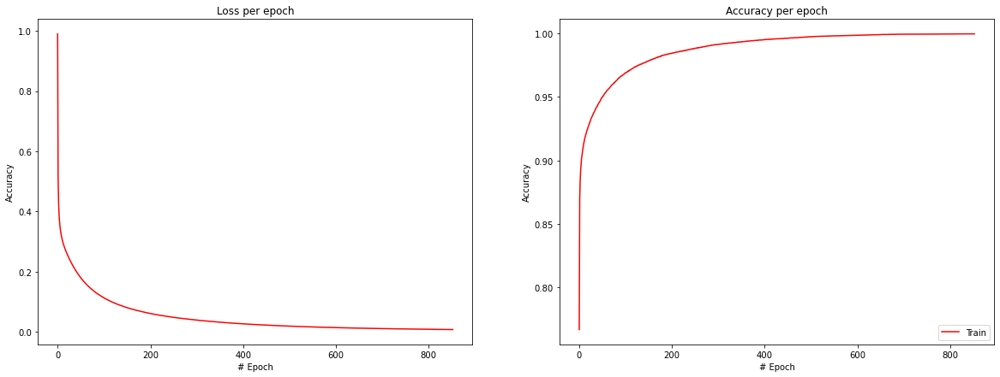

In [14]:
# Evaluation
# Train 
fig, (loss_ax, acc_ax) = plt.subplots(1, 2, figsize=(20,7))

loss_ax.set_title('Loss per epoch')
loss_ax.plot(default_layer_model_train.history['loss'], '-r', label='Train')
loss_ax.set(xlabel='# Epoch', ylabel='Accuracy')

acc_ax.set_title('Accuracy per epoch')
acc_ax.plot(default_layer_model_train.history['accuracy'], '-r', label='Train')
acc_ax.set(xlabel='# Epoch', ylabel='Accuracy')

plt.legend(loc=4)
plt.show()

In [15]:
# Final Accuracy / Loss
default_layer_model.evaluate(ds_test)

79/79 [==============================] - 0s 6ms/step - loss: 0.0624 - accuracy: 0.9808


[0.062390875071287155, 0.9807999730110168]

#### Number of neurons in the hidden layer
16, 128, 256, 512, 1024, 2048 Neurons per hidden layer

In [13]:
arr = [16, 128, 256, 512, 1024, 2048]
#arr = [16, 128]
histories = []
test_accuracies = []

for neuron in arr:
  # Definition
  cur_model = tf.keras.Sequential(name='ff_variable_neurons_' + str(neuron))
  cur_model.add(tf.keras.layers.Input(mnist_info.features['image'].shape)) # Input
  cur_model.add(tf.keras.layers.Flatten(input_shape=(28, 28))) # Flatten
  cur_model.add(tf.keras.layers.Dense(neuron, activation='tanh', name='hidden')) # Hidden
  cur_model.add(tf.keras.layers.Dense(mnist_info.features['label'].num_classes, activation='softmax', name='output')) #Output

  cur_model.compile(loss='sparse_categorical_crossentropy', optimizer='sgd', metrics=['accuracy'])

  # Stopping Callbacks
  earlystop = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=50, verbose=1)
  checkpoint = tf.keras.callbacks.ModelCheckpoint('ff_variable_neuron_' + str(neuron) + '.h5', monitor='val_accuracy', verbose=1, save_best_only=True)

  histories += [cur_model.fit(ds_train, validation_data=ds_val, callbacks=[earlystop,checkpoint], epochs=no_epochs, batch_size=128)]

  test_accuracies += [cur_model.evaluate(ds_test)]

Epoch 1/1000
    387/Unknown - 0s 517us/step - loss: 1.4667 - accuracy: 0.6209
Epoch 00001: val_accuracy improved from -inf to 0.77011, saving model to ff_variable_neuron_16.h5
469/469 [==============================] - 1s 3ms/step - loss: 1.3890 - accuracy: 0.6464 - val_loss: 0.9891 - val_accuracy: 0.7701
Epoch 2/1000
378/469 [=======================>......] - ETA: 0s - loss: 0.8592 - accuracy: 0.8043
Epoch 00002: val_accuracy improved from 0.77011 to 0.82844, saving model to ff_variable_neuron_16.h5
469/469 [==============================] - 0s 670us/step - loss: 0.8358 - accuracy: 0.8091 - val_loss: 0.7294 - val_accuracy: 0.8284
Epoch 3/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.6604 - accuracy: 0.8457
Epoch 00003: val_accuracy improved from 0.82844 to 0.85222, saving model to ff_variable_neuron_16.h5
469/469 [==============================] - 0s 648us/step - loss: 0.6515 - accuracy: 0.8472 - val_loss: 0.6027 - val_accuracy: 0.8522
Epoch 4/1000
393/469 [======

Epoch 26/1000
464/469 [============================>.] - ETA: 0s - loss: 0.2776 - accuracy: 0.9211
Epoch 00026: val_accuracy improved from 0.91600 to 0.91722, saving model to ff_variable_neuron_16.h5
469/469 [==============================] - 0s 688us/step - loss: 0.2777 - accuracy: 0.9212 - val_loss: 0.2868 - val_accuracy: 0.9172
Epoch 27/1000
454/469 [============================>.] - ETA: 0s - loss: 0.2745 - accuracy: 0.9214
Epoch 00027: val_accuracy improved from 0.91722 to 0.91833, saving model to ff_variable_neuron_16.h5
469/469 [==============================] - 0s 689us/step - loss: 0.2749 - accuracy: 0.9215 - val_loss: 0.2831 - val_accuracy: 0.9183
Epoch 28/1000
379/469 [=======================>......] - ETA: 0s - loss: 0.2731 - accuracy: 0.9222
Epoch 00028: val_accuracy did not improve from 0.91833
469/469 [==============================] - 0s 648us/step - loss: 0.2721 - accuracy: 0.9229 - val_loss: 0.2811 - val_accuracy: 0.9179
Epoch 29/1000
393/469 [========================

394/469 [========================>.....] - ETA: 0s - loss: 0.2038 - accuracy: 0.9420
Epoch 00077: val_accuracy improved from 0.94056 to 0.94078, saving model to ff_variable_neuron_16.h5
469/469 [==============================] - 0s 646us/step - loss: 0.2028 - accuracy: 0.9422 - val_loss: 0.2094 - val_accuracy: 0.9408
Epoch 78/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.2007 - accuracy: 0.9426
Epoch 00078: val_accuracy improved from 0.94078 to 0.94156, saving model to ff_variable_neuron_16.h5
469/469 [==============================] - 0s 668us/step - loss: 0.2021 - accuracy: 0.9424 - val_loss: 0.2083 - val_accuracy: 0.9416
Epoch 79/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.2015 - accuracy: 0.9428
Epoch 00079: val_accuracy improved from 0.94156 to 0.94211, saving model to ff_variable_neuron_16.h5
469/469 [==============================] - 0s 664us/step - loss: 0.2015 - accuracy: 0.9431 - val_loss: 0.2075 - val_accuracy: 0.9421
Epoch 80/1000
3

Epoch 104/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.1849 - accuracy: 0.9476
Epoch 00104: val_accuracy did not improve from 0.94589
469/469 [==============================] - 0s 629us/step - loss: 0.1862 - accuracy: 0.9470 - val_loss: 0.1914 - val_accuracy: 0.9459
Epoch 105/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.1860 - accuracy: 0.9471
Epoch 00105: val_accuracy improved from 0.94589 to 0.94600, saving model to ff_variable_neuron_16.h5
469/469 [==============================] - 0s 648us/step - loss: 0.1858 - accuracy: 0.9472 - val_loss: 0.1909 - val_accuracy: 0.9460
Epoch 106/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.1854 - accuracy: 0.9473
Epoch 00106: val_accuracy did not improve from 0.94600
469/469 [==============================] - 0s 638us/step - loss: 0.1852 - accuracy: 0.9473 - val_loss: 0.1905 - val_accuracy: 0.9458
Epoch 107/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.1858 - accurac

Epoch 158/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.1656 - accuracy: 0.9528
Epoch 00158: val_accuracy did not improve from 0.95233
469/469 [==============================] - 0s 676us/step - loss: 0.1652 - accuracy: 0.9529 - val_loss: 0.1694 - val_accuracy: 0.9522
Epoch 159/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.1654 - accuracy: 0.9531
Epoch 00159: val_accuracy did not improve from 0.95233
469/469 [==============================] - 0s 627us/step - loss: 0.1650 - accuracy: 0.9530 - val_loss: 0.1692 - val_accuracy: 0.9522
Epoch 160/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.1643 - accuracy: 0.9536
Epoch 00160: val_accuracy did not improve from 0.95233
469/469 [==============================] - 0s 631us/step - loss: 0.1647 - accuracy: 0.9531 - val_loss: 0.1688 - val_accuracy: 0.9521
Epoch 161/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.1651 - accuracy: 0.9530
Epoch 00161: val_accuracy improved f

Epoch 213/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.1508 - accuracy: 0.9570
Epoch 00213: val_accuracy did not improve from 0.95622
469/469 [==============================] - 0s 621us/step - loss: 0.1509 - accuracy: 0.9567 - val_loss: 0.1543 - val_accuracy: 0.9561
Epoch 214/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.1513 - accuracy: 0.9562
Epoch 00214: val_accuracy did not improve from 0.95622
469/469 [==============================] - 0s 629us/step - loss: 0.1506 - accuracy: 0.9565 - val_loss: 0.1544 - val_accuracy: 0.9557
Epoch 215/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.1501 - accuracy: 0.9567
Epoch 00215: val_accuracy did not improve from 0.95622
469/469 [==============================] - 0s 631us/step - loss: 0.1505 - accuracy: 0.9565 - val_loss: 0.1537 - val_accuracy: 0.9559
Epoch 216/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.1501 - accuracy: 0.9571
Epoch 00216: val_accuracy did not im

Epoch 268/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.1383 - accuracy: 0.9606
Epoch 00268: val_accuracy did not improve from 0.95933
469/469 [==============================] - 0s 623us/step - loss: 0.1402 - accuracy: 0.9595 - val_loss: 0.1431 - val_accuracy: 0.9590
Epoch 269/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.1381 - accuracy: 0.9601
Epoch 00269: val_accuracy did not improve from 0.95933
469/469 [==============================] - 0s 628us/step - loss: 0.1400 - accuracy: 0.9596 - val_loss: 0.1427 - val_accuracy: 0.9593
Epoch 270/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.1418 - accuracy: 0.9591
Epoch 00270: val_accuracy did not improve from 0.95933
469/469 [==============================] - 0s 629us/step - loss: 0.1398 - accuracy: 0.9595 - val_loss: 0.1429 - val_accuracy: 0.9588
Epoch 271/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.1419 - accuracy: 0.9594
Epoch 00271: val_accuracy improved f

Epoch 296/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.1351 - accuracy: 0.9606
Epoch 00296: val_accuracy improved from 0.96067 to 0.96100, saving model to ff_variable_neuron_16.h5
469/469 [==============================] - 0s 655us/step - loss: 0.1356 - accuracy: 0.9608 - val_loss: 0.1389 - val_accuracy: 0.9610
Epoch 297/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.1347 - accuracy: 0.9609
Epoch 00297: val_accuracy did not improve from 0.96100
469/469 [==============================] - 0s 629us/step - loss: 0.1354 - accuracy: 0.9608 - val_loss: 0.1387 - val_accuracy: 0.9610
Epoch 298/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.1354 - accuracy: 0.9607
Epoch 00298: val_accuracy did not improve from 0.96100
469/469 [==============================] - 0s 633us/step - loss: 0.1353 - accuracy: 0.9607 - val_loss: 0.1381 - val_accuracy: 0.9604
Epoch 299/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.1349 - accurac

Epoch 324/1000
378/469 [=======================>......] - ETA: 0s - loss: 0.1327 - accuracy: 0.9618
Epoch 00324: val_accuracy did not improve from 0.96189
469/469 [==============================] - 0s 648us/step - loss: 0.1314 - accuracy: 0.9618 - val_loss: 0.1344 - val_accuracy: 0.9614
Epoch 325/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.1313 - accuracy: 0.9615
Epoch 00325: val_accuracy did not improve from 0.96189
469/469 [==============================] - 0s 631us/step - loss: 0.1313 - accuracy: 0.9618 - val_loss: 0.1341 - val_accuracy: 0.9616
Epoch 326/1000
372/469 [======================>.......] - ETA: 0s - loss: 0.1297 - accuracy: 0.9627
Epoch 00326: val_accuracy did not improve from 0.96189
469/469 [==============================] - 0s 650us/step - loss: 0.1312 - accuracy: 0.9619 - val_loss: 0.1341 - val_accuracy: 0.9616
Epoch 327/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.1322 - accuracy: 0.9620
Epoch 00327: val_accuracy did not im

Epoch 380/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.1239 - accuracy: 0.9646
Epoch 00380: val_accuracy improved from 0.96444 to 0.96478, saving model to ff_variable_neuron_16.h5
469/469 [==============================] - 0s 650us/step - loss: 0.1243 - accuracy: 0.9641 - val_loss: 0.1267 - val_accuracy: 0.9648
Epoch 381/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.1230 - accuracy: 0.9642
Epoch 00381: val_accuracy did not improve from 0.96478
469/469 [==============================] - 0s 631us/step - loss: 0.1241 - accuracy: 0.9638 - val_loss: 0.1267 - val_accuracy: 0.9646
Epoch 382/1000
377/469 [=======================>......] - ETA: 0s - loss: 0.1246 - accuracy: 0.9632
Epoch 00382: val_accuracy did not improve from 0.96478
469/469 [==============================] - 0s 646us/step - loss: 0.1240 - accuracy: 0.9635 - val_loss: 0.1269 - val_accuracy: 0.9648
Epoch 383/1000
373/469 [======================>.......] - ETA: 0s - loss: 0.1229 - accurac

469/469 [==============================] - 0s 680us/step - loss: 0.1212 - accuracy: 0.9652 - val_loss: 0.1235 - val_accuracy: 0.9662
Epoch 408/1000
381/469 [=======================>......] - ETA: 0s - loss: 0.1215 - accuracy: 0.9652
Epoch 00408: val_accuracy did not improve from 0.96622
469/469 [==============================] - 0s 638us/step - loss: 0.1211 - accuracy: 0.9651 - val_loss: 0.1233 - val_accuracy: 0.9656
Epoch 409/1000
469/469 [==============================] - ETA: 0s - loss: 0.1210 - accuracy: 0.9650
Epoch 00409: val_accuracy did not improve from 0.96622
469/469 [==============================] - 0s 655us/step - loss: 0.1210 - accuracy: 0.9650 - val_loss: 0.1236 - val_accuracy: 0.9661
Epoch 410/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.1196 - accuracy: 0.9659
Epoch 00410: val_accuracy did not improve from 0.96622
469/469 [==============================] - 0s 633us/step - loss: 0.1208 - accuracy: 0.9654 - val_loss: 0.1231 - val_accuracy: 0.9662
Epo

382/469 [=======================>......] - ETA: 0s - loss: 0.1175 - accuracy: 0.9658
Epoch 00435: val_accuracy did not improve from 0.96733
469/469 [==============================] - 0s 642us/step - loss: 0.1182 - accuracy: 0.9659 - val_loss: 0.1205 - val_accuracy: 0.9670
Epoch 436/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.1177 - accuracy: 0.9661
Epoch 00436: val_accuracy did not improve from 0.96733
469/469 [==============================] - 0s 640us/step - loss: 0.1182 - accuracy: 0.9660 - val_loss: 0.1203 - val_accuracy: 0.9668
Epoch 437/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.1179 - accuracy: 0.9666
Epoch 00437: val_accuracy improved from 0.96733 to 0.96822, saving model to ff_variable_neuron_16.h5
469/469 [==============================] - 0s 664us/step - loss: 0.1180 - accuracy: 0.9662 - val_loss: 0.1199 - val_accuracy: 0.9682
Epoch 438/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.1185 - accuracy: 0.9662
Epoch

Epoch 491/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.1127 - accuracy: 0.9674
Epoch 00491: val_accuracy did not improve from 0.96944
469/469 [==============================] - 0s 622us/step - loss: 0.1130 - accuracy: 0.9673 - val_loss: 0.1145 - val_accuracy: 0.9684
Epoch 492/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.1131 - accuracy: 0.9672
Epoch 00492: val_accuracy did not improve from 0.96944
469/469 [==============================] - 0s 627us/step - loss: 0.1128 - accuracy: 0.9674 - val_loss: 0.1151 - val_accuracy: 0.9688
Epoch 493/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.1125 - accuracy: 0.9678
Epoch 00493: val_accuracy did not improve from 0.96944
469/469 [==============================] - 0s 624us/step - loss: 0.1127 - accuracy: 0.9676 - val_loss: 0.1143 - val_accuracy: 0.9690
Epoch 494/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.1120 - accuracy: 0.9676
Epoch 00494: val_accuracy did not im

395/469 [========================>.....] - ETA: 0s - loss: 0.1084 - accuracy: 0.9690
Epoch 00547: val_accuracy improved from 0.97078 to 0.97100, saving model to ff_variable_neuron_16.h5
469/469 [==============================] - 0s 652us/step - loss: 0.1082 - accuracy: 0.9688 - val_loss: 0.1100 - val_accuracy: 0.9710
Epoch 548/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.1084 - accuracy: 0.9691
Epoch 00548: val_accuracy did not improve from 0.97100
469/469 [==============================] - 0s 629us/step - loss: 0.1081 - accuracy: 0.9689 - val_loss: 0.1097 - val_accuracy: 0.9702
Epoch 549/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.1070 - accuracy: 0.9688
Epoch 00549: val_accuracy did not improve from 0.97100
469/469 [==============================] - 0s 626us/step - loss: 0.1081 - accuracy: 0.9686 - val_loss: 0.1096 - val_accuracy: 0.9700
Epoch 550/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.1085 - accuracy: 0.9688
Epoch

393/469 [========================>.....] - ETA: 0s - loss: 0.1044 - accuracy: 0.9696
Epoch 00603: val_accuracy did not improve from 0.97167
469/469 [==============================] - 0s 625us/step - loss: 0.1041 - accuracy: 0.9699 - val_loss: 0.1058 - val_accuracy: 0.9709
Epoch 604/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.1038 - accuracy: 0.9701
Epoch 00604: val_accuracy improved from 0.97167 to 0.97178, saving model to ff_variable_neuron_16.h5
469/469 [==============================] - 0s 648us/step - loss: 0.1040 - accuracy: 0.9700 - val_loss: 0.1054 - val_accuracy: 0.9718
Epoch 605/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.1036 - accuracy: 0.9696
Epoch 00605: val_accuracy did not improve from 0.97178
469/469 [==============================] - 0s 628us/step - loss: 0.1040 - accuracy: 0.9698 - val_loss: 0.1057 - val_accuracy: 0.9710
Epoch 606/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.1028 - accuracy: 0.9705
Epoch

391/469 [========================>.....] - ETA: 0s - loss: 0.1016 - accuracy: 0.9711
Epoch 00631: val_accuracy did not improve from 0.97233
469/469 [==============================] - 0s 629us/step - loss: 0.1022 - accuracy: 0.9705 - val_loss: 0.1031 - val_accuracy: 0.9712
Epoch 632/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.1007 - accuracy: 0.9713
Epoch 00632: val_accuracy did not improve from 0.97233
469/469 [==============================] - 0s 631us/step - loss: 0.1021 - accuracy: 0.9708 - val_loss: 0.1035 - val_accuracy: 0.9714
Epoch 633/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.1014 - accuracy: 0.9711
Epoch 00633: val_accuracy did not improve from 0.97233
469/469 [==============================] - 0s 625us/step - loss: 0.1020 - accuracy: 0.9706 - val_loss: 0.1035 - val_accuracy: 0.9712
Epoch 634/1000
399/469 [========================>.....] - ETA: 0s - loss: 0.1020 - accuracy: 0.9703
Epoch 00634: val_accuracy did not improve from 0.97

387/469 [=======================>......] - ETA: 0s - loss: 0.0975 - accuracy: 0.9715
Epoch 00687: val_accuracy did not improve from 0.97300
469/469 [==============================] - 0s 658us/step - loss: 0.0987 - accuracy: 0.9716 - val_loss: 0.1004 - val_accuracy: 0.9721
Epoch 688/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0986 - accuracy: 0.9716
Epoch 00688: val_accuracy did not improve from 0.97300
469/469 [==============================] - 0s 655us/step - loss: 0.0985 - accuracy: 0.9716 - val_loss: 0.0997 - val_accuracy: 0.9723
Epoch 689/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.0985 - accuracy: 0.9713
Epoch 00689: val_accuracy did not improve from 0.97300
469/469 [==============================] - 0s 633us/step - loss: 0.0986 - accuracy: 0.9714 - val_loss: 0.1001 - val_accuracy: 0.9712
Epoch 690/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.0978 - accuracy: 0.9722
Epoch 00690: val_accuracy did not improve from 0.97

393/469 [========================>.....] - ETA: 0s - loss: 0.0968 - accuracy: 0.9718
Epoch 00715: val_accuracy did not improve from 0.97356
469/469 [==============================] - 0s 629us/step - loss: 0.0970 - accuracy: 0.9719 - val_loss: 0.0985 - val_accuracy: 0.9720
Epoch 716/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.0982 - accuracy: 0.9715
Epoch 00716: val_accuracy did not improve from 0.97356
469/469 [==============================] - 0s 631us/step - loss: 0.0969 - accuracy: 0.9721 - val_loss: 0.0984 - val_accuracy: 0.9728
Epoch 717/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.0971 - accuracy: 0.9719
Epoch 00717: val_accuracy did not improve from 0.97356
469/469 [==============================] - 0s 622us/step - loss: 0.0969 - accuracy: 0.9720 - val_loss: 0.0981 - val_accuracy: 0.9723
Epoch 718/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.0967 - accuracy: 0.9722
Epoch 00718: val_accuracy did not improve from 0.97

Epoch 744/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.0951 - accuracy: 0.9726
Epoch 00744: val_accuracy did not improve from 0.97356
469/469 [==============================] - 0s 623us/step - loss: 0.0954 - accuracy: 0.9727 - val_loss: 0.0965 - val_accuracy: 0.9733
Epoch 745/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.0949 - accuracy: 0.9729
Epoch 00745: val_accuracy did not improve from 0.97356
469/469 [==============================] - 0s 627us/step - loss: 0.0954 - accuracy: 0.9725 - val_loss: 0.0964 - val_accuracy: 0.9733
Epoch 746/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.0955 - accuracy: 0.9728
Epoch 00746: val_accuracy did not improve from 0.97356
469/469 [==============================] - 0s 625us/step - loss: 0.0953 - accuracy: 0.9726 - val_loss: 0.0964 - val_accuracy: 0.9732
Epoch 747/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.0945 - accuracy: 0.9730
Epoch 00747: val_accuracy did not im

Epoch 772/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.0950 - accuracy: 0.9726
Epoch 00772: val_accuracy did not improve from 0.97400
469/469 [==============================] - 0s 651us/step - loss: 0.0940 - accuracy: 0.9729 - val_loss: 0.0953 - val_accuracy: 0.9740
Epoch 773/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0940 - accuracy: 0.9731
Epoch 00773: val_accuracy did not improve from 0.97400
469/469 [==============================] - 0s 657us/step - loss: 0.0939 - accuracy: 0.9731 - val_loss: 0.0951 - val_accuracy: 0.9739
Epoch 774/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0939 - accuracy: 0.9732
Epoch 00774: val_accuracy did not improve from 0.97400
469/469 [==============================] - 0s 695us/step - loss: 0.0938 - accuracy: 0.9732 - val_loss: 0.0949 - val_accuracy: 0.9736
Epoch 775/1000
383/469 [=======================>......] - ETA: 0s - loss: 0.0942 - accuracy: 0.9730
Epoch 00775: val_accuracy did not im

395/469 [========================>.....] - ETA: 0s - loss: 0.0905 - accuracy: 0.9743
Epoch 00828: val_accuracy improved from 0.97478 to 0.97489, saving model to ff_variable_neuron_16.h5
469/469 [==============================] - 0s 645us/step - loss: 0.0912 - accuracy: 0.9740 - val_loss: 0.0923 - val_accuracy: 0.9749
Epoch 829/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.0904 - accuracy: 0.9744
Epoch 00829: val_accuracy did not improve from 0.97489
469/469 [==============================] - 0s 621us/step - loss: 0.0911 - accuracy: 0.9742 - val_loss: 0.0924 - val_accuracy: 0.9741
Epoch 830/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.0917 - accuracy: 0.9741
Epoch 00830: val_accuracy did not improve from 0.97489
469/469 [==============================] - 0s 623us/step - loss: 0.0911 - accuracy: 0.9738 - val_loss: 0.0928 - val_accuracy: 0.9746
Epoch 831/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.0916 - accuracy: 0.9738
Epoch

Epoch 856/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.0895 - accuracy: 0.9746
Epoch 00856: val_accuracy did not improve from 0.97556
469/469 [==============================] - 0s 625us/step - loss: 0.0899 - accuracy: 0.9744 - val_loss: 0.0908 - val_accuracy: 0.9746
Epoch 857/1000
399/469 [========================>.....] - ETA: 0s - loss: 0.0905 - accuracy: 0.9742
Epoch 00857: val_accuracy did not improve from 0.97556
469/469 [==============================] - 0s 616us/step - loss: 0.0899 - accuracy: 0.9744 - val_loss: 0.0910 - val_accuracy: 0.9742
Epoch 858/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.0893 - accuracy: 0.9747
Epoch 00858: val_accuracy did not improve from 0.97556
469/469 [==============================] - 0s 625us/step - loss: 0.0898 - accuracy: 0.9743 - val_loss: 0.0911 - val_accuracy: 0.9749
Epoch 859/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.0894 - accuracy: 0.9746
Epoch 00859: val_accuracy did not im

Epoch 885/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.0879 - accuracy: 0.9750
Epoch 00885: val_accuracy did not improve from 0.97556
469/469 [==============================] - 0s 623us/step - loss: 0.0887 - accuracy: 0.9748 - val_loss: 0.0896 - val_accuracy: 0.9751
Epoch 886/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.0885 - accuracy: 0.9753
Epoch 00886: val_accuracy did not improve from 0.97556
469/469 [==============================] - 0s 621us/step - loss: 0.0886 - accuracy: 0.9750 - val_loss: 0.0896 - val_accuracy: 0.9751
Epoch 887/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.0889 - accuracy: 0.9749
Epoch 00887: val_accuracy improved from 0.97556 to 0.97567, saving model to ff_variable_neuron_16.h5
469/469 [==============================] - 0s 644us/step - loss: 0.0886 - accuracy: 0.9748 - val_loss: 0.0895 - val_accuracy: 0.9757
Epoch 888/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.0877 - accurac

Epoch 913/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.0880 - accuracy: 0.9752
Epoch 00913: val_accuracy did not improve from 0.97600
469/469 [==============================] - 0s 625us/step - loss: 0.0875 - accuracy: 0.9753 - val_loss: 0.0890 - val_accuracy: 0.9748
Epoch 914/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.0877 - accuracy: 0.9751
Epoch 00914: val_accuracy improved from 0.97600 to 0.97622, saving model to ff_variable_neuron_16.h5
469/469 [==============================] - 0s 647us/step - loss: 0.0874 - accuracy: 0.9754 - val_loss: 0.0889 - val_accuracy: 0.9762
Epoch 915/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.0871 - accuracy: 0.9750
Epoch 00915: val_accuracy did not improve from 0.97622
469/469 [==============================] - 0s 623us/step - loss: 0.0873 - accuracy: 0.9751 - val_loss: 0.0885 - val_accuracy: 0.9758
Epoch 916/1000
376/469 [=======================>......] - ETA: 0s - loss: 0.0871 - accurac

Epoch 941/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.0850 - accuracy: 0.9758
Epoch 00941: val_accuracy did not improve from 0.97678
469/469 [==============================] - 0s 618us/step - loss: 0.0864 - accuracy: 0.9752 - val_loss: 0.0873 - val_accuracy: 0.9764
Epoch 942/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.0848 - accuracy: 0.9756
Epoch 00942: val_accuracy did not improve from 0.97678
469/469 [==============================] - 0s 627us/step - loss: 0.0863 - accuracy: 0.9753 - val_loss: 0.0880 - val_accuracy: 0.9754
Epoch 943/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.0854 - accuracy: 0.9761
Epoch 00943: val_accuracy did not improve from 0.97678
469/469 [==============================] - 0s 621us/step - loss: 0.0863 - accuracy: 0.9756 - val_loss: 0.0870 - val_accuracy: 0.9763
Epoch 944/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.0850 - accuracy: 0.9759
Epoch 00944: val_accuracy did not im

398/469 [========================>.....] - ETA: 0s - loss: 0.0846 - accuracy: 0.9760
Epoch 00997: val_accuracy did not improve from 0.97744
469/469 [==============================] - 0s 618us/step - loss: 0.0842 - accuracy: 0.9761 - val_loss: 0.0850 - val_accuracy: 0.9771
Epoch 998/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.0833 - accuracy: 0.9764
Epoch 00998: val_accuracy improved from 0.97744 to 0.97811, saving model to ff_variable_neuron_16.h5
469/469 [==============================] - 0s 649us/step - loss: 0.0842 - accuracy: 0.9763 - val_loss: 0.0849 - val_accuracy: 0.9781
Epoch 999/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.0846 - accuracy: 0.9760
Epoch 00999: val_accuracy did not improve from 0.97811
469/469 [==============================] - 0s 614us/step - loss: 0.0842 - accuracy: 0.9764 - val_loss: 0.0850 - val_accuracy: 0.9770
Epoch 1000/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.0838 - accuracy: 0.9764
Epoc

Epoch 22/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2503 - accuracy: 0.9296
Epoch 00022: val_accuracy did not improve from 0.92678
469/469 [==============================] - 0s 870us/step - loss: 0.2527 - accuracy: 0.9286 - val_loss: 0.2584 - val_accuracy: 0.9268
Epoch 23/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.2493 - accuracy: 0.9301
Epoch 00023: val_accuracy improved from 0.92678 to 0.92856, saving model to ff_variable_neuron_128.h5
469/469 [==============================] - 0s 909us/step - loss: 0.2489 - accuracy: 0.9301 - val_loss: 0.2547 - val_accuracy: 0.9286
Epoch 24/1000
467/469 [============================>.] - ETA: 0s - loss: 0.2454 - accuracy: 0.9314
Epoch 00024: val_accuracy improved from 0.92856 to 0.93033, saving model to ff_variable_neuron_128.h5
469/469 [==============================] - 0s 916us/step - loss: 0.2453 - accuracy: 0.9315 - val_loss: 0.2508 - val_accuracy: 0.9303
Epoch 25/1000
460/469 [======================

Epoch 47/1000
403/469 [========================>.....] - ETA: 0s - loss: 0.1826 - accuracy: 0.9486
Epoch 00047: val_accuracy improved from 0.94678 to 0.94822, saving model to ff_variable_neuron_128.h5
469/469 [==============================] - 0s 938us/step - loss: 0.1836 - accuracy: 0.9486 - val_loss: 0.1873 - val_accuracy: 0.9482
Epoch 48/1000
464/469 [============================>.] - ETA: 0s - loss: 0.1817 - accuracy: 0.9491
Epoch 00048: val_accuracy improved from 0.94822 to 0.94844, saving model to ff_variable_neuron_128.h5
469/469 [==============================] - 0s 920us/step - loss: 0.1815 - accuracy: 0.9492 - val_loss: 0.1850 - val_accuracy: 0.9484
Epoch 49/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.1805 - accuracy: 0.9495
Epoch 00049: val_accuracy improved from 0.94844 to 0.94911, saving model to ff_variable_neuron_128.h5
469/469 [==============================] - 0s 890us/step - loss: 0.1796 - accuracy: 0.9496 - val_loss: 0.1831 - val_accuracy: 0.949

Epoch 72/1000
462/469 [============================>.] - ETA: 0s - loss: 0.1439 - accuracy: 0.9600
Epoch 00072: val_accuracy improved from 0.95944 to 0.95967, saving model to ff_variable_neuron_128.h5
469/469 [==============================] - 0s 917us/step - loss: 0.1437 - accuracy: 0.9600 - val_loss: 0.1463 - val_accuracy: 0.9597
Epoch 73/1000
463/469 [============================>.] - ETA: 0s - loss: 0.1422 - accuracy: 0.9604
Epoch 00073: val_accuracy did not improve from 0.95967
469/469 [==============================] - 0s 914us/step - loss: 0.1425 - accuracy: 0.9603 - val_loss: 0.1451 - val_accuracy: 0.9593
Epoch 74/1000
460/469 [============================>.] - ETA: 0s - loss: 0.1418 - accuracy: 0.9608
Epoch 00074: val_accuracy improved from 0.95967 to 0.95989, saving model to ff_variable_neuron_128.h5
469/469 [==============================] - 0s 933us/step - loss: 0.1412 - accuracy: 0.9609 - val_loss: 0.1440 - val_accuracy: 0.9599
Epoch 75/1000
408/469 [======================

Epoch 98/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.1173 - accuracy: 0.9679
Epoch 00098: val_accuracy improved from 0.96656 to 0.96678, saving model to ff_variable_neuron_128.h5
469/469 [==============================] - 0s 949us/step - loss: 0.1165 - accuracy: 0.9680 - val_loss: 0.1187 - val_accuracy: 0.9668
Epoch 99/1000
461/469 [============================>.] - ETA: 0s - loss: 0.1158 - accuracy: 0.9682
Epoch 00099: val_accuracy improved from 0.96678 to 0.96722, saving model to ff_variable_neuron_128.h5
469/469 [==============================] - 0s 935us/step - loss: 0.1156 - accuracy: 0.9683 - val_loss: 0.1177 - val_accuracy: 0.9672
Epoch 100/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.1144 - accuracy: 0.9685
Epoch 00100: val_accuracy improved from 0.96722 to 0.96733, saving model to ff_variable_neuron_128.h5
469/469 [==============================] - 0s 941us/step - loss: 0.1149 - accuracy: 0.9685 - val_loss: 0.1169 - val_accuracy: 0.96

Epoch 124/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.0967 - accuracy: 0.9739
Epoch 00124: val_accuracy did not improve from 0.97278
469/469 [==============================] - 0s 864us/step - loss: 0.0974 - accuracy: 0.9738 - val_loss: 0.0993 - val_accuracy: 0.9728
Epoch 125/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.0969 - accuracy: 0.9740
Epoch 00125: val_accuracy improved from 0.97278 to 0.97300, saving model to ff_variable_neuron_128.h5
469/469 [==============================] - 0s 879us/step - loss: 0.0968 - accuracy: 0.9739 - val_loss: 0.0985 - val_accuracy: 0.9730
Epoch 126/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0960 - accuracy: 0.9742
Epoch 00126: val_accuracy did not improve from 0.97300
469/469 [==============================] - 0s 1ms/step - loss: 0.0962 - accuracy: 0.9742 - val_loss: 0.0980 - val_accuracy: 0.9729
Epoch 127/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.0960 - accuracy

469/469 [==============================] - ETA: 0s - loss: 0.0833 - accuracy: 0.9774
Epoch 00150: val_accuracy improved from 0.97700 to 0.97744, saving model to ff_variable_neuron_128.h5
469/469 [==============================] - 0s 910us/step - loss: 0.0833 - accuracy: 0.9774 - val_loss: 0.0849 - val_accuracy: 0.9774
Epoch 151/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0831 - accuracy: 0.9779
Epoch 00151: val_accuracy did not improve from 0.97744
469/469 [==============================] - 0s 896us/step - loss: 0.0829 - accuracy: 0.9779 - val_loss: 0.0845 - val_accuracy: 0.9771
Epoch 152/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0825 - accuracy: 0.9777
Epoch 00152: val_accuracy did not improve from 0.97744
469/469 [==============================] - 0s 911us/step - loss: 0.0824 - accuracy: 0.9777 - val_loss: 0.0841 - val_accuracy: 0.9773
Epoch 153/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0820 - accuracy: 0.9780
Epoc

Epoch 177/1000
469/469 [==============================] - ETA: 0s - loss: 0.0721 - accuracy: 0.9807
Epoch 00177: val_accuracy did not improve from 0.98089
469/469 [==============================] - 0s 888us/step - loss: 0.0721 - accuracy: 0.9807 - val_loss: 0.0739 - val_accuracy: 0.9807
Epoch 178/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0716 - accuracy: 0.9808
Epoch 00178: val_accuracy did not improve from 0.98089
469/469 [==============================] - 0s 902us/step - loss: 0.0718 - accuracy: 0.9808 - val_loss: 0.0735 - val_accuracy: 0.9807
Epoch 179/1000
461/469 [============================>.] - ETA: 0s - loss: 0.0715 - accuracy: 0.9810
Epoch 00179: val_accuracy improved from 0.98089 to 0.98133, saving model to ff_variable_neuron_128.h5
469/469 [==============================] - 0s 924us/step - loss: 0.0715 - accuracy: 0.9810 - val_loss: 0.0730 - val_accuracy: 0.9813
Epoch 180/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.0713 - accura

Epoch 204/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0632 - accuracy: 0.9834
Epoch 00204: val_accuracy did not improve from 0.98378
469/469 [==============================] - 0s 907us/step - loss: 0.0634 - accuracy: 0.9832 - val_loss: 0.0649 - val_accuracy: 0.9833
Epoch 205/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0630 - accuracy: 0.9835
Epoch 00205: val_accuracy did not improve from 0.98378
469/469 [==============================] - 0s 897us/step - loss: 0.0631 - accuracy: 0.9834 - val_loss: 0.0645 - val_accuracy: 0.9837
Epoch 206/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0629 - accuracy: 0.9834
Epoch 00206: val_accuracy did not improve from 0.98378
469/469 [==============================] - 0s 902us/step - loss: 0.0628 - accuracy: 0.9834 - val_loss: 0.0646 - val_accuracy: 0.9836
Epoch 207/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.0615 - accuracy: 0.9839
Epoch 00207: val_accuracy did not im

Epoch 231/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.0563 - accuracy: 0.9857
Epoch 00231: val_accuracy improved from 0.98567 to 0.98600, saving model to ff_variable_neuron_128.h5
469/469 [==============================] - 0s 900us/step - loss: 0.0562 - accuracy: 0.9857 - val_loss: 0.0576 - val_accuracy: 0.9860
Epoch 232/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.0560 - accuracy: 0.9858
Epoch 00232: val_accuracy did not improve from 0.98600
469/469 [==============================] - 0s 868us/step - loss: 0.0559 - accuracy: 0.9857 - val_loss: 0.0576 - val_accuracy: 0.9853
Epoch 233/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0556 - accuracy: 0.9859
Epoch 00233: val_accuracy did not improve from 0.98600
469/469 [==============================] - 0s 915us/step - loss: 0.0557 - accuracy: 0.9859 - val_loss: 0.0574 - val_accuracy: 0.9858
Epoch 234/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0555 - accura

Epoch 258/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0501 - accuracy: 0.9876
Epoch 00258: val_accuracy improved from 0.98756 to 0.98778, saving model to ff_variable_neuron_128.h5
469/469 [==============================] - 0s 928us/step - loss: 0.0502 - accuracy: 0.9875 - val_loss: 0.0517 - val_accuracy: 0.9878
Epoch 259/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0500 - accuracy: 0.9877
Epoch 00259: val_accuracy did not improve from 0.98778
469/469 [==============================] - 0s 916us/step - loss: 0.0499 - accuracy: 0.9877 - val_loss: 0.0516 - val_accuracy: 0.9873
Epoch 260/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0497 - accuracy: 0.9877
Epoch 00260: val_accuracy did not improve from 0.98778
469/469 [==============================] - 0s 899us/step - loss: 0.0497 - accuracy: 0.9877 - val_loss: 0.0516 - val_accuracy: 0.9876
Epoch 261/1000
469/469 [==============================] - ETA: 0s - loss: 0.0496 - accura

Epoch 313/1000
469/469 [==============================] - ETA: 0s - loss: 0.0405 - accuracy: 0.9907
Epoch 00313: val_accuracy did not improve from 0.99044
469/469 [==============================] - 0s 885us/step - loss: 0.0405 - accuracy: 0.9907 - val_loss: 0.0421 - val_accuracy: 0.9903
Epoch 314/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.0404 - accuracy: 0.9911
Epoch 00314: val_accuracy did not improve from 0.99044
469/469 [==============================] - 0s 866us/step - loss: 0.0404 - accuracy: 0.9910 - val_loss: 0.0420 - val_accuracy: 0.9903
Epoch 315/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.0401 - accuracy: 0.9909
Epoch 00315: val_accuracy did not improve from 0.99044
469/469 [==============================] - 0s 872us/step - loss: 0.0402 - accuracy: 0.9909 - val_loss: 0.0420 - val_accuracy: 0.9900
Epoch 316/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.0400 - accuracy: 0.9910
Epoch 00316: val_accuracy did not im

Epoch 341/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.0373 - accuracy: 0.9918
Epoch 00341: val_accuracy did not improve from 0.99111
469/469 [==============================] - 0s 1ms/step - loss: 0.0366 - accuracy: 0.9920 - val_loss: 0.0382 - val_accuracy: 0.9911
Epoch 342/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.0365 - accuracy: 0.9921
Epoch 00342: val_accuracy did not improve from 0.99111
469/469 [==============================] - 0s 933us/step - loss: 0.0365 - accuracy: 0.9921 - val_loss: 0.0380 - val_accuracy: 0.9911
Epoch 343/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0364 - accuracy: 0.9921
Epoch 00343: val_accuracy improved from 0.99111 to 0.99122, saving model to ff_variable_neuron_128.h5
469/469 [==============================] - 0s 916us/step - loss: 0.0364 - accuracy: 0.9921 - val_loss: 0.0380 - val_accuracy: 0.9912
Epoch 344/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.0365 - accuracy

Epoch 369/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.0340 - accuracy: 0.9926
Epoch 00369: val_accuracy did not improve from 0.99222
469/469 [==============================] - 0s 874us/step - loss: 0.0332 - accuracy: 0.9930 - val_loss: 0.0347 - val_accuracy: 0.9921
Epoch 370/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.0331 - accuracy: 0.9932
Epoch 00370: val_accuracy did not improve from 0.99222
469/469 [==============================] - 0s 873us/step - loss: 0.0331 - accuracy: 0.9930 - val_loss: 0.0346 - val_accuracy: 0.9921
Epoch 371/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.0329 - accuracy: 0.9931
Epoch 00371: val_accuracy improved from 0.99222 to 0.99233, saving model to ff_variable_neuron_128.h5
469/469 [==============================] - 0s 964us/step - loss: 0.0330 - accuracy: 0.9931 - val_loss: 0.0345 - val_accuracy: 0.9923
Epoch 372/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0327 - accura

Epoch 424/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.0272 - accuracy: 0.9947
Epoch 00424: val_accuracy did not improve from 0.99389
469/469 [==============================] - 0s 880us/step - loss: 0.0276 - accuracy: 0.9946 - val_loss: 0.0291 - val_accuracy: 0.9939
Epoch 425/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0276 - accuracy: 0.9947
Epoch 00425: val_accuracy did not improve from 0.99389
469/469 [==============================] - 0s 907us/step - loss: 0.0275 - accuracy: 0.9947 - val_loss: 0.0290 - val_accuracy: 0.9939
Epoch 426/1000
403/469 [========================>.....] - ETA: 0s - loss: 0.0275 - accuracy: 0.9948
Epoch 00426: val_accuracy improved from 0.99389 to 0.99411, saving model to ff_variable_neuron_128.h5
469/469 [==============================] - 0s 906us/step - loss: 0.0274 - accuracy: 0.9947 - val_loss: 0.0290 - val_accuracy: 0.9941
Epoch 427/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0273 - accura

Epoch 479/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0232 - accuracy: 0.9965
Epoch 00479: val_accuracy did not improve from 0.99611
469/469 [==============================] - 0s 895us/step - loss: 0.0233 - accuracy: 0.9965 - val_loss: 0.0247 - val_accuracy: 0.9961
Epoch 480/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.0232 - accuracy: 0.9965
Epoch 00480: val_accuracy did not improve from 0.99611
469/469 [==============================] - 0s 916us/step - loss: 0.0232 - accuracy: 0.9965 - val_loss: 0.0245 - val_accuracy: 0.9960
Epoch 481/1000
469/469 [==============================] - ETA: 0s - loss: 0.0231 - accuracy: 0.9965
Epoch 00481: val_accuracy did not improve from 0.99611
469/469 [==============================] - 0s 889us/step - loss: 0.0231 - accuracy: 0.9965 - val_loss: 0.0245 - val_accuracy: 0.9960
Epoch 482/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.0232 - accuracy: 0.9965
Epoch 00482: val_accuracy did not im

Epoch 507/1000
469/469 [==============================] - ETA: 0s - loss: 0.0214 - accuracy: 0.9970
Epoch 00507: val_accuracy improved from 0.99667 to 0.99678, saving model to ff_variable_neuron_128.h5
469/469 [==============================] - 0s 1ms/step - loss: 0.0214 - accuracy: 0.9970 - val_loss: 0.0226 - val_accuracy: 0.9968
Epoch 508/1000
461/469 [============================>.] - ETA: 0s - loss: 0.0213 - accuracy: 0.9970
Epoch 00508: val_accuracy did not improve from 0.99678
469/469 [==============================] - 0s 895us/step - loss: 0.0213 - accuracy: 0.9970 - val_loss: 0.0227 - val_accuracy: 0.9968
Epoch 509/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.0215 - accuracy: 0.9969
Epoch 00509: val_accuracy did not improve from 0.99678
469/469 [==============================] - 0s 873us/step - loss: 0.0213 - accuracy: 0.9970 - val_loss: 0.0226 - val_accuracy: 0.9968
Epoch 510/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.0212 - accuracy

469/469 [==============================] - 0s 887us/step - loss: 0.0198 - accuracy: 0.9975 - val_loss: 0.0210 - val_accuracy: 0.9973
Epoch 535/1000
469/469 [==============================] - ETA: 0s - loss: 0.0197 - accuracy: 0.9975
Epoch 00535: val_accuracy did not improve from 0.99733
469/469 [==============================] - 0s 883us/step - loss: 0.0197 - accuracy: 0.9975 - val_loss: 0.0210 - val_accuracy: 0.9971
Epoch 536/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.0191 - accuracy: 0.9977
Epoch 00536: val_accuracy did not improve from 0.99733
469/469 [==============================] - 0s 872us/step - loss: 0.0197 - accuracy: 0.9975 - val_loss: 0.0209 - val_accuracy: 0.9973
Epoch 537/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.0196 - accuracy: 0.9974
Epoch 00537: val_accuracy did not improve from 0.99733
469/469 [==============================] - 0s 936us/step - loss: 0.0196 - accuracy: 0.9975 - val_loss: 0.0209 - val_accuracy: 0.9971
Epo

Epoch 563/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0182 - accuracy: 0.9979
Epoch 00563: val_accuracy did not improve from 0.99756
469/469 [==============================] - 0s 887us/step - loss: 0.0182 - accuracy: 0.9979 - val_loss: 0.0194 - val_accuracy: 0.9976
Epoch 564/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.0184 - accuracy: 0.9978
Epoch 00564: val_accuracy did not improve from 0.99756
469/469 [==============================] - 0s 989us/step - loss: 0.0182 - accuracy: 0.9978 - val_loss: 0.0193 - val_accuracy: 0.9976
Epoch 565/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.0183 - accuracy: 0.9979
Epoch 00565: val_accuracy improved from 0.99756 to 0.99767, saving model to ff_variable_neuron_128.h5
469/469 [==============================] - 0s 901us/step - loss: 0.0181 - accuracy: 0.9979 - val_loss: 0.0194 - val_accuracy: 0.9977
Epoch 566/1000
405/469 [========================>.....] - ETA: 0s - loss: 0.0181 - accura

414/469 [=========================>....] - ETA: 0s - loss: 0.0156 - accuracy: 0.9985
Epoch 00619: val_accuracy did not improve from 0.99811
469/469 [==============================] - 0s 862us/step - loss: 0.0157 - accuracy: 0.9984 - val_loss: 0.0168 - val_accuracy: 0.9980
Epoch 620/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.0155 - accuracy: 0.9986
Epoch 00620: val_accuracy improved from 0.99811 to 0.99822, saving model to ff_variable_neuron_128.h5
469/469 [==============================] - 0s 887us/step - loss: 0.0156 - accuracy: 0.9985 - val_loss: 0.0167 - val_accuracy: 0.9982
Epoch 621/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.0157 - accuracy: 0.9985
Epoch 00621: val_accuracy did not improve from 0.99822
469/469 [==============================] - 0s 951us/step - loss: 0.0156 - accuracy: 0.9985 - val_loss: 0.0167 - val_accuracy: 0.9982
Epoch 622/1000
405/469 [========================>.....] - ETA: 0s - loss: 0.0156 - accuracy: 0.9985
Epoc

418/469 [=========================>....] - ETA: 0s - loss: 0.0147 - accuracy: 0.9987
Epoch 00647: val_accuracy did not improve from 0.99844
469/469 [==============================] - 0s 853us/step - loss: 0.0146 - accuracy: 0.9987 - val_loss: 0.0157 - val_accuracy: 0.9984
Epoch 648/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0145 - accuracy: 0.9988
Epoch 00648: val_accuracy did not improve from 0.99844
469/469 [==============================] - 0s 891us/step - loss: 0.0146 - accuracy: 0.9987 - val_loss: 0.0156 - val_accuracy: 0.9984
Epoch 649/1000
469/469 [==============================] - ETA: 0s - loss: 0.0145 - accuracy: 0.9987
Epoch 00649: val_accuracy did not improve from 0.99844
469/469 [==============================] - 0s 885us/step - loss: 0.0145 - accuracy: 0.9987 - val_loss: 0.0156 - val_accuracy: 0.9984
Epoch 650/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0145 - accuracy: 0.9987
Epoch 00650: val_accuracy did not improve from 0.99

Epoch 676/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.0136 - accuracy: 0.9988
Epoch 00676: val_accuracy did not improve from 0.99844
469/469 [==============================] - 0s 970us/step - loss: 0.0136 - accuracy: 0.9989 - val_loss: 0.0146 - val_accuracy: 0.9984
Epoch 677/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.0135 - accuracy: 0.9989
Epoch 00677: val_accuracy did not improve from 0.99844
469/469 [==============================] - 0s 964us/step - loss: 0.0135 - accuracy: 0.9989 - val_loss: 0.0146 - val_accuracy: 0.9984
Epoch 678/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.0135 - accuracy: 0.9989
Epoch 00678: val_accuracy did not improve from 0.99844
469/469 [==============================] - 0s 964us/step - loss: 0.0135 - accuracy: 0.9988 - val_loss: 0.0145 - val_accuracy: 0.9984
Epoch 679/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.0134 - accuracy: 0.9989
Epoch 00679: val_accuracy did not im

Epoch 733/1000
459/469 [============================>.] - ETA: 0s - loss: 0.0118 - accuracy: 0.9990
Epoch 00733: val_accuracy did not improve from 0.99878
469/469 [==============================] - 0s 898us/step - loss: 0.0119 - accuracy: 0.9990 - val_loss: 0.0128 - val_accuracy: 0.9987
Epoch 734/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.0116 - accuracy: 0.9991
Epoch 00734: val_accuracy did not improve from 0.99878
469/469 [==============================] - 0s 868us/step - loss: 0.0118 - accuracy: 0.9991 - val_loss: 0.0127 - val_accuracy: 0.9987
Epoch 735/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0118 - accuracy: 0.9991
Epoch 00735: val_accuracy did not improve from 0.99878
469/469 [==============================] - 0s 894us/step - loss: 0.0118 - accuracy: 0.9991 - val_loss: 0.0127 - val_accuracy: 0.9987
Epoch 736/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.0117 - accuracy: 0.9992
Epoch 00736: val_accuracy did not im

456/469 [============================>.] - ETA: 0s - loss: 0.0104 - accuracy: 0.9994
Epoch 00789: val_accuracy did not improve from 0.99911
469/469 [==============================] - 0s 1ms/step - loss: 0.0105 - accuracy: 0.9994 - val_loss: 0.0113 - val_accuracy: 0.9991
Epoch 790/1000
459/469 [============================>.] - ETA: 0s - loss: 0.0104 - accuracy: 0.9994
Epoch 00790: val_accuracy did not improve from 0.99911
469/469 [==============================] - 0s 911us/step - loss: 0.0105 - accuracy: 0.9994 - val_loss: 0.0113 - val_accuracy: 0.9991
Epoch 791/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.0104 - accuracy: 0.9993
Epoch 00791: val_accuracy did not improve from 0.99911
469/469 [==============================] - 0s 878us/step - loss: 0.0104 - accuracy: 0.9994 - val_loss: 0.0112 - val_accuracy: 0.9991
Epoch 792/1000
469/469 [==============================] - ETA: 0s - loss: 0.0104 - accuracy: 0.9994
Epoch 00792: val_accuracy did not improve from 0.9991

Epoch 846/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.0093 - accuracy: 0.9995
Epoch 00846: val_accuracy did not improve from 0.99933
469/469 [==============================] - 0s 859us/step - loss: 0.0093 - accuracy: 0.9995 - val_loss: 0.0100 - val_accuracy: 0.9992
Epoch 847/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.0094 - accuracy: 0.9995
Epoch 00847: val_accuracy did not improve from 0.99933
469/469 [==============================] - 0s 872us/step - loss: 0.0093 - accuracy: 0.9995 - val_loss: 0.0100 - val_accuracy: 0.9992
Epoch 848/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.0093 - accuracy: 0.9995
Epoch 00848: val_accuracy did not improve from 0.99933
469/469 [==============================] - 0s 868us/step - loss: 0.0093 - accuracy: 0.9995 - val_loss: 0.0099 - val_accuracy: 0.9993
Epoch 849/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.0092 - accuracy: 0.9996
Epoch 00849: val_accuracy did not im

462/469 [============================>.] - ETA: 0s - loss: 0.2297 - accuracy: 0.9352
Epoch 00032: val_accuracy did not improve from 0.93222
469/469 [==============================] - 1s 1ms/step - loss: 0.2295 - accuracy: 0.9354 - val_loss: 0.2357 - val_accuracy: 0.9322
Epoch 33/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.2275 - accuracy: 0.9359
Epoch 00033: val_accuracy improved from 0.93222 to 0.93456, saving model to ff_variable_neuron_256.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.2266 - accuracy: 0.9360 - val_loss: 0.2325 - val_accuracy: 0.9346
Epoch 34/1000
468/469 [============================>.] - ETA: 0s - loss: 0.2237 - accuracy: 0.9367
Epoch 00034: val_accuracy improved from 0.93456 to 0.93467, saving model to ff_variable_neuron_256.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.2238 - accuracy: 0.9367 - val_loss: 0.2298 - val_accuracy: 0.9347
Epoch 35/1000
461/469 [============================>.] - ETA: 0s 

Epoch 83/1000
459/469 [============================>.] - ETA: 0s - loss: 0.1321 - accuracy: 0.9629
Epoch 00083: val_accuracy improved from 0.96256 to 0.96267, saving model to ff_variable_neuron_256.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.1321 - accuracy: 0.9629 - val_loss: 0.1340 - val_accuracy: 0.9627
Epoch 84/1000
455/469 [============================>.] - ETA: 0s - loss: 0.1306 - accuracy: 0.9633
Epoch 00084: val_accuracy improved from 0.96267 to 0.96289, saving model to ff_variable_neuron_256.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.1309 - accuracy: 0.9634 - val_loss: 0.1331 - val_accuracy: 0.9629
Epoch 85/1000
469/469 [==============================] - ETA: 0s - loss: 0.1297 - accuracy: 0.9642
Epoch 00085: val_accuracy improved from 0.96289 to 0.96333, saving model to ff_variable_neuron_256.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.1297 - accuracy: 0.9642 - val_loss: 0.1322 - val_accuracy: 0.9633
Epoc

Epoch 109/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.1060 - accuracy: 0.9712
Epoch 00109: val_accuracy improved from 0.97089 to 0.97133, saving model to ff_variable_neuron_256.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.1067 - accuracy: 0.9711 - val_loss: 0.1083 - val_accuracy: 0.9713
Epoch 110/1000
458/469 [============================>.] - ETA: 0s - loss: 0.1055 - accuracy: 0.9715
Epoch 00110: val_accuracy did not improve from 0.97133
469/469 [==============================] - 1s 1ms/step - loss: 0.1059 - accuracy: 0.9713 - val_loss: 0.1075 - val_accuracy: 0.9709
Epoch 111/1000
457/469 [============================>.] - ETA: 0s - loss: 0.1047 - accuracy: 0.9716
Epoch 00111: val_accuracy did not improve from 0.97133
469/469 [==============================] - 1s 1ms/step - loss: 0.1051 - accuracy: 0.9715 - val_loss: 0.1067 - val_accuracy: 0.9708
Epoch 112/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.1039 - accuracy: 0.

427/469 [==========================>...] - ETA: 0s - loss: 0.0883 - accuracy: 0.9758
Epoch 00135: val_accuracy did not improve from 0.97600
469/469 [==============================] - 1s 1ms/step - loss: 0.0887 - accuracy: 0.9760 - val_loss: 0.0898 - val_accuracy: 0.9760
Epoch 136/1000
469/469 [==============================] - ETA: 0s - loss: 0.0881 - accuracy: 0.9760
Epoch 00136: val_accuracy improved from 0.97600 to 0.97622, saving model to ff_variable_neuron_256.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0881 - accuracy: 0.9760 - val_loss: 0.0893 - val_accuracy: 0.9762
Epoch 137/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.0873 - accuracy: 0.9765
Epoch 00137: val_accuracy did not improve from 0.97622
469/469 [==============================] - 1s 1ms/step - loss: 0.0875 - accuracy: 0.9765 - val_loss: 0.0887 - val_accuracy: 0.9760
Epoch 138/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.0873 - accuracy: 0.9764
Epoch 0013

Epoch 188/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0642 - accuracy: 0.9832
Epoch 00188: val_accuracy did not improve from 0.98333
469/469 [==============================] - 1s 1ms/step - loss: 0.0644 - accuracy: 0.9832 - val_loss: 0.0654 - val_accuracy: 0.9833
Epoch 189/1000
469/469 [==============================] - ETA: 0s - loss: 0.0640 - accuracy: 0.9833
Epoch 00189: val_accuracy improved from 0.98333 to 0.98367, saving model to ff_variable_neuron_256.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0640 - accuracy: 0.9833 - val_loss: 0.0651 - val_accuracy: 0.9837
Epoch 190/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.0639 - accuracy: 0.9832
Epoch 00190: val_accuracy did not improve from 0.98367
469/469 [==============================] - 1s 1ms/step - loss: 0.0637 - accuracy: 0.9833 - val_loss: 0.0648 - val_accuracy: 0.9833
Epoch 191/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.0635 - accuracy: 0.

450/469 [===========================>..] - ETA: 0s - loss: 0.0561 - accuracy: 0.9855
Epoch 00215: val_accuracy did not improve from 0.98611
469/469 [==============================] - 1s 1ms/step - loss: 0.0558 - accuracy: 0.9856 - val_loss: 0.0570 - val_accuracy: 0.9851
Epoch 216/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.0556 - accuracy: 0.9857
Epoch 00216: val_accuracy did not improve from 0.98611
469/469 [==============================] - 1s 2ms/step - loss: 0.0555 - accuracy: 0.9857 - val_loss: 0.0567 - val_accuracy: 0.9857
Epoch 217/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.0551 - accuracy: 0.9860
Epoch 00217: val_accuracy did not improve from 0.98611
469/469 [==============================] - 1s 1ms/step - loss: 0.0553 - accuracy: 0.9860 - val_loss: 0.0563 - val_accuracy: 0.9859
Epoch 218/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.0549 - accuracy: 0.9859
Epoch 00218: val_accuracy did not improve from 0.98611
46

Epoch 243/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0486 - accuracy: 0.9880
Epoch 00243: val_accuracy did not improve from 0.98789
469/469 [==============================] - 1s 2ms/step - loss: 0.0486 - accuracy: 0.9880 - val_loss: 0.0498 - val_accuracy: 0.9879
Epoch 244/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.0483 - accuracy: 0.9880
Epoch 00244: val_accuracy improved from 0.98789 to 0.98811, saving model to ff_variable_neuron_256.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0484 - accuracy: 0.9880 - val_loss: 0.0496 - val_accuracy: 0.9881
Epoch 245/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0482 - accuracy: 0.9881
Epoch 00245: val_accuracy did not improve from 0.98811
469/469 [==============================] - 1s 1ms/step - loss: 0.0482 - accuracy: 0.9881 - val_loss: 0.0494 - val_accuracy: 0.9878
Epoch 246/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0478 - accuracy: 0.

446/469 [===========================>..] - ETA: 0s - loss: 0.0429 - accuracy: 0.9896
Epoch 00270: val_accuracy did not improve from 0.98989
469/469 [==============================] - 1s 1ms/step - loss: 0.0429 - accuracy: 0.9896 - val_loss: 0.0440 - val_accuracy: 0.9899
Epoch 271/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0427 - accuracy: 0.9899
Epoch 00271: val_accuracy improved from 0.98989 to 0.99022, saving model to ff_variable_neuron_256.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0427 - accuracy: 0.9898 - val_loss: 0.0440 - val_accuracy: 0.9902
Epoch 272/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.0422 - accuracy: 0.9899
Epoch 00272: val_accuracy did not improve from 0.99022
469/469 [==============================] - 1s 1ms/step - loss: 0.0425 - accuracy: 0.9899 - val_loss: 0.0438 - val_accuracy: 0.9900
Epoch 273/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0422 - accuracy: 0.9901
Epoch 0027

Epoch 297/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0381 - accuracy: 0.9911
Epoch 00297: val_accuracy did not improve from 0.99156
469/469 [==============================] - 1s 1ms/step - loss: 0.0381 - accuracy: 0.9912 - val_loss: 0.0394 - val_accuracy: 0.9911
Epoch 298/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0378 - accuracy: 0.9913
Epoch 00298: val_accuracy improved from 0.99156 to 0.99167, saving model to ff_variable_neuron_256.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0379 - accuracy: 0.9912 - val_loss: 0.0393 - val_accuracy: 0.9917
Epoch 299/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0379 - accuracy: 0.9914
Epoch 00299: val_accuracy did not improve from 0.99167
469/469 [==============================] - 1s 1ms/step - loss: 0.0378 - accuracy: 0.9913 - val_loss: 0.0392 - val_accuracy: 0.9914
Epoch 300/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.0376 - accuracy: 0.

Epoch 324/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.0342 - accuracy: 0.9926
Epoch 00324: val_accuracy did not improve from 0.99300
469/469 [==============================] - 1s 1ms/step - loss: 0.0340 - accuracy: 0.9928 - val_loss: 0.0355 - val_accuracy: 0.9930
Epoch 325/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0339 - accuracy: 0.9925
Epoch 00325: val_accuracy improved from 0.99300 to 0.99311, saving model to ff_variable_neuron_256.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0338 - accuracy: 0.9926 - val_loss: 0.0352 - val_accuracy: 0.9931
Epoch 326/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.0340 - accuracy: 0.9927
Epoch 00326: val_accuracy did not improve from 0.99311
469/469 [==============================] - 1s 1ms/step - loss: 0.0337 - accuracy: 0.9927 - val_loss: 0.0352 - val_accuracy: 0.9929
Epoch 327/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.0337 - accuracy: 0.

469/469 [==============================] - 1s 1ms/step - loss: 0.0305 - accuracy: 0.9938 - val_loss: 0.0321 - val_accuracy: 0.9939
Epoch 352/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0303 - accuracy: 0.9938
Epoch 00352: val_accuracy did not improve from 0.99389
469/469 [==============================] - 1s 1ms/step - loss: 0.0304 - accuracy: 0.9938 - val_loss: 0.0319 - val_accuracy: 0.9939
Epoch 353/1000
461/469 [============================>.] - ETA: 0s - loss: 0.0302 - accuracy: 0.9939
Epoch 00353: val_accuracy did not improve from 0.99389
469/469 [==============================] - 1s 1ms/step - loss: 0.0302 - accuracy: 0.9939 - val_loss: 0.0316 - val_accuracy: 0.9939
Epoch 354/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0301 - accuracy: 0.9939
Epoch 00354: val_accuracy did not improve from 0.99389
469/469 [==============================] - 1s 1ms/step - loss: 0.0301 - accuracy: 0.9940 - val_loss: 0.0316 - val_accuracy: 0.9937
Epoch 355/1

Epoch 380/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.0274 - accuracy: 0.9947
Epoch 00380: val_accuracy did not improve from 0.99456
469/469 [==============================] - 1s 1ms/step - loss: 0.0272 - accuracy: 0.9949 - val_loss: 0.0287 - val_accuracy: 0.9943
Epoch 381/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.0271 - accuracy: 0.9951
Epoch 00381: val_accuracy did not improve from 0.99456
469/469 [==============================] - 1s 1ms/step - loss: 0.0271 - accuracy: 0.9949 - val_loss: 0.0287 - val_accuracy: 0.9944
Epoch 382/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.0269 - accuracy: 0.9951
Epoch 00382: val_accuracy did not improve from 0.99456
469/469 [==============================] - 1s 1ms/step - loss: 0.0270 - accuracy: 0.9950 - val_loss: 0.0286 - val_accuracy: 0.9943
Epoch 383/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.0267 - accuracy: 0.9950
Epoch 00383: val_accuracy improved from 0.

Epoch 408/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.0242 - accuracy: 0.9958
Epoch 00408: val_accuracy improved from 0.99522 to 0.99533, saving model to ff_variable_neuron_256.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0245 - accuracy: 0.9957 - val_loss: 0.0261 - val_accuracy: 0.9953
Epoch 409/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.0241 - accuracy: 0.9956
Epoch 00409: val_accuracy did not improve from 0.99533
469/469 [==============================] - 1s 1ms/step - loss: 0.0244 - accuracy: 0.9957 - val_loss: 0.0259 - val_accuracy: 0.9952
Epoch 410/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0243 - accuracy: 0.9958
Epoch 00410: val_accuracy did not improve from 0.99533
469/469 [==============================] - 1s 1ms/step - loss: 0.0243 - accuracy: 0.9958 - val_loss: 0.0259 - val_accuracy: 0.9952
Epoch 411/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.0241 - accuracy: 0.

Epoch 436/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.0219 - accuracy: 0.9965
Epoch 00436: val_accuracy did not improve from 0.99611
469/469 [==============================] - 1s 1ms/step - loss: 0.0222 - accuracy: 0.9963 - val_loss: 0.0237 - val_accuracy: 0.9961
Epoch 437/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.0221 - accuracy: 0.9963
Epoch 00437: val_accuracy did not improve from 0.99611
469/469 [==============================] - 1s 1ms/step - loss: 0.0221 - accuracy: 0.9963 - val_loss: 0.0237 - val_accuracy: 0.9961
Epoch 438/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.0222 - accuracy: 0.9964
Epoch 00438: val_accuracy improved from 0.99611 to 0.99622, saving model to ff_variable_neuron_256.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0220 - accuracy: 0.9964 - val_loss: 0.0236 - val_accuracy: 0.9962
Epoch 439/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.0216 - accuracy: 0.

Epoch 464/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.0201 - accuracy: 0.9971
Epoch 00464: val_accuracy did not improve from 0.99689
469/469 [==============================] - 1s 1ms/step - loss: 0.0201 - accuracy: 0.9970 - val_loss: 0.0216 - val_accuracy: 0.9969
Epoch 465/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.0203 - accuracy: 0.9970
Epoch 00465: val_accuracy did not improve from 0.99689
469/469 [==============================] - 1s 1ms/step - loss: 0.0201 - accuracy: 0.9971 - val_loss: 0.0216 - val_accuracy: 0.9969
Epoch 466/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.0199 - accuracy: 0.9971
Epoch 00466: val_accuracy did not improve from 0.99689
469/469 [==============================] - 1s 1ms/step - loss: 0.0200 - accuracy: 0.9970 - val_loss: 0.0215 - val_accuracy: 0.9969
Epoch 467/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0200 - accuracy: 0.9971
Epoch 00467: val_accuracy did not improve 

Epoch 521/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.0168 - accuracy: 0.9982
Epoch 00521: val_accuracy improved from 0.99733 to 0.99744, saving model to ff_variable_neuron_256.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0167 - accuracy: 0.9982 - val_loss: 0.0181 - val_accuracy: 0.9974
Epoch 522/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.0166 - accuracy: 0.9982
Epoch 00522: val_accuracy did not improve from 0.99744
469/469 [==============================] - 1s 1ms/step - loss: 0.0167 - accuracy: 0.9982 - val_loss: 0.0181 - val_accuracy: 0.9973
Epoch 523/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0166 - accuracy: 0.9981
Epoch 00523: val_accuracy did not improve from 0.99744
469/469 [==============================] - 1s 1ms/step - loss: 0.0166 - accuracy: 0.9981 - val_loss: 0.0180 - val_accuracy: 0.9973
Epoch 524/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.0167 - accuracy: 0.

Epoch 549/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.0151 - accuracy: 0.9985
Epoch 00549: val_accuracy did not improve from 0.99811
469/469 [==============================] - 1s 1ms/step - loss: 0.0154 - accuracy: 0.9984 - val_loss: 0.0166 - val_accuracy: 0.9981
Epoch 550/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0153 - accuracy: 0.9985
Epoch 00550: val_accuracy did not improve from 0.99811
469/469 [==============================] - 1s 1ms/step - loss: 0.0153 - accuracy: 0.9985 - val_loss: 0.0166 - val_accuracy: 0.9979
Epoch 551/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0153 - accuracy: 0.9984
Epoch 00551: val_accuracy did not improve from 0.99811
469/469 [==============================] - 1s 1ms/step - loss: 0.0153 - accuracy: 0.9984 - val_loss: 0.0166 - val_accuracy: 0.9980
Epoch 552/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0152 - accuracy: 0.9986
Epoch 00552: val_accuracy did not improve 

Epoch 606/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.0130 - accuracy: 0.9990
Epoch 00606: val_accuracy did not improve from 0.99867
469/469 [==============================] - 1s 1ms/step - loss: 0.0130 - accuracy: 0.9990 - val_loss: 0.0142 - val_accuracy: 0.9986
Epoch 607/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.0131 - accuracy: 0.9989
Epoch 00607: val_accuracy improved from 0.99867 to 0.99878, saving model to ff_variable_neuron_256.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0130 - accuracy: 0.9990 - val_loss: 0.0142 - val_accuracy: 0.9988
Epoch 608/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.0129 - accuracy: 0.9990
Epoch 00608: val_accuracy did not improve from 0.99878
469/469 [==============================] - 1s 1ms/step - loss: 0.0129 - accuracy: 0.9990 - val_loss: 0.0142 - val_accuracy: 0.9986
Epoch 609/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0129 - accuracy: 0.

428/469 [==========================>...] - ETA: 0s - loss: 0.0118 - accuracy: 0.9993
Epoch 00634: val_accuracy did not improve from 0.99900
469/469 [==============================] - 1s 1ms/step - loss: 0.0121 - accuracy: 0.9992 - val_loss: 0.0132 - val_accuracy: 0.9989
Epoch 635/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.0120 - accuracy: 0.9992
Epoch 00635: val_accuracy did not improve from 0.99900
469/469 [==============================] - 1s 1ms/step - loss: 0.0120 - accuracy: 0.9992 - val_loss: 0.0131 - val_accuracy: 0.9989
Epoch 636/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.0120 - accuracy: 0.9992
Epoch 00636: val_accuracy did not improve from 0.99900
469/469 [==============================] - 1s 1ms/step - loss: 0.0120 - accuracy: 0.9993 - val_loss: 0.0131 - val_accuracy: 0.9990
Epoch 637/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0120 - accuracy: 0.9993
Epoch 00637: val_accuracy did not improve from 0.99900
46

Epoch 663/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.0112 - accuracy: 0.9994
Epoch 00663: val_accuracy did not improve from 0.99911
469/469 [==============================] - 1s 1ms/step - loss: 0.0112 - accuracy: 0.9994 - val_loss: 0.0122 - val_accuracy: 0.9991
Epoch 664/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.0111 - accuracy: 0.9995
Epoch 00664: val_accuracy did not improve from 0.99911
469/469 [==============================] - 1s 1ms/step - loss: 0.0111 - accuracy: 0.9994 - val_loss: 0.0122 - val_accuracy: 0.9991
Epoch 665/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.0110 - accuracy: 0.9994
Epoch 00665: val_accuracy did not improve from 0.99911
469/469 [==============================] - 1s 1ms/step - loss: 0.0111 - accuracy: 0.9994 - val_loss: 0.0122 - val_accuracy: 0.9991
Epoch 666/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.0111 - accuracy: 0.9993
Epoch 00666: val_accuracy did not improve 

Epoch 692/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.0105 - accuracy: 0.9994
Epoch 00692: val_accuracy did not improve from 0.99911
469/469 [==============================] - 1s 1ms/step - loss: 0.0104 - accuracy: 0.9995 - val_loss: 0.0113 - val_accuracy: 0.9991
Epoch 693/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.0103 - accuracy: 0.9994
Epoch 00693: val_accuracy did not improve from 0.99911
469/469 [==============================] - 1s 1ms/step - loss: 0.0103 - accuracy: 0.9994 - val_loss: 0.0113 - val_accuracy: 0.9991
Epoch 694/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.0103 - accuracy: 0.9995
Epoch 00694: val_accuracy did not improve from 0.99911
469/469 [==============================] - 1s 1ms/step - loss: 0.0103 - accuracy: 0.9995 - val_loss: 0.0113 - val_accuracy: 0.9991
Epoch 695/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.0104 - accuracy: 0.9994
Epoch 00695: val_accuracy did not improve 

Epoch 22/1000
454/469 [============================>.] - ETA: 0s - loss: 0.2669 - accuracy: 0.9254
Epoch 00022: val_accuracy did not improve from 0.92233
469/469 [==============================] - 1s 2ms/step - loss: 0.2668 - accuracy: 0.9252 - val_loss: 0.2753 - val_accuracy: 0.9221
Epoch 23/1000
458/469 [============================>.] - ETA: 0s - loss: 0.2640 - accuracy: 0.9261
Epoch 00023: val_accuracy improved from 0.92233 to 0.92322, saving model to ff_variable_neuron_512.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.2641 - accuracy: 0.9261 - val_loss: 0.2722 - val_accuracy: 0.9232
Epoch 24/1000
455/469 [============================>.] - ETA: 0s - loss: 0.2622 - accuracy: 0.9268
Epoch 00024: val_accuracy improved from 0.92322 to 0.92456, saving model to ff_variable_neuron_512.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.2614 - accuracy: 0.9269 - val_loss: 0.2697 - val_accuracy: 0.9246
Epoch 25/1000
456/469 [============================

Epoch 48/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.2041 - accuracy: 0.9437
Epoch 00048: val_accuracy improved from 0.94089 to 0.94144, saving model to ff_variable_neuron_512.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.2034 - accuracy: 0.9438 - val_loss: 0.2089 - val_accuracy: 0.9414
Epoch 49/1000
458/469 [============================>.] - ETA: 0s - loss: 0.2016 - accuracy: 0.9442
Epoch 00049: val_accuracy did not improve from 0.94144
469/469 [==============================] - 1s 2ms/step - loss: 0.2012 - accuracy: 0.9443 - val_loss: 0.2071 - val_accuracy: 0.9413
Epoch 50/1000
455/469 [============================>.] - ETA: 0s - loss: 0.1982 - accuracy: 0.9452
Epoch 00050: val_accuracy improved from 0.94144 to 0.94244, saving model to ff_variable_neuron_512.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.1990 - accuracy: 0.9450 - val_loss: 0.2047 - val_accuracy: 0.9424
Epoch 51/1000
448/469 [===========================>

453/469 [===========================>..] - ETA: 0s - loss: 0.1236 - accuracy: 0.9665
Epoch 00099: val_accuracy improved from 0.96478 to 0.96500, saving model to ff_variable_neuron_512.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.1239 - accuracy: 0.9663 - val_loss: 0.1266 - val_accuracy: 0.9650
Epoch 100/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.1232 - accuracy: 0.9663
Epoch 00100: val_accuracy improved from 0.96500 to 0.96522, saving model to ff_variable_neuron_512.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.1229 - accuracy: 0.9665 - val_loss: 0.1253 - val_accuracy: 0.9652
Epoch 101/1000
454/469 [============================>.] - ETA: 0s - loss: 0.1219 - accuracy: 0.9667
Epoch 00101: val_accuracy improved from 0.96522 to 0.96633, saving model to ff_variable_neuron_512.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.1219 - accuracy: 0.9668 - val_loss: 0.1239 - val_accuracy: 0.9663
Epoch 102/1000
4

469/469 [==============================] - 1s 2ms/step - loss: 0.1020 - accuracy: 0.9722 - val_loss: 0.1034 - val_accuracy: 0.9723
Epoch 125/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.1013 - accuracy: 0.9725
Epoch 00125: val_accuracy improved from 0.97233 to 0.97244, saving model to ff_variable_neuron_512.h5
469/469 [==============================] - 1s 3ms/step - loss: 0.1013 - accuracy: 0.9725 - val_loss: 0.1029 - val_accuracy: 0.9724
Epoch 126/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.1004 - accuracy: 0.9727
Epoch 00126: val_accuracy improved from 0.97244 to 0.97267, saving model to ff_variable_neuron_512.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.1006 - accuracy: 0.9725 - val_loss: 0.1019 - val_accuracy: 0.9727
Epoch 127/1000
459/469 [============================>.] - ETA: 0s - loss: 0.0996 - accuracy: 0.9727
Epoch 00127: val_accuracy did not improve from 0.97267
469/469 [==============================] - 1s 3m

Epoch 152/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0840 - accuracy: 0.9773
Epoch 00152: val_accuracy improved from 0.97744 to 0.97756, saving model to ff_variable_neuron_512.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0844 - accuracy: 0.9772 - val_loss: 0.0853 - val_accuracy: 0.9776
Epoch 153/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.0840 - accuracy: 0.9771
Epoch 00153: val_accuracy did not improve from 0.97756
469/469 [==============================] - 1s 2ms/step - loss: 0.0838 - accuracy: 0.9772 - val_loss: 0.0846 - val_accuracy: 0.9776
Epoch 154/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.0835 - accuracy: 0.9773
Epoch 00154: val_accuracy improved from 0.97756 to 0.97833, saving model to ff_variable_neuron_512.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0833 - accuracy: 0.9775 - val_loss: 0.0844 - val_accuracy: 0.9783
Epoch 155/1000
452/469 [========================

Epoch 206/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0617 - accuracy: 0.9840 ETA: 0s - los
Epoch 00206: val_accuracy did not improve from 0.98389
469/469 [==============================] - 1s 2ms/step - loss: 0.0617 - accuracy: 0.9841 - val_loss: 0.0622 - val_accuracy: 0.9837
Epoch 207/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0614 - accuracy: 0.9842
Epoch 00207: val_accuracy improved from 0.98389 to 0.98411, saving model to ff_variable_neuron_512.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0614 - accuracy: 0.9842 - val_loss: 0.0618 - val_accuracy: 0.9841
Epoch 208/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0611 - accuracy: 0.9841
Epoch 00208: val_accuracy did not improve from 0.98411
469/469 [==============================] - 1s 2ms/step - loss: 0.0611 - accuracy: 0.9841 - val_loss: 0.0614 - val_accuracy: 0.9840
Epoch 209/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0607 

Epoch 261/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0474 - accuracy: 0.9883
Epoch 00261: val_accuracy improved from 0.98833 to 0.98856, saving model to ff_variable_neuron_512.h5
469/469 [==============================] - 1s 3ms/step - loss: 0.0470 - accuracy: 0.9884 - val_loss: 0.0472 - val_accuracy: 0.9886
Epoch 262/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0468 - accuracy: 0.9883
Epoch 00262: val_accuracy did not improve from 0.98856
469/469 [==============================] - 1s 3ms/step - loss: 0.0469 - accuracy: 0.9883 - val_loss: 0.0470 - val_accuracy: 0.9884
Epoch 263/1000
461/469 [============================>.] - ETA: 0s - loss: 0.0465 - accuracy: 0.9882
Epoch 00263: val_accuracy improved from 0.98856 to 0.98889, saving model to ff_variable_neuron_512.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0466 - accuracy: 0.9882 - val_loss: 0.0468 - val_accuracy: 0.9889
Epoch 264/1000
469/469 [========================

Epoch 288/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.0417 - accuracy: 0.9900
Epoch 00288: val_accuracy improved from 0.99056 to 0.99067, saving model to ff_variable_neuron_512.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0416 - accuracy: 0.9900 - val_loss: 0.0419 - val_accuracy: 0.9907
Epoch 289/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.0412 - accuracy: 0.9904
Epoch 00289: val_accuracy did not improve from 0.99067
469/469 [==============================] - 1s 2ms/step - loss: 0.0414 - accuracy: 0.9902 - val_loss: 0.0420 - val_accuracy: 0.9901
Epoch 290/1000
469/469 [==============================] - ETA: 0s - loss: 0.0412 - accuracy: 0.9901
Epoch 00290: val_accuracy did not improve from 0.99067
469/469 [==============================] - 1s 3ms/step - loss: 0.0412 - accuracy: 0.9901 - val_loss: 0.0415 - val_accuracy: 0.9906
Epoch 291/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0407 - accuracy: 0.

Epoch 316/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0368 - accuracy: 0.9913
Epoch 00316: val_accuracy improved from 0.99156 to 0.99200, saving model to ff_variable_neuron_512.h5
469/469 [==============================] - 1s 3ms/step - loss: 0.0368 - accuracy: 0.9913 - val_loss: 0.0374 - val_accuracy: 0.9920
Epoch 317/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.0365 - accuracy: 0.9914
Epoch 00317: val_accuracy did not improve from 0.99200
469/469 [==============================] - 1s 3ms/step - loss: 0.0367 - accuracy: 0.9913 - val_loss: 0.0370 - val_accuracy: 0.9912
Epoch 318/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0365 - accuracy: 0.9914
Epoch 00318: val_accuracy did not improve from 0.99200
469/469 [==============================] - 1s 3ms/step - loss: 0.0365 - accuracy: 0.9914 - val_loss: 0.0368 - val_accuracy: 0.9913
Epoch 319/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0364 - accuracy: 0.

Epoch 344/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0328 - accuracy: 0.9925
Epoch 00344: val_accuracy improved from 0.99256 to 0.99267, saving model to ff_variable_neuron_512.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0328 - accuracy: 0.9926 - val_loss: 0.0334 - val_accuracy: 0.9927
Epoch 345/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.0323 - accuracy: 0.9930
Epoch 00345: val_accuracy improved from 0.99267 to 0.99278, saving model to ff_variable_neuron_512.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0326 - accuracy: 0.9928 - val_loss: 0.0331 - val_accuracy: 0.9928
Epoch 346/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0324 - accuracy: 0.9927
Epoch 00346: val_accuracy did not improve from 0.99278
469/469 [==============================] - 1s 2ms/step - loss: 0.0325 - accuracy: 0.9927 - val_loss: 0.0329 - val_accuracy: 0.9927
Epoch 347/1000
452/469 [========================

469/469 [==============================] - 1s 2ms/step - loss: 0.0265 - accuracy: 0.9947 - val_loss: 0.0271 - val_accuracy: 0.9949
Epoch 399/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0262 - accuracy: 0.9948
Epoch 00399: val_accuracy did not improve from 0.99500
469/469 [==============================] - 1s 2ms/step - loss: 0.0264 - accuracy: 0.9948 - val_loss: 0.0269 - val_accuracy: 0.9949
Epoch 400/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.0265 - accuracy: 0.9946
Epoch 00400: val_accuracy did not improve from 0.99500
469/469 [==============================] - 1s 2ms/step - loss: 0.0263 - accuracy: 0.9947 - val_loss: 0.0270 - val_accuracy: 0.9948
Epoch 401/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0263 - accuracy: 0.9948
Epoch 00401: val_accuracy did not improve from 0.99500
469/469 [==============================] - 1s 2ms/step - loss: 0.0262 - accuracy: 0.9948 - val_loss: 0.0269 - val_accuracy: 0.9948
Epoch 402/1

Epoch 426/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.0238 - accuracy: 0.9956
Epoch 00426: val_accuracy did not improve from 0.99644
469/469 [==============================] - 1s 2ms/step - loss: 0.0238 - accuracy: 0.9956 - val_loss: 0.0245 - val_accuracy: 0.9961
Epoch 427/1000
459/469 [============================>.] - ETA: 0s - loss: 0.0238 - accuracy: 0.9957
Epoch 00427: val_accuracy did not improve from 0.99644
469/469 [==============================] - 1s 2ms/step - loss: 0.0238 - accuracy: 0.9957 - val_loss: 0.0244 - val_accuracy: 0.9963
Epoch 428/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.0235 - accuracy: 0.9959
Epoch 00428: val_accuracy did not improve from 0.99644
469/469 [==============================] - 1s 2ms/step - loss: 0.0237 - accuracy: 0.9958 - val_loss: 0.0244 - val_accuracy: 0.9962
Epoch 429/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.0235 - accuracy: 0.9957
Epoch 00429: val_accuracy did not improve 

Epoch 482/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0197 - accuracy: 0.9971
Epoch 00482: val_accuracy did not improve from 0.99756
469/469 [==============================] - 1s 2ms/step - loss: 0.0195 - accuracy: 0.9971 - val_loss: 0.0203 - val_accuracy: 0.9972
Epoch 483/1000
461/469 [============================>.] - ETA: 0s - loss: 0.0195 - accuracy: 0.9971
Epoch 00483: val_accuracy did not improve from 0.99756
469/469 [==============================] - 1s 2ms/step - loss: 0.0195 - accuracy: 0.9971 - val_loss: 0.0201 - val_accuracy: 0.9973
Epoch 484/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0194 - accuracy: 0.9971
Epoch 00484: val_accuracy did not improve from 0.99756
469/469 [==============================] - 1s 2ms/step - loss: 0.0194 - accuracy: 0.9970 - val_loss: 0.0201 - val_accuracy: 0.9972
Epoch 485/1000
461/469 [============================>.] - ETA: 0s - loss: 0.0194 - accuracy: 0.9972
Epoch 00485: val_accuracy did not improve 

469/469 [==============================] - 1s 2ms/step - loss: 0.0163 - accuracy: 0.9982 - val_loss: 0.0170 - val_accuracy: 0.9981
Epoch 539/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0163 - accuracy: 0.9981
Epoch 00539: val_accuracy did not improve from 0.99811
469/469 [==============================] - 1s 2ms/step - loss: 0.0162 - accuracy: 0.9981 - val_loss: 0.0168 - val_accuracy: 0.9981
Epoch 540/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0162 - accuracy: 0.9982
Epoch 00540: val_accuracy improved from 0.99811 to 0.99822, saving model to ff_variable_neuron_512.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0162 - accuracy: 0.9982 - val_loss: 0.0168 - val_accuracy: 0.9982
Epoch 541/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.0161 - accuracy: 0.9982
Epoch 00541: val_accuracy did not improve from 0.99822
469/469 [==============================] - 1s 2ms/step - loss: 0.0161 - accuracy: 0.9982 - val_

455/469 [============================>.] - ETA: 0s - loss: 0.0148 - accuracy: 0.9985
Epoch 00567: val_accuracy did not improve from 0.99822
469/469 [==============================] - 1s 2ms/step - loss: 0.0148 - accuracy: 0.9985 - val_loss: 0.0154 - val_accuracy: 0.9982
Epoch 568/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0149 - accuracy: 0.9985
Epoch 00568: val_accuracy did not improve from 0.99822
469/469 [==============================] - 1s 2ms/step - loss: 0.0148 - accuracy: 0.9985 - val_loss: 0.0154 - val_accuracy: 0.9982
Epoch 569/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0148 - accuracy: 0.9986
Epoch 00569: val_accuracy did not improve from 0.99822
469/469 [==============================] - 1s 2ms/step - loss: 0.0148 - accuracy: 0.9986 - val_loss: 0.0154 - val_accuracy: 0.9982
Epoch 570/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0146 - accuracy: 0.9985
Epoch 00570: val_accuracy did not improve from 0.99822
46

Epoch 596/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0135 - accuracy: 0.9988
Epoch 00596: val_accuracy did not improve from 0.99844
469/469 [==============================] - 1s 2ms/step - loss: 0.0136 - accuracy: 0.9988 - val_loss: 0.0142 - val_accuracy: 0.9983
Epoch 597/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0136 - accuracy: 0.9987
Epoch 00597: val_accuracy did not improve from 0.99844
469/469 [==============================] - 1s 2ms/step - loss: 0.0136 - accuracy: 0.9988 - val_loss: 0.0142 - val_accuracy: 0.9983
Epoch 598/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0135 - accuracy: 0.9988
Epoch 00598: val_accuracy did not improve from 0.99844
469/469 [==============================] - 1s 2ms/step - loss: 0.0135 - accuracy: 0.9988 - val_loss: 0.0141 - val_accuracy: 0.9982
Epoch 599/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0135 - accuracy: 0.9988
Epoch 00599: val_accuracy did not improve 

Epoch 625/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0125 - accuracy: 0.9990 ETA: 0s - loss: 0.0123 - 
Epoch 00625: val_accuracy did not improve from 0.99856
469/469 [==============================] - 1s 2ms/step - loss: 0.0125 - accuracy: 0.9990 - val_loss: 0.0131 - val_accuracy: 0.9984
Epoch 626/1000
461/469 [============================>.] - ETA: 0s - loss: 0.0125 - accuracy: 0.9990
Epoch 00626: val_accuracy did not improve from 0.99856
469/469 [==============================] - 1s 2ms/step - loss: 0.0125 - accuracy: 0.9990 - val_loss: 0.0131 - val_accuracy: 0.9984
Epoch 627/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0124 - accuracy: 0.9990
Epoch 00627: val_accuracy did not improve from 0.99856
469/469 [==============================] - 1s 2ms/step - loss: 0.0125 - accuracy: 0.9990 - val_loss: 0.0130 - val_accuracy: 0.9984
Epoch 628/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0124 - accuracy: 0.9990
Epoch 00628: val

Epoch 654/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0116 - accuracy: 0.9992
Epoch 00654: val_accuracy did not improve from 0.99867
469/469 [==============================] - 1s 2ms/step - loss: 0.0115 - accuracy: 0.9992 - val_loss: 0.0121 - val_accuracy: 0.9986
Epoch 655/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0116 - accuracy: 0.9992
Epoch 00655: val_accuracy did not improve from 0.99867
469/469 [==============================] - 1s 2ms/step - loss: 0.0115 - accuracy: 0.9992 - val_loss: 0.0120 - val_accuracy: 0.9986
Epoch 656/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0116 - accuracy: 0.9992
Epoch 00656: val_accuracy did not improve from 0.99867
469/469 [==============================] - 1s 2ms/step - loss: 0.0115 - accuracy: 0.9992 - val_loss: 0.0120 - val_accuracy: 0.9986
Epoch 657/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0113 - accuracy: 0.9992 ETA: 0s - loss: 0.0114 - accu
Epoch 00657:

469/469 [==============================] - 1s 2ms/step - loss: 0.0100 - accuracy: 0.9994 - val_loss: 0.0104 - val_accuracy: 0.9992
Epoch 711/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.0099 - accuracy: 0.9994
Epoch 00711: val_accuracy did not improve from 0.99922
469/469 [==============================] - 1s 2ms/step - loss: 0.0099 - accuracy: 0.9994 - val_loss: 0.0104 - val_accuracy: 0.9990
Epoch 712/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0099 - accuracy: 0.9994
Epoch 00712: val_accuracy did not improve from 0.99922
469/469 [==============================] - 1s 2ms/step - loss: 0.0099 - accuracy: 0.9994 - val_loss: 0.0103 - val_accuracy: 0.9991
Epoch 713/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0099 - accuracy: 0.9994
Epoch 00713: val_accuracy did not improve from 0.99922
469/469 [==============================] - 1s 2ms/step - loss: 0.0099 - accuracy: 0.9995 - val_loss: 0.0103 - val_accuracy: 0.9992
Epoch 714/1

Epoch 768/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0087 - accuracy: 0.9996
Epoch 00768: val_accuracy did not improve from 0.99933
469/469 [==============================] - 1s 2ms/step - loss: 0.0086 - accuracy: 0.9996 - val_loss: 0.0089 - val_accuracy: 0.9992
Epoch 769/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.0086 - accuracy: 0.9996
Epoch 00769: val_accuracy did not improve from 0.99933
469/469 [==============================] - 1s 2ms/step - loss: 0.0086 - accuracy: 0.9996 - val_loss: 0.0089 - val_accuracy: 0.9992
Epoch 770/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.0086 - accuracy: 0.9996
Epoch 00770: val_accuracy did not improve from 0.99933
469/469 [==============================] - 1s 2ms/step - loss: 0.0086 - accuracy: 0.9995 - val_loss: 0.0089 - val_accuracy: 0.9993
Epoch 771/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0086 - accuracy: 0.9996
Epoch 00771: val_accuracy did not improve 

Epoch 797/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.0080 - accuracy: 0.9996
Epoch 00797: val_accuracy did not improve from 0.99944
469/469 [==============================] - 1s 2ms/step - loss: 0.0081 - accuracy: 0.9996 - val_loss: 0.0083 - val_accuracy: 0.9994
Epoch 798/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.0080 - accuracy: 0.9996
Epoch 00798: val_accuracy did not improve from 0.99944
469/469 [==============================] - 1s 2ms/step - loss: 0.0080 - accuracy: 0.9996 - val_loss: 0.0083 - val_accuracy: 0.9994
Epoch 799/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0079 - accuracy: 0.9996
Epoch 00799: val_accuracy did not improve from 0.99944
469/469 [==============================] - 1s 3ms/step - loss: 0.0080 - accuracy: 0.9996 - val_loss: 0.0083 - val_accuracy: 0.9994
Epoch 800/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0080 - accuracy: 0.9996
Epoch 00800: val_accuracy did not improve 

Epoch 826/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0075 - accuracy: 0.9997
Epoch 00826: val_accuracy did not improve from 0.99956
469/469 [==============================] - 1s 3ms/step - loss: 0.0075 - accuracy: 0.9997 - val_loss: 0.0078 - val_accuracy: 0.9994
Epoch 827/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0075 - accuracy: 0.9997
Epoch 00827: val_accuracy did not improve from 0.99956
469/469 [==============================] - 1s 2ms/step - loss: 0.0075 - accuracy: 0.9997 - val_loss: 0.0078 - val_accuracy: 0.9994
Epoch 828/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0075 - accuracy: 0.9997
Epoch 00828: val_accuracy did not improve from 0.99956
469/469 [==============================] - 1s 3ms/step - loss: 0.0075 - accuracy: 0.9997 - val_loss: 0.0077 - val_accuracy: 0.9996
Epoch 829/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0075 - accuracy: 0.9997
Epoch 00829: val_accuracy did not improve 

Epoch 855/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0071 - accuracy: 0.9997
Epoch 00855: val_accuracy did not improve from 0.99967
469/469 [==============================] - 1s 2ms/step - loss: 0.0071 - accuracy: 0.9997 - val_loss: 0.0073 - val_accuracy: 0.9996
Epoch 856/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0071 - accuracy: 0.9997
Epoch 00856: val_accuracy did not improve from 0.99967
469/469 [==============================] - 1s 2ms/step - loss: 0.0071 - accuracy: 0.9997 - val_loss: 0.0072 - val_accuracy: 0.9996
Epoch 857/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.0070 - accuracy: 0.9997
Epoch 00857: val_accuracy did not improve from 0.99967
469/469 [==============================] - 1s 2ms/step - loss: 0.0071 - accuracy: 0.9997 - val_loss: 0.0072 - val_accuracy: 0.9996
Epoch 858/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0070 - accuracy: 0.9998
Epoch 00858: val_accuracy did not improve 

Epoch 884/1000
469/469 [==============================] - ETA: 0s - loss: 0.0067 - accuracy: 0.9998
Epoch 00884: val_accuracy did not improve from 0.99967
469/469 [==============================] - 1s 3ms/step - loss: 0.0067 - accuracy: 0.9998 - val_loss: 0.0068 - val_accuracy: 0.9997
Epoch 885/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0067 - accuracy: 0.9998
Epoch 00885: val_accuracy did not improve from 0.99967
469/469 [==============================] - 1s 2ms/step - loss: 0.0066 - accuracy: 0.9998 - val_loss: 0.0068 - val_accuracy: 0.9997
Epoch 886/1000
459/469 [============================>.] - ETA: 0s - loss: 0.0067 - accuracy: 0.9998
Epoch 00886: val_accuracy did not improve from 0.99967
469/469 [==============================] - 1s 2ms/step - loss: 0.0066 - accuracy: 0.9998 - val_loss: 0.0068 - val_accuracy: 0.9997
Epoch 887/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0066 - accuracy: 0.9998
Epoch 00887: val_accuracy did not improve 

Epoch 941/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0060 - accuracy: 0.9998
Epoch 00941: val_accuracy did not improve from 0.99978
469/469 [==============================] - 1s 2ms/step - loss: 0.0059 - accuracy: 0.9998 - val_loss: 0.0061 - val_accuracy: 0.9998
Epoch 942/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0059 - accuracy: 0.9998
Epoch 00942: val_accuracy did not improve from 0.99978
469/469 [==============================] - 1s 2ms/step - loss: 0.0059 - accuracy: 0.9998 - val_loss: 0.0061 - val_accuracy: 0.9998
Epoch 943/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.0059 - accuracy: 0.9998
Epoch 00943: val_accuracy did not improve from 0.99978
469/469 [==============================] - 1s 2ms/step - loss: 0.0059 - accuracy: 0.9998 - val_loss: 0.0061 - val_accuracy: 0.9998
Epoch 00943: early stopping
79/79 [==============================] - 0s 1ms/step - loss: 0.0620 - accuracy: 0.9814
Epoch 1/1000
    458/Unknow

Epoch 49/1000
466/469 [============================>.] - ETA: 0s - loss: 0.2222 - accuracy: 0.9386
Epoch 00049: val_accuracy improved from 0.93567 to 0.93678, saving model to ff_variable_neuron_1024.h5
469/469 [==============================] - 2s 3ms/step - loss: 0.2221 - accuracy: 0.9386 - val_loss: 0.2289 - val_accuracy: 0.9368
Epoch 50/1000
456/469 [============================>.] - ETA: 0s - loss: 0.2196 - accuracy: 0.9396
Epoch 00050: val_accuracy improved from 0.93678 to 0.93778, saving model to ff_variable_neuron_1024.h5
469/469 [==============================] - 2s 3ms/step - loss: 0.2202 - accuracy: 0.9396 - val_loss: 0.2267 - val_accuracy: 0.9378
Epoch 51/1000
466/469 [============================>.] - ETA: 0s - loss: 0.2187 - accuracy: 0.9397
Epoch 00051: val_accuracy did not improve from 0.93778
469/469 [==============================] - 2s 3ms/step - loss: 0.2182 - accuracy: 0.9399 - val_loss: 0.2246 - val_accuracy: 0.9378
Epoch 52/1000
458/469 [==========================

Epoch 75/1000
460/469 [============================>.] - ETA: 0s - loss: 0.1726 - accuracy: 0.9523
Epoch 00075: val_accuracy improved from 0.95033 to 0.95167, saving model to ff_variable_neuron_1024.h5
469/469 [==============================] - 2s 3ms/step - loss: 0.1734 - accuracy: 0.9522 - val_loss: 0.1778 - val_accuracy: 0.9517
Epoch 76/1000
462/469 [============================>.] - ETA: 0s - loss: 0.1716 - accuracy: 0.9530
Epoch 00076: val_accuracy did not improve from 0.95167
469/469 [==============================] - 2s 3ms/step - loss: 0.1717 - accuracy: 0.9529 - val_loss: 0.1762 - val_accuracy: 0.9509
Epoch 77/1000
454/469 [============================>.] - ETA: 0s - loss: 0.1704 - accuracy: 0.9533
Epoch 00077: val_accuracy did not improve from 0.95167
469/469 [==============================] - 2s 3ms/step - loss: 0.1702 - accuracy: 0.9532 - val_loss: 0.1742 - val_accuracy: 0.9517
Epoch 78/1000
456/469 [============================>.] - ETA: 0s - loss: 0.1676 - accuracy: 0.954

Epoch 101/1000
457/469 [============================>.] - ETA: 0s - loss: 0.1373 - accuracy: 0.9621
Epoch 00101: val_accuracy did not improve from 0.96278
469/469 [==============================] - 2s 4ms/step - loss: 0.1373 - accuracy: 0.9622 - val_loss: 0.1412 - val_accuracy: 0.9619
Epoch 102/1000
464/469 [============================>.] - ETA: 0s - loss: 0.1361 - accuracy: 0.9626
Epoch 00102: val_accuracy improved from 0.96278 to 0.96289, saving model to ff_variable_neuron_1024.h5
469/469 [==============================] - 2s 4ms/step - loss: 0.1362 - accuracy: 0.9626 - val_loss: 0.1394 - val_accuracy: 0.9629
Epoch 103/1000
456/469 [============================>.] - ETA: 0s - loss: 0.1356 - accuracy: 0.9631
Epoch 00103: val_accuracy improved from 0.96289 to 0.96400, saving model to ff_variable_neuron_1024.h5
469/469 [==============================] - 2s 4ms/step - loss: 0.1351 - accuracy: 0.9632 - val_loss: 0.1382 - val_accuracy: 0.9640
Epoch 104/1000
456/469 [======================

Epoch 154/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0931 - accuracy: 0.9747
Epoch 00154: val_accuracy improved from 0.97389 to 0.97433, saving model to ff_variable_neuron_1024.h5
469/469 [==============================] - 2s 3ms/step - loss: 0.0930 - accuracy: 0.9747 - val_loss: 0.0951 - val_accuracy: 0.9743
Epoch 155/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0919 - accuracy: 0.9751
Epoch 00155: val_accuracy improved from 0.97433 to 0.97511, saving model to ff_variable_neuron_1024.h5
469/469 [==============================] - 2s 3ms/step - loss: 0.0923 - accuracy: 0.9748 - val_loss: 0.0944 - val_accuracy: 0.9751
Epoch 156/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0916 - accuracy: 0.9753
Epoch 00156: val_accuracy did not improve from 0.97511
469/469 [==============================] - 2s 3ms/step - loss: 0.0918 - accuracy: 0.9753 - val_loss: 0.0939 - val_accuracy: 0.9751
Epoch 157/1000
467/469 [======================

Epoch 181/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0787 - accuracy: 0.9789
Epoch 00181: val_accuracy improved from 0.97856 to 0.97900, saving model to ff_variable_neuron_1024.h5
469/469 [==============================] - 2s 3ms/step - loss: 0.0787 - accuracy: 0.9789 - val_loss: 0.0807 - val_accuracy: 0.9790
Epoch 182/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0785 - accuracy: 0.9789
Epoch 00182: val_accuracy improved from 0.97900 to 0.97922, saving model to ff_variable_neuron_1024.h5
469/469 [==============================] - 2s 3ms/step - loss: 0.0782 - accuracy: 0.9790 - val_loss: 0.0802 - val_accuracy: 0.9792
Epoch 183/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0776 - accuracy: 0.9788
Epoch 00183: val_accuracy did not improve from 0.97922
469/469 [==============================] - 2s 3ms/step - loss: 0.0777 - accuracy: 0.9788 - val_loss: 0.0799 - val_accuracy: 0.9792
Epoch 184/1000
457/469 [======================

Epoch 208/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0677 - accuracy: 0.9821
Epoch 00208: val_accuracy did not improve from 0.98233
469/469 [==============================] - 2s 3ms/step - loss: 0.0676 - accuracy: 0.9820 - val_loss: 0.0701 - val_accuracy: 0.9812
Epoch 209/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0676 - accuracy: 0.9817 ETA: 0s - loss: 0.0
Epoch 00209: val_accuracy did not improve from 0.98233
469/469 [==============================] - 2s 3ms/step - loss: 0.0672 - accuracy: 0.9819 - val_loss: 0.0693 - val_accuracy: 0.9818
Epoch 210/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0666 - accuracy: 0.9825
Epoch 00210: val_accuracy did not improve from 0.98233
469/469 [==============================] - 2s 3ms/step - loss: 0.0668 - accuracy: 0.9823 - val_loss: 0.0694 - val_accuracy: 0.9823
Epoch 211/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0665 - accuracy: 0.9824
Epoch 00211: val_accur

Epoch 263/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0514 - accuracy: 0.9874
Epoch 00263: val_accuracy did not improve from 0.98667
469/469 [==============================] - 2s 4ms/step - loss: 0.0513 - accuracy: 0.9874 - val_loss: 0.0535 - val_accuracy: 0.9866
Epoch 264/1000
461/469 [============================>.] - ETA: 0s - loss: 0.0511 - accuracy: 0.9871
Epoch 00264: val_accuracy improved from 0.98667 to 0.98678, saving model to ff_variable_neuron_1024.h5
469/469 [==============================] - 2s 3ms/step - loss: 0.0511 - accuracy: 0.9871 - val_loss: 0.0528 - val_accuracy: 0.9868
Epoch 265/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0508 - accuracy: 0.9872
Epoch 00265: val_accuracy did not improve from 0.98678
469/469 [==============================] - 2s 4ms/step - loss: 0.0508 - accuracy: 0.9872 - val_loss: 0.0527 - val_accuracy: 0.9868
Epoch 266/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0507 - accuracy: 0

Epoch 291/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0450 - accuracy: 0.9889
Epoch 00291: val_accuracy did not improve from 0.98856
469/469 [==============================] - 2s 4ms/step - loss: 0.0452 - accuracy: 0.9889 - val_loss: 0.0468 - val_accuracy: 0.9883
Epoch 292/1000
469/469 [==============================] - ETA: 0s - loss: 0.0449 - accuracy: 0.9890
Epoch 00292: val_accuracy did not improve from 0.98856
469/469 [==============================] - 2s 4ms/step - loss: 0.0449 - accuracy: 0.9890 - val_loss: 0.0471 - val_accuracy: 0.9883
Epoch 293/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0447 - accuracy: 0.9890
Epoch 00293: val_accuracy did not improve from 0.98856
469/469 [==============================] - 2s 4ms/step - loss: 0.0448 - accuracy: 0.9890 - val_loss: 0.0467 - val_accuracy: 0.9884
Epoch 294/1000
461/469 [============================>.] - ETA: 0s - loss: 0.0443 - accuracy: 0.9893
Epoch 00294: val_accuracy did not improve 

Epoch 319/1000
459/469 [============================>.] - ETA: 0s - loss: 0.0401 - accuracy: 0.9907
Epoch 00319: val_accuracy did not improve from 0.99022
469/469 [==============================] - 2s 3ms/step - loss: 0.0400 - accuracy: 0.9908 - val_loss: 0.0420 - val_accuracy: 0.9899
Epoch 320/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0396 - accuracy: 0.9905
Epoch 00320: val_accuracy did not improve from 0.99022
469/469 [==============================] - 2s 3ms/step - loss: 0.0398 - accuracy: 0.9904 - val_loss: 0.0415 - val_accuracy: 0.9900
Epoch 321/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0396 - accuracy: 0.9908
Epoch 00321: val_accuracy did not improve from 0.99022
469/469 [==============================] - 2s 3ms/step - loss: 0.0396 - accuracy: 0.9907 - val_loss: 0.0415 - val_accuracy: 0.9901
Epoch 322/1000
469/469 [==============================] - ETA: 0s - loss: 0.0395 - accuracy: 0.9907 ETA: 0s - loss: 0.0
Epoch 00322: val_accur

Epoch 347/1000
459/469 [============================>.] - ETA: 0s - loss: 0.0357 - accuracy: 0.9919
Epoch 00347: val_accuracy did not improve from 0.99111
469/469 [==============================] - 2s 4ms/step - loss: 0.0356 - accuracy: 0.9920 - val_loss: 0.0374 - val_accuracy: 0.9909
Epoch 348/1000
459/469 [============================>.] - ETA: 0s - loss: 0.0354 - accuracy: 0.9919 ETA
Epoch 00348: val_accuracy did not improve from 0.99111
469/469 [==============================] - 2s 3ms/step - loss: 0.0354 - accuracy: 0.9919 - val_loss: 0.0373 - val_accuracy: 0.9911
Epoch 349/1000
469/469 [==============================] - ETA: 0s - loss: 0.0353 - accuracy: 0.9920
Epoch 00349: val_accuracy did not improve from 0.99111
469/469 [==============================] - 2s 3ms/step - loss: 0.0353 - accuracy: 0.9920 - val_loss: 0.0372 - val_accuracy: 0.9909
Epoch 350/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0352 - accuracy: 0.9920
Epoch 00350: val_accuracy improved fro

Epoch 402/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0287 - accuracy: 0.9941
Epoch 00402: val_accuracy did not improve from 0.99300
469/469 [==============================] - 2s 4ms/step - loss: 0.0287 - accuracy: 0.9940 - val_loss: 0.0305 - val_accuracy: 0.9929
Epoch 403/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0286 - accuracy: 0.9941
Epoch 00403: val_accuracy improved from 0.99300 to 0.99311, saving model to ff_variable_neuron_1024.h5
469/469 [==============================] - 2s 4ms/step - loss: 0.0286 - accuracy: 0.9941 - val_loss: 0.0302 - val_accuracy: 0.9931
Epoch 404/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0285 - accuracy: 0.9942
Epoch 00404: val_accuracy did not improve from 0.99311
469/469 [==============================] - 2s 4ms/step - loss: 0.0285 - accuracy: 0.9941 - val_loss: 0.0301 - val_accuracy: 0.9926
Epoch 405/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0284 - accuracy: 0

469/469 [==============================] - 2s 3ms/step - loss: 0.0260 - accuracy: 0.9952 - val_loss: 0.0275 - val_accuracy: 0.9942
Epoch 430/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.0259 - accuracy: 0.9951
Epoch 00430: val_accuracy did not improve from 0.99422
469/469 [==============================] - 2s 3ms/step - loss: 0.0259 - accuracy: 0.9950 - val_loss: 0.0275 - val_accuracy: 0.9939
Epoch 431/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0258 - accuracy: 0.9950
Epoch 00431: val_accuracy improved from 0.99422 to 0.99444, saving model to ff_variable_neuron_1024.h5
469/469 [==============================] - 2s 3ms/step - loss: 0.0258 - accuracy: 0.9950 - val_loss: 0.0274 - val_accuracy: 0.9944
Epoch 432/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0257 - accuracy: 0.9952
Epoch 00432: val_accuracy did not improve from 0.99444
469/469 [==============================] - 2s 3ms/step - loss: 0.0257 - accuracy: 0.9952 - val

464/469 [============================>.] - ETA: 0s - loss: 0.0214 - accuracy: 0.9965
Epoch 00484: val_accuracy did not improve from 0.99644
469/469 [==============================] - 2s 3ms/step - loss: 0.0214 - accuracy: 0.9965 - val_loss: 0.0228 - val_accuracy: 0.9963
Epoch 485/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0213 - accuracy: 0.9966
Epoch 00485: val_accuracy improved from 0.99644 to 0.99656, saving model to ff_variable_neuron_1024.h5
469/469 [==============================] - 2s 4ms/step - loss: 0.0213 - accuracy: 0.9966 - val_loss: 0.0227 - val_accuracy: 0.9966
Epoch 486/1000
459/469 [============================>.] - ETA: 0s - loss: 0.0212 - accuracy: 0.9965
Epoch 00486: val_accuracy did not improve from 0.99656
469/469 [==============================] - 2s 3ms/step - loss: 0.0212 - accuracy: 0.9965 - val_loss: 0.0228 - val_accuracy: 0.9966
Epoch 487/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0212 - accuracy: 0.9966
Epoch 004

Epoch 512/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0196 - accuracy: 0.9971
Epoch 00512: val_accuracy did not improve from 0.99744
469/469 [==============================] - 2s 4ms/step - loss: 0.0194 - accuracy: 0.9971 - val_loss: 0.0209 - val_accuracy: 0.9973
Epoch 513/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0192 - accuracy: 0.9973
Epoch 00513: val_accuracy did not improve from 0.99744
469/469 [==============================] - 2s 3ms/step - loss: 0.0194 - accuracy: 0.9972 - val_loss: 0.0210 - val_accuracy: 0.9970
Epoch 514/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0193 - accuracy: 0.9971
Epoch 00514: val_accuracy did not improve from 0.99744
469/469 [==============================] - 2s 3ms/step - loss: 0.0193 - accuracy: 0.9971 - val_loss: 0.0207 - val_accuracy: 0.9972
Epoch 515/1000
469/469 [==============================] - ETA: 0s - loss: 0.0193 - accuracy: 0.9973
Epoch 00515: val_accuracy did not improve 

Epoch 569/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.0163 - accuracy: 0.9980
Epoch 00569: val_accuracy did not improve from 0.99800
469/469 [==============================] - 2s 3ms/step - loss: 0.0162 - accuracy: 0.9980 - val_loss: 0.0175 - val_accuracy: 0.9978
Epoch 570/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0162 - accuracy: 0.9980
Epoch 00570: val_accuracy did not improve from 0.99800
469/469 [==============================] - 2s 3ms/step - loss: 0.0162 - accuracy: 0.9980 - val_loss: 0.0174 - val_accuracy: 0.9979
Epoch 571/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0161 - accuracy: 0.9981
Epoch 00571: val_accuracy did not improve from 0.99800
469/469 [==============================] - 2s 3ms/step - loss: 0.0161 - accuracy: 0.9980 - val_loss: 0.0174 - val_accuracy: 0.9979
Epoch 572/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0160 - accuracy: 0.9980
Epoch 00572: val_accuracy did not improve 

Epoch 598/1000
461/469 [============================>.] - ETA: 0s - loss: 0.0148 - accuracy: 0.9984
Epoch 00598: val_accuracy did not improve from 0.99811
469/469 [==============================] - 2s 3ms/step - loss: 0.0148 - accuracy: 0.9984 - val_loss: 0.0162 - val_accuracy: 0.9980
Epoch 599/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0148 - accuracy: 0.9984
Epoch 00599: val_accuracy improved from 0.99811 to 0.99822, saving model to ff_variable_neuron_1024.h5
469/469 [==============================] - 2s 3ms/step - loss: 0.0148 - accuracy: 0.9984 - val_loss: 0.0160 - val_accuracy: 0.9982
Epoch 600/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0147 - accuracy: 0.9984
Epoch 00600: val_accuracy did not improve from 0.99822
469/469 [==============================] - 2s 3ms/step - loss: 0.0148 - accuracy: 0.9984 - val_loss: 0.0161 - val_accuracy: 0.9979
Epoch 601/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0148 - accuracy: 0

469/469 [==============================] - 2s 4ms/step - loss: 0.0126 - accuracy: 0.9989 - val_loss: 0.0137 - val_accuracy: 0.9987
Epoch 655/1000
461/469 [============================>.] - ETA: 0s - loss: 0.0126 - accuracy: 0.9990
Epoch 00655: val_accuracy did not improve from 0.99867
469/469 [==============================] - 2s 3ms/step - loss: 0.0126 - accuracy: 0.9989 - val_loss: 0.0137 - val_accuracy: 0.9986
Epoch 656/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0125 - accuracy: 0.9989
Epoch 00656: val_accuracy did not improve from 0.99867
469/469 [==============================] - 2s 3ms/step - loss: 0.0126 - accuracy: 0.9989 - val_loss: 0.0137 - val_accuracy: 0.9986
Epoch 657/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0125 - accuracy: 0.9989
Epoch 00657: val_accuracy did not improve from 0.99867
469/469 [==============================] - 2s 3ms/step - loss: 0.0125 - accuracy: 0.9989 - val_loss: 0.0137 - val_accuracy: 0.9984
Epoch 658/1

Epoch 683/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.0117 - accuracy: 0.9991
Epoch 00683: val_accuracy did not improve from 0.99878
469/469 [==============================] - 2s 3ms/step - loss: 0.0117 - accuracy: 0.9990 - val_loss: 0.0127 - val_accuracy: 0.9987
Epoch 684/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0116 - accuracy: 0.9991
Epoch 00684: val_accuracy did not improve from 0.99878
469/469 [==============================] - 2s 3ms/step - loss: 0.0117 - accuracy: 0.9991 - val_loss: 0.0127 - val_accuracy: 0.9987
Epoch 685/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0116 - accuracy: 0.9991
Epoch 00685: val_accuracy did not improve from 0.99878
469/469 [==============================] - 2s 3ms/step - loss: 0.0116 - accuracy: 0.9991 - val_loss: 0.0127 - val_accuracy: 0.9988
Epoch 686/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0116 - accuracy: 0.9991
Epoch 00686: val_accuracy did not improve 

Epoch 712/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0109 - accuracy: 0.9992
Epoch 00712: val_accuracy did not improve from 0.99889
469/469 [==============================] - 2s 3ms/step - loss: 0.0108 - accuracy: 0.9992 - val_loss: 0.0118 - val_accuracy: 0.9988
Epoch 713/1000
469/469 [==============================] - ETA: 0s - loss: 0.0108 - accuracy: 0.9991
Epoch 00713: val_accuracy did not improve from 0.99889
469/469 [==============================] - 2s 3ms/step - loss: 0.0108 - accuracy: 0.9991 - val_loss: 0.0118 - val_accuracy: 0.9989
Epoch 714/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0108 - accuracy: 0.9992
Epoch 00714: val_accuracy did not improve from 0.99889
469/469 [==============================] - 2s 3ms/step - loss: 0.0108 - accuracy: 0.9992 - val_loss: 0.0117 - val_accuracy: 0.9989
Epoch 715/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.0108 - accuracy: 0.9992
Epoch 00715: val_accuracy did not improve 

Epoch 769/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0094 - accuracy: 0.9994
Epoch 00769: val_accuracy did not improve from 0.99911
469/469 [==============================] - 2s 4ms/step - loss: 0.0094 - accuracy: 0.9994 - val_loss: 0.0102 - val_accuracy: 0.9991
Epoch 770/1000
469/469 [==============================] - ETA: 0s - loss: 0.0094 - accuracy: 0.9994
Epoch 00770: val_accuracy did not improve from 0.99911
469/469 [==============================] - 2s 4ms/step - loss: 0.0094 - accuracy: 0.9994 - val_loss: 0.0101 - val_accuracy: 0.9991
Epoch 771/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0093 - accuracy: 0.9994
Epoch 00771: val_accuracy did not improve from 0.99911
469/469 [==============================] - 2s 3ms/step - loss: 0.0093 - accuracy: 0.9994 - val_loss: 0.0101 - val_accuracy: 0.9991
Epoch 772/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0093 - accuracy: 0.9994
Epoch 00772: val_accuracy did not improve 

Epoch 14/1000
466/469 [============================>.] - ETA: 0s - loss: 0.2948 - accuracy: 0.9175
Epoch 00014: val_accuracy improved from 0.91344 to 0.91556, saving model to ff_variable_neuron_2048.h5
469/469 [==============================] - 4s 8ms/step - loss: 0.2949 - accuracy: 0.9174 - val_loss: 0.3032 - val_accuracy: 0.9156
Epoch 15/1000
465/469 [============================>.] - ETA: 0s - loss: 0.2924 - accuracy: 0.9180
Epoch 00015: val_accuracy improved from 0.91556 to 0.91633, saving model to ff_variable_neuron_2048.h5
469/469 [==============================] - 4s 8ms/step - loss: 0.2922 - accuracy: 0.9180 - val_loss: 0.3004 - val_accuracy: 0.9163
Epoch 16/1000
465/469 [============================>.] - ETA: 0s - loss: 0.2897 - accuracy: 0.9190
Epoch 00016: val_accuracy did not improve from 0.91633
469/469 [==============================] - 4s 8ms/step - loss: 0.2896 - accuracy: 0.9190 - val_loss: 0.2983 - val_accuracy: 0.9160
Epoch 17/1000
468/469 [==========================

Epoch 40/1000
464/469 [============================>.] - ETA: 0s - loss: 0.2541 - accuracy: 0.9297
Epoch 00040: val_accuracy improved from 0.92778 to 0.92844, saving model to ff_variable_neuron_2048.h5
469/469 [==============================] - 4s 8ms/step - loss: 0.2537 - accuracy: 0.9298 - val_loss: 0.2627 - val_accuracy: 0.9284
Epoch 41/1000
462/469 [============================>.] - ETA: 0s - loss: 0.2532 - accuracy: 0.9297
Epoch 00041: val_accuracy did not improve from 0.92844
469/469 [==============================] - 4s 8ms/step - loss: 0.2524 - accuracy: 0.9299 - val_loss: 0.2610 - val_accuracy: 0.9279
Epoch 42/1000
468/469 [============================>.] - ETA: 0s - loss: 0.2513 - accuracy: 0.9308
Epoch 00042: val_accuracy did not improve from 0.92844
469/469 [==============================] - 4s 8ms/step - loss: 0.2512 - accuracy: 0.9308 - val_loss: 0.2597 - val_accuracy: 0.9279
Epoch 43/1000
468/469 [============================>.] - ETA: 0s - loss: 0.2501 - accuracy: 0.930

Epoch 67/1000
469/469 [==============================] - ETA: 0s - loss: 0.2167 - accuracy: 0.9409
Epoch 00067: val_accuracy improved from 0.93822 to 0.93911, saving model to ff_variable_neuron_2048.h5
469/469 [==============================] - 4s 8ms/step - loss: 0.2167 - accuracy: 0.9409 - val_loss: 0.2231 - val_accuracy: 0.9391
Epoch 68/1000
466/469 [============================>.] - ETA: 0s - loss: 0.2152 - accuracy: 0.9414
Epoch 00068: val_accuracy improved from 0.93911 to 0.93989, saving model to ff_variable_neuron_2048.h5
469/469 [==============================] - 4s 8ms/step - loss: 0.2153 - accuracy: 0.9414 - val_loss: 0.2214 - val_accuracy: 0.9399
Epoch 69/1000
469/469 [==============================] - ETA: 0s - loss: 0.2136 - accuracy: 0.9418
Epoch 00069: val_accuracy did not improve from 0.93989
469/469 [==============================] - 4s 8ms/step - loss: 0.2136 - accuracy: 0.9418 - val_loss: 0.2195 - val_accuracy: 0.9399
Epoch 70/1000
468/469 [==========================

Epoch 119/1000
469/469 [==============================] - ETA: 0s - loss: 0.1461 - accuracy: 0.9603
Epoch 00119: val_accuracy did not improve from 0.95989
469/469 [==============================] - 4s 9ms/step - loss: 0.1461 - accuracy: 0.9603 - val_loss: 0.1483 - val_accuracy: 0.9599
Epoch 120/1000
464/469 [============================>.] - ETA: 0s - loss: 0.1454 - accuracy: 0.9602
Epoch 00120: val_accuracy did not improve from 0.95989
469/469 [==============================] - 4s 8ms/step - loss: 0.1451 - accuracy: 0.9603 - val_loss: 0.1478 - val_accuracy: 0.9587
Epoch 121/1000
469/469 [==============================] - ETA: 0s - loss: 0.1439 - accuracy: 0.9603
Epoch 00121: val_accuracy improved from 0.95989 to 0.96000, saving model to ff_variable_neuron_2048.h5
469/469 [==============================] - 4s 8ms/step - loss: 0.1439 - accuracy: 0.9603 - val_loss: 0.1466 - val_accuracy: 0.9600
Epoch 122/1000
466/469 [============================>.] - ETA: 0s - loss: 0.1426 - accuracy: 0

Epoch 146/1000
469/469 [==============================] - ETA: 0s - loss: 0.1206 - accuracy: 0.9671
Epoch 00146: val_accuracy did not improve from 0.96711
469/469 [==============================] - 4s 8ms/step - loss: 0.1206 - accuracy: 0.9671 - val_loss: 0.1217 - val_accuracy: 0.9666
Epoch 147/1000
468/469 [============================>.] - ETA: 0s - loss: 0.1196 - accuracy: 0.9676
Epoch 00147: val_accuracy improved from 0.96711 to 0.96767, saving model to ff_variable_neuron_2048.h5
469/469 [==============================] - 4s 8ms/step - loss: 0.1197 - accuracy: 0.9676 - val_loss: 0.1213 - val_accuracy: 0.9677
Epoch 148/1000
463/469 [============================>.] - ETA: 0s - loss: 0.1185 - accuracy: 0.9678
Epoch 00148: val_accuracy did not improve from 0.96767
469/469 [==============================] - 4s 8ms/step - loss: 0.1189 - accuracy: 0.9676 - val_loss: 0.1206 - val_accuracy: 0.9673
Epoch 149/1000
463/469 [============================>.] - ETA: 0s - loss: 0.1181 - accuracy: 0

Epoch 199/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0865 - accuracy: 0.9765
Epoch 00199: val_accuracy did not improve from 0.97622
469/469 [==============================] - 4s 8ms/step - loss: 0.0865 - accuracy: 0.9766 - val_loss: 0.0871 - val_accuracy: 0.9759
Epoch 200/1000
469/469 [==============================] - ETA: 0s - loss: 0.0860 - accuracy: 0.9768
Epoch 00200: val_accuracy improved from 0.97622 to 0.97656, saving model to ff_variable_neuron_2048.h5
469/469 [==============================] - 4s 8ms/step - loss: 0.0860 - accuracy: 0.9768 - val_loss: 0.0866 - val_accuracy: 0.9766
Epoch 201/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0854 - accuracy: 0.9771
Epoch 00201: val_accuracy improved from 0.97656 to 0.97722, saving model to ff_variable_neuron_2048.h5
469/469 [==============================] - 4s 8ms/step - loss: 0.0854 - accuracy: 0.9771 - val_loss: 0.0857 - val_accuracy: 0.9772
Epoch 202/1000
465/469 [======================

Epoch 254/1000
469/469 [==============================] - ETA: 0s - loss: 0.0649 - accuracy: 0.9830
Epoch 00254: val_accuracy did not improve from 0.98322
469/469 [==============================] - 4s 8ms/step - loss: 0.0649 - accuracy: 0.9830 - val_loss: 0.0659 - val_accuracy: 0.9816
Epoch 255/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0646 - accuracy: 0.9829
Epoch 00255: val_accuracy did not improve from 0.98322
469/469 [==============================] - 4s 8ms/step - loss: 0.0646 - accuracy: 0.9829 - val_loss: 0.0651 - val_accuracy: 0.9827
Epoch 256/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0644 - accuracy: 0.9833
Epoch 00256: val_accuracy did not improve from 0.98322
469/469 [==============================] - 4s 8ms/step - loss: 0.0643 - accuracy: 0.9833 - val_loss: 0.0649 - val_accuracy: 0.9829
Epoch 257/1000
469/469 [==============================] - ETA: 0s - loss: 0.0639 - accuracy: 0.9833
Epoch 00257: val_accuracy did not improve 

Epoch 282/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0570 - accuracy: 0.9855
Epoch 00282: val_accuracy did not improve from 0.98522
469/469 [==============================] - 4s 8ms/step - loss: 0.0570 - accuracy: 0.9855 - val_loss: 0.0579 - val_accuracy: 0.9843
Epoch 283/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0566 - accuracy: 0.9856
Epoch 00283: val_accuracy did not improve from 0.98522
469/469 [==============================] - 4s 8ms/step - loss: 0.0567 - accuracy: 0.9855 - val_loss: 0.0575 - val_accuracy: 0.9851
Epoch 284/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0565 - accuracy: 0.9857
Epoch 00284: val_accuracy improved from 0.98522 to 0.98533, saving model to ff_variable_neuron_2048.h5
469/469 [==============================] - 4s 9ms/step - loss: 0.0565 - accuracy: 0.9858 - val_loss: 0.0572 - val_accuracy: 0.9853
Epoch 285/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0561 - accuracy: 0

Epoch 309/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0505 - accuracy: 0.9873
Epoch 00309: val_accuracy did not improve from 0.98700
469/469 [==============================] - 4s 8ms/step - loss: 0.0506 - accuracy: 0.9873 - val_loss: 0.0511 - val_accuracy: 0.9868
Epoch 310/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0504 - accuracy: 0.9875
Epoch 00310: val_accuracy did not improve from 0.98700
469/469 [==============================] - 4s 8ms/step - loss: 0.0504 - accuracy: 0.9876 - val_loss: 0.0513 - val_accuracy: 0.9866
Epoch 311/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0502 - accuracy: 0.9875
Epoch 00311: val_accuracy improved from 0.98700 to 0.98722, saving model to ff_variable_neuron_2048.h5
469/469 [==============================] - 4s 8ms/step - loss: 0.0502 - accuracy: 0.9875 - val_loss: 0.0507 - val_accuracy: 0.9872
Epoch 312/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0500 - accuracy: 0

Epoch 337/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0451 - accuracy: 0.9888
Epoch 00337: val_accuracy improved from 0.98856 to 0.98889, saving model to ff_variable_neuron_2048.h5
469/469 [==============================] - 4s 9ms/step - loss: 0.0450 - accuracy: 0.9888 - val_loss: 0.0456 - val_accuracy: 0.9889
Epoch 338/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0449 - accuracy: 0.9890
Epoch 00338: val_accuracy did not improve from 0.98889
469/469 [==============================] - 5s 11ms/step - loss: 0.0448 - accuracy: 0.9890 - val_loss: 0.0459 - val_accuracy: 0.9876
Epoch 339/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0447 - accuracy: 0.9892
Epoch 00339: val_accuracy did not improve from 0.98889
469/469 [==============================] - 5s 10ms/step - loss: 0.0447 - accuracy: 0.9892 - val_loss: 0.0454 - val_accuracy: 0.9887
Epoch 340/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0445 - accuracy:

Epoch 364/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0404 - accuracy: 0.9904
Epoch 00364: val_accuracy did not improve from 0.99044
469/469 [==============================] - 5s 10ms/step - loss: 0.0404 - accuracy: 0.9904 - val_loss: 0.0413 - val_accuracy: 0.9898
Epoch 365/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0403 - accuracy: 0.9903
Epoch 00365: val_accuracy did not improve from 0.99044
469/469 [==============================] - 4s 9ms/step - loss: 0.0402 - accuracy: 0.9903 - val_loss: 0.0410 - val_accuracy: 0.9900
Epoch 366/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0401 - accuracy: 0.9904
Epoch 00366: val_accuracy did not improve from 0.99044
469/469 [==============================] - 4s 9ms/step - loss: 0.0401 - accuracy: 0.9905 - val_loss: 0.0412 - val_accuracy: 0.9898
Epoch 367/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0399 - accuracy: 0.9907
Epoch 00367: val_accuracy did not improve

Epoch 392/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0363 - accuracy: 0.9916
Epoch 00392: val_accuracy did not improve from 0.99144
469/469 [==============================] - 5s 10ms/step - loss: 0.0362 - accuracy: 0.9916 - val_loss: 0.0371 - val_accuracy: 0.9912
Epoch 393/1000
469/469 [==============================] - ETA: 0s - loss: 0.0361 - accuracy: 0.9916
Epoch 00393: val_accuracy improved from 0.99144 to 0.99167, saving model to ff_variable_neuron_2048.h5
469/469 [==============================] - 5s 11ms/step - loss: 0.0361 - accuracy: 0.9916 - val_loss: 0.0372 - val_accuracy: 0.9917
Epoch 394/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0361 - accuracy: 0.9917
Epoch 00394: val_accuracy did not improve from 0.99167
469/469 [==============================] - 5s 10ms/step - loss: 0.0360 - accuracy: 0.9917 - val_loss: 0.0368 - val_accuracy: 0.9916
Epoch 395/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0358 - accuracy

Epoch 447/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0297 - accuracy: 0.9939
Epoch 00447: val_accuracy did not improve from 0.99378
469/469 [==============================] - 4s 9ms/step - loss: 0.0297 - accuracy: 0.9939 - val_loss: 0.0306 - val_accuracy: 0.9936
Epoch 448/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0296 - accuracy: 0.9938
Epoch 00448: val_accuracy did not improve from 0.99378
469/469 [==============================] - 4s 9ms/step - loss: 0.0296 - accuracy: 0.9938 - val_loss: 0.0305 - val_accuracy: 0.9937
Epoch 449/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0295 - accuracy: 0.9939
Epoch 00449: val_accuracy did not improve from 0.99378
469/469 [==============================] - 4s 9ms/step - loss: 0.0294 - accuracy: 0.9939 - val_loss: 0.0304 - val_accuracy: 0.9938
Epoch 450/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0294 - accuracy: 0.9940
Epoch 00450: val_accuracy did not improve 

Epoch 475/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0268 - accuracy: 0.9947
Epoch 00475: val_accuracy did not improve from 0.99478
469/469 [==============================] - 4s 9ms/step - loss: 0.0269 - accuracy: 0.9947 - val_loss: 0.0278 - val_accuracy: 0.9943
Epoch 476/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0269 - accuracy: 0.9947
Epoch 00476: val_accuracy did not improve from 0.99478
469/469 [==============================] - 4s 9ms/step - loss: 0.0268 - accuracy: 0.9947 - val_loss: 0.0278 - val_accuracy: 0.9944
Epoch 477/1000
469/469 [==============================] - ETA: 0s - loss: 0.0267 - accuracy: 0.9947
Epoch 00477: val_accuracy did not improve from 0.99478
469/469 [==============================] - 4s 9ms/step - loss: 0.0267 - accuracy: 0.9947 - val_loss: 0.0280 - val_accuracy: 0.9943
Epoch 478/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0267 - accuracy: 0.9947
Epoch 00478: val_accuracy did not improve 

Epoch 531/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0223 - accuracy: 0.9963
Epoch 00531: val_accuracy improved from 0.99611 to 0.99633, saving model to ff_variable_neuron_2048.h5
469/469 [==============================] - 6s 12ms/step - loss: 0.0223 - accuracy: 0.9962 - val_loss: 0.0233 - val_accuracy: 0.9963
Epoch 532/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0222 - accuracy: 0.9961 ETA: 0s - l
Epoch 00532: val_accuracy did not improve from 0.99633
469/469 [==============================] - 6s 12ms/step - loss: 0.0222 - accuracy: 0.9961 - val_loss: 0.0234 - val_accuracy: 0.9962
Epoch 533/1000
469/469 [==============================] - ETA: 0s - loss: 0.0222 - accuracy: 0.99 - ETA: 0s - loss: 0.0222 - accuracy: 0.9962
Epoch 00533: val_accuracy did not improve from 0.99633
469/469 [==============================] - 5s 11ms/step - loss: 0.0222 - accuracy: 0.9962 - val_loss: 0.0231 - val_accuracy: 0.9963
Epoch 534/1000
465/469 [=============

Epoch 586/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0187 - accuracy: 0.9973
Epoch 00586: val_accuracy did not improve from 0.99744
469/469 [==============================] - 5s 11ms/step - loss: 0.0187 - accuracy: 0.9973 - val_loss: 0.0198 - val_accuracy: 0.9973
Epoch 587/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0187 - accuracy: 0.9974
Epoch 00587: val_accuracy improved from 0.99744 to 0.99756, saving model to ff_variable_neuron_2048.h5
469/469 [==============================] - 5s 12ms/step - loss: 0.0187 - accuracy: 0.9974 - val_loss: 0.0196 - val_accuracy: 0.9976
Epoch 588/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0187 - accuracy: 0.9974
Epoch 00588: val_accuracy did not improve from 0.99756
469/469 [==============================] - 5s 10ms/step - loss: 0.0187 - accuracy: 0.9973 - val_loss: 0.0195 - val_accuracy: 0.9976
Epoch 589/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0186 - accuracy

Epoch 614/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0172 - accuracy: 0.9978
Epoch 00614: val_accuracy did not improve from 0.99800
469/469 [==============================] - 5s 10ms/step - loss: 0.0172 - accuracy: 0.9978 - val_loss: 0.0182 - val_accuracy: 0.9978
Epoch 615/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0172 - accuracy: 0.9977
Epoch 00615: val_accuracy did not improve from 0.99800
469/469 [==============================] - 5s 10ms/step - loss: 0.0172 - accuracy: 0.9977 - val_loss: 0.0180 - val_accuracy: 0.9980
Epoch 616/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0171 - accuracy: 0.9978
Epoch 00616: val_accuracy did not improve from 0.99800
469/469 [==============================] - 5s 10ms/step - loss: 0.0171 - accuracy: 0.9978 - val_loss: 0.0180 - val_accuracy: 0.9978
Epoch 617/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0171 - accuracy: 0.9979
Epoch 00617: val_accuracy did not impro

Epoch 643/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0158 - accuracy: 0.9982
Epoch 00643: val_accuracy did not improve from 0.99811
469/469 [==============================] - 4s 10ms/step - loss: 0.0158 - accuracy: 0.9982 - val_loss: 0.0168 - val_accuracy: 0.9980
Epoch 644/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0158 - accuracy: 0.9982
Epoch 00644: val_accuracy did not improve from 0.99811
469/469 [==============================] - 4s 9ms/step - loss: 0.0158 - accuracy: 0.9982 - val_loss: 0.0166 - val_accuracy: 0.9980
Epoch 645/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0157 - accuracy: 0.9982
Epoch 00645: val_accuracy did not improve from 0.99811
469/469 [==============================] - 4s 9ms/step - loss: 0.0157 - accuracy: 0.9982 - val_loss: 0.0167 - val_accuracy: 0.9981
Epoch 646/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0157 - accuracy: 0.9983
Epoch 00646: val_accuracy did not improve

Epoch 672/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0146 - accuracy: 0.9985
Epoch 00672: val_accuracy did not improve from 0.99822
469/469 [==============================] - 4s 9ms/step - loss: 0.0146 - accuracy: 0.9985 - val_loss: 0.0154 - val_accuracy: 0.9980
Epoch 673/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0146 - accuracy: 0.9986
Epoch 00673: val_accuracy did not improve from 0.99822
469/469 [==============================] - 4s 9ms/step - loss: 0.0145 - accuracy: 0.9985 - val_loss: 0.0153 - val_accuracy: 0.9981
Epoch 674/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0145 - accuracy: 0.9986
Epoch 00674: val_accuracy did not improve from 0.99822
469/469 [==============================] - 4s 9ms/step - loss: 0.0145 - accuracy: 0.9986 - val_loss: 0.0153 - val_accuracy: 0.9982
Epoch 675/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0145 - accuracy: 0.9985
Epoch 00675: val_accuracy improved from 0.

Epoch 701/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0135 - accuracy: 0.9987
Epoch 00701: val_accuracy did not improve from 0.99833
469/469 [==============================] - 5s 11ms/step - loss: 0.0135 - accuracy: 0.9987 - val_loss: 0.0142 - val_accuracy: 0.9983
Epoch 702/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0134 - accuracy: 0.9987
Epoch 00702: val_accuracy did not improve from 0.99833
469/469 [==============================] - 5s 10ms/step - loss: 0.0134 - accuracy: 0.9987 - val_loss: 0.0142 - val_accuracy: 0.9982
Epoch 703/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0134 - accuracy: 0.9987
Epoch 00703: val_accuracy did not improve from 0.99833
469/469 [==============================] - 5s 10ms/step - loss: 0.0134 - accuracy: 0.9987 - val_loss: 0.0142 - val_accuracy: 0.9983
Epoch 704/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0134 - accuracy: 0.9987
Epoch 00704: val_accuracy did not impro

Epoch 730/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0125 - accuracy: 0.9989
Epoch 00730: val_accuracy did not improve from 0.99856
469/469 [==============================] - 5s 11ms/step - loss: 0.0125 - accuracy: 0.9989 - val_loss: 0.0132 - val_accuracy: 0.9983
Epoch 731/1000
469/469 [==============================] - ETA: 0s - loss: 0.0124 - accuracy: 0.9990
Epoch 00731: val_accuracy did not improve from 0.99856
469/469 [==============================] - 5s 11ms/step - loss: 0.0124 - accuracy: 0.9990 - val_loss: 0.0131 - val_accuracy: 0.9984
Epoch 732/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0124 - accuracy: 0.9989
Epoch 00732: val_accuracy did not improve from 0.99856
469/469 [==============================] - 5s 11ms/step - loss: 0.0124 - accuracy: 0.9989 - val_loss: 0.0132 - val_accuracy: 0.9983
Epoch 733/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0124 - accuracy: 0.9989
Epoch 00733: val_accuracy did not impro

Epoch 759/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0116 - accuracy: 0.9990
Epoch 00759: val_accuracy did not improve from 0.99867
469/469 [==============================] - 5s 10ms/step - loss: 0.0115 - accuracy: 0.9990 - val_loss: 0.0123 - val_accuracy: 0.9986
Epoch 760/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0116 - accuracy: 0.9991
Epoch 00760: val_accuracy did not improve from 0.99867
469/469 [==============================] - 4s 9ms/step - loss: 0.0115 - accuracy: 0.9991 - val_loss: 0.0122 - val_accuracy: 0.9987
Epoch 761/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0115 - accuracy: 0.9991
Epoch 00761: val_accuracy did not improve from 0.99867
469/469 [==============================] - 5s 10ms/step - loss: 0.0115 - accuracy: 0.9991 - val_loss: 0.0123 - val_accuracy: 0.9986
Epoch 762/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0115 - accuracy: 0.9991
Epoch 00762: val_accuracy did not improv

Epoch 815/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0100 - accuracy: 0.9993
Epoch 00815: val_accuracy did not improve from 0.99922
469/469 [==============================] - 5s 10ms/step - loss: 0.0101 - accuracy: 0.9993 - val_loss: 0.0107 - val_accuracy: 0.9991
Epoch 816/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0100 - accuracy: 0.9993
Epoch 00816: val_accuracy did not improve from 0.99922
469/469 [==============================] - 4s 10ms/step - loss: 0.0100 - accuracy: 0.9994 - val_loss: 0.0106 - val_accuracy: 0.9991
Epoch 817/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0100 - accuracy: 0.9993
Epoch 00817: val_accuracy did not improve from 0.99922
469/469 [==============================] - 5s 10ms/step - loss: 0.0100 - accuracy: 0.9994 - val_loss: 0.0106 - val_accuracy: 0.9991
Epoch 818/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0100 - accuracy: 0.9993
Epoch 00818: val_accuracy did not impro

Epoch 844/1000
469/469 [==============================] - ETA: 0s - loss: 0.0094 - accuracy: 0.9994
Epoch 00844: val_accuracy did not improve from 0.99933
469/469 [==============================] - 5s 10ms/step - loss: 0.0094 - accuracy: 0.9994 - val_loss: 0.0099 - val_accuracy: 0.9992
Epoch 845/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0094 - accuracy: 0.9994
Epoch 00845: val_accuracy did not improve from 0.99933
469/469 [==============================] - 4s 9ms/step - loss: 0.0094 - accuracy: 0.9994 - val_loss: 0.0099 - val_accuracy: 0.9992
Epoch 846/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0093 - accuracy: 0.9994
Epoch 00846: val_accuracy did not improve from 0.99933
469/469 [==============================] - 5s 10ms/step - loss: 0.0093 - accuracy: 0.9994 - val_loss: 0.0098 - val_accuracy: 0.9993
Epoch 847/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0093 - accuracy: 0.9994
Epoch 00847: val_accuracy did not improv

Epoch 873/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0088 - accuracy: 0.9995
Epoch 00873: val_accuracy did not improve from 0.99933
469/469 [==============================] - 4s 9ms/step - loss: 0.0088 - accuracy: 0.9995 - val_loss: 0.0093 - val_accuracy: 0.9992
Epoch 874/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0088 - accuracy: 0.9995
Epoch 00874: val_accuracy did not improve from 0.99933
469/469 [==============================] - 4s 9ms/step - loss: 0.0088 - accuracy: 0.9995 - val_loss: 0.0092 - val_accuracy: 0.9993
Epoch 875/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0088 - accuracy: 0.9995
Epoch 00875: val_accuracy did not improve from 0.99933
469/469 [==============================] - 5s 10ms/step - loss: 0.0088 - accuracy: 0.9995 - val_loss: 0.0092 - val_accuracy: 0.9993
Epoch 876/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0087 - accuracy: 0.9995
Epoch 00876: val_accuracy did not improve

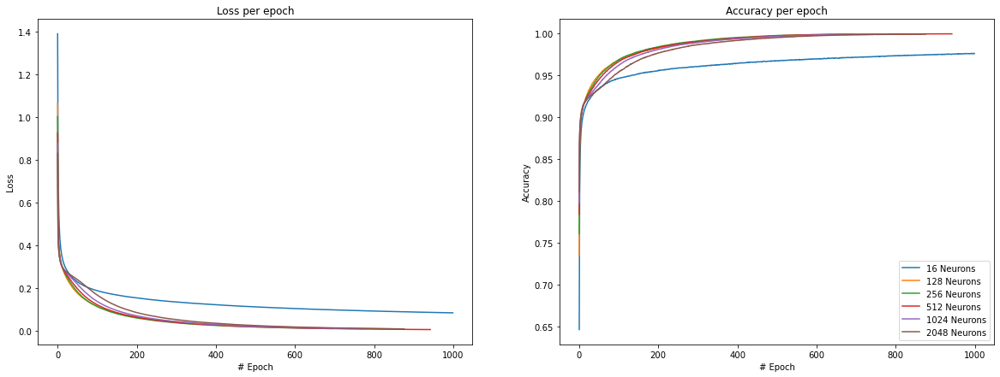

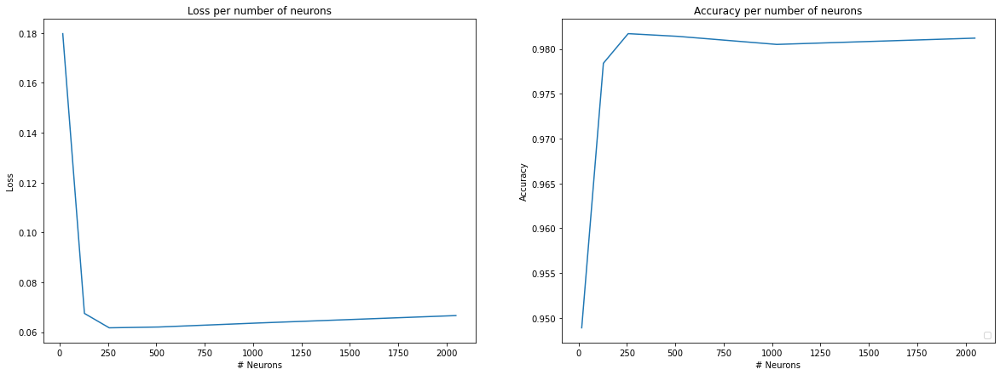

In [14]:
# Evaluation
# Train 
fig, (loss_ax, acc_ax) = plt.subplots(1, 2, figsize=(20,7))

loss_ax.set_title('Loss per epoch')
for i in range(0, len(arr)):
  loss_ax.plot(histories[i].history['loss'], label='' + str(arr[i]) + ' Neurons')
loss_ax.set(xlabel='# Epoch', ylabel='Loss')

acc_ax.set_title('Accuracy per epoch')
for i in range(0, len(arr)):
  acc_ax.plot(histories[i].history['accuracy'], label='' + str(arr[i]) + ' Neurons')
acc_ax.set(xlabel='# Epoch', ylabel='Accuracy')

plt.legend(loc=4)
plt.show()


fig, (loss_ax, acc_ax) = plt.subplots(1, 2, figsize=(20,7))

loss_ax.set_title('Loss per number of neurons')
loss_ax.plot(arr, [i[0] for i in test_accuracies])
loss_ax.set(xlabel='# Neurons', ylabel='Loss')

acc_ax.set_title('Accuracy per number of neurons')
acc_ax.plot(arr, [i[1] for i in test_accuracies])
acc_ax.set(xlabel='# Neurons', ylabel='Accuracy')

plt.legend(loc=4)
plt.show()

#### Activation function of the hidden layer
tanh, relu, softmax, selu, softplus

In [15]:
#arr = ['tanh', 'relu']
arr = ['tanh', 'relu', 'softmax', 'selu', 'softplus']
histories = []
test_accuracies = []

for act in arr:
  # Definition
  cur_model = tf.keras.Sequential(name='ff_variable_actfunc_' + str(act))
  cur_model.add(tf.keras.layers.Input(mnist_info.features['image'].shape)) # Input
  cur_model.add(tf.keras.layers.Flatten(input_shape=(28, 28))) # Flatten
  cur_model.add(tf.keras.layers.Dense(256, activation=act, name='hidden')) # Hidden
  cur_model.add(tf.keras.layers.Dense(mnist_info.features['label'].num_classes, activation='softmax', name='output')) #Output

  cur_model.compile(loss='sparse_categorical_crossentropy', optimizer='sgd', metrics=['accuracy'])

  # Stopping Callbacks
  earlystop = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=50, verbose=1)
  checkpoint = tf.keras.callbacks.ModelCheckpoint('ff_variable_act_' + act + '.h5', monitor='val_accuracy', verbose=1, save_best_only=True)

  histories += [cur_model.fit(ds_train, validation_data=ds_val, callbacks=[earlystop,checkpoint], epochs=no_epochs, batch_size=128)]

  test_accuracies += [cur_model.evaluate(ds_test)]

Epoch 1/1000
    445/Unknown - 1s 1ms/step - loss: 1.0030 - accuracy: 0.7580
Epoch 00001: val_accuracy improved from -inf to 0.84622, saving model to ff_variable_act_tanh.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.9834 - accuracy: 0.7624 - val_loss: 0.6113 - val_accuracy: 0.8462
Epoch 2/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.5253 - accuracy: 0.8663
Epoch 00002: val_accuracy improved from 0.84622 to 0.87389, saving model to ff_variable_act_tanh.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.5230 - accuracy: 0.8665 - val_loss: 0.4759 - val_accuracy: 0.8739
Epoch 3/1000
454/469 [============================>.] - ETA: 0s - loss: 0.4374 - accuracy: 0.8835
Epoch 00003: val_accuracy improved from 0.87389 to 0.88333, saving model to ff_variable_act_tanh.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.4374 - accuracy: 0.8833 - val_loss: 0.4229 - val_accuracy: 0.8833
Epoch 4/1000
444/469 [===============

Epoch 51/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.1838 - accuracy: 0.9489
Epoch 00051: val_accuracy improved from 0.94633 to 0.94689, saving model to ff_variable_act_tanh.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.1832 - accuracy: 0.9491 - val_loss: 0.1876 - val_accuracy: 0.9469
Epoch 52/1000
467/469 [============================>.] - ETA: 0s - loss: 0.1812 - accuracy: 0.9496
Epoch 00052: val_accuracy improved from 0.94689 to 0.94711, saving model to ff_variable_act_tanh.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.1811 - accuracy: 0.9497 - val_loss: 0.1854 - val_accuracy: 0.9471
Epoch 53/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.1786 - accuracy: 0.9504
Epoch 00053: val_accuracy improved from 0.94711 to 0.94800, saving model to ff_variable_act_tanh.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.1791 - accuracy: 0.9504 - val_loss: 0.1832 - val_accuracy: 0.9480
Epoch 54/1

Epoch 77/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.1394 - accuracy: 0.9615
Epoch 00077: val_accuracy improved from 0.96100 to 0.96156, saving model to ff_variable_act_tanh.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.1400 - accuracy: 0.9613 - val_loss: 0.1429 - val_accuracy: 0.9616
Epoch 78/1000
462/469 [============================>.] - ETA: 0s - loss: 0.1386 - accuracy: 0.9617
Epoch 00078: val_accuracy did not improve from 0.96156
469/469 [==============================] - 1s 1ms/step - loss: 0.1387 - accuracy: 0.9616 - val_loss: 0.1420 - val_accuracy: 0.9614
Epoch 79/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.1376 - accuracy: 0.9621
Epoch 00079: val_accuracy improved from 0.96156 to 0.96167, saving model to ff_variable_act_tanh.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.1374 - accuracy: 0.9621 - val_loss: 0.1403 - val_accuracy: 0.9617
Epoch 80/1000
453/469 [===========================>..] 

Epoch 103/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.1128 - accuracy: 0.9692 ETA: 0s - loss: 0.1128 - accuracy: 0.96
Epoch 00103: val_accuracy improved from 0.96900 to 0.96967, saving model to ff_variable_act_tanh.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.1122 - accuracy: 0.9693 - val_loss: 0.1148 - val_accuracy: 0.9697
Epoch 104/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.1114 - accuracy: 0.9696
Epoch 00104: val_accuracy improved from 0.96967 to 0.97000, saving model to ff_variable_act_tanh.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.1114 - accuracy: 0.9694 - val_loss: 0.1137 - val_accuracy: 0.9700
Epoch 105/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.1106 - accuracy: 0.9698
Epoch 00105: val_accuracy improved from 0.97000 to 0.97033, saving model to ff_variable_act_tanh.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.1105 - accuracy: 0.9698 - val_los

Epoch 129/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.0935 - accuracy: 0.9745
Epoch 00129: val_accuracy improved from 0.97456 to 0.97478, saving model to ff_variable_act_tanh.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0930 - accuracy: 0.9746 - val_loss: 0.0950 - val_accuracy: 0.9748
Epoch 130/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.0921 - accuracy: 0.9747
Epoch 00130: val_accuracy did not improve from 0.97478
469/469 [==============================] - 1s 1ms/step - loss: 0.0924 - accuracy: 0.9747 - val_loss: 0.0942 - val_accuracy: 0.9743
Epoch 131/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.0914 - accuracy: 0.9746
Epoch 00131: val_accuracy did not improve from 0.97478
469/469 [==============================] - 1s 1ms/step - loss: 0.0917 - accuracy: 0.9746 - val_loss: 0.0939 - val_accuracy: 0.9748
Epoch 132/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0912 - accuracy: 0.97

Epoch 183/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.0668 - accuracy: 0.9824
Epoch 00183: val_accuracy did not improve from 0.98189
469/469 [==============================] - 1s 1ms/step - loss: 0.0671 - accuracy: 0.9822 - val_loss: 0.0688 - val_accuracy: 0.9817
Epoch 184/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.0670 - accuracy: 0.9824
Epoch 00184: val_accuracy improved from 0.98189 to 0.98233, saving model to ff_variable_act_tanh.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0667 - accuracy: 0.9825 - val_loss: 0.0682 - val_accuracy: 0.9823
Epoch 185/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.0663 - accuracy: 0.9824
Epoch 00185: val_accuracy did not improve from 0.98233
469/469 [==============================] - 1s 2ms/step - loss: 0.0664 - accuracy: 0.9823 - val_loss: 0.0678 - val_accuracy: 0.9819
Epoch 186/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.0659 - accuracy: 0.98

Epoch 211/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.0580 - accuracy: 0.9850
Epoch 00211: val_accuracy did not improve from 0.98467
469/469 [==============================] - 1s 1ms/step - loss: 0.0580 - accuracy: 0.9851 - val_loss: 0.0594 - val_accuracy: 0.9846
Epoch 212/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0575 - accuracy: 0.9853
Epoch 00212: val_accuracy improved from 0.98467 to 0.98489, saving model to ff_variable_act_tanh.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0577 - accuracy: 0.9852 - val_loss: 0.0590 - val_accuracy: 0.9849
Epoch 213/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.0576 - accuracy: 0.9850
Epoch 00213: val_accuracy did not improve from 0.98489
469/469 [==============================] - 1s 1ms/step - loss: 0.0574 - accuracy: 0.9852 - val_loss: 0.0590 - val_accuracy: 0.9846
Epoch 214/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.0571 - accuracy: 0.98

Epoch 266/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.0444 - accuracy: 0.9895
Epoch 00266: val_accuracy improved from 0.98867 to 0.98878, saving model to ff_variable_act_tanh.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0448 - accuracy: 0.9893 - val_loss: 0.0459 - val_accuracy: 0.9888
Epoch 267/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.0449 - accuracy: 0.9893
Epoch 00267: val_accuracy did not improve from 0.98878
469/469 [==============================] - 1s 1ms/step - loss: 0.0446 - accuracy: 0.9893 - val_loss: 0.0456 - val_accuracy: 0.9887
Epoch 268/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.0445 - accuracy: 0.9894
Epoch 00268: val_accuracy improved from 0.98878 to 0.98911, saving model to ff_variable_act_tanh.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0444 - accuracy: 0.9894 - val_loss: 0.0457 - val_accuracy: 0.9891
Epoch 269/1000
449/469 [===========================>

Epoch 321/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.0356 - accuracy: 0.9924
Epoch 00321: val_accuracy did not improve from 0.99189
469/469 [==============================] - 1s 1ms/step - loss: 0.0355 - accuracy: 0.9925 - val_loss: 0.0364 - val_accuracy: 0.9919
Epoch 322/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.0354 - accuracy: 0.9926
Epoch 00322: val_accuracy did not improve from 0.99189
469/469 [==============================] - 1s 1ms/step - loss: 0.0353 - accuracy: 0.9925 - val_loss: 0.0362 - val_accuracy: 0.9918
Epoch 323/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.0353 - accuracy: 0.9924
Epoch 00323: val_accuracy improved from 0.99189 to 0.99233, saving model to ff_variable_act_tanh.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0352 - accuracy: 0.9924 - val_loss: 0.0363 - val_accuracy: 0.9923
Epoch 324/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0347 - accuracy: 0.99

Epoch 349/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.0315 - accuracy: 0.9935
Epoch 00349: val_accuracy did not improve from 0.99322
469/469 [==============================] - 1s 1ms/step - loss: 0.0317 - accuracy: 0.9934 - val_loss: 0.0327 - val_accuracy: 0.9930
Epoch 350/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.0317 - accuracy: 0.9934
Epoch 00350: val_accuracy improved from 0.99322 to 0.99333, saving model to ff_variable_act_tanh.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0316 - accuracy: 0.9934 - val_loss: 0.0326 - val_accuracy: 0.9933
Epoch 351/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0315 - accuracy: 0.9936
Epoch 00351: val_accuracy did not improve from 0.99333
469/469 [==============================] - 1s 1ms/step - loss: 0.0315 - accuracy: 0.9936 - val_loss: 0.0325 - val_accuracy: 0.9932
Epoch 352/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.0315 - accuracy: 0.99

Epoch 377/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.0287 - accuracy: 0.9943
Epoch 00377: val_accuracy improved from 0.99422 to 0.99433, saving model to ff_variable_act_tanh.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0285 - accuracy: 0.9944 - val_loss: 0.0294 - val_accuracy: 0.9943
Epoch 378/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.0286 - accuracy: 0.9944 ETA: 0s - loss: 0.0267 
Epoch 00378: val_accuracy did not improve from 0.99433
469/469 [==============================] - 1s 2ms/step - loss: 0.0284 - accuracy: 0.9944 - val_loss: 0.0294 - val_accuracy: 0.9941
Epoch 379/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.0283 - accuracy: 0.9944
Epoch 00379: val_accuracy did not improve from 0.99433
469/469 [==============================] - 1s 1ms/step - loss: 0.0283 - accuracy: 0.9944 - val_loss: 0.0294 - val_accuracy: 0.9940
Epoch 380/1000
446/469 [===========================>..] - ETA: 0s - loss:

Epoch 405/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.0255 - accuracy: 0.9953
Epoch 00405: val_accuracy did not improve from 0.99500
469/469 [==============================] - 1s 1ms/step - loss: 0.0257 - accuracy: 0.9952 - val_loss: 0.0266 - val_accuracy: 0.9949
Epoch 406/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.0254 - accuracy: 0.9952
Epoch 00406: val_accuracy improved from 0.99500 to 0.99511, saving model to ff_variable_act_tanh.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0256 - accuracy: 0.9952 - val_loss: 0.0264 - val_accuracy: 0.9951
Epoch 407/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.0256 - accuracy: 0.9952
Epoch 00407: val_accuracy did not improve from 0.99511
469/469 [==============================] - 1s 2ms/step - loss: 0.0255 - accuracy: 0.9952 - val_loss: 0.0263 - val_accuracy: 0.9950
Epoch 408/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.0253 - accuracy: 0.99

Epoch 433/1000
461/469 [============================>.] - ETA: 0s - loss: 0.0232 - accuracy: 0.9960
Epoch 00433: val_accuracy did not improve from 0.99600
469/469 [==============================] - 1s 1ms/step - loss: 0.0232 - accuracy: 0.9959 - val_loss: 0.0242 - val_accuracy: 0.9957
Epoch 434/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0230 - accuracy: 0.9961
Epoch 00434: val_accuracy did not improve from 0.99600
469/469 [==============================] - 1s 1ms/step - loss: 0.0231 - accuracy: 0.9960 - val_loss: 0.0240 - val_accuracy: 0.9960
Epoch 435/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0230 - accuracy: 0.9960
Epoch 00435: val_accuracy did not improve from 0.99600
469/469 [==============================] - 1s 1ms/step - loss: 0.0231 - accuracy: 0.9959 - val_loss: 0.0239 - val_accuracy: 0.9960
Epoch 436/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0229 - accuracy: 0.9961
Epoch 00436: val_accuracy did not improve 

Epoch 461/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.0209 - accuracy: 0.9967
Epoch 00461: val_accuracy improved from 0.99678 to 0.99689, saving model to ff_variable_act_tanh.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0211 - accuracy: 0.9967 - val_loss: 0.0219 - val_accuracy: 0.9969
Epoch 462/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0209 - accuracy: 0.9968
Epoch 00462: val_accuracy did not improve from 0.99689
469/469 [==============================] - 1s 1ms/step - loss: 0.0210 - accuracy: 0.9967 - val_loss: 0.0218 - val_accuracy: 0.9968
Epoch 463/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.0211 - accuracy: 0.9968
Epoch 00463: val_accuracy improved from 0.99689 to 0.99700, saving model to ff_variable_act_tanh.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0209 - accuracy: 0.9968 - val_loss: 0.0217 - val_accuracy: 0.9970
Epoch 464/1000
456/469 [============================

Epoch 489/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0192 - accuracy: 0.9974
Epoch 00489: val_accuracy did not improve from 0.99767
469/469 [==============================] - 1s 1ms/step - loss: 0.0192 - accuracy: 0.9974 - val_loss: 0.0200 - val_accuracy: 0.9977
Epoch 490/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.0190 - accuracy: 0.9974
Epoch 00490: val_accuracy did not improve from 0.99767
469/469 [==============================] - 1s 1ms/step - loss: 0.0191 - accuracy: 0.9974 - val_loss: 0.0199 - val_accuracy: 0.9977
Epoch 491/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0191 - accuracy: 0.9973
Epoch 00491: val_accuracy did not improve from 0.99767
469/469 [==============================] - 1s 1ms/step - loss: 0.0190 - accuracy: 0.9974 - val_loss: 0.0199 - val_accuracy: 0.9976
Epoch 492/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0190 - accuracy: 0.9974
Epoch 00492: val_accuracy did not improve 

Epoch 546/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.0161 - accuracy: 0.9982
Epoch 00546: val_accuracy did not improve from 0.99811
469/469 [==============================] - 1s 2ms/step - loss: 0.0160 - accuracy: 0.9982 - val_loss: 0.0166 - val_accuracy: 0.9981
Epoch 547/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0160 - accuracy: 0.9983
Epoch 00547: val_accuracy did not improve from 0.99811
469/469 [==============================] - 1s 2ms/step - loss: 0.0160 - accuracy: 0.9983 - val_loss: 0.0166 - val_accuracy: 0.9981
Epoch 548/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0159 - accuracy: 0.9983
Epoch 00548: val_accuracy did not improve from 0.99811
469/469 [==============================] - 1s 2ms/step - loss: 0.0159 - accuracy: 0.9983 - val_loss: 0.0165 - val_accuracy: 0.9981
Epoch 549/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.0159 - accuracy: 0.9983
Epoch 00549: val_accuracy did not improve 

Epoch 575/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.0147 - accuracy: 0.9985
Epoch 00575: val_accuracy did not improve from 0.99822
469/469 [==============================] - 1s 1ms/step - loss: 0.0147 - accuracy: 0.9986 - val_loss: 0.0153 - val_accuracy: 0.9982
Epoch 576/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.0147 - accuracy: 0.9985
Epoch 00576: val_accuracy improved from 0.99822 to 0.99833, saving model to ff_variable_act_tanh.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0146 - accuracy: 0.9986 - val_loss: 0.0152 - val_accuracy: 0.9983
Epoch 577/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.0146 - accuracy: 0.9985
Epoch 00577: val_accuracy did not improve from 0.99833
469/469 [==============================] - 1s 1ms/step - loss: 0.0146 - accuracy: 0.9985 - val_loss: 0.0152 - val_accuracy: 0.9982
Epoch 578/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0146 - accuracy: 0.99

448/469 [===========================>..] - ETA: 0s - loss: 0.0125 - accuracy: 0.9990
Epoch 00631: val_accuracy did not improve from 0.99889
469/469 [==============================] - 1s 1ms/step - loss: 0.0125 - accuracy: 0.9990 - val_loss: 0.0130 - val_accuracy: 0.9986
Epoch 632/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0125 - accuracy: 0.9990
Epoch 00632: val_accuracy did not improve from 0.99889
469/469 [==============================] - 1s 1ms/step - loss: 0.0125 - accuracy: 0.9990 - val_loss: 0.0129 - val_accuracy: 0.9986
Epoch 633/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.0125 - accuracy: 0.9990
Epoch 00633: val_accuracy did not improve from 0.99889
469/469 [==============================] - 1s 1ms/step - loss: 0.0125 - accuracy: 0.9990 - val_loss: 0.0129 - val_accuracy: 0.9989
Epoch 634/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0124 - accuracy: 0.9989
Epoch 00634: val_accuracy did not improve from 0.99889
46

Epoch 660/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0116 - accuracy: 0.9991
Epoch 00660: val_accuracy did not improve from 0.99911
469/469 [==============================] - 1s 1ms/step - loss: 0.0116 - accuracy: 0.9991 - val_loss: 0.0120 - val_accuracy: 0.9991
Epoch 661/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0115 - accuracy: 0.9991
Epoch 00661: val_accuracy did not improve from 0.99911
469/469 [==============================] - 1s 1ms/step - loss: 0.0116 - accuracy: 0.9991 - val_loss: 0.0119 - val_accuracy: 0.9990
Epoch 662/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.0116 - accuracy: 0.9991
Epoch 00662: val_accuracy did not improve from 0.99911
469/469 [==============================] - 1s 1ms/step - loss: 0.0115 - accuracy: 0.9991 - val_loss: 0.0119 - val_accuracy: 0.9991
Epoch 663/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.0114 - accuracy: 0.9992
Epoch 00663: val_accuracy did not improve 

Epoch 689/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.0108 - accuracy: 0.9992
Epoch 00689: val_accuracy did not improve from 0.99911
469/469 [==============================] - 1s 1ms/step - loss: 0.0107 - accuracy: 0.9993 - val_loss: 0.0111 - val_accuracy: 0.9991
Epoch 690/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.0107 - accuracy: 0.9993
Epoch 00690: val_accuracy did not improve from 0.99911
469/469 [==============================] - 1s 1ms/step - loss: 0.0107 - accuracy: 0.9992 - val_loss: 0.0110 - val_accuracy: 0.9991
Epoch 691/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0107 - accuracy: 0.9993
Epoch 00691: val_accuracy did not improve from 0.99911
469/469 [==============================] - 1s 1ms/step - loss: 0.0107 - accuracy: 0.9993 - val_loss: 0.0110 - val_accuracy: 0.9991
Epoch 692/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.0107 - accuracy: 0.9993
Epoch 00692: val_accuracy did not improve 


Epoch 00001: val_accuracy improved from -inf to 0.85322, saving model to ff_variable_act_relu.h5
469/469 [==============================] - 1s 2ms/step - loss: 1.1280 - accuracy: 0.7439 - val_loss: 0.6439 - val_accuracy: 0.8532
Epoch 2/1000
456/469 [============================>.] - ETA: 0s - loss: 0.5340 - accuracy: 0.8716
Epoch 00002: val_accuracy improved from 0.85322 to 0.87856, saving model to ff_variable_act_relu.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.5320 - accuracy: 0.8720 - val_loss: 0.4705 - val_accuracy: 0.8786
Epoch 3/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.4287 - accuracy: 0.8879 ETA: 0s - loss: 0.4380 - accura
Epoch 00003: val_accuracy improved from 0.87856 to 0.89078, saving model to ff_variable_act_relu.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.4266 - accuracy: 0.8885 - val_loss: 0.4063 - val_accuracy: 0.8908
Epoch 4/1000
455/469 [============================>.] - ETA: 0s - loss: 0.3789 - 

469/469 [==============================] - 1s 1ms/step - loss: 0.1318 - accuracy: 0.9636 - val_loss: 0.1329 - val_accuracy: 0.9648
Epoch 52/1000
464/469 [============================>.] - ETA: 0s - loss: 0.1299 - accuracy: 0.9646
Epoch 00052: val_accuracy improved from 0.96478 to 0.96544, saving model to ff_variable_act_relu.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.1301 - accuracy: 0.9644 - val_loss: 0.1310 - val_accuracy: 0.9654
Epoch 53/1000
457/469 [============================>.] - ETA: 0s - loss: 0.1282 - accuracy: 0.9648
Epoch 00053: val_accuracy improved from 0.96544 to 0.96567, saving model to ff_variable_act_relu.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.1285 - accuracy: 0.9647 - val_loss: 0.1302 - val_accuracy: 0.9657
Epoch 54/1000
456/469 [============================>.] - ETA: 0s - loss: 0.1273 - accuracy: 0.9650
Epoch 00054: val_accuracy improved from 0.96567 to 0.96600, saving model to ff_variable_act_relu.h5
469/469 [=

Epoch 78/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0980 - accuracy: 0.9739
Epoch 00078: val_accuracy did not improve from 0.97433
469/469 [==============================] - 1s 1ms/step - loss: 0.0979 - accuracy: 0.9739 - val_loss: 0.0988 - val_accuracy: 0.9741
Epoch 79/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0972 - accuracy: 0.9738
Epoch 00079: val_accuracy improved from 0.97433 to 0.97489, saving model to ff_variable_act_relu.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0970 - accuracy: 0.9739 - val_loss: 0.0976 - val_accuracy: 0.9749
Epoch 80/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.0957 - accuracy: 0.9744
Epoch 00080: val_accuracy improved from 0.97489 to 0.97522, saving model to ff_variable_act_relu.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0960 - accuracy: 0.9743 - val_loss: 0.0971 - val_accuracy: 0.9752
Epoch 81/1000
454/469 [============================>.] 

469/469 [==============================] - 1s 1ms/step - loss: 0.0777 - accuracy: 0.9797 - val_loss: 0.0787 - val_accuracy: 0.9801
Epoch 105/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.0773 - accuracy: 0.9798
Epoch 00105: val_accuracy did not improve from 0.98011
469/469 [==============================] - 1s 1ms/step - loss: 0.0771 - accuracy: 0.9800 - val_loss: 0.0782 - val_accuracy: 0.9799
Epoch 106/1000
461/469 [============================>.] - ETA: 0s - loss: 0.0764 - accuracy: 0.9799
Epoch 00106: val_accuracy improved from 0.98011 to 0.98044, saving model to ff_variable_act_relu.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0764 - accuracy: 0.9799 - val_loss: 0.0776 - val_accuracy: 0.9804
Epoch 107/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0756 - accuracy: 0.9803
Epoch 00107: val_accuracy did not improve from 0.98044
469/469 [==============================] - 1s 2ms/step - loss: 0.0758 - accuracy: 0.9802 - val_lo

Epoch 132/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0630 - accuracy: 0.9837
Epoch 00132: val_accuracy improved from 0.98356 to 0.98367, saving model to ff_variable_act_relu.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0629 - accuracy: 0.9837 - val_loss: 0.0637 - val_accuracy: 0.9837
Epoch 133/1000
469/469 [==============================] - ETA: 0s - loss: 0.0625 - accuracy: 0.9834
Epoch 00133: val_accuracy did not improve from 0.98367
469/469 [==============================] - 1s 1ms/step - loss: 0.0625 - accuracy: 0.9834 - val_loss: 0.0635 - val_accuracy: 0.9833
Epoch 134/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0620 - accuracy: 0.9839
Epoch 00134: val_accuracy did not improve from 0.98367
469/469 [==============================] - 1s 1ms/step - loss: 0.0620 - accuracy: 0.9838 - val_loss: 0.0632 - val_accuracy: 0.9832
Epoch 135/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.0616 - accuracy: 0.98

Epoch 159/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0529 - accuracy: 0.9866
Epoch 00159: val_accuracy did not improve from 0.98667
469/469 [==============================] - 1s 1ms/step - loss: 0.0527 - accuracy: 0.9867 - val_loss: 0.0539 - val_accuracy: 0.9860
Epoch 160/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0522 - accuracy: 0.9869
Epoch 00160: val_accuracy improved from 0.98667 to 0.98678, saving model to ff_variable_act_relu.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0523 - accuracy: 0.9869 - val_loss: 0.0538 - val_accuracy: 0.9868
Epoch 161/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0521 - accuracy: 0.9869
Epoch 00161: val_accuracy did not improve from 0.98678
469/469 [==============================] - 1s 1ms/step - loss: 0.0521 - accuracy: 0.9869 - val_loss: 0.0532 - val_accuracy: 0.9868
Epoch 162/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0517 - accuracy: 0.98

Epoch 213/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.0383 - accuracy: 0.9912
Epoch 00213: val_accuracy did not improve from 0.99067
469/469 [==============================] - 1s 1ms/step - loss: 0.0385 - accuracy: 0.9911 - val_loss: 0.0402 - val_accuracy: 0.9906
Epoch 214/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.0386 - accuracy: 0.9911
Epoch 00214: val_accuracy improved from 0.99067 to 0.99111, saving model to ff_variable_act_relu.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0384 - accuracy: 0.9912 - val_loss: 0.0398 - val_accuracy: 0.9911
Epoch 215/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0381 - accuracy: 0.9913
Epoch 00215: val_accuracy did not improve from 0.99111
469/469 [==============================] - 1s 1ms/step - loss: 0.0381 - accuracy: 0.9913 - val_loss: 0.0400 - val_accuracy: 0.9908
Epoch 216/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0379 - accuracy: 0.99

Epoch 268/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.0292 - accuracy: 0.9942
Epoch 00268: val_accuracy improved from 0.99433 to 0.99456, saving model to ff_variable_act_relu.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0291 - accuracy: 0.9943 - val_loss: 0.0308 - val_accuracy: 0.9946
Epoch 269/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0292 - accuracy: 0.9942
Epoch 00269: val_accuracy did not improve from 0.99456
469/469 [==============================] - 1s 1ms/step - loss: 0.0290 - accuracy: 0.9943 - val_loss: 0.0308 - val_accuracy: 0.9944
Epoch 270/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0288 - accuracy: 0.9943
Epoch 00270: val_accuracy did not improve from 0.99456
469/469 [==============================] - 1s 1ms/step - loss: 0.0289 - accuracy: 0.9944 - val_loss: 0.0306 - val_accuracy: 0.9946
Epoch 271/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0287 - accuracy: 0.99

Epoch 296/1000
459/469 [============================>.] - ETA: 0s - loss: 0.0257 - accuracy: 0.9955
Epoch 00296: val_accuracy did not improve from 0.99556
469/469 [==============================] - 1s 1ms/step - loss: 0.0256 - accuracy: 0.9955 - val_loss: 0.0273 - val_accuracy: 0.9954
Epoch 297/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.0252 - accuracy: 0.9957
Epoch 00297: val_accuracy did not improve from 0.99556
469/469 [==============================] - 1s 1ms/step - loss: 0.0254 - accuracy: 0.9957 - val_loss: 0.0274 - val_accuracy: 0.9954
Epoch 298/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0251 - accuracy: 0.9957
Epoch 00298: val_accuracy did not improve from 0.99556
469/469 [==============================] - 1s 1ms/step - loss: 0.0253 - accuracy: 0.9957 - val_loss: 0.0271 - val_accuracy: 0.9956
Epoch 299/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0251 - accuracy: 0.9956
Epoch 00299: val_accuracy did not improve 

Epoch 324/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.0226 - accuracy: 0.9964
Epoch 00324: val_accuracy did not improve from 0.99644
469/469 [==============================] - 1s 1ms/step - loss: 0.0226 - accuracy: 0.9964 - val_loss: 0.0243 - val_accuracy: 0.9962
Epoch 325/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.0229 - accuracy: 0.9963
Epoch 00325: val_accuracy did not improve from 0.99644
469/469 [==============================] - 1s 1ms/step - loss: 0.0225 - accuracy: 0.9965 - val_loss: 0.0243 - val_accuracy: 0.9961
Epoch 326/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.0225 - accuracy: 0.9964
Epoch 00326: val_accuracy did not improve from 0.99644
469/469 [==============================] - 1s 1ms/step - loss: 0.0224 - accuracy: 0.9963 - val_loss: 0.0241 - val_accuracy: 0.9963
Epoch 327/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0223 - accuracy: 0.9963
Epoch 00327: val_accuracy improved from 0.

449/469 [===========================>..] - ETA: 0s - loss: 0.0200 - accuracy: 0.9971
Epoch 00352: val_accuracy did not improve from 0.99689
469/469 [==============================] - 1s 1ms/step - loss: 0.0201 - accuracy: 0.9971 - val_loss: 0.0218 - val_accuracy: 0.9968
Epoch 353/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.0199 - accuracy: 0.9971
Epoch 00353: val_accuracy improved from 0.99689 to 0.99711, saving model to ff_variable_act_relu.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0200 - accuracy: 0.9971 - val_loss: 0.0218 - val_accuracy: 0.9971
Epoch 354/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0199 - accuracy: 0.9971
Epoch 00354: val_accuracy did not improve from 0.99711
469/469 [==============================] - 1s 1ms/step - loss: 0.0199 - accuracy: 0.9972 - val_loss: 0.0215 - val_accuracy: 0.9970
Epoch 355/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.0197 - accuracy: 0.9972
Epoch 00355:

445/469 [===========================>..] - ETA: 0s - loss: 0.0162 - accuracy: 0.9981
Epoch 00408: val_accuracy did not improve from 0.99778
469/469 [==============================] - 1s 2ms/step - loss: 0.0161 - accuracy: 0.9981 - val_loss: 0.0176 - val_accuracy: 0.9977
Epoch 409/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.0161 - accuracy: 0.9981
Epoch 00409: val_accuracy improved from 0.99778 to 0.99800, saving model to ff_variable_act_relu.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0160 - accuracy: 0.9981 - val_loss: 0.0175 - val_accuracy: 0.9980
Epoch 410/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.0160 - accuracy: 0.9982
Epoch 00410: val_accuracy did not improve from 0.99800
469/469 [==============================] - 1s 1ms/step - loss: 0.0160 - accuracy: 0.9981 - val_loss: 0.0175 - val_accuracy: 0.9977
Epoch 411/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0158 - accuracy: 0.9981
Epoch 00411:

Epoch 437/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.0143 - accuracy: 0.9985
Epoch 00437: val_accuracy did not improve from 0.99811
469/469 [==============================] - 1s 1ms/step - loss: 0.0144 - accuracy: 0.9984 - val_loss: 0.0159 - val_accuracy: 0.9981
Epoch 438/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0144 - accuracy: 0.9984
Epoch 00438: val_accuracy did not improve from 0.99811
469/469 [==============================] - 1s 1ms/step - loss: 0.0144 - accuracy: 0.9984 - val_loss: 0.0158 - val_accuracy: 0.9981
Epoch 439/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.0142 - accuracy: 0.9984
Epoch 00439: val_accuracy did not improve from 0.99811
469/469 [==============================] - 1s 1ms/step - loss: 0.0143 - accuracy: 0.9984 - val_loss: 0.0158 - val_accuracy: 0.9981
Epoch 440/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0142 - accuracy: 0.9985
Epoch 00440: val_accuracy did not improve 

Epoch 465/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.0130 - accuracy: 0.9987
Epoch 00465: val_accuracy did not improve from 0.99856
469/469 [==============================] - 1s 1ms/step - loss: 0.0131 - accuracy: 0.9987 - val_loss: 0.0144 - val_accuracy: 0.9984
Epoch 466/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0130 - accuracy: 0.9987 ETA: 0s - loss: 0.0130 - accuracy: 
Epoch 00466: val_accuracy did not improve from 0.99856
469/469 [==============================] - 1s 2ms/step - loss: 0.0130 - accuracy: 0.9987 - val_loss: 0.0143 - val_accuracy: 0.9986
Epoch 467/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.0130 - accuracy: 0.9988
Epoch 00467: val_accuracy did not improve from 0.99856
469/469 [==============================] - 1s 1ms/step - loss: 0.0130 - accuracy: 0.9987 - val_loss: 0.0143 - val_accuracy: 0.9986
Epoch 468/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0128 - accuracy: 0.9989
Epoch 

Epoch 522/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0108 - accuracy: 0.9992
Epoch 00522: val_accuracy did not improve from 0.99878
469/469 [==============================] - 1s 1ms/step - loss: 0.0108 - accuracy: 0.9992 - val_loss: 0.0119 - val_accuracy: 0.9988
Epoch 523/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.0108 - accuracy: 0.9992
Epoch 00523: val_accuracy did not improve from 0.99878
469/469 [==============================] - 1s 1ms/step - loss: 0.0108 - accuracy: 0.9992 - val_loss: 0.0119 - val_accuracy: 0.9988
Epoch 524/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.0108 - accuracy: 0.9992
Epoch 00524: val_accuracy did not improve from 0.99878
469/469 [==============================] - 1s 1ms/step - loss: 0.0107 - accuracy: 0.9992 - val_loss: 0.0119 - val_accuracy: 0.9988
Epoch 525/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.0106 - accuracy: 0.9993
Epoch 00525: val_accuracy did not improve 

Epoch 551/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.0099 - accuracy: 0.9994
Epoch 00551: val_accuracy did not improve from 0.99889
469/469 [==============================] - 1s 2ms/step - loss: 0.0099 - accuracy: 0.9994 - val_loss: 0.0108 - val_accuracy: 0.9989
Epoch 552/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.0097 - accuracy: 0.9994
Epoch 00552: val_accuracy did not improve from 0.99889
469/469 [==============================] - 1s 1ms/step - loss: 0.0098 - accuracy: 0.9994 - val_loss: 0.0108 - val_accuracy: 0.9989
Epoch 553/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0098 - accuracy: 0.9994
Epoch 00553: val_accuracy did not improve from 0.99889
469/469 [==============================] - 1s 1ms/step - loss: 0.0098 - accuracy: 0.9994 - val_loss: 0.0108 - val_accuracy: 0.9989
Epoch 554/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0098 - accuracy: 0.9994
Epoch 00554: val_accuracy improved from 0.

Epoch 580/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0090 - accuracy: 0.9995
Epoch 00580: val_accuracy improved from 0.99900 to 0.99911, saving model to ff_variable_act_relu.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0090 - accuracy: 0.9995 - val_loss: 0.0099 - val_accuracy: 0.9991
Epoch 581/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0090 - accuracy: 0.9995
Epoch 00581: val_accuracy did not improve from 0.99911
469/469 [==============================] - 1s 1ms/step - loss: 0.0090 - accuracy: 0.9995 - val_loss: 0.0099 - val_accuracy: 0.9991
Epoch 582/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.0091 - accuracy: 0.9995
Epoch 00582: val_accuracy did not improve from 0.99911
469/469 [==============================] - 1s 1ms/step - loss: 0.0090 - accuracy: 0.9995 - val_loss: 0.0099 - val_accuracy: 0.9991
Epoch 583/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.0089 - accuracy: 0.99

450/469 [===========================>..] - ETA: 0s - loss: 0.0078 - accuracy: 0.9996
Epoch 00636: val_accuracy did not improve from 0.99956
469/469 [==============================] - 1s 2ms/step - loss: 0.0077 - accuracy: 0.9996 - val_loss: 0.0084 - val_accuracy: 0.9993
Epoch 637/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0077 - accuracy: 0.9996
Epoch 00637: val_accuracy did not improve from 0.99956
469/469 [==============================] - 1s 2ms/step - loss: 0.0077 - accuracy: 0.9996 - val_loss: 0.0083 - val_accuracy: 0.9994
Epoch 638/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0076 - accuracy: 0.9997
Epoch 00638: val_accuracy did not improve from 0.99956
469/469 [==============================] - 1s 1ms/step - loss: 0.0077 - accuracy: 0.9997 - val_loss: 0.0083 - val_accuracy: 0.9993
Epoch 639/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0077 - accuracy: 0.9996
Epoch 00639: val_accuracy did not improve from 0.99956
46

Epoch 665/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.0072 - accuracy: 0.9997
Epoch 00665: val_accuracy did not improve from 0.99967
469/469 [==============================] - 1s 1ms/step - loss: 0.0072 - accuracy: 0.9997 - val_loss: 0.0077 - val_accuracy: 0.9996
Epoch 666/1000
459/469 [============================>.] - ETA: 0s - loss: 0.0071 - accuracy: 0.9997
Epoch 00666: val_accuracy did not improve from 0.99967
469/469 [==============================] - 1s 1ms/step - loss: 0.0071 - accuracy: 0.9997 - val_loss: 0.0076 - val_accuracy: 0.9997
Epoch 667/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0071 - accuracy: 0.9997
Epoch 00667: val_accuracy did not improve from 0.99967
469/469 [==============================] - 1s 1ms/step - loss: 0.0071 - accuracy: 0.9997 - val_loss: 0.0076 - val_accuracy: 0.9996
Epoch 668/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0071 - accuracy: 0.9998
Epoch 00668: val_accuracy did not improve 

Epoch 694/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0066 - accuracy: 0.9998
Epoch 00694: val_accuracy did not improve from 0.99967
469/469 [==============================] - 1s 1ms/step - loss: 0.0066 - accuracy: 0.9998 - val_loss: 0.0071 - val_accuracy: 0.9997
Epoch 695/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0066 - accuracy: 0.9998
Epoch 00695: val_accuracy did not improve from 0.99967
469/469 [==============================] - 1s 1ms/step - loss: 0.0066 - accuracy: 0.9998 - val_loss: 0.0070 - val_accuracy: 0.9997
Epoch 696/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0066 - accuracy: 0.9998
Epoch 00696: val_accuracy did not improve from 0.99967
469/469 [==============================] - 1s 1ms/step - loss: 0.0066 - accuracy: 0.9998 - val_loss: 0.0070 - val_accuracy: 0.9997
Epoch 697/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0066 - accuracy: 0.9998
Epoch 00697: val_accuracy did not improve 

Epoch 39/1000
468/469 [============================>.] - ETA: 0s - loss: 2.1041 - accuracy: 0.2218
Epoch 00039: val_accuracy improved from 0.22000 to 0.22200, saving model to ff_variable_act_softmax.h5
469/469 [==============================] - 1s 2ms/step - loss: 2.1041 - accuracy: 0.2219 - val_loss: 2.0991 - val_accuracy: 0.2220
Epoch 40/1000
438/469 [===========================>..] - ETA: 0s - loss: 2.0926 - accuracy: 0.2236
Epoch 00040: val_accuracy improved from 0.22200 to 0.22211, saving model to ff_variable_act_softmax.h5
469/469 [==============================] - 1s 1ms/step - loss: 2.0921 - accuracy: 0.2232 - val_loss: 2.0874 - val_accuracy: 0.2221
Epoch 41/1000
438/469 [===========================>..] - ETA: 0s - loss: 2.0805 - accuracy: 0.2249
Epoch 00041: val_accuracy improved from 0.22211 to 0.22356, saving model to ff_variable_act_softmax.h5
469/469 [==============================] - 1s 1ms/step - loss: 2.0799 - accuracy: 0.2251 - val_loss: 2.0755 - val_accuracy: 0.2236
E

Epoch 65/1000
462/469 [============================>.] - ETA: 0s - loss: 1.6727 - accuracy: 0.3386
Epoch 00065: val_accuracy did not improve from 0.33767
469/469 [==============================] - 1s 2ms/step - loss: 1.6730 - accuracy: 0.3384 - val_loss: 1.6800 - val_accuracy: 0.3354
Epoch 66/1000
453/469 [===========================>..] - ETA: 0s - loss: 1.6617 - accuracy: 0.3382
Epoch 00066: val_accuracy did not improve from 0.33767
469/469 [==============================] - 1s 2ms/step - loss: 1.6614 - accuracy: 0.3381 - val_loss: 1.6692 - val_accuracy: 0.3368
Epoch 67/1000
463/469 [============================>.] - ETA: 0s - loss: 1.6512 - accuracy: 0.3402
Epoch 00067: val_accuracy improved from 0.33767 to 0.33922, saving model to ff_variable_act_softmax.h5
469/469 [==============================] - 1s 2ms/step - loss: 1.6506 - accuracy: 0.3407 - val_loss: 1.6587 - val_accuracy: 0.3392
Epoch 68/1000
469/469 [==============================] - ETA: 0s - loss: 1.6405 - accuracy: 0.343

452/469 [===========================>..] - ETA: 0s - loss: 1.4884 - accuracy: 0.3782
Epoch 00090: val_accuracy improved from 0.38011 to 0.38044, saving model to ff_variable_act_softmax.h5
469/469 [==============================] - 1s 2ms/step - loss: 1.4882 - accuracy: 0.3784 - val_loss: 1.4998 - val_accuracy: 0.3804
Epoch 91/1000
431/469 [==========================>...] - ETA: 0s - loss: 1.4837 - accuracy: 0.3791
Epoch 00091: val_accuracy improved from 0.38044 to 0.38067, saving model to ff_variable_act_softmax.h5
469/469 [==============================] - 1s 2ms/step - loss: 1.4850 - accuracy: 0.3789 - val_loss: 1.4966 - val_accuracy: 0.3807
Epoch 92/1000
458/469 [============================>.] - ETA: 0s - loss: 1.4816 - accuracy: 0.3810
Epoch 00092: val_accuracy improved from 0.38067 to 0.38089, saving model to ff_variable_act_softmax.h5
469/469 [==============================] - 1s 2ms/step - loss: 1.4818 - accuracy: 0.3807 - val_loss: 1.4933 - val_accuracy: 0.3809
Epoch 93/1000
4

Epoch 144/1000
447/469 [===========================>..] - ETA: 0s - loss: 1.3889 - accuracy: 0.4010
Epoch 00144: val_accuracy improved from 0.40078 to 0.40211, saving model to ff_variable_act_softmax.h5
469/469 [==============================] - 1s 2ms/step - loss: 1.3891 - accuracy: 0.4005 - val_loss: 1.3999 - val_accuracy: 0.4021
Epoch 145/1000
449/469 [===========================>..] - ETA: 0s - loss: 1.3879 - accuracy: 0.4026
Epoch 00145: val_accuracy improved from 0.40211 to 0.40367, saving model to ff_variable_act_softmax.h5
469/469 [==============================] - 1s 2ms/step - loss: 1.3879 - accuracy: 0.4029 - val_loss: 1.3984 - val_accuracy: 0.4037
Epoch 146/1000
462/469 [============================>.] - ETA: 0s - loss: 1.3869 - accuracy: 0.4013
Epoch 00146: val_accuracy improved from 0.40367 to 0.40756, saving model to ff_variable_act_softmax.h5
469/469 [==============================] - 1s 2ms/step - loss: 1.3868 - accuracy: 0.4015 - val_loss: 1.3978 - val_accuracy: 0.407

Epoch 172/1000
449/469 [===========================>..] - ETA: 0s - loss: 1.3610 - accuracy: 0.4103
Epoch 00172: val_accuracy did not improve from 0.42011
469/469 [==============================] - 1s 2ms/step - loss: 1.3616 - accuracy: 0.4098 - val_loss: 1.3718 - val_accuracy: 0.4102
Epoch 173/1000
447/469 [===========================>..] - ETA: 0s - loss: 1.3597 - accuracy: 0.4088
Epoch 00173: val_accuracy did not improve from 0.42011
469/469 [==============================] - 1s 2ms/step - loss: 1.3608 - accuracy: 0.4088 - val_loss: 1.3708 - val_accuracy: 0.4127
Epoch 174/1000
455/469 [============================>.] - ETA: 0s - loss: 1.3601 - accuracy: 0.4114
Epoch 00174: val_accuracy did not improve from 0.42011
469/469 [==============================] - 1s 2ms/step - loss: 1.3601 - accuracy: 0.4117 - val_loss: 1.3705 - val_accuracy: 0.4120
Epoch 175/1000
449/469 [===========================>..] - ETA: 0s - loss: 1.3597 - accuracy: 0.4109
Epoch 00175: val_accuracy did not improve 

Epoch 201/1000
436/469 [==========================>...] - ETA: 0s - loss: 1.3406 - accuracy: 0.4187
Epoch 00201: val_accuracy did not improve from 0.42278
469/469 [==============================] - 1s 2ms/step - loss: 1.3418 - accuracy: 0.4183 - val_loss: 1.3526 - val_accuracy: 0.4187
Epoch 202/1000
451/469 [===========================>..] - ETA: 0s - loss: 1.3418 - accuracy: 0.4194
Epoch 00202: val_accuracy did not improve from 0.42278
469/469 [==============================] - 1s 2ms/step - loss: 1.3412 - accuracy: 0.4195 - val_loss: 1.3528 - val_accuracy: 0.4212
Epoch 203/1000
459/469 [============================>.] - ETA: 0s - loss: 1.3401 - accuracy: 0.4185
Epoch 00203: val_accuracy did not improve from 0.42278
469/469 [==============================] - 1s 2ms/step - loss: 1.3406 - accuracy: 0.4189 - val_loss: 1.3508 - val_accuracy: 0.4190
Epoch 204/1000
445/469 [===========================>..] - ETA: 0s - loss: 1.3394 - accuracy: 0.4179
Epoch 00204: val_accuracy improved from 0.

Epoch 228/1000
459/469 [============================>.] - ETA: 0s - loss: 1.3277 - accuracy: 0.4276
Epoch 00228: val_accuracy did not improve from 0.43333
469/469 [==============================] - 1s 2ms/step - loss: 1.3274 - accuracy: 0.4278 - val_loss: 1.3396 - val_accuracy: 0.4293
Epoch 229/1000
463/469 [============================>.] - ETA: 0s - loss: 1.3271 - accuracy: 0.4300
Epoch 00229: val_accuracy did not improve from 0.43333
469/469 [==============================] - 1s 2ms/step - loss: 1.3271 - accuracy: 0.4302 - val_loss: 1.3374 - val_accuracy: 0.4324
Epoch 230/1000
441/469 [===========================>..] - ETA: 0s - loss: 1.3257 - accuracy: 0.4298
Epoch 00230: val_accuracy improved from 0.43333 to 0.43411, saving model to ff_variable_act_softmax.h5
469/469 [==============================] - 1s 2ms/step - loss: 1.3266 - accuracy: 0.4290 - val_loss: 1.3377 - val_accuracy: 0.4341
Epoch 231/1000
460/469 [============================>.] - ETA: 0s - loss: 1.3262 - accuracy: 0

Epoch 282/1000
459/469 [============================>.] - ETA: 0s - loss: 1.3038 - accuracy: 0.4570
Epoch 00282: val_accuracy improved from 0.46200 to 0.46311, saving model to ff_variable_act_softmax.h5
469/469 [==============================] - 1s 2ms/step - loss: 1.3037 - accuracy: 0.4570 - val_loss: 1.3137 - val_accuracy: 0.4631
Epoch 283/1000
443/469 [===========================>..] - ETA: 0s - loss: 1.3026 - accuracy: 0.4591
Epoch 00283: val_accuracy improved from 0.46311 to 0.46367, saving model to ff_variable_act_softmax.h5
469/469 [==============================] - 1s 2ms/step - loss: 1.3032 - accuracy: 0.4588 - val_loss: 1.3125 - val_accuracy: 0.4637
Epoch 284/1000
432/469 [==========================>...] - ETA: 0s - loss: 1.3018 - accuracy: 0.4602
Epoch 00284: val_accuracy improved from 0.46367 to 0.46411, saving model to ff_variable_act_softmax.h5
469/469 [==============================] - 1s 2ms/step - loss: 1.3025 - accuracy: 0.4597 - val_loss: 1.3119 - val_accuracy: 0.464

Epoch 308/1000
453/469 [===========================>..] - ETA: 0s - loss: 1.2884 - accuracy: 0.4820
Epoch 00308: val_accuracy did not improve from 0.48511
469/469 [==============================] - 1s 2ms/step - loss: 1.2886 - accuracy: 0.4819 - val_loss: 1.3004 - val_accuracy: 0.4816
Epoch 309/1000
458/469 [============================>.] - ETA: 0s - loss: 1.2880 - accuracy: 0.4822
Epoch 00309: val_accuracy improved from 0.48511 to 0.48856, saving model to ff_variable_act_softmax.h5
469/469 [==============================] - 1s 2ms/step - loss: 1.2879 - accuracy: 0.4822 - val_loss: 1.2974 - val_accuracy: 0.4886
Epoch 310/1000
449/469 [===========================>..] - ETA: 0s - loss: 1.2870 - accuracy: 0.4827
Epoch 00310: val_accuracy improved from 0.48856 to 0.48989, saving model to ff_variable_act_softmax.h5
469/469 [==============================] - 1s 2ms/step - loss: 1.2870 - accuracy: 0.4831 - val_loss: 1.2953 - val_accuracy: 0.4899
Epoch 311/1000
444/469 [======================

Epoch 334/1000
443/469 [===========================>..] - ETA: 0s - loss: 1.2630 - accuracy: 0.5124
Epoch 00334: val_accuracy did not improve from 0.52111
469/469 [==============================] - 1s 2ms/step - loss: 1.2628 - accuracy: 0.5127 - val_loss: 1.2692 - val_accuracy: 0.5207
Epoch 335/1000
468/469 [============================>.] - ETA: 0s - loss: 1.2614 - accuracy: 0.5145
Epoch 00335: val_accuracy improved from 0.52111 to 0.52300, saving model to ff_variable_act_softmax.h5
469/469 [==============================] - 1s 2ms/step - loss: 1.2614 - accuracy: 0.5145 - val_loss: 1.2683 - val_accuracy: 0.5230
Epoch 336/1000
468/469 [============================>.] - ETA: 0s - loss: 1.2605 - accuracy: 0.5154
Epoch 00336: val_accuracy improved from 0.52300 to 0.52600, saving model to ff_variable_act_softmax.h5
469/469 [==============================] - 1s 2ms/step - loss: 1.2602 - accuracy: 0.5155 - val_loss: 1.2676 - val_accuracy: 0.5260
Epoch 337/1000
460/469 [======================

Epoch 387/1000
453/469 [===========================>..] - ETA: 0s - loss: 1.1975 - accuracy: 0.5580
Epoch 00387: val_accuracy improved from 0.56289 to 0.56344, saving model to ff_variable_act_softmax.h5
469/469 [==============================] - 1s 2ms/step - loss: 1.1976 - accuracy: 0.5583 - val_loss: 1.2027 - val_accuracy: 0.5634
Epoch 388/1000
438/469 [===========================>..] - ETA: 0s - loss: 1.1973 - accuracy: 0.5593
Epoch 00388: val_accuracy did not improve from 0.56344
469/469 [==============================] - 1s 2ms/step - loss: 1.1971 - accuracy: 0.5590 - val_loss: 1.2019 - val_accuracy: 0.5611
Epoch 389/1000
439/469 [===========================>..] - ETA: 0s - loss: 1.1963 - accuracy: 0.5587
Epoch 00389: val_accuracy did not improve from 0.56344
469/469 [==============================] - 1s 2ms/step - loss: 1.1963 - accuracy: 0.5589 - val_loss: 1.2022 - val_accuracy: 0.5631
Epoch 390/1000
441/469 [===========================>..] - ETA: 0s - loss: 1.1956 - accuracy: 0

Epoch 414/1000
447/469 [===========================>..] - ETA: 0s - loss: 1.1789 - accuracy: 0.5793
Epoch 00414: val_accuracy improved from 0.58200 to 0.58422, saving model to ff_variable_act_softmax.h5
469/469 [==============================] - 1s 2ms/step - loss: 1.1789 - accuracy: 0.5791 - val_loss: 1.1845 - val_accuracy: 0.5842
Epoch 415/1000
454/469 [============================>.] - ETA: 0s - loss: 1.1786 - accuracy: 0.5791
Epoch 00415: val_accuracy did not improve from 0.58422
469/469 [==============================] - 1s 2ms/step - loss: 1.1783 - accuracy: 0.5790 - val_loss: 1.1824 - val_accuracy: 0.5829
Epoch 416/1000
457/469 [============================>.] - ETA: 0s - loss: 1.1779 - accuracy: 0.5777
Epoch 00416: val_accuracy did not improve from 0.58422
469/469 [==============================] - 1s 2ms/step - loss: 1.1776 - accuracy: 0.5781 - val_loss: 1.1827 - val_accuracy: 0.5841
Epoch 417/1000
457/469 [============================>.] - ETA: 0s - loss: 1.1765 - accuracy: 0

Epoch 441/1000
468/469 [============================>.] - ETA: 0s - loss: 1.1627 - accuracy: 0.5973
Epoch 00441: val_accuracy improved from 0.60156 to 0.60189, saving model to ff_variable_act_softmax.h5
469/469 [==============================] - 1s 2ms/step - loss: 1.1628 - accuracy: 0.5972 - val_loss: 1.1679 - val_accuracy: 0.6019
Epoch 442/1000
467/469 [============================>.] - ETA: 0s - loss: 1.1625 - accuracy: 0.5985
Epoch 00442: val_accuracy did not improve from 0.60189
469/469 [==============================] - 1s 2ms/step - loss: 1.1622 - accuracy: 0.5986 - val_loss: 1.1686 - val_accuracy: 0.5997
Epoch 443/1000
445/469 [===========================>..] - ETA: 0s - loss: 1.1619 - accuracy: 0.5988
Epoch 00443: val_accuracy did not improve from 0.60189
469/469 [==============================] - 1s 2ms/step - loss: 1.1615 - accuracy: 0.5990 - val_loss: 1.1675 - val_accuracy: 0.6016
Epoch 444/1000
444/469 [===========================>..] - ETA: 0s - loss: 1.1616 - accuracy: 0

Epoch 496/1000
446/469 [===========================>..] - ETA: 0s - loss: 1.1309 - accuracy: 0.6204
Epoch 00496: val_accuracy did not improve from 0.62222
469/469 [==============================] - 1s 2ms/step - loss: 1.1325 - accuracy: 0.6196 - val_loss: 1.1366 - val_accuracy: 0.6179
Epoch 497/1000
462/469 [============================>.] - ETA: 0s - loss: 1.1321 - accuracy: 0.6199
Epoch 00497: val_accuracy did not improve from 0.62222
469/469 [==============================] - 1s 2ms/step - loss: 1.1321 - accuracy: 0.6199 - val_loss: 1.1395 - val_accuracy: 0.6163
Epoch 498/1000
465/469 [============================>.] - ETA: 0s - loss: 1.1316 - accuracy: 0.6212
Epoch 00498: val_accuracy did not improve from 0.62222
469/469 [==============================] - 1s 2ms/step - loss: 1.1315 - accuracy: 0.6212 - val_loss: 1.1369 - val_accuracy: 0.6218
Epoch 499/1000
447/469 [===========================>..] - ETA: 0s - loss: 1.1311 - accuracy: 0.6221
Epoch 00499: val_accuracy did not improve 

Epoch 551/1000
465/469 [============================>.] - ETA: 0s - loss: 1.1025 - accuracy: 0.6326
Epoch 00551: val_accuracy did not improve from 0.63767
469/469 [==============================] - 1s 2ms/step - loss: 1.1027 - accuracy: 0.6324 - val_loss: 1.1047 - val_accuracy: 0.6299
Epoch 552/1000
462/469 [============================>.] - ETA: 0s - loss: 1.1029 - accuracy: 0.6316
Epoch 00552: val_accuracy did not improve from 0.63767
469/469 [==============================] - 1s 2ms/step - loss: 1.1025 - accuracy: 0.6320 - val_loss: 1.1041 - val_accuracy: 0.6344
Epoch 553/1000
448/469 [===========================>..] - ETA: 0s - loss: 1.1005 - accuracy: 0.6331
Epoch 00553: val_accuracy did not improve from 0.63767
469/469 [==============================] - 1s 2ms/step - loss: 1.1018 - accuracy: 0.6330 - val_loss: 1.1042 - val_accuracy: 0.6341
Epoch 554/1000
459/469 [============================>.] - ETA: 0s - loss: 1.1015 - accuracy: 0.6329
Epoch 00554: val_accuracy did not improve 

Epoch 580/1000
460/469 [============================>.] - ETA: 0s - loss: 1.0878 - accuracy: 0.6361
Epoch 00580: val_accuracy did not improve from 0.63767
469/469 [==============================] - 1s 2ms/step - loss: 1.0871 - accuracy: 0.6363 - val_loss: 1.0879 - val_accuracy: 0.6336
Epoch 581/1000
440/469 [===========================>..] - ETA: 0s - loss: 1.0872 - accuracy: 0.6360
Epoch 00581: val_accuracy did not improve from 0.63767
469/469 [==============================] - 1s 2ms/step - loss: 1.0868 - accuracy: 0.6357 - val_loss: 1.0905 - val_accuracy: 0.6284
Epoch 582/1000
441/469 [===========================>..] - ETA: 0s - loss: 1.0862 - accuracy: 0.6333
Epoch 00582: val_accuracy did not improve from 0.63767
469/469 [==============================] - 1s 2ms/step - loss: 1.0864 - accuracy: 0.6336 - val_loss: 1.0897 - val_accuracy: 0.6303
Epoch 583/1000
438/469 [===========================>..] - ETA: 0s - loss: 1.0843 - accuracy: 0.6367
Epoch 00583: val_accuracy improved from 0.

Epoch 608/1000
445/469 [===========================>..] - ETA: 0s - loss: 1.0743 - accuracy: 0.6374
Epoch 00608: val_accuracy did not improve from 0.64378
469/469 [==============================] - 1s 2ms/step - loss: 1.0729 - accuracy: 0.6379 - val_loss: 1.0736 - val_accuracy: 0.6357
Epoch 609/1000
468/469 [============================>.] - ETA: 0s - loss: 1.0729 - accuracy: 0.6362
Epoch 00609: val_accuracy did not improve from 0.64378
469/469 [==============================] - 1s 2ms/step - loss: 1.0727 - accuracy: 0.6362 - val_loss: 1.0715 - val_accuracy: 0.6437
Epoch 610/1000
457/469 [============================>.] - ETA: 0s - loss: 1.0719 - accuracy: 0.6378
Epoch 00610: val_accuracy did not improve from 0.64378
469/469 [==============================] - 1s 2ms/step - loss: 1.0724 - accuracy: 0.6378 - val_loss: 1.0742 - val_accuracy: 0.6357
Epoch 611/1000
447/469 [===========================>..] - ETA: 0s - loss: 1.0727 - accuracy: 0.6373
Epoch 00611: val_accuracy did not improve 

461/469 [============================>.] - ETA: 0s - loss: 1.0598 - accuracy: 0.6428
Epoch 00636: val_accuracy did not improve from 0.64544
469/469 [==============================] - 1s 2ms/step - loss: 1.0598 - accuracy: 0.6424 - val_loss: 1.0584 - val_accuracy: 0.6449
Epoch 637/1000
457/469 [============================>.] - ETA: 0s - loss: 1.0600 - accuracy: 0.6422
Epoch 00637: val_accuracy did not improve from 0.64544
469/469 [==============================] - 1s 2ms/step - loss: 1.0595 - accuracy: 0.6425 - val_loss: 1.0592 - val_accuracy: 0.6426
Epoch 638/1000
458/469 [============================>.] - ETA: 0s - loss: 1.0598 - accuracy: 0.6431
Epoch 00638: val_accuracy improved from 0.64544 to 0.64644, saving model to ff_variable_act_softmax.h5
469/469 [==============================] - 1s 2ms/step - loss: 1.0590 - accuracy: 0.6432 - val_loss: 1.0596 - val_accuracy: 0.6464
Epoch 639/1000
439/469 [===========================>..] - ETA: 0s - loss: 1.0579 - accuracy: 0.6433
Epoch 006

Epoch 691/1000
453/469 [===========================>..] - ETA: 0s - loss: 1.0343 - accuracy: 0.6553
Epoch 00691: val_accuracy did not improve from 0.65900
469/469 [==============================] - 1s 2ms/step - loss: 1.0335 - accuracy: 0.6557 - val_loss: 1.0390 - val_accuracy: 0.6527
Epoch 692/1000
467/469 [============================>.] - ETA: 0s - loss: 1.0334 - accuracy: 0.6549
Epoch 00692: val_accuracy did not improve from 0.65900
469/469 [==============================] - 1s 2ms/step - loss: 1.0330 - accuracy: 0.6551 - val_loss: 1.0321 - val_accuracy: 0.6564
Epoch 693/1000
466/469 [============================>.] - ETA: 0s - loss: 1.0326 - accuracy: 0.6540
Epoch 00693: val_accuracy did not improve from 0.65900
469/469 [==============================] - 1s 2ms/step - loss: 1.0326 - accuracy: 0.6541 - val_loss: 1.0319 - val_accuracy: 0.6520
Epoch 694/1000
468/469 [============================>.] - ETA: 0s - loss: 1.0323 - accuracy: 0.6538
Epoch 00694: val_accuracy did not improve 

Epoch 720/1000
459/469 [============================>.] - ETA: 0s - loss: 1.0212 - accuracy: 0.6586
Epoch 00720: val_accuracy did not improve from 0.65900
469/469 [==============================] - 1s 2ms/step - loss: 1.0213 - accuracy: 0.6586 - val_loss: 1.0237 - val_accuracy: 0.6563
Epoch 721/1000
454/469 [============================>.] - ETA: 0s - loss: 1.0208 - accuracy: 0.6587
Epoch 00721: val_accuracy did not improve from 0.65900
469/469 [==============================] - 1s 2ms/step - loss: 1.0213 - accuracy: 0.6583 - val_loss: 1.0229 - val_accuracy: 0.6546
Epoch 722/1000
457/469 [============================>.] - ETA: 0s - loss: 1.0207 - accuracy: 0.6588
Epoch 00722: val_accuracy did not improve from 0.65900
469/469 [==============================] - 1s 2ms/step - loss: 1.0208 - accuracy: 0.6587 - val_loss: 1.0211 - val_accuracy: 0.6566
Epoch 723/1000
444/469 [===========================>..] - ETA: 0s - loss: 1.0216 - accuracy: 0.6594
Epoch 00723: val_accuracy did not improve 

451/469 [===========================>..] - ETA: 0s - loss: 1.0059 - accuracy: 0.6627
Epoch 00776: val_accuracy did not improve from 0.66356
469/469 [==============================] - 1s 2ms/step - loss: 1.0067 - accuracy: 0.6625 - val_loss: 1.0081 - val_accuracy: 0.6601
Epoch 777/1000
464/469 [============================>.] - ETA: 0s - loss: 1.0068 - accuracy: 0.6631
Epoch 00777: val_accuracy did not improve from 0.66356
469/469 [==============================] - 1s 2ms/step - loss: 1.0063 - accuracy: 0.6637 - val_loss: 1.0074 - val_accuracy: 0.6632
Epoch 778/1000
447/469 [===========================>..] - ETA: 0s - loss: 1.0058 - accuracy: 0.6638
Epoch 00778: val_accuracy did not improve from 0.66356
469/469 [==============================] - 1s 2ms/step - loss: 1.0063 - accuracy: 0.6639 - val_loss: 1.0117 - val_accuracy: 0.6579
Epoch 779/1000
462/469 [============================>.] - ETA: 0s - loss: 1.0064 - accuracy: 0.6630
Epoch 00779: val_accuracy did not improve from 0.66356
46

Epoch 805/1000
450/469 [===========================>..] - ETA: 0s - loss: 1.0000 - accuracy: 0.6661
Epoch 00805: val_accuracy did not improve from 0.66411
469/469 [==============================] - 1s 2ms/step - loss: 1.0009 - accuracy: 0.6657 - val_loss: 1.0021 - val_accuracy: 0.6613
Epoch 806/1000
458/469 [============================>.] - ETA: 0s - loss: 1.0017 - accuracy: 0.6645
Epoch 00806: val_accuracy did not improve from 0.66411
469/469 [==============================] - 1s 2ms/step - loss: 1.0009 - accuracy: 0.6650 - val_loss: 1.0071 - val_accuracy: 0.6590
Epoch 807/1000
463/469 [============================>.] - ETA: 0s - loss: 1.0005 - accuracy: 0.6658
Epoch 00807: val_accuracy did not improve from 0.66411
469/469 [==============================] - 1s 2ms/step - loss: 1.0004 - accuracy: 0.6659 - val_loss: 1.0047 - val_accuracy: 0.6594
Epoch 808/1000
466/469 [============================>.] - ETA: 0s - loss: 1.0004 - accuracy: 0.6649
Epoch 00808: val_accuracy did not improve 

Epoch 833/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.9955 - accuracy: 0.6670
Epoch 00833: val_accuracy did not improve from 0.66911
469/469 [==============================] - 1s 2ms/step - loss: 0.9957 - accuracy: 0.6673 - val_loss: 0.9994 - val_accuracy: 0.6636
Epoch 834/1000
465/469 [============================>.] - ETA: 0s - loss: 0.9955 - accuracy: 0.6678
Epoch 00834: val_accuracy did not improve from 0.66911
469/469 [==============================] - 1s 2ms/step - loss: 0.9957 - accuracy: 0.6678 - val_loss: 0.9965 - val_accuracy: 0.6656
Epoch 835/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.9955 - accuracy: 0.6682
Epoch 00835: val_accuracy did not improve from 0.66911
469/469 [==============================] - 1s 2ms/step - loss: 0.9953 - accuracy: 0.6681 - val_loss: 1.0004 - val_accuracy: 0.6618
Epoch 836/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.9951 - accuracy: 0.6662
Epoch 00836: val_accuracy did not improve 

Epoch 862/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.9919 - accuracy: 0.6685
Epoch 00862: val_accuracy did not improve from 0.66911
469/469 [==============================] - 1s 2ms/step - loss: 0.9912 - accuracy: 0.6687 - val_loss: 1.0074 - val_accuracy: 0.6608
Epoch 863/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.9912 - accuracy: 0.6692
Epoch 00863: val_accuracy improved from 0.66911 to 0.66956, saving model to ff_variable_act_softmax.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.9915 - accuracy: 0.6683 - val_loss: 0.9916 - val_accuracy: 0.6696
Epoch 864/1000
465/469 [============================>.] - ETA: 0s - loss: 0.9905 - accuracy: 0.6697
Epoch 00864: val_accuracy did not improve from 0.66956
469/469 [==============================] - 1s 2ms/step - loss: 0.9909 - accuracy: 0.6695 - val_loss: 0.9930 - val_accuracy: 0.6656
Epoch 865/1000
465/469 [============================>.] - ETA: 0s - loss: 0.9907 - accuracy: 0

Epoch 918/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.9830 - accuracy: 0.6728
Epoch 00918: val_accuracy did not improve from 0.67478
469/469 [==============================] - 1s 2ms/step - loss: 0.9830 - accuracy: 0.6725 - val_loss: 0.9849 - val_accuracy: 0.6723
Epoch 919/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.9827 - accuracy: 0.6728
Epoch 00919: val_accuracy did not improve from 0.67478
469/469 [==============================] - 1s 2ms/step - loss: 0.9829 - accuracy: 0.6727 - val_loss: 1.0002 - val_accuracy: 0.6601
Epoch 920/1000
458/469 [============================>.] - ETA: 0s - loss: 0.9831 - accuracy: 0.6728
Epoch 00920: val_accuracy did not improve from 0.67478
469/469 [==============================] - 1s 2ms/step - loss: 0.9827 - accuracy: 0.6724 - val_loss: 0.9862 - val_accuracy: 0.6726
Epoch 921/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.9832 - accuracy: 0.6741
Epoch 00921: val_accuracy did not improve 

Epoch 947/1000
457/469 [============================>.] - ETA: 0s - loss: 0.9790 - accuracy: 0.6748
Epoch 00947: val_accuracy did not improve from 0.67522
469/469 [==============================] - 1s 2ms/step - loss: 0.9790 - accuracy: 0.6748 - val_loss: 0.9796 - val_accuracy: 0.6751
Epoch 948/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.9783 - accuracy: 0.6746
Epoch 00948: val_accuracy did not improve from 0.67522
469/469 [==============================] - 1s 2ms/step - loss: 0.9785 - accuracy: 0.6748 - val_loss: 0.9813 - val_accuracy: 0.6733
Epoch 949/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.9787 - accuracy: 0.6761
Epoch 00949: val_accuracy did not improve from 0.67522
469/469 [==============================] - 1s 2ms/step - loss: 0.9789 - accuracy: 0.6762 - val_loss: 0.9905 - val_accuracy: 0.6652
Epoch 950/1000
454/469 [============================>.] - ETA: 0s - loss: 0.9779 - accuracy: 0.6751
Epoch 00950: val_accuracy did not improve 

Epoch 3/1000
468/469 [============================>.] - ETA: 0s - loss: 0.3839 - accuracy: 0.8936
Epoch 00003: val_accuracy improved from 0.88422 to 0.89322, saving model to ff_variable_act_selu.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.3837 - accuracy: 0.8936 - val_loss: 0.3769 - val_accuracy: 0.8932
Epoch 4/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.3569 - accuracy: 0.9006
Epoch 00004: val_accuracy improved from 0.89322 to 0.89800, saving model to ff_variable_act_selu.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.3556 - accuracy: 0.9010 - val_loss: 0.3552 - val_accuracy: 0.8980
Epoch 5/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.3387 - accuracy: 0.9045
Epoch 00005: val_accuracy improved from 0.89800 to 0.90156, saving model to ff_variable_act_selu.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.3378 - accuracy: 0.9049 - val_loss: 0.3409 - val_accuracy: 0.9016
Epoch 6/1000


466/469 [============================>.] - ETA: 0s - loss: 0.1794 - accuracy: 0.9508
Epoch 00054: val_accuracy improved from 0.94778 to 0.94889, saving model to ff_variable_act_selu.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.1794 - accuracy: 0.9507 - val_loss: 0.1835 - val_accuracy: 0.9489
Epoch 55/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.1775 - accuracy: 0.9510
Epoch 00055: val_accuracy improved from 0.94889 to 0.94967, saving model to ff_variable_act_selu.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.1775 - accuracy: 0.9508 - val_loss: 0.1808 - val_accuracy: 0.9497
Epoch 56/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.1756 - accuracy: 0.9511
Epoch 00056: val_accuracy did not improve from 0.94967
469/469 [==============================] - 1s 2ms/step - loss: 0.1755 - accuracy: 0.9513 - val_loss: 0.1794 - val_accuracy: 0.9497
Epoch 57/1000
445/469 [===========================>..] - ETA: 0s - lo

Epoch 106/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.1094 - accuracy: 0.9698
Epoch 00106: val_accuracy improved from 0.96911 to 0.96967, saving model to ff_variable_act_selu.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.1097 - accuracy: 0.9698 - val_loss: 0.1120 - val_accuracy: 0.9697
Epoch 107/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.1093 - accuracy: 0.9702 ETA: 0s - loss: 0.1088 - accu
Epoch 00107: val_accuracy did not improve from 0.96967
469/469 [==============================] - 1s 2ms/step - loss: 0.1088 - accuracy: 0.9704 - val_loss: 0.1107 - val_accuracy: 0.9691
Epoch 108/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.1083 - accuracy: 0.9708
Epoch 00108: val_accuracy improved from 0.96967 to 0.97000, saving model to ff_variable_act_selu.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.1078 - accuracy: 0.9710 - val_loss: 0.1094 - val_accuracy: 0.9700
Epoch 109/1000
468/469

469/469 [==============================] - 1s 2ms/step - loss: 0.0900 - accuracy: 0.9751 - val_loss: 0.0914 - val_accuracy: 0.9762
Epoch 133/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.0895 - accuracy: 0.9757
Epoch 00133: val_accuracy improved from 0.97622 to 0.97633, saving model to ff_variable_act_selu.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0893 - accuracy: 0.9758 - val_loss: 0.0904 - val_accuracy: 0.9763
Epoch 134/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.0885 - accuracy: 0.9760
Epoch 00134: val_accuracy improved from 0.97633 to 0.97644, saving model to ff_variable_act_selu.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0887 - accuracy: 0.9761 - val_loss: 0.0895 - val_accuracy: 0.9764
Epoch 135/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.0885 - accuracy: 0.9761
Epoch 00135: val_accuracy did not improve from 0.97644
469/469 [==============================] - 1s 2ms/st

Epoch 160/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.0741 - accuracy: 0.9802
Epoch 00160: val_accuracy improved from 0.97944 to 0.98000, saving model to ff_variable_act_selu.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0746 - accuracy: 0.9800 - val_loss: 0.0754 - val_accuracy: 0.9800
Epoch 161/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.0742 - accuracy: 0.9800
Epoch 00161: val_accuracy did not improve from 0.98000
469/469 [==============================] - 1s 2ms/step - loss: 0.0741 - accuracy: 0.9801 - val_loss: 0.0753 - val_accuracy: 0.9800
Epoch 162/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.0741 - accuracy: 0.9800
Epoch 00162: val_accuracy did not improve from 0.98000
469/469 [==============================] - 1s 2ms/step - loss: 0.0736 - accuracy: 0.9801 - val_loss: 0.0745 - val_accuracy: 0.9800
Epoch 163/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.0727 - accuracy: 0.98

Epoch 188/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0630 - accuracy: 0.9836
Epoch 00188: val_accuracy did not improve from 0.98278
469/469 [==============================] - 1s 2ms/step - loss: 0.0630 - accuracy: 0.9836 - val_loss: 0.0641 - val_accuracy: 0.9828
Epoch 189/1000
469/469 [==============================] - ETA: 0s - loss: 0.0626 - accuracy: 0.9834
Epoch 00189: val_accuracy did not improve from 0.98278
469/469 [==============================] - 1s 2ms/step - loss: 0.0626 - accuracy: 0.9834 - val_loss: 0.0643 - val_accuracy: 0.9828
Epoch 190/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.0624 - accuracy: 0.9836
Epoch 00190: val_accuracy improved from 0.98278 to 0.98311, saving model to ff_variable_act_selu.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0622 - accuracy: 0.9836 - val_loss: 0.0635 - val_accuracy: 0.9831
Epoch 191/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.0623 - accuracy: 0.98

Epoch 243/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.0463 - accuracy: 0.9886
Epoch 00243: val_accuracy did not improve from 0.98822
469/469 [==============================] - 1s 2ms/step - loss: 0.0470 - accuracy: 0.9885 - val_loss: 0.0486 - val_accuracy: 0.9880
Epoch 244/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.0468 - accuracy: 0.9885
Epoch 00244: val_accuracy did not improve from 0.98822
469/469 [==============================] - 1s 2ms/step - loss: 0.0467 - accuracy: 0.9885 - val_loss: 0.0483 - val_accuracy: 0.9881
Epoch 245/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.0468 - accuracy: 0.9885
Epoch 00245: val_accuracy did not improve from 0.98822
469/469 [==============================] - 1s 2ms/step - loss: 0.0465 - accuracy: 0.9886 - val_loss: 0.0480 - val_accuracy: 0.9881
Epoch 246/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.0466 - accuracy: 0.9887
Epoch 00246: val_accuracy improved from 0.

Epoch 298/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.0365 - accuracy: 0.9919
Epoch 00298: val_accuracy did not improve from 0.99167
469/469 [==============================] - 1s 2ms/step - loss: 0.0363 - accuracy: 0.9920 - val_loss: 0.0377 - val_accuracy: 0.9913
Epoch 299/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.0361 - accuracy: 0.9918
Epoch 00299: val_accuracy did not improve from 0.99167
469/469 [==============================] - 1s 2ms/step - loss: 0.0361 - accuracy: 0.9917 - val_loss: 0.0375 - val_accuracy: 0.9913
Epoch 300/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.0363 - accuracy: 0.9920
Epoch 00300: val_accuracy did not improve from 0.99167
469/469 [==============================] - 1s 2ms/step - loss: 0.0359 - accuracy: 0.9920 - val_loss: 0.0376 - val_accuracy: 0.9911
Epoch 301/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0357 - accuracy: 0.9919
Epoch 00301: val_accuracy did not improve 

469/469 [==============================] - 1s 2ms/step - loss: 0.0322 - accuracy: 0.9930 - val_loss: 0.0337 - val_accuracy: 0.9930
Epoch 326/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.0320 - accuracy: 0.9930
Epoch 00326: val_accuracy did not improve from 0.99300
469/469 [==============================] - 1s 2ms/step - loss: 0.0321 - accuracy: 0.9930 - val_loss: 0.0337 - val_accuracy: 0.9926
Epoch 327/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.0319 - accuracy: 0.9930
Epoch 00327: val_accuracy did not improve from 0.99300
469/469 [==============================] - 1s 2ms/step - loss: 0.0320 - accuracy: 0.9930 - val_loss: 0.0338 - val_accuracy: 0.9924
Epoch 328/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.0321 - accuracy: 0.9930
Epoch 00328: val_accuracy did not improve from 0.99300
469/469 [==============================] - 1s 2ms/step - loss: 0.0318 - accuracy: 0.9931 - val_loss: 0.0333 - val_accuracy: 0.9928
Epoch 329/1

Epoch 354/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.0285 - accuracy: 0.9941
Epoch 00354: val_accuracy did not improve from 0.99411
469/469 [==============================] - 1s 2ms/step - loss: 0.0286 - accuracy: 0.9941 - val_loss: 0.0301 - val_accuracy: 0.9940
Epoch 355/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.0284 - accuracy: 0.9945
Epoch 00355: val_accuracy did not improve from 0.99411
469/469 [==============================] - 1s 2ms/step - loss: 0.0285 - accuracy: 0.9943 - val_loss: 0.0300 - val_accuracy: 0.9940
Epoch 356/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.0284 - accuracy: 0.9941
Epoch 00356: val_accuracy did not improve from 0.99411
469/469 [==============================] - 1s 2ms/step - loss: 0.0283 - accuracy: 0.9942 - val_loss: 0.0298 - val_accuracy: 0.9940
Epoch 357/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.0281 - accuracy: 0.9943
Epoch 00357: val_accuracy improved from 0.

Epoch 382/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.0252 - accuracy: 0.9951
Epoch 00382: val_accuracy did not improve from 0.99500
469/469 [==============================] - 1s 2ms/step - loss: 0.0256 - accuracy: 0.9951 - val_loss: 0.0270 - val_accuracy: 0.9950
Epoch 383/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.0253 - accuracy: 0.9952
Epoch 00383: val_accuracy did not improve from 0.99500
469/469 [==============================] - 1s 2ms/step - loss: 0.0254 - accuracy: 0.9951 - val_loss: 0.0269 - val_accuracy: 0.9949
Epoch 384/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.0253 - accuracy: 0.9952
Epoch 00384: val_accuracy improved from 0.99500 to 0.99511, saving model to ff_variable_act_selu.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0254 - accuracy: 0.9952 - val_loss: 0.0269 - val_accuracy: 0.9951
Epoch 385/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.0250 - accuracy: 0.99

Epoch 410/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.0226 - accuracy: 0.9961
Epoch 00410: val_accuracy did not improve from 0.99578
469/469 [==============================] - 1s 2ms/step - loss: 0.0229 - accuracy: 0.9960 - val_loss: 0.0242 - val_accuracy: 0.9957
Epoch 411/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.0230 - accuracy: 0.9960
Epoch 00411: val_accuracy improved from 0.99578 to 0.99589, saving model to ff_variable_act_selu.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0229 - accuracy: 0.9960 - val_loss: 0.0242 - val_accuracy: 0.9959
Epoch 412/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.0227 - accuracy: 0.9961
Epoch 00412: val_accuracy did not improve from 0.99589
469/469 [==============================] - 1s 2ms/step - loss: 0.0227 - accuracy: 0.9961 - val_loss: 0.0244 - val_accuracy: 0.9958
Epoch 413/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.0225 - accuracy: 0.99

Epoch 438/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.0207 - accuracy: 0.9966
Epoch 00438: val_accuracy did not improve from 0.99644
469/469 [==============================] - 1s 2ms/step - loss: 0.0207 - accuracy: 0.9966 - val_loss: 0.0220 - val_accuracy: 0.9962
Epoch 439/1000
469/469 [==============================] - ETA: 0s - loss: 0.0206 - accuracy: 0.9968
Epoch 00439: val_accuracy did not improve from 0.99644
469/469 [==============================] - 1s 2ms/step - loss: 0.0206 - accuracy: 0.9968 - val_loss: 0.0217 - val_accuracy: 0.9962
Epoch 440/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.0206 - accuracy: 0.9965
Epoch 00440: val_accuracy did not improve from 0.99644
469/469 [==============================] - 1s 2ms/step - loss: 0.0205 - accuracy: 0.9966 - val_loss: 0.0219 - val_accuracy: 0.9962
Epoch 441/1000
469/469 [==============================] - ETA: 0s - loss: 0.0204 - accuracy: 0.9967
Epoch 00441: val_accuracy did not improve 

439/469 [===========================>..] - ETA: 0s - loss: 0.0168 - accuracy: 0.9978
Epoch 00494: val_accuracy did not improve from 0.99722
469/469 [==============================] - 1s 2ms/step - loss: 0.0169 - accuracy: 0.9977 - val_loss: 0.0179 - val_accuracy: 0.9972
Epoch 495/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.0168 - accuracy: 0.9978
Epoch 00495: val_accuracy did not improve from 0.99722
469/469 [==============================] - 1s 2ms/step - loss: 0.0169 - accuracy: 0.9978 - val_loss: 0.0180 - val_accuracy: 0.9971
Epoch 496/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.0168 - accuracy: 0.9978
Epoch 00496: val_accuracy improved from 0.99722 to 0.99733, saving model to ff_variable_act_selu.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0168 - accuracy: 0.9978 - val_loss: 0.0178 - val_accuracy: 0.9973
Epoch 497/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.0168 - accuracy: 0.9978
Epoch 00497:

432/469 [==========================>...] - ETA: 0s - loss: 0.0142 - accuracy: 0.9984
Epoch 00550: val_accuracy did not improve from 0.99789
469/469 [==============================] - 1s 2ms/step - loss: 0.0141 - accuracy: 0.9984 - val_loss: 0.0149 - val_accuracy: 0.9979
Epoch 551/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.0141 - accuracy: 0.9985
Epoch 00551: val_accuracy did not improve from 0.99789
469/469 [==============================] - 1s 1ms/step - loss: 0.0140 - accuracy: 0.9985 - val_loss: 0.0149 - val_accuracy: 0.9977
Epoch 552/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.0138 - accuracy: 0.9986
Epoch 00552: val_accuracy did not improve from 0.99789
469/469 [==============================] - 1s 1ms/step - loss: 0.0140 - accuracy: 0.9985 - val_loss: 0.0148 - val_accuracy: 0.9978
Epoch 553/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.0139 - accuracy: 0.9986
Epoch 00553: val_accuracy improved from 0.99789 to 0.9980

Epoch 579/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.0128 - accuracy: 0.9987
Epoch 00579: val_accuracy did not improve from 0.99811
469/469 [==============================] - 1s 2ms/step - loss: 0.0128 - accuracy: 0.9987 - val_loss: 0.0135 - val_accuracy: 0.9980
Epoch 580/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.0129 - accuracy: 0.9988
Epoch 00580: val_accuracy did not improve from 0.99811
469/469 [==============================] - 1s 2ms/step - loss: 0.0128 - accuracy: 0.9988 - val_loss: 0.0135 - val_accuracy: 0.9979
Epoch 581/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0128 - accuracy: 0.9987
Epoch 00581: val_accuracy improved from 0.99811 to 0.99822, saving model to ff_variable_act_selu.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0128 - accuracy: 0.9987 - val_loss: 0.0135 - val_accuracy: 0.9982
Epoch 582/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0128 - accuracy: 0.99

Epoch 636/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.0108 - accuracy: 0.9992
Epoch 00636: val_accuracy did not improve from 0.99856
469/469 [==============================] - 1s 2ms/step - loss: 0.0108 - accuracy: 0.9991 - val_loss: 0.0112 - val_accuracy: 0.9984
Epoch 637/1000
469/469 [==============================] - ETA: 0s - loss: 0.0108 - accuracy: 0.9991
Epoch 00637: val_accuracy did not improve from 0.99856
469/469 [==============================] - 1s 2ms/step - loss: 0.0108 - accuracy: 0.9991 - val_loss: 0.0112 - val_accuracy: 0.9986
Epoch 638/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0107 - accuracy: 0.9991
Epoch 00638: val_accuracy improved from 0.99856 to 0.99867, saving model to ff_variable_act_selu.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0107 - accuracy: 0.9991 - val_loss: 0.0112 - val_accuracy: 0.9987
Epoch 639/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.0107 - accuracy: 0.99

Epoch 664/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.0100 - accuracy: 0.9993
Epoch 00664: val_accuracy did not improve from 0.99900
469/469 [==============================] - 1s 2ms/step - loss: 0.0100 - accuracy: 0.9993 - val_loss: 0.0104 - val_accuracy: 0.9989
Epoch 665/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.0099 - accuracy: 0.9993
Epoch 00665: val_accuracy did not improve from 0.99900
469/469 [==============================] - 1s 2ms/step - loss: 0.0100 - accuracy: 0.9993 - val_loss: 0.0103 - val_accuracy: 0.9990
Epoch 666/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.0099 - accuracy: 0.9993
Epoch 00666: val_accuracy did not improve from 0.99900
469/469 [==============================] - 1s 2ms/step - loss: 0.0099 - accuracy: 0.9993 - val_loss: 0.0103 - val_accuracy: 0.9988
Epoch 667/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.0098 - accuracy: 0.9993
Epoch 00667: val_accuracy did not improve 

Epoch 693/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0092 - accuracy: 0.9994
Epoch 00693: val_accuracy improved from 0.99911 to 0.99922, saving model to ff_variable_act_selu.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0092 - accuracy: 0.9994 - val_loss: 0.0096 - val_accuracy: 0.9992
Epoch 694/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.0092 - accuracy: 0.9994
Epoch 00694: val_accuracy did not improve from 0.99922
469/469 [==============================] - 1s 2ms/step - loss: 0.0092 - accuracy: 0.9994 - val_loss: 0.0095 - val_accuracy: 0.9990
Epoch 695/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0091 - accuracy: 0.9994
Epoch 00695: val_accuracy did not improve from 0.99922
469/469 [==============================] - 1s 2ms/step - loss: 0.0092 - accuracy: 0.9994 - val_loss: 0.0095 - val_accuracy: 0.9991
Epoch 696/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.0092 - accuracy: 0.99

Epoch 750/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0080 - accuracy: 0.9995
Epoch 00750: val_accuracy did not improve from 0.99933
469/469 [==============================] - 1s 2ms/step - loss: 0.0080 - accuracy: 0.9995 - val_loss: 0.0082 - val_accuracy: 0.9993
Epoch 751/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0079 - accuracy: 0.9996
Epoch 00751: val_accuracy did not improve from 0.99933
469/469 [==============================] - 1s 2ms/step - loss: 0.0079 - accuracy: 0.9996 - val_loss: 0.0082 - val_accuracy: 0.9993
Epoch 752/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0079 - accuracy: 0.9996
Epoch 00752: val_accuracy did not improve from 0.99933
469/469 [==============================] - 1s 2ms/step - loss: 0.0079 - accuracy: 0.9995 - val_loss: 0.0081 - val_accuracy: 0.9992
Epoch 753/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.0079 - accuracy: 0.9995
Epoch 00753: val_accuracy did not improve 

Epoch 38/1000
469/469 [==============================] - ETA: 0s - loss: 0.2648 - accuracy: 0.9254
Epoch 00038: val_accuracy improved from 0.92167 to 0.92378, saving model to ff_variable_act_softplus.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.2648 - accuracy: 0.9254 - val_loss: 0.2762 - val_accuracy: 0.9238
Epoch 39/1000
468/469 [============================>.] - ETA: 0s - loss: 0.2630 - accuracy: 0.9260
Epoch 00039: val_accuracy did not improve from 0.92378
469/469 [==============================] - 1s 2ms/step - loss: 0.2632 - accuracy: 0.9260 - val_loss: 0.2763 - val_accuracy: 0.9207
Epoch 40/1000
456/469 [============================>.] - ETA: 0s - loss: 0.2616 - accuracy: 0.9266
Epoch 00040: val_accuracy did not improve from 0.92378
469/469 [==============================] - 1s 2ms/step - loss: 0.2616 - accuracy: 0.9265 - val_loss: 0.2733 - val_accuracy: 0.9224
Epoch 41/1000
466/469 [============================>.] - ETA: 0s - loss: 0.2600 - accuracy: 0.92

Epoch 64/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.2241 - accuracy: 0.9378
Epoch 00064: val_accuracy did not improve from 0.93511
469/469 [==============================] - 1s 2ms/step - loss: 0.2238 - accuracy: 0.9378 - val_loss: 0.2346 - val_accuracy: 0.9350
Epoch 65/1000
466/469 [============================>.] - ETA: 0s - loss: 0.2218 - accuracy: 0.9384
Epoch 00065: val_accuracy improved from 0.93511 to 0.93533, saving model to ff_variable_act_softplus.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.2222 - accuracy: 0.9384 - val_loss: 0.2327 - val_accuracy: 0.9353
Epoch 66/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.2213 - accuracy: 0.9384
Epoch 00066: val_accuracy improved from 0.93533 to 0.93733, saving model to ff_variable_act_softplus.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.2206 - accuracy: 0.9388 - val_loss: 0.2306 - val_accuracy: 0.9373
Epoch 67/1000
453/469 [========================

Epoch 90/1000
465/469 [============================>.] - ETA: 0s - loss: 0.1831 - accuracy: 0.9490
Epoch 00090: val_accuracy improved from 0.94711 to 0.94744, saving model to ff_variable_act_softplus.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.1831 - accuracy: 0.9490 - val_loss: 0.1898 - val_accuracy: 0.9474
Epoch 91/1000
455/469 [============================>.] - ETA: 0s - loss: 0.1817 - accuracy: 0.9496
Epoch 00091: val_accuracy improved from 0.94744 to 0.94789, saving model to ff_variable_act_softplus.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.1816 - accuracy: 0.9495 - val_loss: 0.1882 - val_accuracy: 0.9479
Epoch 92/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.1799 - accuracy: 0.9503 ETA: 0s - loss: 0.1782 - accuracy: 0.
Epoch 00092: val_accuracy did not improve from 0.94789
469/469 [==============================] - 1s 2ms/step - loss: 0.1802 - accuracy: 0.9500 - val_loss: 0.1875 - val_accuracy: 0.9477
Epoch 93/

469/469 [==============================] - 1s 2ms/step - loss: 0.1523 - accuracy: 0.9573 - val_loss: 0.1582 - val_accuracy: 0.9577
Epoch 116/1000
464/469 [============================>.] - ETA: 0s - loss: 0.1510 - accuracy: 0.9577
Epoch 00116: val_accuracy did not improve from 0.95767
469/469 [==============================] - 1s 2ms/step - loss: 0.1512 - accuracy: 0.9577 - val_loss: 0.1571 - val_accuracy: 0.9569
Epoch 117/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.1499 - accuracy: 0.9580 ETA: 0s - loss: 0.1476 - accuracy
Epoch 00117: val_accuracy improved from 0.95767 to 0.95789, saving model to ff_variable_act_softplus.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.1502 - accuracy: 0.9579 - val_loss: 0.1551 - val_accuracy: 0.9579
Epoch 118/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.1474 - accuracy: 0.95 - ETA: 0s - loss: 0.1476 - accuracy: 0.9587
Epoch 00118: val_accuracy did not improve from 0.95789
469/469 [========

Epoch 142/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.1281 - accuracy: 0.9642
Epoch 00142: val_accuracy improved from 0.96444 to 0.96478, saving model to ff_variable_act_softplus.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.1279 - accuracy: 0.9642 - val_loss: 0.1326 - val_accuracy: 0.9648
Epoch 143/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.1274 - accuracy: 0.9642
Epoch 00143: val_accuracy did not improve from 0.96478
469/469 [==============================] - 1s 2ms/step - loss: 0.1272 - accuracy: 0.9643 - val_loss: 0.1314 - val_accuracy: 0.9646
Epoch 144/1000
455/469 [============================>.] - ETA: 0s - loss: 0.1267 - accuracy: 0.9645
Epoch 00144: val_accuracy did not improve from 0.96478
469/469 [==============================] - 1s 2ms/step - loss: 0.1265 - accuracy: 0.9647 - val_loss: 0.1311 - val_accuracy: 0.9641
Epoch 145/1000
458/469 [============================>.] - ETA: 0s - loss: 0.1253 - accuracy: 

Epoch 169/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.1105 - accuracy: 0.9693
Epoch 00169: val_accuracy did not improve from 0.96833
469/469 [==============================] - 1s 2ms/step - loss: 0.1099 - accuracy: 0.9694 - val_loss: 0.1136 - val_accuracy: 0.9683
Epoch 170/1000
464/469 [============================>.] - ETA: 0s - loss: 0.1090 - accuracy: 0.9696
Epoch 00170: val_accuracy improved from 0.96833 to 0.96844, saving model to ff_variable_act_softplus.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.1093 - accuracy: 0.9696 - val_loss: 0.1135 - val_accuracy: 0.9684
Epoch 171/1000
456/469 [============================>.] - ETA: 0s - loss: 0.1084 - accuracy: 0.9696
Epoch 00171: val_accuracy improved from 0.96844 to 0.96867, saving model to ff_variable_act_softplus.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.1087 - accuracy: 0.9695 - val_loss: 0.1131 - val_accuracy: 0.9687
Epoch 172/1000
452/469 [====================

Epoch 196/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.0964 - accuracy: 0.9728
Epoch 00196: val_accuracy improved from 0.97222 to 0.97233, saving model to ff_variable_act_softplus.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0961 - accuracy: 0.9728 - val_loss: 0.0997 - val_accuracy: 0.9723
Epoch 197/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.0961 - accuracy: 0.9727
Epoch 00197: val_accuracy improved from 0.97233 to 0.97278, saving model to ff_variable_act_softplus.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0956 - accuracy: 0.9729 - val_loss: 0.0989 - val_accuracy: 0.9728
Epoch 198/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.0954 - accuracy: 0.9731
Epoch 00198: val_accuracy did not improve from 0.97278
469/469 [==============================] - 1s 2ms/step - loss: 0.0952 - accuracy: 0.9731 - val_loss: 0.0987 - val_accuracy: 0.9724
Epoch 199/1000
457/469 [====================

Epoch 223/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.0845 - accuracy: 0.9761
Epoch 00223: val_accuracy improved from 0.97567 to 0.97611, saving model to ff_variable_act_softplus.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0851 - accuracy: 0.9759 - val_loss: 0.0889 - val_accuracy: 0.9761
Epoch 224/1000
469/469 [==============================] - ETA: 0s - loss: 0.0847 - accuracy: 0.9760
Epoch 00224: val_accuracy did not improve from 0.97611
469/469 [==============================] - 1s 2ms/step - loss: 0.0847 - accuracy: 0.9760 - val_loss: 0.0883 - val_accuracy: 0.9761
Epoch 225/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0847 - accuracy: 0.9761
Epoch 00225: val_accuracy did not improve from 0.97611
469/469 [==============================] - 1s 2ms/step - loss: 0.0845 - accuracy: 0.9762 - val_loss: 0.0887 - val_accuracy: 0.9754
Epoch 226/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.0837 - accuracy: 

447/469 [===========================>..] - ETA: 0s - loss: 0.0685 - accuracy: 0.9811
Epoch 00277: val_accuracy did not improve from 0.98067
469/469 [==============================] - 1s 2ms/step - loss: 0.0690 - accuracy: 0.9809 - val_loss: 0.0722 - val_accuracy: 0.9807
Epoch 278/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.0693 - accuracy: 0.9811
Epoch 00278: val_accuracy did not improve from 0.98067
469/469 [==============================] - 1s 2ms/step - loss: 0.0688 - accuracy: 0.9814 - val_loss: 0.0717 - val_accuracy: 0.9806
Epoch 279/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.0689 - accuracy: 0.9808
Epoch 00279: val_accuracy did not improve from 0.98067
469/469 [==============================] - 1s 2ms/step - loss: 0.0685 - accuracy: 0.9808 - val_loss: 0.0717 - val_accuracy: 0.9803
Epoch 280/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.0684 - accuracy: 0.9811
Epoch 00280: val_accuracy did not improve from 0.98067
46

Epoch 305/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0624 - accuracy: 0.9833
Epoch 00305: val_accuracy improved from 0.98211 to 0.98233, saving model to ff_variable_act_softplus.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0627 - accuracy: 0.9832 - val_loss: 0.0654 - val_accuracy: 0.9823
Epoch 306/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.0628 - accuracy: 0.9831
Epoch 00306: val_accuracy improved from 0.98233 to 0.98267, saving model to ff_variable_act_softplus.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0624 - accuracy: 0.9832 - val_loss: 0.0652 - val_accuracy: 0.9827
Epoch 307/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0618 - accuracy: 0.9831
Epoch 00307: val_accuracy did not improve from 0.98267
469/469 [==============================] - 1s 2ms/step - loss: 0.0623 - accuracy: 0.9830 - val_loss: 0.0650 - val_accuracy: 0.9819
Epoch 308/1000
458/469 [====================

Epoch 333/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0572 - accuracy: 0.9848
Epoch 00333: val_accuracy did not improve from 0.98411
469/469 [==============================] - 1s 2ms/step - loss: 0.0572 - accuracy: 0.9849 - val_loss: 0.0598 - val_accuracy: 0.9837
Epoch 334/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0570 - accuracy: 0.9844
Epoch 00334: val_accuracy improved from 0.98411 to 0.98489, saving model to ff_variable_act_softplus.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0570 - accuracy: 0.9844 - val_loss: 0.0600 - val_accuracy: 0.9849
Epoch 335/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.0565 - accuracy: 0.9848
Epoch 00335: val_accuracy did not improve from 0.98489
469/469 [==============================] - 1s 2ms/step - loss: 0.0568 - accuracy: 0.9847 - val_loss: 0.0596 - val_accuracy: 0.9842
Epoch 336/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0566 - accuracy: 

433/469 [==========================>...] - ETA: 0s - loss: 0.0480 - accuracy: 0.9875
Epoch 00388: val_accuracy did not improve from 0.98656
469/469 [==============================] - 1s 2ms/step - loss: 0.0483 - accuracy: 0.9872 - val_loss: 0.0514 - val_accuracy: 0.9859
Epoch 389/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.0481 - accuracy: 0.9875
Epoch 00389: val_accuracy improved from 0.98656 to 0.98667, saving model to ff_variable_act_softplus.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0482 - accuracy: 0.9873 - val_loss: 0.0507 - val_accuracy: 0.9867
Epoch 390/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.0483 - accuracy: 0.9874
Epoch 00390: val_accuracy did not improve from 0.98667
469/469 [==============================] - 1s 2ms/step - loss: 0.0481 - accuracy: 0.9875 - val_loss: 0.0512 - val_accuracy: 0.9863
Epoch 391/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.0478 - accuracy: 0.9875
Epoch 00

Epoch 416/1000
459/469 [============================>.] - ETA: 0s - loss: 0.0444 - accuracy: 0.9887
Epoch 00416: val_accuracy did not improve from 0.98800
469/469 [==============================] - 1s 2ms/step - loss: 0.0447 - accuracy: 0.9886 - val_loss: 0.0470 - val_accuracy: 0.9874
Epoch 417/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.0450 - accuracy: 0.9882
Epoch 00417: val_accuracy did not improve from 0.98800
469/469 [==============================] - 1s 2ms/step - loss: 0.0446 - accuracy: 0.9884 - val_loss: 0.0474 - val_accuracy: 0.9873
Epoch 418/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0445 - accuracy: 0.9885
Epoch 00418: val_accuracy did not improve from 0.98800
469/469 [==============================] - 1s 2ms/step - loss: 0.0444 - accuracy: 0.9885 - val_loss: 0.0472 - val_accuracy: 0.9873
Epoch 419/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0442 - accuracy: 0.9883
Epoch 00419: val_accuracy did not improve 

Epoch 444/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0417 - accuracy: 0.9894
Epoch 00444: val_accuracy did not improve from 0.98878
469/469 [==============================] - 1s 2ms/step - loss: 0.0413 - accuracy: 0.9895 - val_loss: 0.0442 - val_accuracy: 0.9883
Epoch 445/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0411 - accuracy: 0.9895
Epoch 00445: val_accuracy did not improve from 0.98878
469/469 [==============================] - 1s 2ms/step - loss: 0.0412 - accuracy: 0.9895 - val_loss: 0.0437 - val_accuracy: 0.9887
Epoch 446/1000
461/469 [============================>.] - ETA: 0s - loss: 0.0412 - accuracy: 0.9892
Epoch 00446: val_accuracy did not improve from 0.98878
469/469 [==============================] - 1s 2ms/step - loss: 0.0411 - accuracy: 0.9893 - val_loss: 0.0436 - val_accuracy: 0.9888
Epoch 447/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0411 - accuracy: 0.9895
Epoch 00447: val_accuracy did not improve 

Epoch 472/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.0385 - accuracy: 0.9903
Epoch 00472: val_accuracy did not improve from 0.99011
469/469 [==============================] - 1s 2ms/step - loss: 0.0383 - accuracy: 0.9904 - val_loss: 0.0408 - val_accuracy: 0.9893
Epoch 473/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0381 - accuracy: 0.9905
Epoch 00473: val_accuracy improved from 0.99011 to 0.99022, saving model to ff_variable_act_softplus.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0382 - accuracy: 0.9905 - val_loss: 0.0407 - val_accuracy: 0.9902
Epoch 474/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.0384 - accuracy: 0.9904
Epoch 00474: val_accuracy did not improve from 0.99022
469/469 [==============================] - 1s 2ms/step - loss: 0.0381 - accuracy: 0.9905 - val_loss: 0.0408 - val_accuracy: 0.9897
Epoch 475/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.0380 - accuracy: 

Epoch 528/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0332 - accuracy: 0.9919
Epoch 00528: val_accuracy did not improve from 0.99156
469/469 [==============================] - 1s 2ms/step - loss: 0.0331 - accuracy: 0.9919 - val_loss: 0.0354 - val_accuracy: 0.9913
Epoch 529/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.0327 - accuracy: 0.9920
Epoch 00529: val_accuracy did not improve from 0.99156
469/469 [==============================] - 1s 2ms/step - loss: 0.0330 - accuracy: 0.9920 - val_loss: 0.0354 - val_accuracy: 0.9912
Epoch 530/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0329 - accuracy: 0.9921
Epoch 00530: val_accuracy did not improve from 0.99156
469/469 [==============================] - 1s 2ms/step - loss: 0.0329 - accuracy: 0.9920 - val_loss: 0.0352 - val_accuracy: 0.9912
Epoch 531/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0329 - accuracy: 0.9920
Epoch 00531: val_accuracy did not improve 

Epoch 556/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.0310 - accuracy: 0.9927
Epoch 00556: val_accuracy did not improve from 0.99211
469/469 [==============================] - 1s 1ms/step - loss: 0.0308 - accuracy: 0.9929 - val_loss: 0.0331 - val_accuracy: 0.9914
Epoch 557/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.0312 - accuracy: 0.9926
Epoch 00557: val_accuracy did not improve from 0.99211
469/469 [==============================] - 1s 1ms/step - loss: 0.0308 - accuracy: 0.9927 - val_loss: 0.0329 - val_accuracy: 0.9919
Epoch 558/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0308 - accuracy: 0.9927
Epoch 00558: val_accuracy did not improve from 0.99211
469/469 [==============================] - 1s 2ms/step - loss: 0.0307 - accuracy: 0.9927 - val_loss: 0.0328 - val_accuracy: 0.9920
Epoch 559/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.0305 - accuracy: 0.9929
Epoch 00559: val_accuracy did not improve 

Epoch 584/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.0287 - accuracy: 0.9932
Epoch 00584: val_accuracy did not improve from 0.99278
469/469 [==============================] - 1s 2ms/step - loss: 0.0287 - accuracy: 0.9933 - val_loss: 0.0310 - val_accuracy: 0.9927
Epoch 585/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0286 - accuracy: 0.9932
Epoch 00585: val_accuracy did not improve from 0.99278
469/469 [==============================] - 1s 2ms/step - loss: 0.0286 - accuracy: 0.9932 - val_loss: 0.0312 - val_accuracy: 0.9922
Epoch 586/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.0287 - accuracy: 0.9933
Epoch 00586: val_accuracy did not improve from 0.99278
469/469 [==============================] - 1s 2ms/step - loss: 0.0286 - accuracy: 0.9932 - val_loss: 0.0307 - val_accuracy: 0.9928
Epoch 587/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.0287 - accuracy: 0.9933
Epoch 00587: val_accuracy did not improve 

Epoch 612/1000
469/469 [==============================] - ETA: 0s - loss: 0.0268 - accuracy: 0.9940
Epoch 00612: val_accuracy did not improve from 0.99378
469/469 [==============================] - 1s 2ms/step - loss: 0.0268 - accuracy: 0.9940 - val_loss: 0.0292 - val_accuracy: 0.9931
Epoch 613/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0268 - accuracy: 0.9939
Epoch 00613: val_accuracy did not improve from 0.99378
469/469 [==============================] - 1s 2ms/step - loss: 0.0267 - accuracy: 0.9939 - val_loss: 0.0290 - val_accuracy: 0.9932
Epoch 614/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.0268 - accuracy: 0.9940
Epoch 00614: val_accuracy did not improve from 0.99378
469/469 [==============================] - 1s 2ms/step - loss: 0.0267 - accuracy: 0.9940 - val_loss: 0.0288 - val_accuracy: 0.9938
Epoch 615/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.0266 - accuracy: 0.9939
Epoch 00615: val_accuracy did not improve 

469/469 [==============================] - 1s 2ms/step - loss: 0.0235 - accuracy: 0.9952 - val_loss: 0.0252 - val_accuracy: 0.9952
Epoch 668/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0233 - accuracy: 0.9951
Epoch 00668: val_accuracy did not improve from 0.99522
469/469 [==============================] - 1s 2ms/step - loss: 0.0234 - accuracy: 0.9952 - val_loss: 0.0253 - val_accuracy: 0.9949
Epoch 669/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0234 - accuracy: 0.9950
Epoch 00669: val_accuracy did not improve from 0.99522
469/469 [==============================] - 1s 2ms/step - loss: 0.0233 - accuracy: 0.9951 - val_loss: 0.0252 - val_accuracy: 0.9943
Epoch 670/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0233 - accuracy: 0.9952
Epoch 00670: val_accuracy did not improve from 0.99522
469/469 [==============================] - 1s 2ms/step - loss: 0.0233 - accuracy: 0.9951 - val_loss: 0.0252 - val_accuracy: 0.9949
Epoch 671/1

Epoch 696/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.0221 - accuracy: 0.9955
Epoch 00696: val_accuracy improved from 0.99556 to 0.99567, saving model to ff_variable_act_softplus.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0220 - accuracy: 0.9956 - val_loss: 0.0238 - val_accuracy: 0.9957
Epoch 697/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0218 - accuracy: 0.9955
Epoch 00697: val_accuracy did not improve from 0.99567
469/469 [==============================] - 1s 2ms/step - loss: 0.0219 - accuracy: 0.9955 - val_loss: 0.0236 - val_accuracy: 0.9954
Epoch 698/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0219 - accuracy: 0.9957
Epoch 00698: val_accuracy did not improve from 0.99567
469/469 [==============================] - 1s 2ms/step - loss: 0.0218 - accuracy: 0.9956 - val_loss: 0.0236 - val_accuracy: 0.9954
Epoch 699/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0218 - accuracy: 

Epoch 752/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0193 - accuracy: 0.9966
Epoch 00752: val_accuracy did not improve from 0.99656
469/469 [==============================] - 1s 2ms/step - loss: 0.0193 - accuracy: 0.9966 - val_loss: 0.0210 - val_accuracy: 0.9964
Epoch 753/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0193 - accuracy: 0.9964
Epoch 00753: val_accuracy did not improve from 0.99656
469/469 [==============================] - 1s 2ms/step - loss: 0.0193 - accuracy: 0.9964 - val_loss: 0.0210 - val_accuracy: 0.9964
Epoch 754/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0190 - accuracy: 0.9967
Epoch 00754: val_accuracy did not improve from 0.99656
469/469 [==============================] - 1s 2ms/step - loss: 0.0192 - accuracy: 0.9966 - val_loss: 0.0210 - val_accuracy: 0.9966
Epoch 755/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0193 - accuracy: 0.9967
Epoch 00755: val_accuracy did not improve 

446/469 [===========================>..] - ETA: 0s - loss: 0.0169 - accuracy: 0.9973
Epoch 00808: val_accuracy did not improve from 0.99711
469/469 [==============================] - 1s 2ms/step - loss: 0.0170 - accuracy: 0.9973 - val_loss: 0.0186 - val_accuracy: 0.9970
Epoch 809/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0171 - accuracy: 0.9974
Epoch 00809: val_accuracy did not improve from 0.99711
469/469 [==============================] - 1s 2ms/step - loss: 0.0170 - accuracy: 0.9974 - val_loss: 0.0185 - val_accuracy: 0.9970
Epoch 810/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0169 - accuracy: 0.9974
Epoch 00810: val_accuracy did not improve from 0.99711
469/469 [==============================] - 1s 2ms/step - loss: 0.0170 - accuracy: 0.9973 - val_loss: 0.0183 - val_accuracy: 0.9969
Epoch 811/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0169 - accuracy: 0.9973
Epoch 00811: val_accuracy did not improve from 0.99711
46

Epoch 865/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0151 - accuracy: 0.9979
Epoch 00865: val_accuracy did not improve from 0.99778
469/469 [==============================] - 1s 2ms/step - loss: 0.0151 - accuracy: 0.9979 - val_loss: 0.0164 - val_accuracy: 0.9973
Epoch 866/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0151 - accuracy: 0.9978
Epoch 00866: val_accuracy did not improve from 0.99778
469/469 [==============================] - 1s 2ms/step - loss: 0.0151 - accuracy: 0.9978 - val_loss: 0.0164 - val_accuracy: 0.9974
Epoch 867/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.0148 - accuracy: 0.9979
Epoch 00867: val_accuracy did not improve from 0.99778
469/469 [==============================] - 1s 2ms/step - loss: 0.0150 - accuracy: 0.9978 - val_loss: 0.0165 - val_accuracy: 0.9976
Epoch 868/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.0151 - accuracy: 0.9978
Epoch 00868: val_accuracy did not improve 

469/469 [==============================] - 1s 2ms/step - loss: 0.0134 - accuracy: 0.9983 - val_loss: 0.0147 - val_accuracy: 0.9982
Epoch 922/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0134 - accuracy: 0.9982
Epoch 00922: val_accuracy did not improve from 0.99822
469/469 [==============================] - 1s 2ms/step - loss: 0.0134 - accuracy: 0.9982 - val_loss: 0.0146 - val_accuracy: 0.9980
Epoch 923/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0133 - accuracy: 0.9982
Epoch 00923: val_accuracy did not improve from 0.99822
469/469 [==============================] - 1s 2ms/step - loss: 0.0134 - accuracy: 0.9982 - val_loss: 0.0145 - val_accuracy: 0.9981
Epoch 924/1000
459/469 [============================>.] - ETA: 0s - loss: 0.0133 - accuracy: 0.9983
Epoch 00924: val_accuracy did not improve from 0.99822
469/469 [==============================] - 1s 2ms/step - loss: 0.0134 - accuracy: 0.9983 - val_loss: 0.0145 - val_accuracy: 0.9978
Epoch 925/1

443/469 [===========================>..] - ETA: 0s - loss: 0.0120 - accuracy: 0.9987
Epoch 00978: val_accuracy did not improve from 0.99856
469/469 [==============================] - 1s 2ms/step - loss: 0.0120 - accuracy: 0.9987 - val_loss: 0.0129 - val_accuracy: 0.9986
Epoch 979/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.0120 - accuracy: 0.9987
Epoch 00979: val_accuracy did not improve from 0.99856
469/469 [==============================] - 1s 2ms/step - loss: 0.0120 - accuracy: 0.9986 - val_loss: 0.0130 - val_accuracy: 0.9982
Epoch 980/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0120 - accuracy: 0.9987
Epoch 00980: val_accuracy did not improve from 0.99856
469/469 [==============================] - 1s 2ms/step - loss: 0.0120 - accuracy: 0.9987 - val_loss: 0.0129 - val_accuracy: 0.9984
Epoch 981/1000
461/469 [============================>.] - ETA: 0s - loss: 0.0119 - accuracy: 0.9987
Epoch 00981: val_accuracy improved from 0.99856 to 0.9987

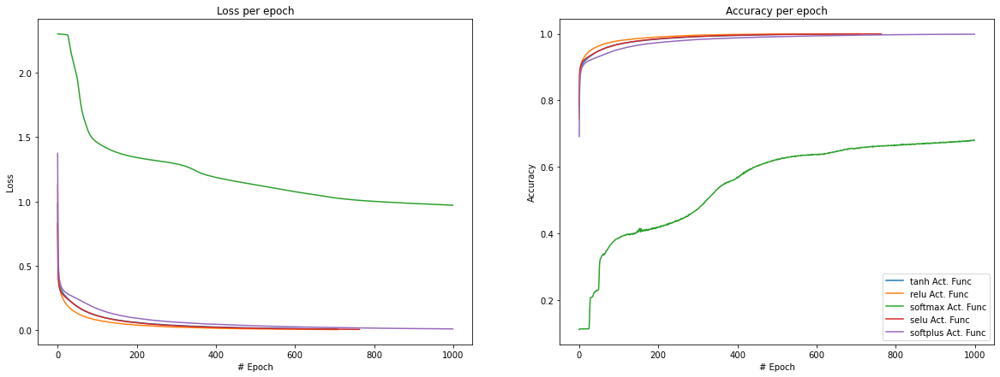

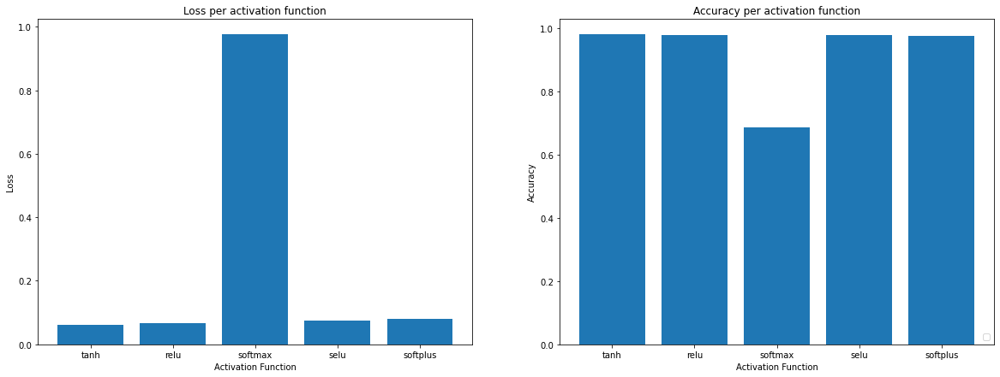

In [16]:
# Evaluation
# Train 
fig, (loss_ax, acc_ax) = plt.subplots(1, 2, figsize=(20,7))

loss_ax.set_title('Loss per epoch')
for i in range(0, len(arr)):
  loss_ax.plot(histories[i].history['loss'], label='' + str(arr[i]) + ' Act. Func.')
loss_ax.set(xlabel='# Epoch', ylabel='Loss')

acc_ax.set_title('Accuracy per epoch')
for i in range(0, len(arr)):
  acc_ax.plot(histories[i].history['accuracy'], label='' + str(arr[i]) + ' Act. Func')
acc_ax.set(xlabel='# Epoch', ylabel='Accuracy')

plt.legend(loc=4)
plt.show()


fig, (loss_ax, acc_ax) = plt.subplots(1, 2, figsize=(20,7))

loss_ax.set_title('Loss per activation function')
loss_ax.bar(arr, [i[0] for i in test_accuracies])
loss_ax.set(xlabel='Activation Function', ylabel='Loss')

acc_ax.set_title('Accuracy per activation function')
acc_ax.bar(arr, [i[1] for i in test_accuracies])
acc_ax.set(xlabel='Activation Function', ylabel='Accuracy')

plt.legend(loc=4)
plt.show()

#### Number of hidden layers
0, 1, 2, 4, 8 , 16, 32

In [19]:
arr = [0, 1, 2, 4, 8, 16, 32]
#arr = [0, 1]
histories = []
test_accuracies = []

for no_hidden in arr:
  # Definition
  cur_model = tf.keras.Sequential(name='ff_variable_hidden_' + str(no_hidden))
  
  cur_model.add(tf.keras.layers.Input(mnist_info.features['image'].shape)) # Input
  cur_model.add(tf.keras.layers.Flatten(input_shape=(28, 28))) # Flatten

  for i in range(0, no_hidden):
    cur_model.add(tf.keras.layers.Dense(256, activation='tanh')) # Hidden

  cur_model.add(tf.keras.layers.Dense(mnist_info.features['label'].num_classes, activation='softmax', name='output')) #Output

  cur_model.compile(loss='sparse_categorical_crossentropy', optimizer='sgd', metrics=['accuracy'])

  # Stopping Callbacks
  earlystop = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=50, verbose=1)
  checkpoint = tf.keras.callbacks.ModelCheckpoint('ff_variable_hid_' + str(no_hidden) + '.h5', monitor='val_accuracy', verbose=1, save_best_only=True)

  histories += [cur_model.fit(ds_train, validation_data=ds_val, callbacks=[earlystop,checkpoint], epochs=no_epochs, batch_size=128)]

  test_accuracies += [cur_model.evaluate(ds_test)]

Epoch 1/1000
    394/Unknown - 0s 547us/step - loss: 1.3595 - accuracy: 0.6659
Epoch 00001: val_accuracy improved from -inf to 0.81611, saving model to ff_variable_hid_0.h5
469/469 [==============================] - 0s 830us/step - loss: 1.2802 - accuracy: 0.6901 - val_loss: 0.8456 - val_accuracy: 0.8161
Epoch 2/1000
402/469 [========================>.....] - ETA: 0s - loss: 0.7336 - accuracy: 0.8382
Epoch 00002: val_accuracy improved from 0.81611 to 0.84733, saving model to ff_variable_hid_0.h5
469/469 [==============================] - 0s 665us/step - loss: 0.7204 - accuracy: 0.8399 - val_loss: 0.6421 - val_accuracy: 0.8473
Epoch 3/1000
380/469 [=======================>......] - ETA: 0s - loss: 0.5979 - accuracy: 0.8583
Epoch 00003: val_accuracy improved from 0.84733 to 0.86078, saving model to ff_variable_hid_0.h5
469/469 [==============================] - 0s 675us/step - loss: 0.5896 - accuracy: 0.8594 - val_loss: 0.5600 - val_accuracy: 0.8608
Epoch 4/1000
395/469 [================

Epoch 26/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.3402 - accuracy: 0.9060
Epoch 00026: val_accuracy did not improve from 0.90244
469/469 [==============================] - 0s 636us/step - loss: 0.3393 - accuracy: 0.9059 - val_loss: 0.3488 - val_accuracy: 0.9023
Epoch 27/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.3377 - accuracy: 0.9059
Epoch 00027: val_accuracy did not improve from 0.90244
469/469 [==============================] - 0s 632us/step - loss: 0.3374 - accuracy: 0.9061 - val_loss: 0.3469 - val_accuracy: 0.9024
Epoch 28/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.3350 - accuracy: 0.9070
Epoch 00028: val_accuracy improved from 0.90244 to 0.90289, saving model to ff_variable_hid_0.h5
469/469 [==============================] - 0s 621us/step - loss: 0.3355 - accuracy: 0.9066 - val_loss: 0.3453 - val_accuracy: 0.9029
Epoch 29/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.3331 - accuracy: 0.907

399/469 [========================>.....] - ETA: 0s - loss: 0.2958 - accuracy: 0.9171
Epoch 00079: val_accuracy improved from 0.91400 to 0.91444, saving model to ff_variable_hid_0.h5
469/469 [==============================] - 0s 663us/step - loss: 0.2940 - accuracy: 0.9179 - val_loss: 0.3043 - val_accuracy: 0.9144
Epoch 80/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.2921 - accuracy: 0.9187
Epoch 00080: val_accuracy did not improve from 0.91444
469/469 [==============================] - 0s 589us/step - loss: 0.2936 - accuracy: 0.9183 - val_loss: 0.3041 - val_accuracy: 0.9144
Epoch 81/1000
358/469 [=====================>........] - ETA: 0s - loss: 0.2964 - accuracy: 0.9164
Epoch 00081: val_accuracy improved from 0.91444 to 0.91456, saving model to ff_variable_hid_0.h5
469/469 [==============================] - 0s 616us/step - loss: 0.2932 - accuracy: 0.9178 - val_loss: 0.3036 - val_accuracy: 0.9146
Epoch 82/1000
438/469 [===========================>..] - ETA: 0s - lo

Epoch 107/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.2822 - accuracy: 0.9203
Epoch 00107: val_accuracy improved from 0.91700 to 0.91822, saving model to ff_variable_hid_0.h5
469/469 [==============================] - 0s 644us/step - loss: 0.2851 - accuracy: 0.9203 - val_loss: 0.2958 - val_accuracy: 0.9182
Epoch 108/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2855 - accuracy: 0.9205
Epoch 00108: val_accuracy did not improve from 0.91822
469/469 [==============================] - 0s 605us/step - loss: 0.2849 - accuracy: 0.9203 - val_loss: 0.2955 - val_accuracy: 0.9166
Epoch 109/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.2849 - accuracy: 0.9207
Epoch 00109: val_accuracy did not improve from 0.91822
469/469 [==============================] - 0s 609us/step - loss: 0.2846 - accuracy: 0.9207 - val_loss: 0.2952 - val_accuracy: 0.9172
Epoch 110/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2845 - accuracy: 0

Epoch 135/1000
405/469 [========================>.....] - ETA: 0s - loss: 0.2804 - accuracy: 0.9220
Epoch 00135: val_accuracy did not improve from 0.91978
469/469 [==============================] - 0s 638us/step - loss: 0.2791 - accuracy: 0.9222 - val_loss: 0.2897 - val_accuracy: 0.9193
Epoch 136/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.2792 - accuracy: 0.9218
Epoch 00136: val_accuracy improved from 0.91978 to 0.91989, saving model to ff_variable_hid_0.h5
469/469 [==============================] - 0s 631us/step - loss: 0.2789 - accuracy: 0.9222 - val_loss: 0.2897 - val_accuracy: 0.9199
Epoch 137/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.2793 - accuracy: 0.9226
Epoch 00137: val_accuracy improved from 0.91989 to 0.92033, saving model to ff_variable_hid_0.h5
469/469 [==============================] - 0s 630us/step - loss: 0.2787 - accuracy: 0.9226 - val_loss: 0.2895 - val_accuracy: 0.9203
Epoch 138/1000
418/469 [=========================>..

Epoch 163/1000
457/469 [============================>.] - ETA: 0s - loss: 0.2750 - accuracy: 0.9236
Epoch 00163: val_accuracy did not improve from 0.92178
469/469 [==============================] - 0s 606us/step - loss: 0.2746 - accuracy: 0.9237 - val_loss: 0.2853 - val_accuracy: 0.9214
Epoch 164/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.2735 - accuracy: 0.9243
Epoch 00164: val_accuracy did not improve from 0.92178
469/469 [==============================] - 0s 637us/step - loss: 0.2744 - accuracy: 0.9240 - val_loss: 0.2853 - val_accuracy: 0.9213
Epoch 165/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.2724 - accuracy: 0.9243
Epoch 00165: val_accuracy improved from 0.92178 to 0.92189, saving model to ff_variable_hid_0.h5
469/469 [==============================] - 0s 631us/step - loss: 0.2743 - accuracy: 0.9240 - val_loss: 0.2851 - val_accuracy: 0.9219
Epoch 166/1000
405/469 [========================>.....] - ETA: 0s - loss: 0.2728 - accuracy: 0

Epoch 191/1000
461/469 [============================>.] - ETA: 0s - loss: 0.2710 - accuracy: 0.9249
Epoch 00191: val_accuracy did not improve from 0.92256
469/469 [==============================] - 0s 609us/step - loss: 0.2710 - accuracy: 0.9248 - val_loss: 0.2819 - val_accuracy: 0.9223
Epoch 192/1000
401/469 [========================>.....] - ETA: 0s - loss: 0.2707 - accuracy: 0.9246
Epoch 00192: val_accuracy did not improve from 0.92256
469/469 [==============================] - 0s 625us/step - loss: 0.2709 - accuracy: 0.9248 - val_loss: 0.2818 - val_accuracy: 0.9223
Epoch 193/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.2694 - accuracy: 0.9256
Epoch 00193: val_accuracy did not improve from 0.92256
469/469 [==============================] - 0s 618us/step - loss: 0.2708 - accuracy: 0.9250 - val_loss: 0.2815 - val_accuracy: 0.9224
Epoch 194/1000
376/469 [=======================>......] - ETA: 0s - loss: 0.2707 - accuracy: 0.9252
Epoch 00194: val_accuracy did not im

Epoch 219/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.2677 - accuracy: 0.9256
Epoch 00219: val_accuracy did not improve from 0.92333
469/469 [==============================] - 0s 606us/step - loss: 0.2681 - accuracy: 0.9254 - val_loss: 0.2789 - val_accuracy: 0.9232
Epoch 220/1000
402/469 [========================>.....] - ETA: 0s - loss: 0.2688 - accuracy: 0.9255
Epoch 00220: val_accuracy did not improve from 0.92333
469/469 [==============================] - 0s 616us/step - loss: 0.2680 - accuracy: 0.9255 - val_loss: 0.2790 - val_accuracy: 0.9228
Epoch 221/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.2674 - accuracy: 0.9259
Epoch 00221: val_accuracy did not improve from 0.92333
469/469 [==============================] - 0s 629us/step - loss: 0.2680 - accuracy: 0.9257 - val_loss: 0.2788 - val_accuracy: 0.9228
Epoch 222/1000
465/469 [============================>.] - ETA: 0s - loss: 0.2681 - accuracy: 0.9259
Epoch 00222: val_accuracy did not im

434/469 [==========================>...] - ETA: 0s - loss: 0.2644 - accuracy: 0.9268
Epoch 00247: val_accuracy did not improve from 0.92411
469/469 [==============================] - 0s 628us/step - loss: 0.2657 - accuracy: 0.9264 - val_loss: 0.2764 - val_accuracy: 0.9238
Epoch 248/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.2664 - accuracy: 0.9263
Epoch 00248: val_accuracy did not improve from 0.92411
469/469 [==============================] - 0s 639us/step - loss: 0.2656 - accuracy: 0.9265 - val_loss: 0.2764 - val_accuracy: 0.9237
Epoch 249/1000
376/469 [=======================>......] - ETA: 0s - loss: 0.2627 - accuracy: 0.9267
Epoch 00249: val_accuracy did not improve from 0.92411
469/469 [==============================] - 0s 642us/step - loss: 0.2655 - accuracy: 0.9267 - val_loss: 0.2763 - val_accuracy: 0.9236
Epoch 250/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.2663 - accuracy: 0.9259
Epoch 00250: val_accuracy did not improve from 0.92

403/469 [========================>.....] - ETA: 0s - loss: 0.2625 - accuracy: 0.9271
Epoch 00303: val_accuracy did not improve from 0.92567
469/469 [==============================] - 0s 612us/step - loss: 0.2618 - accuracy: 0.9276 - val_loss: 0.2725 - val_accuracy: 0.9253
Epoch 304/1000
381/469 [=======================>......] - ETA: 0s - loss: 0.2607 - accuracy: 0.9282
Epoch 00304: val_accuracy did not improve from 0.92567
469/469 [==============================] - 0s 646us/step - loss: 0.2617 - accuracy: 0.9276 - val_loss: 0.2724 - val_accuracy: 0.9256
Epoch 305/1000
464/469 [============================>.] - ETA: 0s - loss: 0.2621 - accuracy: 0.9276
Epoch 00305: val_accuracy improved from 0.92567 to 0.92600, saving model to ff_variable_hid_0.h5
469/469 [==============================] - 0s 726us/step - loss: 0.2616 - accuracy: 0.9276 - val_loss: 0.2723 - val_accuracy: 0.9260
Epoch 306/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.2614 - accuracy: 0.9276
Epoch 003

403/469 [========================>.....] - ETA: 0s - loss: 0.2592 - accuracy: 0.9280
Epoch 00359: val_accuracy did not improve from 0.92678
469/469 [==============================] - 0s 621us/step - loss: 0.2587 - accuracy: 0.9287 - val_loss: 0.2694 - val_accuracy: 0.9260
Epoch 360/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.2611 - accuracy: 0.9282
Epoch 00360: val_accuracy did not improve from 0.92678
469/469 [==============================] - 0s 623us/step - loss: 0.2587 - accuracy: 0.9288 - val_loss: 0.2694 - val_accuracy: 0.9267
Epoch 361/1000
351/469 [=====================>........] - ETA: 0s - loss: 0.2579 - accuracy: 0.9284
Epoch 00361: val_accuracy did not improve from 0.92678
469/469 [==============================] - 0s 585us/step - loss: 0.2586 - accuracy: 0.9287 - val_loss: 0.2693 - val_accuracy: 0.9262
Epoch 362/1000
376/469 [=======================>......] - ETA: 0s - loss: 0.2596 - accuracy: 0.9284
Epoch 00362: val_accuracy did not improve from 0.92

462/469 [============================>.] - ETA: 0s - loss: 0.2568 - accuracy: 0.9296
Epoch 00415: val_accuracy did not improve from 0.92822
469/469 [==============================] - 0s 706us/step - loss: 0.2562 - accuracy: 0.9295 - val_loss: 0.2668 - val_accuracy: 0.9276
Epoch 416/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.2554 - accuracy: 0.9301
Epoch 00416: val_accuracy did not improve from 0.92822
469/469 [==============================] - 0s 626us/step - loss: 0.2562 - accuracy: 0.9295 - val_loss: 0.2667 - val_accuracy: 0.9274
Epoch 417/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.2573 - accuracy: 0.9297
Epoch 00417: val_accuracy did not improve from 0.92822
469/469 [==============================] - 0s 624us/step - loss: 0.2561 - accuracy: 0.9295 - val_loss: 0.2667 - val_accuracy: 0.9276
Epoch 418/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.2553 - accuracy: 0.9296
Epoch 00418: val_accuracy did not improve from 0.92

463/469 [============================>.] - ETA: 0s - loss: 0.2538 - accuracy: 0.9303
Epoch 00471: val_accuracy did not improve from 0.92922
469/469 [==============================] - 0s 671us/step - loss: 0.2541 - accuracy: 0.9303 - val_loss: 0.2646 - val_accuracy: 0.9291
Epoch 472/1000
464/469 [============================>.] - ETA: 0s - loss: 0.2545 - accuracy: 0.9301
Epoch 00472: val_accuracy improved from 0.92922 to 0.92933, saving model to ff_variable_hid_0.h5
469/469 [==============================] - 0s 690us/step - loss: 0.2541 - accuracy: 0.9302 - val_loss: 0.2645 - val_accuracy: 0.9293
Epoch 473/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.2523 - accuracy: 0.9312
Epoch 00473: val_accuracy did not improve from 0.92933
469/469 [==============================] - 0s 707us/step - loss: 0.2541 - accuracy: 0.9303 - val_loss: 0.2647 - val_accuracy: 0.9293
Epoch 474/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.2532 - accuracy: 0.9300
Epoch 004

384/469 [=======================>......] - ETA: 0s - loss: 0.2536 - accuracy: 0.9303
Epoch 00527: val_accuracy did not improve from 0.93033
469/469 [==============================] - 0s 631us/step - loss: 0.2523 - accuracy: 0.9308 - val_loss: 0.2627 - val_accuracy: 0.9298
Epoch 528/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.2521 - accuracy: 0.9309
Epoch 00528: val_accuracy did not improve from 0.93033
469/469 [==============================] - 0s 608us/step - loss: 0.2523 - accuracy: 0.9309 - val_loss: 0.2628 - val_accuracy: 0.9296
Epoch 529/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.2522 - accuracy: 0.9309
Epoch 00529: val_accuracy did not improve from 0.93033
469/469 [==============================] - 0s 606us/step - loss: 0.2523 - accuracy: 0.9308 - val_loss: 0.2628 - val_accuracy: 0.9296
Epoch 530/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2537 - accuracy: 0.9311
Epoch 00530: val_accuracy did not improve from 0.93

Epoch 556/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2546 - accuracy: 0.9306
Epoch 00556: val_accuracy did not improve from 0.93033
469/469 [==============================] - 0s 604us/step - loss: 0.2515 - accuracy: 0.9309 - val_loss: 0.2620 - val_accuracy: 0.9297
Epoch 557/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.2499 - accuracy: 0.9310
Epoch 00557: val_accuracy did not improve from 0.93033
469/469 [==============================] - 0s 623us/step - loss: 0.2515 - accuracy: 0.9310 - val_loss: 0.2619 - val_accuracy: 0.9298
Epoch 558/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.2531 - accuracy: 0.9308
Epoch 00558: val_accuracy did not improve from 0.93033
469/469 [==============================] - 0s 606us/step - loss: 0.2514 - accuracy: 0.9311 - val_loss: 0.2618 - val_accuracy: 0.9302
Epoch 559/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.2515 - accuracy: 0.9311
Epoch 00559: val_accuracy did not im

Epoch 22/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.2578 - accuracy: 0.9271
Epoch 00022: val_accuracy improved from 0.92233 to 0.92322, saving model to ff_variable_hid_1.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.2569 - accuracy: 0.9271 - val_loss: 0.2645 - val_accuracy: 0.9232
Epoch 23/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.2530 - accuracy: 0.9281
Epoch 00023: val_accuracy improved from 0.92322 to 0.92444, saving model to ff_variable_hid_1.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.2535 - accuracy: 0.9281 - val_loss: 0.2612 - val_accuracy: 0.9244
Epoch 24/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.2505 - accuracy: 0.9292
Epoch 00024: val_accuracy improved from 0.92444 to 0.92578, saving model to ff_variable_hid_1.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.2501 - accuracy: 0.9294 - val_loss: 0.2572 - val_accuracy: 0.9258
Epoch 25/1000
434/4

Epoch 73/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.1416 - accuracy: 0.9602
Epoch 00073: val_accuracy improved from 0.95878 to 0.95911, saving model to ff_variable_hid_1.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.1424 - accuracy: 0.9603 - val_loss: 0.1453 - val_accuracy: 0.9591
Epoch 74/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.1404 - accuracy: 0.9605
Epoch 00074: val_accuracy improved from 0.95911 to 0.95956, saving model to ff_variable_hid_1.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.1411 - accuracy: 0.9604 - val_loss: 0.1442 - val_accuracy: 0.9596
Epoch 75/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.1402 - accuracy: 0.9603
Epoch 00075: val_accuracy improved from 0.95956 to 0.95989, saving model to ff_variable_hid_1.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.1398 - accuracy: 0.9607 - val_loss: 0.1428 - val_accuracy: 0.9599
Epoch 76/1000
422/4

Epoch 100/1000
457/469 [============================>.] - ETA: 0s - loss: 0.1133 - accuracy: 0.9686
Epoch 00100: val_accuracy did not improve from 0.96833
469/469 [==============================] - 1s 1ms/step - loss: 0.1134 - accuracy: 0.9686 - val_loss: 0.1153 - val_accuracy: 0.9682
Epoch 101/1000
463/469 [============================>.] - ETA: 0s - loss: 0.1125 - accuracy: 0.9688
Epoch 00101: val_accuracy improved from 0.96833 to 0.96867, saving model to ff_variable_hid_1.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.1126 - accuracy: 0.9688 - val_loss: 0.1145 - val_accuracy: 0.9687
Epoch 102/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.1120 - accuracy: 0.9691
Epoch 00102: val_accuracy did not improve from 0.96867
469/469 [==============================] - 1s 1ms/step - loss: 0.1118 - accuracy: 0.9692 - val_loss: 0.1138 - val_accuracy: 0.9684
Epoch 103/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.1126 - accuracy: 0.9690


Epoch 153/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.0793 - accuracy: 0.9788
Epoch 00153: val_accuracy did not improve from 0.97878
469/469 [==============================] - 1s 1ms/step - loss: 0.0797 - accuracy: 0.9788 - val_loss: 0.0815 - val_accuracy: 0.9784
Epoch 154/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0792 - accuracy: 0.9787
Epoch 00154: val_accuracy did not improve from 0.97878
469/469 [==============================] - 1s 1ms/step - loss: 0.0793 - accuracy: 0.9786 - val_loss: 0.0805 - val_accuracy: 0.9788
Epoch 155/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.0803 - accuracy: 0.9781
Epoch 00155: val_accuracy improved from 0.97878 to 0.97889, saving model to ff_variable_hid_1.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0788 - accuracy: 0.9786 - val_loss: 0.0804 - val_accuracy: 0.9789
Epoch 156/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.0780 - accuracy: 0.9790


Epoch 207/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0593 - accuracy: 0.9848
Epoch 00207: val_accuracy did not improve from 0.98456
469/469 [==============================] - 1s 1ms/step - loss: 0.0596 - accuracy: 0.9847 - val_loss: 0.0611 - val_accuracy: 0.9843
Epoch 208/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0592 - accuracy: 0.9846
Epoch 00208: val_accuracy did not improve from 0.98456
469/469 [==============================] - 1s 1ms/step - loss: 0.0593 - accuracy: 0.9845 - val_loss: 0.0607 - val_accuracy: 0.9844
Epoch 209/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.0589 - accuracy: 0.9845
Epoch 00209: val_accuracy did not improve from 0.98456
469/469 [==============================] - 1s 1ms/step - loss: 0.0590 - accuracy: 0.9847 - val_loss: 0.0603 - val_accuracy: 0.9846
Epoch 210/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0587 - accuracy: 0.9849
Epoch 00210: val_accuracy improved from 0.

Epoch 235/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.0517 - accuracy: 0.9868
Epoch 00235: val_accuracy improved from 0.98633 to 0.98667, saving model to ff_variable_hid_1.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0520 - accuracy: 0.9868 - val_loss: 0.0533 - val_accuracy: 0.9867
Epoch 236/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.0517 - accuracy: 0.9868
Epoch 00236: val_accuracy improved from 0.98667 to 0.98678, saving model to ff_variable_hid_1.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0518 - accuracy: 0.9867 - val_loss: 0.0532 - val_accuracy: 0.9868
Epoch 237/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.0515 - accuracy: 0.9867
Epoch 00237: val_accuracy did not improve from 0.98678
469/469 [==============================] - 1s 1ms/step - loss: 0.0515 - accuracy: 0.9869 - val_loss: 0.0529 - val_accuracy: 0.9868
Epoch 238/1000
433/469 [==========================>...] - 

Epoch 263/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.0462 - accuracy: 0.9887
Epoch 00263: val_accuracy did not improve from 0.98800
469/469 [==============================] - 1s 1ms/step - loss: 0.0458 - accuracy: 0.9888 - val_loss: 0.0474 - val_accuracy: 0.9878
Epoch 264/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.0452 - accuracy: 0.9889
Epoch 00264: val_accuracy did not improve from 0.98800
469/469 [==============================] - 1s 1ms/step - loss: 0.0456 - accuracy: 0.9889 - val_loss: 0.0471 - val_accuracy: 0.9880
Epoch 265/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.0452 - accuracy: 0.9889
Epoch 00265: val_accuracy improved from 0.98800 to 0.98811, saving model to ff_variable_hid_1.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0454 - accuracy: 0.9889 - val_loss: 0.0468 - val_accuracy: 0.9881
Epoch 266/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.0453 - accuracy: 0.9889


Epoch 291/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0406 - accuracy: 0.9901
Epoch 00291: val_accuracy did not improve from 0.98956
469/469 [==============================] - 1s 1ms/step - loss: 0.0406 - accuracy: 0.9901 - val_loss: 0.0421 - val_accuracy: 0.9896
Epoch 292/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.0401 - accuracy: 0.9902
Epoch 00292: val_accuracy did not improve from 0.98956
469/469 [==============================] - 1s 1ms/step - loss: 0.0404 - accuracy: 0.9901 - val_loss: 0.0418 - val_accuracy: 0.9893
Epoch 293/1000
469/469 [==============================] - ETA: 0s - loss: 0.0402 - accuracy: 0.9905
Epoch 00293: val_accuracy improved from 0.98956 to 0.98978, saving model to ff_variable_hid_1.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0402 - accuracy: 0.9905 - val_loss: 0.0417 - val_accuracy: 0.9898
Epoch 294/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.0397 - accuracy: 0.9904


Epoch 319/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0362 - accuracy: 0.9916
Epoch 00319: val_accuracy did not improve from 0.99178
469/469 [==============================] - 1s 1ms/step - loss: 0.0361 - accuracy: 0.9917 - val_loss: 0.0376 - val_accuracy: 0.9916
Epoch 320/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0360 - accuracy: 0.9918
Epoch 00320: val_accuracy did not improve from 0.99178
469/469 [==============================] - 1s 1ms/step - loss: 0.0360 - accuracy: 0.9918 - val_loss: 0.0374 - val_accuracy: 0.9914
Epoch 321/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0358 - accuracy: 0.9919 ETA: 0s - loss: 0.0364 - ac
Epoch 00321: val_accuracy did not improve from 0.99178
469/469 [==============================] - 1s 1ms/step - loss: 0.0358 - accuracy: 0.9919 - val_loss: 0.0374 - val_accuracy: 0.9914
Epoch 322/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.0356 - accuracy: 0.9921
Epoch 00322: v

Epoch 347/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.0323 - accuracy: 0.9933
Epoch 00347: val_accuracy did not improve from 0.99300
469/469 [==============================] - 1s 1ms/step - loss: 0.0323 - accuracy: 0.9931 - val_loss: 0.0337 - val_accuracy: 0.9924
Epoch 348/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0321 - accuracy: 0.9933
Epoch 00348: val_accuracy did not improve from 0.99300
469/469 [==============================] - 1s 1ms/step - loss: 0.0322 - accuracy: 0.9932 - val_loss: 0.0338 - val_accuracy: 0.9927
Epoch 349/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.0322 - accuracy: 0.9932
Epoch 00349: val_accuracy did not improve from 0.99300
469/469 [==============================] - 1s 1ms/step - loss: 0.0320 - accuracy: 0.9932 - val_loss: 0.0335 - val_accuracy: 0.9929
Epoch 350/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.0320 - accuracy: 0.9930
Epoch 00350: val_accuracy did not improve 

Epoch 375/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0288 - accuracy: 0.9943
Epoch 00375: val_accuracy did not improve from 0.99411
469/469 [==============================] - 1s 1ms/step - loss: 0.0290 - accuracy: 0.9942 - val_loss: 0.0305 - val_accuracy: 0.9938
Epoch 376/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0288 - accuracy: 0.9944
Epoch 00376: val_accuracy did not improve from 0.99411
469/469 [==============================] - 1s 1ms/step - loss: 0.0289 - accuracy: 0.9943 - val_loss: 0.0303 - val_accuracy: 0.9938
Epoch 377/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0289 - accuracy: 0.9943
Epoch 00377: val_accuracy did not improve from 0.99411
469/469 [==============================] - 1s 1ms/step - loss: 0.0288 - accuracy: 0.9944 - val_loss: 0.0301 - val_accuracy: 0.9939
Epoch 378/1000
461/469 [============================>.] - ETA: 0s - loss: 0.0288 - accuracy: 0.9945
Epoch 00378: val_accuracy did not improve 

Epoch 431/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0237 - accuracy: 0.9959
Epoch 00431: val_accuracy did not improve from 0.99556
469/469 [==============================] - 1s 1ms/step - loss: 0.0236 - accuracy: 0.9959 - val_loss: 0.0250 - val_accuracy: 0.9954
Epoch 432/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0236 - accuracy: 0.9958
Epoch 00432: val_accuracy did not improve from 0.99556
469/469 [==============================] - 1s 1ms/step - loss: 0.0235 - accuracy: 0.9958 - val_loss: 0.0248 - val_accuracy: 0.9953
Epoch 433/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.0236 - accuracy: 0.9959
Epoch 00433: val_accuracy improved from 0.99556 to 0.99567, saving model to ff_variable_hid_1.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0235 - accuracy: 0.9959 - val_loss: 0.0247 - val_accuracy: 0.9957
Epoch 434/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.0230 - accuracy: 0.9960


Epoch 459/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.0215 - accuracy: 0.9966
Epoch 00459: val_accuracy improved from 0.99644 to 0.99656, saving model to ff_variable_hid_1.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0214 - accuracy: 0.9966 - val_loss: 0.0225 - val_accuracy: 0.9966
Epoch 460/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.0213 - accuracy: 0.9967
Epoch 00460: val_accuracy did not improve from 0.99656
469/469 [==============================] - 1s 1ms/step - loss: 0.0214 - accuracy: 0.9967 - val_loss: 0.0225 - val_accuracy: 0.9966
Epoch 461/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.0214 - accuracy: 0.9967
Epoch 00461: val_accuracy improved from 0.99656 to 0.99667, saving model to ff_variable_hid_1.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0213 - accuracy: 0.9967 - val_loss: 0.0225 - val_accuracy: 0.9967
Epoch 462/1000
438/469 [===========================>..] - 

Epoch 487/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.0195 - accuracy: 0.9971
Epoch 00487: val_accuracy did not improve from 0.99733
469/469 [==============================] - 1s 1ms/step - loss: 0.0195 - accuracy: 0.9973 - val_loss: 0.0205 - val_accuracy: 0.9972
Epoch 488/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.0193 - accuracy: 0.9972
Epoch 00488: val_accuracy did not improve from 0.99733
469/469 [==============================] - 1s 1ms/step - loss: 0.0194 - accuracy: 0.9973 - val_loss: 0.0205 - val_accuracy: 0.9972
Epoch 489/1000
469/469 [==============================] - ETA: 0s - loss: 0.0194 - accuracy: 0.9973
Epoch 00489: val_accuracy did not improve from 0.99733
469/469 [==============================] - 1s 1ms/step - loss: 0.0194 - accuracy: 0.9973 - val_loss: 0.0204 - val_accuracy: 0.9972
Epoch 490/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0193 - accuracy: 0.9973
Epoch 00490: val_accuracy did not improve 

Epoch 544/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0163 - accuracy: 0.9982
Epoch 00544: val_accuracy did not improve from 0.99789
469/469 [==============================] - 1s 1ms/step - loss: 0.0163 - accuracy: 0.9982 - val_loss: 0.0171 - val_accuracy: 0.9979
Epoch 545/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0162 - accuracy: 0.9982
Epoch 00545: val_accuracy did not improve from 0.99789
469/469 [==============================] - 1s 1ms/step - loss: 0.0162 - accuracy: 0.9982 - val_loss: 0.0171 - val_accuracy: 0.9979
Epoch 546/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.0164 - accuracy: 0.9981
Epoch 00546: val_accuracy did not improve from 0.99789
469/469 [==============================] - 1s 1ms/step - loss: 0.0162 - accuracy: 0.9982 - val_loss: 0.0170 - val_accuracy: 0.9979
Epoch 547/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0161 - accuracy: 0.9982
Epoch 00547: val_accuracy improved from 0.

Epoch 601/1000
459/469 [============================>.] - ETA: 0s - loss: 0.0137 - accuracy: 0.9988
Epoch 00601: val_accuracy improved from 0.99822 to 0.99833, saving model to ff_variable_hid_1.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0137 - accuracy: 0.9988 - val_loss: 0.0145 - val_accuracy: 0.9983
Epoch 602/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.0139 - accuracy: 0.9988
Epoch 00602: val_accuracy did not improve from 0.99833
469/469 [==============================] - 1s 1ms/step - loss: 0.0137 - accuracy: 0.9988 - val_loss: 0.0144 - val_accuracy: 0.9982
Epoch 603/1000
461/469 [============================>.] - ETA: 0s - loss: 0.0137 - accuracy: 0.9988
Epoch 00603: val_accuracy did not improve from 0.99833
469/469 [==============================] - 1s 1ms/step - loss: 0.0137 - accuracy: 0.9988 - val_loss: 0.0144 - val_accuracy: 0.9982
Epoch 604/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0136 - accuracy: 0.9988


468/469 [============================>.] - ETA: 0s - loss: 0.0117 - accuracy: 0.9992
Epoch 00657: val_accuracy did not improve from 0.99889
469/469 [==============================] - 1s 1ms/step - loss: 0.0117 - accuracy: 0.9992 - val_loss: 0.0123 - val_accuracy: 0.9989
Epoch 658/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.0117 - accuracy: 0.9992
Epoch 00658: val_accuracy did not improve from 0.99889
469/469 [==============================] - 1s 1ms/step - loss: 0.0117 - accuracy: 0.9992 - val_loss: 0.0124 - val_accuracy: 0.9989
Epoch 659/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.0118 - accuracy: 0.9992
Epoch 00659: val_accuracy did not improve from 0.99889
469/469 [==============================] - 1s 1ms/step - loss: 0.0117 - accuracy: 0.9992 - val_loss: 0.0123 - val_accuracy: 0.9989
Epoch 660/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.0114 - accuracy: 0.9992
Epoch 00660: val_accuracy improved from 0.99889 to 0.9990

Epoch 686/1000
469/469 [==============================] - ETA: 0s - loss: 0.0109 - accuracy: 0.9994
Epoch 00686: val_accuracy did not improve from 0.99911
469/469 [==============================] - 1s 1ms/step - loss: 0.0109 - accuracy: 0.9994 - val_loss: 0.0115 - val_accuracy: 0.9991
Epoch 687/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.0109 - accuracy: 0.9993
Epoch 00687: val_accuracy did not improve from 0.99911
469/469 [==============================] - 1s 1ms/step - loss: 0.0109 - accuracy: 0.9993 - val_loss: 0.0115 - val_accuracy: 0.9991
Epoch 688/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0108 - accuracy: 0.9993
Epoch 00688: val_accuracy did not improve from 0.99911
469/469 [==============================] - 1s 1ms/step - loss: 0.0108 - accuracy: 0.9994 - val_loss: 0.0114 - val_accuracy: 0.9990
Epoch 689/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.0108 - accuracy: 0.9993
Epoch 00689: val_accuracy improved from 0.

Epoch 743/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.0094 - accuracy: 0.9995
Epoch 00743: val_accuracy did not improve from 0.99933
469/469 [==============================] - 1s 1ms/step - loss: 0.0094 - accuracy: 0.9995 - val_loss: 0.0099 - val_accuracy: 0.9993
Epoch 744/1000
469/469 [==============================] - ETA: 0s - loss: 0.0094 - accuracy: 0.9995
Epoch 00744: val_accuracy did not improve from 0.99933
469/469 [==============================] - 1s 1ms/step - loss: 0.0094 - accuracy: 0.9995 - val_loss: 0.0099 - val_accuracy: 0.9993
Epoch 745/1000
469/469 [==============================] - ETA: 0s - loss: 0.0094 - accuracy: 0.9995
Epoch 00745: val_accuracy did not improve from 0.99933
469/469 [==============================] - 1s 1ms/step - loss: 0.0094 - accuracy: 0.9995 - val_loss: 0.0099 - val_accuracy: 0.9993
Epoch 746/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0094 - accuracy: 0.9995
Epoch 00746: val_accuracy did not improve 

469/469 [==============================] - 1s 2ms/step - loss: 0.2686 - accuracy: 0.9240 - val_loss: 0.2738 - val_accuracy: 0.9209
Epoch 12/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.2625 - accuracy: 0.9255
Epoch 00012: val_accuracy improved from 0.92089 to 0.92178, saving model to ff_variable_hid_2.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.2621 - accuracy: 0.9256 - val_loss: 0.2679 - val_accuracy: 0.9218
Epoch 13/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.2564 - accuracy: 0.9265
Epoch 00013: val_accuracy improved from 0.92178 to 0.92400, saving model to ff_variable_hid_2.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.2562 - accuracy: 0.9268 - val_loss: 0.2608 - val_accuracy: 0.9240
Epoch 14/1000
462/469 [============================>.] - ETA: 0s - loss: 0.2503 - accuracy: 0.9290
Epoch 00014: val_accuracy improved from 0.92400 to 0.92489, saving model to ff_variable_hid_2.h5
469/469 [==========

Epoch 37/1000
461/469 [============================>.] - ETA: 0s - loss: 0.1539 - accuracy: 0.9568
Epoch 00037: val_accuracy improved from 0.95533 to 0.95578, saving model to ff_variable_hid_2.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.1537 - accuracy: 0.9567 - val_loss: 0.1558 - val_accuracy: 0.9558
Epoch 38/1000
460/469 [============================>.] - ETA: 0s - loss: 0.1509 - accuracy: 0.9573
Epoch 00038: val_accuracy improved from 0.95578 to 0.95767, saving model to ff_variable_hid_2.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.1509 - accuracy: 0.9572 - val_loss: 0.1523 - val_accuracy: 0.9577
Epoch 39/1000
465/469 [============================>.] - ETA: 0s - loss: 0.1481 - accuracy: 0.9580
Epoch 00039: val_accuracy improved from 0.95767 to 0.95844, saving model to ff_variable_hid_2.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.1482 - accuracy: 0.9580 - val_loss: 0.1503 - val_accuracy: 0.9584
Epoch 40/1000
460/4

Epoch 63/1000
455/469 [============================>.] - ETA: 0s - loss: 0.1010 - accuracy: 0.9715
Epoch 00063: val_accuracy improved from 0.97122 to 0.97144, saving model to ff_variable_hid_2.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.1005 - accuracy: 0.9717 - val_loss: 0.1019 - val_accuracy: 0.9714
Epoch 64/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0987 - accuracy: 0.9723
Epoch 00064: val_accuracy improved from 0.97144 to 0.97211, saving model to ff_variable_hid_2.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0992 - accuracy: 0.9722 - val_loss: 0.1002 - val_accuracy: 0.9721
Epoch 65/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0972 - accuracy: 0.9728
Epoch 00065: val_accuracy did not improve from 0.97211
469/469 [==============================] - 1s 2ms/step - loss: 0.0976 - accuracy: 0.9727 - val_loss: 0.0990 - val_accuracy: 0.9720
Epoch 66/1000
465/469 [============================>.] - ETA:

Epoch 89/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.0713 - accuracy: 0.9807
Epoch 00089: val_accuracy did not improve from 0.98000
469/469 [==============================] - 1s 2ms/step - loss: 0.0716 - accuracy: 0.9807 - val_loss: 0.0732 - val_accuracy: 0.9799
Epoch 90/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.0709 - accuracy: 0.9809 ETA: 0s - loss: 0.0705 - accuracy: 0.
Epoch 00090: val_accuracy did not improve from 0.98000
469/469 [==============================] - 1s 2ms/step - loss: 0.0706 - accuracy: 0.9809 - val_loss: 0.0715 - val_accuracy: 0.9800
Epoch 91/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.0693 - accuracy: 0.9813
Epoch 00091: val_accuracy improved from 0.98000 to 0.98011, saving model to ff_variable_hid_2.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0698 - accuracy: 0.9812 - val_loss: 0.0706 - val_accuracy: 0.9801
Epoch 92/1000
455/469 [============================>.] - ETA: 0s 

Epoch 116/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.0525 - accuracy: 0.9859
Epoch 00116: val_accuracy did not improve from 0.98556
469/469 [==============================] - 1s 2ms/step - loss: 0.0526 - accuracy: 0.9860 - val_loss: 0.0535 - val_accuracy: 0.9853
Epoch 117/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0520 - accuracy: 0.9862
Epoch 00117: val_accuracy did not improve from 0.98556
469/469 [==============================] - 1s 2ms/step - loss: 0.0521 - accuracy: 0.9862 - val_loss: 0.0531 - val_accuracy: 0.9856
Epoch 118/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0512 - accuracy: 0.9864
Epoch 00118: val_accuracy did not improve from 0.98556
469/469 [==============================] - 1s 2ms/step - loss: 0.0515 - accuracy: 0.9863 - val_loss: 0.0529 - val_accuracy: 0.9856
Epoch 119/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0511 - accuracy: 0.9864
Epoch 00119: val_accuracy improved from 0.

Epoch 143/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.0400 - accuracy: 0.9899
Epoch 00143: val_accuracy improved from 0.98989 to 0.99056, saving model to ff_variable_hid_2.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0396 - accuracy: 0.9900 - val_loss: 0.0405 - val_accuracy: 0.9906
Epoch 144/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.0391 - accuracy: 0.9902
Epoch 00144: val_accuracy improved from 0.99056 to 0.99067, saving model to ff_variable_hid_2.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0392 - accuracy: 0.9902 - val_loss: 0.0399 - val_accuracy: 0.9907
Epoch 145/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.0389 - accuracy: 0.9903
Epoch 00145: val_accuracy did not improve from 0.99067
469/469 [==============================] - 1s 2ms/step - loss: 0.0388 - accuracy: 0.9904 - val_loss: 0.0396 - val_accuracy: 0.9902
Epoch 146/1000
448/469 [===========================>..] - 

448/469 [===========================>..] - ETA: 0s - loss: 0.0232 - accuracy: 0.9955
Epoch 00197: val_accuracy did not improve from 0.99567
469/469 [==============================] - 1s 2ms/step - loss: 0.0233 - accuracy: 0.9955 - val_loss: 0.0244 - val_accuracy: 0.9951
Epoch 198/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.0230 - accuracy: 0.9957
Epoch 00198: val_accuracy did not improve from 0.99567
469/469 [==============================] - 1s 2ms/step - loss: 0.0231 - accuracy: 0.9956 - val_loss: 0.0239 - val_accuracy: 0.9956
Epoch 199/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.0225 - accuracy: 0.9959
Epoch 00199: val_accuracy did not improve from 0.99567
469/469 [==============================] - 1s 2ms/step - loss: 0.0228 - accuracy: 0.9958 - val_loss: 0.0242 - val_accuracy: 0.9957
Epoch 200/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.0223 - accuracy: 0.9959
Epoch 00200: val_accuracy did not improve from 0.99567
46

Epoch 225/1000
459/469 [============================>.] - ETA: 0s - loss: 0.0180 - accuracy: 0.9973
Epoch 00225: val_accuracy improved from 0.99711 to 0.99722, saving model to ff_variable_hid_2.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0180 - accuracy: 0.9974 - val_loss: 0.0191 - val_accuracy: 0.9972
Epoch 226/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.0179 - accuracy: 0.9975
Epoch 00226: val_accuracy did not improve from 0.99722
469/469 [==============================] - 1s 2ms/step - loss: 0.0178 - accuracy: 0.9974 - val_loss: 0.0188 - val_accuracy: 0.9972
Epoch 227/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.0176 - accuracy: 0.9975
Epoch 00227: val_accuracy did not improve from 0.99722
469/469 [==============================] - 1s 2ms/step - loss: 0.0177 - accuracy: 0.9975 - val_loss: 0.0187 - val_accuracy: 0.9971
Epoch 228/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.0175 - accuracy: 0.9974


Epoch 253/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.0139 - accuracy: 0.9985
Epoch 00253: val_accuracy did not improve from 0.99844
469/469 [==============================] - 1s 2ms/step - loss: 0.0140 - accuracy: 0.9984 - val_loss: 0.0151 - val_accuracy: 0.9983
Epoch 254/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.0138 - accuracy: 0.9985
Epoch 00254: val_accuracy did not improve from 0.99844
469/469 [==============================] - 1s 2ms/step - loss: 0.0140 - accuracy: 0.9985 - val_loss: 0.0149 - val_accuracy: 0.9984
Epoch 255/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0138 - accuracy: 0.9985
Epoch 00255: val_accuracy did not improve from 0.99844
469/469 [==============================] - 1s 2ms/step - loss: 0.0138 - accuracy: 0.9985 - val_loss: 0.0149 - val_accuracy: 0.9984
Epoch 256/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.0137 - accuracy: 0.9985
Epoch 00256: val_accuracy improved from 0.

Epoch 310/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0089 - accuracy: 0.9993
Epoch 00310: val_accuracy did not improve from 0.99900
469/469 [==============================] - 1s 2ms/step - loss: 0.0089 - accuracy: 0.9994 - val_loss: 0.0096 - val_accuracy: 0.9990
Epoch 311/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0088 - accuracy: 0.9994
Epoch 00311: val_accuracy did not improve from 0.99900
469/469 [==============================] - 1s 2ms/step - loss: 0.0089 - accuracy: 0.9994 - val_loss: 0.0095 - val_accuracy: 0.9990
Epoch 312/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0088 - accuracy: 0.9994
Epoch 00312: val_accuracy did not improve from 0.99900
469/469 [==============================] - 1s 2ms/step - loss: 0.0088 - accuracy: 0.9994 - val_loss: 0.0095 - val_accuracy: 0.9990
Epoch 313/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0087 - accuracy: 0.9993
Epoch 00313: val_accuracy did not improve 

Epoch 13/1000
458/469 [============================>.] - ETA: 0s - loss: 0.1939 - accuracy: 0.9450
Epoch 00013: val_accuracy improved from 0.94289 to 0.94456, saving model to ff_variable_hid_4.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.1942 - accuracy: 0.9451 - val_loss: 0.1925 - val_accuracy: 0.9446
Epoch 14/1000
461/469 [============================>.] - ETA: 0s - loss: 0.1858 - accuracy: 0.9472
Epoch 00014: val_accuracy improved from 0.94456 to 0.94744, saving model to ff_variable_hid_4.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.1858 - accuracy: 0.9472 - val_loss: 0.1838 - val_accuracy: 0.9474
Epoch 15/1000
459/469 [============================>.] - ETA: 0s - loss: 0.1790 - accuracy: 0.9496
Epoch 00015: val_accuracy improved from 0.94744 to 0.95011, saving model to ff_variable_hid_4.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.1782 - accuracy: 0.9498 - val_loss: 0.1757 - val_accuracy: 0.9501
Epoch 16/1000
466/4

Epoch 65/1000
469/469 [==============================] - ETA: 0s - loss: 0.0414 - accuracy: 0.9890
Epoch 00065: val_accuracy improved from 0.99011 to 0.99078, saving model to ff_variable_hid_4.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0414 - accuracy: 0.9890 - val_loss: 0.0408 - val_accuracy: 0.9908
Epoch 66/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.0402 - accuracy: 0.9896
Epoch 00066: val_accuracy did not improve from 0.99078
469/469 [==============================] - 1s 2ms/step - loss: 0.0406 - accuracy: 0.9895 - val_loss: 0.0408 - val_accuracy: 0.9894
Epoch 67/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.0395 - accuracy: 0.9901
Epoch 00067: val_accuracy did not improve from 0.99078
469/469 [==============================] - 1s 2ms/step - loss: 0.0395 - accuracy: 0.9901 - val_loss: 0.0390 - val_accuracy: 0.9902
Epoch 68/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0386 - accuracy: 0.9903
Epoc

Epoch 92/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0219 - accuracy: 0.9958
Epoch 00092: val_accuracy did not improve from 0.99622
469/469 [==============================] - 1s 2ms/step - loss: 0.0218 - accuracy: 0.9958 - val_loss: 0.0213 - val_accuracy: 0.9961
Epoch 93/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.0215 - accuracy: 0.9956
Epoch 00093: val_accuracy improved from 0.99622 to 0.99644, saving model to ff_variable_hid_4.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0214 - accuracy: 0.9956 - val_loss: 0.0209 - val_accuracy: 0.9964
Epoch 94/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.0205 - accuracy: 0.9961
Epoch 00094: val_accuracy did not improve from 0.99644
469/469 [==============================] - 1s 2ms/step - loss: 0.0207 - accuracy: 0.9959 - val_loss: 0.0206 - val_accuracy: 0.9964
Epoch 95/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.0205 - accuracy: 0.9960
Epoc

Epoch 147/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.0063 - accuracy: 0.9996
Epoch 00147: val_accuracy did not improve from 0.99956
469/469 [==============================] - 1s 2ms/step - loss: 0.0063 - accuracy: 0.9996 - val_loss: 0.0068 - val_accuracy: 0.9993
Epoch 148/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.0063 - accuracy: 0.9996
Epoch 00148: val_accuracy did not improve from 0.99956
469/469 [==============================] - 1s 2ms/step - loss: 0.0062 - accuracy: 0.9996 - val_loss: 0.0064 - val_accuracy: 0.9994
Epoch 149/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.0062 - accuracy: 0.9996
Epoch 00149: val_accuracy did not improve from 0.99956
469/469 [==============================] - 1s 2ms/step - loss: 0.0061 - accuracy: 0.9996 - val_loss: 0.0064 - val_accuracy: 0.9996
Epoch 150/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0060 - accuracy: 0.9996
Epoch 00150: val_accuracy did not improve 

Epoch 204/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0025 - accuracy: 1.0000
Epoch 00204: val_accuracy did not improve from 1.00000
469/469 [==============================] - 1s 2ms/step - loss: 0.0025 - accuracy: 1.0000 - val_loss: 0.0026 - val_accuracy: 1.0000
Epoch 205/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0025 - accuracy: 1.0000
Epoch 00205: val_accuracy did not improve from 1.00000
469/469 [==============================] - 1s 2ms/step - loss: 0.0025 - accuracy: 1.0000 - val_loss: 0.0025 - val_accuracy: 1.0000
Epoch 206/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.0025 - accuracy: 1.0000
Epoch 00206: val_accuracy did not improve from 1.00000
469/469 [==============================] - 1s 2ms/step - loss: 0.0024 - accuracy: 1.0000 - val_loss: 0.0024 - val_accuracy: 1.0000
Epoch 207/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.0024 - accuracy: 1.0000
Epoch 00207: val_accuracy did not improve 

Epoch 233/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.0018 - accuracy: 1.0000
Epoch 00233: val_accuracy did not improve from 1.00000
469/469 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 1.0000 - val_loss: 0.0018 - val_accuracy: 1.0000
Epoch 234/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.0018 - accuracy: 1.0000
Epoch 00234: val_accuracy did not improve from 1.00000
469/469 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 1.0000 - val_loss: 0.0018 - val_accuracy: 1.0000
Epoch 235/1000
469/469 [==============================] - ETA: 0s - loss: 0.0018 - accuracy: 1.0000
Epoch 00235: val_accuracy did not improve from 1.00000
469/469 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 1.0000 - val_loss: 0.0018 - val_accuracy: 1.0000
Epoch 236/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0017 - accuracy: 1.0000
Epoch 00236: val_accuracy did not improve 

Epoch 22/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0749 - accuracy: 0.9777
Epoch 00022: val_accuracy improved from 0.97767 to 0.97911, saving model to ff_variable_hid_8.h5
469/469 [==============================] - 2s 4ms/step - loss: 0.0754 - accuracy: 0.9776 - val_loss: 0.0753 - val_accuracy: 0.9791
Epoch 23/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0713 - accuracy: 0.9791
Epoch 00023: val_accuracy improved from 0.97911 to 0.97978, saving model to ff_variable_hid_8.h5
469/469 [==============================] - 2s 4ms/step - loss: 0.0715 - accuracy: 0.9791 - val_loss: 0.0729 - val_accuracy: 0.9798
Epoch 24/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0682 - accuracy: 0.9796
Epoch 00024: val_accuracy improved from 0.97978 to 0.98000, saving model to ff_variable_hid_8.h5
469/469 [==============================] - 2s 4ms/step - loss: 0.0680 - accuracy: 0.9796 - val_loss: 0.0681 - val_accuracy: 0.9800
Epoch 25/1000
466/4

Epoch 49/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0194 - accuracy: 0.9956
Epoch 00049: val_accuracy improved from 0.99600 to 0.99622, saving model to ff_variable_hid_8.h5
469/469 [==============================] - 2s 4ms/step - loss: 0.0196 - accuracy: 0.9955 - val_loss: 0.0173 - val_accuracy: 0.9962
Epoch 50/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0190 - accuracy: 0.9957
Epoch 00050: val_accuracy improved from 0.99622 to 0.99722, saving model to ff_variable_hid_8.h5
469/469 [==============================] - 2s 4ms/step - loss: 0.0189 - accuracy: 0.9957 - val_loss: 0.0166 - val_accuracy: 0.9972
Epoch 51/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0177 - accuracy: 0.9960
Epoch 00051: val_accuracy did not improve from 0.99722
469/469 [==============================] - 2s 4ms/step - loss: 0.0178 - accuracy: 0.9960 - val_loss: 0.0165 - val_accuracy: 0.9969
Epoch 52/1000
465/469 [============================>.] - ETA:

Epoch 105/1000
469/469 [==============================] - ETA: 0s - loss: 0.0017 - accuracy: 1.0000
Epoch 00105: val_accuracy did not improve from 0.99989
469/469 [==============================] - 2s 4ms/step - loss: 0.0017 - accuracy: 1.0000 - val_loss: 0.0024 - val_accuracy: 0.9999
Epoch 106/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0017 - accuracy: 1.0000
Epoch 00106: val_accuracy did not improve from 0.99989
469/469 [==============================] - 2s 4ms/step - loss: 0.0017 - accuracy: 1.0000 - val_loss: 0.0019 - val_accuracy: 0.9999
Epoch 107/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0016 - accuracy: 1.0000
Epoch 00107: val_accuracy did not improve from 0.99989
469/469 [==============================] - 2s 4ms/step - loss: 0.0016 - accuracy: 1.0000 - val_loss: 0.0017 - val_accuracy: 0.9999
Epoch 108/1000
459/469 [============================>.] - ETA: 0s - loss: 0.0015 - accuracy: 1.0000
Epoch 00108: val_accuracy did not improve 

Epoch 161/1000
466/469 [============================>.] - ETA: 0s - loss: 6.1718e-04 - accuracy: 1.0000
Epoch 00161: val_accuracy did not improve from 1.00000
469/469 [==============================] - 2s 4ms/step - loss: 6.1852e-04 - accuracy: 1.0000 - val_loss: 5.8569e-04 - val_accuracy: 1.0000
Epoch 162/1000
457/469 [============================>.] - ETA: 0s - loss: 6.1394e-04 - accuracy: 1.0000
Epoch 00162: val_accuracy did not improve from 1.00000
469/469 [==============================] - 2s 4ms/step - loss: 6.1273e-04 - accuracy: 1.0000 - val_loss: 5.7131e-04 - val_accuracy: 1.0000
Epoch 163/1000
465/469 [============================>.] - ETA: 0s - loss: 6.0472e-04 - accuracy: 1.0000
Epoch 00163: val_accuracy did not improve from 1.00000
469/469 [==============================] - 2s 4ms/step - loss: 6.0288e-04 - accuracy: 1.0000 - val_loss: 5.7199e-04 - val_accuracy: 1.0000
Epoch 164/1000
468/469 [============================>.] - ETA: 0s - loss: 5.9854e-04 - accuracy: 1.0000
Ep

Epoch 20/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0471 - accuracy: 0.9857
Epoch 00020: val_accuracy improved from 0.99000 to 0.99022, saving model to ff_variable_hid_16.h5
469/469 [==============================] - 3s 7ms/step - loss: 0.0471 - accuracy: 0.9858 - val_loss: 0.0378 - val_accuracy: 0.9902
Epoch 21/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0445 - accuracy: 0.9870
Epoch 00021: val_accuracy did not improve from 0.99022
469/469 [==============================] - 3s 7ms/step - loss: 0.0445 - accuracy: 0.9870 - val_loss: 0.0575 - val_accuracy: 0.9814
Epoch 22/1000
469/469 [==============================] - ETA: 0s - loss: 0.0424 - accuracy: 0.9872
Epoch 00022: val_accuracy did not improve from 0.99022
469/469 [==============================] - 3s 7ms/step - loss: 0.0424 - accuracy: 0.9872 - val_loss: 0.0361 - val_accuracy: 0.9900
Epoch 23/1000
469/469 [==============================] - ETA: 0s - loss: 0.0399 - accuracy: 0.9878 ETA

Epoch 47/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0057 - accuracy: 0.9993
Epoch 00047: val_accuracy did not improve from 0.99978
469/469 [==============================] - 3s 7ms/step - loss: 0.0057 - accuracy: 0.9993 - val_loss: 0.0045 - val_accuracy: 0.9998
Epoch 48/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0051 - accuracy: 0.9994
Epoch 00048: val_accuracy did not improve from 0.99978
469/469 [==============================] - 3s 7ms/step - loss: 0.0051 - accuracy: 0.9994 - val_loss: 0.0072 - val_accuracy: 0.9989
Epoch 49/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0049 - accuracy: 0.9994
Epoch 00049: val_accuracy did not improve from 0.99978
469/469 [==============================] - 3s 7ms/step - loss: 0.0049 - accuracy: 0.9994 - val_loss: 0.0041 - val_accuracy: 0.9998
Epoch 50/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0044 - accuracy: 0.9995
Epoch 00050: val_accuracy improved from 0.9997

Epoch 76/1000
462/469 [============================>.] - ETA: 0s - loss: 9.2153e-04 - accuracy: 1.0000
Epoch 00076: val_accuracy did not improve from 1.00000
469/469 [==============================] - 3s 7ms/step - loss: 9.2183e-04 - accuracy: 1.0000 - val_loss: 8.9186e-04 - val_accuracy: 0.9999
Epoch 77/1000
467/469 [============================>.] - ETA: 0s - loss: 8.8417e-04 - accuracy: 1.0000
Epoch 00077: val_accuracy did not improve from 1.00000
469/469 [==============================] - 3s 7ms/step - loss: 8.8284e-04 - accuracy: 1.0000 - val_loss: 8.0991e-04 - val_accuracy: 1.0000
Epoch 78/1000
462/469 [============================>.] - ETA: 0s - loss: 8.5315e-04 - accuracy: 1.0000
Epoch 00078: val_accuracy did not improve from 1.00000
469/469 [==============================] - 3s 7ms/step - loss: 8.5254e-04 - accuracy: 1.0000 - val_loss: 8.1364e-04 - val_accuracy: 1.0000
Epoch 79/1000
469/469 [==============================] - ETA: 0s - loss: 8.4288e-04 - accuracy: 1.0000 ETA: 0

Epoch 104/1000
463/469 [============================>.] - ETA: 0s - loss: 4.4079e-04 - accuracy: 1.0000
Epoch 00104: val_accuracy did not improve from 1.00000
469/469 [==============================] - 3s 7ms/step - loss: 4.3926e-04 - accuracy: 1.0000 - val_loss: 4.2585e-04 - val_accuracy: 1.0000
Epoch 105/1000
464/469 [============================>.] - ETA: 0s - loss: 4.3042e-04 - accuracy: 1.0000
Epoch 00105: val_accuracy did not improve from 1.00000
469/469 [==============================] - 3s 7ms/step - loss: 4.2851e-04 - accuracy: 1.0000 - val_loss: 4.1008e-04 - val_accuracy: 1.0000
Epoch 106/1000
466/469 [============================>.] - ETA: 0s - loss: 4.2403e-04 - accuracy: 1.0000
Epoch 00106: val_accuracy did not improve from 1.00000
469/469 [==============================] - 3s 7ms/step - loss: 4.2333e-04 - accuracy: 1.0000 - val_loss: 4.0228e-04 - val_accuracy: 1.0000
Epoch 107/1000
462/469 [============================>.] - ETA: 0s - loss: 4.1476e-04 - accuracy: 1.0000
Ep

Epoch 8/1000
465/469 [============================>.] - ETA: 0s - loss: 0.1112 - accuracy: 0.9663
Epoch 00008: val_accuracy improved from 0.97111 to 0.97367, saving model to ff_variable_hid_32.h5
469/469 [==============================] - 6s 13ms/step - loss: 0.1108 - accuracy: 0.9664 - val_loss: 0.0937 - val_accuracy: 0.9737
Epoch 9/1000
468/469 [============================>.] - ETA: 0s - loss: 0.1007 - accuracy: 0.9697
Epoch 00009: val_accuracy did not improve from 0.97367
469/469 [==============================] - 6s 13ms/step - loss: 0.1008 - accuracy: 0.9696 - val_loss: 0.0947 - val_accuracy: 0.9720
Epoch 10/1000
469/469 [==============================] - ETA: 0s - loss: 0.0905 - accuracy: 0.9727
Epoch 00010: val_accuracy improved from 0.97367 to 0.97633, saving model to ff_variable_hid_32.h5
469/469 [==============================] - 472s 1s/step - loss: 0.0905 - accuracy: 0.9727 - val_loss: 0.0808 - val_accuracy: 0.9763
Epoch 11/1000
466/469 [============================>.] - E

Epoch 35/1000
469/469 [==============================] - ETA: 0s - loss: 0.0147 - accuracy: 0.9958
Epoch 00035: val_accuracy improved from 0.99589 to 0.99633, saving model to ff_variable_hid_32.h5
469/469 [==============================] - 7s 14ms/step - loss: 0.0147 - accuracy: 0.9958 - val_loss: 0.0151 - val_accuracy: 0.9963
Epoch 36/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0143 - accuracy: 0.9958
Epoch 00036: val_accuracy did not improve from 0.99633
469/469 [==============================] - 7s 14ms/step - loss: 0.0143 - accuracy: 0.9958 - val_loss: 0.0259 - val_accuracy: 0.9924
Epoch 37/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0133 - accuracy: 0.9964
Epoch 00037: val_accuracy improved from 0.99633 to 0.99800, saving model to ff_variable_hid_32.h5
469/469 [==============================] - 7s 15ms/step - loss: 0.0133 - accuracy: 0.9965 - val_loss: 0.0109 - val_accuracy: 0.9980
Epoch 38/1000
467/469 [============================>.] -

Epoch 90/1000
469/469 [==============================] - ETA: 0s - loss: 3.2812e-04 - accuracy: 1.0000
Epoch 00090: val_accuracy did not improve from 1.00000
469/469 [==============================] - 6s 13ms/step - loss: 3.2812e-04 - accuracy: 1.0000 - val_loss: 3.3567e-04 - val_accuracy: 1.0000
Epoch 91/1000
469/469 [==============================] - ETA: 0s - loss: 3.1913e-04 - accuracy: 1.0000
Epoch 00091: val_accuracy did not improve from 1.00000
469/469 [==============================] - 6s 13ms/step - loss: 3.1913e-04 - accuracy: 1.0000 - val_loss: 3.2397e-04 - val_accuracy: 1.0000
Epoch 92/1000
468/469 [============================>.] - ETA: 0s - loss: 3.0623e-04 - accuracy: 1.0000 ETA: 0s - loss: 3.0515e-04 - accuracy: 1.00
Epoch 00092: val_accuracy did not improve from 1.00000
469/469 [==============================] - 7s 14ms/step - loss: 3.0587e-04 - accuracy: 1.0000 - val_loss: 3.1453e-04 - val_accuracy: 1.0000
Epoch 93/1000
467/469 [============================>.] - ETA: 

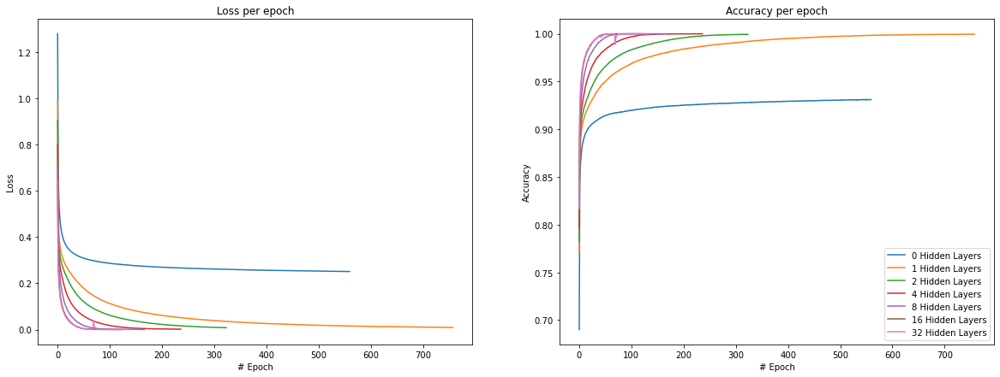

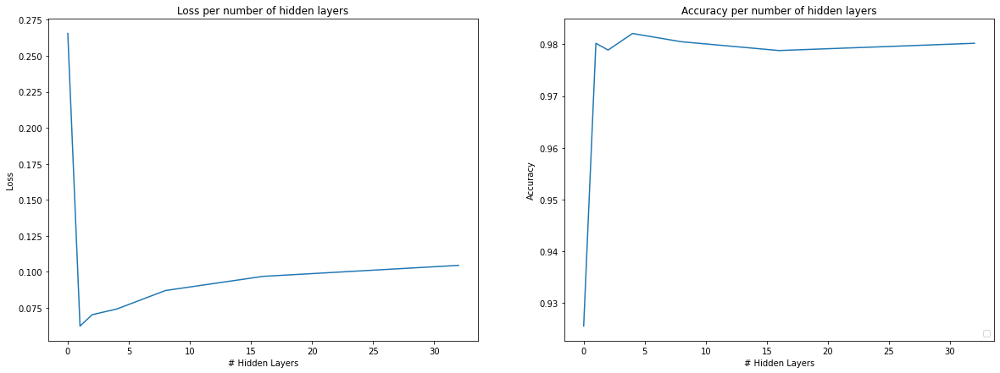

In [20]:
# Evaluation
# Train 
fig, (loss_ax, acc_ax) = plt.subplots(1, 2, figsize=(20,7))

loss_ax.set_title('Loss per epoch')
for i in range(0, len(arr)):
  loss_ax.plot(histories[i].history['loss'], label='' + str(arr[i]) + ' Hidden Layers')
loss_ax.set(xlabel='# Epoch', ylabel='Loss')

acc_ax.set_title('Accuracy per epoch')
for i in range(0, len(arr)):
  acc_ax.plot(histories[i].history['accuracy'], label='' + str(arr[i]) + ' Hidden Layers')
acc_ax.set(xlabel='# Epoch', ylabel='Accuracy')

plt.legend(loc=4)
plt.show()


fig, (loss_ax, acc_ax) = plt.subplots(1, 2, figsize=(20,7))

loss_ax.set_title('Loss per number of hidden layers')
loss_ax.plot(arr, [i[0] for i in test_accuracies])
loss_ax.set(xlabel='# Hidden Layers', ylabel='Loss')

acc_ax.set_title('Accuracy per number of hidden layers')
acc_ax.plot(arr, [i[1] for i in test_accuracies])
acc_ax.set(xlabel='# Hidden Layers', ylabel='Accuracy')

plt.legend(loc=4)
plt.show()

#### No regularization vs L1/L2 regularization

In [21]:
arr = ['None', 'L1', 'L2']
histories = []
test_accuracies = []

for reg in arr:
  # Definition
  cur_model = tf.keras.Sequential(name='ff_variable_regularization_' + str(reg))
  cur_model.add(tf.keras.layers.Input(mnist_info.features['image'].shape)) # Input
  cur_model.add(tf.keras.layers.Flatten(input_shape=(28, 28))) # Flatten
  if reg == 'None':
    cur_model.add(tf.keras.layers.Dense(256, activation='tanh', name='hidden')) # Hidden
  elif reg == 'L1':
    cur_model.add(tf.keras.layers.Dense(256, activation='tanh',kernel_regularizer=tf.keras.regularizers.l1(0.01), name='hidden')) # Hidden
  else:
    cur_model.add(tf.keras.layers.Dense(256, activation='tanh', kernel_regularizer=tf.keras.regularizers.l2(0.01), name='hidden')) # Hidden
    
  
  cur_model.add(tf.keras.layers.Dense(mnist_info.features['label'].num_classes, activation='softmax', name='output')) #Output

  cur_model.compile(loss='sparse_categorical_crossentropy', optimizer='sgd', metrics=['accuracy'])

  # Stopping Callbacks
  earlystop = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=50, verbose=1)
  checkpoint = tf.keras.callbacks.ModelCheckpoint('ff_variable_reg_' + str(reg) + '.h5', monitor='val_accuracy', verbose=1, save_best_only=True)

  histories += [cur_model.fit(ds_train, validation_data=ds_val, callbacks=[earlystop,checkpoint], epochs=no_epochs, batch_size=128)]

  test_accuracies += [cur_model.evaluate(ds_test)]

Epoch 1/1000
    426/Unknown - 0s 1ms/step - loss: 1.0301 - accuracy: 0.7542
Epoch 00001: val_accuracy improved from -inf to 0.85056, saving model to ff_variable_reg_None.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.9926 - accuracy: 0.7628 - val_loss: 0.6113 - val_accuracy: 0.8506
Epoch 2/1000
467/469 [============================>.] - ETA: 0s - loss: 0.5206 - accuracy: 0.8696
Epoch 00002: val_accuracy improved from 0.85056 to 0.87511, saving model to ff_variable_reg_None.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.5202 - accuracy: 0.8697 - val_loss: 0.4756 - val_accuracy: 0.8751
Epoch 3/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.4373 - accuracy: 0.8844
Epoch 00003: val_accuracy improved from 0.87511 to 0.88489, saving model to ff_variable_reg_None.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.4350 - accuracy: 0.8848 - val_loss: 0.4230 - val_accuracy: 0.8849
Epoch 4/1000
448/469 [===============

Epoch 52/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.1796 - accuracy: 0.9506
Epoch 00052: val_accuracy improved from 0.94800 to 0.94867, saving model to ff_variable_reg_None.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.1798 - accuracy: 0.9505 - val_loss: 0.1852 - val_accuracy: 0.9487
Epoch 53/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.1794 - accuracy: 0.9502
Epoch 00053: val_accuracy did not improve from 0.94867
469/469 [==============================] - 1s 1ms/step - loss: 0.1778 - accuracy: 0.9506 - val_loss: 0.1827 - val_accuracy: 0.9483
Epoch 54/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.1771 - accuracy: 0.9504
Epoch 00054: val_accuracy improved from 0.94867 to 0.95078, saving model to ff_variable_reg_None.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.1759 - accuracy: 0.9510 - val_loss: 0.1806 - val_accuracy: 0.9508
Epoch 55/1000
430/469 [==========================>...] 

Epoch 78/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.1375 - accuracy: 0.9614
Epoch 00078: val_accuracy improved from 0.96044 to 0.96078, saving model to ff_variable_reg_None.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.1383 - accuracy: 0.9613 - val_loss: 0.1413 - val_accuracy: 0.9608
Epoch 79/1000
454/469 [============================>.] - ETA: 0s - loss: 0.1371 - accuracy: 0.9617
Epoch 00079: val_accuracy improved from 0.96078 to 0.96122, saving model to ff_variable_reg_None.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.1371 - accuracy: 0.9616 - val_loss: 0.1406 - val_accuracy: 0.9612
Epoch 80/1000
463/469 [============================>.] - ETA: 0s - loss: 0.1362 - accuracy: 0.9622 ETA: 0s - loss: 0.1340 - accuracy
Epoch 00080: val_accuracy improved from 0.96122 to 0.96156, saving model to ff_variable_reg_None.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.1359 - accuracy: 0.9623 - val_loss: 0.1389

Epoch 104/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.1119 - accuracy: 0.9692
Epoch 00104: val_accuracy improved from 0.96911 to 0.96944, saving model to ff_variable_reg_None.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.1116 - accuracy: 0.9694 - val_loss: 0.1146 - val_accuracy: 0.9694
Epoch 105/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.1103 - accuracy: 0.9695
Epoch 00105: val_accuracy improved from 0.96944 to 0.96989, saving model to ff_variable_reg_None.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.1107 - accuracy: 0.9694 - val_loss: 0.1132 - val_accuracy: 0.9699
Epoch 106/1000
465/469 [============================>.] - ETA: 0s - loss: 0.1099 - accuracy: 0.9697
Epoch 00106: val_accuracy did not improve from 0.96989
469/469 [==============================] - 1s 1ms/step - loss: 0.1099 - accuracy: 0.9696 - val_loss: 0.1122 - val_accuracy: 0.9698
Epoch 107/1000
464/469 [============================

Epoch 131/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.0923 - accuracy: 0.9744
Epoch 00131: val_accuracy did not improve from 0.97489
469/469 [==============================] - 1s 1ms/step - loss: 0.0923 - accuracy: 0.9743 - val_loss: 0.0944 - val_accuracy: 0.9744
Epoch 132/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0911 - accuracy: 0.9749
Epoch 00132: val_accuracy did not improve from 0.97489
469/469 [==============================] - 1s 1ms/step - loss: 0.0917 - accuracy: 0.9747 - val_loss: 0.0938 - val_accuracy: 0.9746
Epoch 133/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.0904 - accuracy: 0.9749
Epoch 00133: val_accuracy improved from 0.97489 to 0.97522, saving model to ff_variable_reg_None.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0911 - accuracy: 0.9748 - val_loss: 0.0932 - val_accuracy: 0.9752
Epoch 134/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.0905 - accuracy: 0.97

Epoch 158/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.0780 - accuracy: 0.9791
Epoch 00158: val_accuracy improved from 0.97911 to 0.97944, saving model to ff_variable_reg_None.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0781 - accuracy: 0.9789 - val_loss: 0.0801 - val_accuracy: 0.9794
Epoch 159/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.0782 - accuracy: 0.9788
Epoch 00159: val_accuracy did not improve from 0.97944
469/469 [==============================] - 1s 1ms/step - loss: 0.0777 - accuracy: 0.9789 - val_loss: 0.0796 - val_accuracy: 0.9790
Epoch 160/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.0778 - accuracy: 0.9788
Epoch 00160: val_accuracy improved from 0.97944 to 0.97978, saving model to ff_variable_reg_None.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0772 - accuracy: 0.9790 - val_loss: 0.0790 - val_accuracy: 0.9798
Epoch 161/1000
444/469 [===========================>

Epoch 185/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.0675 - accuracy: 0.9818
Epoch 00185: val_accuracy improved from 0.98278 to 0.98289, saving model to ff_variable_reg_None.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0672 - accuracy: 0.9821 - val_loss: 0.0690 - val_accuracy: 0.9829
Epoch 186/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.0667 - accuracy: 0.9824
Epoch 00186: val_accuracy did not improve from 0.98289
469/469 [==============================] - 1s 1ms/step - loss: 0.0668 - accuracy: 0.9822 - val_loss: 0.0687 - val_accuracy: 0.9821
Epoch 187/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.0665 - accuracy: 0.9824
Epoch 00187: val_accuracy did not improve from 0.98289
469/469 [==============================] - 1s 1ms/step - loss: 0.0664 - accuracy: 0.9824 - val_loss: 0.0685 - val_accuracy: 0.9827
Epoch 188/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.0660 - accuracy: 0.98

Epoch 213/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.0586 - accuracy: 0.9847
Epoch 00213: val_accuracy did not improve from 0.98500
469/469 [==============================] - 1s 1ms/step - loss: 0.0582 - accuracy: 0.9849 - val_loss: 0.0599 - val_accuracy: 0.9846
Epoch 214/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.0581 - accuracy: 0.9851
Epoch 00214: val_accuracy did not improve from 0.98500
469/469 [==============================] - 1s 1ms/step - loss: 0.0579 - accuracy: 0.9852 - val_loss: 0.0595 - val_accuracy: 0.9848
Epoch 215/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0576 - accuracy: 0.9850
Epoch 00215: val_accuracy did not improve from 0.98500
469/469 [==============================] - 1s 1ms/step - loss: 0.0576 - accuracy: 0.9850 - val_loss: 0.0594 - val_accuracy: 0.9849
Epoch 216/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0574 - accuracy: 0.9853
Epoch 00216: val_accuracy did not improve 

Epoch 241/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.0509 - accuracy: 0.9869
Epoch 00241: val_accuracy did not improve from 0.98667
469/469 [==============================] - 1s 1ms/step - loss: 0.0509 - accuracy: 0.9869 - val_loss: 0.0527 - val_accuracy: 0.9861
Epoch 242/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.0506 - accuracy: 0.9873
Epoch 00242: val_accuracy improved from 0.98667 to 0.98678, saving model to ff_variable_reg_None.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0506 - accuracy: 0.9872 - val_loss: 0.0524 - val_accuracy: 0.9868
Epoch 243/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.0506 - accuracy: 0.9872
Epoch 00243: val_accuracy improved from 0.98678 to 0.98700, saving model to ff_variable_reg_None.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0504 - accuracy: 0.9872 - val_loss: 0.0521 - val_accuracy: 0.9870
Epoch 244/1000
426/469 [==========================>.

466/469 [============================>.] - ETA: 0s - loss: 0.0402 - accuracy: 0.9906
Epoch 00295: val_accuracy did not improve from 0.98989
469/469 [==============================] - 1s 1ms/step - loss: 0.0401 - accuracy: 0.9906 - val_loss: 0.0419 - val_accuracy: 0.9897
Epoch 296/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.0404 - accuracy: 0.9903
Epoch 00296: val_accuracy improved from 0.98989 to 0.99000, saving model to ff_variable_reg_None.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0400 - accuracy: 0.9905 - val_loss: 0.0418 - val_accuracy: 0.9900
Epoch 297/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0399 - accuracy: 0.9906
Epoch 00297: val_accuracy did not improve from 0.99000
469/469 [==============================] - 1s 1ms/step - loss: 0.0398 - accuracy: 0.9907 - val_loss: 0.0416 - val_accuracy: 0.9899
Epoch 298/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0397 - accuracy: 0.9908
Epoch 00298:

Epoch 323/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.0359 - accuracy: 0.9920
Epoch 00323: val_accuracy did not improve from 0.99122
469/469 [==============================] - 1s 1ms/step - loss: 0.0358 - accuracy: 0.9919 - val_loss: 0.0375 - val_accuracy: 0.9911
Epoch 324/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.0357 - accuracy: 0.9920
Epoch 00324: val_accuracy did not improve from 0.99122
469/469 [==============================] - 1s 1ms/step - loss: 0.0356 - accuracy: 0.9920 - val_loss: 0.0375 - val_accuracy: 0.9911
Epoch 325/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.0354 - accuracy: 0.9921
Epoch 00325: val_accuracy improved from 0.99122 to 0.99144, saving model to ff_variable_reg_None.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0355 - accuracy: 0.9922 - val_loss: 0.0373 - val_accuracy: 0.9914
Epoch 326/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.0355 - accuracy: 0.99

Epoch 351/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.0319 - accuracy: 0.9933
Epoch 00351: val_accuracy did not improve from 0.99244
469/469 [==============================] - 1s 1ms/step - loss: 0.0321 - accuracy: 0.9931 - val_loss: 0.0339 - val_accuracy: 0.9921
Epoch 352/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0319 - accuracy: 0.9934
Epoch 00352: val_accuracy did not improve from 0.99244
469/469 [==============================] - 1s 1ms/step - loss: 0.0319 - accuracy: 0.9934 - val_loss: 0.0337 - val_accuracy: 0.9922
Epoch 353/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.0318 - accuracy: 0.9932
Epoch 00353: val_accuracy did not improve from 0.99244
469/469 [==============================] - 1s 1ms/step - loss: 0.0318 - accuracy: 0.9932 - val_loss: 0.0336 - val_accuracy: 0.9922
Epoch 354/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0315 - accuracy: 0.9934
Epoch 00354: val_accuracy did not improve 

Epoch 379/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.0292 - accuracy: 0.9940
Epoch 00379: val_accuracy did not improve from 0.99311
469/469 [==============================] - 1s 1ms/step - loss: 0.0288 - accuracy: 0.9942 - val_loss: 0.0305 - val_accuracy: 0.9929
Epoch 380/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.0286 - accuracy: 0.9942
Epoch 00380: val_accuracy did not improve from 0.99311
469/469 [==============================] - 1s 1ms/step - loss: 0.0287 - accuracy: 0.9942 - val_loss: 0.0304 - val_accuracy: 0.9931
Epoch 381/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.0286 - accuracy: 0.9943
Epoch 00381: val_accuracy did not improve from 0.99311
469/469 [==============================] - 1s 1ms/step - loss: 0.0286 - accuracy: 0.9942 - val_loss: 0.0303 - val_accuracy: 0.9930
Epoch 382/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.0283 - accuracy: 0.9945
Epoch 00382: val_accuracy improved from 0.

Epoch 407/1000
469/469 [==============================] - ETA: 0s - loss: 0.0261 - accuracy: 0.9953
Epoch 00407: val_accuracy improved from 0.99411 to 0.99422, saving model to ff_variable_reg_None.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0261 - accuracy: 0.9953 - val_loss: 0.0277 - val_accuracy: 0.9942
Epoch 408/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.0259 - accuracy: 0.9953
Epoch 00408: val_accuracy did not improve from 0.99422
469/469 [==============================] - 1s 1ms/step - loss: 0.0259 - accuracy: 0.9952 - val_loss: 0.0276 - val_accuracy: 0.9941
Epoch 409/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.0260 - accuracy: 0.9953
Epoch 00409: val_accuracy improved from 0.99422 to 0.99433, saving model to ff_variable_reg_None.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0259 - accuracy: 0.9954 - val_loss: 0.0276 - val_accuracy: 0.9943
Epoch 410/1000
424/469 [==========================>.

Epoch 435/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.0234 - accuracy: 0.9960
Epoch 00435: val_accuracy did not improve from 0.99511
469/469 [==============================] - 1s 1ms/step - loss: 0.0236 - accuracy: 0.9959 - val_loss: 0.0252 - val_accuracy: 0.9950
Epoch 436/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0235 - accuracy: 0.9959
Epoch 00436: val_accuracy did not improve from 0.99511
469/469 [==============================] - 1s 1ms/step - loss: 0.0235 - accuracy: 0.9959 - val_loss: 0.0251 - val_accuracy: 0.9951
Epoch 437/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.0233 - accuracy: 0.9961
Epoch 00437: val_accuracy did not improve from 0.99511
469/469 [==============================] - 1s 1ms/step - loss: 0.0234 - accuracy: 0.9959 - val_loss: 0.0251 - val_accuracy: 0.9950
Epoch 438/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.0236 - accuracy: 0.9959
Epoch 00438: val_accuracy did not improve 

Epoch 463/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.0216 - accuracy: 0.9966
Epoch 00463: val_accuracy did not improve from 0.99600
469/469 [==============================] - 1s 1ms/step - loss: 0.0214 - accuracy: 0.9966 - val_loss: 0.0230 - val_accuracy: 0.9959
Epoch 464/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.0214 - accuracy: 0.9967
Epoch 00464: val_accuracy did not improve from 0.99600
469/469 [==============================] - 1s 1ms/step - loss: 0.0214 - accuracy: 0.9967 - val_loss: 0.0230 - val_accuracy: 0.9960
Epoch 465/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.0214 - accuracy: 0.9966
Epoch 00465: val_accuracy did not improve from 0.99600
469/469 [==============================] - 1s 1ms/step - loss: 0.0213 - accuracy: 0.9966 - val_loss: 0.0229 - val_accuracy: 0.9960
Epoch 466/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.0212 - accuracy: 0.9969
Epoch 00466: val_accuracy improved from 0.

Epoch 491/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0195 - accuracy: 0.9973
Epoch 00491: val_accuracy did not improve from 0.99689
469/469 [==============================] - 1s 1ms/step - loss: 0.0196 - accuracy: 0.9973 - val_loss: 0.0212 - val_accuracy: 0.9968
Epoch 492/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0195 - accuracy: 0.9973
Epoch 00492: val_accuracy did not improve from 0.99689
469/469 [==============================] - 1s 1ms/step - loss: 0.0195 - accuracy: 0.9973 - val_loss: 0.0210 - val_accuracy: 0.9969
Epoch 493/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0194 - accuracy: 0.9972
Epoch 00493: val_accuracy did not improve from 0.99689
469/469 [==============================] - 1s 1ms/step - loss: 0.0194 - accuracy: 0.9972 - val_loss: 0.0210 - val_accuracy: 0.9969
Epoch 494/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.0194 - accuracy: 0.9973
Epoch 00494: val_accuracy did not improve 

467/469 [============================>.] - ETA: 0s - loss: 0.0179 - accuracy: 0.9977
Epoch 00519: val_accuracy did not improve from 0.99767
469/469 [==============================] - 1s 1ms/step - loss: 0.0179 - accuracy: 0.9977 - val_loss: 0.0194 - val_accuracy: 0.9976
Epoch 520/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.0181 - accuracy: 0.9976
Epoch 00520: val_accuracy did not improve from 0.99767
469/469 [==============================] - 1s 1ms/step - loss: 0.0178 - accuracy: 0.9977 - val_loss: 0.0193 - val_accuracy: 0.9977
Epoch 521/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.0180 - accuracy: 0.9977
Epoch 00521: val_accuracy did not improve from 0.99767
469/469 [==============================] - 1s 1ms/step - loss: 0.0178 - accuracy: 0.9977 - val_loss: 0.0193 - val_accuracy: 0.9974
Epoch 522/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0178 - accuracy: 0.9977
Epoch 00522: val_accuracy did not improve from 0.99767
46

Epoch 576/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.0150 - accuracy: 0.9985
Epoch 00576: val_accuracy did not improve from 0.99822
469/469 [==============================] - 1s 1ms/step - loss: 0.0151 - accuracy: 0.9984 - val_loss: 0.0164 - val_accuracy: 0.9981
Epoch 577/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.0150 - accuracy: 0.9984
Epoch 00577: val_accuracy did not improve from 0.99822
469/469 [==============================] - 1s 1ms/step - loss: 0.0150 - accuracy: 0.9984 - val_loss: 0.0164 - val_accuracy: 0.9981
Epoch 578/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.0148 - accuracy: 0.9984
Epoch 00578: val_accuracy did not improve from 0.99822
469/469 [==============================] - 1s 1ms/step - loss: 0.0150 - accuracy: 0.9984 - val_loss: 0.0163 - val_accuracy: 0.9981
Epoch 579/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.0150 - accuracy: 0.9984
Epoch 00579: val_accuracy did not improve 

Epoch 633/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0128 - accuracy: 0.9989
Epoch 00633: val_accuracy did not improve from 0.99867
469/469 [==============================] - 1s 1ms/step - loss: 0.0128 - accuracy: 0.9989 - val_loss: 0.0140 - val_accuracy: 0.9986
Epoch 634/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.0127 - accuracy: 0.9989
Epoch 00634: val_accuracy did not improve from 0.99867
469/469 [==============================] - 1s 1ms/step - loss: 0.0128 - accuracy: 0.9989 - val_loss: 0.0140 - val_accuracy: 0.9987
Epoch 635/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0128 - accuracy: 0.9989
Epoch 00635: val_accuracy did not improve from 0.99867
469/469 [==============================] - 1s 1ms/step - loss: 0.0128 - accuracy: 0.9989 - val_loss: 0.0139 - val_accuracy: 0.9986
Epoch 636/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.0125 - accuracy: 0.9990
Epoch 00636: val_accuracy did not improve 

Epoch 662/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0119 - accuracy: 0.9990
Epoch 00662: val_accuracy did not improve from 0.99878
469/469 [==============================] - 1s 1ms/step - loss: 0.0119 - accuracy: 0.9991 - val_loss: 0.0130 - val_accuracy: 0.9987
Epoch 663/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0118 - accuracy: 0.9990
Epoch 00663: val_accuracy did not improve from 0.99878
469/469 [==============================] - 1s 1ms/step - loss: 0.0118 - accuracy: 0.9990 - val_loss: 0.0130 - val_accuracy: 0.9987
Epoch 664/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0119 - accuracy: 0.9990
Epoch 00664: val_accuracy did not improve from 0.99878
469/469 [==============================] - 1s 1ms/step - loss: 0.0118 - accuracy: 0.9991 - val_loss: 0.0129 - val_accuracy: 0.9987
Epoch 665/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0117 - accuracy: 0.9991
Epoch 00665: val_accuracy did not improve 

Epoch 719/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.0103 - accuracy: 0.9993
Epoch 00719: val_accuracy did not improve from 0.99900
469/469 [==============================] - 1s 1ms/step - loss: 0.0103 - accuracy: 0.9993 - val_loss: 0.0112 - val_accuracy: 0.9990
Epoch 720/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.0103 - accuracy: 0.9993
Epoch 00720: val_accuracy did not improve from 0.99900
469/469 [==============================] - 1s 1ms/step - loss: 0.0102 - accuracy: 0.9993 - val_loss: 0.0112 - val_accuracy: 0.9990
Epoch 721/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.0103 - accuracy: 0.9993
Epoch 00721: val_accuracy did not improve from 0.99900
469/469 [==============================] - 1s 1ms/step - loss: 0.0102 - accuracy: 0.9993 - val_loss: 0.0112 - val_accuracy: 0.9990
Epoch 722/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.0103 - accuracy: 0.9993
Epoch 00722: val_accuracy did not improve 

Epoch 40/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.9781 - accuracy: 0.8621
Epoch 00040: val_accuracy improved from 0.85811 to 0.85833, saving model to ff_variable_reg_L1.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.9789 - accuracy: 0.8617 - val_loss: 0.9960 - val_accuracy: 0.8583
Epoch 41/1000
469/469 [==============================] - ETA: 0s - loss: 0.9739 - accuracy: 0.8619
Epoch 00041: val_accuracy improved from 0.85833 to 0.85933, saving model to ff_variable_reg_L1.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.9739 - accuracy: 0.8619 - val_loss: 0.9781 - val_accuracy: 0.8593
Epoch 42/1000
460/469 [============================>.] - ETA: 0s - loss: 0.9682 - accuracy: 0.8640
Epoch 00042: val_accuracy improved from 0.85933 to 0.86200, saving model to ff_variable_reg_L1.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.9688 - accuracy: 0.8637 - val_loss: 0.9743 - val_accuracy: 0.8620
Epoch 43/1000
44

Epoch 67/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.8831 - accuracy: 0.8729
Epoch 00067: val_accuracy improved from 0.87122 to 0.87200, saving model to ff_variable_reg_L1.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.8847 - accuracy: 0.8723 - val_loss: 0.8897 - val_accuracy: 0.8720
Epoch 68/1000
461/469 [============================>.] - ETA: 0s - loss: 0.8823 - accuracy: 0.8729
Epoch 00068: val_accuracy did not improve from 0.87200
469/469 [==============================] - 1s 1ms/step - loss: 0.8821 - accuracy: 0.8731 - val_loss: 0.8984 - val_accuracy: 0.8678
Epoch 69/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.8796 - accuracy: 0.8737
Epoch 00069: val_accuracy improved from 0.87200 to 0.87256, saving model to ff_variable_reg_L1.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.8798 - accuracy: 0.8735 - val_loss: 0.8786 - val_accuracy: 0.8726
Epoch 70/1000
446/469 [===========================>..] - ET

Epoch 95/1000
461/469 [============================>.] - ETA: 0s - loss: 0.8350 - accuracy: 0.8785
Epoch 00095: val_accuracy improved from 0.87467 to 0.87689, saving model to ff_variable_reg_L1.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.8350 - accuracy: 0.8783 - val_loss: 0.8336 - val_accuracy: 0.8769
Epoch 96/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.8324 - accuracy: 0.8787
Epoch 00096: val_accuracy did not improve from 0.87689
469/469 [==============================] - 1s 1ms/step - loss: 0.8336 - accuracy: 0.8785 - val_loss: 0.8374 - val_accuracy: 0.8759
Epoch 97/1000
468/469 [============================>.] - ETA: 0s - loss: 0.8329 - accuracy: 0.8783
Epoch 00097: val_accuracy did not improve from 0.87689
469/469 [==============================] - 1s 1ms/step - loss: 0.8328 - accuracy: 0.8783 - val_loss: 0.8388 - val_accuracy: 0.8721
Epoch 98/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.8298 - accuracy: 0.8801
Epo

Epoch 124/1000
469/469 [==============================] - ETA: 0s - loss: 0.8043 - accuracy: 0.8812
Epoch 00124: val_accuracy did not improve from 0.87933
469/469 [==============================] - 1s 1ms/step - loss: 0.8043 - accuracy: 0.8812 - val_loss: 0.8236 - val_accuracy: 0.8726
Epoch 125/1000
467/469 [============================>.] - ETA: 0s - loss: 0.8023 - accuracy: 0.8827
Epoch 00125: val_accuracy did not improve from 0.87933
469/469 [==============================] - 1s 1ms/step - loss: 0.8025 - accuracy: 0.8827 - val_loss: 0.8399 - val_accuracy: 0.8704
Epoch 126/1000
469/469 [==============================] - ETA: 0s - loss: 0.8023 - accuracy: 0.8816
Epoch 00126: val_accuracy did not improve from 0.87933
469/469 [==============================] - 1s 2ms/step - loss: 0.8023 - accuracy: 0.8816 - val_loss: 0.8147 - val_accuracy: 0.8767
Epoch 127/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.8012 - accuracy: 0.8812
Epoch 00127: val_accuracy did not improve 

440/469 [===========================>..] - ETA: 0s - loss: 0.7677 - accuracy: 0.8849
Epoch 00180: val_accuracy improved from 0.88267 to 0.88278, saving model to ff_variable_reg_L1.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.7687 - accuracy: 0.8843 - val_loss: 0.7724 - val_accuracy: 0.8828
Epoch 181/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.7668 - accuracy: 0.8851
Epoch 00181: val_accuracy did not improve from 0.88278
469/469 [==============================] - 1s 2ms/step - loss: 0.7680 - accuracy: 0.8846 - val_loss: 0.8009 - val_accuracy: 0.8778
Epoch 182/1000
459/469 [============================>.] - ETA: 0s - loss: 0.7676 - accuracy: 0.8848
Epoch 00182: val_accuracy did not improve from 0.88278
469/469 [==============================] - 1s 2ms/step - loss: 0.7679 - accuracy: 0.8848 - val_loss: 0.7764 - val_accuracy: 0.8800
Epoch 183/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.7662 - accuracy: 0.8855
Epoch 00183: v

Epoch 209/1000
459/469 [============================>.] - ETA: 0s - loss: 0.7560 - accuracy: 0.8858
Epoch 00209: val_accuracy did not improve from 0.88456
469/469 [==============================] - 1s 1ms/step - loss: 0.7552 - accuracy: 0.8861 - val_loss: 0.7597 - val_accuracy: 0.8827
Epoch 210/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.7560 - accuracy: 0.8857
Epoch 00210: val_accuracy did not improve from 0.88456
469/469 [==============================] - 1s 1ms/step - loss: 0.7556 - accuracy: 0.8861 - val_loss: 0.7780 - val_accuracy: 0.8779
Epoch 211/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.7552 - accuracy: 0.8857
Epoch 00211: val_accuracy improved from 0.88456 to 0.88511, saving model to ff_variable_reg_L1.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.7558 - accuracy: 0.8855 - val_loss: 0.7553 - val_accuracy: 0.8851
Epoch 212/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.7559 - accuracy: 0.8862

Epoch 238/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.7478 - accuracy: 0.8864
Epoch 00238: val_accuracy did not improve from 0.88511
469/469 [==============================] - 1s 1ms/step - loss: 0.7470 - accuracy: 0.8865 - val_loss: 0.7665 - val_accuracy: 0.8813
Epoch 239/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.7451 - accuracy: 0.8870
Epoch 00239: val_accuracy improved from 0.88511 to 0.88567, saving model to ff_variable_reg_L1.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.7464 - accuracy: 0.8868 - val_loss: 0.7513 - val_accuracy: 0.8857
Epoch 240/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.7475 - accuracy: 0.8861
Epoch 00240: val_accuracy did not improve from 0.88567
469/469 [==============================] - 1s 1ms/step - loss: 0.7469 - accuracy: 0.8864 - val_loss: 0.7635 - val_accuracy: 0.8758
Epoch 241/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.7442 - accuracy: 0.8872

Epoch 295/1000
468/469 [============================>.] - ETA: 0s - loss: 0.7346 - accuracy: 0.8871
Epoch 00295: val_accuracy improved from 0.88867 to 0.88944, saving model to ff_variable_reg_L1.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.7344 - accuracy: 0.8872 - val_loss: 0.7239 - val_accuracy: 0.8894
Epoch 296/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.7361 - accuracy: 0.8879
Epoch 00296: val_accuracy did not improve from 0.88944
469/469 [==============================] - 1s 1ms/step - loss: 0.7363 - accuracy: 0.8878 - val_loss: 0.7350 - val_accuracy: 0.8882
Epoch 297/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.7327 - accuracy: 0.8890 ETA: 0s - loss: 0.7330 - accuracy: 
Epoch 00297: val_accuracy did not improve from 0.88944
469/469 [==============================] - 1s 1ms/step - loss: 0.7324 - accuracy: 0.8892 - val_loss: 0.7320 - val_accuracy: 0.8863
Epoch 298/1000
444/469 [===========================>..] - ETA: 

Epoch 324/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.7283 - accuracy: 0.8886
Epoch 00324: val_accuracy did not improve from 0.88944
469/469 [==============================] - 1s 1ms/step - loss: 0.7297 - accuracy: 0.8877 - val_loss: 0.7377 - val_accuracy: 0.8852
Epoch 325/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.7305 - accuracy: 0.8878
Epoch 00325: val_accuracy did not improve from 0.88944
469/469 [==============================] - 1s 1ms/step - loss: 0.7300 - accuracy: 0.8880 - val_loss: 0.7622 - val_accuracy: 0.8786
Epoch 326/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.7292 - accuracy: 0.8884
Epoch 00326: val_accuracy did not improve from 0.88944
469/469 [==============================] - 1s 1ms/step - loss: 0.7297 - accuracy: 0.8882 - val_loss: 0.7478 - val_accuracy: 0.8793
Epoch 327/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.7295 - accuracy: 0.8888
Epoch 00327: val_accuracy did not improve 

469/469 [==============================] - 1s 2ms/step - loss: 1.8380 - accuracy: 0.9002 - val_loss: 1.7172 - val_accuracy: 0.8973
Epoch 7/1000
437/469 [==========================>...] - ETA: 0s - loss: 1.6013 - accuracy: 0.9027
Epoch 00007: val_accuracy improved from 0.89733 to 0.89878, saving model to ff_variable_reg_L2.h5
469/469 [==============================] - 1s 2ms/step - loss: 1.5941 - accuracy: 0.9028 - val_loss: 1.4964 - val_accuracy: 0.8988
Epoch 8/1000
444/469 [===========================>..] - ETA: 0s - loss: 1.3965 - accuracy: 0.9044
Epoch 00008: val_accuracy improved from 0.89878 to 0.90144, saving model to ff_variable_reg_L2.h5
469/469 [==============================] - 1s 2ms/step - loss: 1.3920 - accuracy: 0.9041 - val_loss: 1.3130 - val_accuracy: 0.9014
Epoch 9/1000
462/469 [============================>.] - ETA: 0s - loss: 1.2260 - accuracy: 0.9063
Epoch 00009: val_accuracy did not improve from 0.90144
469/469 [==============================] - 1s 2ms/step - loss:

Epoch 34/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.3887 - accuracy: 0.9165
Epoch 00034: val_accuracy did not improve from 0.91311
469/469 [==============================] - 1s 2ms/step - loss: 0.3887 - accuracy: 0.9166 - val_loss: 0.3963 - val_accuracy: 0.9113
Epoch 35/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.3861 - accuracy: 0.9166
Epoch 00035: val_accuracy did not improve from 0.91311
469/469 [==============================] - 1s 2ms/step - loss: 0.3862 - accuracy: 0.9167 - val_loss: 0.3944 - val_accuracy: 0.9120
Epoch 36/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.3835 - accuracy: 0.9173
Epoch 00036: val_accuracy did not improve from 0.91311
469/469 [==============================] - 1s 2ms/step - loss: 0.3838 - accuracy: 0.9172 - val_loss: 0.3914 - val_accuracy: 0.9121
Epoch 37/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.3820 - accuracy: 0.9170
Epoch 00037: val_accuracy did not improve from

Epoch 62/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.3544 - accuracy: 0.9212
Epoch 00062: val_accuracy did not improve from 0.91767
469/469 [==============================] - 1s 2ms/step - loss: 0.3543 - accuracy: 0.9210 - val_loss: 0.3631 - val_accuracy: 0.9163
Epoch 63/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.3548 - accuracy: 0.9212
Epoch 00063: val_accuracy did not improve from 0.91767
469/469 [==============================] - 1s 2ms/step - loss: 0.3538 - accuracy: 0.9215 - val_loss: 0.3612 - val_accuracy: 0.9176
Epoch 64/1000
465/469 [============================>.] - ETA: 0s - loss: 0.3527 - accuracy: 0.9215
Epoch 00064: val_accuracy improved from 0.91767 to 0.91944, saving model to ff_variable_reg_L2.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.3528 - accuracy: 0.9215 - val_loss: 0.3603 - val_accuracy: 0.9194
Epoch 65/1000
458/469 [============================>.] - ETA: 0s - loss: 0.3529 - accuracy: 0.9214
Epo

469/469 [==============================] - 1s 2ms/step - loss: 0.3369 - accuracy: 0.9255 - val_loss: 0.3449 - val_accuracy: 0.9234
Epoch 90/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.3364 - accuracy: 0.9261
Epoch 00090: val_accuracy did not improve from 0.92344
469/469 [==============================] - 1s 2ms/step - loss: 0.3362 - accuracy: 0.9260 - val_loss: 0.3436 - val_accuracy: 0.9224
Epoch 91/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.3367 - accuracy: 0.9248
Epoch 00091: val_accuracy did not improve from 0.92344
469/469 [==============================] - 1s 2ms/step - loss: 0.3357 - accuracy: 0.9251 - val_loss: 0.3452 - val_accuracy: 0.9204
Epoch 92/1000
464/469 [============================>.] - ETA: 0s - loss: 0.3354 - accuracy: 0.9258
Epoch 00092: val_accuracy did not improve from 0.92344
469/469 [==============================] - 1s 2ms/step - loss: 0.3351 - accuracy: 0.9260 - val_loss: 0.3431 - val_accuracy: 0.9227
Epoch 93/1000


Epoch 145/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.3094 - accuracy: 0.9338
Epoch 00145: val_accuracy improved from 0.93089 to 0.93133, saving model to ff_variable_reg_L2.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.3093 - accuracy: 0.9337 - val_loss: 0.3157 - val_accuracy: 0.9313
Epoch 146/1000
469/469 [==============================] - ETA: 0s - loss: 0.3090 - accuracy: 0.9336
Epoch 00146: val_accuracy improved from 0.93133 to 0.93256, saving model to ff_variable_reg_L2.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.3090 - accuracy: 0.9336 - val_loss: 0.3144 - val_accuracy: 0.9326
Epoch 147/1000
466/469 [============================>.] - ETA: 0s - loss: 0.3091 - accuracy: 0.9341
Epoch 00147: val_accuracy did not improve from 0.93256
469/469 [==============================] - 1s 2ms/step - loss: 0.3086 - accuracy: 0.9342 - val_loss: 0.3154 - val_accuracy: 0.9297
Epoch 148/1000
441/469 [===========================>..] 

469/469 [==============================] - 1s 2ms/step - loss: 0.2990 - accuracy: 0.9367 - val_loss: 0.3056 - val_accuracy: 0.9352
Epoch 173/1000
456/469 [============================>.] - ETA: 0s - loss: 0.2991 - accuracy: 0.9367
Epoch 00173: val_accuracy did not improve from 0.93522
469/469 [==============================] - 1s 2ms/step - loss: 0.2985 - accuracy: 0.9370 - val_loss: 0.3059 - val_accuracy: 0.9346
Epoch 174/1000
456/469 [============================>.] - ETA: 0s - loss: 0.2982 - accuracy: 0.9370
Epoch 00174: val_accuracy did not improve from 0.93522
469/469 [==============================] - 1s 2ms/step - loss: 0.2983 - accuracy: 0.9370 - val_loss: 0.3032 - val_accuracy: 0.9350
Epoch 175/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.2978 - accuracy: 0.9373
Epoch 00175: val_accuracy did not improve from 0.93522
469/469 [==============================] - 1s 2ms/step - loss: 0.2980 - accuracy: 0.9373 - val_loss: 0.3031 - val_accuracy: 0.9348
Epoch 176/1

Epoch 201/1000
464/469 [============================>.] - ETA: 0s - loss: 0.2894 - accuracy: 0.9391
Epoch 00201: val_accuracy improved from 0.93778 to 0.93900, saving model to ff_variable_reg_L2.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.2890 - accuracy: 0.9393 - val_loss: 0.2934 - val_accuracy: 0.9390
Epoch 202/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.2882 - accuracy: 0.9399
Epoch 00202: val_accuracy did not improve from 0.93900
469/469 [==============================] - 1s 2ms/step - loss: 0.2886 - accuracy: 0.9398 - val_loss: 0.2923 - val_accuracy: 0.9374
Epoch 203/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.2882 - accuracy: 0.9396
Epoch 00203: val_accuracy did not improve from 0.93900
469/469 [==============================] - 1s 2ms/step - loss: 0.2884 - accuracy: 0.9398 - val_loss: 0.2951 - val_accuracy: 0.9362
Epoch 204/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.2884 - accuracy: 0.9396

Epoch 229/1000
468/469 [============================>.] - ETA: 0s - loss: 0.2804 - accuracy: 0.9421
Epoch 00229: val_accuracy did not improve from 0.94033
469/469 [==============================] - 1s 2ms/step - loss: 0.2806 - accuracy: 0.9420 - val_loss: 0.2844 - val_accuracy: 0.9397
Epoch 230/1000
464/469 [============================>.] - ETA: 0s - loss: 0.2803 - accuracy: 0.9424
Epoch 00230: val_accuracy improved from 0.94033 to 0.94111, saving model to ff_variable_reg_L2.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.2803 - accuracy: 0.9423 - val_loss: 0.2844 - val_accuracy: 0.9411
Epoch 231/1000
459/469 [============================>.] - ETA: 0s - loss: 0.2806 - accuracy: 0.9420
Epoch 00231: val_accuracy did not improve from 0.94111
469/469 [==============================] - 1s 2ms/step - loss: 0.2801 - accuracy: 0.9421 - val_loss: 0.2848 - val_accuracy: 0.9408
Epoch 232/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.2809 - accuracy: 0.9415

Epoch 257/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.2729 - accuracy: 0.9440
Epoch 00257: val_accuracy did not improve from 0.94344
469/469 [==============================] - 1s 2ms/step - loss: 0.2732 - accuracy: 0.9440 - val_loss: 0.2758 - val_accuracy: 0.9413
Epoch 258/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.2731 - accuracy: 0.9446
Epoch 00258: val_accuracy did not improve from 0.94344
469/469 [==============================] - 1s 2ms/step - loss: 0.2729 - accuracy: 0.9446 - val_loss: 0.2752 - val_accuracy: 0.9423
Epoch 259/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.2720 - accuracy: 0.9441
Epoch 00259: val_accuracy did not improve from 0.94344
469/469 [==============================] - 1s 2ms/step - loss: 0.2725 - accuracy: 0.9440 - val_loss: 0.2759 - val_accuracy: 0.9432
Epoch 260/1000
457/469 [============================>.] - ETA: 0s - loss: 0.2723 - accuracy: 0.9443
Epoch 00260: val_accuracy did not improve 

Epoch 285/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.2669 - accuracy: 0.9457
Epoch 00285: val_accuracy did not improve from 0.94478
469/469 [==============================] - 1s 2ms/step - loss: 0.2662 - accuracy: 0.9461 - val_loss: 0.2705 - val_accuracy: 0.9442
Epoch 286/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.2662 - accuracy: 0.9457
Epoch 00286: val_accuracy improved from 0.94478 to 0.94511, saving model to ff_variable_reg_L2.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.2660 - accuracy: 0.9457 - val_loss: 0.2696 - val_accuracy: 0.9451
Epoch 287/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.2655 - accuracy: 0.9458
Epoch 00287: val_accuracy improved from 0.94511 to 0.94567, saving model to ff_variable_reg_L2.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.2659 - accuracy: 0.9457 - val_loss: 0.2696 - val_accuracy: 0.9457
Epoch 288/1000
433/469 [==========================>...] 

Epoch 313/1000
454/469 [============================>.] - ETA: 0s - loss: 0.2596 - accuracy: 0.9473
Epoch 00313: val_accuracy did not improve from 0.94711
469/469 [==============================] - 1s 2ms/step - loss: 0.2601 - accuracy: 0.9471 - val_loss: 0.2633 - val_accuracy: 0.9468
Epoch 314/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.2601 - accuracy: 0.9471
Epoch 00314: val_accuracy did not improve from 0.94711
469/469 [==============================] - 1s 2ms/step - loss: 0.2600 - accuracy: 0.9473 - val_loss: 0.2648 - val_accuracy: 0.9452
Epoch 315/1000
462/469 [============================>.] - ETA: 0s - loss: 0.2600 - accuracy: 0.9477
Epoch 00315: val_accuracy did not improve from 0.94711
469/469 [==============================] - 1s 2ms/step - loss: 0.2598 - accuracy: 0.9478 - val_loss: 0.2629 - val_accuracy: 0.9462
Epoch 316/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.2597 - accuracy: 0.9485
Epoch 00316: val_accuracy did not improve 

Epoch 341/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.2540 - accuracy: 0.9495
Epoch 00341: val_accuracy improved from 0.94900 to 0.94911, saving model to ff_variable_reg_L2.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.2548 - accuracy: 0.9492 - val_loss: 0.2566 - val_accuracy: 0.9491
Epoch 342/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.2544 - accuracy: 0.9488
Epoch 00342: val_accuracy did not improve from 0.94911
469/469 [==============================] - 1s 2ms/step - loss: 0.2547 - accuracy: 0.9489 - val_loss: 0.2576 - val_accuracy: 0.9472
Epoch 343/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.2551 - accuracy: 0.9492
Epoch 00343: val_accuracy did not improve from 0.94911
469/469 [==============================] - 1s 2ms/step - loss: 0.2545 - accuracy: 0.9493 - val_loss: 0.2580 - val_accuracy: 0.9477
Epoch 344/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.2531 - accuracy: 0.9491

Epoch 398/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.2450 - accuracy: 0.9514
Epoch 00398: val_accuracy did not improve from 0.95144
469/469 [==============================] - 1s 2ms/step - loss: 0.2453 - accuracy: 0.9515 - val_loss: 0.2505 - val_accuracy: 0.9487
Epoch 399/1000
465/469 [============================>.] - ETA: 0s - loss: 0.2444 - accuracy: 0.9517
Epoch 00399: val_accuracy did not improve from 0.95144
469/469 [==============================] - 1s 2ms/step - loss: 0.2450 - accuracy: 0.9515 - val_loss: 0.2495 - val_accuracy: 0.9499
Epoch 400/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.2453 - accuracy: 0.9516
Epoch 00400: val_accuracy did not improve from 0.95144
469/469 [==============================] - 1s 2ms/step - loss: 0.2448 - accuracy: 0.9515 - val_loss: 0.2485 - val_accuracy: 0.9511
Epoch 401/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.2445 - accuracy: 0.9516
Epoch 00401: val_accuracy did not improve 

Epoch 426/1000
459/469 [============================>.] - ETA: 0s - loss: 0.2410 - accuracy: 0.9522
Epoch 00426: val_accuracy did not improve from 0.95256
469/469 [==============================] - 1s 2ms/step - loss: 0.2412 - accuracy: 0.9521 - val_loss: 0.2433 - val_accuracy: 0.9516
Epoch 427/1000
469/469 [==============================] - ETA: 0s - loss: 0.2411 - accuracy: 0.9530
Epoch 00427: val_accuracy did not improve from 0.95256
469/469 [==============================] - 1s 2ms/step - loss: 0.2411 - accuracy: 0.9530 - val_loss: 0.2451 - val_accuracy: 0.9519
Epoch 428/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.2407 - accuracy: 0.9527
Epoch 00428: val_accuracy did not improve from 0.95256
469/469 [==============================] - 1s 2ms/step - loss: 0.2411 - accuracy: 0.9526 - val_loss: 0.2450 - val_accuracy: 0.9513
Epoch 429/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.2407 - accuracy: 0.9531
Epoch 00429: val_accuracy did not improve 

451/469 [===========================>..] - ETA: 0s - loss: 0.2336 - accuracy: 0.9544
Epoch 00482: val_accuracy did not improve from 0.95544
469/469 [==============================] - 1s 2ms/step - loss: 0.2337 - accuracy: 0.9545 - val_loss: 0.2369 - val_accuracy: 0.9547
Epoch 483/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.2344 - accuracy: 0.9544
Epoch 00483: val_accuracy did not improve from 0.95544
469/469 [==============================] - 1s 2ms/step - loss: 0.2337 - accuracy: 0.9547 - val_loss: 0.2355 - val_accuracy: 0.9536
Epoch 484/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.2323 - accuracy: 0.9552
Epoch 00484: val_accuracy did not improve from 0.95544
469/469 [==============================] - 1s 2ms/step - loss: 0.2334 - accuracy: 0.9549 - val_loss: 0.2354 - val_accuracy: 0.9540
Epoch 485/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.2325 - accuracy: 0.9545
Epoch 00485: val_accuracy did not improve from 0.95544
46

Epoch 539/1000
467/469 [============================>.] - ETA: 0s - loss: 0.2272 - accuracy: 0.9559
Epoch 00539: val_accuracy did not improve from 0.95722
469/469 [==============================] - 1s 2ms/step - loss: 0.2275 - accuracy: 0.9557 - val_loss: 0.2285 - val_accuracy: 0.9566
Epoch 540/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.2281 - accuracy: 0.9560
Epoch 00540: val_accuracy did not improve from 0.95722
469/469 [==============================] - 1s 2ms/step - loss: 0.2276 - accuracy: 0.9563 - val_loss: 0.2290 - val_accuracy: 0.9549
Epoch 541/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.2270 - accuracy: 0.9562
Epoch 00541: val_accuracy did not improve from 0.95722
469/469 [==============================] - 1s 2ms/step - loss: 0.2272 - accuracy: 0.9564 - val_loss: 0.2302 - val_accuracy: 0.9551
Epoch 542/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.2262 - accuracy: 0.9562
Epoch 00542: val_accuracy did not improve 

Epoch 596/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.2218 - accuracy: 0.9581
Epoch 00596: val_accuracy improved from 0.95822 to 0.95833, saving model to ff_variable_reg_L2.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.2219 - accuracy: 0.9579 - val_loss: 0.2226 - val_accuracy: 0.9583
Epoch 597/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.2210 - accuracy: 0.9585
Epoch 00597: val_accuracy did not improve from 0.95833
469/469 [==============================] - 1s 2ms/step - loss: 0.2220 - accuracy: 0.9581 - val_loss: 0.2260 - val_accuracy: 0.9562
Epoch 598/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.2218 - accuracy: 0.9576
Epoch 00598: val_accuracy did not improve from 0.95833
469/469 [==============================] - 1s 2ms/step - loss: 0.2219 - accuracy: 0.9575 - val_loss: 0.2234 - val_accuracy: 0.9553
Epoch 599/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.2219 - accuracy: 0.9580

Epoch 653/1000
468/469 [============================>.] - ETA: 0s - loss: 0.2175 - accuracy: 0.9585
Epoch 00653: val_accuracy did not improve from 0.95967
469/469 [==============================] - 1s 2ms/step - loss: 0.2174 - accuracy: 0.9585 - val_loss: 0.2177 - val_accuracy: 0.9580
Epoch 654/1000
465/469 [============================>.] - ETA: 0s - loss: 0.2173 - accuracy: 0.9584
Epoch 00654: val_accuracy did not improve from 0.95967
469/469 [==============================] - 1s 2ms/step - loss: 0.2172 - accuracy: 0.9585 - val_loss: 0.2201 - val_accuracy: 0.9581
Epoch 655/1000
467/469 [============================>.] - ETA: 0s - loss: 0.2173 - accuracy: 0.9592
Epoch 00655: val_accuracy did not improve from 0.95967
469/469 [==============================] - 1s 2ms/step - loss: 0.2173 - accuracy: 0.9592 - val_loss: 0.2172 - val_accuracy: 0.9587
Epoch 656/1000
459/469 [============================>.] - ETA: 0s - loss: 0.2170 - accuracy: 0.9590
Epoch 00656: val_accuracy did not improve 

Epoch 682/1000
467/469 [============================>.] - ETA: 0s - loss: 0.2154 - accuracy: 0.9590
Epoch 00682: val_accuracy did not improve from 0.96089
469/469 [==============================] - 1s 2ms/step - loss: 0.2153 - accuracy: 0.9591 - val_loss: 0.2153 - val_accuracy: 0.9588
Epoch 683/1000
469/469 [==============================] - ETA: 0s - loss: 0.2151 - accuracy: 0.9589
Epoch 00683: val_accuracy did not improve from 0.96089
469/469 [==============================] - 1s 2ms/step - loss: 0.2151 - accuracy: 0.9589 - val_loss: 0.2183 - val_accuracy: 0.9588
Epoch 684/1000
469/469 [==============================] - ETA: 0s - loss: 0.2150 - accuracy: 0.9590
Epoch 00684: val_accuracy did not improve from 0.96089
469/469 [==============================] - 1s 2ms/step - loss: 0.2150 - accuracy: 0.9590 - val_loss: 0.2170 - val_accuracy: 0.9580
Epoch 685/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.2145 - accuracy: 0.9591
Epoch 00685: val_accuracy did not improve 

Epoch 711/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.2133 - accuracy: 0.9596 ETA: 0s - loss: 0.2137 - accuracy: 
Epoch 00711: val_accuracy did not improve from 0.96089
469/469 [==============================] - 1s 2ms/step - loss: 0.2130 - accuracy: 0.9599 - val_loss: 0.2134 - val_accuracy: 0.9596
Epoch 00711: early stopping
      1/Unknown - 0s 0s/step - loss: 0.2073 - accuracy: 0.9688WARNING:tensorflow:Callbacks method `on_test_batch_end` is slow compared to the batch time (batch time: 0.0000s vs `on_test_batch_end` time: 0.0010s). Check your callbacks.


79/79 [==============================] - 0s 975us/step - loss: 0.2118 - accuracy: 0.9586


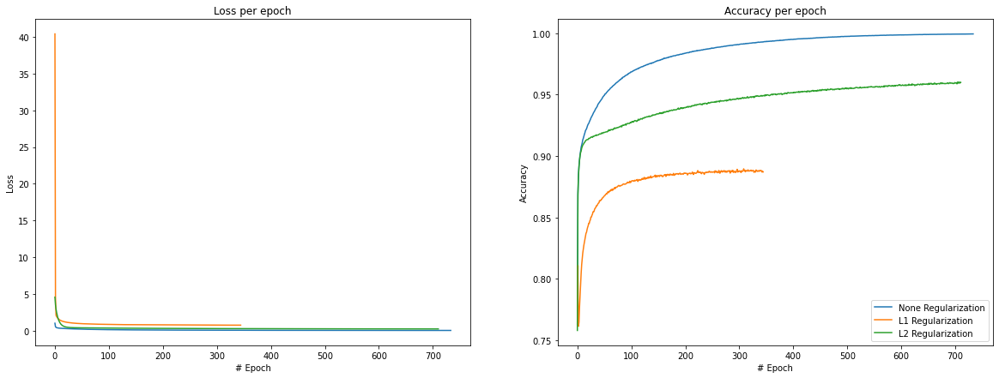

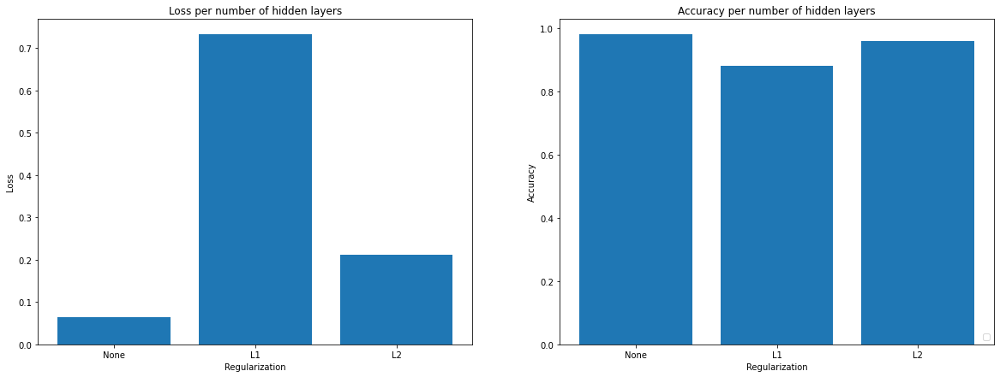

In [22]:
# Evaluation
# Train 
fig, (loss_ax, acc_ax) = plt.subplots(1, 2, figsize=(20,7))

loss_ax.set_title('Loss per epoch')
for i in range(0, len(arr)):
  loss_ax.plot(histories[i].history['loss'], label='' + str(arr[i]) + ' Regularization')
loss_ax.set(xlabel='# Epoch', ylabel='Loss')

acc_ax.set_title('Accuracy per epoch')
for i in range(0, len(arr)):
  acc_ax.plot(histories[i].history['accuracy'], label='' + str(arr[i]) + ' Regularization')
acc_ax.set(xlabel='# Epoch', ylabel='Accuracy')

plt.legend(loc=4)
plt.show()


fig, (loss_ax, acc_ax) = plt.subplots(1, 2, figsize=(20,7))

loss_ax.set_title('Loss per number of hidden layers')
loss_ax.bar(arr, [i[0] for i in test_accuracies])
loss_ax.set(xlabel='Regularization', ylabel='Loss')

acc_ax.set_title('Accuracy per number of hidden layers')
acc_ax.bar(arr, [i[1] for i in test_accuracies])
acc_ax.set(xlabel='Regularization', ylabel='Accuracy')

plt.legend(loc=4)
plt.show()

### Combine best set of parameters

### Grid Search for Best Model


In [9]:
regularization = ['None', 'L1', 'L2']
no_hidden_layers = [0, 1, 2, 4, 8, 16, 32]
act_func = ['tanh', 'relu', 'softmax', 'selu', 'softplus']
no_neurons = arr = [16, 128, 256, 512, 1024, 2048]

histories = []
test_accuracies = []
model = []
model_names = []

for neuron in no_neurons:
  for act in act_func:
    for reg in regularization:
      for no_hidden in no_hidden_layers:
        # Definition
        cur_model = tf.keras.Sequential(name='ff_combo_' + str(neuron) + '_' + str(act) + '_' + str(reg) + '_' + str(no_hidden))
        
        cur_model.add(tf.keras.layers.Input(mnist_info.features['image'].shape)) # Input
        cur_model.add(tf.keras.layers.Flatten(input_shape=(28, 28))) # Flatten

        for i in range(0, no_hidden):
          if reg == 'None':
            cur_model.add(tf.keras.layers.Dense(neuron, activation=act)) # Hidden
          elif reg == 'L1':
            cur_model.add(tf.keras.layers.Dense(neuron, activation=act,kernel_regularizer=tf.keras.regularizers.l1(0.01))) # Hidden
          else:
            cur_model.add(tf.keras.layers.Dense(neuron, activation=act, kernel_regularizer=tf.keras.regularizers.l2(0.01))) # Hidden
            
        cur_model.add(tf.keras.layers.Dense(mnist_info.features['label'].num_classes, activation='softmax', name='output')) #Output

        cur_model.compile(loss='sparse_categorical_crossentropy', optimizer='sgd', metrics=['accuracy'])

        # Stopping Callbacks
        earlystop = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=50, verbose=1)
        checkpoint = tf.keras.callbacks.ModelCheckpoint('ff_combo_' + str(neuron) + '_' + str(act) + '_' + str(reg) + '_' + str(no_hidden) + '.h5', monitor='val_accuracy', verbose=1, save_best_only=True)

        histories += [cur_model.fit(ds_train, validation_data=ds_val, callbacks=[earlystop,checkpoint], epochs=no_epochs, batch_size=128)]

        test_accuracies += [cur_model.evaluate(ds_test)]

        model += [cur_model]
        model_names += ['neurons_' + str(neuron) + '_act_' + str(act) + '_reg_' + str(reg) + '_nohidden_' + str(no_hidden)]

Epoch 1/1000
    383/Unknown - 0s 522us/step - loss: 1.3919 - accuracy: 0.6580
Epoch 00001: val_accuracy improved from -inf to 0.81500, saving model to ff_combo_16_tanh_None_0.h5
469/469 [==============================] - 1s 3ms/step - loss: 1.2990 - accuracy: 0.6865 - val_loss: 0.8558 - val_accuracy: 0.8150
Epoch 2/1000
458/469 [============================>.] - ETA: 0s - loss: 0.7226 - accuracy: 0.8397
Epoch 00002: val_accuracy improved from 0.81500 to 0.84567, saving model to ff_combo_16_tanh_None_0.h5
469/469 [==============================] - 0s 693us/step - loss: 0.7207 - accuracy: 0.8400 - val_loss: 0.6490 - val_accuracy: 0.8457
Epoch 3/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.5918 - accuracy: 0.8593
Epoch 00003: val_accuracy improved from 0.84567 to 0.85800, saving model to ff_combo_16_tanh_None_0.h5
469/469 [==============================] - 0s 723us/step - loss: 0.5896 - accuracy: 0.8593 - val_loss: 0.5661 - val_accuracy: 0.8580
Epoch 4/1000
399/469 [

Epoch 26/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.3388 - accuracy: 0.9063
Epoch 00026: val_accuracy improved from 0.90067 to 0.90178, saving model to ff_combo_16_tanh_None_0.h5
469/469 [==============================] - 0s 623us/step - loss: 0.3397 - accuracy: 0.9060 - val_loss: 0.3540 - val_accuracy: 0.9018
Epoch 27/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.3380 - accuracy: 0.9061
Epoch 00027: val_accuracy did not improve from 0.90178
469/469 [==============================] - 0s 586us/step - loss: 0.3377 - accuracy: 0.9064 - val_loss: 0.3521 - val_accuracy: 0.9017
Epoch 28/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.3361 - accuracy: 0.9071
Epoch 00028: val_accuracy improved from 0.90178 to 0.90244, saving model to ff_combo_16_tanh_None_0.h5
469/469 [==============================] - 0s 620us/step - loss: 0.3358 - accuracy: 0.9071 - val_loss: 0.3502 - val_accuracy: 0.9024
Epoch 29/1000
463/469 [====================

Epoch 52/1000
381/469 [=======================>......] - ETA: 0s - loss: 0.3073 - accuracy: 0.9145
Epoch 00052: val_accuracy did not improve from 0.90922
469/469 [==============================] - 0s 648us/step - loss: 0.3085 - accuracy: 0.9146 - val_loss: 0.3233 - val_accuracy: 0.9088
Epoch 53/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.3072 - accuracy: 0.9148
Epoch 00053: val_accuracy improved from 0.90922 to 0.90956, saving model to ff_combo_16_tanh_None_0.h5
469/469 [==============================] - 0s 732us/step - loss: 0.3078 - accuracy: 0.9148 - val_loss: 0.3224 - val_accuracy: 0.9096
Epoch 54/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.3075 - accuracy: 0.9147
Epoch 00054: val_accuracy improved from 0.90956 to 0.91067, saving model to ff_combo_16_tanh_None_0.h5
469/469 [==============================] - 0s 600us/step - loss: 0.3070 - accuracy: 0.9149 - val_loss: 0.3218 - val_accuracy: 0.9107
Epoch 55/1000
418/469 [====================

Epoch 106/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.2846 - accuracy: 0.9209
Epoch 00106: val_accuracy did not improve from 0.91656
469/469 [==============================] - 0s 687us/step - loss: 0.2854 - accuracy: 0.9208 - val_loss: 0.3007 - val_accuracy: 0.9164
Epoch 107/1000
465/469 [============================>.] - ETA: 0s - loss: 0.2852 - accuracy: 0.9209
Epoch 00107: val_accuracy improved from 0.91656 to 0.91667, saving model to ff_combo_16_tanh_None_0.h5
469/469 [==============================] - 0s 682us/step - loss: 0.2852 - accuracy: 0.9208 - val_loss: 0.3002 - val_accuracy: 0.9167
Epoch 108/1000
464/469 [============================>.] - ETA: 0s - loss: 0.2847 - accuracy: 0.9212
Epoch 00108: val_accuracy improved from 0.91667 to 0.91722, saving model to ff_combo_16_tanh_None_0.h5
469/469 [==============================] - 0s 693us/step - loss: 0.2849 - accuracy: 0.9210 - val_loss: 0.3001 - val_accuracy: 0.9172
Epoch 109/1000
397/469 [================

469/469 [==============================] - 0s 623us/step - loss: 0.2750 - accuracy: 0.9239 - val_loss: 0.2903 - val_accuracy: 0.9191
Epoch 161/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.2747 - accuracy: 0.9242
Epoch 00161: val_accuracy did not improve from 0.91911
469/469 [==============================] - 0s 618us/step - loss: 0.2749 - accuracy: 0.9240 - val_loss: 0.2900 - val_accuracy: 0.9188
Epoch 162/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.2741 - accuracy: 0.9242
Epoch 00162: val_accuracy improved from 0.91911 to 0.91933, saving model to ff_combo_16_tanh_None_0.h5
469/469 [==============================] - 0s 623us/step - loss: 0.2747 - accuracy: 0.9242 - val_loss: 0.2899 - val_accuracy: 0.9193
Epoch 163/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.2740 - accuracy: 0.9242
Epoch 00163: val_accuracy did not improve from 0.91933
469/469 [==============================] - 0s 589us/step - loss: 0.2746 - accuracy: 0.92

Epoch 216/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.2688 - accuracy: 0.9256
Epoch 00216: val_accuracy improved from 0.92144 to 0.92156, saving model to ff_combo_16_tanh_None_0.h5
469/469 [==============================] - 0s 610us/step - loss: 0.2684 - accuracy: 0.9256 - val_loss: 0.2837 - val_accuracy: 0.9216
Epoch 217/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.2680 - accuracy: 0.9260
Epoch 00217: val_accuracy did not improve from 0.92156
469/469 [==============================] - 0s 589us/step - loss: 0.2684 - accuracy: 0.9257 - val_loss: 0.2837 - val_accuracy: 0.9214
Epoch 218/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2682 - accuracy: 0.9253
Epoch 00218: val_accuracy did not improve from 0.92156
469/469 [==============================] - 0s 593us/step - loss: 0.2683 - accuracy: 0.9258 - val_loss: 0.2835 - val_accuracy: 0.9207
Epoch 219/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.2693 - accur

Epoch 244/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.2659 - accuracy: 0.9265
Epoch 00244: val_accuracy did not improve from 0.92233
469/469 [==============================] - 0s 584us/step - loss: 0.2659 - accuracy: 0.9266 - val_loss: 0.2812 - val_accuracy: 0.9219
Epoch 245/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2678 - accuracy: 0.9259
Epoch 00245: val_accuracy did not improve from 0.92233
469/469 [==============================] - 0s 591us/step - loss: 0.2659 - accuracy: 0.9266 - val_loss: 0.2812 - val_accuracy: 0.9222
Epoch 246/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.2666 - accuracy: 0.9264
Epoch 00246: val_accuracy did not improve from 0.92233
469/469 [==============================] - 0s 586us/step - loss: 0.2658 - accuracy: 0.9265 - val_loss: 0.2809 - val_accuracy: 0.9213
Epoch 247/1000
401/469 [========================>.....] - ETA: 0s - loss: 0.2663 - accuracy: 0.9265
Epoch 00247: val_accuracy did not im

Epoch 272/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2645 - accuracy: 0.9271
Epoch 00272: val_accuracy improved from 0.92289 to 0.92311, saving model to ff_combo_16_tanh_None_0.h5
469/469 [==============================] - 0s 614us/step - loss: 0.2638 - accuracy: 0.9274 - val_loss: 0.2792 - val_accuracy: 0.9231
Epoch 273/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.2631 - accuracy: 0.9272
Epoch 00273: val_accuracy did not improve from 0.92311
469/469 [==============================] - 0s 585us/step - loss: 0.2638 - accuracy: 0.9272 - val_loss: 0.2790 - val_accuracy: 0.9227
Epoch 274/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.2641 - accuracy: 0.9271
Epoch 00274: val_accuracy did not improve from 0.92311
469/469 [==============================] - 0s 574us/step - loss: 0.2637 - accuracy: 0.9271 - val_loss: 0.2787 - val_accuracy: 0.9229
Epoch 275/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.2639 - accur

Epoch 300/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.2600 - accuracy: 0.9284
Epoch 00300: val_accuracy did not improve from 0.92411
469/469 [==============================] - 0s 604us/step - loss: 0.2620 - accuracy: 0.9278 - val_loss: 0.2773 - val_accuracy: 0.9238
Epoch 301/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.2621 - accuracy: 0.9277
Epoch 00301: val_accuracy did not improve from 0.92411
469/469 [==============================] - 0s 608us/step - loss: 0.2619 - accuracy: 0.9276 - val_loss: 0.2771 - val_accuracy: 0.9241
Epoch 302/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.2617 - accuracy: 0.9278
Epoch 00302: val_accuracy did not improve from 0.92411
469/469 [==============================] - 0s 665us/step - loss: 0.2619 - accuracy: 0.9276 - val_loss: 0.2770 - val_accuracy: 0.9231
Epoch 303/1000
459/469 [============================>.] - ETA: 0s - loss: 0.2618 - accuracy: 0.9278
Epoch 00303: val_accuracy did not im

Epoch 328/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2606 - accuracy: 0.9280
Epoch 00328: val_accuracy did not improve from 0.92533
469/469 [==============================] - 0s 606us/step - loss: 0.2603 - accuracy: 0.9283 - val_loss: 0.2754 - val_accuracy: 0.9249
Epoch 329/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2608 - accuracy: 0.9285
Epoch 00329: val_accuracy did not improve from 0.92533
469/469 [==============================] - 0s 606us/step - loss: 0.2603 - accuracy: 0.9283 - val_loss: 0.2754 - val_accuracy: 0.9249
Epoch 330/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.2587 - accuracy: 0.9289
Epoch 00330: val_accuracy did not improve from 0.92533
469/469 [==============================] - 0s 604us/step - loss: 0.2602 - accuracy: 0.9283 - val_loss: 0.2753 - val_accuracy: 0.9248
Epoch 331/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2617 - accuracy: 0.9281
Epoch 00331: val_accuracy did not im

Epoch 384/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2567 - accuracy: 0.9298
Epoch 00384: val_accuracy improved from 0.92611 to 0.92622, saving model to ff_combo_16_tanh_None_0.h5
469/469 [==============================] - 0s 621us/step - loss: 0.2576 - accuracy: 0.9292 - val_loss: 0.2726 - val_accuracy: 0.9262
Epoch 385/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.2581 - accuracy: 0.9287
Epoch 00385: val_accuracy did not improve from 0.92622
469/469 [==============================] - 0s 608us/step - loss: 0.2576 - accuracy: 0.9291 - val_loss: 0.2725 - val_accuracy: 0.9258
Epoch 386/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2570 - accuracy: 0.9296
Epoch 00386: val_accuracy did not improve from 0.92622
469/469 [==============================] - 0s 595us/step - loss: 0.2575 - accuracy: 0.9291 - val_loss: 0.2725 - val_accuracy: 0.9258
Epoch 387/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2556 - accur

Epoch 412/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.2568 - accuracy: 0.9289
Epoch 00412: val_accuracy did not improve from 0.92656
469/469 [==============================] - 0s 591us/step - loss: 0.2564 - accuracy: 0.9294 - val_loss: 0.2713 - val_accuracy: 0.9264
Epoch 413/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.2578 - accuracy: 0.9293
Epoch 00413: val_accuracy did not improve from 0.92656
469/469 [==============================] - 0s 599us/step - loss: 0.2563 - accuracy: 0.9296 - val_loss: 0.2714 - val_accuracy: 0.9264
Epoch 414/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.2580 - accuracy: 0.9290
Epoch 00414: val_accuracy did not improve from 0.92656
469/469 [==============================] - 0s 589us/step - loss: 0.2563 - accuracy: 0.9296 - val_loss: 0.2712 - val_accuracy: 0.9263
Epoch 415/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.2557 - accuracy: 0.9297
Epoch 00415: val_accuracy did not im

419/469 [=========================>....] - ETA: 0s - loss: 0.2549 - accuracy: 0.9299
Epoch 00468: val_accuracy did not improve from 0.92756
469/469 [==============================] - 0s 595us/step - loss: 0.2543 - accuracy: 0.9303 - val_loss: 0.2690 - val_accuracy: 0.9274
Epoch 469/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.2535 - accuracy: 0.9304
Epoch 00469: val_accuracy did not improve from 0.92756
469/469 [==============================] - 0s 599us/step - loss: 0.2542 - accuracy: 0.9302 - val_loss: 0.2690 - val_accuracy: 0.9274
Epoch 470/1000
420/469 [=========================>....] - ETA: 0s - loss: 0.2526 - accuracy: 0.9311
Epoch 00470: val_accuracy did not improve from 0.92756
469/469 [==============================] - 0s 591us/step - loss: 0.2542 - accuracy: 0.9302 - val_loss: 0.2689 - val_accuracy: 0.9264
Epoch 471/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.2540 - accuracy: 0.9303
Epoch 00471: val_accuracy did not improve from 0.92

Epoch 496/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.2547 - accuracy: 0.9300
Epoch 00496: val_accuracy did not improve from 0.92822
469/469 [==============================] - 0s 612us/step - loss: 0.2533 - accuracy: 0.9308 - val_loss: 0.2680 - val_accuracy: 0.9276
Epoch 497/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.2519 - accuracy: 0.9307
Epoch 00497: val_accuracy did not improve from 0.92822
469/469 [==============================] - 0s 618us/step - loss: 0.2533 - accuracy: 0.9305 - val_loss: 0.2680 - val_accuracy: 0.9279
Epoch 498/1000
463/469 [============================>.] - ETA: 0s - loss: 0.2534 - accuracy: 0.9306
Epoch 00498: val_accuracy did not improve from 0.92822
469/469 [==============================] - 0s 657us/step - loss: 0.2533 - accuracy: 0.9306 - val_loss: 0.2680 - val_accuracy: 0.9276
Epoch 499/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2514 - accuracy: 0.9307
Epoch 00499: val_accuracy did not im

420/469 [=========================>....] - ETA: 0s - loss: 0.2525 - accuracy: 0.9305
Epoch 00552: val_accuracy did not improve from 0.92889
469/469 [==============================] - 0s 568us/step - loss: 0.2517 - accuracy: 0.9311 - val_loss: 0.2663 - val_accuracy: 0.9283
Epoch 553/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.2522 - accuracy: 0.9307
Epoch 00553: val_accuracy did not improve from 0.92889
469/469 [==============================] - 0s 585us/step - loss: 0.2516 - accuracy: 0.9311 - val_loss: 0.2662 - val_accuracy: 0.9286
Epoch 554/1000
374/469 [======================>.......] - ETA: 0s - loss: 0.2444 - accuracy: 0.9328
Epoch 00554: val_accuracy did not improve from 0.92889
469/469 [==============================] - 0s 592us/step - loss: 0.2516 - accuracy: 0.9309 - val_loss: 0.2664 - val_accuracy: 0.9280
Epoch 555/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2511 - accuracy: 0.9307
Epoch 00555: val_accuracy did not improve from 0.92

Epoch 581/1000
339/469 [====================>.........] - ETA: 0s - loss: 0.2501 - accuracy: 0.9321
Epoch 00581: val_accuracy did not improve from 0.92889
469/469 [==============================] - 0s 585us/step - loss: 0.2508 - accuracy: 0.9315 - val_loss: 0.2655 - val_accuracy: 0.9281
Epoch 582/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.2495 - accuracy: 0.9316
Epoch 00582: val_accuracy did not improve from 0.92889
469/469 [==============================] - 0s 573us/step - loss: 0.2508 - accuracy: 0.9312 - val_loss: 0.2653 - val_accuracy: 0.9283
Epoch 583/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.2490 - accuracy: 0.9316
Epoch 00583: val_accuracy did not improve from 0.92889
469/469 [==============================] - 0s 586us/step - loss: 0.2508 - accuracy: 0.9313 - val_loss: 0.2657 - val_accuracy: 0.9284
Epoch 584/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.2502 - accuracy: 0.9312
Epoch 00584: val_accuracy did not im

454/469 [============================>.] - ETA: 0s - loss: 0.3170 - accuracy: 0.9146
Epoch 00014: val_accuracy improved from 0.90900 to 0.91089, saving model to ff_combo_16_tanh_None_1.h5
469/469 [==============================] - 0s 692us/step - loss: 0.3161 - accuracy: 0.9150 - val_loss: 0.3273 - val_accuracy: 0.9109
Epoch 15/1000
402/469 [========================>.....] - ETA: 0s - loss: 0.3093 - accuracy: 0.9169
Epoch 00015: val_accuracy improved from 0.91089 to 0.91244, saving model to ff_combo_16_tanh_None_1.h5
469/469 [==============================] - 0s 638us/step - loss: 0.3095 - accuracy: 0.9165 - val_loss: 0.3205 - val_accuracy: 0.9124
Epoch 16/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.3047 - accuracy: 0.9168
Epoch 00016: val_accuracy improved from 0.91244 to 0.91267, saving model to ff_combo_16_tanh_None_1.h5
469/469 [==============================] - 0s 645us/step - loss: 0.3035 - accuracy: 0.9176 - val_loss: 0.3150 - val_accuracy: 0.9127
Epoch 17/

Epoch 65/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.2070 - accuracy: 0.9417
Epoch 00065: val_accuracy improved from 0.93567 to 0.93578, saving model to ff_combo_16_tanh_None_1.h5
469/469 [==============================] - 0s 650us/step - loss: 0.2065 - accuracy: 0.9416 - val_loss: 0.2190 - val_accuracy: 0.9358
Epoch 66/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.2060 - accuracy: 0.9414
Epoch 00066: val_accuracy improved from 0.93578 to 0.93656, saving model to ff_combo_16_tanh_None_1.h5
469/469 [==============================] - 0s 653us/step - loss: 0.2056 - accuracy: 0.9418 - val_loss: 0.2180 - val_accuracy: 0.9366
Epoch 67/1000
399/469 [========================>.....] - ETA: 0s - loss: 0.2030 - accuracy: 0.9424
Epoch 00067: val_accuracy improved from 0.93656 to 0.93678, saving model to ff_combo_16_tanh_None_1.h5
469/469 [==============================] - 0s 645us/step - loss: 0.2047 - accuracy: 0.9420 - val_loss: 0.2169 - val_accuracy: 0.

Epoch 92/1000
375/469 [======================>.......] - ETA: 0s - loss: 0.1868 - accuracy: 0.9474
Epoch 00092: val_accuracy did not improve from 0.94233
469/469 [==============================] - 0s 648us/step - loss: 0.1871 - accuracy: 0.9470 - val_loss: 0.1992 - val_accuracy: 0.9418
Epoch 93/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.1865 - accuracy: 0.9474
Epoch 00093: val_accuracy improved from 0.94233 to 0.94289, saving model to ff_combo_16_tanh_None_1.h5
469/469 [==============================] - 0s 645us/step - loss: 0.1865 - accuracy: 0.9472 - val_loss: 0.1989 - val_accuracy: 0.9429
Epoch 94/1000
401/469 [========================>.....] - ETA: 0s - loss: 0.1871 - accuracy: 0.9468
Epoch 00094: val_accuracy did not improve from 0.94289
469/469 [==============================] - 0s 612us/step - loss: 0.1860 - accuracy: 0.9473 - val_loss: 0.1987 - val_accuracy: 0.9427
Epoch 95/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.1854 - accuracy:

Epoch 119/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.1731 - accuracy: 0.9506
Epoch 00119: val_accuracy improved from 0.94611 to 0.94656, saving model to ff_combo_16_tanh_None_1.h5
469/469 [==============================] - 0s 653us/step - loss: 0.1738 - accuracy: 0.9506 - val_loss: 0.1859 - val_accuracy: 0.9466
Epoch 120/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.1708 - accuracy: 0.9517
Epoch 00120: val_accuracy did not improve from 0.94656
469/469 [==============================] - 0s 623us/step - loss: 0.1734 - accuracy: 0.9505 - val_loss: 0.1854 - val_accuracy: 0.9457
Epoch 121/1000
399/469 [========================>.....] - ETA: 0s - loss: 0.1734 - accuracy: 0.9510
Epoch 00121: val_accuracy did not improve from 0.94656
469/469 [==============================] - 0s 616us/step - loss: 0.1729 - accuracy: 0.9508 - val_loss: 0.1849 - val_accuracy: 0.9461
Epoch 122/1000
403/469 [========================>.....] - ETA: 0s - loss: 0.1725 - accur

Epoch 146/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.1634 - accuracy: 0.9535
Epoch 00146: val_accuracy did not improve from 0.94944
469/469 [==============================] - 0s 631us/step - loss: 0.1636 - accuracy: 0.9534 - val_loss: 0.1755 - val_accuracy: 0.9492
Epoch 147/1000
401/469 [========================>.....] - ETA: 0s - loss: 0.1639 - accuracy: 0.9533
Epoch 00147: val_accuracy did not improve from 0.94944
469/469 [==============================] - 0s 616us/step - loss: 0.1633 - accuracy: 0.9534 - val_loss: 0.1750 - val_accuracy: 0.9486
Epoch 148/1000
401/469 [========================>.....] - ETA: 0s - loss: 0.1627 - accuracy: 0.9538
Epoch 00148: val_accuracy did not improve from 0.94944
469/469 [==============================] - 0s 614us/step - loss: 0.1629 - accuracy: 0.9536 - val_loss: 0.1747 - val_accuracy: 0.9490
Epoch 149/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.1623 - accuracy: 0.9539
Epoch 00149: val_accuracy did not im

469/469 [==============================] - 0s 702us/step - loss: 0.1554 - accuracy: 0.9556 - val_loss: 0.1667 - val_accuracy: 0.9528
Epoch 174/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.1547 - accuracy: 0.9559
Epoch 00174: val_accuracy did not improve from 0.95278
469/469 [==============================] - 0s 719us/step - loss: 0.1551 - accuracy: 0.9560 - val_loss: 0.1664 - val_accuracy: 0.9527
Epoch 175/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.1524 - accuracy: 0.9566
Epoch 00175: val_accuracy improved from 0.95278 to 0.95300, saving model to ff_combo_16_tanh_None_1.h5
469/469 [==============================] - 0s 644us/step - loss: 0.1548 - accuracy: 0.9559 - val_loss: 0.1662 - val_accuracy: 0.9530
Epoch 176/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.1522 - accuracy: 0.9568
Epoch 00176: val_accuracy did not improve from 0.95300
469/469 [==============================] - 0s 621us/step - loss: 0.1546 - accuracy: 0.95

469/469 [==============================] - 0s 642us/step - loss: 0.1425 - accuracy: 0.9593 - val_loss: 0.1529 - val_accuracy: 0.9564
Epoch 229/1000
401/469 [========================>.....] - ETA: 0s - loss: 0.1427 - accuracy: 0.9598
Epoch 00229: val_accuracy did not improve from 0.95644
469/469 [==============================] - 0s 633us/step - loss: 0.1423 - accuracy: 0.9599 - val_loss: 0.1524 - val_accuracy: 0.9558
Epoch 230/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.1430 - accuracy: 0.9590
Epoch 00230: val_accuracy did not improve from 0.95644
469/469 [==============================] - 0s 636us/step - loss: 0.1422 - accuracy: 0.9596 - val_loss: 0.1522 - val_accuracy: 0.9563
Epoch 231/1000
381/469 [=======================>......] - ETA: 0s - loss: 0.1417 - accuracy: 0.9593
Epoch 00231: val_accuracy did not improve from 0.95644
469/469 [==============================] - 0s 648us/step - loss: 0.1420 - accuracy: 0.9598 - val_loss: 0.1518 - val_accuracy: 0.9560
Epo

Epoch 284/1000
401/469 [========================>.....] - ETA: 0s - loss: 0.1329 - accuracy: 0.9627
Epoch 00284: val_accuracy did not improve from 0.95956
469/469 [==============================] - 0s 614us/step - loss: 0.1328 - accuracy: 0.9625 - val_loss: 0.1419 - val_accuracy: 0.9596
Epoch 285/1000
405/469 [========================>.....] - ETA: 0s - loss: 0.1325 - accuracy: 0.9622
Epoch 00285: val_accuracy did not improve from 0.95956
469/469 [==============================] - 0s 610us/step - loss: 0.1327 - accuracy: 0.9624 - val_loss: 0.1422 - val_accuracy: 0.9587
Epoch 286/1000
405/469 [========================>.....] - ETA: 0s - loss: 0.1316 - accuracy: 0.9631
Epoch 00286: val_accuracy did not improve from 0.95956
469/469 [==============================] - 0s 608us/step - loss: 0.1325 - accuracy: 0.9627 - val_loss: 0.1417 - val_accuracy: 0.9591
Epoch 287/1000
401/469 [========================>.....] - ETA: 0s - loss: 0.1318 - accuracy: 0.9630
Epoch 00287: val_accuracy did not im

440/469 [===========================>..] - ETA: 0s - loss: 0.1256 - accuracy: 0.9649
Epoch 00338: val_accuracy improved from 0.96256 to 0.96278, saving model to ff_combo_16_tanh_None_1.h5
469/469 [==============================] - 0s 759us/step - loss: 0.1252 - accuracy: 0.9649 - val_loss: 0.1341 - val_accuracy: 0.9628
Epoch 339/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.1254 - accuracy: 0.9646
Epoch 00339: val_accuracy improved from 0.96278 to 0.96300, saving model to ff_combo_16_tanh_None_1.h5
469/469 [==============================] - 0s 704us/step - loss: 0.1251 - accuracy: 0.9647 - val_loss: 0.1336 - val_accuracy: 0.9630
Epoch 340/1000
464/469 [============================>.] - ETA: 0s - loss: 0.1249 - accuracy: 0.9645
Epoch 00340: val_accuracy did not improve from 0.96300
469/469 [==============================] - 0s 663us/step - loss: 0.1250 - accuracy: 0.9646 - val_loss: 0.1337 - val_accuracy: 0.9617
Epoch 341/1000
379/469 [=======================>......]

Epoch 366/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.1204 - accuracy: 0.9658
Epoch 00366: val_accuracy did not improve from 0.96378
469/469 [==============================] - 0s 656us/step - loss: 0.1217 - accuracy: 0.9656 - val_loss: 0.1300 - val_accuracy: 0.9633
Epoch 367/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.1214 - accuracy: 0.9658
Epoch 00367: val_accuracy did not improve from 0.96378
469/469 [==============================] - 0s 722us/step - loss: 0.1216 - accuracy: 0.9658 - val_loss: 0.1301 - val_accuracy: 0.9632
Epoch 368/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.1214 - accuracy: 0.9661
Epoch 00368: val_accuracy did not improve from 0.96378
469/469 [==============================] - 0s 693us/step - loss: 0.1216 - accuracy: 0.9658 - val_loss: 0.1299 - val_accuracy: 0.9630
Epoch 369/1000
456/469 [============================>.] - ETA: 0s - loss: 0.1218 - accuracy: 0.9658
Epoch 00369: val_accuracy did not im

Epoch 394/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.1193 - accuracy: 0.9665
Epoch 00394: val_accuracy did not improve from 0.96478
469/469 [==============================] - 0s 614us/step - loss: 0.1186 - accuracy: 0.9667 - val_loss: 0.1272 - val_accuracy: 0.9636
Epoch 395/1000
405/469 [========================>.....] - ETA: 0s - loss: 0.1162 - accuracy: 0.9671
Epoch 00395: val_accuracy did not improve from 0.96478
469/469 [==============================] - 0s 612us/step - loss: 0.1185 - accuracy: 0.9664 - val_loss: 0.1265 - val_accuracy: 0.9639
Epoch 396/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.1180 - accuracy: 0.9663
Epoch 00396: val_accuracy did not improve from 0.96478
469/469 [==============================] - 0s 623us/step - loss: 0.1184 - accuracy: 0.9666 - val_loss: 0.1262 - val_accuracy: 0.9640
Epoch 397/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.1193 - accuracy: 0.9662
Epoch 00397: val_accuracy did not im

Epoch 422/1000
469/469 [==============================] - ETA: 0s - loss: 0.1156 - accuracy: 0.9674
Epoch 00422: val_accuracy did not improve from 0.96556
469/469 [==============================] - 0s 665us/step - loss: 0.1156 - accuracy: 0.9674 - val_loss: 0.1239 - val_accuracy: 0.9649
Epoch 423/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.1155 - accuracy: 0.9672
Epoch 00423: val_accuracy did not improve from 0.96556
469/469 [==============================] - 0s 636us/step - loss: 0.1155 - accuracy: 0.9671 - val_loss: 0.1236 - val_accuracy: 0.9648
Epoch 424/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.1147 - accuracy: 0.9671
Epoch 00424: val_accuracy did not improve from 0.96556
469/469 [==============================] - 0s 633us/step - loss: 0.1153 - accuracy: 0.9670 - val_loss: 0.1238 - val_accuracy: 0.9651
Epoch 425/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.1155 - accuracy: 0.9671
Epoch 00425: val_accuracy did not im

Epoch 450/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.1128 - accuracy: 0.9679
Epoch 00450: val_accuracy did not improve from 0.96656
469/469 [==============================] - 0s 614us/step - loss: 0.1128 - accuracy: 0.9680 - val_loss: 0.1206 - val_accuracy: 0.9663
Epoch 451/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.1136 - accuracy: 0.9677
Epoch 00451: val_accuracy did not improve from 0.96656
469/469 [==============================] - 0s 614us/step - loss: 0.1126 - accuracy: 0.9681 - val_loss: 0.1210 - val_accuracy: 0.9663
Epoch 452/1000
403/469 [========================>.....] - ETA: 0s - loss: 0.1119 - accuracy: 0.9683
Epoch 00452: val_accuracy did not improve from 0.96656
469/469 [==============================] - 0s 612us/step - loss: 0.1125 - accuracy: 0.9681 - val_loss: 0.1208 - val_accuracy: 0.9662
Epoch 453/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.1117 - accuracy: 0.9683
Epoch 00453: val_accuracy did not im

Epoch 478/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.1105 - accuracy: 0.9685
Epoch 00478: val_accuracy did not improve from 0.96756
469/469 [==============================] - 0s 640us/step - loss: 0.1101 - accuracy: 0.9687 - val_loss: 0.1181 - val_accuracy: 0.9670
Epoch 479/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.1098 - accuracy: 0.9690
Epoch 00479: val_accuracy did not improve from 0.96756
469/469 [==============================] - 0s 621us/step - loss: 0.1101 - accuracy: 0.9689 - val_loss: 0.1184 - val_accuracy: 0.9662
Epoch 480/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.1092 - accuracy: 0.9692
Epoch 00480: val_accuracy did not improve from 0.96756
469/469 [==============================] - 0s 629us/step - loss: 0.1100 - accuracy: 0.9689 - val_loss: 0.1178 - val_accuracy: 0.9668
Epoch 481/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.1110 - accuracy: 0.9683
Epoch 00481: val_accuracy did not im

Epoch 506/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.1069 - accuracy: 0.9702
Epoch 00506: val_accuracy did not improve from 0.96833
469/469 [==============================] - 0s 636us/step - loss: 0.1077 - accuracy: 0.9699 - val_loss: 0.1154 - val_accuracy: 0.9672
Epoch 507/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.1067 - accuracy: 0.9704
Epoch 00507: val_accuracy did not improve from 0.96833
469/469 [==============================] - 0s 627us/step - loss: 0.1076 - accuracy: 0.9697 - val_loss: 0.1156 - val_accuracy: 0.9681
Epoch 508/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.1073 - accuracy: 0.9693
Epoch 00508: val_accuracy did not improve from 0.96833
469/469 [==============================] - 0s 627us/step - loss: 0.1076 - accuracy: 0.9695 - val_loss: 0.1153 - val_accuracy: 0.9680
Epoch 509/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.1061 - accuracy: 0.9700
Epoch 00509: val_accuracy did not im

Epoch 534/1000
402/469 [========================>.....] - ETA: 0s - loss: 0.1065 - accuracy: 0.9699
Epoch 00534: val_accuracy did not improve from 0.96922
469/469 [==============================] - 0s 612us/step - loss: 0.1054 - accuracy: 0.9702 - val_loss: 0.1131 - val_accuracy: 0.9681
Epoch 535/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.1053 - accuracy: 0.9705
Epoch 00535: val_accuracy did not improve from 0.96922
469/469 [==============================] - 0s 614us/step - loss: 0.1053 - accuracy: 0.9706 - val_loss: 0.1134 - val_accuracy: 0.9683
Epoch 536/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.1041 - accuracy: 0.9706
Epoch 00536: val_accuracy did not improve from 0.96922
469/469 [==============================] - 0s 612us/step - loss: 0.1053 - accuracy: 0.9702 - val_loss: 0.1132 - val_accuracy: 0.9683
Epoch 537/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.1066 - accuracy: 0.9702
Epoch 00537: val_accuracy did not im

Epoch 590/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.1001 - accuracy: 0.9723
Epoch 00590: val_accuracy did not improve from 0.97089
469/469 [==============================] - 0s 621us/step - loss: 0.1013 - accuracy: 0.9717 - val_loss: 0.1093 - val_accuracy: 0.9703
Epoch 591/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.1014 - accuracy: 0.9713
Epoch 00591: val_accuracy did not improve from 0.97089
469/469 [==============================] - 0s 616us/step - loss: 0.1012 - accuracy: 0.9715 - val_loss: 0.1096 - val_accuracy: 0.9707
Epoch 592/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.1010 - accuracy: 0.9722
Epoch 00592: val_accuracy did not improve from 0.97089
469/469 [==============================] - 0s 606us/step - loss: 0.1011 - accuracy: 0.9718 - val_loss: 0.1096 - val_accuracy: 0.9702
Epoch 593/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.1004 - accuracy: 0.9718
Epoch 00593: val_accuracy did not im

Epoch 646/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.0980 - accuracy: 0.9728
Epoch 00646: val_accuracy did not improve from 0.97200
469/469 [==============================] - 0s 682us/step - loss: 0.0977 - accuracy: 0.9727 - val_loss: 0.1057 - val_accuracy: 0.9714
Epoch 647/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0979 - accuracy: 0.9726
Epoch 00647: val_accuracy did not improve from 0.97200
469/469 [==============================] - 0s 663us/step - loss: 0.0976 - accuracy: 0.9726 - val_loss: 0.1061 - val_accuracy: 0.9714
Epoch 648/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.0966 - accuracy: 0.9729
Epoch 00648: val_accuracy did not improve from 0.97200
469/469 [==============================] - 0s 616us/step - loss: 0.0976 - accuracy: 0.9728 - val_loss: 0.1061 - val_accuracy: 0.9710
Epoch 649/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.0979 - accuracy: 0.9726
Epoch 00649: val_accuracy did not im

403/469 [========================>.....] - ETA: 0s - loss: 0.0953 - accuracy: 0.9735
Epoch 00702: val_accuracy did not improve from 0.97333
469/469 [==============================] - 0s 614us/step - loss: 0.0945 - accuracy: 0.9737 - val_loss: 0.1027 - val_accuracy: 0.9729
Epoch 703/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.0941 - accuracy: 0.9734
Epoch 00703: val_accuracy did not improve from 0.97333
469/469 [==============================] - 0s 631us/step - loss: 0.0945 - accuracy: 0.9735 - val_loss: 0.1028 - val_accuracy: 0.9729
Epoch 704/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.0934 - accuracy: 0.9739
Epoch 00704: val_accuracy did not improve from 0.97333
469/469 [==============================] - 0s 636us/step - loss: 0.0944 - accuracy: 0.9738 - val_loss: 0.1030 - val_accuracy: 0.9729
Epoch 705/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.0939 - accuracy: 0.9738
Epoch 00705: val_accuracy did not improve from 0.97

405/469 [========================>.....] - ETA: 0s - loss: 0.0929 - accuracy: 0.9740
Epoch 00758: val_accuracy did not improve from 0.97378
469/469 [==============================] - 0s 629us/step - loss: 0.0916 - accuracy: 0.9744 - val_loss: 0.0996 - val_accuracy: 0.9736
Epoch 759/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.0908 - accuracy: 0.9744
Epoch 00759: val_accuracy did not improve from 0.97378
469/469 [==============================] - 0s 614us/step - loss: 0.0916 - accuracy: 0.9744 - val_loss: 0.1002 - val_accuracy: 0.9738
Epoch 760/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.0924 - accuracy: 0.9740
Epoch 00760: val_accuracy did not improve from 0.97378
469/469 [==============================] - 0s 616us/step - loss: 0.0915 - accuracy: 0.9745 - val_loss: 0.1003 - val_accuracy: 0.9730
Epoch 761/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.0918 - accuracy: 0.9745
Epoch 00761: val_accuracy did not improve from 0.97

Epoch 814/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.0883 - accuracy: 0.9758
Epoch 00814: val_accuracy did not improve from 0.97467
469/469 [==============================] - 0s 638us/step - loss: 0.0890 - accuracy: 0.9752 - val_loss: 0.0974 - val_accuracy: 0.9741
Epoch 815/1000
461/469 [============================>.] - ETA: 0s - loss: 0.0886 - accuracy: 0.9756
Epoch 00815: val_accuracy did not improve from 0.97467
469/469 [==============================] - 0s 665us/step - loss: 0.0889 - accuracy: 0.9755 - val_loss: 0.0974 - val_accuracy: 0.9747
Epoch 816/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.0890 - accuracy: 0.9751
Epoch 00816: val_accuracy did not improve from 0.97467
469/469 [==============================] - 0s 629us/step - loss: 0.0889 - accuracy: 0.9751 - val_loss: 0.0968 - val_accuracy: 0.9744
Epoch 817/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.0889 - accuracy: 0.9753
Epoch 00817: val_accuracy did not im

Epoch 842/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.0876 - accuracy: 0.9756
Epoch 00842: val_accuracy did not improve from 0.97533
469/469 [==============================] - 0s 625us/step - loss: 0.0877 - accuracy: 0.9755 - val_loss: 0.0959 - val_accuracy: 0.9746
Epoch 843/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.0885 - accuracy: 0.9756
Epoch 00843: val_accuracy did not improve from 0.97533
469/469 [==============================] - 0s 618us/step - loss: 0.0877 - accuracy: 0.9758 - val_loss: 0.0959 - val_accuracy: 0.9748
Epoch 844/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.0878 - accuracy: 0.9755
Epoch 00844: val_accuracy did not improve from 0.97533
469/469 [==============================] - 0s 618us/step - loss: 0.0877 - accuracy: 0.9754 - val_loss: 0.0956 - val_accuracy: 0.9748
Epoch 845/1000
401/469 [========================>.....] - ETA: 0s - loss: 0.0882 - accuracy: 0.9753
Epoch 00845: val_accuracy did not im

Epoch 871/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.0857 - accuracy: 0.9764
Epoch 00871: val_accuracy improved from 0.97533 to 0.97544, saving model to ff_combo_16_tanh_None_1.h5
469/469 [==============================] - 0s 648us/step - loss: 0.0865 - accuracy: 0.9759 - val_loss: 0.0951 - val_accuracy: 0.9754
Epoch 872/1000
399/469 [========================>.....] - ETA: 0s - loss: 0.0851 - accuracy: 0.9767
Epoch 00872: val_accuracy did not improve from 0.97544
469/469 [==============================] - 0s 618us/step - loss: 0.0865 - accuracy: 0.9761 - val_loss: 0.0948 - val_accuracy: 0.9747
Epoch 873/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.0861 - accuracy: 0.9758
Epoch 00873: val_accuracy did not improve from 0.97544
469/469 [==============================] - 0s 610us/step - loss: 0.0864 - accuracy: 0.9760 - val_loss: 0.0944 - val_accuracy: 0.9751
Epoch 874/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.0859 - accur

Epoch 899/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.0843 - accuracy: 0.9764
Epoch 00899: val_accuracy did not improve from 0.97589
469/469 [==============================] - 0s 623us/step - loss: 0.0854 - accuracy: 0.9762 - val_loss: 0.0938 - val_accuracy: 0.9752
Epoch 900/1000
401/469 [========================>.....] - ETA: 0s - loss: 0.0852 - accuracy: 0.9765
Epoch 00900: val_accuracy did not improve from 0.97589
469/469 [==============================] - 0s 616us/step - loss: 0.0852 - accuracy: 0.9763 - val_loss: 0.0934 - val_accuracy: 0.9758
Epoch 901/1000
399/469 [========================>.....] - ETA: 0s - loss: 0.0847 - accuracy: 0.9767
Epoch 00901: val_accuracy did not improve from 0.97589
469/469 [==============================] - 0s 621us/step - loss: 0.0854 - accuracy: 0.9764 - val_loss: 0.0933 - val_accuracy: 0.9757
Epoch 902/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.0850 - accuracy: 0.9768
Epoch 00902: val_accuracy did not im

Epoch 927/1000
405/469 [========================>.....] - ETA: 0s - loss: 0.0849 - accuracy: 0.9765
Epoch 00927: val_accuracy did not improve from 0.97644
469/469 [==============================] - 0s 612us/step - loss: 0.0843 - accuracy: 0.9768 - val_loss: 0.0923 - val_accuracy: 0.9763
Epoch 928/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.0848 - accuracy: 0.9764
Epoch 00928: val_accuracy did not improve from 0.97644
469/469 [==============================] - 0s 607us/step - loss: 0.0842 - accuracy: 0.9766 - val_loss: 0.0924 - val_accuracy: 0.9764
Epoch 929/1000
405/469 [========================>.....] - ETA: 0s - loss: 0.0841 - accuracy: 0.9772
Epoch 00929: val_accuracy did not improve from 0.97644
469/469 [==============================] - 0s 608us/step - loss: 0.0842 - accuracy: 0.9772 - val_loss: 0.0919 - val_accuracy: 0.9758
Epoch 930/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.0839 - accuracy: 0.9763
Epoch 00930: val_accuracy did not im

Epoch 955/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.0833 - accuracy: 0.9775
Epoch 00955: val_accuracy did not improve from 0.97700
469/469 [==============================] - 0s 627us/step - loss: 0.0832 - accuracy: 0.9774 - val_loss: 0.0911 - val_accuracy: 0.9758
Epoch 956/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.0841 - accuracy: 0.9771
Epoch 00956: val_accuracy did not improve from 0.97700
469/469 [==============================] - 0s 625us/step - loss: 0.0832 - accuracy: 0.9771 - val_loss: 0.0912 - val_accuracy: 0.9760
Epoch 957/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.0828 - accuracy: 0.9777
Epoch 00957: val_accuracy did not improve from 0.97700
469/469 [==============================] - 0s 627us/step - loss: 0.0831 - accuracy: 0.9775 - val_loss: 0.0909 - val_accuracy: 0.9768
Epoch 958/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.0823 - accuracy: 0.9777
Epoch 00958: val_accuracy did not im

Epoch 983/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.0827 - accuracy: 0.9774
Epoch 00983: val_accuracy did not improve from 0.97744
469/469 [==============================] - 0s 618us/step - loss: 0.0822 - accuracy: 0.9775 - val_loss: 0.0898 - val_accuracy: 0.9771
Epoch 984/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.0824 - accuracy: 0.9779
Epoch 00984: val_accuracy did not improve from 0.97744
469/469 [==============================] - 0s 612us/step - loss: 0.0821 - accuracy: 0.9778 - val_loss: 0.0896 - val_accuracy: 0.9763
Epoch 985/1000
402/469 [========================>.....] - ETA: 0s - loss: 0.0822 - accuracy: 0.9776
Epoch 00985: val_accuracy did not improve from 0.97744
469/469 [==============================] - 0s 614us/step - loss: 0.0821 - accuracy: 0.9777 - val_loss: 0.0902 - val_accuracy: 0.9764
Epoch 986/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.0803 - accuracy: 0.9778
Epoch 00986: val_accuracy improved f

469/469 [==============================] - 0s 658us/step - loss: 0.3723 - accuracy: 0.8999 - val_loss: 0.3731 - val_accuracy: 0.8972
Epoch 10/1000
378/469 [=======================>......] - ETA: 0s - loss: 0.3571 - accuracy: 0.9028
Epoch 00010: val_accuracy improved from 0.89722 to 0.90133, saving model to ff_combo_16_tanh_None_2.h5
469/469 [==============================] - 0s 675us/step - loss: 0.3550 - accuracy: 0.9036 - val_loss: 0.3580 - val_accuracy: 0.9013
Epoch 11/1000
460/469 [============================>.] - ETA: 0s - loss: 0.3406 - accuracy: 0.9067
Epoch 00011: val_accuracy improved from 0.90133 to 0.90378, saving model to ff_combo_16_tanh_None_2.h5
469/469 [==============================] - 0s 697us/step - loss: 0.3408 - accuracy: 0.9067 - val_loss: 0.3438 - val_accuracy: 0.9038
Epoch 12/1000
468/469 [============================>.] - ETA: 0s - loss: 0.3287 - accuracy: 0.9096
Epoch 00012: val_accuracy improved from 0.90378 to 0.90678, saving model to ff_combo_16_tanh_None_

Epoch 35/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.2162 - accuracy: 0.9385
Epoch 00035: val_accuracy improved from 0.93544 to 0.93589, saving model to ff_combo_16_tanh_None_2.h5
469/469 [==============================] - 0s 656us/step - loss: 0.2172 - accuracy: 0.9380 - val_loss: 0.2218 - val_accuracy: 0.9359
Epoch 36/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.2152 - accuracy: 0.9381
Epoch 00036: val_accuracy did not improve from 0.93589
469/469 [==============================] - 0s 644us/step - loss: 0.2147 - accuracy: 0.9385 - val_loss: 0.2191 - val_accuracy: 0.9359
Epoch 37/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.2129 - accuracy: 0.9393
Epoch 00037: val_accuracy improved from 0.93589 to 0.93733, saving model to ff_combo_16_tanh_None_2.h5
469/469 [==============================] - 0s 691us/step - loss: 0.2121 - accuracy: 0.9392 - val_loss: 0.2158 - val_accuracy: 0.9373
Epoch 38/1000
467/469 [====================

469/469 [==============================] - 0s 654us/step - loss: 0.1705 - accuracy: 0.9522 - val_loss: 0.1723 - val_accuracy: 0.9501
Epoch 61/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.1683 - accuracy: 0.9526
Epoch 00061: val_accuracy improved from 0.95011 to 0.95033, saving model to ff_combo_16_tanh_None_2.h5
469/469 [==============================] - 0s 647us/step - loss: 0.1694 - accuracy: 0.9520 - val_loss: 0.1701 - val_accuracy: 0.9503
Epoch 62/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.1674 - accuracy: 0.9522
Epoch 00062: val_accuracy improved from 0.95033 to 0.95144, saving model to ff_combo_16_tanh_None_2.h5
469/469 [==============================] - 0s 656us/step - loss: 0.1681 - accuracy: 0.9520 - val_loss: 0.1694 - val_accuracy: 0.9514
Epoch 63/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.1668 - accuracy: 0.9527
Epoch 00063: val_accuracy did not improve from 0.95144
469/469 [==============================] - 

452/469 [===========================>..] - ETA: 0s - loss: 0.1297 - accuracy: 0.9635
Epoch 00114: val_accuracy did not improve from 0.96444
469/469 [==============================] - 0s 682us/step - loss: 0.1289 - accuracy: 0.9637 - val_loss: 0.1284 - val_accuracy: 0.9642
Epoch 115/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.1283 - accuracy: 0.9637
Epoch 00115: val_accuracy did not improve from 0.96444
469/469 [==============================] - 0s 685us/step - loss: 0.1284 - accuracy: 0.9635 - val_loss: 0.1285 - val_accuracy: 0.9636
Epoch 116/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.1273 - accuracy: 0.9641
Epoch 00116: val_accuracy did not improve from 0.96444
469/469 [==============================] - 0s 682us/step - loss: 0.1280 - accuracy: 0.9638 - val_loss: 0.1281 - val_accuracy: 0.9639
Epoch 117/1000
458/469 [============================>.] - ETA: 0s - loss: 0.1280 - accuracy: 0.9640
Epoch 00117: val_accuracy improved from 0.96444 to 

Epoch 142/1000
458/469 [============================>.] - ETA: 0s - loss: 0.1171 - accuracy: 0.9673
Epoch 00142: val_accuracy did not improve from 0.96789
469/469 [==============================] - 0s 671us/step - loss: 0.1172 - accuracy: 0.9674 - val_loss: 0.1167 - val_accuracy: 0.9679
Epoch 143/1000
461/469 [============================>.] - ETA: 0s - loss: 0.1172 - accuracy: 0.9669
Epoch 00143: val_accuracy did not improve from 0.96789
469/469 [==============================] - 0s 670us/step - loss: 0.1167 - accuracy: 0.9669 - val_loss: 0.1152 - val_accuracy: 0.9677
Epoch 144/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.1165 - accuracy: 0.9668
Epoch 00144: val_accuracy did not improve from 0.96789
469/469 [==============================] - 0s 687us/step - loss: 0.1165 - accuracy: 0.9668 - val_loss: 0.1155 - val_accuracy: 0.9672
Epoch 145/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.1155 - accuracy: 0.9676
Epoch 00145: val_accuracy improved f

Epoch 197/1000
464/469 [============================>.] - ETA: 0s - loss: 0.1010 - accuracy: 0.9708
Epoch 00197: val_accuracy improved from 0.97156 to 0.97178, saving model to ff_combo_16_tanh_None_2.h5
469/469 [==============================] - 0s 691us/step - loss: 0.1008 - accuracy: 0.9708 - val_loss: 0.0992 - val_accuracy: 0.9718
Epoch 198/1000
454/469 [============================>.] - ETA: 0s - loss: 0.1003 - accuracy: 0.9711
Epoch 00198: val_accuracy did not improve from 0.97178
469/469 [==============================] - 0s 680us/step - loss: 0.1005 - accuracy: 0.9711 - val_loss: 0.0995 - val_accuracy: 0.9714
Epoch 199/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.1010 - accuracy: 0.9714
Epoch 00199: val_accuracy did not improve from 0.97178
469/469 [==============================] - 0s 691us/step - loss: 0.1004 - accuracy: 0.9715 - val_loss: 0.0985 - val_accuracy: 0.9714
Epoch 200/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0996 - accur

Epoch 225/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0945 - accuracy: 0.9731
Epoch 00225: val_accuracy did not improve from 0.97367
469/469 [==============================] - 0s 671us/step - loss: 0.0945 - accuracy: 0.9730 - val_loss: 0.0933 - val_accuracy: 0.9734
Epoch 226/1000
459/469 [============================>.] - ETA: 0s - loss: 0.0939 - accuracy: 0.9727
Epoch 00226: val_accuracy did not improve from 0.97367
469/469 [==============================] - 0s 674us/step - loss: 0.0943 - accuracy: 0.9726 - val_loss: 0.0941 - val_accuracy: 0.9736
Epoch 227/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0941 - accuracy: 0.9733
Epoch 00227: val_accuracy did not improve from 0.97367
469/469 [==============================] - 0s 665us/step - loss: 0.0942 - accuracy: 0.9733 - val_loss: 0.0927 - val_accuracy: 0.9732
Epoch 228/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0940 - accuracy: 0.9731
Epoch 00228: val_accuracy did not im

Epoch 253/1000
383/469 [=======================>......] - ETA: 0s - loss: 0.0883 - accuracy: 0.9748
Epoch 00253: val_accuracy did not improve from 0.97567
469/469 [==============================] - 0s 646us/step - loss: 0.0890 - accuracy: 0.9747 - val_loss: 0.0872 - val_accuracy: 0.9747
Epoch 254/1000
383/469 [=======================>......] - ETA: 0s - loss: 0.0883 - accuracy: 0.9751
Epoch 00254: val_accuracy did not improve from 0.97567
469/469 [==============================] - 0s 642us/step - loss: 0.0889 - accuracy: 0.9748 - val_loss: 0.0866 - val_accuracy: 0.9753
Epoch 255/1000
377/469 [=======================>......] - ETA: 0s - loss: 0.0883 - accuracy: 0.9748
Epoch 00255: val_accuracy improved from 0.97567 to 0.97600, saving model to ff_combo_16_tanh_None_2.h5
469/469 [==============================] - 0s 680us/step - loss: 0.0888 - accuracy: 0.9745 - val_loss: 0.0867 - val_accuracy: 0.9760
Epoch 256/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0887 - accur

Epoch 281/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0848 - accuracy: 0.9762
Epoch 00281: val_accuracy improved from 0.97711 to 0.97744, saving model to ff_combo_16_tanh_None_2.h5
469/469 [==============================] - 0s 699us/step - loss: 0.0842 - accuracy: 0.9764 - val_loss: 0.0829 - val_accuracy: 0.9774
Epoch 282/1000
459/469 [============================>.] - ETA: 0s - loss: 0.0841 - accuracy: 0.9760
Epoch 00282: val_accuracy did not improve from 0.97744
469/469 [==============================] - 0s 672us/step - loss: 0.0843 - accuracy: 0.9760 - val_loss: 0.0823 - val_accuracy: 0.9771
Epoch 283/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0846 - accuracy: 0.9763
Epoch 00283: val_accuracy did not improve from 0.97744
469/469 [==============================] - 0s 678us/step - loss: 0.0843 - accuracy: 0.9764 - val_loss: 0.0820 - val_accuracy: 0.9764
Epoch 284/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0840 - accur

Epoch 309/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0803 - accuracy: 0.9775
Epoch 00309: val_accuracy did not improve from 0.97878
469/469 [==============================] - 0s 665us/step - loss: 0.0803 - accuracy: 0.9774 - val_loss: 0.0788 - val_accuracy: 0.9783
Epoch 310/1000
461/469 [============================>.] - ETA: 0s - loss: 0.0806 - accuracy: 0.9774
Epoch 00310: val_accuracy improved from 0.97878 to 0.97900, saving model to ff_combo_16_tanh_None_2.h5
469/469 [==============================] - 0s 693us/step - loss: 0.0801 - accuracy: 0.9776 - val_loss: 0.0785 - val_accuracy: 0.9790
Epoch 311/1000
461/469 [============================>.] - ETA: 0s - loss: 0.0795 - accuracy: 0.9776
Epoch 00311: val_accuracy did not improve from 0.97900
469/469 [==============================] - 0s 672us/step - loss: 0.0797 - accuracy: 0.9776 - val_loss: 0.0800 - val_accuracy: 0.9768
Epoch 312/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0796 - accur

Epoch 337/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0763 - accuracy: 0.9789
Epoch 00337: val_accuracy did not improve from 0.98022
469/469 [==============================] - 0s 678us/step - loss: 0.0763 - accuracy: 0.9789 - val_loss: 0.0750 - val_accuracy: 0.9799
Epoch 338/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.0765 - accuracy: 0.9787
Epoch 00338: val_accuracy did not improve from 0.98022
469/469 [==============================] - 0s 676us/step - loss: 0.0762 - accuracy: 0.9788 - val_loss: 0.0753 - val_accuracy: 0.9802
Epoch 339/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0762 - accuracy: 0.9791
Epoch 00339: val_accuracy did not improve from 0.98022
469/469 [==============================] - 0s 670us/step - loss: 0.0762 - accuracy: 0.9790 - val_loss: 0.0749 - val_accuracy: 0.9796
Epoch 340/1000
461/469 [============================>.] - ETA: 0s - loss: 0.0763 - accuracy: 0.9785
Epoch 00340: val_accuracy did not im

Epoch 365/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0730 - accuracy: 0.9800
Epoch 00365: val_accuracy did not improve from 0.98178
469/469 [==============================] - 0s 676us/step - loss: 0.0730 - accuracy: 0.9800 - val_loss: 0.0723 - val_accuracy: 0.9807
Epoch 366/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0729 - accuracy: 0.9798
Epoch 00366: val_accuracy did not improve from 0.98178
469/469 [==============================] - 0s 672us/step - loss: 0.0728 - accuracy: 0.9798 - val_loss: 0.0715 - val_accuracy: 0.9811
Epoch 367/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.0728 - accuracy: 0.9799
Epoch 00367: val_accuracy did not improve from 0.98178
469/469 [==============================] - 0s 687us/step - loss: 0.0729 - accuracy: 0.9799 - val_loss: 0.0712 - val_accuracy: 0.9813
Epoch 368/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.0728 - accuracy: 0.9800
Epoch 00368: val_accuracy did not im

Epoch 421/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.0669 - accuracy: 0.9824
Epoch 00421: val_accuracy did not improve from 0.98289
469/469 [==============================] - 0s 629us/step - loss: 0.0672 - accuracy: 0.9822 - val_loss: 0.0675 - val_accuracy: 0.9817
Epoch 422/1000
399/469 [========================>.....] - ETA: 0s - loss: 0.0665 - accuracy: 0.9821
Epoch 00422: val_accuracy did not improve from 0.98289
469/469 [==============================] - 0s 623us/step - loss: 0.0669 - accuracy: 0.9822 - val_loss: 0.0668 - val_accuracy: 0.9823
Epoch 423/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.0669 - accuracy: 0.9817
Epoch 00423: val_accuracy improved from 0.98289 to 0.98300, saving model to ff_combo_16_tanh_None_2.h5
469/469 [==============================] - 0s 656us/step - loss: 0.0669 - accuracy: 0.9819 - val_loss: 0.0659 - val_accuracy: 0.9830
Epoch 424/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.0665 - accur

Epoch 449/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.0647 - accuracy: 0.9828
Epoch 00449: val_accuracy improved from 0.98367 to 0.98400, saving model to ff_combo_16_tanh_None_2.h5
469/469 [==============================] - 0s 652us/step - loss: 0.0646 - accuracy: 0.9829 - val_loss: 0.0639 - val_accuracy: 0.9840
Epoch 450/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.0645 - accuracy: 0.9824
Epoch 00450: val_accuracy did not improve from 0.98400
469/469 [==============================] - 0s 631us/step - loss: 0.0644 - accuracy: 0.9827 - val_loss: 0.0636 - val_accuracy: 0.9830
Epoch 451/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.0636 - accuracy: 0.9837
Epoch 00451: val_accuracy did not improve from 0.98400
469/469 [==============================] - 0s 631us/step - loss: 0.0643 - accuracy: 0.9830 - val_loss: 0.0643 - val_accuracy: 0.9828
Epoch 452/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.0635 - accur

401/469 [========================>.....] - ETA: 0s - loss: 0.0600 - accuracy: 0.9846
Epoch 00505: val_accuracy improved from 0.98478 to 0.98489, saving model to ff_combo_16_tanh_None_2.h5
469/469 [==============================] - 0s 656us/step - loss: 0.0599 - accuracy: 0.9845 - val_loss: 0.0599 - val_accuracy: 0.9849
Epoch 506/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.0600 - accuracy: 0.9844
Epoch 00506: val_accuracy did not improve from 0.98489
469/469 [==============================] - 0s 621us/step - loss: 0.0599 - accuracy: 0.9844 - val_loss: 0.0596 - val_accuracy: 0.9844
Epoch 507/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.0602 - accuracy: 0.9844
Epoch 00507: val_accuracy did not improve from 0.98489
469/469 [==============================] - 0s 629us/step - loss: 0.0598 - accuracy: 0.9846 - val_loss: 0.0592 - val_accuracy: 0.9844
Epoch 508/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.0600 - accuracy: 0.9844
Epo

Epoch 533/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.0578 - accuracy: 0.9855
Epoch 00533: val_accuracy did not improve from 0.98556
469/469 [==============================] - 0s 627us/step - loss: 0.0578 - accuracy: 0.9852 - val_loss: 0.0589 - val_accuracy: 0.9849
Epoch 534/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.0573 - accuracy: 0.9852
Epoch 00534: val_accuracy did not improve from 0.98556
469/469 [==============================] - 0s 627us/step - loss: 0.0576 - accuracy: 0.9852 - val_loss: 0.0582 - val_accuracy: 0.9852
Epoch 535/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.0584 - accuracy: 0.9851
Epoch 00535: val_accuracy did not improve from 0.98556
469/469 [==============================] - 0s 629us/step - loss: 0.0577 - accuracy: 0.9853 - val_loss: 0.0583 - val_accuracy: 0.9849
Epoch 536/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.0572 - accuracy: 0.9854
Epoch 00536: val_accuracy improved f

Epoch 561/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.0562 - accuracy: 0.9857
Epoch 00561: val_accuracy did not improve from 0.98644
469/469 [==============================] - 0s 631us/step - loss: 0.0559 - accuracy: 0.9858 - val_loss: 0.0569 - val_accuracy: 0.9859
Epoch 562/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.0548 - accuracy: 0.9859
Epoch 00562: val_accuracy did not improve from 0.98644
469/469 [==============================] - 0s 627us/step - loss: 0.0558 - accuracy: 0.9858 - val_loss: 0.0569 - val_accuracy: 0.9854
Epoch 563/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.0563 - accuracy: 0.9859
Epoch 00563: val_accuracy did not improve from 0.98644
469/469 [==============================] - 0s 627us/step - loss: 0.0558 - accuracy: 0.9859 - val_loss: 0.0569 - val_accuracy: 0.9859
Epoch 564/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.0556 - accuracy: 0.9861
Epoch 00564: val_accuracy did not im

Epoch 617/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.0526 - accuracy: 0.9869
Epoch 00617: val_accuracy did not improve from 0.98789
469/469 [==============================] - 0s 627us/step - loss: 0.0523 - accuracy: 0.9868 - val_loss: 0.0535 - val_accuracy: 0.9869
Epoch 618/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.0509 - accuracy: 0.9875
Epoch 00618: val_accuracy did not improve from 0.98789
469/469 [==============================] - 0s 629us/step - loss: 0.0522 - accuracy: 0.9870 - val_loss: 0.0536 - val_accuracy: 0.9864
Epoch 619/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.0524 - accuracy: 0.9869
Epoch 00619: val_accuracy did not improve from 0.98789
469/469 [==============================] - 0s 627us/step - loss: 0.0521 - accuracy: 0.9868 - val_loss: 0.0536 - val_accuracy: 0.9869
Epoch 620/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.0523 - accuracy: 0.9872
Epoch 00620: val_accuracy did not im

Epoch 674/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.0491 - accuracy: 0.9881
Epoch 00674: val_accuracy improved from 0.98833 to 0.98889, saving model to ff_combo_16_tanh_None_2.h5
469/469 [==============================] - 0s 647us/step - loss: 0.0490 - accuracy: 0.9877 - val_loss: 0.0497 - val_accuracy: 0.9889
Epoch 675/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.0484 - accuracy: 0.9879
Epoch 00675: val_accuracy improved from 0.98889 to 0.98900, saving model to ff_combo_16_tanh_None_2.h5
469/469 [==============================] - 0s 650us/step - loss: 0.0489 - accuracy: 0.9879 - val_loss: 0.0495 - val_accuracy: 0.9890
Epoch 676/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.0486 - accuracy: 0.9880
Epoch 00676: val_accuracy did not improve from 0.98900
469/469 [==============================] - 0s 623us/step - loss: 0.0488 - accuracy: 0.9879 - val_loss: 0.0498 - val_accuracy: 0.9882
Epoch 677/1000
396/469 [================

Epoch 702/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.0465 - accuracy: 0.9887
Epoch 00702: val_accuracy did not improve from 0.98933
469/469 [==============================] - 0s 623us/step - loss: 0.0474 - accuracy: 0.9884 - val_loss: 0.0483 - val_accuracy: 0.9886
Epoch 703/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0479 - accuracy: 0.9885
Epoch 00703: val_accuracy did not improve from 0.98933
469/469 [==============================] - 0s 668us/step - loss: 0.0476 - accuracy: 0.9885 - val_loss: 0.0483 - val_accuracy: 0.9889
Epoch 704/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.0466 - accuracy: 0.9882
Epoch 00704: val_accuracy did not improve from 0.98933
469/469 [==============================] - 0s 625us/step - loss: 0.0475 - accuracy: 0.9880 - val_loss: 0.0483 - val_accuracy: 0.9891
Epoch 705/1000
373/469 [======================>.......] - ETA: 0s - loss: 0.0472 - accuracy: 0.9885
Epoch 00705: val_accuracy did not im

391/469 [========================>.....] - ETA: 0s - loss: 0.0455 - accuracy: 0.9892
Epoch 00758: val_accuracy did not improve from 0.98989
469/469 [==============================] - 0s 631us/step - loss: 0.0447 - accuracy: 0.9894 - val_loss: 0.0465 - val_accuracy: 0.9884
Epoch 759/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.0443 - accuracy: 0.9895
Epoch 00759: val_accuracy did not improve from 0.98989
469/469 [==============================] - 0s 631us/step - loss: 0.0448 - accuracy: 0.9893 - val_loss: 0.0452 - val_accuracy: 0.9893
Epoch 760/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.0443 - accuracy: 0.9891
Epoch 00760: val_accuracy did not improve from 0.98989
469/469 [==============================] - 0s 631us/step - loss: 0.0447 - accuracy: 0.9892 - val_loss: 0.0452 - val_accuracy: 0.9890
Epoch 761/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.0460 - accuracy: 0.9892
Epoch 00761: val_accuracy did not improve from 0.98

Epoch 786/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.0437 - accuracy: 0.9897
Epoch 00786: val_accuracy did not improve from 0.99044
469/469 [==============================] - 0s 623us/step - loss: 0.0433 - accuracy: 0.9898 - val_loss: 0.0450 - val_accuracy: 0.9896
Epoch 787/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.0429 - accuracy: 0.9898
Epoch 00787: val_accuracy did not improve from 0.99044
469/469 [==============================] - 0s 616us/step - loss: 0.0433 - accuracy: 0.9898 - val_loss: 0.0438 - val_accuracy: 0.9898
Epoch 788/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.0424 - accuracy: 0.9894
Epoch 00788: val_accuracy did not improve from 0.99044
469/469 [==============================] - 0s 627us/step - loss: 0.0433 - accuracy: 0.9894 - val_loss: 0.0446 - val_accuracy: 0.9903
Epoch 789/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.0433 - accuracy: 0.9897
Epoch 00789: val_accuracy did not im

Epoch 842/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.0401 - accuracy: 0.9911
Epoch 00842: val_accuracy did not improve from 0.99189
469/469 [==============================] - 0s 625us/step - loss: 0.0408 - accuracy: 0.9908 - val_loss: 0.0423 - val_accuracy: 0.9900
Epoch 843/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.0416 - accuracy: 0.9905
Epoch 00843: val_accuracy did not improve from 0.99189
469/469 [==============================] - 0s 627us/step - loss: 0.0409 - accuracy: 0.9905 - val_loss: 0.0419 - val_accuracy: 0.9904
Epoch 844/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.0405 - accuracy: 0.9904
Epoch 00844: val_accuracy did not improve from 0.99189
469/469 [==============================] - 0s 623us/step - loss: 0.0409 - accuracy: 0.9905 - val_loss: 0.0418 - val_accuracy: 0.9904
Epoch 845/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.0406 - accuracy: 0.9904
Epoch 00845: val_accuracy did not im

469/469 [==============================] - 0s 648us/step - loss: 0.0399 - accuracy: 0.9908 - val_loss: 0.0404 - val_accuracy: 0.9921
Epoch 871/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.0399 - accuracy: 0.9911
Epoch 00871: val_accuracy did not improve from 0.99211
469/469 [==============================] - 0s 623us/step - loss: 0.0398 - accuracy: 0.9910 - val_loss: 0.0405 - val_accuracy: 0.9909
Epoch 872/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.0397 - accuracy: 0.9911
Epoch 00872: val_accuracy did not improve from 0.99211
469/469 [==============================] - 0s 621us/step - loss: 0.0396 - accuracy: 0.9910 - val_loss: 0.0404 - val_accuracy: 0.9910
Epoch 873/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.0402 - accuracy: 0.9907
Epoch 00873: val_accuracy did not improve from 0.99211
469/469 [==============================] - 0s 621us/step - loss: 0.0396 - accuracy: 0.9909 - val_loss: 0.0401 - val_accuracy: 0.9917
Epo

Epoch 899/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.0390 - accuracy: 0.9916
Epoch 00899: val_accuracy did not improve from 0.99233
469/469 [==============================] - 0s 621us/step - loss: 0.0388 - accuracy: 0.9915 - val_loss: 0.0392 - val_accuracy: 0.9918
Epoch 900/1000
383/469 [=======================>......] - ETA: 0s - loss: 0.0385 - accuracy: 0.9911
Epoch 00900: val_accuracy did not improve from 0.99233
469/469 [==============================] - 0s 638us/step - loss: 0.0386 - accuracy: 0.9911 - val_loss: 0.0402 - val_accuracy: 0.9916
Epoch 901/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.0386 - accuracy: 0.9912
Epoch 00901: val_accuracy did not improve from 0.99233
469/469 [==============================] - 0s 627us/step - loss: 0.0384 - accuracy: 0.9912 - val_loss: 0.0393 - val_accuracy: 0.9917
Epoch 902/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.0387 - accuracy: 0.9916
Epoch 00902: val_accuracy did not im

391/469 [========================>.....] - ETA: 0s - loss: 0.0367 - accuracy: 0.9919
Epoch 00955: val_accuracy did not improve from 0.99300
469/469 [==============================] - 0s 631us/step - loss: 0.0366 - accuracy: 0.9919 - val_loss: 0.0378 - val_accuracy: 0.9923
Epoch 956/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.0368 - accuracy: 0.9921
Epoch 00956: val_accuracy did not improve from 0.99300
469/469 [==============================] - 0s 631us/step - loss: 0.0366 - accuracy: 0.9921 - val_loss: 0.0369 - val_accuracy: 0.9927
Epoch 957/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.0363 - accuracy: 0.9917
Epoch 00957: val_accuracy did not improve from 0.99300
469/469 [==============================] - 0s 629us/step - loss: 0.0365 - accuracy: 0.9919 - val_loss: 0.0368 - val_accuracy: 0.9924
Epoch 958/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.0362 - accuracy: 0.9922
Epoch 00958: val_accuracy did not improve from 0.99

Epoch 10/1000
456/469 [============================>.] - ETA: 0s - loss: 0.3353 - accuracy: 0.9118
Epoch 00010: val_accuracy improved from 0.90633 to 0.91178, saving model to ff_combo_16_tanh_None_4.h5
469/469 [==============================] - 0s 702us/step - loss: 0.3355 - accuracy: 0.9120 - val_loss: 0.3340 - val_accuracy: 0.9118
Epoch 11/1000
456/469 [============================>.] - ETA: 0s - loss: 0.3184 - accuracy: 0.9156
Epoch 00011: val_accuracy improved from 0.91178 to 0.91500, saving model to ff_combo_16_tanh_None_4.h5
469/469 [==============================] - 0s 699us/step - loss: 0.3179 - accuracy: 0.9158 - val_loss: 0.3187 - val_accuracy: 0.9150
Epoch 12/1000
461/469 [============================>.] - ETA: 0s - loss: 0.3029 - accuracy: 0.9186
Epoch 00012: val_accuracy improved from 0.91500 to 0.91922, saving model to ff_combo_16_tanh_None_4.h5
469/469 [==============================] - 0s 694us/step - loss: 0.3031 - accuracy: 0.9187 - val_loss: 0.3031 - val_accuracy: 0.

381/469 [=======================>......] - ETA: 0s - loss: 0.1285 - accuracy: 0.9636
Epoch 00061: val_accuracy did not improve from 0.96500
469/469 [==============================] - 0s 646us/step - loss: 0.1272 - accuracy: 0.9641 - val_loss: 0.1292 - val_accuracy: 0.9640
Epoch 62/1000
383/469 [=======================>......] - ETA: 0s - loss: 0.1243 - accuracy: 0.9655
Epoch 00062: val_accuracy improved from 0.96500 to 0.96622, saving model to ff_combo_16_tanh_None_4.h5
469/469 [==============================] - 0s 670us/step - loss: 0.1259 - accuracy: 0.9652 - val_loss: 0.1257 - val_accuracy: 0.9662
Epoch 63/1000
380/469 [=======================>......] - ETA: 0s - loss: 0.1263 - accuracy: 0.9651
Epoch 00063: val_accuracy did not improve from 0.96622
469/469 [==============================] - 0s 646us/step - loss: 0.1248 - accuracy: 0.9653 - val_loss: 0.1252 - val_accuracy: 0.9659
Epoch 64/1000
378/469 [=======================>......] - ETA: 0s - loss: 0.1239 - accuracy: 0.9652
Epoch 

Epoch 88/1000
381/469 [=======================>......] - ETA: 0s - loss: 0.1054 - accuracy: 0.9701
Epoch 00088: val_accuracy did not improve from 0.97267
469/469 [==============================] - 0s 648us/step - loss: 0.1049 - accuracy: 0.9700 - val_loss: 0.1023 - val_accuracy: 0.9727
Epoch 89/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.1047 - accuracy: 0.9704
Epoch 00089: val_accuracy did not improve from 0.97267
469/469 [==============================] - 0s 646us/step - loss: 0.1041 - accuracy: 0.9705 - val_loss: 0.1026 - val_accuracy: 0.9723
Epoch 90/1000
381/469 [=======================>......] - ETA: 0s - loss: 0.1028 - accuracy: 0.9708
Epoch 00090: val_accuracy did not improve from 0.97267
469/469 [==============================] - 0s 646us/step - loss: 0.1038 - accuracy: 0.9704 - val_loss: 0.1031 - val_accuracy: 0.9708
Epoch 91/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.1032 - accuracy: 0.9704
Epoch 00091: val_accuracy did not improv

Epoch 143/1000
380/469 [=======================>......] - ETA: 0s - loss: 0.0793 - accuracy: 0.9777
Epoch 00143: val_accuracy did not improve from 0.98011
469/469 [==============================] - 0s 646us/step - loss: 0.0807 - accuracy: 0.9773 - val_loss: 0.0777 - val_accuracy: 0.9796
Epoch 144/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.0800 - accuracy: 0.9781
Epoch 00144: val_accuracy did not improve from 0.98011
469/469 [==============================] - 0s 642us/step - loss: 0.0805 - accuracy: 0.9776 - val_loss: 0.0769 - val_accuracy: 0.9798
Epoch 145/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.0802 - accuracy: 0.9777
Epoch 00145: val_accuracy did not improve from 0.98011
469/469 [==============================] - 0s 644us/step - loss: 0.0803 - accuracy: 0.9775 - val_loss: 0.0802 - val_accuracy: 0.9788
Epoch 146/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.0785 - accuracy: 0.9783
Epoch 00146: val_accuracy did not im

Epoch 171/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0726 - accuracy: 0.9801
Epoch 00171: val_accuracy did not improve from 0.98233
469/469 [==============================] - 0s 668us/step - loss: 0.0727 - accuracy: 0.9801 - val_loss: 0.0686 - val_accuracy: 0.9820
Epoch 172/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0724 - accuracy: 0.9800
Epoch 00172: val_accuracy did not improve from 0.98233
469/469 [==============================] - 0s 659us/step - loss: 0.0722 - accuracy: 0.9800 - val_loss: 0.0694 - val_accuracy: 0.9816
Epoch 173/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0715 - accuracy: 0.9805
Epoch 00173: val_accuracy did not improve from 0.98233
469/469 [==============================] - 0s 672us/step - loss: 0.0716 - accuracy: 0.9804 - val_loss: 0.0683 - val_accuracy: 0.9813
Epoch 174/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0721 - accuracy: 0.9798
Epoch 00174: val_accuracy did not im

Epoch 199/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0660 - accuracy: 0.9821
Epoch 00199: val_accuracy did not improve from 0.98411
469/469 [==============================] - 0s 668us/step - loss: 0.0662 - accuracy: 0.9821 - val_loss: 0.0635 - val_accuracy: 0.9838
Epoch 200/1000
461/469 [============================>.] - ETA: 0s - loss: 0.0657 - accuracy: 0.9825
Epoch 00200: val_accuracy did not improve from 0.98411
469/469 [==============================] - 0s 665us/step - loss: 0.0656 - accuracy: 0.9825 - val_loss: 0.0642 - val_accuracy: 0.9827
Epoch 201/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0651 - accuracy: 0.9824
Epoch 00201: val_accuracy did not improve from 0.98411
469/469 [==============================] - 0s 663us/step - loss: 0.0653 - accuracy: 0.9823 - val_loss: 0.0645 - val_accuracy: 0.9821
Epoch 202/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0649 - accuracy: 0.9824
Epoch 00202: val_accuracy did not im

Epoch 227/1000
459/469 [============================>.] - ETA: 0s - loss: 0.0604 - accuracy: 0.9835
Epoch 00227: val_accuracy did not improve from 0.98556
469/469 [==============================] - 0s 670us/step - loss: 0.0602 - accuracy: 0.9836 - val_loss: 0.0583 - val_accuracy: 0.9854
Epoch 228/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0603 - accuracy: 0.9840
Epoch 00228: val_accuracy improved from 0.98556 to 0.98578, saving model to ff_combo_16_tanh_None_4.h5
469/469 [==============================] - 0s 689us/step - loss: 0.0600 - accuracy: 0.9841 - val_loss: 0.0558 - val_accuracy: 0.9858
Epoch 229/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0599 - accuracy: 0.9836
Epoch 00229: val_accuracy did not improve from 0.98578
469/469 [==============================] - 0s 674us/step - loss: 0.0600 - accuracy: 0.9835 - val_loss: 0.0575 - val_accuracy: 0.9852
Epoch 230/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0595 - accur

Epoch 255/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0555 - accuracy: 0.9854
Epoch 00255: val_accuracy did not improve from 0.98744
469/469 [==============================] - 0s 668us/step - loss: 0.0553 - accuracy: 0.9855 - val_loss: 0.0531 - val_accuracy: 0.9866
Epoch 256/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.0553 - accuracy: 0.9857
Epoch 00256: val_accuracy did not improve from 0.98744
469/469 [==============================] - 0s 642us/step - loss: 0.0554 - accuracy: 0.9854 - val_loss: 0.0524 - val_accuracy: 0.9868
Epoch 257/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.0539 - accuracy: 0.9860
Epoch 00257: val_accuracy improved from 0.98744 to 0.98800, saving model to ff_combo_16_tanh_None_4.h5
469/469 [==============================] - 0s 672us/step - loss: 0.0552 - accuracy: 0.9854 - val_loss: 0.0511 - val_accuracy: 0.9880
Epoch 258/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.0540 - accur

Epoch 283/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.0514 - accuracy: 0.9867
Epoch 00283: val_accuracy improved from 0.98822 to 0.98833, saving model to ff_combo_16_tanh_None_4.h5
469/469 [==============================] - 0s 674us/step - loss: 0.0512 - accuracy: 0.9868 - val_loss: 0.0484 - val_accuracy: 0.9883
Epoch 284/1000
383/469 [=======================>......] - ETA: 0s - loss: 0.0508 - accuracy: 0.9869
Epoch 00284: val_accuracy improved from 0.98833 to 0.98856, saving model to ff_combo_16_tanh_None_4.h5
469/469 [==============================] - 0s 676us/step - loss: 0.0513 - accuracy: 0.9865 - val_loss: 0.0488 - val_accuracy: 0.9886
Epoch 285/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.0502 - accuracy: 0.9874
Epoch 00285: val_accuracy improved from 0.98856 to 0.98989, saving model to ff_combo_16_tanh_None_4.h5
469/469 [==============================] - 0s 666us/step - loss: 0.0510 - accuracy: 0.9870 - val_loss: 0.0474 - val_accuracy:

Epoch 311/1000
378/469 [=======================>......] - ETA: 0s - loss: 0.0470 - accuracy: 0.9882
Epoch 00311: val_accuracy did not improve from 0.99000
469/469 [==============================] - 0s 648us/step - loss: 0.0475 - accuracy: 0.9877 - val_loss: 0.0465 - val_accuracy: 0.9882
Epoch 312/1000
469/469 [==============================] - ETA: 0s - loss: 0.0475 - accuracy: 0.9879
Epoch 00312: val_accuracy did not improve from 0.99000
469/469 [==============================] - 0s 653us/step - loss: 0.0475 - accuracy: 0.9879 - val_loss: 0.0456 - val_accuracy: 0.9887
Epoch 313/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0473 - accuracy: 0.9879
Epoch 00313: val_accuracy did not improve from 0.99000
469/469 [==============================] - 0s 659us/step - loss: 0.0475 - accuracy: 0.9878 - val_loss: 0.0459 - val_accuracy: 0.9884
Epoch 314/1000
469/469 [==============================] - ETA: 0s - loss: 0.0475 - accuracy: 0.9875
Epoch 00314: val_accuracy did not im

Epoch 367/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0405 - accuracy: 0.9904
Epoch 00367: val_accuracy did not improve from 0.99100
469/469 [==============================] - 0s 670us/step - loss: 0.0408 - accuracy: 0.9904 - val_loss: 0.0406 - val_accuracy: 0.9894
Epoch 368/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0410 - accuracy: 0.9898
Epoch 00368: val_accuracy did not improve from 0.99100
469/469 [==============================] - 0s 668us/step - loss: 0.0412 - accuracy: 0.9898 - val_loss: 0.0404 - val_accuracy: 0.9898
Epoch 369/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0415 - accuracy: 0.9897
Epoch 00369: val_accuracy did not improve from 0.99100
469/469 [==============================] - 0s 663us/step - loss: 0.0414 - accuracy: 0.9897 - val_loss: 0.0394 - val_accuracy: 0.9902
Epoch 370/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0407 - accuracy: 0.9901
Epoch 00370: val_accuracy did not im

Epoch 395/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0383 - accuracy: 0.9908
Epoch 00395: val_accuracy did not improve from 0.99267
469/469 [==============================] - 0s 661us/step - loss: 0.0383 - accuracy: 0.9908 - val_loss: 0.0362 - val_accuracy: 0.9913
Epoch 396/1000
461/469 [============================>.] - ETA: 0s - loss: 0.0385 - accuracy: 0.9906
Epoch 00396: val_accuracy did not improve from 0.99267
469/469 [==============================] - 0s 674us/step - loss: 0.0386 - accuracy: 0.9906 - val_loss: 0.0392 - val_accuracy: 0.9902
Epoch 397/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0384 - accuracy: 0.9907
Epoch 00397: val_accuracy did not improve from 0.99267
469/469 [==============================] - 0s 657us/step - loss: 0.0384 - accuracy: 0.9907 - val_loss: 0.0363 - val_accuracy: 0.9919
Epoch 398/1000
469/469 [==============================] - ETA: 0s - loss: 0.0383 - accuracy: 0.9909
Epoch 00398: val_accuracy did not im

455/469 [============================>.] - ETA: 0s - loss: 0.0345 - accuracy: 0.9919
Epoch 00451: val_accuracy did not improve from 0.99367
469/469 [==============================] - 0s 674us/step - loss: 0.0343 - accuracy: 0.9919 - val_loss: 0.0311 - val_accuracy: 0.9928
Epoch 452/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.0337 - accuracy: 0.9922
Epoch 00452: val_accuracy did not improve from 0.99367
469/469 [==============================] - 0s 704us/step - loss: 0.0339 - accuracy: 0.9922 - val_loss: 0.0309 - val_accuracy: 0.9929
Epoch 453/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0340 - accuracy: 0.9920
Epoch 00453: val_accuracy did not improve from 0.99367
469/469 [==============================] - 0s 670us/step - loss: 0.0338 - accuracy: 0.9921 - val_loss: 0.0338 - val_accuracy: 0.9917
Epoch 454/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.0338 - accuracy: 0.9921
Epoch 00454: val_accuracy did not improve from 0.99

378/469 [=======================>......] - ETA: 0s - loss: 0.0289 - accuracy: 0.9942
Epoch 00507: val_accuracy did not improve from 0.99456
469/469 [==============================] - 0s 646us/step - loss: 0.0296 - accuracy: 0.9936 - val_loss: 0.0270 - val_accuracy: 0.9942
Epoch 508/1000
381/469 [=======================>......] - ETA: 0s - loss: 0.0296 - accuracy: 0.9934
Epoch 00508: val_accuracy did not improve from 0.99456
469/469 [==============================] - 0s 642us/step - loss: 0.0297 - accuracy: 0.9933 - val_loss: 0.0279 - val_accuracy: 0.9942
Epoch 509/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.0306 - accuracy: 0.9933
Epoch 00509: val_accuracy did not improve from 0.99456
469/469 [==============================] - 0s 642us/step - loss: 0.0296 - accuracy: 0.9936 - val_loss: 0.0274 - val_accuracy: 0.9942
Epoch 510/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.0284 - accuracy: 0.9943
Epoch 00510: val_accuracy did not improve from 0.99

Epoch 563/1000
377/469 [=======================>......] - ETA: 0s - loss: 0.0257 - accuracy: 0.9946
Epoch 00563: val_accuracy improved from 0.99567 to 0.99578, saving model to ff_combo_16_tanh_None_4.h5
469/469 [==============================] - 0s 682us/step - loss: 0.0267 - accuracy: 0.9943 - val_loss: 0.0230 - val_accuracy: 0.9958
Epoch 564/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.0261 - accuracy: 0.9946
Epoch 00564: val_accuracy did not improve from 0.99578
469/469 [==============================] - 0s 678us/step - loss: 0.0262 - accuracy: 0.9946 - val_loss: 0.0237 - val_accuracy: 0.9948
Epoch 565/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.0266 - accuracy: 0.9946
Epoch 00565: val_accuracy did not improve from 0.99578
469/469 [==============================] - 0s 695us/step - loss: 0.0264 - accuracy: 0.9947 - val_loss: 0.0245 - val_accuracy: 0.9946
Epoch 566/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0261 - accur

Epoch 591/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.0243 - accuracy: 0.9954
Epoch 00591: val_accuracy did not improve from 0.99644
469/469 [==============================] - 0s 704us/step - loss: 0.0245 - accuracy: 0.9954 - val_loss: 0.0216 - val_accuracy: 0.9963
Epoch 592/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.0239 - accuracy: 0.9955
Epoch 00592: val_accuracy did not improve from 0.99644
469/469 [==============================] - 0s 708us/step - loss: 0.0244 - accuracy: 0.9953 - val_loss: 0.0215 - val_accuracy: 0.9960
Epoch 593/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.0247 - accuracy: 0.9950
Epoch 00593: val_accuracy did not improve from 0.99644
469/469 [==============================] - 0s 680us/step - loss: 0.0249 - accuracy: 0.9950 - val_loss: 0.0271 - val_accuracy: 0.9940
Epoch 594/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.0245 - accuracy: 0.9953
Epoch 00594: val_accuracy did not im

461/469 [============================>.] - ETA: 0s - loss: 0.0224 - accuracy: 0.9957
Epoch 00647: val_accuracy did not improve from 0.99689
469/469 [==============================] - 0s 663us/step - loss: 0.0222 - accuracy: 0.9958 - val_loss: 0.0191 - val_accuracy: 0.9966
Epoch 648/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.0221 - accuracy: 0.9961
Epoch 00648: val_accuracy did not improve from 0.99689
469/469 [==============================] - 0s 672us/step - loss: 0.0221 - accuracy: 0.9961 - val_loss: 0.0222 - val_accuracy: 0.9951
Epoch 649/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.0225 - accuracy: 0.9956
Epoch 00649: val_accuracy did not improve from 0.99689
469/469 [==============================] - 0s 697us/step - loss: 0.0223 - accuracy: 0.9957 - val_loss: 0.0192 - val_accuracy: 0.9966
Epoch 650/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.0221 - accuracy: 0.9958
Epoch 00650: val_accuracy did not improve from 0.99

377/469 [=======================>......] - ETA: 0s - loss: 0.0198 - accuracy: 0.9965
Epoch 00703: val_accuracy did not improve from 0.99722
469/469 [==============================] - 0s 655us/step - loss: 0.0198 - accuracy: 0.9966 - val_loss: 0.0174 - val_accuracy: 0.9971
Epoch 704/1000
378/469 [=======================>......] - ETA: 0s - loss: 0.0202 - accuracy: 0.9964
Epoch 00704: val_accuracy did not improve from 0.99722
469/469 [==============================] - 0s 653us/step - loss: 0.0200 - accuracy: 0.9965 - val_loss: 0.0172 - val_accuracy: 0.9972
Epoch 705/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.0195 - accuracy: 0.9967
Epoch 00705: val_accuracy did not improve from 0.99722
469/469 [==============================] - 0s 682us/step - loss: 0.0194 - accuracy: 0.9966 - val_loss: 0.0177 - val_accuracy: 0.9971
Epoch 706/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0193 - accuracy: 0.9967
Epoch 00706: val_accuracy did not improve from 0.99

Epoch 731/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0197 - accuracy: 0.9965
Epoch 00731: val_accuracy did not improve from 0.99778
469/469 [==============================] - 0s 670us/step - loss: 0.0197 - accuracy: 0.9965 - val_loss: 0.0170 - val_accuracy: 0.9971
Epoch 732/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0191 - accuracy: 0.9965
Epoch 00732: val_accuracy did not improve from 0.99778
469/469 [==============================] - 0s 659us/step - loss: 0.0191 - accuracy: 0.9965 - val_loss: 0.0165 - val_accuracy: 0.9970
Epoch 733/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.0192 - accuracy: 0.9968
Epoch 00733: val_accuracy did not improve from 0.99778
469/469 [==============================] - 0s 693us/step - loss: 0.0192 - accuracy: 0.9967 - val_loss: 0.0166 - val_accuracy: 0.9972
Epoch 734/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.0184 - accuracy: 0.9970
Epoch 00734: val_accuracy did not im

Epoch 760/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0196 - accuracy: 0.9963
Epoch 00760: val_accuracy did not improve from 0.99778
469/469 [==============================] - 0s 678us/step - loss: 0.0195 - accuracy: 0.9963 - val_loss: 0.0184 - val_accuracy: 0.9959
Epoch 761/1000
383/469 [=======================>......] - ETA: 0s - loss: 0.0191 - accuracy: 0.9967
Epoch 00761: val_accuracy did not improve from 0.99778
469/469 [==============================] - 0s 644us/step - loss: 0.0185 - accuracy: 0.9969 - val_loss: 0.0158 - val_accuracy: 0.9974
Epoch 762/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0177 - accuracy: 0.9969
Epoch 00762: val_accuracy did not improve from 0.99778
469/469 [==============================] - 0s 668us/step - loss: 0.0177 - accuracy: 0.9969 - val_loss: 0.0151 - val_accuracy: 0.9977
Epoch 763/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.0174 - accuracy: 0.9970
Epoch 00763: val_accuracy did not im

Epoch 817/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.0158 - accuracy: 0.9975
Epoch 00817: val_accuracy did not improve from 0.99822
469/469 [==============================] - 0s 682us/step - loss: 0.0159 - accuracy: 0.9975 - val_loss: 0.0150 - val_accuracy: 0.9974
Epoch 818/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.0162 - accuracy: 0.9974
Epoch 00818: val_accuracy did not improve from 0.99822
469/469 [==============================] - 0s 678us/step - loss: 0.0162 - accuracy: 0.9974 - val_loss: 0.0141 - val_accuracy: 0.9977
Epoch 819/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0178 - accuracy: 0.9968
Epoch 00819: val_accuracy did not improve from 0.99822
469/469 [==============================] - 0s 672us/step - loss: 0.0176 - accuracy: 0.9968 - val_loss: 0.0157 - val_accuracy: 0.9972
Epoch 820/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0162 - accuracy: 0.9974
Epoch 00820: val_accuracy did not im


Epoch 00001: val_accuracy improved from -inf to 0.52278, saving model to ff_combo_16_tanh_None_8.h5
469/469 [==============================] - 0s 1ms/step - loss: 1.8680 - accuracy: 0.3835 - val_loss: 1.4783 - val_accuracy: 0.5228
Epoch 2/1000
408/469 [=========================>....] - ETA: 0s - loss: 1.2643 - accuracy: 0.6175
Epoch 00002: val_accuracy improved from 0.52278 to 0.68556, saving model to ff_combo_16_tanh_None_8.h5
469/469 [==============================] - 0s 911us/step - loss: 1.2435 - accuracy: 0.6245 - val_loss: 1.0690 - val_accuracy: 0.6856
Epoch 3/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.9636 - accuracy: 0.7239
Epoch 00003: val_accuracy improved from 0.68556 to 0.76000, saving model to ff_combo_16_tanh_None_8.h5
469/469 [==============================] - 0s 797us/step - loss: 0.9480 - accuracy: 0.7290 - val_loss: 0.8471 - val_accuracy: 0.7600
Epoch 4/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.7759 - accuracy: 0.7887
Ep

Epoch 53/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.1278 - accuracy: 0.9671
Epoch 00053: val_accuracy improved from 0.96711 to 0.96833, saving model to ff_combo_16_tanh_None_8.h5
469/469 [==============================] - 0s 811us/step - loss: 0.1302 - accuracy: 0.9664 - val_loss: 0.1207 - val_accuracy: 0.9683
Epoch 54/1000
454/469 [============================>.] - ETA: 0s - loss: 0.1279 - accuracy: 0.9664
Epoch 00054: val_accuracy did not improve from 0.96833
469/469 [==============================] - 0s 795us/step - loss: 0.1287 - accuracy: 0.9662 - val_loss: 0.1222 - val_accuracy: 0.9679
Epoch 55/1000
468/469 [============================>.] - ETA: 0s - loss: 0.1273 - accuracy: 0.9666
Epoch 00055: val_accuracy did not improve from 0.96833
469/469 [==============================] - 0s 772us/step - loss: 0.1274 - accuracy: 0.9666 - val_loss: 0.1229 - val_accuracy: 0.9672
Epoch 56/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.1273 - accuracy:

Epoch 108/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.0861 - accuracy: 0.9782
Epoch 00108: val_accuracy did not improve from 0.98056
469/469 [==============================] - 0s 738us/step - loss: 0.0859 - accuracy: 0.9782 - val_loss: 0.0835 - val_accuracy: 0.9789
Epoch 109/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.0861 - accuracy: 0.9780
Epoch 00109: val_accuracy improved from 0.98056 to 0.98078, saving model to ff_combo_16_tanh_None_8.h5
469/469 [==============================] - 0s 778us/step - loss: 0.0848 - accuracy: 0.9785 - val_loss: 0.0792 - val_accuracy: 0.9808
Epoch 110/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.0850 - accuracy: 0.9779
Epoch 00110: val_accuracy did not improve from 0.98078
469/469 [==============================] - 0s 742us/step - loss: 0.0846 - accuracy: 0.9782 - val_loss: 0.0880 - val_accuracy: 0.9764
Epoch 111/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.0828 - accur

Epoch 136/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.0740 - accuracy: 0.9816
Epoch 00136: val_accuracy did not improve from 0.98389
469/469 [==============================] - 0s 751us/step - loss: 0.0741 - accuracy: 0.9817 - val_loss: 0.0738 - val_accuracy: 0.9820
Epoch 137/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.0729 - accuracy: 0.9820
Epoch 00137: val_accuracy did not improve from 0.98389
469/469 [==============================] - 0s 740us/step - loss: 0.0737 - accuracy: 0.9816 - val_loss: 0.0688 - val_accuracy: 0.9822
Epoch 138/1000
403/469 [========================>.....] - ETA: 0s - loss: 0.0716 - accuracy: 0.9816
Epoch 00138: val_accuracy did not improve from 0.98389
469/469 [==============================] - 0s 749us/step - loss: 0.0732 - accuracy: 0.9812 - val_loss: 0.0692 - val_accuracy: 0.9822
Epoch 139/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.0718 - accuracy: 0.9819
Epoch 00139: val_accuracy did not im

442/469 [===========================>..] - ETA: 0s - loss: 0.0579 - accuracy: 0.9856
Epoch 00192: val_accuracy improved from 0.98644 to 0.98789, saving model to ff_combo_16_tanh_None_8.h5
469/469 [==============================] - 0s 850us/step - loss: 0.0577 - accuracy: 0.9856 - val_loss: 0.0522 - val_accuracy: 0.9879
Epoch 193/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.0567 - accuracy: 0.9865
Epoch 00193: val_accuracy did not improve from 0.98789
469/469 [==============================] - 0s 853us/step - loss: 0.0571 - accuracy: 0.9862 - val_loss: 0.0609 - val_accuracy: 0.9838
Epoch 194/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0569 - accuracy: 0.9861
Epoch 00194: val_accuracy did not improve from 0.98789
469/469 [==============================] - 0s 783us/step - loss: 0.0572 - accuracy: 0.9861 - val_loss: 0.0567 - val_accuracy: 0.9856
Epoch 195/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.0565 - accuracy: 0.9862
Epo

Epoch 220/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.0516 - accuracy: 0.9876
Epoch 00220: val_accuracy did not improve from 0.98956
469/469 [==============================] - 0s 746us/step - loss: 0.0519 - accuracy: 0.9873 - val_loss: 0.0498 - val_accuracy: 0.9882
Epoch 221/1000
403/469 [========================>.....] - ETA: 0s - loss: 0.0511 - accuracy: 0.9875
Epoch 00221: val_accuracy did not improve from 0.98956
469/469 [==============================] - 0s 744us/step - loss: 0.0514 - accuracy: 0.9874 - val_loss: 0.0485 - val_accuracy: 0.9876
Epoch 222/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.0503 - accuracy: 0.9886
Epoch 00222: val_accuracy did not improve from 0.98956
469/469 [==============================] - 0s 744us/step - loss: 0.0501 - accuracy: 0.9885 - val_loss: 0.0503 - val_accuracy: 0.9878
Epoch 223/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.0512 - accuracy: 0.9873
Epoch 00223: val_accuracy did not im

414/469 [=========================>....] - ETA: 0s - loss: 0.0437 - accuracy: 0.9895
Epoch 00276: val_accuracy did not improve from 0.99078
469/469 [==============================] - 0s 732us/step - loss: 0.0438 - accuracy: 0.9895 - val_loss: 0.0442 - val_accuracy: 0.9891
Epoch 277/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.0456 - accuracy: 0.9893
Epoch 00277: val_accuracy did not improve from 0.99078
469/469 [==============================] - 0s 729us/step - loss: 0.0445 - accuracy: 0.9895 - val_loss: 0.0414 - val_accuracy: 0.9901
Epoch 278/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.0435 - accuracy: 0.9899
Epoch 00278: val_accuracy did not improve from 0.99078
469/469 [==============================] - 0s 736us/step - loss: 0.0435 - accuracy: 0.9898 - val_loss: 0.0436 - val_accuracy: 0.9892
Epoch 279/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.0438 - accuracy: 0.9900
Epoch 00279: val_accuracy did not improve from 0.99

Epoch 304/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.0395 - accuracy: 0.9916
Epoch 00304: val_accuracy did not improve from 0.99233
469/469 [==============================] - 0s 879us/step - loss: 0.0401 - accuracy: 0.9911 - val_loss: 0.0405 - val_accuracy: 0.9904
Epoch 305/1000
399/469 [========================>.....] - ETA: 0s - loss: 0.0399 - accuracy: 0.9912
Epoch 00305: val_accuracy improved from 0.99233 to 0.99278, saving model to ff_combo_16_tanh_None_8.h5
469/469 [==============================] - 0s 800us/step - loss: 0.0393 - accuracy: 0.9913 - val_loss: 0.0357 - val_accuracy: 0.9928
Epoch 306/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0385 - accuracy: 0.9914
Epoch 00306: val_accuracy did not improve from 0.99278
469/469 [==============================] - 0s 806us/step - loss: 0.0385 - accuracy: 0.9914 - val_loss: 0.0361 - val_accuracy: 0.9924
Epoch 307/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.0381 - accur

398/469 [========================>.....] - ETA: 0s - loss: 0.0374 - accuracy: 0.9918
Epoch 00360: val_accuracy did not improve from 0.99356
469/469 [==============================] - 0s 759us/step - loss: 0.0367 - accuracy: 0.9920 - val_loss: 0.0321 - val_accuracy: 0.9932
Epoch 361/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.0328 - accuracy: 0.9931
Epoch 00361: val_accuracy did not improve from 0.99356
469/469 [==============================] - 0s 768us/step - loss: 0.0338 - accuracy: 0.9928 - val_loss: 0.0334 - val_accuracy: 0.9926
Epoch 362/1000
469/469 [==============================] - ETA: 0s - loss: 0.0353 - accuracy: 0.9922
Epoch 00362: val_accuracy did not improve from 0.99356
469/469 [==============================] - 0s 768us/step - loss: 0.0353 - accuracy: 0.9922 - val_loss: 0.0334 - val_accuracy: 0.9928
Epoch 363/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0365 - accuracy: 0.9917
Epoch 00363: val_accuracy did not improve from 0.99

404/469 [========================>.....] - ETA: 0s - loss: 0.0316 - accuracy: 0.9934
Epoch 00416: val_accuracy improved from 0.99411 to 0.99467, saving model to ff_combo_16_tanh_None_8.h5
469/469 [==============================] - 0s 785us/step - loss: 0.0318 - accuracy: 0.9934 - val_loss: 0.0286 - val_accuracy: 0.9947
Epoch 417/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.0309 - accuracy: 0.9935
Epoch 00417: val_accuracy did not improve from 0.99467
469/469 [==============================] - 0s 753us/step - loss: 0.0309 - accuracy: 0.9934 - val_loss: 0.0313 - val_accuracy: 0.9936
Epoch 418/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.0315 - accuracy: 0.9932
Epoch 00418: val_accuracy improved from 0.99467 to 0.99489, saving model to ff_combo_16_tanh_None_8.h5
469/469 [==============================] - 0s 786us/step - loss: 0.0309 - accuracy: 0.9935 - val_loss: 0.0274 - val_accuracy: 0.9949
Epoch 419/1000
402/469 [========================>.....]

411/469 [=========================>....] - ETA: 0s - loss: 0.0332 - accuracy: 0.9921
Epoch 00472: val_accuracy did not improve from 0.99533
469/469 [==============================] - 0s 736us/step - loss: 0.0327 - accuracy: 0.9924 - val_loss: 0.0270 - val_accuracy: 0.9947
Epoch 473/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.0285 - accuracy: 0.9943
Epoch 00473: val_accuracy did not improve from 0.99533
469/469 [==============================] - 0s 732us/step - loss: 0.0278 - accuracy: 0.9942 - val_loss: 0.0281 - val_accuracy: 0.9942
Epoch 474/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.0280 - accuracy: 0.9945
Epoch 00474: val_accuracy did not improve from 0.99533
469/469 [==============================] - 0s 736us/step - loss: 0.0283 - accuracy: 0.9943 - val_loss: 0.0274 - val_accuracy: 0.9940
Epoch 475/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.0264 - accuracy: 0.9947
Epoch 00475: val_accuracy did not improve from 0.99

Epoch 500/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.0317 - accuracy: 0.9927
Epoch 00500: val_accuracy did not improve from 0.99600
469/469 [==============================] - 0s 736us/step - loss: 0.0319 - accuracy: 0.9926 - val_loss: 0.0323 - val_accuracy: 0.9929
Epoch 501/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.0285 - accuracy: 0.9940
Epoch 00501: val_accuracy did not improve from 0.99600
469/469 [==============================] - 0s 751us/step - loss: 0.0290 - accuracy: 0.9939 - val_loss: 0.0258 - val_accuracy: 0.9947
Epoch 502/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0279 - accuracy: 0.9943
Epoch 00502: val_accuracy did not improve from 0.99600
469/469 [==============================] - 0s 778us/step - loss: 0.0279 - accuracy: 0.9943 - val_loss: 0.0308 - val_accuracy: 0.9933
Epoch 503/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0273 - accuracy: 0.9941
Epoch 00503: val_accuracy did not im

Epoch 529/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.0284 - accuracy: 0.9937
Epoch 00529: val_accuracy did not improve from 0.99600
469/469 [==============================] - 0s 795us/step - loss: 0.0286 - accuracy: 0.9936 - val_loss: 0.0346 - val_accuracy: 0.9912
Epoch 530/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.0287 - accuracy: 0.9936
Epoch 00530: val_accuracy did not improve from 0.99600
469/469 [==============================] - 0s 749us/step - loss: 0.0284 - accuracy: 0.9936 - val_loss: 0.0252 - val_accuracy: 0.9952
Epoch 531/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.0269 - accuracy: 0.9941
Epoch 00531: val_accuracy did not improve from 0.99600
469/469 [==============================] - 0s 759us/step - loss: 0.0278 - accuracy: 0.9938 - val_loss: 0.0256 - val_accuracy: 0.9951
Epoch 532/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.0250 - accuracy: 0.9950
Epoch 00532: val_accuracy did not im

Epoch 557/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.0265 - accuracy: 0.9943
Epoch 00557: val_accuracy did not improve from 0.99689
469/469 [==============================] - 0s 742us/step - loss: 0.0271 - accuracy: 0.9942 - val_loss: 0.0251 - val_accuracy: 0.9949
Epoch 558/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0302 - accuracy: 0.9932
Epoch 00558: val_accuracy did not improve from 0.99689
469/469 [==============================] - 0s 802us/step - loss: 0.0302 - accuracy: 0.9932 - val_loss: 0.0243 - val_accuracy: 0.9952
Epoch 559/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.0286 - accuracy: 0.9933
Epoch 00559: val_accuracy did not improve from 0.99689
469/469 [==============================] - 0s 766us/step - loss: 0.0285 - accuracy: 0.9932 - val_loss: 0.0319 - val_accuracy: 0.9927
Epoch 560/1000
399/469 [========================>.....] - ETA: 0s - loss: 0.0260 - accuracy: 0.9947
Epoch 00560: val_accuracy did not im

Epoch 586/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.0204 - accuracy: 0.9959
Epoch 00586: val_accuracy did not improve from 0.99689
469/469 [==============================] - 0s 734us/step - loss: 0.0214 - accuracy: 0.9958 - val_loss: 0.0210 - val_accuracy: 0.9964
Epoch 587/1000
405/469 [========================>.....] - ETA: 0s - loss: 0.0213 - accuracy: 0.9963
Epoch 00587: val_accuracy did not improve from 0.99689
469/469 [==============================] - 0s 744us/step - loss: 0.0209 - accuracy: 0.9963 - val_loss: 0.0206 - val_accuracy: 0.9968
Epoch 588/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.0195 - accuracy: 0.9967
Epoch 00588: val_accuracy did not improve from 0.99689
469/469 [==============================] - 0s 755us/step - loss: 0.0197 - accuracy: 0.9967 - val_loss: 0.0200 - val_accuracy: 0.9967
Epoch 589/1000
401/469 [========================>.....] - ETA: 0s - loss: 0.0276 - accuracy: 0.9940
Epoch 00589: val_accuracy did not im

392/469 [========================>.....] - ETA: 0s - loss: 0.0248 - accuracy: 0.9946
Epoch 00642: val_accuracy did not improve from 0.99722
469/469 [==============================] - 0s 737us/step - loss: 0.0247 - accuracy: 0.9944 - val_loss: 0.0210 - val_accuracy: 0.9964
Epoch 643/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.0211 - accuracy: 0.9956
Epoch 00643: val_accuracy did not improve from 0.99722
469/469 [==============================] - 0s 882us/step - loss: 0.0219 - accuracy: 0.9955 - val_loss: 0.0276 - val_accuracy: 0.9939
Epoch 644/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.0204 - accuracy: 0.9962
Epoch 00644: val_accuracy did not improve from 0.99722
469/469 [==============================] - 0s 842us/step - loss: 0.0196 - accuracy: 0.9964 - val_loss: 0.0191 - val_accuracy: 0.9971
Epoch 645/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.0190 - accuracy: 0.9965
Epoch 00645: val_accuracy did not improve from 0.99

Epoch 27/1000
459/469 [============================>.] - ETA: 0s - loss: 0.1888 - accuracy: 0.9525
Epoch 00027: val_accuracy did not improve from 0.95333
469/469 [==============================] - 0s 904us/step - loss: 0.1884 - accuracy: 0.9524 - val_loss: 0.1857 - val_accuracy: 0.9526
Epoch 28/1000
456/469 [============================>.] - ETA: 0s - loss: 0.1839 - accuracy: 0.9541
Epoch 00028: val_accuracy improved from 0.95333 to 0.95711, saving model to ff_combo_16_tanh_None_16.h5
469/469 [==============================] - 0s 958us/step - loss: 0.1841 - accuracy: 0.9540 - val_loss: 0.1746 - val_accuracy: 0.9571
Epoch 29/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.1800 - accuracy: 0.9546
Epoch 00029: val_accuracy did not improve from 0.95711
469/469 [==============================] - 0s 923us/step - loss: 0.1806 - accuracy: 0.9545 - val_loss: 0.2153 - val_accuracy: 0.9419
Epoch 30/1000
458/469 [============================>.] - ETA: 0s - loss: 0.1772 - accuracy

451/469 [===========================>..] - ETA: 0s - loss: 0.1015 - accuracy: 0.9745
Epoch 00081: val_accuracy did not improve from 0.97778
469/469 [==============================] - 0s 917us/step - loss: 0.1019 - accuracy: 0.9743 - val_loss: 0.1076 - val_accuracy: 0.9708
Epoch 82/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.1014 - accuracy: 0.9743
Epoch 00082: val_accuracy did not improve from 0.97778
469/469 [==============================] - 0s 926us/step - loss: 0.1018 - accuracy: 0.9745 - val_loss: 0.0915 - val_accuracy: 0.9770
Epoch 83/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.1010 - accuracy: 0.9745
Epoch 00083: val_accuracy did not improve from 0.97778
469/469 [==============================] - 0s 941us/step - loss: 0.1018 - accuracy: 0.9743 - val_loss: 0.1078 - val_accuracy: 0.9713
Epoch 84/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.1018 - accuracy: 0.9744
Epoch 00084: val_accuracy did not improve from 0.97778

Epoch 109/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.0850 - accuracy: 0.9791
Epoch 00109: val_accuracy did not improve from 0.98111
469/469 [==============================] - 0s 930us/step - loss: 0.0854 - accuracy: 0.9789 - val_loss: 0.0777 - val_accuracy: 0.9810
Epoch 110/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.0861 - accuracy: 0.9787
Epoch 00110: val_accuracy did not improve from 0.98111
469/469 [==============================] - 0s 926us/step - loss: 0.0864 - accuracy: 0.9786 - val_loss: 0.0766 - val_accuracy: 0.9809
Epoch 111/1000
469/469 [==============================] - ETA: 0s - loss: 0.0850 - accuracy: 0.9787
Epoch 00111: val_accuracy did not improve from 0.98111
469/469 [==============================] - 0s 998us/step - loss: 0.0850 - accuracy: 0.9787 - val_loss: 0.0778 - val_accuracy: 0.9804
Epoch 112/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.0862 - accuracy: 0.9786
Epoch 00112: val_accuracy did not im

Epoch 137/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0758 - accuracy: 0.9819
Epoch 00137: val_accuracy did not improve from 0.98533
469/469 [==============================] - 0s 911us/step - loss: 0.0755 - accuracy: 0.9820 - val_loss: 0.0705 - val_accuracy: 0.9823
Epoch 138/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.0725 - accuracy: 0.9825
Epoch 00138: val_accuracy did not improve from 0.98533
469/469 [==============================] - 0s 919us/step - loss: 0.0737 - accuracy: 0.9822 - val_loss: 0.0713 - val_accuracy: 0.9820
Epoch 139/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.0733 - accuracy: 0.9823
Epoch 00139: val_accuracy did not improve from 0.98533
469/469 [==============================] - 0s 913us/step - loss: 0.0736 - accuracy: 0.9823 - val_loss: 0.0690 - val_accuracy: 0.9833
Epoch 140/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.0718 - accuracy: 0.9834
Epoch 00140: val_accuracy did not im

Epoch 165/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0651 - accuracy: 0.9842
Epoch 00165: val_accuracy did not improve from 0.98822
469/469 [==============================] - 0s 896us/step - loss: 0.0651 - accuracy: 0.9842 - val_loss: 0.0695 - val_accuracy: 0.9823
Epoch 166/1000
459/469 [============================>.] - ETA: 0s - loss: 0.0646 - accuracy: 0.9844
Epoch 00166: val_accuracy did not improve from 0.98822
469/469 [==============================] - 0s 902us/step - loss: 0.0648 - accuracy: 0.9843 - val_loss: 0.0690 - val_accuracy: 0.9827
Epoch 167/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0650 - accuracy: 0.9846
Epoch 00167: val_accuracy did not improve from 0.98822
469/469 [==============================] - 0s 909us/step - loss: 0.0656 - accuracy: 0.9844 - val_loss: 0.0762 - val_accuracy: 0.9800
Epoch 168/1000
420/469 [=========================>....] - ETA: 0s - loss: 0.0624 - accuracy: 0.9855
Epoch 00168: val_accuracy did not im

450/469 [===========================>..] - ETA: 0s - loss: 0.0555 - accuracy: 0.9875
Epoch 00221: val_accuracy did not improve from 0.98989
469/469 [==============================] - 0s 919us/step - loss: 0.0556 - accuracy: 0.9874 - val_loss: 0.0592 - val_accuracy: 0.9859
Epoch 222/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.0537 - accuracy: 0.9879
Epoch 00222: val_accuracy improved from 0.98989 to 0.99022, saving model to ff_combo_16_tanh_None_16.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0533 - accuracy: 0.9880 - val_loss: 0.0465 - val_accuracy: 0.9902
Epoch 223/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.0524 - accuracy: 0.9883
Epoch 00223: val_accuracy did not improve from 0.99022
469/469 [==============================] - 0s 938us/step - loss: 0.0516 - accuracy: 0.9884 - val_loss: 0.0465 - val_accuracy: 0.9894
Epoch 224/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.0544 - accuracy: 0.9874
Epoc

Epoch 249/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.0507 - accuracy: 0.9885
Epoch 00249: val_accuracy did not improve from 0.99133
469/469 [==============================] - 0s 926us/step - loss: 0.0505 - accuracy: 0.9886 - val_loss: 0.0525 - val_accuracy: 0.9871
Epoch 250/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.0503 - accuracy: 0.9882
Epoch 00250: val_accuracy did not improve from 0.99133
469/469 [==============================] - 0s 923us/step - loss: 0.0502 - accuracy: 0.9882 - val_loss: 0.0474 - val_accuracy: 0.9892
Epoch 251/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.0484 - accuracy: 0.9888
Epoch 00251: val_accuracy did not improve from 0.99133
469/469 [==============================] - 0s 953us/step - loss: 0.0490 - accuracy: 0.9887 - val_loss: 0.0438 - val_accuracy: 0.9903
Epoch 252/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.0538 - accuracy: 0.9872
Epoch 00252: val_accuracy did not im

Epoch 305/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.0434 - accuracy: 0.9904
Epoch 00305: val_accuracy improved from 0.99300 to 0.99322, saving model to ff_combo_16_tanh_None_16.h5
469/469 [==============================] - 0s 986us/step - loss: 0.0434 - accuracy: 0.9904 - val_loss: 0.0346 - val_accuracy: 0.9932
Epoch 306/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.0430 - accuracy: 0.9908
Epoch 00306: val_accuracy did not improve from 0.99322
469/469 [==============================] - 0s 930us/step - loss: 0.0433 - accuracy: 0.9907 - val_loss: 0.0384 - val_accuracy: 0.9920
Epoch 307/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.0440 - accuracy: 0.9904
Epoch 00307: val_accuracy did not improve from 0.99322
469/469 [==============================] - 0s 919us/step - loss: 0.0442 - accuracy: 0.9903 - val_loss: 0.0370 - val_accuracy: 0.9924
Epoch 308/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.0406 - accu

421/469 [=========================>....] - ETA: 0s - loss: 0.0402 - accuracy: 0.9913
Epoch 00361: val_accuracy did not improve from 0.99422
469/469 [==============================] - 0s 977us/step - loss: 0.0405 - accuracy: 0.9911 - val_loss: 0.0316 - val_accuracy: 0.9936
Epoch 362/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.0393 - accuracy: 0.9915
Epoch 00362: val_accuracy did not improve from 0.99422
469/469 [==============================] - 0s 960us/step - loss: 0.0390 - accuracy: 0.9915 - val_loss: 0.0322 - val_accuracy: 0.9937
Epoch 363/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.0375 - accuracy: 0.9922
Epoch 00363: val_accuracy did not improve from 0.99422
469/469 [==============================] - 0s 923us/step - loss: 0.0378 - accuracy: 0.9921 - val_loss: 0.0347 - val_accuracy: 0.9923
Epoch 364/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0413 - accuracy: 0.9908
Epoch 00364: val_accuracy did not improve from 0.99

Epoch 390/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0419 - accuracy: 0.9905
Epoch 00390: val_accuracy did not improve from 0.99478
469/469 [==============================] - 1s 1ms/step - loss: 0.0421 - accuracy: 0.9905 - val_loss: 0.0478 - val_accuracy: 0.9877
Epoch 391/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0394 - accuracy: 0.9911
Epoch 00391: val_accuracy did not improve from 0.99478
469/469 [==============================] - 1s 1ms/step - loss: 0.0393 - accuracy: 0.9911 - val_loss: 0.0348 - val_accuracy: 0.9924
Epoch 392/1000
459/469 [============================>.] - ETA: 0s - loss: 0.0358 - accuracy: 0.9923
Epoch 00392: val_accuracy did not improve from 0.99478
469/469 [==============================] - 0s 1ms/step - loss: 0.0355 - accuracy: 0.9924 - val_loss: 0.0324 - val_accuracy: 0.9929
Epoch 393/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.0393 - accuracy: 0.9910
Epoch 00393: val_accuracy did not improve 

Epoch 419/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0349 - accuracy: 0.9925
Epoch 00419: val_accuracy did not improve from 0.99478
469/469 [==============================] - 0s 911us/step - loss: 0.0354 - accuracy: 0.9924 - val_loss: 0.0351 - val_accuracy: 0.9924
Epoch 420/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.0346 - accuracy: 0.9928
Epoch 00420: val_accuracy did not improve from 0.99478
469/469 [==============================] - 0s 913us/step - loss: 0.0340 - accuracy: 0.9929 - val_loss: 0.0272 - val_accuracy: 0.9944
Epoch 421/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.0301 - accuracy: 0.9940
Epoch 00421: val_accuracy did not improve from 0.99478
469/469 [==============================] - 0s 917us/step - loss: 0.0309 - accuracy: 0.9938 - val_loss: 0.0312 - val_accuracy: 0.9932
Epoch 422/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0377 - accuracy: 0.9918
Epoch 00422: val_accuracy did not im

Epoch 476/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.0340 - accuracy: 0.9928
Epoch 00476: val_accuracy did not improve from 0.99533
469/469 [==============================] - 0s 968us/step - loss: 0.0346 - accuracy: 0.9926 - val_loss: 0.0267 - val_accuracy: 0.9947
Epoch 477/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.0298 - accuracy: 0.9941
Epoch 00477: val_accuracy did not improve from 0.99533
469/469 [==============================] - 0s 988us/step - loss: 0.0301 - accuracy: 0.9939 - val_loss: 0.0297 - val_accuracy: 0.9940
Epoch 478/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.0301 - accuracy: 0.9941
Epoch 00478: val_accuracy did not improve from 0.99533
469/469 [==============================] - 0s 962us/step - loss: 0.0297 - accuracy: 0.9942 - val_loss: 0.0274 - val_accuracy: 0.9940
Epoch 479/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0267 - accuracy: 0.9949
Epoch 00479: val_accuracy did not im

Epoch 533/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.0285 - accuracy: 0.9941
Epoch 00533: val_accuracy improved from 0.99622 to 0.99633, saving model to ff_combo_16_tanh_None_16.h5
469/469 [==============================] - 0s 1ms/step - loss: 0.0284 - accuracy: 0.9941 - val_loss: 0.0213 - val_accuracy: 0.9963
Epoch 534/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.0247 - accuracy: 0.9951
Epoch 00534: val_accuracy did not improve from 0.99633
469/469 [==============================] - 0s 947us/step - loss: 0.0261 - accuracy: 0.9949 - val_loss: 0.0257 - val_accuracy: 0.9946
Epoch 535/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.0336 - accuracy: 0.9928
Epoch 00535: val_accuracy did not improve from 0.99633
469/469 [==============================] - 0s 947us/step - loss: 0.0337 - accuracy: 0.9927 - val_loss: 0.0246 - val_accuracy: 0.9949
Epoch 536/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.0280 - accura

Epoch 561/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.0244 - accuracy: 0.9952
Epoch 00561: val_accuracy did not improve from 0.99678
469/469 [==============================] - 0s 947us/step - loss: 0.0250 - accuracy: 0.9950 - val_loss: 0.0254 - val_accuracy: 0.9943
Epoch 562/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.0281 - accuracy: 0.9941
Epoch 00562: val_accuracy did not improve from 0.99678
469/469 [==============================] - 0s 955us/step - loss: 0.0281 - accuracy: 0.9941 - val_loss: 0.0207 - val_accuracy: 0.9966
Epoch 563/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.0251 - accuracy: 0.9951
Epoch 00563: val_accuracy did not improve from 0.99678
469/469 [==============================] - 0s 945us/step - loss: 0.0250 - accuracy: 0.9952 - val_loss: 0.0237 - val_accuracy: 0.9956
Epoch 564/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.0251 - accuracy: 0.9950
Epoch 00564: val_accuracy improved f

438/469 [===========================>..] - ETA: 0s - loss: 0.0292 - accuracy: 0.9935
Epoch 00617: val_accuracy did not improve from 0.99711
469/469 [==============================] - 0s 941us/step - loss: 0.0292 - accuracy: 0.9935 - val_loss: 0.0327 - val_accuracy: 0.9919
Epoch 618/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.0274 - accuracy: 0.9942
Epoch 00618: val_accuracy did not improve from 0.99711
469/469 [==============================] - 0s 936us/step - loss: 0.0270 - accuracy: 0.9943 - val_loss: 0.0204 - val_accuracy: 0.9964
Epoch 619/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.0295 - accuracy: 0.9936
Epoch 00619: val_accuracy did not improve from 0.99711
469/469 [==============================] - 0s 962us/step - loss: 0.0289 - accuracy: 0.9937 - val_loss: 0.0269 - val_accuracy: 0.9944
Epoch 620/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.0265 - accuracy: 0.9943
Epoch 00620: val_accuracy did not improve from 0.99

425/469 [==========================>...] - ETA: 0s - loss: 0.0339 - accuracy: 0.9919
Epoch 00673: val_accuracy did not improve from 0.99733
469/469 [==============================] - 0s 964us/step - loss: 0.0336 - accuracy: 0.9921 - val_loss: 0.0378 - val_accuracy: 0.9910
Epoch 674/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.0291 - accuracy: 0.9935
Epoch 00674: val_accuracy did not improve from 0.99733
469/469 [==============================] - 0s 966us/step - loss: 0.0288 - accuracy: 0.9936 - val_loss: 0.0465 - val_accuracy: 0.9882
Epoch 675/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.0286 - accuracy: 0.9936
Epoch 00675: val_accuracy did not improve from 0.99733
469/469 [==============================] - 0s 951us/step - loss: 0.0279 - accuracy: 0.9938 - val_loss: 0.0199 - val_accuracy: 0.9960
Epoch 676/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.0228 - accuracy: 0.9954
Epoch 00676: val_accuracy did not improve from 0.99

Epoch 702/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.0265 - accuracy: 0.9943
Epoch 00702: val_accuracy did not improve from 0.99733
469/469 [==============================] - 0s 947us/step - loss: 0.0266 - accuracy: 0.9943 - val_loss: 0.0198 - val_accuracy: 0.9966
Epoch 703/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.0253 - accuracy: 0.9945
Epoch 00703: val_accuracy did not improve from 0.99733
469/469 [==============================] - 0s 966us/step - loss: 0.0257 - accuracy: 0.9944 - val_loss: 0.0215 - val_accuracy: 0.9957
Epoch 704/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.0225 - accuracy: 0.9955
Epoch 00704: val_accuracy did not improve from 0.99733
469/469 [==============================] - 0s 947us/step - loss: 0.0220 - accuracy: 0.9956 - val_loss: 0.0198 - val_accuracy: 0.9959
Epoch 705/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.0273 - accuracy: 0.9939
Epoch 00705: val_accuracy did not im

446/469 [===========================>..] - ETA: 0s - loss: 0.5149 - accuracy: 0.8895
Epoch 00044: val_accuracy did not improve from 0.91478
469/469 [==============================] - 1s 1ms/step - loss: 0.5121 - accuracy: 0.8901 - val_loss: 0.4588 - val_accuracy: 0.8990
Epoch 45/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.4399 - accuracy: 0.9038
Epoch 00045: val_accuracy did not improve from 0.91478
469/469 [==============================] - 1s 1ms/step - loss: 0.4396 - accuracy: 0.9036 - val_loss: 0.4714 - val_accuracy: 0.8953
Epoch 46/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.4602 - accuracy: 0.8979
Epoch 00046: val_accuracy did not improve from 0.91478
469/469 [==============================] - 1s 1ms/step - loss: 0.4611 - accuracy: 0.8976 - val_loss: 0.5130 - val_accuracy: 0.8864
Epoch 47/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.4596 - accuracy: 0.9009
Epoch 00047: val_accuracy did not improve from 0.91478
469/4

Epoch 73/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.6502 - accuracy: 0.7895
Epoch 00073: val_accuracy did not improve from 0.91478
469/469 [==============================] - 1s 1ms/step - loss: 0.6486 - accuracy: 0.7898 - val_loss: 0.7786 - val_accuracy: 0.7597
Epoch 74/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.6342 - accuracy: 0.7955 ETA: 0s - loss: 0.6609 - ac
Epoch 00074: val_accuracy did not improve from 0.91478
469/469 [==============================] - 1s 1ms/step - loss: 0.6328 - accuracy: 0.7963 - val_loss: 0.6161 - val_accuracy: 0.8094
Epoch 75/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.6296 - accuracy: 0.8095
Epoch 00075: val_accuracy did not improve from 0.91478
469/469 [==============================] - 1s 1ms/step - loss: 0.6271 - accuracy: 0.8100 - val_loss: 0.6119 - val_accuracy: 0.8116
Epoch 76/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.5905 - accuracy: 0.8202
Epoch 00076: val_a

Epoch 9/1000
402/469 [========================>.....] - ETA: 0s - loss: 0.4155 - accuracy: 0.8900
Epoch 00009: val_accuracy improved from 0.88178 to 0.88556, saving model to ff_combo_16_tanh_L1_0.h5
469/469 [==============================] - 0s 642us/step - loss: 0.4177 - accuracy: 0.8887 - val_loss: 0.4274 - val_accuracy: 0.8856
Epoch 10/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.4072 - accuracy: 0.8915
Epoch 00010: val_accuracy improved from 0.88556 to 0.88756, saving model to ff_combo_16_tanh_L1_0.h5
469/469 [==============================] - 0s 650us/step - loss: 0.4076 - accuracy: 0.8912 - val_loss: 0.4182 - val_accuracy: 0.8876
Epoch 11/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.3985 - accuracy: 0.8937
Epoch 00011: val_accuracy improved from 0.88756 to 0.88911, saving model to ff_combo_16_tanh_L1_0.h5
469/469 [==============================] - 0s 639us/step - loss: 0.3990 - accuracy: 0.8928 - val_loss: 0.4103 - val_accuracy: 0.8891
Ep

Epoch 34/1000
371/469 [======================>.......] - ETA: 0s - loss: 0.3247 - accuracy: 0.9109
Epoch 00034: val_accuracy improved from 0.90367 to 0.90389, saving model to ff_combo_16_tanh_L1_0.h5
469/469 [==============================] - 0s 674us/step - loss: 0.3270 - accuracy: 0.9089 - val_loss: 0.3410 - val_accuracy: 0.9039
Epoch 35/1000
399/469 [========================>.....] - ETA: 0s - loss: 0.3233 - accuracy: 0.9096
Epoch 00035: val_accuracy did not improve from 0.90389
469/469 [==============================] - 0s 621us/step - loss: 0.3256 - accuracy: 0.9092 - val_loss: 0.3397 - val_accuracy: 0.9036
Epoch 36/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.3243 - accuracy: 0.9094
Epoch 00036: val_accuracy did not improve from 0.90389
469/469 [==============================] - 0s 633us/step - loss: 0.3243 - accuracy: 0.9099 - val_loss: 0.3384 - val_accuracy: 0.9037
Epoch 37/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.3227 - accuracy: 0

Epoch 87/1000
401/469 [========================>.....] - ETA: 0s - loss: 0.2921 - accuracy: 0.9187
Epoch 00087: val_accuracy did not improve from 0.91444
469/469 [==============================] - 0s 616us/step - loss: 0.2916 - accuracy: 0.9189 - val_loss: 0.3062 - val_accuracy: 0.9143
Epoch 88/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.2928 - accuracy: 0.9180
Epoch 00088: val_accuracy improved from 0.91444 to 0.91544, saving model to ff_combo_16_tanh_L1_0.h5
469/469 [==============================] - 0s 658us/step - loss: 0.2912 - accuracy: 0.9190 - val_loss: 0.3058 - val_accuracy: 0.9154
Epoch 89/1000
399/469 [========================>.....] - ETA: 0s - loss: 0.2924 - accuracy: 0.9183
Epoch 00089: val_accuracy did not improve from 0.91544
469/469 [==============================] - 0s 623us/step - loss: 0.2908 - accuracy: 0.9188 - val_loss: 0.3057 - val_accuracy: 0.9149
Epoch 90/1000
403/469 [========================>.....] - ETA: 0s - loss: 0.2938 - accuracy: 0

396/469 [========================>.....] - ETA: 0s - loss: 0.2826 - accuracy: 0.9213
Epoch 00115: val_accuracy did not improve from 0.91633
469/469 [==============================] - 0s 626us/step - loss: 0.2836 - accuracy: 0.9212 - val_loss: 0.2982 - val_accuracy: 0.9161
Epoch 116/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.2846 - accuracy: 0.9211
Epoch 00116: val_accuracy improved from 0.91633 to 0.91644, saving model to ff_combo_16_tanh_L1_0.h5
469/469 [==============================] - 0s 650us/step - loss: 0.2834 - accuracy: 0.9216 - val_loss: 0.2979 - val_accuracy: 0.9164
Epoch 117/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.2838 - accuracy: 0.9213
Epoch 00117: val_accuracy did not improve from 0.91644
469/469 [==============================] - 0s 636us/step - loss: 0.2832 - accuracy: 0.9218 - val_loss: 0.2977 - val_accuracy: 0.9161
Epoch 118/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.2834 - accuracy: 0.9211
Epoch

Epoch 142/1000
401/469 [========================>.....] - ETA: 0s - loss: 0.2785 - accuracy: 0.9234
Epoch 00142: val_accuracy did not improve from 0.91878
469/469 [==============================] - 0s 621us/step - loss: 0.2782 - accuracy: 0.9231 - val_loss: 0.2929 - val_accuracy: 0.9181
Epoch 143/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.2766 - accuracy: 0.9234
Epoch 00143: val_accuracy did not improve from 0.91878
469/469 [==============================] - 0s 616us/step - loss: 0.2780 - accuracy: 0.9232 - val_loss: 0.2926 - val_accuracy: 0.9183
Epoch 144/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.2757 - accuracy: 0.9241
Epoch 00144: val_accuracy did not improve from 0.91878
469/469 [==============================] - 0s 610us/step - loss: 0.2779 - accuracy: 0.9233 - val_loss: 0.2926 - val_accuracy: 0.9184
Epoch 145/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.2746 - accuracy: 0.9242
Epoch 00145: val_accuracy did not im

Epoch 170/1000
469/469 [==============================] - ETA: 0s - loss: 0.2739 - accuracy: 0.9241
Epoch 00170: val_accuracy did not improve from 0.92067
469/469 [==============================] - 0s 659us/step - loss: 0.2739 - accuracy: 0.9241 - val_loss: 0.2888 - val_accuracy: 0.9193
Epoch 171/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.2742 - accuracy: 0.9241
Epoch 00171: val_accuracy did not improve from 0.92067
469/469 [==============================] - 0s 629us/step - loss: 0.2738 - accuracy: 0.9243 - val_loss: 0.2886 - val_accuracy: 0.9201
Epoch 172/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.2765 - accuracy: 0.9231
Epoch 00172: val_accuracy did not improve from 0.92067
469/469 [==============================] - 0s 627us/step - loss: 0.2737 - accuracy: 0.9242 - val_loss: 0.2886 - val_accuracy: 0.9201
Epoch 173/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.2732 - accuracy: 0.9244
Epoch 00173: val_accuracy did not im

Epoch 198/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.2713 - accuracy: 0.9242
Epoch 00198: val_accuracy did not improve from 0.92122
469/469 [==============================] - 0s 631us/step - loss: 0.2705 - accuracy: 0.9250 - val_loss: 0.2853 - val_accuracy: 0.9208
Epoch 199/1000
383/469 [=======================>......] - ETA: 0s - loss: 0.2678 - accuracy: 0.9254
Epoch 00199: val_accuracy did not improve from 0.92122
469/469 [==============================] - 0s 640us/step - loss: 0.2704 - accuracy: 0.9248 - val_loss: 0.2854 - val_accuracy: 0.9208
Epoch 200/1000
401/469 [========================>.....] - ETA: 0s - loss: 0.2703 - accuracy: 0.9249
Epoch 00200: val_accuracy did not improve from 0.92122
469/469 [==============================] - 0s 621us/step - loss: 0.2703 - accuracy: 0.9250 - val_loss: 0.2851 - val_accuracy: 0.9211
Epoch 201/1000
402/469 [========================>.....] - ETA: 0s - loss: 0.2715 - accuracy: 0.9252
Epoch 00201: val_accuracy did not im

Epoch 226/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.2670 - accuracy: 0.9261
Epoch 00226: val_accuracy did not improve from 0.92267
469/469 [==============================] - 0s 621us/step - loss: 0.2677 - accuracy: 0.9258 - val_loss: 0.2829 - val_accuracy: 0.9221
Epoch 227/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.2683 - accuracy: 0.9259
Epoch 00227: val_accuracy did not improve from 0.92267
469/469 [==============================] - 0s 623us/step - loss: 0.2677 - accuracy: 0.9258 - val_loss: 0.2825 - val_accuracy: 0.9219
Epoch 228/1000
460/469 [============================>.] - ETA: 0s - loss: 0.2679 - accuracy: 0.9258
Epoch 00228: val_accuracy did not improve from 0.92267
469/469 [==============================] - 0s 665us/step - loss: 0.2675 - accuracy: 0.9259 - val_loss: 0.2824 - val_accuracy: 0.9216
Epoch 229/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.2657 - accuracy: 0.9260
Epoch 00229: val_accuracy did not im

Epoch 254/1000
405/469 [========================>.....] - ETA: 0s - loss: 0.2643 - accuracy: 0.9272
Epoch 00254: val_accuracy did not improve from 0.92356
469/469 [==============================] - 0s 614us/step - loss: 0.2654 - accuracy: 0.9267 - val_loss: 0.2801 - val_accuracy: 0.9232
Epoch 255/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.2640 - accuracy: 0.9270
Epoch 00255: val_accuracy did not improve from 0.92356
469/469 [==============================] - 0s 612us/step - loss: 0.2653 - accuracy: 0.9265 - val_loss: 0.2802 - val_accuracy: 0.9232
Epoch 256/1000
399/469 [========================>.....] - ETA: 0s - loss: 0.2625 - accuracy: 0.9275
Epoch 00256: val_accuracy did not improve from 0.92356
469/469 [==============================] - 0s 625us/step - loss: 0.2652 - accuracy: 0.9268 - val_loss: 0.2798 - val_accuracy: 0.9227
Epoch 257/1000
402/469 [========================>.....] - ETA: 0s - loss: 0.2644 - accuracy: 0.9267
Epoch 00257: val_accuracy did not im

Epoch 310/1000
401/469 [========================>.....] - ETA: 0s - loss: 0.2607 - accuracy: 0.9276
Epoch 00310: val_accuracy did not improve from 0.92500
469/469 [==============================] - 0s 621us/step - loss: 0.2615 - accuracy: 0.9278 - val_loss: 0.2763 - val_accuracy: 0.9250
Epoch 311/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.2603 - accuracy: 0.9280
Epoch 00311: val_accuracy did not improve from 0.92500
469/469 [==============================] - 0s 614us/step - loss: 0.2615 - accuracy: 0.9276 - val_loss: 0.2764 - val_accuracy: 0.9250
Epoch 312/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.2611 - accuracy: 0.9279
Epoch 00312: val_accuracy did not improve from 0.92500
469/469 [==============================] - 0s 611us/step - loss: 0.2614 - accuracy: 0.9279 - val_loss: 0.2762 - val_accuracy: 0.9250
Epoch 313/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.2600 - accuracy: 0.9286
Epoch 00313: val_accuracy did not im

Epoch 338/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.2592 - accuracy: 0.9289
Epoch 00338: val_accuracy improved from 0.92567 to 0.92578, saving model to ff_combo_16_tanh_L1_0.h5
469/469 [==============================] - 0s 644us/step - loss: 0.2599 - accuracy: 0.9282 - val_loss: 0.2749 - val_accuracy: 0.9258
Epoch 339/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.2605 - accuracy: 0.9282
Epoch 00339: val_accuracy did not improve from 0.92578
469/469 [==============================] - 0s 625us/step - loss: 0.2599 - accuracy: 0.9283 - val_loss: 0.2748 - val_accuracy: 0.9256
Epoch 340/1000
399/469 [========================>.....] - ETA: 0s - loss: 0.2576 - accuracy: 0.9288
Epoch 00340: val_accuracy did not improve from 0.92578
469/469 [==============================] - 0s 618us/step - loss: 0.2598 - accuracy: 0.9285 - val_loss: 0.2746 - val_accuracy: 0.9248
Epoch 341/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.2595 - accurac

Epoch 366/1000
401/469 [========================>.....] - ETA: 0s - loss: 0.2629 - accuracy: 0.9276
Epoch 00366: val_accuracy did not improve from 0.92644
469/469 [==============================] - 0s 623us/step - loss: 0.2585 - accuracy: 0.9286 - val_loss: 0.2735 - val_accuracy: 0.9259
Epoch 367/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.2540 - accuracy: 0.9302
Epoch 00367: val_accuracy did not improve from 0.92644
469/469 [==============================] - 0s 623us/step - loss: 0.2585 - accuracy: 0.9288 - val_loss: 0.2732 - val_accuracy: 0.9258
Epoch 368/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.2583 - accuracy: 0.9289
Epoch 00368: val_accuracy did not improve from 0.92644
469/469 [==============================] - 0s 640us/step - loss: 0.2585 - accuracy: 0.9287 - val_loss: 0.2732 - val_accuracy: 0.9264
Epoch 369/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.2575 - accuracy: 0.9285
Epoch 00369: val_accuracy did not im

423/469 [==========================>...] - ETA: 0s - loss: 0.2560 - accuracy: 0.9295
Epoch 00422: val_accuracy did not improve from 0.92711
469/469 [==============================] - 0s 589us/step - loss: 0.2561 - accuracy: 0.9296 - val_loss: 0.2707 - val_accuracy: 0.9271
Epoch 423/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2587 - accuracy: 0.9288
Epoch 00423: val_accuracy did not improve from 0.92711
469/469 [==============================] - 0s 595us/step - loss: 0.2560 - accuracy: 0.9295 - val_loss: 0.2707 - val_accuracy: 0.9260
Epoch 424/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2579 - accuracy: 0.9296
Epoch 00424: val_accuracy did not improve from 0.92711
469/469 [==============================] - 0s 595us/step - loss: 0.2560 - accuracy: 0.9296 - val_loss: 0.2707 - val_accuracy: 0.9268
Epoch 425/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.2548 - accuracy: 0.9299
Epoch 00425: val_accuracy improved from 0.92711 to 

433/469 [==========================>...] - ETA: 0s - loss: 0.2546 - accuracy: 0.9300
Epoch 00450: val_accuracy did not improve from 0.92778
469/469 [==============================] - 0s 578us/step - loss: 0.2550 - accuracy: 0.9298 - val_loss: 0.2696 - val_accuracy: 0.9273
Epoch 451/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.2561 - accuracy: 0.9291
Epoch 00451: val_accuracy did not improve from 0.92778
469/469 [==============================] - 0s 648us/step - loss: 0.2550 - accuracy: 0.9298 - val_loss: 0.2696 - val_accuracy: 0.9273
Epoch 452/1000
374/469 [======================>.......] - ETA: 0s - loss: 0.2553 - accuracy: 0.9292
Epoch 00452: val_accuracy did not improve from 0.92778
469/469 [==============================] - 0s 655us/step - loss: 0.2550 - accuracy: 0.9299 - val_loss: 0.2695 - val_accuracy: 0.9270
Epoch 453/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.2540 - accuracy: 0.9297
Epoch 00453: val_accuracy did not improve from 0.92

467/469 [============================>.] - ETA: 0s - loss: 0.2532 - accuracy: 0.9303
Epoch 00506: val_accuracy did not improve from 0.92867
469/469 [==============================] - 0s 657us/step - loss: 0.2531 - accuracy: 0.9304 - val_loss: 0.2676 - val_accuracy: 0.9282
Epoch 507/1000
373/469 [======================>.......] - ETA: 0s - loss: 0.2528 - accuracy: 0.9302
Epoch 00507: val_accuracy did not improve from 0.92867
469/469 [==============================] - 0s 653us/step - loss: 0.2531 - accuracy: 0.9304 - val_loss: 0.2677 - val_accuracy: 0.9279
Epoch 508/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2521 - accuracy: 0.9306
Epoch 00508: val_accuracy did not improve from 0.92867
469/469 [==============================] - 0s 593us/step - loss: 0.2530 - accuracy: 0.9305 - val_loss: 0.2677 - val_accuracy: 0.9279
Epoch 509/1000
420/469 [=========================>....] - ETA: 0s - loss: 0.2524 - accuracy: 0.9304
Epoch 00509: val_accuracy did not improve from 0.92

Epoch 563/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.2503 - accuracy: 0.9307
Epoch 00563: val_accuracy improved from 0.92889 to 0.92911, saving model to ff_combo_16_tanh_L1_0.h5
469/469 [==============================] - 0s 605us/step - loss: 0.2514 - accuracy: 0.9308 - val_loss: 0.2661 - val_accuracy: 0.9291
Epoch 564/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.2507 - accuracy: 0.9306
Epoch 00564: val_accuracy did not improve from 0.92911
469/469 [==============================] - 0s 586us/step - loss: 0.2514 - accuracy: 0.9309 - val_loss: 0.2658 - val_accuracy: 0.9286
Epoch 565/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2526 - accuracy: 0.9303
Epoch 00565: val_accuracy did not improve from 0.92911
469/469 [==============================] - 0s 596us/step - loss: 0.2514 - accuracy: 0.9309 - val_loss: 0.2658 - val_accuracy: 0.9282
Epoch 566/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.2518 - accurac

469/469 [==============================] - 0s 657us/step - loss: 1.3010 - accuracy: 0.8240 - val_loss: 1.2797 - val_accuracy: 0.8208
Epoch 6/1000
388/469 [=======================>......] - ETA: 0s - loss: 1.2472 - accuracy: 0.8292
Epoch 00006: val_accuracy improved from 0.82078 to 0.82611, saving model to ff_combo_16_tanh_L1_1.h5
469/469 [==============================] - 0s 659us/step - loss: 1.2414 - accuracy: 0.8299 - val_loss: 1.2279 - val_accuracy: 0.8261
Epoch 7/1000
393/469 [========================>.....] - ETA: 0s - loss: 1.1993 - accuracy: 0.8339
Epoch 00007: val_accuracy improved from 0.82611 to 0.82911, saving model to ff_combo_16_tanh_L1_1.h5
469/469 [==============================] - 0s 659us/step - loss: 1.1946 - accuracy: 0.8349 - val_loss: 1.1850 - val_accuracy: 0.8291
Epoch 8/1000
382/469 [=======================>......] - ETA: 0s - loss: 1.1588 - accuracy: 0.8404
Epoch 00008: val_accuracy improved from 0.82911 to 0.83300, saving model to ff_combo_16_tanh_L1_1.h5
469/

Epoch 59/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.7756 - accuracy: 0.8765
Epoch 00059: val_accuracy did not improve from 0.87100
469/469 [==============================] - 0s 627us/step - loss: 0.7746 - accuracy: 0.8775 - val_loss: 0.7882 - val_accuracy: 0.8688
Epoch 60/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.7741 - accuracy: 0.8774
Epoch 00060: val_accuracy did not improve from 0.87100
469/469 [==============================] - 0s 625us/step - loss: 0.7724 - accuracy: 0.8774 - val_loss: 0.7898 - val_accuracy: 0.8693
Epoch 61/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.7695 - accuracy: 0.8774
Epoch 00061: val_accuracy did not improve from 0.87100
469/469 [==============================] - 0s 618us/step - loss: 0.7701 - accuracy: 0.8779 - val_loss: 0.7843 - val_accuracy: 0.8698
Epoch 62/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.7682 - accuracy: 0.8779
Epoch 00062: val_accuracy did not improv

Epoch 87/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.7296 - accuracy: 0.8812
Epoch 00087: val_accuracy did not improve from 0.87689
469/469 [==============================] - 0s 625us/step - loss: 0.7295 - accuracy: 0.8813 - val_loss: 0.7384 - val_accuracy: 0.8746
Epoch 88/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.7290 - accuracy: 0.8803
Epoch 00088: val_accuracy did not improve from 0.87689
469/469 [==============================] - 0s 625us/step - loss: 0.7281 - accuracy: 0.8805 - val_loss: 0.7394 - val_accuracy: 0.8747
Epoch 89/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.7263 - accuracy: 0.8811
Epoch 00089: val_accuracy did not improve from 0.87689
469/469 [==============================] - 0s 625us/step - loss: 0.7273 - accuracy: 0.8811 - val_loss: 0.7375 - val_accuracy: 0.8756
Epoch 90/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.7288 - accuracy: 0.8800
Epoch 00090: val_accuracy did not improv

395/469 [========================>.....] - ETA: 0s - loss: 0.6812 - accuracy: 0.8855
Epoch 00143: val_accuracy did not improve from 0.88222
469/469 [==============================] - 0s 623us/step - loss: 0.6818 - accuracy: 0.8856 - val_loss: 0.6954 - val_accuracy: 0.8791
Epoch 144/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.6822 - accuracy: 0.8862
Epoch 00144: val_accuracy did not improve from 0.88222
469/469 [==============================] - 0s 623us/step - loss: 0.6808 - accuracy: 0.8864 - val_loss: 0.6967 - val_accuracy: 0.8778
Epoch 145/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.6819 - accuracy: 0.8847
Epoch 00145: val_accuracy did not improve from 0.88222
469/469 [==============================] - 0s 621us/step - loss: 0.6807 - accuracy: 0.8854 - val_loss: 0.7034 - val_accuracy: 0.8737
Epoch 146/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.6789 - accuracy: 0.8854
Epoch 00146: val_accuracy did not improve from 0.88

394/469 [========================>.....] - ETA: 0s - loss: 0.6688 - accuracy: 0.8865
Epoch 00171: val_accuracy did not improve from 0.88422
469/469 [==============================] - 0s 625us/step - loss: 0.6673 - accuracy: 0.8869 - val_loss: 0.6823 - val_accuracy: 0.8801
Epoch 172/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.6683 - accuracy: 0.8854
Epoch 00172: val_accuracy did not improve from 0.88422
469/469 [==============================] - 0s 623us/step - loss: 0.6668 - accuracy: 0.8867 - val_loss: 0.6781 - val_accuracy: 0.8820
Epoch 173/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.6683 - accuracy: 0.8867
Epoch 00173: val_accuracy did not improve from 0.88422
469/469 [==============================] - 0s 623us/step - loss: 0.6667 - accuracy: 0.8870 - val_loss: 0.6857 - val_accuracy: 0.8773
Epoch 174/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.6643 - accuracy: 0.8872
Epoch 00174: val_accuracy did not improve from 0.88

Epoch 200/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.6558 - accuracy: 0.8863
Epoch 00200: val_accuracy did not improve from 0.88422
469/469 [==============================] - 0s 621us/step - loss: 0.6555 - accuracy: 0.8869 - val_loss: 0.6784 - val_accuracy: 0.8807
Epoch 201/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.6593 - accuracy: 0.8867
Epoch 00201: val_accuracy did not improve from 0.88422
469/469 [==============================] - 0s 623us/step - loss: 0.6557 - accuracy: 0.8881 - val_loss: 0.6768 - val_accuracy: 0.8793
Epoch 202/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.6557 - accuracy: 0.8873
Epoch 00202: val_accuracy did not improve from 0.88422
469/469 [==============================] - 0s 625us/step - loss: 0.6545 - accuracy: 0.8875 - val_loss: 0.6698 - val_accuracy: 0.8810
Epoch 203/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.6534 - accuracy: 0.8882
Epoch 00203: val_accuracy did not im

396/469 [========================>.....] - ETA: 0s - loss: 0.6412 - accuracy: 0.8884
Epoch 00256: val_accuracy did not improve from 0.88800
469/469 [==============================] - 0s 623us/step - loss: 0.6406 - accuracy: 0.8888 - val_loss: 0.6483 - val_accuracy: 0.8871
Epoch 257/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.6411 - accuracy: 0.8895
Epoch 00257: val_accuracy did not improve from 0.88800
469/469 [==============================] - 0s 625us/step - loss: 0.6403 - accuracy: 0.8893 - val_loss: 0.6737 - val_accuracy: 0.8748
Epoch 258/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.6380 - accuracy: 0.8891
Epoch 00258: val_accuracy did not improve from 0.88800
469/469 [==============================] - 0s 623us/step - loss: 0.6406 - accuracy: 0.8882 - val_loss: 0.6510 - val_accuracy: 0.8823
Epoch 259/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.6401 - accuracy: 0.8877
Epoch 00259: val_accuracy did not improve from 0.88

Epoch 313/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.6285 - accuracy: 0.8894
Epoch 00313: val_accuracy did not improve from 0.88956
469/469 [==============================] - 0s 625us/step - loss: 0.6297 - accuracy: 0.8888 - val_loss: 0.6471 - val_accuracy: 0.8847
Epoch 314/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.6306 - accuracy: 0.8887
Epoch 00314: val_accuracy did not improve from 0.88956
469/469 [==============================] - 0s 618us/step - loss: 0.6291 - accuracy: 0.8892 - val_loss: 0.6437 - val_accuracy: 0.8836
Epoch 315/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.6304 - accuracy: 0.8893
Epoch 00315: val_accuracy did not improve from 0.88956
469/469 [==============================] - 0s 625us/step - loss: 0.6299 - accuracy: 0.8893 - val_loss: 0.6518 - val_accuracy: 0.8828
Epoch 316/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.6304 - accuracy: 0.8888
Epoch 00316: val_accuracy did not im

Epoch 49/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.8823 - accuracy: 0.8765
Epoch 00049: val_accuracy improved from 0.87344 to 0.87589, saving model to ff_combo_16_tanh_L1_2.h5
469/469 [==============================] - 0s 652us/step - loss: 0.8838 - accuracy: 0.8756 - val_loss: 0.8868 - val_accuracy: 0.8759
Epoch 50/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.8822 - accuracy: 0.8760
Epoch 00050: val_accuracy did not improve from 0.87589
469/469 [==============================] - 0s 625us/step - loss: 0.8804 - accuracy: 0.8763 - val_loss: 0.9015 - val_accuracy: 0.8637
Epoch 51/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.8801 - accuracy: 0.8764
Epoch 00051: val_accuracy did not improve from 0.87589
469/469 [==============================] - 0s 631us/step - loss: 0.8794 - accuracy: 0.8762 - val_loss: 0.8905 - val_accuracy: 0.8692
Epoch 52/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.8778 - accuracy: 0

383/469 [=======================>......] - ETA: 0s - loss: 0.8088 - accuracy: 0.8823
Epoch 00105: val_accuracy did not improve from 0.88289
469/469 [==============================] - 0s 642us/step - loss: 0.8075 - accuracy: 0.8825 - val_loss: 0.8219 - val_accuracy: 0.8754
Epoch 106/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.8074 - accuracy: 0.8828
Epoch 00106: val_accuracy did not improve from 0.88289
469/469 [==============================] - 0s 636us/step - loss: 0.8067 - accuracy: 0.8828 - val_loss: 0.8137 - val_accuracy: 0.8783
Epoch 107/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.8048 - accuracy: 0.8841
Epoch 00107: val_accuracy did not improve from 0.88289
469/469 [==============================] - 0s 636us/step - loss: 0.8067 - accuracy: 0.8836 - val_loss: 0.8129 - val_accuracy: 0.8788
Epoch 108/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.8070 - accuracy: 0.8813
Epoch 00108: val_accuracy did not improve from 0.88

380/469 [=======================>......] - ETA: 0s - loss: 0.7735 - accuracy: 0.8842
Epoch 00161: val_accuracy did not improve from 0.88722
469/469 [==============================] - 0s 644us/step - loss: 0.7720 - accuracy: 0.8850 - val_loss: 0.7712 - val_accuracy: 0.8850
Epoch 162/1000
383/469 [=======================>......] - ETA: 0s - loss: 0.7763 - accuracy: 0.8835
Epoch 00162: val_accuracy did not improve from 0.88722
469/469 [==============================] - 0s 642us/step - loss: 0.7737 - accuracy: 0.8845 - val_loss: 0.7962 - val_accuracy: 0.8763
Epoch 163/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.7699 - accuracy: 0.8845
Epoch 00163: val_accuracy improved from 0.88722 to 0.88744, saving model to ff_combo_16_tanh_L1_2.h5
469/469 [==============================] - 0s 665us/step - loss: 0.7722 - accuracy: 0.8841 - val_loss: 0.7645 - val_accuracy: 0.8874
Epoch 164/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.7708 - accuracy: 0.8853
Epoch

392/469 [========================>.....] - ETA: 0s - loss: 0.7543 - accuracy: 0.8842
Epoch 00217: val_accuracy did not improve from 0.89100
469/469 [==============================] - 0s 627us/step - loss: 0.7535 - accuracy: 0.8849 - val_loss: 0.8422 - val_accuracy: 0.8613
Epoch 218/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.7503 - accuracy: 0.8867
Epoch 00218: val_accuracy did not improve from 0.89100
469/469 [==============================] - 0s 623us/step - loss: 0.7498 - accuracy: 0.8862 - val_loss: 0.7740 - val_accuracy: 0.8787
Epoch 219/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.7525 - accuracy: 0.8854
Epoch 00219: val_accuracy did not improve from 0.89100
469/469 [==============================] - 0s 629us/step - loss: 0.7512 - accuracy: 0.8855 - val_loss: 0.7465 - val_accuracy: 0.8893
Epoch 220/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.7510 - accuracy: 0.8861
Epoch 00220: val_accuracy did not improve from 0.89

Epoch 246/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.7453 - accuracy: 0.8864
Epoch 00246: val_accuracy did not improve from 0.89100
469/469 [==============================] - 0s 627us/step - loss: 0.7432 - accuracy: 0.8873 - val_loss: 0.7362 - val_accuracy: 0.8879
Epoch 247/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.7375 - accuracy: 0.8874
Epoch 00247: val_accuracy did not improve from 0.89100
469/469 [==============================] - 0s 627us/step - loss: 0.7412 - accuracy: 0.8858 - val_loss: 0.8204 - val_accuracy: 0.8648
Epoch 248/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.7420 - accuracy: 0.8858
Epoch 00248: val_accuracy did not improve from 0.89100
469/469 [==============================] - 0s 625us/step - loss: 0.7427 - accuracy: 0.8858 - val_loss: 0.7676 - val_accuracy: 0.8789
Epoch 249/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.7415 - accuracy: 0.8865
Epoch 00249: val_accuracy improved f


Epoch 00001: val_accuracy improved from -inf to 0.63322, saving model to ff_combo_16_tanh_L1_4.h5
469/469 [==============================] - 0s 906us/step - loss: 6.3104 - accuracy: 0.5094 - val_loss: 4.1400 - val_accuracy: 0.6332
Epoch 2/1000
460/469 [============================>.] - ETA: 0s - loss: 3.2515 - accuracy: 0.6468
Epoch 00002: val_accuracy improved from 0.63322 to 0.65033, saving model to ff_combo_16_tanh_L1_4.h5
469/469 [==============================] - 0s 701us/step - loss: 3.2436 - accuracy: 0.6463 - val_loss: 2.7960 - val_accuracy: 0.6503
Epoch 3/1000
440/469 [===========================>..] - ETA: 0s - loss: 2.6379 - accuracy: 0.6681
Epoch 00003: val_accuracy improved from 0.65033 to 0.67333, saving model to ff_combo_16_tanh_L1_4.h5
469/469 [==============================] - 0s 724us/step - loss: 2.6302 - accuracy: 0.6680 - val_loss: 2.4960 - val_accuracy: 0.6733
Epoch 4/1000
449/469 [===========================>..] - ETA: 0s - loss: 2.3869 - accuracy: 0.6871
Epoch 

Epoch 28/1000
440/469 [===========================>..] - ETA: 0s - loss: 1.3352 - accuracy: 0.7531
Epoch 00028: val_accuracy did not improve from 0.75911
469/469 [==============================] - 0s 693us/step - loss: 1.3346 - accuracy: 0.7528 - val_loss: 1.3750 - val_accuracy: 0.7218
Epoch 29/1000
447/469 [===========================>..] - ETA: 0s - loss: 1.3243 - accuracy: 0.7542
Epoch 00029: val_accuracy did not improve from 0.75911
469/469 [==============================] - 0s 685us/step - loss: 1.3234 - accuracy: 0.7545 - val_loss: 1.4199 - val_accuracy: 0.6941
Epoch 30/1000
435/469 [==========================>...] - ETA: 0s - loss: 1.3186 - accuracy: 0.7539
Epoch 00030: val_accuracy did not improve from 0.75911
469/469 [==============================] - 0s 697us/step - loss: 1.3191 - accuracy: 0.7527 - val_loss: 1.3572 - val_accuracy: 0.7307
Epoch 31/1000
444/469 [===========================>..] - ETA: 0s - loss: 1.3072 - accuracy: 0.7564
Epoch 00031: val_accuracy did not improv

Epoch 56/1000
445/469 [===========================>..] - ETA: 0s - loss: 1.1941 - accuracy: 0.7600
Epoch 00056: val_accuracy did not improve from 0.78022
469/469 [==============================] - 0s 685us/step - loss: 1.1953 - accuracy: 0.7590 - val_loss: 1.1552 - val_accuracy: 0.7794
Epoch 57/1000
444/469 [===========================>..] - ETA: 0s - loss: 1.1927 - accuracy: 0.7600
Epoch 00057: val_accuracy did not improve from 0.78022
469/469 [==============================] - 0s 687us/step - loss: 1.1937 - accuracy: 0.7596 - val_loss: 1.2547 - val_accuracy: 0.7269
Epoch 58/1000
448/469 [===========================>..] - ETA: 0s - loss: 1.1902 - accuracy: 0.7624
Epoch 00058: val_accuracy did not improve from 0.78022
469/469 [==============================] - 0s 682us/step - loss: 1.1926 - accuracy: 0.7612 - val_loss: 1.1589 - val_accuracy: 0.7782
Epoch 59/1000
447/469 [===========================>..] - ETA: 0s - loss: 1.1942 - accuracy: 0.7594
Epoch 00059: val_accuracy did not improv

Epoch 85/1000
441/469 [===========================>..] - ETA: 0s - loss: 1.1459 - accuracy: 0.7613
Epoch 00085: val_accuracy improved from 0.78056 to 0.79044, saving model to ff_combo_16_tanh_L1_4.h5
469/469 [==============================] - 0s 720us/step - loss: 1.1456 - accuracy: 0.7611 - val_loss: 1.0904 - val_accuracy: 0.7904
Epoch 86/1000
442/469 [===========================>..] - ETA: 0s - loss: 1.1386 - accuracy: 0.7636
Epoch 00086: val_accuracy did not improve from 0.79044
469/469 [==============================] - 0s 695us/step - loss: 1.1371 - accuracy: 0.7641 - val_loss: 1.1520 - val_accuracy: 0.7600
Epoch 87/1000
438/469 [===========================>..] - ETA: 0s - loss: 1.1341 - accuracy: 0.7636
Epoch 00087: val_accuracy did not improve from 0.79044
469/469 [==============================] - 0s 695us/step - loss: 1.1375 - accuracy: 0.7629 - val_loss: 1.1350 - val_accuracy: 0.7652
Epoch 88/1000
431/469 [==========================>...] - ETA: 0s - loss: 1.1365 - accuracy: 0

445/469 [===========================>..] - ETA: 0s - loss: 1.1244 - accuracy: 0.7667
Epoch 00113: val_accuracy did not improve from 0.79300
469/469 [==============================] - 0s 687us/step - loss: 1.1238 - accuracy: 0.7670 - val_loss: 1.1432 - val_accuracy: 0.7641
Epoch 114/1000
456/469 [============================>.] - ETA: 0s - loss: 1.1129 - accuracy: 0.7716
Epoch 00114: val_accuracy did not improve from 0.79300
469/469 [==============================] - 0s 672us/step - loss: 1.1140 - accuracy: 0.7713 - val_loss: 1.2274 - val_accuracy: 0.7184
Epoch 115/1000
459/469 [============================>.] - ETA: 0s - loss: 1.1188 - accuracy: 0.7710
Epoch 00115: val_accuracy did not improve from 0.79300
469/469 [==============================] - 0s 672us/step - loss: 1.1186 - accuracy: 0.7710 - val_loss: 1.1618 - val_accuracy: 0.7419
Epoch 116/1000
459/469 [============================>.] - ETA: 0s - loss: 1.1195 - accuracy: 0.7686
Epoch 00116: val_accuracy did not improve from 0.79

Epoch 142/1000
461/469 [============================>.] - ETA: 0s - loss: 1.0967 - accuracy: 0.7745
Epoch 00142: val_accuracy did not improve from 0.79300
469/469 [==============================] - 0s 668us/step - loss: 1.0959 - accuracy: 0.7747 - val_loss: 1.0714 - val_accuracy: 0.7830
Epoch 143/1000
457/469 [============================>.] - ETA: 0s - loss: 1.1005 - accuracy: 0.7700
Epoch 00143: val_accuracy did not improve from 0.79300
469/469 [==============================] - 0s 672us/step - loss: 1.1000 - accuracy: 0.7703 - val_loss: 1.0974 - val_accuracy: 0.7723
Epoch 144/1000
459/469 [============================>.] - ETA: 0s - loss: 1.0964 - accuracy: 0.7720
Epoch 00144: val_accuracy did not improve from 0.79300
469/469 [==============================] - 0s 672us/step - loss: 1.0954 - accuracy: 0.7721 - val_loss: 1.1857 - val_accuracy: 0.7437
Epoch 145/1000
459/469 [============================>.] - ETA: 0s - loss: 1.0980 - accuracy: 0.7726
Epoch 00145: val_accuracy did not im

Epoch 15/1000
394/469 [========================>.....] - ETA: 0s - loss: 1.8914 - accuracy: 0.6848
Epoch 00015: val_accuracy did not improve from 0.69078
469/469 [==============================] - 0s 763us/step - loss: 1.8873 - accuracy: 0.6853 - val_loss: 1.8833 - val_accuracy: 0.6802
Epoch 16/1000
468/469 [============================>.] - ETA: 0s - loss: 1.8466 - accuracy: 0.6858
Epoch 00016: val_accuracy did not improve from 0.69078
469/469 [==============================] - 0s 772us/step - loss: 1.8467 - accuracy: 0.6858 - val_loss: 1.8970 - val_accuracy: 0.6409
Epoch 17/1000
391/469 [========================>.....] - ETA: 0s - loss: 1.8067 - accuracy: 0.6873
Epoch 00017: val_accuracy did not improve from 0.69078
469/469 [==============================] - 0s 768us/step - loss: 1.8055 - accuracy: 0.6866 - val_loss: 1.7678 - val_accuracy: 0.6866
Epoch 18/1000
394/469 [========================>.....] - ETA: 0s - loss: 1.7737 - accuracy: 0.6891
Epoch 00018: val_accuracy did not improv

469/469 [==============================] - ETA: 0s - loss: 1.3916 - accuracy: 0.7280
Epoch 00070: val_accuracy did not improve from 0.76256
469/469 [==============================] - 0s 770us/step - loss: 1.3916 - accuracy: 0.7280 - val_loss: 1.3968 - val_accuracy: 0.7158
Epoch 71/1000
469/469 [==============================] - ETA: 0s - loss: 1.3963 - accuracy: 0.7277
Epoch 00071: val_accuracy did not improve from 0.76256
469/469 [==============================] - 0s 768us/step - loss: 1.3963 - accuracy: 0.7277 - val_loss: 1.3400 - val_accuracy: 0.7558
Epoch 72/1000
391/469 [========================>.....] - ETA: 0s - loss: 1.3939 - accuracy: 0.7264
Epoch 00072: val_accuracy did not improve from 0.76256
469/469 [==============================] - 0s 768us/step - loss: 1.3911 - accuracy: 0.7273 - val_loss: 1.3222 - val_accuracy: 0.7574
Epoch 73/1000
463/469 [============================>.] - ETA: 0s - loss: 1.3924 - accuracy: 0.7278
Epoch 00073: val_accuracy improved from 0.76256 to 0.7

464/469 [============================>.] - ETA: 0s - loss: 1.3504 - accuracy: 0.7391
Epoch 00126: val_accuracy did not improve from 0.77033
469/469 [==============================] - 0s 778us/step - loss: 1.3506 - accuracy: 0.7391 - val_loss: 1.5818 - val_accuracy: 0.6296
Epoch 127/1000
462/469 [============================>.] - ETA: 0s - loss: 1.3568 - accuracy: 0.7366
Epoch 00127: val_accuracy did not improve from 0.77033
469/469 [==============================] - 0s 778us/step - loss: 1.3573 - accuracy: 0.7363 - val_loss: 1.3490 - val_accuracy: 0.7434
Epoch 128/1000
464/469 [============================>.] - ETA: 0s - loss: 1.3545 - accuracy: 0.7366
Epoch 00128: val_accuracy did not improve from 0.77033
469/469 [==============================] - 0s 776us/step - loss: 1.3545 - accuracy: 0.7367 - val_loss: 1.4389 - val_accuracy: 0.7122
Epoch 129/1000
465/469 [============================>.] - ETA: 0s - loss: 1.3477 - accuracy: 0.7387
Epoch 00129: val_accuracy did not improve from 0.77

Epoch 155/1000
465/469 [============================>.] - ETA: 0s - loss: 1.3455 - accuracy: 0.7397
Epoch 00155: val_accuracy did not improve from 0.77033
469/469 [==============================] - 0s 776us/step - loss: 1.3452 - accuracy: 0.7396 - val_loss: 1.3742 - val_accuracy: 0.7176
Epoch 156/1000
464/469 [============================>.] - ETA: 0s - loss: 1.3394 - accuracy: 0.7417
Epoch 00156: val_accuracy did not improve from 0.77033
469/469 [==============================] - 0s 776us/step - loss: 1.3390 - accuracy: 0.7419 - val_loss: 1.3466 - val_accuracy: 0.7401
Epoch 157/1000
465/469 [============================>.] - ETA: 0s - loss: 1.3401 - accuracy: 0.7396
Epoch 00157: val_accuracy did not improve from 0.77033
469/469 [==============================] - 0s 776us/step - loss: 1.3400 - accuracy: 0.7397 - val_loss: 1.2956 - val_accuracy: 0.7659
Epoch 158/1000
465/469 [============================>.] - ETA: 0s - loss: 1.3378 - accuracy: 0.7418
Epoch 00158: val_accuracy did not im

Epoch 14/1000
441/469 [===========================>..] - ETA: 0s - loss: 2.6430 - accuracy: 0.5048
Epoch 00014: val_accuracy did not improve from 0.54611
469/469 [==============================] - 0s 934us/step - loss: 2.6406 - accuracy: 0.5049 - val_loss: 2.7444 - val_accuracy: 0.4039
Epoch 15/1000
444/469 [===========================>..] - ETA: 0s - loss: 2.5871 - accuracy: 0.5009
Epoch 00015: val_accuracy did not improve from 0.54611
469/469 [==============================] - 0s 928us/step - loss: 2.5875 - accuracy: 0.4996 - val_loss: 2.6518 - val_accuracy: 0.4602
Epoch 16/1000
444/469 [===========================>..] - ETA: 0s - loss: 2.5288 - accuracy: 0.5035
Epoch 00016: val_accuracy did not improve from 0.54611
469/469 [==============================] - 0s 928us/step - loss: 2.5285 - accuracy: 0.5030 - val_loss: 2.4519 - val_accuracy: 0.5447
Epoch 17/1000
446/469 [===========================>..] - ETA: 0s - loss: 2.4879 - accuracy: 0.4976
Epoch 00017: val_accuracy did not improv

Epoch 43/1000
445/469 [===========================>..] - ETA: 0s - loss: 2.0268 - accuracy: 0.5204
Epoch 00043: val_accuracy did not improve from 0.54800
469/469 [==============================] - 0s 926us/step - loss: 2.0255 - accuracy: 0.5215 - val_loss: 1.9993 - val_accuracy: 0.5419
Epoch 44/1000
446/469 [===========================>..] - ETA: 0s - loss: 2.0215 - accuracy: 0.5188
Epoch 00044: val_accuracy did not improve from 0.54800
469/469 [==============================] - 0s 926us/step - loss: 2.0227 - accuracy: 0.5191 - val_loss: 2.0807 - val_accuracy: 0.4688
Epoch 45/1000
443/469 [===========================>..] - ETA: 0s - loss: 2.0168 - accuracy: 0.5246
Epoch 00045: val_accuracy did not improve from 0.54800
469/469 [==============================] - 0s 934us/step - loss: 2.0170 - accuracy: 0.5242 - val_loss: 2.0809 - val_accuracy: 0.4707
Epoch 46/1000
448/469 [===========================>..] - ETA: 0s - loss: 2.0107 - accuracy: 0.5246
Epoch 00046: val_accuracy did not improv

Epoch 71/1000
450/469 [===========================>..] - ETA: 0s - loss: 1.9315 - accuracy: 0.5323
Epoch 00071: val_accuracy did not improve from 0.59789
469/469 [==============================] - 0s 921us/step - loss: 1.9341 - accuracy: 0.5309 - val_loss: 1.9007 - val_accuracy: 0.5296
Epoch 72/1000
449/469 [===========================>..] - ETA: 0s - loss: 1.9300 - accuracy: 0.5339
Epoch 00072: val_accuracy did not improve from 0.59789
469/469 [==============================] - 0s 919us/step - loss: 1.9281 - accuracy: 0.5351 - val_loss: 1.8508 - val_accuracy: 0.5803
Epoch 73/1000
443/469 [===========================>..] - ETA: 0s - loss: 1.9301 - accuracy: 0.5336
Epoch 00073: val_accuracy did not improve from 0.59789
469/469 [==============================] - 0s 930us/step - loss: 1.9300 - accuracy: 0.5329 - val_loss: 1.8391 - val_accuracy: 0.5906
Epoch 74/1000
445/469 [===========================>..] - ETA: 0s - loss: 1.9280 - accuracy: 0.5339
Epoch 00074: val_accuracy did not improv

Epoch 100/1000
445/469 [===========================>..] - ETA: 0s - loss: 1.9062 - accuracy: 0.5304
Epoch 00100: val_accuracy did not improve from 0.59844
469/469 [==============================] - 0s 930us/step - loss: 1.9082 - accuracy: 0.5292 - val_loss: 1.8064 - val_accuracy: 0.5894
Epoch 101/1000
441/469 [===========================>..] - ETA: 0s - loss: 1.9010 - accuracy: 0.5321
Epoch 00101: val_accuracy did not improve from 0.59844
469/469 [==============================] - 0s 932us/step - loss: 1.9025 - accuracy: 0.5316 - val_loss: 2.1710 - val_accuracy: 0.4141
Epoch 102/1000
443/469 [===========================>..] - ETA: 0s - loss: 1.9039 - accuracy: 0.5286
Epoch 00102: val_accuracy did not improve from 0.59844
469/469 [==============================] - 0s 934us/step - loss: 1.9074 - accuracy: 0.5276 - val_loss: 1.8012 - val_accuracy: 0.5929
Epoch 103/1000
444/469 [===========================>..] - ETA: 0s - loss: 1.9017 - accuracy: 0.5314
Epoch 00103: val_accuracy did not im

Epoch 00128: early stopping
      1/Unknown - 0s 0s/step - loss: 1.7598 - accuracy: 0.6406WARNING:tensorflow:Callbacks method `on_test_batch_end` is slow compared to the batch time (batch time: 0.0000s vs `on_test_batch_end` time: 0.0010s). Check your callbacks.


79/79 [==============================] - 0s 620us/step - loss: 1.7779 - accuracy: 0.5856
Epoch 1/1000
    436/Unknown - 1s 1ms/step - loss: 20.7100 - accuracy: 0.1951
Epoch 00001: val_accuracy improved from -inf to 0.21211, saving model to ff_combo_16_tanh_L1_32.h5
469/469 [==============================] - 1s 2ms/step - loss: 20.4538 - accuracy: 0.1963 - val_loss: 16.7963 - val_accuracy: 0.2121
Epoch 2/1000
449/469 [===========================>..] - ETA: 0s - loss: 14.6194 - accuracy: 0.2188
Epoch 00002: val_accuracy improved from 0.21211 to 0.22222, saving model to ff_combo_16_tanh_L1_32.h5
469/469 [==============================] - 1s 1ms/step - loss: 14.5454 - accuracy: 0.2189 - val_loss: 12.7660 - val_accuracy: 0.2222
Epoch 3/1000
444/469 [===========================>..] - ETA: 0s - loss: 11.5757 - accuracy: 0.2257
Epoch 00003: val_accuracy improved from 0.22222 to 0.23033, saving model to ff_combo_16_tanh_L1_32.h5
469/469 [==============================] - 1s 1ms/step - loss: 11.

Epoch 29/1000
447/469 [===========================>..] - ETA: 0s - loss: 2.3911 - accuracy: 0.2210
Epoch 00029: val_accuracy did not improve from 0.23900
469/469 [==============================] - 1s 1ms/step - loss: 2.3931 - accuracy: 0.2209 - val_loss: 2.3904 - val_accuracy: 0.2120
Epoch 30/1000
445/469 [===========================>..] - ETA: 0s - loss: 2.3861 - accuracy: 0.2203
Epoch 00030: val_accuracy did not improve from 0.23900
469/469 [==============================] - 1s 1ms/step - loss: 2.3839 - accuracy: 0.2203 - val_loss: 2.3469 - val_accuracy: 0.2297
Epoch 31/1000
448/469 [===========================>..] - ETA: 0s - loss: 2.3807 - accuracy: 0.2217
Epoch 00031: val_accuracy did not improve from 0.23900
469/469 [==============================] - 1s 1ms/step - loss: 2.3797 - accuracy: 0.2217 - val_loss: 2.3388 - val_accuracy: 0.2183
Epoch 32/1000
448/469 [===========================>..] - ETA: 0s - loss: 2.3755 - accuracy: 0.2189
Epoch 00032: val_accuracy did not improve from

Epoch 27/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.3351 - accuracy: 0.9073
Epoch 00027: val_accuracy did not improve from 0.90044
469/469 [==============================] - 0s 584us/step - loss: 0.3363 - accuracy: 0.9067 - val_loss: 0.3507 - val_accuracy: 0.9003
Epoch 28/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.3332 - accuracy: 0.9078
Epoch 00028: val_accuracy improved from 0.90044 to 0.90111, saving model to ff_combo_16_tanh_L2_0.h5
469/469 [==============================] - 0s 612us/step - loss: 0.3344 - accuracy: 0.9072 - val_loss: 0.3490 - val_accuracy: 0.9011
Epoch 29/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.3344 - accuracy: 0.9068
Epoch 00029: val_accuracy improved from 0.90111 to 0.90122, saving model to ff_combo_16_tanh_L2_0.h5
469/469 [==============================] - 0s 601us/step - loss: 0.3327 - accuracy: 0.9073 - val_loss: 0.3472 - val_accuracy: 0.9012
Epoch 30/1000
426/469 [========================

Epoch 79/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.2942 - accuracy: 0.9185
Epoch 00079: val_accuracy did not improve from 0.91467
469/469 [==============================] - 0s 608us/step - loss: 0.2934 - accuracy: 0.9185 - val_loss: 0.3085 - val_accuracy: 0.9143
Epoch 80/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2927 - accuracy: 0.9182
Epoch 00080: val_accuracy improved from 0.91467 to 0.91489, saving model to ff_combo_16_tanh_L2_0.h5
469/469 [==============================] - 0s 623us/step - loss: 0.2930 - accuracy: 0.9184 - val_loss: 0.3081 - val_accuracy: 0.9149
Epoch 81/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.2926 - accuracy: 0.9179
Epoch 00081: val_accuracy did not improve from 0.91489
469/469 [==============================] - 0s 595us/step - loss: 0.2926 - accuracy: 0.9184 - val_loss: 0.3077 - val_accuracy: 0.9148
Epoch 82/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.2932 - accuracy: 0

Epoch 134/1000
420/469 [=========================>....] - ETA: 0s - loss: 0.2767 - accuracy: 0.9233
Epoch 00134: val_accuracy did not improve from 0.91822
469/469 [==============================] - 0s 591us/step - loss: 0.2789 - accuracy: 0.9226 - val_loss: 0.2941 - val_accuracy: 0.9180
Epoch 135/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.2802 - accuracy: 0.9220
Epoch 00135: val_accuracy improved from 0.91822 to 0.91856, saving model to ff_combo_16_tanh_L2_0.h5
469/469 [==============================] - 0s 587us/step - loss: 0.2787 - accuracy: 0.9225 - val_loss: 0.2940 - val_accuracy: 0.9186
Epoch 136/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.2797 - accuracy: 0.9223
Epoch 00136: val_accuracy did not improve from 0.91856
469/469 [==============================] - 0s 589us/step - loss: 0.2785 - accuracy: 0.9227 - val_loss: 0.2937 - val_accuracy: 0.9186
Epoch 137/1000
420/469 [=========================>....] - ETA: 0s - loss: 0.2776 - accurac

396/469 [========================>.....] - ETA: 0s - loss: 0.2737 - accuracy: 0.9242
Epoch 00161: val_accuracy did not improve from 0.92011
469/469 [==============================] - 0s 623us/step - loss: 0.2745 - accuracy: 0.9237 - val_loss: 0.2898 - val_accuracy: 0.9198
Epoch 162/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.2731 - accuracy: 0.9236
Epoch 00162: val_accuracy did not improve from 0.92011
469/469 [==============================] - 0s 608us/step - loss: 0.2744 - accuracy: 0.9236 - val_loss: 0.2895 - val_accuracy: 0.9200
Epoch 163/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2726 - accuracy: 0.9241
Epoch 00163: val_accuracy did not improve from 0.92011
469/469 [==============================] - 0s 595us/step - loss: 0.2743 - accuracy: 0.9238 - val_loss: 0.2896 - val_accuracy: 0.9198
Epoch 164/1000
420/469 [=========================>....] - ETA: 0s - loss: 0.2744 - accuracy: 0.9240
Epoch 00164: val_accuracy did not improve from 0.92

Epoch 189/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.2713 - accuracy: 0.9242
Epoch 00189: val_accuracy did not improve from 0.92089
469/469 [==============================] - 0s 589us/step - loss: 0.2710 - accuracy: 0.9245 - val_loss: 0.2864 - val_accuracy: 0.9208
Epoch 190/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.2723 - accuracy: 0.9240
Epoch 00190: val_accuracy did not improve from 0.92089
469/469 [==============================] - 0s 593us/step - loss: 0.2709 - accuracy: 0.9247 - val_loss: 0.2863 - val_accuracy: 0.9207
Epoch 191/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.2725 - accuracy: 0.9244
Epoch 00191: val_accuracy improved from 0.92089 to 0.92100, saving model to ff_combo_16_tanh_L2_0.h5
469/469 [==============================] - 0s 616us/step - loss: 0.2707 - accuracy: 0.9250 - val_loss: 0.2861 - val_accuracy: 0.9210
Epoch 192/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.2707 - accurac

Epoch 217/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.2677 - accuracy: 0.9257
Epoch 00217: val_accuracy improved from 0.92222 to 0.92233, saving model to ff_combo_16_tanh_L2_0.h5
469/469 [==============================] - 0s 614us/step - loss: 0.2681 - accuracy: 0.9257 - val_loss: 0.2834 - val_accuracy: 0.9223
Epoch 218/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.2664 - accuracy: 0.9258
Epoch 00218: val_accuracy did not improve from 0.92233
469/469 [==============================] - 0s 586us/step - loss: 0.2680 - accuracy: 0.9256 - val_loss: 0.2832 - val_accuracy: 0.9217
Epoch 219/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.2687 - accuracy: 0.9257
Epoch 00219: val_accuracy did not improve from 0.92233
469/469 [==============================] - 0s 584us/step - loss: 0.2679 - accuracy: 0.9259 - val_loss: 0.2832 - val_accuracy: 0.9222
Epoch 220/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2661 - accurac

Epoch 245/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.2633 - accuracy: 0.9267
Epoch 00245: val_accuracy improved from 0.92267 to 0.92300, saving model to ff_combo_16_tanh_L2_0.h5
469/469 [==============================] - 0s 607us/step - loss: 0.2656 - accuracy: 0.9263 - val_loss: 0.2809 - val_accuracy: 0.9230
Epoch 246/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.2647 - accuracy: 0.9265
Epoch 00246: val_accuracy did not improve from 0.92300
469/469 [==============================] - 0s 567us/step - loss: 0.2656 - accuracy: 0.9264 - val_loss: 0.2809 - val_accuracy: 0.9229
Epoch 247/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.2655 - accuracy: 0.9263
Epoch 00247: val_accuracy did not improve from 0.92300
469/469 [==============================] - 0s 580us/step - loss: 0.2655 - accuracy: 0.9268 - val_loss: 0.2807 - val_accuracy: 0.9226
Epoch 248/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.2661 - accurac

Epoch 273/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.2636 - accuracy: 0.9270
Epoch 00273: val_accuracy did not improve from 0.92389
469/469 [==============================] - 0s 567us/step - loss: 0.2636 - accuracy: 0.9273 - val_loss: 0.2787 - val_accuracy: 0.9234
Epoch 274/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2624 - accuracy: 0.9274
Epoch 00274: val_accuracy did not improve from 0.92389
469/469 [==============================] - 0s 593us/step - loss: 0.2635 - accuracy: 0.9271 - val_loss: 0.2787 - val_accuracy: 0.9231
Epoch 275/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.2640 - accuracy: 0.9272
Epoch 00275: val_accuracy did not improve from 0.92389
469/469 [==============================] - 0s 582us/step - loss: 0.2634 - accuracy: 0.9273 - val_loss: 0.2785 - val_accuracy: 0.9237
Epoch 276/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.2630 - accuracy: 0.9271
Epoch 00276: val_accuracy did not im

Epoch 301/1000
420/469 [=========================>....] - ETA: 0s - loss: 0.2613 - accuracy: 0.9279
Epoch 00301: val_accuracy did not improve from 0.92467
469/469 [==============================] - 0s 589us/step - loss: 0.2617 - accuracy: 0.9279 - val_loss: 0.2770 - val_accuracy: 0.9246
Epoch 302/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.2619 - accuracy: 0.9273
Epoch 00302: val_accuracy did not improve from 0.92467
469/469 [==============================] - 0s 584us/step - loss: 0.2616 - accuracy: 0.9278 - val_loss: 0.2768 - val_accuracy: 0.9243
Epoch 303/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.2605 - accuracy: 0.9281
Epoch 00303: val_accuracy did not improve from 0.92467
469/469 [==============================] - 0s 591us/step - loss: 0.2616 - accuracy: 0.9279 - val_loss: 0.2769 - val_accuracy: 0.9243
Epoch 304/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2630 - accuracy: 0.9271
Epoch 00304: val_accuracy did not im

Epoch 329/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.2599 - accuracy: 0.9281
Epoch 00329: val_accuracy did not improve from 0.92511
469/469 [==============================] - 0s 586us/step - loss: 0.2601 - accuracy: 0.9284 - val_loss: 0.2754 - val_accuracy: 0.9251
Epoch 330/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.2607 - accuracy: 0.9281
Epoch 00330: val_accuracy did not improve from 0.92511
469/469 [==============================] - 0s 601us/step - loss: 0.2600 - accuracy: 0.9285 - val_loss: 0.2751 - val_accuracy: 0.9250
Epoch 331/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2592 - accuracy: 0.9287
Epoch 00331: val_accuracy did not improve from 0.92511
469/469 [==============================] - 0s 608us/step - loss: 0.2600 - accuracy: 0.9285 - val_loss: 0.2751 - val_accuracy: 0.9250
Epoch 332/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2599 - accuracy: 0.9280
Epoch 00332: val_accuracy did not im

Epoch 357/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.2586 - accuracy: 0.9293
Epoch 00357: val_accuracy did not improve from 0.92589
469/469 [==============================] - 0s 604us/step - loss: 0.2587 - accuracy: 0.9290 - val_loss: 0.2738 - val_accuracy: 0.9252
Epoch 358/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.2588 - accuracy: 0.9285
Epoch 00358: val_accuracy did not improve from 0.92589
469/469 [==============================] - 0s 614us/step - loss: 0.2586 - accuracy: 0.9289 - val_loss: 0.2738 - val_accuracy: 0.9257
Epoch 359/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.2597 - accuracy: 0.9287
Epoch 00359: val_accuracy improved from 0.92589 to 0.92611, saving model to ff_combo_16_tanh_L2_0.h5
469/469 [==============================] - 0s 646us/step - loss: 0.2585 - accuracy: 0.9288 - val_loss: 0.2736 - val_accuracy: 0.9261
Epoch 360/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.2608 - accurac

454/469 [============================>.] - ETA: 0s - loss: 0.2559 - accuracy: 0.9297
Epoch 00413: val_accuracy improved from 0.92667 to 0.92711, saving model to ff_combo_16_tanh_L2_0.h5
469/469 [==============================] - 0s 703us/step - loss: 0.2562 - accuracy: 0.9297 - val_loss: 0.2712 - val_accuracy: 0.9271
Epoch 414/1000
454/469 [============================>.] - ETA: 0s - loss: 0.2549 - accuracy: 0.9300
Epoch 00414: val_accuracy did not improve from 0.92711
469/469 [==============================] - 0s 685us/step - loss: 0.2561 - accuracy: 0.9298 - val_loss: 0.2711 - val_accuracy: 0.9262
Epoch 415/1000
455/469 [============================>.] - ETA: 0s - loss: 0.2561 - accuracy: 0.9296
Epoch 00415: val_accuracy did not improve from 0.92711
469/469 [==============================] - 0s 672us/step - loss: 0.2561 - accuracy: 0.9296 - val_loss: 0.2712 - val_accuracy: 0.9264
Epoch 416/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.2566 - accuracy: 0.9298
Epoch

449/469 [===========================>..] - ETA: 0s - loss: 0.2542 - accuracy: 0.9306
Epoch 00441: val_accuracy did not improve from 0.92756
469/469 [==============================] - 0s 687us/step - loss: 0.2550 - accuracy: 0.9303 - val_loss: 0.2700 - val_accuracy: 0.9272
Epoch 442/1000
459/469 [============================>.] - ETA: 0s - loss: 0.2560 - accuracy: 0.9301
Epoch 00442: val_accuracy did not improve from 0.92756
469/469 [==============================] - 0s 674us/step - loss: 0.2550 - accuracy: 0.9302 - val_loss: 0.2702 - val_accuracy: 0.9270
Epoch 443/1000
454/469 [============================>.] - ETA: 0s - loss: 0.2559 - accuracy: 0.9299
Epoch 00443: val_accuracy did not improve from 0.92756
469/469 [==============================] - 0s 676us/step - loss: 0.2550 - accuracy: 0.9301 - val_loss: 0.2700 - val_accuracy: 0.9270
Epoch 444/1000
377/469 [=======================>......] - ETA: 0s - loss: 0.2581 - accuracy: 0.9293
Epoch 00444: val_accuracy improved from 0.92756 to 

Epoch 469/1000
466/469 [============================>.] - ETA: 0s - loss: 0.2543 - accuracy: 0.9304
Epoch 00469: val_accuracy did not improve from 0.92811
469/469 [==============================] - 0s 663us/step - loss: 0.2541 - accuracy: 0.9305 - val_loss: 0.2689 - val_accuracy: 0.9279
Epoch 470/1000
467/469 [============================>.] - ETA: 0s - loss: 0.2543 - accuracy: 0.9303
Epoch 00470: val_accuracy did not improve from 0.92811
469/469 [==============================] - 0s 665us/step - loss: 0.2541 - accuracy: 0.9303 - val_loss: 0.2689 - val_accuracy: 0.9277
Epoch 471/1000
466/469 [============================>.] - ETA: 0s - loss: 0.2538 - accuracy: 0.9306
Epoch 00471: val_accuracy did not improve from 0.92811
469/469 [==============================] - 0s 665us/step - loss: 0.2540 - accuracy: 0.9305 - val_loss: 0.2690 - val_accuracy: 0.9273
Epoch 472/1000
465/469 [============================>.] - ETA: 0s - loss: 0.2534 - accuracy: 0.9306
Epoch 00472: val_accuracy did not im

390/469 [=======================>......] - ETA: 0s - loss: 0.2514 - accuracy: 0.9316
Epoch 00525: val_accuracy did not improve from 0.92889
469/469 [==============================] - 0s 623us/step - loss: 0.2523 - accuracy: 0.9313 - val_loss: 0.2671 - val_accuracy: 0.9284
Epoch 526/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.2515 - accuracy: 0.9312
Epoch 00526: val_accuracy did not improve from 0.92889
469/469 [==============================] - 0s 584us/step - loss: 0.2523 - accuracy: 0.9311 - val_loss: 0.2672 - val_accuracy: 0.9284
Epoch 527/1000
378/469 [=======================>......] - ETA: 0s - loss: 0.2483 - accuracy: 0.9321
Epoch 00527: val_accuracy did not improve from 0.92889
469/469 [==============================] - 0s 636us/step - loss: 0.2522 - accuracy: 0.9313 - val_loss: 0.2671 - val_accuracy: 0.9284
Epoch 528/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.2552 - accuracy: 0.9306
Epoch 00528: val_accuracy did not improve from 0.92

420/469 [=========================>....] - ETA: 0s - loss: 0.2496 - accuracy: 0.9314
Epoch 00581: val_accuracy did not improve from 0.92911
469/469 [==============================] - 0s 589us/step - loss: 0.2507 - accuracy: 0.9315 - val_loss: 0.2654 - val_accuracy: 0.9290
Epoch 582/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.2516 - accuracy: 0.9311
Epoch 00582: val_accuracy did not improve from 0.92911
469/469 [==============================] - 0s 569us/step - loss: 0.2507 - accuracy: 0.9315 - val_loss: 0.2654 - val_accuracy: 0.9291
Epoch 583/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2512 - accuracy: 0.9317
Epoch 00583: val_accuracy did not improve from 0.92911
469/469 [==============================] - 0s 593us/step - loss: 0.2507 - accuracy: 0.9316 - val_loss: 0.2654 - val_accuracy: 0.9290
Epoch 584/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.2500 - accuracy: 0.9316
Epoch 00584: val_accuracy did not improve from 0.92

393/469 [========================>.....] - ETA: 0s - loss: 0.2511 - accuracy: 0.9313
Epoch 00637: val_accuracy did not improve from 0.92967
469/469 [==============================] - 0s 623us/step - loss: 0.2493 - accuracy: 0.9317 - val_loss: 0.2639 - val_accuracy: 0.9290
Epoch 638/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2509 - accuracy: 0.9314
Epoch 00638: val_accuracy did not improve from 0.92967
469/469 [==============================] - 0s 593us/step - loss: 0.2493 - accuracy: 0.9317 - val_loss: 0.2638 - val_accuracy: 0.9290
Epoch 639/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.2537 - accuracy: 0.9308
Epoch 00639: val_accuracy did not improve from 0.92967
469/469 [==============================] - 0s 648us/step - loss: 0.2493 - accuracy: 0.9318 - val_loss: 0.2641 - val_accuracy: 0.9287
Epoch 640/1000
457/469 [============================>.] - ETA: 0s - loss: 0.2487 - accuracy: 0.9318
Epoch 00640: val_accuracy did not improve from 0.92

Epoch 666/1000
378/469 [=======================>......] - ETA: 0s - loss: 0.2466 - accuracy: 0.9325
Epoch 00666: val_accuracy did not improve from 0.92967
469/469 [==============================] - 0s 657us/step - loss: 0.2487 - accuracy: 0.9320 - val_loss: 0.2632 - val_accuracy: 0.9292
Epoch 667/1000
379/469 [=======================>......] - ETA: 0s - loss: 0.2475 - accuracy: 0.9327
Epoch 00667: val_accuracy did not improve from 0.92967
469/469 [==============================] - 0s 657us/step - loss: 0.2487 - accuracy: 0.9321 - val_loss: 0.2634 - val_accuracy: 0.9292
Epoch 668/1000
468/469 [============================>.] - ETA: 0s - loss: 0.2486 - accuracy: 0.9321
Epoch 00668: val_accuracy did not improve from 0.92967
469/469 [==============================] - 0s 663us/step - loss: 0.2486 - accuracy: 0.9321 - val_loss: 0.2633 - val_accuracy: 0.9291
Epoch 669/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2479 - accuracy: 0.9323
Epoch 00669: val_accuracy did not im

469/469 [==============================] - 0s 725us/step - loss: 0.5295 - accuracy: 0.9010 - val_loss: 0.5330 - val_accuracy: 0.8968
Epoch 12/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.5111 - accuracy: 0.9040
Epoch 00012: val_accuracy improved from 0.89678 to 0.89922, saving model to ff_combo_16_tanh_L2_1.h5
469/469 [==============================] - 0s 761us/step - loss: 0.5116 - accuracy: 0.9033 - val_loss: 0.5165 - val_accuracy: 0.8992
Epoch 13/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.4977 - accuracy: 0.9050
Epoch 00013: val_accuracy improved from 0.89922 to 0.89978, saving model to ff_combo_16_tanh_L2_1.h5
469/469 [==============================] - 0s 738us/step - loss: 0.4964 - accuracy: 0.9052 - val_loss: 0.5025 - val_accuracy: 0.8998
Epoch 14/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.4836 - accuracy: 0.9066
Epoch 00014: val_accuracy improved from 0.89978 to 0.90256, saving model to ff_combo_16_tanh_L2_1.h5
4

Epoch 38/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.3728 - accuracy: 0.9194
Epoch 00038: val_accuracy did not improve from 0.91756
469/469 [==============================] - 0s 644us/step - loss: 0.3726 - accuracy: 0.9199 - val_loss: 0.3826 - val_accuracy: 0.9168
Epoch 39/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.3692 - accuracy: 0.9213
Epoch 00039: val_accuracy did not improve from 0.91756
469/469 [==============================] - 0s 725us/step - loss: 0.3708 - accuracy: 0.9206 - val_loss: 0.3811 - val_accuracy: 0.9166
Epoch 40/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.3694 - accuracy: 0.9209
Epoch 00040: val_accuracy did not improve from 0.91756
469/469 [==============================] - 0s 678us/step - loss: 0.3690 - accuracy: 0.9209 - val_loss: 0.3793 - val_accuracy: 0.9174
Epoch 41/1000
463/469 [============================>.] - ETA: 0s - loss: 0.3672 - accuracy: 0.9210
Epoch 00041: val_accuracy improved from 

390/469 [=======================>......] - ETA: 0s - loss: 0.3133 - accuracy: 0.9330
Epoch 00092: val_accuracy did not improve from 0.93022
469/469 [==============================] - 0s 646us/step - loss: 0.3153 - accuracy: 0.9324 - val_loss: 0.3240 - val_accuracy: 0.9283
Epoch 93/1000
462/469 [============================>.] - ETA: 0s - loss: 0.3140 - accuracy: 0.9325
Epoch 00093: val_accuracy did not improve from 0.93022
469/469 [==============================] - 0s 665us/step - loss: 0.3146 - accuracy: 0.9323 - val_loss: 0.3232 - val_accuracy: 0.9298
Epoch 94/1000
463/469 [============================>.] - ETA: 0s - loss: 0.3135 - accuracy: 0.9332
Epoch 00094: val_accuracy improved from 0.93022 to 0.93089, saving model to ff_combo_16_tanh_L2_1.h5
469/469 [==============================] - 0s 685us/step - loss: 0.3140 - accuracy: 0.9331 - val_loss: 0.3238 - val_accuracy: 0.9309
Epoch 95/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.3133 - accuracy: 0.9331
Epoch 00

Epoch 147/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.2888 - accuracy: 0.9384
Epoch 00147: val_accuracy did not improve from 0.93700
469/469 [==============================] - 0s 697us/step - loss: 0.2896 - accuracy: 0.9384 - val_loss: 0.2974 - val_accuracy: 0.9369
Epoch 148/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.2894 - accuracy: 0.9384
Epoch 00148: val_accuracy did not improve from 0.93700
469/469 [==============================] - 0s 693us/step - loss: 0.2893 - accuracy: 0.9384 - val_loss: 0.2966 - val_accuracy: 0.9360
Epoch 149/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.2881 - accuracy: 0.9389
Epoch 00149: val_accuracy did not improve from 0.93700
469/469 [==============================] - 0s 697us/step - loss: 0.2889 - accuracy: 0.9385 - val_loss: 0.2986 - val_accuracy: 0.9356
Epoch 150/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.2890 - accuracy: 0.9380
Epoch 00150: val_accuracy improved f

439/469 [===========================>..] - ETA: 0s - loss: 0.2744 - accuracy: 0.9414
Epoch 00203: val_accuracy did not improve from 0.94022
469/469 [==============================] - 0s 700us/step - loss: 0.2742 - accuracy: 0.9415 - val_loss: 0.2826 - val_accuracy: 0.9390
Epoch 204/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.2743 - accuracy: 0.9412
Epoch 00204: val_accuracy did not improve from 0.94022
469/469 [==============================] - 0s 685us/step - loss: 0.2739 - accuracy: 0.9411 - val_loss: 0.2825 - val_accuracy: 0.9396
Epoch 205/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.2739 - accuracy: 0.9412
Epoch 00205: val_accuracy did not improve from 0.94022
469/469 [==============================] - 0s 685us/step - loss: 0.2736 - accuracy: 0.9411 - val_loss: 0.2829 - val_accuracy: 0.9393
Epoch 206/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.2740 - accuracy: 0.9405
Epoch 00206: val_accuracy did not improve from 0.94

Epoch 259/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.2647 - accuracy: 0.9431
Epoch 00259: val_accuracy improved from 0.94267 to 0.94289, saving model to ff_combo_16_tanh_L2_1.h5
469/469 [==============================] - 0s 664us/step - loss: 0.2634 - accuracy: 0.9434 - val_loss: 0.2707 - val_accuracy: 0.9429
Epoch 260/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.2627 - accuracy: 0.9437
Epoch 00260: val_accuracy did not improve from 0.94289
469/469 [==============================] - 0s 633us/step - loss: 0.2631 - accuracy: 0.9438 - val_loss: 0.2724 - val_accuracy: 0.9408
Epoch 261/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.2627 - accuracy: 0.9439
Epoch 00261: val_accuracy did not improve from 0.94289
469/469 [==============================] - 0s 694us/step - loss: 0.2629 - accuracy: 0.9439 - val_loss: 0.2732 - val_accuracy: 0.9412
Epoch 262/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.2627 - accurac

Epoch 315/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.2550 - accuracy: 0.9450
Epoch 00315: val_accuracy did not improve from 0.94422
469/469 [==============================] - 0s 693us/step - loss: 0.2553 - accuracy: 0.9449 - val_loss: 0.2630 - val_accuracy: 0.9434
Epoch 316/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.2547 - accuracy: 0.9453
Epoch 00316: val_accuracy improved from 0.94422 to 0.94444, saving model to ff_combo_16_tanh_L2_1.h5
469/469 [==============================] - 0s 717us/step - loss: 0.2551 - accuracy: 0.9451 - val_loss: 0.2621 - val_accuracy: 0.9444
Epoch 317/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.2554 - accuracy: 0.9445
Epoch 00317: val_accuracy did not improve from 0.94444
469/469 [==============================] - 0s 729us/step - loss: 0.2552 - accuracy: 0.9444 - val_loss: 0.2629 - val_accuracy: 0.9431
Epoch 318/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.2542 - accurac

440/469 [===========================>..] - ETA: 0s - loss: 0.2497 - accuracy: 0.9459
Epoch 00371: val_accuracy did not improve from 0.94544
469/469 [==============================] - 0s 700us/step - loss: 0.2491 - accuracy: 0.9461 - val_loss: 0.2570 - val_accuracy: 0.9442
Epoch 372/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.2484 - accuracy: 0.9459
Epoch 00372: val_accuracy did not improve from 0.94544
469/469 [==============================] - 0s 695us/step - loss: 0.2488 - accuracy: 0.9458 - val_loss: 0.2570 - val_accuracy: 0.9436
Epoch 373/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.2486 - accuracy: 0.9465
Epoch 00373: val_accuracy did not improve from 0.94544
469/469 [==============================] - 0s 693us/step - loss: 0.2487 - accuracy: 0.9465 - val_loss: 0.2568 - val_accuracy: 0.9436
Epoch 374/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.2487 - accuracy: 0.9455
Epoch 00374: val_accuracy did not improve from 0.94

456/469 [============================>.] - ETA: 0s - loss: 0.2437 - accuracy: 0.9469
Epoch 00427: val_accuracy did not improve from 0.94733
469/469 [==============================] - 0s 695us/step - loss: 0.2435 - accuracy: 0.9470 - val_loss: 0.2521 - val_accuracy: 0.9451
Epoch 428/1000
458/469 [============================>.] - ETA: 0s - loss: 0.2434 - accuracy: 0.9475
Epoch 00428: val_accuracy did not improve from 0.94733
469/469 [==============================] - 0s 668us/step - loss: 0.2434 - accuracy: 0.9472 - val_loss: 0.2511 - val_accuracy: 0.9449
Epoch 429/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.2424 - accuracy: 0.9475
Epoch 00429: val_accuracy did not improve from 0.94733
469/469 [==============================] - 0s 631us/step - loss: 0.2432 - accuracy: 0.9473 - val_loss: 0.2521 - val_accuracy: 0.9461
Epoch 430/1000
454/469 [============================>.] - ETA: 0s - loss: 0.2437 - accuracy: 0.9464
Epoch 00430: val_accuracy did not improve from 0.94

386/469 [=======================>......] - ETA: 0s - loss: 0.2403 - accuracy: 0.9478
Epoch 00483: val_accuracy did not improve from 0.94756
469/469 [==============================] - 0s 638us/step - loss: 0.2395 - accuracy: 0.9479 - val_loss: 0.2466 - val_accuracy: 0.9462
Epoch 484/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.2389 - accuracy: 0.9482
Epoch 00484: val_accuracy did not improve from 0.94756
469/469 [==============================] - 0s 633us/step - loss: 0.2390 - accuracy: 0.9481 - val_loss: 0.2455 - val_accuracy: 0.9468
Epoch 485/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.2384 - accuracy: 0.9479
Epoch 00485: val_accuracy did not improve from 0.94756
469/469 [==============================] - 0s 640us/step - loss: 0.2390 - accuracy: 0.9477 - val_loss: 0.2453 - val_accuracy: 0.9467
Epoch 486/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.2381 - accuracy: 0.9480
Epoch 00486: val_accuracy did not improve from 0.94

384/469 [=======================>......] - ETA: 0s - loss: 0.2369 - accuracy: 0.9488
Epoch 00511: val_accuracy did not improve from 0.94811
469/469 [==============================] - 0s 638us/step - loss: 0.2372 - accuracy: 0.9483 - val_loss: 0.2457 - val_accuracy: 0.9463
Epoch 512/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.2387 - accuracy: 0.9479
Epoch 00512: val_accuracy did not improve from 0.94811
469/469 [==============================] - 0s 633us/step - loss: 0.2371 - accuracy: 0.9481 - val_loss: 0.2458 - val_accuracy: 0.9444
Epoch 513/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.2342 - accuracy: 0.9492
Epoch 00513: val_accuracy did not improve from 0.94811
469/469 [==============================] - 0s 638us/step - loss: 0.2371 - accuracy: 0.9482 - val_loss: 0.2466 - val_accuracy: 0.9450
Epoch 514/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.2365 - accuracy: 0.9479
Epoch 00514: val_accuracy did not improve from 0.94

469/469 [==============================] - 0s 657us/step - loss: 0.2355 - accuracy: 0.9485 - val_loss: 0.2404 - val_accuracy: 0.9483
Epoch 540/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.2350 - accuracy: 0.9488
Epoch 00540: val_accuracy did not improve from 0.94833
469/469 [==============================] - 0s 627us/step - loss: 0.2353 - accuracy: 0.9487 - val_loss: 0.2419 - val_accuracy: 0.9472
Epoch 541/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.2351 - accuracy: 0.9490
Epoch 00541: val_accuracy did not improve from 0.94833
469/469 [==============================] - 0s 640us/step - loss: 0.2352 - accuracy: 0.9488 - val_loss: 0.2410 - val_accuracy: 0.9478
Epoch 542/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.2350 - accuracy: 0.9481
Epoch 00542: val_accuracy did not improve from 0.94833
469/469 [==============================] - 0s 636us/step - loss: 0.2352 - accuracy: 0.9482 - val_loss: 0.2436 - val_accuracy: 0.9462
Epo

Epoch 568/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.2321 - accuracy: 0.9492
Epoch 00568: val_accuracy did not improve from 0.94900
469/469 [==============================] - 0s 631us/step - loss: 0.2334 - accuracy: 0.9491 - val_loss: 0.2426 - val_accuracy: 0.9471
Epoch 569/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.2331 - accuracy: 0.9490
Epoch 00569: val_accuracy did not improve from 0.94900
469/469 [==============================] - 0s 631us/step - loss: 0.2336 - accuracy: 0.9492 - val_loss: 0.2393 - val_accuracy: 0.9490
Epoch 570/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.2336 - accuracy: 0.9487
Epoch 00570: val_accuracy did not improve from 0.94900
469/469 [==============================] - 0s 627us/step - loss: 0.2335 - accuracy: 0.9487 - val_loss: 0.2389 - val_accuracy: 0.9482
Epoch 571/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.2333 - accuracy: 0.9481
Epoch 00571: val_accuracy did not im

390/469 [=======================>......] - ETA: 0s - loss: 0.2299 - accuracy: 0.9501
Epoch 00624: val_accuracy did not improve from 0.94989
469/469 [==============================] - 0s 631us/step - loss: 0.2307 - accuracy: 0.9498 - val_loss: 0.2352 - val_accuracy: 0.9493
Epoch 625/1000
469/469 [==============================] - ETA: 0s - loss: 0.2304 - accuracy: 0.9495
Epoch 00625: val_accuracy did not improve from 0.94989
469/469 [==============================] - 0s 655us/step - loss: 0.2304 - accuracy: 0.9495 - val_loss: 0.2355 - val_accuracy: 0.9494
Epoch 626/1000
383/469 [=======================>......] - ETA: 0s - loss: 0.2297 - accuracy: 0.9490
Epoch 00626: val_accuracy did not improve from 0.94989
469/469 [==============================] - 0s 638us/step - loss: 0.2306 - accuracy: 0.9492 - val_loss: 0.2359 - val_accuracy: 0.9477
Epoch 627/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.2284 - accuracy: 0.9510
Epoch 00627: val_accuracy did not improve from 0.94

Epoch 681/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.2278 - accuracy: 0.9505
Epoch 00681: val_accuracy did not improve from 0.95056
469/469 [==============================] - 0s 642us/step - loss: 0.2277 - accuracy: 0.9505 - val_loss: 0.2385 - val_accuracy: 0.9464
Epoch 682/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.2257 - accuracy: 0.9504
Epoch 00682: val_accuracy did not improve from 0.95056
469/469 [==============================] - 0s 640us/step - loss: 0.2275 - accuracy: 0.9497 - val_loss: 0.2323 - val_accuracy: 0.9491
Epoch 683/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.2274 - accuracy: 0.9502
Epoch 00683: val_accuracy did not improve from 0.95056
469/469 [==============================] - 0s 638us/step - loss: 0.2277 - accuracy: 0.9502 - val_loss: 0.2328 - val_accuracy: 0.9496
Epoch 684/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.2261 - accuracy: 0.9506
Epoch 00684: val_accuracy did not im

469/469 [==============================] - 0s 685us/step - loss: 0.6396 - accuracy: 0.9051 - val_loss: 0.6407 - val_accuracy: 0.9000
Epoch 12/1000
464/469 [============================>.] - ETA: 0s - loss: 0.6189 - accuracy: 0.9066
Epoch 00012: val_accuracy improved from 0.90000 to 0.90211, saving model to ff_combo_16_tanh_L2_2.h5
469/469 [==============================] - 0s 685us/step - loss: 0.6189 - accuracy: 0.9065 - val_loss: 0.6226 - val_accuracy: 0.9021
Epoch 13/1000
462/469 [============================>.] - ETA: 0s - loss: 0.6017 - accuracy: 0.9079
Epoch 00013: val_accuracy improved from 0.90211 to 0.90367, saving model to ff_combo_16_tanh_L2_2.h5
469/469 [==============================] - 0s 689us/step - loss: 0.6014 - accuracy: 0.9080 - val_loss: 0.6055 - val_accuracy: 0.9037
Epoch 14/1000
464/469 [============================>.] - ETA: 0s - loss: 0.5861 - accuracy: 0.9099
Epoch 00014: val_accuracy improved from 0.90367 to 0.90522, saving model to ff_combo_16_tanh_L2_2.h5
4

Epoch 37/1000
465/469 [============================>.] - ETA: 0s - loss: 0.4568 - accuracy: 0.9249
Epoch 00037: val_accuracy did not improve from 0.91911
469/469 [==============================] - 0s 661us/step - loss: 0.4568 - accuracy: 0.9250 - val_loss: 0.4678 - val_accuracy: 0.9187
Epoch 38/1000
466/469 [============================>.] - ETA: 0s - loss: 0.4544 - accuracy: 0.9248
Epoch 00038: val_accuracy did not improve from 0.91911
469/469 [==============================] - 0s 663us/step - loss: 0.4544 - accuracy: 0.9248 - val_loss: 0.4650 - val_accuracy: 0.9190
Epoch 39/1000
466/469 [============================>.] - ETA: 0s - loss: 0.4523 - accuracy: 0.9252
Epoch 00039: val_accuracy improved from 0.91911 to 0.92100, saving model to ff_combo_16_tanh_L2_2.h5
469/469 [==============================] - 0s 686us/step - loss: 0.4519 - accuracy: 0.9253 - val_loss: 0.4618 - val_accuracy: 0.9210
Epoch 40/1000
468/469 [============================>.] - ETA: 0s - loss: 0.4496 - accuracy: 0

Epoch 64/1000
468/469 [============================>.] - ETA: 0s - loss: 0.4090 - accuracy: 0.9334
Epoch 00064: val_accuracy improved from 0.92778 to 0.92844, saving model to ff_combo_16_tanh_L2_2.h5
469/469 [==============================] - 0s 683us/step - loss: 0.4090 - accuracy: 0.9334 - val_loss: 0.4192 - val_accuracy: 0.9284
Epoch 65/1000
469/469 [==============================] - ETA: 0s - loss: 0.4080 - accuracy: 0.9336
Epoch 00065: val_accuracy improved from 0.92844 to 0.92856, saving model to ff_combo_16_tanh_L2_2.h5
469/469 [==============================] - 0s 683us/step - loss: 0.4080 - accuracy: 0.9336 - val_loss: 0.4184 - val_accuracy: 0.9286
Epoch 66/1000
466/469 [============================>.] - ETA: 0s - loss: 0.4065 - accuracy: 0.9339
Epoch 00066: val_accuracy did not improve from 0.92856
469/469 [==============================] - 0s 661us/step - loss: 0.4065 - accuracy: 0.9338 - val_loss: 0.4174 - val_accuracy: 0.9284
Epoch 67/1000
454/469 [========================

469/469 [==============================] - 0s 674us/step - loss: 0.3831 - accuracy: 0.9383 - val_loss: 0.3931 - val_accuracy: 0.9352
Epoch 91/1000
380/469 [=======================>......] - ETA: 0s - loss: 0.3810 - accuracy: 0.9400
Epoch 00091: val_accuracy did not improve from 0.93522
469/469 [==============================] - 0s 648us/step - loss: 0.3823 - accuracy: 0.9393 - val_loss: 0.3951 - val_accuracy: 0.9348
Epoch 92/1000
379/469 [=======================>......] - ETA: 0s - loss: 0.3823 - accuracy: 0.9387
Epoch 00092: val_accuracy improved from 0.93522 to 0.93567, saving model to ff_combo_16_tanh_L2_2.h5
469/469 [==============================] - 0s 677us/step - loss: 0.3817 - accuracy: 0.9388 - val_loss: 0.3915 - val_accuracy: 0.9357
Epoch 93/1000
379/469 [=======================>......] - ETA: 0s - loss: 0.3815 - accuracy: 0.9394
Epoch 00093: val_accuracy did not improve from 0.93567
469/469 [==============================] - 0s 650us/step - loss: 0.3808 - accuracy: 0.9390 - 

Epoch 145/1000
376/469 [=======================>......] - ETA: 0s - loss: 0.3492 - accuracy: 0.9459
Epoch 00145: val_accuracy did not improve from 0.94311
469/469 [==============================] - 0s 653us/step - loss: 0.3498 - accuracy: 0.9456 - val_loss: 0.3604 - val_accuracy: 0.9408
Epoch 146/1000
380/469 [=======================>......] - ETA: 0s - loss: 0.3493 - accuracy: 0.9456
Epoch 00146: val_accuracy did not improve from 0.94311
469/469 [==============================] - 0s 650us/step - loss: 0.3495 - accuracy: 0.9455 - val_loss: 0.3586 - val_accuracy: 0.9422
Epoch 147/1000
377/469 [=======================>......] - ETA: 0s - loss: 0.3486 - accuracy: 0.9459
Epoch 00147: val_accuracy improved from 0.94311 to 0.94378, saving model to ff_combo_16_tanh_L2_2.h5
469/469 [==============================] - 0s 679us/step - loss: 0.3489 - accuracy: 0.9456 - val_loss: 0.3572 - val_accuracy: 0.9438
Epoch 148/1000
469/469 [==============================] - ETA: 0s - loss: 0.3486 - accurac

Epoch 173/1000
467/469 [============================>.] - ETA: 0s - loss: 0.3382 - accuracy: 0.9475
Epoch 00173: val_accuracy did not improve from 0.94567
469/469 [==============================] - 0s 659us/step - loss: 0.3383 - accuracy: 0.9474 - val_loss: 0.3484 - val_accuracy: 0.9432
Epoch 174/1000
469/469 [==============================] - ETA: 0s - loss: 0.3379 - accuracy: 0.9472
Epoch 00174: val_accuracy did not improve from 0.94567
469/469 [==============================] - 0s 657us/step - loss: 0.3379 - accuracy: 0.9472 - val_loss: 0.3456 - val_accuracy: 0.9446
Epoch 175/1000
376/469 [=======================>......] - ETA: 0s - loss: 0.3364 - accuracy: 0.9472
Epoch 00175: val_accuracy did not improve from 0.94567
469/469 [==============================] - 0s 653us/step - loss: 0.3377 - accuracy: 0.9473 - val_loss: 0.3460 - val_accuracy: 0.9456
Epoch 176/1000
465/469 [============================>.] - ETA: 0s - loss: 0.3370 - accuracy: 0.9477
Epoch 00176: val_accuracy did not im

385/469 [=======================>......] - ETA: 0s - loss: 0.3221 - accuracy: 0.9497
Epoch 00229: val_accuracy did not improve from 0.94756
469/469 [==============================] - 0s 640us/step - loss: 0.3210 - accuracy: 0.9500 - val_loss: 0.3277 - val_accuracy: 0.9464
Epoch 230/1000
383/469 [=======================>......] - ETA: 0s - loss: 0.3208 - accuracy: 0.9497
Epoch 00230: val_accuracy improved from 0.94756 to 0.94800, saving model to ff_combo_16_tanh_L2_2.h5
469/469 [==============================] - 0s 666us/step - loss: 0.3207 - accuracy: 0.9499 - val_loss: 0.3266 - val_accuracy: 0.9480
Epoch 231/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.3198 - accuracy: 0.9499
Epoch 00231: val_accuracy did not improve from 0.94800
469/469 [==============================] - 0s 640us/step - loss: 0.3205 - accuracy: 0.9499 - val_loss: 0.3285 - val_accuracy: 0.9472
Epoch 232/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.3201 - accuracy: 0.9502
Epoch

467/469 [============================>.] - ETA: 0s - loss: 0.3091 - accuracy: 0.9518
Epoch 00285: val_accuracy did not improve from 0.94978
469/469 [==============================] - 0s 659us/step - loss: 0.3090 - accuracy: 0.9518 - val_loss: 0.3169 - val_accuracy: 0.9477
Epoch 286/1000
464/469 [============================>.] - ETA: 0s - loss: 0.3094 - accuracy: 0.9513
Epoch 00286: val_accuracy did not improve from 0.94978
469/469 [==============================] - 0s 672us/step - loss: 0.3091 - accuracy: 0.9514 - val_loss: 0.3147 - val_accuracy: 0.9484
Epoch 287/1000
457/469 [============================>.] - ETA: 0s - loss: 0.3089 - accuracy: 0.9512
Epoch 00287: val_accuracy did not improve from 0.94978
469/469 [==============================] - 0s 670us/step - loss: 0.3087 - accuracy: 0.9513 - val_loss: 0.3150 - val_accuracy: 0.9472
Epoch 288/1000
460/469 [============================>.] - ETA: 0s - loss: 0.3087 - accuracy: 0.9511
Epoch 00288: val_accuracy did not improve from 0.94

437/469 [==========================>...] - ETA: 0s - loss: 0.3002 - accuracy: 0.9526
Epoch 00341: val_accuracy did not improve from 0.95033
469/469 [==============================] - 0s 704us/step - loss: 0.3000 - accuracy: 0.9527 - val_loss: 0.3047 - val_accuracy: 0.9501
Epoch 342/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.3015 - accuracy: 0.9528
Epoch 00342: val_accuracy did not improve from 0.95033
469/469 [==============================] - 0s 706us/step - loss: 0.3000 - accuracy: 0.9533 - val_loss: 0.3065 - val_accuracy: 0.9484
Epoch 343/1000
383/469 [=======================>......] - ETA: 0s - loss: 0.2984 - accuracy: 0.9531
Epoch 00343: val_accuracy did not improve from 0.95033
469/469 [==============================] - 0s 653us/step - loss: 0.2998 - accuracy: 0.9527 - val_loss: 0.3058 - val_accuracy: 0.9502
Epoch 344/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.2993 - accuracy: 0.9529
Epoch 00344: val_accuracy did not improve from 0.95

Epoch 369/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.2970 - accuracy: 0.9528
Epoch 00369: val_accuracy did not improve from 0.95167
469/469 [==============================] - 0s 704us/step - loss: 0.2964 - accuracy: 0.9531 - val_loss: 0.3023 - val_accuracy: 0.9503
Epoch 370/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.2961 - accuracy: 0.9535
Epoch 00370: val_accuracy did not improve from 0.95167
469/469 [==============================] - 0s 755us/step - loss: 0.2964 - accuracy: 0.9533 - val_loss: 0.3020 - val_accuracy: 0.9493
Epoch 371/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.2960 - accuracy: 0.9535
Epoch 00371: val_accuracy did not improve from 0.95167
469/469 [==============================] - 0s 691us/step - loss: 0.2960 - accuracy: 0.9536 - val_loss: 0.3007 - val_accuracy: 0.9504
Epoch 372/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.2954 - accuracy: 0.9536
Epoch 00372: val_accuracy did not im

Epoch 398/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.2932 - accuracy: 0.9531
Epoch 00398: val_accuracy did not improve from 0.95167
469/469 [==============================] - 0s 753us/step - loss: 0.2930 - accuracy: 0.9534 - val_loss: 0.2970 - val_accuracy: 0.9513
Epoch 399/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.2920 - accuracy: 0.9538
Epoch 00399: val_accuracy did not improve from 0.95167
469/469 [==============================] - 0s 697us/step - loss: 0.2928 - accuracy: 0.9536 - val_loss: 0.2987 - val_accuracy: 0.9500
Epoch 400/1000
462/469 [============================>.] - ETA: 0s - loss: 0.2918 - accuracy: 0.9540
Epoch 00400: val_accuracy did not improve from 0.95167
469/469 [==============================] - 0s 670us/step - loss: 0.2927 - accuracy: 0.9538 - val_loss: 0.2989 - val_accuracy: 0.9504
Epoch 401/1000
455/469 [============================>.] - ETA: 0s - loss: 0.2927 - accuracy: 0.9537
Epoch 00401: val_accuracy did not im

383/469 [=======================>......] - ETA: 0s - loss: 0.2854 - accuracy: 0.9548
Epoch 00454: val_accuracy did not improve from 0.95333
469/469 [==============================] - 0s 642us/step - loss: 0.2871 - accuracy: 0.9538 - val_loss: 0.2928 - val_accuracy: 0.9523
Epoch 455/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.2855 - accuracy: 0.9543
Epoch 00455: val_accuracy did not improve from 0.95333
469/469 [==============================] - 0s 633us/step - loss: 0.2867 - accuracy: 0.9542 - val_loss: 0.2915 - val_accuracy: 0.9518
Epoch 456/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.2869 - accuracy: 0.9539
Epoch 00456: val_accuracy did not improve from 0.95333
469/469 [==============================] - 0s 636us/step - loss: 0.2866 - accuracy: 0.9543 - val_loss: 0.2902 - val_accuracy: 0.9511
Epoch 457/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.2860 - accuracy: 0.9543
Epoch 00457: val_accuracy did not improve from 0.95

Epoch 483/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.2857 - accuracy: 0.9540
Epoch 00483: val_accuracy did not improve from 0.95333
469/469 [==============================] - 0s 627us/step - loss: 0.2843 - accuracy: 0.9548 - val_loss: 0.2892 - val_accuracy: 0.9523
Epoch 484/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.2856 - accuracy: 0.9544
Epoch 00484: val_accuracy did not improve from 0.95333
469/469 [==============================] - 0s 629us/step - loss: 0.2841 - accuracy: 0.9548 - val_loss: 0.2886 - val_accuracy: 0.9509
Epoch 485/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.2840 - accuracy: 0.9545
Epoch 00485: val_accuracy did not improve from 0.95333
469/469 [==============================] - 0s 627us/step - loss: 0.2843 - accuracy: 0.9542 - val_loss: 0.2880 - val_accuracy: 0.9519
Epoch 486/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.2859 - accuracy: 0.9542
Epoch 00486: val_accuracy did not im

Epoch 39/1000
462/469 [============================>.] - ETA: 0s - loss: 0.5787 - accuracy: 0.9326
Epoch 00039: val_accuracy improved from 0.92800 to 0.92989, saving model to ff_combo_16_tanh_L2_4.h5
469/469 [==============================] - 0s 697us/step - loss: 0.5784 - accuracy: 0.9326 - val_loss: 0.5837 - val_accuracy: 0.9299
Epoch 40/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.5772 - accuracy: 0.9330
Epoch 00040: val_accuracy did not improve from 0.92989
469/469 [==============================] - 0s 738us/step - loss: 0.5753 - accuracy: 0.9334 - val_loss: 0.5825 - val_accuracy: 0.9284
Epoch 41/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.5724 - accuracy: 0.9329
Epoch 00041: val_accuracy did not improve from 0.92989
469/469 [==============================] - 0s 712us/step - loss: 0.5725 - accuracy: 0.9331 - val_loss: 0.5822 - val_accuracy: 0.9290
Epoch 42/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.5698 - accuracy: 0

Epoch 94/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.4945 - accuracy: 0.9420
Epoch 00094: val_accuracy improved from 0.93833 to 0.94000, saving model to ff_combo_16_tanh_L2_4.h5
469/469 [==============================] - 0s 724us/step - loss: 0.4947 - accuracy: 0.9419 - val_loss: 0.5022 - val_accuracy: 0.9400
Epoch 95/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.4941 - accuracy: 0.9422
Epoch 00095: val_accuracy did not improve from 0.94000
469/469 [==============================] - 0s 689us/step - loss: 0.4940 - accuracy: 0.9423 - val_loss: 0.5029 - val_accuracy: 0.9390
Epoch 96/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.4934 - accuracy: 0.9418
Epoch 00096: val_accuracy did not improve from 0.94000
469/469 [==============================] - 0s 685us/step - loss: 0.4931 - accuracy: 0.9420 - val_loss: 0.5000 - val_accuracy: 0.9381
Epoch 97/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.4916 - accuracy: 0

Epoch 150/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.4633 - accuracy: 0.9454
Epoch 00150: val_accuracy did not improve from 0.94333
469/469 [==============================] - 0s 746us/step - loss: 0.4621 - accuracy: 0.9460 - val_loss: 0.4723 - val_accuracy: 0.9389
Epoch 151/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.4614 - accuracy: 0.9459
Epoch 00151: val_accuracy improved from 0.94333 to 0.94422, saving model to ff_combo_16_tanh_L2_4.h5
469/469 [==============================] - 0s 772us/step - loss: 0.4616 - accuracy: 0.9459 - val_loss: 0.4704 - val_accuracy: 0.9442
Epoch 152/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.4606 - accuracy: 0.9459
Epoch 00152: val_accuracy did not improve from 0.94422
469/469 [==============================] - 0s 744us/step - loss: 0.4610 - accuracy: 0.9456 - val_loss: 0.4700 - val_accuracy: 0.9420
Epoch 153/1000
405/469 [========================>.....] - ETA: 0s - loss: 0.4600 - accurac

Epoch 178/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.4516 - accuracy: 0.9469
Epoch 00178: val_accuracy improved from 0.94589 to 0.94633, saving model to ff_combo_16_tanh_L2_4.h5
469/469 [==============================] - 0s 711us/step - loss: 0.4521 - accuracy: 0.9467 - val_loss: 0.4574 - val_accuracy: 0.9463
Epoch 179/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.4500 - accuracy: 0.9473
Epoch 00179: val_accuracy did not improve from 0.94633
469/469 [==============================] - 0s 700us/step - loss: 0.4513 - accuracy: 0.9470 - val_loss: 0.4605 - val_accuracy: 0.9420
Epoch 180/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.4509 - accuracy: 0.9467
Epoch 00180: val_accuracy did not improve from 0.94633
469/469 [==============================] - 0s 702us/step - loss: 0.4515 - accuracy: 0.9467 - val_loss: 0.4585 - val_accuracy: 0.9432
Epoch 181/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.4503 - accurac

460/469 [============================>.] - ETA: 0s - loss: 0.4361 - accuracy: 0.9486
Epoch 00234: val_accuracy did not improve from 0.94700
469/469 [==============================] - 0s 670us/step - loss: 0.4368 - accuracy: 0.9484 - val_loss: 0.4499 - val_accuracy: 0.9451
Epoch 235/1000
456/469 [============================>.] - ETA: 0s - loss: 0.4366 - accuracy: 0.9484
Epoch 00235: val_accuracy did not improve from 0.94700
469/469 [==============================] - 0s 674us/step - loss: 0.4367 - accuracy: 0.9483 - val_loss: 0.4416 - val_accuracy: 0.9456
Epoch 236/1000
455/469 [============================>.] - ETA: 0s - loss: 0.4356 - accuracy: 0.9484
Epoch 00236: val_accuracy did not improve from 0.94700
469/469 [==============================] - 0s 676us/step - loss: 0.4361 - accuracy: 0.9482 - val_loss: 0.4416 - val_accuracy: 0.9467
Epoch 237/1000
460/469 [============================>.] - ETA: 0s - loss: 0.4366 - accuracy: 0.9484
Epoch 00237: val_accuracy did not improve from 0.94

458/469 [============================>.] - ETA: 0s - loss: 0.4308 - accuracy: 0.9484
Epoch 00262: val_accuracy did not improve from 0.94822
469/469 [==============================] - 0s 670us/step - loss: 0.4309 - accuracy: 0.9484 - val_loss: 0.4373 - val_accuracy: 0.9443
Epoch 263/1000
457/469 [============================>.] - ETA: 0s - loss: 0.4310 - accuracy: 0.9480
Epoch 00263: val_accuracy did not improve from 0.94822
469/469 [==============================] - 0s 672us/step - loss: 0.4310 - accuracy: 0.9480 - val_loss: 0.4395 - val_accuracy: 0.9453
Epoch 264/1000
458/469 [============================>.] - ETA: 0s - loss: 0.4312 - accuracy: 0.9481
Epoch 00264: val_accuracy did not improve from 0.94822
469/469 [==============================] - 0s 670us/step - loss: 0.4310 - accuracy: 0.9482 - val_loss: 0.4372 - val_accuracy: 0.9438
Epoch 265/1000
457/469 [============================>.] - ETA: 0s - loss: 0.4309 - accuracy: 0.9476
Epoch 00265: val_accuracy did not improve from 0.94

447/469 [===========================>..] - ETA: 0s - loss: 0.4220 - accuracy: 0.9489
Epoch 00318: val_accuracy did not improve from 0.94944
469/469 [==============================] - 0s 680us/step - loss: 0.4218 - accuracy: 0.9489 - val_loss: 0.4371 - val_accuracy: 0.9413
Epoch 319/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.4217 - accuracy: 0.9488
Epoch 00319: val_accuracy did not improve from 0.94944
469/469 [==============================] - 0s 685us/step - loss: 0.4217 - accuracy: 0.9488 - val_loss: 0.4252 - val_accuracy: 0.9476
Epoch 320/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.4207 - accuracy: 0.9489
Epoch 00320: val_accuracy did not improve from 0.94944
469/469 [==============================] - 0s 687us/step - loss: 0.4214 - accuracy: 0.9487 - val_loss: 0.4286 - val_accuracy: 0.9448
Epoch 321/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.4203 - accuracy: 0.9494
Epoch 00321: val_accuracy did not improve from 0.94

Epoch 347/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.4166 - accuracy: 0.9494
Epoch 00347: val_accuracy did not improve from 0.94944
469/469 [==============================] - 0s 704us/step - loss: 0.4169 - accuracy: 0.9492 - val_loss: 0.4218 - val_accuracy: 0.9471
Epoch 348/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.4180 - accuracy: 0.9489
Epoch 00348: val_accuracy did not improve from 0.94944
469/469 [==============================] - 0s 706us/step - loss: 0.4178 - accuracy: 0.9490 - val_loss: 0.4214 - val_accuracy: 0.9464
Epoch 349/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.4152 - accuracy: 0.9492
Epoch 00349: val_accuracy did not improve from 0.94944
469/469 [==============================] - 0s 700us/step - loss: 0.4167 - accuracy: 0.9488 - val_loss: 0.4209 - val_accuracy: 0.9473
Epoch 350/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.4178 - accuracy: 0.9489
Epoch 00350: val_accuracy did not im

Epoch 11/1000
458/469 [============================>.] - ETA: 0s - loss: 1.0969 - accuracy: 0.8832
Epoch 00011: val_accuracy improved from 0.88067 to 0.88722, saving model to ff_combo_16_tanh_L2_8.h5
469/469 [==============================] - 0s 939us/step - loss: 1.0956 - accuracy: 0.8835 - val_loss: 1.0680 - val_accuracy: 0.8872
Epoch 12/1000
434/469 [==========================>...] - ETA: 0s - loss: 1.0525 - accuracy: 0.8884
Epoch 00012: val_accuracy improved from 0.88722 to 0.89244, saving model to ff_combo_16_tanh_L2_8.h5
469/469 [==============================] - 0s 872us/step - loss: 1.0516 - accuracy: 0.8881 - val_loss: 1.0281 - val_accuracy: 0.8924
Epoch 13/1000
417/469 [=========================>....] - ETA: 0s - loss: 1.0159 - accuracy: 0.8928
Epoch 00013: val_accuracy did not improve from 0.89244
469/469 [==============================] - 0s 862us/step - loss: 1.0132 - accuracy: 0.8931 - val_loss: 1.0137 - val_accuracy: 0.8880
Epoch 14/1000
433/469 [========================

Epoch 38/1000
467/469 [============================>.] - ETA: 0s - loss: 0.7665 - accuracy: 0.9200
Epoch 00038: val_accuracy did not improve from 0.92100
469/469 [==============================] - 0s 772us/step - loss: 0.7665 - accuracy: 0.9200 - val_loss: 0.7747 - val_accuracy: 0.9183
Epoch 39/1000
461/469 [============================>.] - ETA: 0s - loss: 0.7653 - accuracy: 0.9193
Epoch 00039: val_accuracy did not improve from 0.92100
469/469 [==============================] - 0s 783us/step - loss: 0.7649 - accuracy: 0.9195 - val_loss: 0.7735 - val_accuracy: 0.9176
Epoch 40/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.7602 - accuracy: 0.9207
Epoch 00040: val_accuracy did not improve from 0.92100
469/469 [==============================] - 0s 829us/step - loss: 0.7607 - accuracy: 0.9203 - val_loss: 0.7745 - val_accuracy: 0.9158
Epoch 41/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.7591 - accuracy: 0.9205
Epoch 00041: val_accuracy did not improv

469/469 [==============================] - 0s 898us/step - loss: 0.6889 - accuracy: 0.9282 - val_loss: 0.6767 - val_accuracy: 0.9337
Epoch 94/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.6883 - accuracy: 0.9287
Epoch 00094: val_accuracy did not improve from 0.93367
469/469 [==============================] - 0s 795us/step - loss: 0.6882 - accuracy: 0.9287 - val_loss: 0.6836 - val_accuracy: 0.9290
Epoch 95/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.6863 - accuracy: 0.9288 ETA: 0s - loss: 0.6867 - accuracy: 0.92
Epoch 00095: val_accuracy did not improve from 0.93367
469/469 [==============================] - 0s 934us/step - loss: 0.6858 - accuracy: 0.9291 - val_loss: 0.7055 - val_accuracy: 0.9221
Epoch 96/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.6845 - accuracy: 0.9299
Epoch 00096: val_accuracy did not improve from 0.93367
469/469 [==============================] - 0s 966us/step - loss: 0.6846 - accuracy: 0.9295 - val_lo

Epoch 122/1000
455/469 [============================>.] - ETA: 0s - loss: 0.6660 - accuracy: 0.9304
Epoch 00122: val_accuracy did not improve from 0.93456
469/469 [==============================] - 0s 787us/step - loss: 0.6658 - accuracy: 0.9304 - val_loss: 0.6825 - val_accuracy: 0.9244
Epoch 123/1000
459/469 [============================>.] - ETA: 0s - loss: 0.6662 - accuracy: 0.9310
Epoch 00123: val_accuracy did not improve from 0.93456
469/469 [==============================] - 0s 785us/step - loss: 0.6661 - accuracy: 0.9310 - val_loss: 0.6646 - val_accuracy: 0.9316
Epoch 124/1000
458/469 [============================>.] - ETA: 0s - loss: 0.6620 - accuracy: 0.9322
Epoch 00124: val_accuracy did not improve from 0.93456
469/469 [==============================] - 0s 791us/step - loss: 0.6623 - accuracy: 0.9321 - val_loss: 0.7212 - val_accuracy: 0.9138
Epoch 125/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.6638 - accuracy: 0.9321
Epoch 00125: val_accuracy did not im

Epoch 150/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.6522 - accuracy: 0.9319
Epoch 00150: val_accuracy did not improve from 0.93689
469/469 [==============================] - 0s 941us/step - loss: 0.6518 - accuracy: 0.9323 - val_loss: 0.6553 - val_accuracy: 0.9304
Epoch 151/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.6493 - accuracy: 0.9335
Epoch 00151: val_accuracy did not improve from 0.93689
469/469 [==============================] - 0s 849us/step - loss: 0.6491 - accuracy: 0.9334 - val_loss: 0.6626 - val_accuracy: 0.9301
Epoch 152/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.6496 - accuracy: 0.9322
Epoch 00152: val_accuracy did not improve from 0.93689
469/469 [==============================] - 0s 851us/step - loss: 0.6488 - accuracy: 0.9328 - val_loss: 0.6466 - val_accuracy: 0.9339
Epoch 153/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.6495 - accuracy: 0.9328
Epoch 00153: val_accuracy did not im

454/469 [============================>.] - ETA: 0s - loss: 0.6286 - accuracy: 0.9349
Epoch 00206: val_accuracy did not improve from 0.94100
469/469 [==============================] - 0s 793us/step - loss: 0.6293 - accuracy: 0.9345 - val_loss: 0.6473 - val_accuracy: 0.9300
Epoch 207/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.6281 - accuracy: 0.9345
Epoch 00207: val_accuracy did not improve from 0.94100
469/469 [==============================] - 0s 817us/step - loss: 0.6289 - accuracy: 0.9342 - val_loss: 0.6348 - val_accuracy: 0.9319
Epoch 208/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.6291 - accuracy: 0.9339
Epoch 00208: val_accuracy did not improve from 0.94100
469/469 [==============================] - 0s 795us/step - loss: 0.6283 - accuracy: 0.9344 - val_loss: 0.6315 - val_accuracy: 0.9361
Epoch 209/1000
465/469 [============================>.] - ETA: 0s - loss: 0.6321 - accuracy: 0.9328
Epoch 00209: val_accuracy did not improve from 0.94

Epoch 235/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.6211 - accuracy: 0.9345
Epoch 00235: val_accuracy did not improve from 0.94100
469/469 [==============================] - 0s 798us/step - loss: 0.6211 - accuracy: 0.9344 - val_loss: 0.6176 - val_accuracy: 0.9374
Epoch 236/1000
468/469 [============================>.] - ETA: 0s - loss: 0.6205 - accuracy: 0.9349
Epoch 00236: val_accuracy improved from 0.94100 to 0.94167, saving model to ff_combo_16_tanh_L2_8.h5
469/469 [==============================] - 0s 811us/step - loss: 0.6205 - accuracy: 0.9349 - val_loss: 0.6084 - val_accuracy: 0.9417
Epoch 237/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.6225 - accuracy: 0.9340
Epoch 00237: val_accuracy did not improve from 0.94167
469/469 [==============================] - 0s 769us/step - loss: 0.6216 - accuracy: 0.9345 - val_loss: 0.6232 - val_accuracy: 0.9331
Epoch 238/1000
465/469 [============================>.] - ETA: 0s - loss: 0.6211 - accurac

Epoch 292/1000
465/469 [============================>.] - ETA: 0s - loss: 0.6106 - accuracy: 0.9349
Epoch 00292: val_accuracy did not improve from 0.94244
469/469 [==============================] - 0s 778us/step - loss: 0.6109 - accuracy: 0.9348 - val_loss: 0.6254 - val_accuracy: 0.9332
Epoch 293/1000
460/469 [============================>.] - ETA: 0s - loss: 0.6104 - accuracy: 0.9352
Epoch 00293: val_accuracy did not improve from 0.94244
469/469 [==============================] - 0s 783us/step - loss: 0.6108 - accuracy: 0.9353 - val_loss: 0.6226 - val_accuracy: 0.9299
Epoch 294/1000
463/469 [============================>.] - ETA: 0s - loss: 0.6194 - accuracy: 0.9320
Epoch 00294: val_accuracy did not improve from 0.94244
469/469 [==============================] - 0s 785us/step - loss: 0.6193 - accuracy: 0.9321 - val_loss: 0.6133 - val_accuracy: 0.9364
Epoch 295/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.6114 - accuracy: 0.9346
Epoch 00295: val_accuracy did not im

Epoch 51/1000
435/469 [==========================>...] - ETA: 0s - loss: 1.4899 - accuracy: 0.5983
Epoch 00051: val_accuracy did not improve from 0.68378
469/469 [==============================] - 0s 949us/step - loss: 1.4882 - accuracy: 0.6009 - val_loss: 1.6408 - val_accuracy: 0.4473
Epoch 52/1000
436/469 [==========================>...] - ETA: 0s - loss: 1.4840 - accuracy: 0.6066
Epoch 00052: val_accuracy did not improve from 0.68378
469/469 [==============================] - 0s 947us/step - loss: 1.4781 - accuracy: 0.6124 - val_loss: 1.4431 - val_accuracy: 0.6671
Epoch 53/1000
433/469 [==========================>...] - ETA: 0s - loss: 1.4842 - accuracy: 0.6064
Epoch 00053: val_accuracy did not improve from 0.68378
469/469 [==============================] - 0s 960us/step - loss: 1.4848 - accuracy: 0.6057 - val_loss: 1.4189 - val_accuracy: 0.6760
Epoch 54/1000
455/469 [============================>.] - ETA: 0s - loss: 1.4794 - accuracy: 0.6070
Epoch 00054: val_accuracy did not improv

469/469 [==============================] - 0s 996us/step - loss: 1.4330 - accuracy: 0.6428 - val_loss: 1.3647 - val_accuracy: 0.7373
Epoch 79/1000
437/469 [==========================>...] - ETA: 0s - loss: 1.4318 - accuracy: 0.6410
Epoch 00079: val_accuracy did not improve from 0.73733
469/469 [==============================] - 0s 943us/step - loss: 1.4282 - accuracy: 0.6453 - val_loss: 1.3704 - val_accuracy: 0.7279
Epoch 80/1000
437/469 [==========================>...] - ETA: 0s - loss: 1.4326 - accuracy: 0.6401
Epoch 00080: val_accuracy did not improve from 0.73733
469/469 [==============================] - 0s 943us/step - loss: 1.4367 - accuracy: 0.6370 - val_loss: 1.5808 - val_accuracy: 0.4589
Epoch 81/1000
436/469 [==========================>...] - ETA: 0s - loss: 1.4194 - accuracy: 0.6540
Epoch 00081: val_accuracy did not improve from 0.73733
469/469 [==============================] - 0s 945us/step - loss: 1.4237 - accuracy: 0.6517 - val_loss: 1.3823 - val_accuracy: 0.7099
Epoch 

Epoch 107/1000
451/469 [===========================>..] - ETA: 0s - loss: 1.4045 - accuracy: 0.6632
Epoch 00107: val_accuracy did not improve from 0.77422
469/469 [==============================] - 0s 1ms/step - loss: 1.4016 - accuracy: 0.6669 - val_loss: 1.3302 - val_accuracy: 0.7503
Epoch 108/1000
432/469 [==========================>...] - ETA: 0s - loss: 1.3990 - accuracy: 0.6661
Epoch 00108: val_accuracy improved from 0.77422 to 0.78500, saving model to ff_combo_16_tanh_L2_16.h5
469/469 [==============================] - 0s 999us/step - loss: 1.4035 - accuracy: 0.6609 - val_loss: 1.3118 - val_accuracy: 0.7850
Epoch 109/1000
439/469 [===========================>..] - ETA: 0s - loss: 1.3939 - accuracy: 0.6708
Epoch 00109: val_accuracy did not improve from 0.78500
469/469 [==============================] - 0s 938us/step - loss: 1.3973 - accuracy: 0.6695 - val_loss: 1.4091 - val_accuracy: 0.6430
Epoch 110/1000
444/469 [===========================>..] - ETA: 0s - loss: 1.4023 - accuracy

436/469 [==========================>...] - ETA: 0s - loss: 1.3703 - accuracy: 0.6839
Epoch 00163: val_accuracy did not improve from 0.79489
469/469 [==============================] - 0s 947us/step - loss: 1.3758 - accuracy: 0.6791 - val_loss: 1.8962 - val_accuracy: 0.2604
Epoch 164/1000
430/469 [==========================>...] - ETA: 0s - loss: 1.3802 - accuracy: 0.6719
Epoch 00164: val_accuracy did not improve from 0.79489
469/469 [==============================] - 0s 953us/step - loss: 1.3792 - accuracy: 0.6738 - val_loss: 1.3102 - val_accuracy: 0.7501
Epoch 165/1000
433/469 [==========================>...] - ETA: 0s - loss: 1.3852 - accuracy: 0.6716
Epoch 00165: val_accuracy did not improve from 0.79489
469/469 [==============================] - 0s 951us/step - loss: 1.3887 - accuracy: 0.6685 - val_loss: 1.3400 - val_accuracy: 0.7094
Epoch 166/1000
434/469 [==========================>...] - ETA: 0s - loss: 1.3874 - accuracy: 0.6674
Epoch 00166: val_accuracy did not improve from 0.79

Epoch 220/1000
462/469 [============================>.] - ETA: 0s - loss: 1.3751 - accuracy: 0.6676
Epoch 00220: val_accuracy did not improve from 0.80156
469/469 [==============================] - 0s 1ms/step - loss: 1.3753 - accuracy: 0.6675 - val_loss: 1.2527 - val_accuracy: 0.7960
Epoch 221/1000
411/469 [=========================>....] - ETA: 0s - loss: 1.3768 - accuracy: 0.6690
Epoch 00221: val_accuracy did not improve from 0.80156
469/469 [==============================] - 0s 1ms/step - loss: 1.3818 - accuracy: 0.6658 - val_loss: 1.3447 - val_accuracy: 0.6960
Epoch 222/1000
465/469 [============================>.] - ETA: 0s - loss: 1.3761 - accuracy: 0.6686
Epoch 00222: val_accuracy did not improve from 0.80156
469/469 [==============================] - 0s 1ms/step - loss: 1.3773 - accuracy: 0.6674 - val_loss: 1.4115 - val_accuracy: 0.6697
Epoch 223/1000
428/469 [==========================>...] - ETA: 0s - loss: 1.3759 - accuracy: 0.6702
Epoch 00223: val_accuracy did not improve 

Epoch 249/1000
416/469 [=========================>....] - ETA: 0s - loss: 1.3719 - accuracy: 0.6720
Epoch 00249: val_accuracy did not improve from 0.80556
469/469 [==============================] - 0s 983us/step - loss: 1.3809 - accuracy: 0.6647 - val_loss: 1.5223 - val_accuracy: 0.5558
Epoch 250/1000
425/469 [==========================>...] - ETA: 0s - loss: 1.3645 - accuracy: 0.6765
Epoch 00250: val_accuracy did not improve from 0.80556
469/469 [==============================] - 0s 969us/step - loss: 1.3691 - accuracy: 0.6747 - val_loss: 1.3133 - val_accuracy: 0.6974
Epoch 251/1000
430/469 [==========================>...] - ETA: 0s - loss: 1.3778 - accuracy: 0.6572
Epoch 00251: val_accuracy did not improve from 0.80556
469/469 [==============================] - 0s 961us/step - loss: 1.3833 - accuracy: 0.6524 - val_loss: 1.3527 - val_accuracy: 0.6936
Epoch 252/1000
433/469 [==========================>...] - ETA: 0s - loss: 1.3757 - accuracy: 0.6730
Epoch 00252: val_accuracy did not im

Epoch 278/1000
415/469 [=========================>....] - ETA: 0s - loss: 1.3780 - accuracy: 0.6620
Epoch 00278: val_accuracy did not improve from 0.80556
469/469 [==============================] - 0s 983us/step - loss: 1.3766 - accuracy: 0.6648 - val_loss: 1.3324 - val_accuracy: 0.6914
Epoch 279/1000
428/469 [==========================>...] - ETA: 0s - loss: 1.3697 - accuracy: 0.6706
Epoch 00279: val_accuracy did not improve from 0.80556
469/469 [==============================] - 0s 964us/step - loss: 1.3704 - accuracy: 0.6696 - val_loss: 2.3716 - val_accuracy: 0.2052
Epoch 280/1000
422/469 [=========================>....] - ETA: 0s - loss: 1.3745 - accuracy: 0.6649
Epoch 00280: val_accuracy did not improve from 0.80556
469/469 [==============================] - 0s 968us/step - loss: 1.3718 - accuracy: 0.6671 - val_loss: 1.8936 - val_accuracy: 0.2744
Epoch 281/1000
426/469 [==========================>...] - ETA: 0s - loss: 1.3706 - accuracy: 0.6684
Epoch 00281: val_accuracy did not im

Epoch 53/1000
453/469 [===========================>..] - ETA: 0s - loss: 1.8624 - accuracy: 0.3837
Epoch 00053: val_accuracy improved from 0.47922 to 0.48533, saving model to ff_combo_16_tanh_L2_32.h5
469/469 [==============================] - 1s 1ms/step - loss: 1.8663 - accuracy: 0.3815 - val_loss: 1.7442 - val_accuracy: 0.4853
Epoch 54/1000
452/469 [===========================>..] - ETA: 0s - loss: 1.8555 - accuracy: 0.3917
Epoch 00054: val_accuracy did not improve from 0.48533
469/469 [==============================] - 1s 1ms/step - loss: 1.8519 - accuracy: 0.3928 - val_loss: 1.9557 - val_accuracy: 0.3239
Epoch 55/1000
440/469 [===========================>..] - ETA: 0s - loss: 1.8623 - accuracy: 0.3805
Epoch 00055: val_accuracy did not improve from 0.48533
469/469 [==============================] - 1s 1ms/step - loss: 1.8628 - accuracy: 0.3811 - val_loss: 1.7215 - val_accuracy: 0.4400
Epoch 56/1000
448/469 [===========================>..] - ETA: 0s - loss: 1.8541 - accuracy: 0.3919

Epoch 82/1000
449/469 [===========================>..] - ETA: 0s - loss: 1.8399 - accuracy: 0.4038
Epoch 00082: val_accuracy did not improve from 0.51533
469/469 [==============================] - 1s 1ms/step - loss: 1.8342 - accuracy: 0.4069 - val_loss: 1.6811 - val_accuracy: 0.4656
Epoch 83/1000
446/469 [===========================>..] - ETA: 0s - loss: 1.8270 - accuracy: 0.4105
Epoch 00083: val_accuracy did not improve from 0.51533
469/469 [==============================] - 1s 1ms/step - loss: 1.8211 - accuracy: 0.4124 - val_loss: 1.9502 - val_accuracy: 0.3254
Epoch 84/1000
450/469 [===========================>..] - ETA: 0s - loss: 1.8320 - accuracy: 0.4054
Epoch 00084: val_accuracy did not improve from 0.51533
469/469 [==============================] - 1s 1ms/step - loss: 1.8297 - accuracy: 0.4059 - val_loss: 1.7340 - val_accuracy: 0.4557
Epoch 85/1000
448/469 [===========================>..] - ETA: 0s - loss: 1.8301 - accuracy: 0.4114
Epoch 00085: val_accuracy did not improve from

Epoch 111/1000
466/469 [============================>.] - ETA: 0s - loss: 1.8150 - accuracy: 0.4159
Epoch 00111: val_accuracy did not improve from 0.54356
469/469 [==============================] - 1s 1ms/step - loss: 1.8142 - accuracy: 0.4162 - val_loss: 1.6594 - val_accuracy: 0.4817
Epoch 112/1000
429/469 [==========================>...] - ETA: 0s - loss: 1.8249 - accuracy: 0.4189
Epoch 00112: val_accuracy did not improve from 0.54356
469/469 [==============================] - 1s 1ms/step - loss: 1.8222 - accuracy: 0.4197 - val_loss: 1.6572 - val_accuracy: 0.4884
Epoch 113/1000
461/469 [============================>.] - ETA: 0s - loss: 1.8165 - accuracy: 0.4187
Epoch 00113: val_accuracy did not improve from 0.54356
469/469 [==============================] - 1s 1ms/step - loss: 1.8145 - accuracy: 0.4197 - val_loss: 1.6695 - val_accuracy: 0.4787
Epoch 114/1000
463/469 [============================>.] - ETA: 0s - loss: 1.8214 - accuracy: 0.4175
Epoch 00114: val_accuracy did not improve 

Epoch 140/1000
461/469 [============================>.] - ETA: 0s - loss: 1.8118 - accuracy: 0.4225 ETA: 0s - loss: 1.8180 - ac
Epoch 00140: val_accuracy did not improve from 0.54356
469/469 [==============================] - 1s 1ms/step - loss: 1.8165 - accuracy: 0.4200 - val_loss: 1.8710 - val_accuracy: 0.3993
Epoch 141/1000
437/469 [==========================>...] - ETA: 0s - loss: 1.8085 - accuracy: 0.4240
Epoch 00141: val_accuracy did not improve from 0.54356
469/469 [==============================] - 1s 1ms/step - loss: 1.8102 - accuracy: 0.4251 - val_loss: 1.6506 - val_accuracy: 0.4899
Epoch 142/1000
439/469 [===========================>..] - ETA: 0s - loss: 1.8133 - accuracy: 0.4209
Epoch 00142: val_accuracy did not improve from 0.54356
469/469 [==============================] - 1s 1ms/step - loss: 1.8168 - accuracy: 0.4196 - val_loss: 1.7504 - val_accuracy: 0.4173
Epoch 143/1000
426/469 [==========================>...] - ETA: 0s - loss: 1.8032 - accuracy: 0.4256
Epoch 00143: v

    390/Unknown - 0s 513us/step - loss: 1.3613 - accuracy: 0.6781
Epoch 00001: val_accuracy improved from -inf to 0.81878, saving model to ff_combo_16_relu_None_0.h5
469/469 [==============================] - 0s 772us/step - loss: 1.2795 - accuracy: 0.7017 - val_loss: 0.8497 - val_accuracy: 0.8188
Epoch 2/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.7303 - accuracy: 0.8390
Epoch 00002: val_accuracy improved from 0.81878 to 0.84800, saving model to ff_combo_16_relu_None_0.h5
469/469 [==============================] - 0s 644us/step - loss: 0.7167 - accuracy: 0.8412 - val_loss: 0.6473 - val_accuracy: 0.8480
Epoch 3/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.5912 - accuracy: 0.8604
Epoch 00003: val_accuracy improved from 0.84800 to 0.86011, saving model to ff_combo_16_relu_None_0.h5
469/469 [==============================] - 0s 640us/step - loss: 0.5878 - accuracy: 0.8603 - val_loss: 0.5657 - val_accuracy: 0.8601
Epoch 4/1000
404/469 [===========

400/469 [========================>.....] - ETA: 0s - loss: 0.3391 - accuracy: 0.9061
Epoch 00026: val_accuracy improved from 0.89922 to 0.90067, saving model to ff_combo_16_relu_None_0.h5
469/469 [==============================] - 0s 638us/step - loss: 0.3393 - accuracy: 0.9060 - val_loss: 0.3541 - val_accuracy: 0.9007
Epoch 27/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.3400 - accuracy: 0.9057
Epoch 00027: val_accuracy did not improve from 0.90067
469/469 [==============================] - 0s 616us/step - loss: 0.3373 - accuracy: 0.9068 - val_loss: 0.3522 - val_accuracy: 0.9006
Epoch 28/1000
456/469 [============================>.] - ETA: 0s - loss: 0.3355 - accuracy: 0.9072
Epoch 00028: val_accuracy improved from 0.90067 to 0.90122, saving model to ff_combo_16_relu_None_0.h5
469/469 [==============================] - 0s 706us/step - loss: 0.3354 - accuracy: 0.9072 - val_loss: 0.3503 - val_accuracy: 0.9012
Epoch 29/1000
415/469 [=========================>....] - 

Epoch 52/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.3090 - accuracy: 0.9142
Epoch 00052: val_accuracy did not improve from 0.90767
469/469 [==============================] - 0s 601us/step - loss: 0.3083 - accuracy: 0.9146 - val_loss: 0.3233 - val_accuracy: 0.9072
Epoch 53/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.3064 - accuracy: 0.9154
Epoch 00053: val_accuracy did not improve from 0.90767
469/469 [==============================] - 0s 604us/step - loss: 0.3076 - accuracy: 0.9147 - val_loss: 0.3227 - val_accuracy: 0.9077
Epoch 54/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.3068 - accuracy: 0.9146
Epoch 00054: val_accuracy improved from 0.90767 to 0.90822, saving model to ff_combo_16_relu_None_0.h5
469/469 [==============================] - 0s 627us/step - loss: 0.3069 - accuracy: 0.9150 - val_loss: 0.3222 - val_accuracy: 0.9082
Epoch 55/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.3039 - accuracy:

411/469 [=========================>....] - ETA: 0s - loss: 0.2942 - accuracy: 0.9183
Epoch 00078: val_accuracy improved from 0.91289 to 0.91344, saving model to ff_combo_16_relu_None_0.h5
469/469 [==============================] - 0s 627us/step - loss: 0.2945 - accuracy: 0.9181 - val_loss: 0.3101 - val_accuracy: 0.9134
Epoch 79/1000
402/469 [========================>.....] - ETA: 0s - loss: 0.2950 - accuracy: 0.9189
Epoch 00079: val_accuracy did not improve from 0.91344
469/469 [==============================] - 0s 614us/step - loss: 0.2941 - accuracy: 0.9185 - val_loss: 0.3094 - val_accuracy: 0.9128
Epoch 80/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2934 - accuracy: 0.9185
Epoch 00080: val_accuracy did not improve from 0.91344
469/469 [==============================] - 0s 604us/step - loss: 0.2937 - accuracy: 0.9184 - val_loss: 0.3090 - val_accuracy: 0.9134
Epoch 81/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2938 - accuracy: 0.9183
Epoch 

469/469 [==============================] - 0s 663us/step - loss: 0.2858 - accuracy: 0.9207 - val_loss: 0.3013 - val_accuracy: 0.9160
Epoch 106/1000
455/469 [============================>.] - ETA: 0s - loss: 0.2854 - accuracy: 0.9202
Epoch 00106: val_accuracy improved from 0.91600 to 0.91633, saving model to ff_combo_16_relu_None_0.h5
469/469 [==============================] - 0s 704us/step - loss: 0.2855 - accuracy: 0.9204 - val_loss: 0.3011 - val_accuracy: 0.9163
Epoch 107/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.2856 - accuracy: 0.9203
Epoch 00107: val_accuracy improved from 0.91633 to 0.91700, saving model to ff_combo_16_relu_None_0.h5
469/469 [==============================] - 0s 725us/step - loss: 0.2853 - accuracy: 0.9206 - val_loss: 0.3007 - val_accuracy: 0.9170
Epoch 108/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.2848 - accuracy: 0.9213
Epoch 00108: val_accuracy did not improve from 0.91700
469/469 [==============================]

Epoch 133/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2814 - accuracy: 0.9210
Epoch 00133: val_accuracy did not improve from 0.91811
469/469 [==============================] - 0s 599us/step - loss: 0.2796 - accuracy: 0.9220 - val_loss: 0.2952 - val_accuracy: 0.9173
Epoch 134/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2776 - accuracy: 0.9225
Epoch 00134: val_accuracy did not improve from 0.91811
469/469 [==============================] - 0s 599us/step - loss: 0.2794 - accuracy: 0.9224 - val_loss: 0.2950 - val_accuracy: 0.9174
Epoch 135/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.2786 - accuracy: 0.9228
Epoch 00135: val_accuracy improved from 0.91811 to 0.91833, saving model to ff_combo_16_relu_None_0.h5
469/469 [==============================] - 0s 599us/step - loss: 0.2793 - accuracy: 0.9224 - val_loss: 0.2948 - val_accuracy: 0.9183
Epoch 136/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2779 - accur

Epoch 161/1000
455/469 [============================>.] - ETA: 0s - loss: 0.2745 - accuracy: 0.9240
Epoch 00161: val_accuracy did not improve from 0.92011
469/469 [==============================] - 0s 680us/step - loss: 0.2751 - accuracy: 0.9237 - val_loss: 0.2904 - val_accuracy: 0.9196
Epoch 162/1000
403/469 [========================>.....] - ETA: 0s - loss: 0.2747 - accuracy: 0.9240
Epoch 00162: val_accuracy did not improve from 0.92011
469/469 [==============================] - 0s 742us/step - loss: 0.2749 - accuracy: 0.9238 - val_loss: 0.2907 - val_accuracy: 0.9197
Epoch 163/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.2737 - accuracy: 0.9240
Epoch 00163: val_accuracy did not improve from 0.92011
469/469 [==============================] - 0s 738us/step - loss: 0.2748 - accuracy: 0.9237 - val_loss: 0.2903 - val_accuracy: 0.9199
Epoch 164/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2721 - accuracy: 0.9245
Epoch 00164: val_accuracy did not im

Epoch 189/1000
460/469 [============================>.] - ETA: 0s - loss: 0.2717 - accuracy: 0.9248
Epoch 00189: val_accuracy did not improve from 0.92111
469/469 [==============================] - 0s 678us/step - loss: 0.2715 - accuracy: 0.9250 - val_loss: 0.2869 - val_accuracy: 0.9207
Epoch 190/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.2723 - accuracy: 0.9245
Epoch 00190: val_accuracy did not improve from 0.92111
469/469 [==============================] - 0s 721us/step - loss: 0.2713 - accuracy: 0.9248 - val_loss: 0.2868 - val_accuracy: 0.9208
Epoch 191/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.2710 - accuracy: 0.9247
Epoch 00191: val_accuracy improved from 0.92111 to 0.92144, saving model to ff_combo_16_relu_None_0.h5
469/469 [==============================] - 0s 778us/step - loss: 0.2712 - accuracy: 0.9249 - val_loss: 0.2868 - val_accuracy: 0.9214
Epoch 192/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.2715 - accur

Epoch 217/1000
405/469 [========================>.....] - ETA: 0s - loss: 0.2691 - accuracy: 0.9257
Epoch 00217: val_accuracy improved from 0.92211 to 0.92244, saving model to ff_combo_16_relu_None_0.h5
469/469 [==============================] - 0s 636us/step - loss: 0.2685 - accuracy: 0.9256 - val_loss: 0.2839 - val_accuracy: 0.9224
Epoch 218/1000
399/469 [========================>.....] - ETA: 0s - loss: 0.2685 - accuracy: 0.9255
Epoch 00218: val_accuracy did not improve from 0.92244
469/469 [==============================] - 0s 621us/step - loss: 0.2685 - accuracy: 0.9258 - val_loss: 0.2839 - val_accuracy: 0.9219
Epoch 219/1000
402/469 [========================>.....] - ETA: 0s - loss: 0.2673 - accuracy: 0.9266
Epoch 00219: val_accuracy did not improve from 0.92244
469/469 [==============================] - 0s 618us/step - loss: 0.2683 - accuracy: 0.9260 - val_loss: 0.2840 - val_accuracy: 0.9224
Epoch 220/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.2672 - accur

Epoch 245/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.2683 - accuracy: 0.9256
Epoch 00245: val_accuracy did not improve from 0.92333
469/469 [==============================] - 0s 625us/step - loss: 0.2661 - accuracy: 0.9265 - val_loss: 0.2816 - val_accuracy: 0.9229
Epoch 246/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.2683 - accuracy: 0.9260
Epoch 00246: val_accuracy improved from 0.92333 to 0.92356, saving model to ff_combo_16_relu_None_0.h5
469/469 [==============================] - 0s 663us/step - loss: 0.2660 - accuracy: 0.9265 - val_loss: 0.2815 - val_accuracy: 0.9236
Epoch 247/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.2648 - accuracy: 0.9274
Epoch 00247: val_accuracy did not improve from 0.92356
469/469 [==============================] - 0s 625us/step - loss: 0.2659 - accuracy: 0.9266 - val_loss: 0.2813 - val_accuracy: 0.9229
Epoch 248/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2649 - accur

Epoch 273/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2651 - accuracy: 0.9267
Epoch 00273: val_accuracy did not improve from 0.92378
469/469 [==============================] - 0s 597us/step - loss: 0.2640 - accuracy: 0.9271 - val_loss: 0.2793 - val_accuracy: 0.9232
Epoch 274/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.2623 - accuracy: 0.9275
Epoch 00274: val_accuracy did not improve from 0.92378
469/469 [==============================] - 0s 606us/step - loss: 0.2639 - accuracy: 0.9273 - val_loss: 0.2792 - val_accuracy: 0.9230
Epoch 275/1000
401/469 [========================>.....] - ETA: 0s - loss: 0.2632 - accuracy: 0.9275
Epoch 00275: val_accuracy did not improve from 0.92378
469/469 [==============================] - 0s 616us/step - loss: 0.2638 - accuracy: 0.9272 - val_loss: 0.2793 - val_accuracy: 0.9230
Epoch 276/1000
403/469 [========================>.....] - ETA: 0s - loss: 0.2636 - accuracy: 0.9275
Epoch 00276: val_accuracy did not im

Epoch 301/1000
379/469 [=======================>......] - ETA: 0s - loss: 0.2607 - accuracy: 0.9285
Epoch 00301: val_accuracy did not improve from 0.92456
469/469 [==============================] - 0s 646us/step - loss: 0.2621 - accuracy: 0.9279 - val_loss: 0.2773 - val_accuracy: 0.9237
Epoch 302/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.2632 - accuracy: 0.9282
Epoch 00302: val_accuracy did not improve from 0.92456
469/469 [==============================] - 0s 618us/step - loss: 0.2620 - accuracy: 0.9279 - val_loss: 0.2773 - val_accuracy: 0.9241
Epoch 303/1000
379/469 [=======================>......] - ETA: 0s - loss: 0.2599 - accuracy: 0.9273
Epoch 00303: val_accuracy did not improve from 0.92456
469/469 [==============================] - 0s 680us/step - loss: 0.2620 - accuracy: 0.9278 - val_loss: 0.2773 - val_accuracy: 0.9241
Epoch 304/1000
379/469 [=======================>......] - ETA: 0s - loss: 0.2624 - accuracy: 0.9277
Epoch 00304: val_accuracy did not im

Epoch 329/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.2607 - accuracy: 0.9275
Epoch 00329: val_accuracy did not improve from 0.92556
469/469 [==============================] - 0s 614us/step - loss: 0.2605 - accuracy: 0.9280 - val_loss: 0.2759 - val_accuracy: 0.9252
Epoch 330/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.2623 - accuracy: 0.9276
Epoch 00330: val_accuracy did not improve from 0.92556
469/469 [==============================] - 0s 636us/step - loss: 0.2604 - accuracy: 0.9283 - val_loss: 0.2758 - val_accuracy: 0.9253
Epoch 331/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2596 - accuracy: 0.9277
Epoch 00331: val_accuracy did not improve from 0.92556
469/469 [==============================] - 0s 601us/step - loss: 0.2603 - accuracy: 0.9282 - val_loss: 0.2758 - val_accuracy: 0.9253
Epoch 332/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.2582 - accuracy: 0.9286
Epoch 00332: val_accuracy did not im

402/469 [========================>.....] - ETA: 0s - loss: 0.2601 - accuracy: 0.9280
Epoch 00385: val_accuracy did not improve from 0.92633
469/469 [==============================] - 0s 623us/step - loss: 0.2577 - accuracy: 0.9292 - val_loss: 0.2728 - val_accuracy: 0.9258
Epoch 386/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.2574 - accuracy: 0.9294
Epoch 00386: val_accuracy did not improve from 0.92633
469/469 [==============================] - 0s 640us/step - loss: 0.2576 - accuracy: 0.9292 - val_loss: 0.2730 - val_accuracy: 0.9263
Epoch 387/1000
380/469 [=======================>......] - ETA: 0s - loss: 0.2603 - accuracy: 0.9289
Epoch 00387: val_accuracy did not improve from 0.92633
469/469 [==============================] - 0s 646us/step - loss: 0.2576 - accuracy: 0.9292 - val_loss: 0.2727 - val_accuracy: 0.9259
Epoch 388/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.2596 - accuracy: 0.9285
Epoch 00388: val_accuracy did not improve from 0.92

Epoch 413/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.2575 - accuracy: 0.9291
Epoch 00413: val_accuracy did not improve from 0.92722
469/469 [==============================] - 0s 614us/step - loss: 0.2565 - accuracy: 0.9295 - val_loss: 0.2716 - val_accuracy: 0.9262
Epoch 414/1000
383/469 [=======================>......] - ETA: 0s - loss: 0.2595 - accuracy: 0.9288
Epoch 00414: val_accuracy did not improve from 0.92722
469/469 [==============================] - 0s 644us/step - loss: 0.2565 - accuracy: 0.9297 - val_loss: 0.2717 - val_accuracy: 0.9267
Epoch 415/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.2547 - accuracy: 0.9297
Epoch 00415: val_accuracy did not improve from 0.92722
469/469 [==============================] - 0s 644us/step - loss: 0.2564 - accuracy: 0.9296 - val_loss: 0.2714 - val_accuracy: 0.9269
Epoch 416/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.2556 - accuracy: 0.9300
Epoch 00416: val_accuracy did not im

449/469 [===========================>..] - ETA: 0s - loss: 0.2535 - accuracy: 0.9304
Epoch 00469: val_accuracy did not improve from 0.92756
469/469 [==============================] - 0s 685us/step - loss: 0.2544 - accuracy: 0.9301 - val_loss: 0.2693 - val_accuracy: 0.9274
Epoch 470/1000
460/469 [============================>.] - ETA: 0s - loss: 0.2545 - accuracy: 0.9302
Epoch 00470: val_accuracy did not improve from 0.92756
469/469 [==============================] - 0s 672us/step - loss: 0.2544 - accuracy: 0.9303 - val_loss: 0.2693 - val_accuracy: 0.9276
Epoch 471/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.2545 - accuracy: 0.9304
Epoch 00471: val_accuracy improved from 0.92756 to 0.92778, saving model to ff_combo_16_relu_None_0.h5
469/469 [==============================] - 0s 695us/step - loss: 0.2543 - accuracy: 0.9303 - val_loss: 0.2694 - val_accuracy: 0.9278
Epoch 472/1000
460/469 [============================>.] - ETA: 0s - loss: 0.2543 - accuracy: 0.9302
Epo

Epoch 497/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.2546 - accuracy: 0.9298
Epoch 00497: val_accuracy did not improve from 0.92878
469/469 [==============================] - 0s 625us/step - loss: 0.2535 - accuracy: 0.9305 - val_loss: 0.2684 - val_accuracy: 0.9280
Epoch 498/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.2524 - accuracy: 0.9307
Epoch 00498: val_accuracy did not improve from 0.92878
469/469 [==============================] - 0s 608us/step - loss: 0.2534 - accuracy: 0.9304 - val_loss: 0.2684 - val_accuracy: 0.9282
Epoch 499/1000
401/469 [========================>.....] - ETA: 0s - loss: 0.2527 - accuracy: 0.9306
Epoch 00499: val_accuracy did not improve from 0.92878
469/469 [==============================] - 0s 616us/step - loss: 0.2534 - accuracy: 0.9306 - val_loss: 0.2684 - val_accuracy: 0.9280
Epoch 500/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.2533 - accuracy: 0.9309
Epoch 00500: val_accuracy did not im

Epoch 526/1000
402/469 [========================>.....] - ETA: 0s - loss: 0.2533 - accuracy: 0.9306
Epoch 00526: val_accuracy did not improve from 0.92878
469/469 [==============================] - 0s 616us/step - loss: 0.2525 - accuracy: 0.9306 - val_loss: 0.2674 - val_accuracy: 0.9281
Epoch 527/1000
378/469 [=======================>......] - ETA: 0s - loss: 0.2542 - accuracy: 0.9299
Epoch 00527: val_accuracy did not improve from 0.92878
469/469 [==============================] - 0s 642us/step - loss: 0.2525 - accuracy: 0.9309 - val_loss: 0.2675 - val_accuracy: 0.9284
Epoch 528/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.2521 - accuracy: 0.9305
Epoch 00528: val_accuracy did not improve from 0.92878
469/469 [==============================] - 0s 627us/step - loss: 0.2525 - accuracy: 0.9307 - val_loss: 0.2673 - val_accuracy: 0.9286
Epoch 529/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.2521 - accuracy: 0.9311
Epoch 00529: val_accuracy did not im

417/469 [=========================>....] - ETA: 0s - loss: 0.2505 - accuracy: 0.9311
Epoch 00582: val_accuracy did not improve from 0.92922
469/469 [==============================] - 0s 595us/step - loss: 0.2510 - accuracy: 0.9312 - val_loss: 0.2658 - val_accuracy: 0.9290
Epoch 583/1000
464/469 [============================>.] - ETA: 0s - loss: 0.2504 - accuracy: 0.9312
Epoch 00583: val_accuracy did not improve from 0.92922
469/469 [==============================] - 0s 661us/step - loss: 0.2509 - accuracy: 0.9311 - val_loss: 0.2659 - val_accuracy: 0.9284
Epoch 584/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.2492 - accuracy: 0.9311
Epoch 00584: val_accuracy did not improve from 0.92922
469/469 [==============================] - 0s 606us/step - loss: 0.2509 - accuracy: 0.9311 - val_loss: 0.2658 - val_accuracy: 0.9289
Epoch 585/1000
374/469 [======================>.......] - ETA: 0s - loss: 0.2493 - accuracy: 0.9321
Epoch 00585: val_accuracy did not improve from 0.92

Epoch 639/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2477 - accuracy: 0.9319
Epoch 00639: val_accuracy did not improve from 0.92956
469/469 [==============================] - 0s 606us/step - loss: 0.2496 - accuracy: 0.9316 - val_loss: 0.2643 - val_accuracy: 0.9292
Epoch 640/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.2479 - accuracy: 0.9320
Epoch 00640: val_accuracy did not improve from 0.92956
469/469 [==============================] - 0s 631us/step - loss: 0.2495 - accuracy: 0.9317 - val_loss: 0.2644 - val_accuracy: 0.9292
Epoch 641/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.2476 - accuracy: 0.9318
Epoch 00641: val_accuracy did not improve from 0.92956
469/469 [==============================] - 0s 631us/step - loss: 0.2495 - accuracy: 0.9316 - val_loss: 0.2642 - val_accuracy: 0.9293
Epoch 642/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.2488 - accuracy: 0.9313
Epoch 00642: val_accuracy did not im

Epoch 696/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2485 - accuracy: 0.9318
Epoch 00696: val_accuracy did not improve from 0.92978
469/469 [==============================] - 0s 595us/step - loss: 0.2483 - accuracy: 0.9321 - val_loss: 0.2630 - val_accuracy: 0.9298
Epoch 697/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2477 - accuracy: 0.9325
Epoch 00697: val_accuracy did not improve from 0.92978
469/469 [==============================] - 0s 599us/step - loss: 0.2482 - accuracy: 0.9321 - val_loss: 0.2629 - val_accuracy: 0.9296
Epoch 698/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2481 - accuracy: 0.9322
Epoch 00698: val_accuracy did not improve from 0.92978
469/469 [==============================] - 0s 597us/step - loss: 0.2482 - accuracy: 0.9321 - val_loss: 0.2630 - val_accuracy: 0.9291
Epoch 699/1000
420/469 [=========================>....] - ETA: 0s - loss: 0.2494 - accuracy: 0.9321
Epoch 00699: val_accuracy did not im

Epoch 753/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.2489 - accuracy: 0.9320
Epoch 00753: val_accuracy did not improve from 0.93000
469/469 [==============================] - 0s 615us/step - loss: 0.2471 - accuracy: 0.9323 - val_loss: 0.2617 - val_accuracy: 0.9297
Epoch 754/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.2485 - accuracy: 0.9320
Epoch 00754: val_accuracy did not improve from 0.93000
469/469 [==============================] - 0s 626us/step - loss: 0.2471 - accuracy: 0.9325 - val_loss: 0.2619 - val_accuracy: 0.9300
Epoch 755/1000
401/469 [========================>.....] - ETA: 0s - loss: 0.2504 - accuracy: 0.9319
Epoch 00755: val_accuracy did not improve from 0.93000
469/469 [==============================] - 0s 608us/step - loss: 0.2471 - accuracy: 0.9323 - val_loss: 0.2616 - val_accuracy: 0.9298
Epoch 756/1000
420/469 [=========================>....] - ETA: 0s - loss: 0.2462 - accuracy: 0.9321
Epoch 00756: val_accuracy did not im

468/469 [============================>.] - ETA: 0s - loss: 0.2462 - accuracy: 0.9325
Epoch 00809: val_accuracy did not improve from 0.93044
469/469 [==============================] - 0s 659us/step - loss: 0.2461 - accuracy: 0.9326 - val_loss: 0.2608 - val_accuracy: 0.9297
Epoch 810/1000
399/469 [========================>.....] - ETA: 0s - loss: 0.2478 - accuracy: 0.9319
Epoch 00810: val_accuracy did not improve from 0.93044
469/469 [==============================] - 0s 616us/step - loss: 0.2461 - accuracy: 0.9328 - val_loss: 0.2605 - val_accuracy: 0.9297
Epoch 811/1000
399/469 [========================>.....] - ETA: 0s - loss: 0.2457 - accuracy: 0.9322
Epoch 00811: val_accuracy did not improve from 0.93044
469/469 [==============================] - 0s 618us/step - loss: 0.2460 - accuracy: 0.9325 - val_loss: 0.2606 - val_accuracy: 0.9298
Epoch 812/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.2458 - accuracy: 0.9328
Epoch 00812: val_accuracy did not improve from 0.93

Epoch 838/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.2464 - accuracy: 0.9324
Epoch 00838: val_accuracy did not improve from 0.93044
469/469 [==============================] - 0s 623us/step - loss: 0.2456 - accuracy: 0.9328 - val_loss: 0.2601 - val_accuracy: 0.9298
Epoch 839/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.2463 - accuracy: 0.9325
Epoch 00839: val_accuracy did not improve from 0.93044
469/469 [==============================] - 0s 614us/step - loss: 0.2455 - accuracy: 0.9326 - val_loss: 0.2600 - val_accuracy: 0.9303
Epoch 840/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.2437 - accuracy: 0.9329
Epoch 00840: val_accuracy did not improve from 0.93044
469/469 [==============================] - 0s 606us/step - loss: 0.2456 - accuracy: 0.9327 - val_loss: 0.2600 - val_accuracy: 0.9298
Epoch 841/1000
467/469 [============================>.] - ETA: 0s - loss: 0.2454 - accuracy: 0.9328
Epoch 00841: val_accuracy did not im

79/79 [==============================] - 0s 443us/step - loss: 0.2647 - accuracy: 0.9259
Epoch 1/1000
    393/Unknown - 0s 509us/step - loss: 1.4674 - accuracy: 0.6328
Epoch 00001: val_accuracy improved from -inf to 0.80989, saving model to ff_combo_16_relu_None_1.h5
469/469 [==============================] - 0s 781us/step - loss: 1.3683 - accuracy: 0.6604 - val_loss: 0.8159 - val_accuracy: 0.8099
Epoch 2/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.6603 - accuracy: 0.8366
Epoch 00002: val_accuracy improved from 0.80989 to 0.85700, saving model to ff_combo_16_relu_None_1.h5
469/469 [==============================] - 0s 644us/step - loss: 0.6437 - accuracy: 0.8403 - val_loss: 0.5580 - val_accuracy: 0.8570
Epoch 3/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.4975 - accuracy: 0.8713
Epoch 00003: val_accuracy improved from 0.85700 to 0.87589, saving model to ff_combo_16_relu_None_1.h5
469/469 [==============================] - 0s 649us/step - loss:

393/469 [========================>.....] - ETA: 0s - loss: 0.2146 - accuracy: 0.9394
Epoch 00050: val_accuracy improved from 0.93556 to 0.93633, saving model to ff_combo_16_relu_None_1.h5
469/469 [==============================] - 0s 648us/step - loss: 0.2138 - accuracy: 0.9397 - val_loss: 0.2262 - val_accuracy: 0.9363
Epoch 51/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.2108 - accuracy: 0.9401
Epoch 00051: val_accuracy improved from 0.93633 to 0.93667, saving model to ff_combo_16_relu_None_1.h5
469/469 [==============================] - 0s 654us/step - loss: 0.2123 - accuracy: 0.9402 - val_loss: 0.2248 - val_accuracy: 0.9367
Epoch 52/1000
399/469 [========================>.....] - ETA: 0s - loss: 0.2105 - accuracy: 0.9411
Epoch 00052: val_accuracy improved from 0.93667 to 0.93800, saving model to ff_combo_16_relu_None_1.h5
469/469 [==============================] - 0s 644us/step - loss: 0.2109 - accuracy: 0.9406 - val_loss: 0.2236 - val_accuracy: 0.9380
Epoch 53/

Epoch 76/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.1852 - accuracy: 0.9483
Epoch 00076: val_accuracy did not improve from 0.94578
469/469 [==============================] - 0s 631us/step - loss: 0.1861 - accuracy: 0.9478 - val_loss: 0.1980 - val_accuracy: 0.9457
Epoch 77/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.1854 - accuracy: 0.9480
Epoch 00077: val_accuracy did not improve from 0.94578
469/469 [==============================] - 0s 633us/step - loss: 0.1852 - accuracy: 0.9479 - val_loss: 0.1963 - val_accuracy: 0.9452
Epoch 78/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.1843 - accuracy: 0.9483
Epoch 00078: val_accuracy improved from 0.94578 to 0.94622, saving model to ff_combo_16_relu_None_1.h5
469/469 [==============================] - 0s 657us/step - loss: 0.1843 - accuracy: 0.9481 - val_loss: 0.1959 - val_accuracy: 0.9462
Epoch 79/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.1834 - accuracy:

469/469 [==============================] - 0s 662us/step - loss: 0.1670 - accuracy: 0.9528 - val_loss: 0.1778 - val_accuracy: 0.9503
Epoch 104/1000
399/469 [========================>.....] - ETA: 0s - loss: 0.1651 - accuracy: 0.9529
Epoch 00104: val_accuracy did not improve from 0.95033
469/469 [==============================] - 0s 618us/step - loss: 0.1665 - accuracy: 0.9528 - val_loss: 0.1773 - val_accuracy: 0.9498
Epoch 105/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.1676 - accuracy: 0.9528
Epoch 00105: val_accuracy improved from 0.95033 to 0.95056, saving model to ff_combo_16_relu_None_1.h5
469/469 [==============================] - 0s 636us/step - loss: 0.1660 - accuracy: 0.9533 - val_loss: 0.1767 - val_accuracy: 0.9506
Epoch 106/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.1626 - accuracy: 0.9538
Epoch 00106: val_accuracy did not improve from 0.95056
469/469 [==============================] - 0s 625us/step - loss: 0.1654 - accuracy: 0.95

Epoch 131/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.1542 - accuracy: 0.9563
Epoch 00131: val_accuracy did not improve from 0.95433
469/469 [==============================] - 0s 625us/step - loss: 0.1534 - accuracy: 0.9564 - val_loss: 0.1643 - val_accuracy: 0.9538
Epoch 132/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.1519 - accuracy: 0.9567
Epoch 00132: val_accuracy did not improve from 0.95433
469/469 [==============================] - 0s 621us/step - loss: 0.1529 - accuracy: 0.9564 - val_loss: 0.1647 - val_accuracy: 0.9538
Epoch 133/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.1499 - accuracy: 0.9569
Epoch 00133: val_accuracy did not improve from 0.95433
469/469 [==============================] - 0s 627us/step - loss: 0.1526 - accuracy: 0.9565 - val_loss: 0.1624 - val_accuracy: 0.9540
Epoch 134/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.1514 - accuracy: 0.9572
Epoch 00134: val_accuracy improved f

Epoch 159/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.1418 - accuracy: 0.9592
Epoch 00159: val_accuracy improved from 0.95656 to 0.95722, saving model to ff_combo_16_relu_None_1.h5
469/469 [==============================] - 0s 654us/step - loss: 0.1432 - accuracy: 0.9590 - val_loss: 0.1525 - val_accuracy: 0.9572
Epoch 160/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.1427 - accuracy: 0.9593
Epoch 00160: val_accuracy did not improve from 0.95722
469/469 [==============================] - 0s 629us/step - loss: 0.1427 - accuracy: 0.9594 - val_loss: 0.1527 - val_accuracy: 0.9567
Epoch 161/1000
381/469 [=======================>......] - ETA: 0s - loss: 0.1423 - accuracy: 0.9598
Epoch 00161: val_accuracy did not improve from 0.95722
469/469 [==============================] - 0s 650us/step - loss: 0.1425 - accuracy: 0.9598 - val_loss: 0.1525 - val_accuracy: 0.9564
Epoch 162/1000
376/469 [=======================>......] - ETA: 0s - loss: 0.1407 - accur

Epoch 187/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.1330 - accuracy: 0.9622
Epoch 00187: val_accuracy did not improve from 0.95933
469/469 [==============================] - 0s 627us/step - loss: 0.1352 - accuracy: 0.9612 - val_loss: 0.1446 - val_accuracy: 0.9592
Epoch 188/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.1350 - accuracy: 0.9616
Epoch 00188: val_accuracy improved from 0.95933 to 0.95978, saving model to ff_combo_16_relu_None_1.h5
469/469 [==============================] - 0s 657us/step - loss: 0.1350 - accuracy: 0.9615 - val_loss: 0.1446 - val_accuracy: 0.9598
Epoch 189/1000
381/469 [=======================>......] - ETA: 0s - loss: 0.1329 - accuracy: 0.9620
Epoch 00189: val_accuracy did not improve from 0.95978
469/469 [==============================] - 0s 642us/step - loss: 0.1347 - accuracy: 0.9616 - val_loss: 0.1448 - val_accuracy: 0.9586
Epoch 190/1000
381/469 [=======================>......] - ETA: 0s - loss: 0.1341 - accur

387/469 [=======================>......] - ETA: 0s - loss: 0.1233 - accuracy: 0.9651
Epoch 00242: val_accuracy did not improve from 0.96344
469/469 [==============================] - 0s 639us/step - loss: 0.1232 - accuracy: 0.9649 - val_loss: 0.1322 - val_accuracy: 0.9628
Epoch 243/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.1233 - accuracy: 0.9646
Epoch 00243: val_accuracy did not improve from 0.96344
469/469 [==============================] - 0s 633us/step - loss: 0.1231 - accuracy: 0.9649 - val_loss: 0.1314 - val_accuracy: 0.9623
Epoch 244/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.1215 - accuracy: 0.9657
Epoch 00244: val_accuracy did not improve from 0.96344
469/469 [==============================] - 0s 631us/step - loss: 0.1228 - accuracy: 0.9652 - val_loss: 0.1308 - val_accuracy: 0.9624
Epoch 245/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.1234 - accuracy: 0.9650
Epoch 00245: val_accuracy did not improve from 0.96

Epoch 270/1000
403/469 [========================>.....] - ETA: 0s - loss: 0.1206 - accuracy: 0.9651
Epoch 00270: val_accuracy did not improve from 0.96500
469/469 [==============================] - 0s 612us/step - loss: 0.1183 - accuracy: 0.9661 - val_loss: 0.1259 - val_accuracy: 0.9650
Epoch 271/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.1187 - accuracy: 0.9663
Epoch 00271: val_accuracy did not improve from 0.96500
469/469 [==============================] - 0s 636us/step - loss: 0.1181 - accuracy: 0.9663 - val_loss: 0.1260 - val_accuracy: 0.9646
Epoch 272/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.1192 - accuracy: 0.9662
Epoch 00272: val_accuracy did not improve from 0.96500
469/469 [==============================] - 0s 629us/step - loss: 0.1180 - accuracy: 0.9663 - val_loss: 0.1257 - val_accuracy: 0.9642
Epoch 273/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.1171 - accuracy: 0.9668
Epoch 00273: val_accuracy improved f

Epoch 325/1000
467/469 [============================>.] - ETA: 0s - loss: 0.1106 - accuracy: 0.9683
Epoch 00325: val_accuracy did not improve from 0.96689
469/469 [==============================] - 0s 661us/step - loss: 0.1107 - accuracy: 0.9682 - val_loss: 0.1167 - val_accuracy: 0.9664
Epoch 326/1000
377/469 [=======================>......] - ETA: 0s - loss: 0.1110 - accuracy: 0.9680
Epoch 00326: val_accuracy did not improve from 0.96689
469/469 [==============================] - 0s 646us/step - loss: 0.1104 - accuracy: 0.9681 - val_loss: 0.1166 - val_accuracy: 0.9662
Epoch 327/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.1105 - accuracy: 0.9679
Epoch 00327: val_accuracy did not improve from 0.96689
469/469 [==============================] - 0s 625us/step - loss: 0.1103 - accuracy: 0.9679 - val_loss: 0.1169 - val_accuracy: 0.9666
Epoch 328/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.1103 - accuracy: 0.9679
Epoch 00328: val_accuracy did not im

Epoch 353/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.1068 - accuracy: 0.9692
Epoch 00353: val_accuracy improved from 0.96811 to 0.96900, saving model to ff_combo_16_relu_None_1.h5
469/469 [==============================] - 0s 658us/step - loss: 0.1074 - accuracy: 0.9691 - val_loss: 0.1129 - val_accuracy: 0.9690
Epoch 354/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.1066 - accuracy: 0.9688
Epoch 00354: val_accuracy did not improve from 0.96900
469/469 [==============================] - 0s 630us/step - loss: 0.1072 - accuracy: 0.9687 - val_loss: 0.1127 - val_accuracy: 0.9677
Epoch 355/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.1071 - accuracy: 0.9690
Epoch 00355: val_accuracy did not improve from 0.96900
469/469 [==============================] - 0s 636us/step - loss: 0.1070 - accuracy: 0.9692 - val_loss: 0.1141 - val_accuracy: 0.9684
Epoch 356/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.1085 - accur

Epoch 381/1000
383/469 [=======================>......] - ETA: 0s - loss: 0.1035 - accuracy: 0.9702
Epoch 00381: val_accuracy did not improve from 0.96956
469/469 [==============================] - 0s 636us/step - loss: 0.1044 - accuracy: 0.9697 - val_loss: 0.1098 - val_accuracy: 0.9682
Epoch 382/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.1031 - accuracy: 0.9702
Epoch 00382: val_accuracy did not improve from 0.96956
469/469 [==============================] - 0s 621us/step - loss: 0.1042 - accuracy: 0.9698 - val_loss: 0.1102 - val_accuracy: 0.9682
Epoch 383/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.1041 - accuracy: 0.9698
Epoch 00383: val_accuracy did not improve from 0.96956
469/469 [==============================] - 0s 631us/step - loss: 0.1042 - accuracy: 0.9696 - val_loss: 0.1094 - val_accuracy: 0.9684
Epoch 384/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.1032 - accuracy: 0.9704
Epoch 00384: val_accuracy did not im

389/469 [=======================>......] - ETA: 0s - loss: 0.0991 - accuracy: 0.9714
Epoch 00437: val_accuracy did not improve from 0.97222
469/469 [==============================] - 0s 640us/step - loss: 0.0993 - accuracy: 0.9715 - val_loss: 0.1042 - val_accuracy: 0.9707
Epoch 438/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.0991 - accuracy: 0.9719
Epoch 00438: val_accuracy did not improve from 0.97222
469/469 [==============================] - 0s 612us/step - loss: 0.0992 - accuracy: 0.9719 - val_loss: 0.1041 - val_accuracy: 0.9708
Epoch 439/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.0997 - accuracy: 0.9713
Epoch 00439: val_accuracy did not improve from 0.97222
469/469 [==============================] - 0s 604us/step - loss: 0.0992 - accuracy: 0.9716 - val_loss: 0.1037 - val_accuracy: 0.9711
Epoch 440/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.0982 - accuracy: 0.9716
Epoch 00440: val_accuracy did not improve from 0.97

Epoch 493/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.0956 - accuracy: 0.9725
Epoch 00493: val_accuracy did not improve from 0.97389
469/469 [==============================] - 0s 636us/step - loss: 0.0949 - accuracy: 0.9729 - val_loss: 0.0987 - val_accuracy: 0.9734
Epoch 494/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.0928 - accuracy: 0.9732
Epoch 00494: val_accuracy improved from 0.97389 to 0.97400, saving model to ff_combo_16_relu_None_1.h5
469/469 [==============================] - 0s 663us/step - loss: 0.0949 - accuracy: 0.9729 - val_loss: 0.0994 - val_accuracy: 0.9740
Epoch 495/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.0949 - accuracy: 0.9730
Epoch 00495: val_accuracy did not improve from 0.97400
469/469 [==============================] - 0s 629us/step - loss: 0.0948 - accuracy: 0.9731 - val_loss: 0.0990 - val_accuracy: 0.9730
Epoch 496/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.0935 - accur

Epoch 521/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.0919 - accuracy: 0.9733
Epoch 00521: val_accuracy did not improve from 0.97489
469/469 [==============================] - 0s 625us/step - loss: 0.0930 - accuracy: 0.9734 - val_loss: 0.0968 - val_accuracy: 0.9744
Epoch 522/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.0924 - accuracy: 0.9740
Epoch 00522: val_accuracy did not improve from 0.97489
469/469 [==============================] - 0s 623us/step - loss: 0.0931 - accuracy: 0.9736 - val_loss: 0.0964 - val_accuracy: 0.9749
Epoch 523/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.0931 - accuracy: 0.9735
Epoch 00523: val_accuracy did not improve from 0.97489
469/469 [==============================] - 0s 621us/step - loss: 0.0929 - accuracy: 0.9737 - val_loss: 0.0967 - val_accuracy: 0.9742
Epoch 524/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.0925 - accuracy: 0.9738
Epoch 00524: val_accuracy did not im

Epoch 549/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.0919 - accuracy: 0.9740
Epoch 00549: val_accuracy did not improve from 0.97567
469/469 [==============================] - 0s 631us/step - loss: 0.0913 - accuracy: 0.9741 - val_loss: 0.0946 - val_accuracy: 0.9751
Epoch 550/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.0902 - accuracy: 0.9743
Epoch 00550: val_accuracy did not improve from 0.97567
469/469 [==============================] - 0s 623us/step - loss: 0.0912 - accuracy: 0.9742 - val_loss: 0.0947 - val_accuracy: 0.9752
Epoch 551/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.0909 - accuracy: 0.9742
Epoch 00551: val_accuracy did not improve from 0.97567
469/469 [==============================] - 0s 627us/step - loss: 0.0911 - accuracy: 0.9742 - val_loss: 0.0952 - val_accuracy: 0.9743
Epoch 552/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.0910 - accuracy: 0.9743
Epoch 00552: val_accuracy did not im

Epoch 578/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.0889 - accuracy: 0.9749
Epoch 00578: val_accuracy did not improve from 0.97567
469/469 [==============================] - 0s 621us/step - loss: 0.0895 - accuracy: 0.9746 - val_loss: 0.0934 - val_accuracy: 0.9751
Epoch 579/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.0881 - accuracy: 0.9751
Epoch 00579: val_accuracy did not improve from 0.97567
469/469 [==============================] - 0s 625us/step - loss: 0.0895 - accuracy: 0.9746 - val_loss: 0.0942 - val_accuracy: 0.9751
Epoch 580/1000
374/469 [======================>.......] - ETA: 0s - loss: 0.0896 - accuracy: 0.9743
Epoch 00580: val_accuracy did not improve from 0.97567
469/469 [==============================] - 0s 648us/step - loss: 0.0894 - accuracy: 0.9746 - val_loss: 0.0935 - val_accuracy: 0.9748
Epoch 581/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.0891 - accuracy: 0.9748
Epoch 00581: val_accuracy did not im

387/469 [=======================>......] - ETA: 0s - loss: 0.0855 - accuracy: 0.9755
Epoch 00634: val_accuracy did not improve from 0.97644
469/469 [==============================] - 0s 642us/step - loss: 0.0865 - accuracy: 0.9755 - val_loss: 0.0905 - val_accuracy: 0.9752
Epoch 635/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.0874 - accuracy: 0.9752
Epoch 00635: val_accuracy did not improve from 0.97644
469/469 [==============================] - 0s 631us/step - loss: 0.0864 - accuracy: 0.9754 - val_loss: 0.0903 - val_accuracy: 0.9754
Epoch 636/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.0864 - accuracy: 0.9757
Epoch 00636: val_accuracy did not improve from 0.97644
469/469 [==============================] - 0s 621us/step - loss: 0.0865 - accuracy: 0.9758 - val_loss: 0.0905 - val_accuracy: 0.9756
Epoch 637/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.0884 - accuracy: 0.9752
Epoch 00637: val_accuracy did not improve from 0.97

400/469 [========================>.....] - ETA: 0s - loss: 0.0836 - accuracy: 0.9762
Epoch 00690: val_accuracy did not improve from 0.97733
469/469 [==============================] - 0s 612us/step - loss: 0.0837 - accuracy: 0.9763 - val_loss: 0.0876 - val_accuracy: 0.9766
Epoch 691/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.0852 - accuracy: 0.9758
Epoch 00691: val_accuracy did not improve from 0.97733
469/469 [==============================] - 0s 604us/step - loss: 0.0837 - accuracy: 0.9764 - val_loss: 0.0872 - val_accuracy: 0.9762
Epoch 692/1000
402/469 [========================>.....] - ETA: 0s - loss: 0.0838 - accuracy: 0.9766
Epoch 00692: val_accuracy did not improve from 0.97733
469/469 [==============================] - 0s 610us/step - loss: 0.0836 - accuracy: 0.9765 - val_loss: 0.0875 - val_accuracy: 0.9766
Epoch 693/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.0834 - accuracy: 0.9773
Epoch 00693: val_accuracy did not improve from 0.97

Epoch 747/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.0805 - accuracy: 0.9770
Epoch 00747: val_accuracy did not improve from 0.97822
469/469 [==============================] - 0s 625us/step - loss: 0.0812 - accuracy: 0.9771 - val_loss: 0.0845 - val_accuracy: 0.9772
Epoch 748/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.0816 - accuracy: 0.9772
Epoch 00748: val_accuracy did not improve from 0.97822
469/469 [==============================] - 0s 621us/step - loss: 0.0811 - accuracy: 0.9771 - val_loss: 0.0843 - val_accuracy: 0.9781
Epoch 749/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.0801 - accuracy: 0.9774
Epoch 00749: val_accuracy did not improve from 0.97822
469/469 [==============================] - 0s 625us/step - loss: 0.0812 - accuracy: 0.9772 - val_loss: 0.0848 - val_accuracy: 0.9774
Epoch 750/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.0815 - accuracy: 0.9773
Epoch 00750: val_accuracy did not im

396/469 [========================>.....] - ETA: 0s - loss: 0.0790 - accuracy: 0.9778
Epoch 00803: val_accuracy did not improve from 0.97900
469/469 [==============================] - 0s 623us/step - loss: 0.0788 - accuracy: 0.9779 - val_loss: 0.0828 - val_accuracy: 0.9780
Epoch 804/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.0794 - accuracy: 0.9778
Epoch 00804: val_accuracy did not improve from 0.97900
469/469 [==============================] - 0s 623us/step - loss: 0.0788 - accuracy: 0.9777 - val_loss: 0.0824 - val_accuracy: 0.9788
Epoch 805/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.0783 - accuracy: 0.9779
Epoch 00805: val_accuracy did not improve from 0.97900
469/469 [==============================] - 0s 618us/step - loss: 0.0789 - accuracy: 0.9777 - val_loss: 0.0823 - val_accuracy: 0.9778
Epoch 806/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.0780 - accuracy: 0.9781
Epoch 00806: val_accuracy improved from 0.97900 to 

400/469 [========================>.....] - ETA: 0s - loss: 0.0760 - accuracy: 0.9784
Epoch 00859: val_accuracy did not improve from 0.97944
469/469 [==============================] - 0s 616us/step - loss: 0.0768 - accuracy: 0.9782 - val_loss: 0.0801 - val_accuracy: 0.9791
Epoch 860/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.0761 - accuracy: 0.9786
Epoch 00860: val_accuracy did not improve from 0.97944
469/469 [==============================] - 0s 623us/step - loss: 0.0768 - accuracy: 0.9783 - val_loss: 0.0801 - val_accuracy: 0.9784
Epoch 861/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.0772 - accuracy: 0.9780
Epoch 00861: val_accuracy did not improve from 0.97944
469/469 [==============================] - 0s 631us/step - loss: 0.0767 - accuracy: 0.9784 - val_loss: 0.0805 - val_accuracy: 0.9788
Epoch 862/1000
402/469 [========================>.....] - ETA: 0s - loss: 0.0767 - accuracy: 0.9790
Epoch 00862: val_accuracy did not improve from 0.97

Epoch 887/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.0759 - accuracy: 0.9790
Epoch 00887: val_accuracy did not improve from 0.97978
469/469 [==============================] - 0s 631us/step - loss: 0.0758 - accuracy: 0.9791 - val_loss: 0.0789 - val_accuracy: 0.9797
Epoch 888/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0751 - accuracy: 0.9788
Epoch 00888: val_accuracy did not improve from 0.97978
469/469 [==============================] - 0s 655us/step - loss: 0.0757 - accuracy: 0.9787 - val_loss: 0.0796 - val_accuracy: 0.9791
Epoch 889/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.0756 - accuracy: 0.9791
Epoch 00889: val_accuracy did not improve from 0.97978
469/469 [==============================] - 0s 640us/step - loss: 0.0758 - accuracy: 0.9789 - val_loss: 0.0794 - val_accuracy: 0.9793
Epoch 890/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.0767 - accuracy: 0.9784
Epoch 00890: val_accuracy did not im

Epoch 916/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.0742 - accuracy: 0.9794
Epoch 00916: val_accuracy did not improve from 0.97978
469/469 [==============================] - 0s 616us/step - loss: 0.0749 - accuracy: 0.9790 - val_loss: 0.0789 - val_accuracy: 0.9787
Epoch 917/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.0754 - accuracy: 0.9794
Epoch 00917: val_accuracy did not improve from 0.97978
469/469 [==============================] - 0s 618us/step - loss: 0.0748 - accuracy: 0.9793 - val_loss: 0.0781 - val_accuracy: 0.9794
Epoch 918/1000
401/469 [========================>.....] - ETA: 0s - loss: 0.0750 - accuracy: 0.9786
Epoch 00918: val_accuracy did not improve from 0.97978
469/469 [==============================] - 0s 614us/step - loss: 0.0748 - accuracy: 0.9789 - val_loss: 0.0777 - val_accuracy: 0.9797
Epoch 919/1000
399/469 [========================>.....] - ETA: 0s - loss: 0.0746 - accuracy: 0.9799
Epoch 00919: val_accuracy did not im

392/469 [========================>.....] - ETA: 0s - loss: 0.0726 - accuracy: 0.9796
Epoch 00972: val_accuracy did not improve from 0.98067
469/469 [==============================] - 0s 631us/step - loss: 0.0729 - accuracy: 0.9797 - val_loss: 0.0767 - val_accuracy: 0.9803
Epoch 973/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.0736 - accuracy: 0.9800
Epoch 00973: val_accuracy did not improve from 0.98067
469/469 [==============================] - 0s 625us/step - loss: 0.0728 - accuracy: 0.9800 - val_loss: 0.0763 - val_accuracy: 0.9798
Epoch 974/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.0726 - accuracy: 0.9801
Epoch 00974: val_accuracy did not improve from 0.98067
469/469 [==============================] - 0s 636us/step - loss: 0.0728 - accuracy: 0.9798 - val_loss: 0.0760 - val_accuracy: 0.9799
Epoch 975/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.0733 - accuracy: 0.9797
Epoch 00975: val_accuracy did not improve from 0.98

Epoch 25/1000
381/469 [=======================>......] - ETA: 0s - loss: 0.2179 - accuracy: 0.9375
Epoch 00025: val_accuracy improved from 0.93189 to 0.93533, saving model to ff_combo_16_relu_None_2.h5
469/469 [==============================] - 0s 668us/step - loss: 0.2180 - accuracy: 0.9369 - val_loss: 0.2240 - val_accuracy: 0.9353
Epoch 26/1000
469/469 [==============================] - ETA: 0s - loss: 0.2150 - accuracy: 0.9376
Epoch 00026: val_accuracy did not improve from 0.93533
469/469 [==============================] - 0s 655us/step - loss: 0.2150 - accuracy: 0.9376 - val_loss: 0.2204 - val_accuracy: 0.9344
Epoch 27/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.2132 - accuracy: 0.9378
Epoch 00027: val_accuracy improved from 0.93533 to 0.93733, saving model to ff_combo_16_relu_None_2.h5
469/469 [==============================] - 0s 667us/step - loss: 0.2122 - accuracy: 0.9381 - val_loss: 0.2168 - val_accuracy: 0.9373
Epoch 28/1000
387/469 [====================

Epoch 51/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.1683 - accuracy: 0.9509
Epoch 00051: val_accuracy did not improve from 0.94856
469/469 [==============================] - 0s 672us/step - loss: 0.1679 - accuracy: 0.9509 - val_loss: 0.1734 - val_accuracy: 0.9476
Epoch 52/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.1662 - accuracy: 0.9513
Epoch 00052: val_accuracy did not improve from 0.94856
469/469 [==============================] - 0s 678us/step - loss: 0.1666 - accuracy: 0.9513 - val_loss: 0.1713 - val_accuracy: 0.9484
Epoch 53/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.1650 - accuracy: 0.9516
Epoch 00053: val_accuracy improved from 0.94856 to 0.94956, saving model to ff_combo_16_relu_None_2.h5
469/469 [==============================] - 0s 661us/step - loss: 0.1657 - accuracy: 0.9512 - val_loss: 0.1694 - val_accuracy: 0.9496
Epoch 54/1000
459/469 [============================>.] - ETA: 0s - loss: 0.1644 - accuracy:

Epoch 78/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.1438 - accuracy: 0.9585
Epoch 00078: val_accuracy did not improve from 0.95544
469/469 [==============================] - 0s 685us/step - loss: 0.1431 - accuracy: 0.9588 - val_loss: 0.1483 - val_accuracy: 0.9539
Epoch 79/1000
380/469 [=======================>......] - ETA: 0s - loss: 0.1421 - accuracy: 0.9589
Epoch 00079: val_accuracy improved from 0.95544 to 0.95567, saving model to ff_combo_16_relu_None_2.h5
469/469 [==============================] - 0s 665us/step - loss: 0.1423 - accuracy: 0.9589 - val_loss: 0.1460 - val_accuracy: 0.9557
Epoch 80/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.1412 - accuracy: 0.9586
Epoch 00080: val_accuracy improved from 0.95567 to 0.95600, saving model to ff_combo_16_relu_None_2.h5
469/469 [==============================] - 0s 704us/step - loss: 0.1415 - accuracy: 0.9585 - val_loss: 0.1450 - val_accuracy: 0.9560
Epoch 81/1000
375/469 [====================

469/469 [==============================] - 0s 663us/step - loss: 0.1274 - accuracy: 0.9632 - val_loss: 0.1303 - val_accuracy: 0.9617
Epoch 105/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.1227 - accuracy: 0.9635
Epoch 00105: val_accuracy improved from 0.96167 to 0.96211, saving model to ff_combo_16_relu_None_2.h5
469/469 [==============================] - 0s 668us/step - loss: 0.1268 - accuracy: 0.9628 - val_loss: 0.1288 - val_accuracy: 0.9621
Epoch 106/1000
379/469 [=======================>......] - ETA: 0s - loss: 0.1259 - accuracy: 0.9633
Epoch 00106: val_accuracy did not improve from 0.96211
469/469 [==============================] - 0s 642us/step - loss: 0.1263 - accuracy: 0.9634 - val_loss: 0.1284 - val_accuracy: 0.9616
Epoch 107/1000
379/469 [=======================>......] - ETA: 0s - loss: 0.1252 - accuracy: 0.9645
Epoch 00107: val_accuracy improved from 0.96211 to 0.96256, saving model to ff_combo_16_relu_None_2.h5
469/469 [==============================]

Epoch 132/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.1150 - accuracy: 0.9662
Epoch 00132: val_accuracy did not improve from 0.96578
469/469 [==============================] - 0s 638us/step - loss: 0.1152 - accuracy: 0.9663 - val_loss: 0.1178 - val_accuracy: 0.9650
Epoch 133/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.1155 - accuracy: 0.9661
Epoch 00133: val_accuracy improved from 0.96578 to 0.96689, saving model to ff_combo_16_relu_None_2.h5
469/469 [==============================] - 0s 661us/step - loss: 0.1148 - accuracy: 0.9663 - val_loss: 0.1174 - val_accuracy: 0.9669
Epoch 134/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.1145 - accuracy: 0.9669
Epoch 00134: val_accuracy did not improve from 0.96689
469/469 [==============================] - 0s 640us/step - loss: 0.1145 - accuracy: 0.9666 - val_loss: 0.1169 - val_accuracy: 0.9652
Epoch 135/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.1152 - accur

Epoch 160/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.1052 - accuracy: 0.9689
Epoch 00160: val_accuracy improved from 0.96767 to 0.96856, saving model to ff_combo_16_relu_None_2.h5
469/469 [==============================] - 0s 662us/step - loss: 0.1060 - accuracy: 0.9690 - val_loss: 0.1078 - val_accuracy: 0.9686
Epoch 161/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.1024 - accuracy: 0.9704
Epoch 00161: val_accuracy did not improve from 0.96856
469/469 [==============================] - 0s 642us/step - loss: 0.1058 - accuracy: 0.9693 - val_loss: 0.1095 - val_accuracy: 0.9666
Epoch 162/1000
377/469 [=======================>......] - ETA: 0s - loss: 0.1051 - accuracy: 0.9696
Epoch 00162: val_accuracy did not improve from 0.96856
469/469 [==============================] - 0s 648us/step - loss: 0.1055 - accuracy: 0.9696 - val_loss: 0.1072 - val_accuracy: 0.9677
Epoch 163/1000
383/469 [=======================>......] - ETA: 0s - loss: 0.1036 - accur

Epoch 188/1000
469/469 [==============================] - ETA: 0s - loss: 0.0985 - accuracy: 0.9718
Epoch 00188: val_accuracy improved from 0.97144 to 0.97167, saving model to ff_combo_16_relu_None_2.h5
469/469 [==============================] - 0s 685us/step - loss: 0.0985 - accuracy: 0.9718 - val_loss: 0.0994 - val_accuracy: 0.9717
Epoch 189/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.0991 - accuracy: 0.9717
Epoch 00189: val_accuracy did not improve from 0.97167
469/469 [==============================] - 0s 642us/step - loss: 0.0982 - accuracy: 0.9717 - val_loss: 0.1007 - val_accuracy: 0.9707
Epoch 190/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0973 - accuracy: 0.9717
Epoch 00190: val_accuracy did not improve from 0.97167
469/469 [==============================] - 0s 668us/step - loss: 0.0978 - accuracy: 0.9716 - val_loss: 0.1001 - val_accuracy: 0.9711
Epoch 191/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0977 - accur

Epoch 216/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.0916 - accuracy: 0.9733
Epoch 00216: val_accuracy did not improve from 0.97433
469/469 [==============================] - 0s 633us/step - loss: 0.0918 - accuracy: 0.9729 - val_loss: 0.0953 - val_accuracy: 0.9733
Epoch 217/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.0909 - accuracy: 0.9734
Epoch 00217: val_accuracy did not improve from 0.97433
469/469 [==============================] - 0s 633us/step - loss: 0.0914 - accuracy: 0.9736 - val_loss: 0.0933 - val_accuracy: 0.9736
Epoch 218/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.0904 - accuracy: 0.9734
Epoch 00218: val_accuracy did not improve from 0.97433
469/469 [==============================] - 0s 636us/step - loss: 0.0914 - accuracy: 0.9734 - val_loss: 0.0917 - val_accuracy: 0.9743
Epoch 219/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.0925 - accuracy: 0.9731
Epoch 00219: val_accuracy did not im

Epoch 244/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.0858 - accuracy: 0.9757
Epoch 00244: val_accuracy did not improve from 0.97600
469/469 [==============================] - 0s 633us/step - loss: 0.0860 - accuracy: 0.9753 - val_loss: 0.0888 - val_accuracy: 0.9747
Epoch 245/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.0873 - accuracy: 0.9746
Epoch 00245: val_accuracy did not improve from 0.97600
469/469 [==============================] - 0s 636us/step - loss: 0.0859 - accuracy: 0.9749 - val_loss: 0.0876 - val_accuracy: 0.9752
Epoch 246/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.0845 - accuracy: 0.9745
Epoch 00246: val_accuracy did not improve from 0.97600
469/469 [==============================] - 0s 631us/step - loss: 0.0858 - accuracy: 0.9746 - val_loss: 0.0883 - val_accuracy: 0.9750
Epoch 247/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.0850 - accuracy: 0.9757
Epoch 00247: val_accuracy did not im

Epoch 272/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.0814 - accuracy: 0.9760
Epoch 00272: val_accuracy did not improve from 0.97700
469/469 [==============================] - 0s 631us/step - loss: 0.0812 - accuracy: 0.9761 - val_loss: 0.0850 - val_accuracy: 0.9763
Epoch 273/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.0804 - accuracy: 0.9761
Epoch 00273: val_accuracy improved from 0.97700 to 0.97711, saving model to ff_combo_16_relu_None_2.h5
469/469 [==============================] - 0s 651us/step - loss: 0.0810 - accuracy: 0.9763 - val_loss: 0.0820 - val_accuracy: 0.9771
Epoch 274/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.0808 - accuracy: 0.9763
Epoch 00274: val_accuracy did not improve from 0.97711
469/469 [==============================] - 0s 636us/step - loss: 0.0808 - accuracy: 0.9764 - val_loss: 0.0847 - val_accuracy: 0.9758
Epoch 275/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.0815 - accur

Epoch 300/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.0775 - accuracy: 0.9777
Epoch 00300: val_accuracy did not improve from 0.97889
469/469 [==============================] - 0s 627us/step - loss: 0.0769 - accuracy: 0.9777 - val_loss: 0.0798 - val_accuracy: 0.9773
Epoch 301/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.0776 - accuracy: 0.9777
Epoch 00301: val_accuracy did not improve from 0.97889
469/469 [==============================] - 0s 693us/step - loss: 0.0767 - accuracy: 0.9778 - val_loss: 0.0789 - val_accuracy: 0.9777
Epoch 302/1000
380/469 [=======================>......] - ETA: 0s - loss: 0.0764 - accuracy: 0.9774
Epoch 00302: val_accuracy did not improve from 0.97889
469/469 [==============================] - 0s 648us/step - loss: 0.0765 - accuracy: 0.9778 - val_loss: 0.0781 - val_accuracy: 0.9780
Epoch 303/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.0754 - accuracy: 0.9778
Epoch 00303: val_accuracy did not im

Epoch 356/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.0690 - accuracy: 0.9799
Epoch 00356: val_accuracy did not improve from 0.98100
469/469 [==============================] - 0s 631us/step - loss: 0.0691 - accuracy: 0.9801 - val_loss: 0.0750 - val_accuracy: 0.9782
Epoch 357/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.0697 - accuracy: 0.9800
Epoch 00357: val_accuracy did not improve from 0.98100
469/469 [==============================] - 0s 757us/step - loss: 0.0694 - accuracy: 0.9801 - val_loss: 0.0711 - val_accuracy: 0.9810
Epoch 358/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.0688 - accuracy: 0.9802
Epoch 00358: val_accuracy did not improve from 0.98100
469/469 [==============================] - 0s 725us/step - loss: 0.0692 - accuracy: 0.9800 - val_loss: 0.0728 - val_accuracy: 0.9790
Epoch 359/1000
461/469 [============================>.] - ETA: 0s - loss: 0.0689 - accuracy: 0.9802
Epoch 00359: val_accuracy did not im

Epoch 384/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.0659 - accuracy: 0.9809
Epoch 00384: val_accuracy did not improve from 0.98211
469/469 [==============================] - 0s 714us/step - loss: 0.0666 - accuracy: 0.9807 - val_loss: 0.0687 - val_accuracy: 0.9798
Epoch 385/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.0662 - accuracy: 0.9810
Epoch 00385: val_accuracy did not improve from 0.98211
469/469 [==============================] - 0s 768us/step - loss: 0.0663 - accuracy: 0.9810 - val_loss: 0.0676 - val_accuracy: 0.9818
Epoch 386/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.0661 - accuracy: 0.9808
Epoch 00386: val_accuracy did not improve from 0.98211
469/469 [==============================] - 0s 721us/step - loss: 0.0662 - accuracy: 0.9809 - val_loss: 0.0693 - val_accuracy: 0.9798
Epoch 387/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.0669 - accuracy: 0.9808
Epoch 00387: val_accuracy did not im

Epoch 412/1000
383/469 [=======================>......] - ETA: 0s - loss: 0.0630 - accuracy: 0.9821
Epoch 00412: val_accuracy did not improve from 0.98300
469/469 [==============================] - 0s 642us/step - loss: 0.0636 - accuracy: 0.9817 - val_loss: 0.0659 - val_accuracy: 0.9824
Epoch 413/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.0626 - accuracy: 0.9822
Epoch 00413: val_accuracy did not improve from 0.98300
469/469 [==============================] - 0s 642us/step - loss: 0.0635 - accuracy: 0.9818 - val_loss: 0.0673 - val_accuracy: 0.9804
Epoch 414/1000
380/469 [=======================>......] - ETA: 0s - loss: 0.0614 - accuracy: 0.9820
Epoch 00414: val_accuracy did not improve from 0.98300
469/469 [==============================] - 0s 646us/step - loss: 0.0634 - accuracy: 0.9814 - val_loss: 0.0655 - val_accuracy: 0.9823
Epoch 415/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.0636 - accuracy: 0.9817
Epoch 00415: val_accuracy did not im

387/469 [=======================>......] - ETA: 0s - loss: 0.0596 - accuracy: 0.9830
Epoch 00468: val_accuracy did not improve from 0.98444
469/469 [==============================] - 0s 636us/step - loss: 0.0583 - accuracy: 0.9834 - val_loss: 0.0618 - val_accuracy: 0.9821
Epoch 469/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.0585 - accuracy: 0.9829
Epoch 00469: val_accuracy did not improve from 0.98444
469/469 [==============================] - 0s 627us/step - loss: 0.0583 - accuracy: 0.9830 - val_loss: 0.0606 - val_accuracy: 0.9827
Epoch 470/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.0577 - accuracy: 0.9837
Epoch 00470: val_accuracy did not improve from 0.98444
469/469 [==============================] - 0s 689us/step - loss: 0.0580 - accuracy: 0.9836 - val_loss: 0.0618 - val_accuracy: 0.9828
Epoch 471/1000
379/469 [=======================>......] - ETA: 0s - loss: 0.0575 - accuracy: 0.9836
Epoch 00471: val_accuracy did not improve from 0.98

391/469 [========================>.....] - ETA: 0s - loss: 0.0529 - accuracy: 0.9848
Epoch 00524: val_accuracy did not improve from 0.98578
469/469 [==============================] - 0s 627us/step - loss: 0.0541 - accuracy: 0.9845 - val_loss: 0.0556 - val_accuracy: 0.9851
Epoch 525/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.0528 - accuracy: 0.9848
Epoch 00525: val_accuracy did not improve from 0.98578
469/469 [==============================] - 0s 627us/step - loss: 0.0540 - accuracy: 0.9843 - val_loss: 0.0580 - val_accuracy: 0.9827
Epoch 526/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.0532 - accuracy: 0.9848
Epoch 00526: val_accuracy did not improve from 0.98578
469/469 [==============================] - 0s 625us/step - loss: 0.0539 - accuracy: 0.9845 - val_loss: 0.0557 - val_accuracy: 0.9851
Epoch 527/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.0532 - accuracy: 0.9846
Epoch 00527: val_accuracy did not improve from 0.98

Epoch 552/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.0517 - accuracy: 0.9855
Epoch 00552: val_accuracy did not improve from 0.98711
469/469 [==============================] - 0s 629us/step - loss: 0.0519 - accuracy: 0.9856 - val_loss: 0.0534 - val_accuracy: 0.9846
Epoch 553/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.0517 - accuracy: 0.9854
Epoch 00553: val_accuracy did not improve from 0.98711
469/469 [==============================] - 0s 633us/step - loss: 0.0517 - accuracy: 0.9853 - val_loss: 0.0545 - val_accuracy: 0.9856
Epoch 554/1000
380/469 [=======================>......] - ETA: 0s - loss: 0.0527 - accuracy: 0.9851
Epoch 00554: val_accuracy did not improve from 0.98711
469/469 [==============================] - 0s 642us/step - loss: 0.0521 - accuracy: 0.9853 - val_loss: 0.0527 - val_accuracy: 0.9859
Epoch 555/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.0519 - accuracy: 0.9853
Epoch 00555: val_accuracy did not im

Epoch 581/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.0503 - accuracy: 0.9858
Epoch 00581: val_accuracy did not improve from 0.98711
469/469 [==============================] - 0s 636us/step - loss: 0.0501 - accuracy: 0.9858 - val_loss: 0.0524 - val_accuracy: 0.9856
Epoch 582/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.0493 - accuracy: 0.9864
Epoch 00582: val_accuracy did not improve from 0.98711
469/469 [==============================] - 0s 636us/step - loss: 0.0499 - accuracy: 0.9860 - val_loss: 0.0538 - val_accuracy: 0.9840
Epoch 583/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.0502 - accuracy: 0.9853
Epoch 00583: val_accuracy did not improve from 0.98711
469/469 [==============================] - 0s 633us/step - loss: 0.0502 - accuracy: 0.9855 - val_loss: 0.0517 - val_accuracy: 0.9860
Epoch 584/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.0498 - accuracy: 0.9858
Epoch 00584: val_accuracy did not im

383/469 [=======================>......] - ETA: 0s - loss: 0.0467 - accuracy: 0.9867
Epoch 00637: val_accuracy did not improve from 0.98856
469/469 [==============================] - 0s 638us/step - loss: 0.0467 - accuracy: 0.9866 - val_loss: 0.0473 - val_accuracy: 0.9872
Epoch 638/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.0470 - accuracy: 0.9864
Epoch 00638: val_accuracy did not improve from 0.98856
469/469 [==============================] - 0s 633us/step - loss: 0.0468 - accuracy: 0.9865 - val_loss: 0.0464 - val_accuracy: 0.9883
Epoch 639/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.0451 - accuracy: 0.9871
Epoch 00639: val_accuracy did not improve from 0.98856
469/469 [==============================] - 0s 636us/step - loss: 0.0465 - accuracy: 0.9869 - val_loss: 0.0476 - val_accuracy: 0.9873
Epoch 640/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.0459 - accuracy: 0.9873
Epoch 00640: val_accuracy did not improve from 0.98

469/469 [==============================] - 0s 648us/step - loss: 0.0451 - accuracy: 0.9873 - val_loss: 0.0450 - val_accuracy: 0.9890
Epoch 666/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.0457 - accuracy: 0.9872
Epoch 00666: val_accuracy did not improve from 0.98900
469/469 [==============================] - 0s 633us/step - loss: 0.0449 - accuracy: 0.9874 - val_loss: 0.0472 - val_accuracy: 0.9871
Epoch 667/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.0446 - accuracy: 0.9878
Epoch 00667: val_accuracy did not improve from 0.98900
469/469 [==============================] - 0s 636us/step - loss: 0.0447 - accuracy: 0.9878 - val_loss: 0.0474 - val_accuracy: 0.9872
Epoch 668/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.0444 - accuracy: 0.9880
Epoch 00668: val_accuracy did not improve from 0.98900
469/469 [==============================] - 0s 646us/step - loss: 0.0446 - accuracy: 0.9878 - val_loss: 0.0446 - val_accuracy: 0.9878
Epo

Epoch 694/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.0438 - accuracy: 0.9879
Epoch 00694: val_accuracy did not improve from 0.98922
469/469 [==============================] - 0s 631us/step - loss: 0.0434 - accuracy: 0.9880 - val_loss: 0.0436 - val_accuracy: 0.9883
Epoch 695/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.0417 - accuracy: 0.9888
Epoch 00695: val_accuracy did not improve from 0.98922
469/469 [==============================] - 0s 629us/step - loss: 0.0434 - accuracy: 0.9882 - val_loss: 0.0446 - val_accuracy: 0.9878
Epoch 696/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.0427 - accuracy: 0.9885
Epoch 00696: val_accuracy did not improve from 0.98922
469/469 [==============================] - 0s 625us/step - loss: 0.0432 - accuracy: 0.9882 - val_loss: 0.0461 - val_accuracy: 0.9870
Epoch 697/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.0433 - accuracy: 0.9881
Epoch 00697: val_accuracy did not im

Epoch 750/1000
376/469 [=======================>......] - ETA: 0s - loss: 0.0407 - accuracy: 0.9889
Epoch 00750: val_accuracy did not improve from 0.99067
469/469 [==============================] - 0s 648us/step - loss: 0.0407 - accuracy: 0.9890 - val_loss: 0.0407 - val_accuracy: 0.9897
Epoch 751/1000
376/469 [=======================>......] - ETA: 0s - loss: 0.0416 - accuracy: 0.9887
Epoch 00751: val_accuracy did not improve from 0.99067
469/469 [==============================] - 0s 648us/step - loss: 0.0406 - accuracy: 0.9890 - val_loss: 0.0429 - val_accuracy: 0.9892
Epoch 752/1000
377/469 [=======================>......] - ETA: 0s - loss: 0.0394 - accuracy: 0.9892
Epoch 00752: val_accuracy did not improve from 0.99067
469/469 [==============================] - 0s 648us/step - loss: 0.0404 - accuracy: 0.9889 - val_loss: 0.0435 - val_accuracy: 0.9880
Epoch 753/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0404 - accuracy: 0.9892
Epoch 00753: val_accuracy did not im

Epoch 807/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.0377 - accuracy: 0.9899
Epoch 00807: val_accuracy did not improve from 0.99111
469/469 [==============================] - 0s 631us/step - loss: 0.0380 - accuracy: 0.9898 - val_loss: 0.0391 - val_accuracy: 0.9893
Epoch 808/1000
375/469 [======================>.......] - ETA: 0s - loss: 0.0376 - accuracy: 0.9901
Epoch 00808: val_accuracy did not improve from 0.99111
469/469 [==============================] - 0s 644us/step - loss: 0.0378 - accuracy: 0.9899 - val_loss: 0.0451 - val_accuracy: 0.9872
Epoch 809/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.0379 - accuracy: 0.9897
Epoch 00809: val_accuracy did not improve from 0.99111
469/469 [==============================] - 0s 629us/step - loss: 0.0381 - accuracy: 0.9898 - val_loss: 0.0372 - val_accuracy: 0.9904
Epoch 810/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.0389 - accuracy: 0.9899
Epoch 00810: val_accuracy did not im

379/469 [=======================>......] - ETA: 0s - loss: 0.0353 - accuracy: 0.9911
Epoch 00863: val_accuracy did not improve from 0.99278
469/469 [==============================] - 0s 640us/step - loss: 0.0357 - accuracy: 0.9910 - val_loss: 0.0345 - val_accuracy: 0.9916
Epoch 864/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.0356 - accuracy: 0.9907
Epoch 00864: val_accuracy did not improve from 0.99278
469/469 [==============================] - 0s 633us/step - loss: 0.0360 - accuracy: 0.9905 - val_loss: 0.0344 - val_accuracy: 0.9918
Epoch 865/1000
469/469 [==============================] - ETA: 0s - loss: 0.0357 - accuracy: 0.9906
Epoch 00865: val_accuracy did not improve from 0.99278
469/469 [==============================] - 0s 653us/step - loss: 0.0357 - accuracy: 0.9906 - val_loss: 0.0375 - val_accuracy: 0.9904
Epoch 866/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.0358 - accuracy: 0.9908
Epoch 00866: val_accuracy did not improve from 0.99

Epoch 892/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.0341 - accuracy: 0.9915
Epoch 00892: val_accuracy did not improve from 0.99278
469/469 [==============================] - 0s 631us/step - loss: 0.0348 - accuracy: 0.9913 - val_loss: 0.0348 - val_accuracy: 0.9912
Epoch 893/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.0329 - accuracy: 0.9917
Epoch 00893: val_accuracy did not improve from 0.99278
469/469 [==============================] - 0s 625us/step - loss: 0.0346 - accuracy: 0.9914 - val_loss: 0.0358 - val_accuracy: 0.9904
Epoch 894/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.0348 - accuracy: 0.9911
Epoch 00894: val_accuracy did not improve from 0.99278
469/469 [==============================] - 0s 627us/step - loss: 0.0346 - accuracy: 0.9912 - val_loss: 0.0340 - val_accuracy: 0.9913
Epoch 895/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.0339 - accuracy: 0.9916
Epoch 00895: val_accuracy did not im

469/469 [==============================] - 0s 676us/step - loss: 0.3296 - accuracy: 0.9035 - val_loss: 0.3317 - val_accuracy: 0.9006
Epoch 11/1000
381/469 [=======================>......] - ETA: 0s - loss: 0.3104 - accuracy: 0.9078
Epoch 00011: val_accuracy did not improve from 0.90056
469/469 [==============================] - 0s 644us/step - loss: 0.3131 - accuracy: 0.9080 - val_loss: 0.3279 - val_accuracy: 0.8996
Epoch 12/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.2981 - accuracy: 0.9121
Epoch 00012: val_accuracy improved from 0.90056 to 0.90922, saving model to ff_combo_16_relu_None_4.h5
469/469 [==============================] - 0s 665us/step - loss: 0.2989 - accuracy: 0.9123 - val_loss: 0.3077 - val_accuracy: 0.9092
Epoch 13/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.2836 - accuracy: 0.9169
Epoch 00013: val_accuracy improved from 0.90922 to 0.91356, saving model to ff_combo_16_relu_None_4.h5
469/469 [==============================] - 

Epoch 63/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.1268 - accuracy: 0.9636
Epoch 00063: val_accuracy did not improve from 0.96156
469/469 [==============================] - 0s 644us/step - loss: 0.1287 - accuracy: 0.9633 - val_loss: 0.1317 - val_accuracy: 0.9612
Epoch 64/1000
374/469 [======================>.......] - ETA: 0s - loss: 0.1263 - accuracy: 0.9639
Epoch 00064: val_accuracy improved from 0.96156 to 0.96200, saving model to ff_combo_16_relu_None_4.h5
469/469 [==============================] - 0s 683us/step - loss: 0.1280 - accuracy: 0.9632 - val_loss: 0.1287 - val_accuracy: 0.9620
Epoch 65/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.1262 - accuracy: 0.9638
Epoch 00065: val_accuracy improved from 0.96200 to 0.96256, saving model to ff_combo_16_relu_None_4.h5
469/469 [==============================] - 0s 709us/step - loss: 0.1270 - accuracy: 0.9636 - val_loss: 0.1308 - val_accuracy: 0.9626
Epoch 66/1000
454/469 [====================

469/469 [==============================] - 0s 712us/step - loss: 0.1098 - accuracy: 0.9687 - val_loss: 0.1106 - val_accuracy: 0.9694
Epoch 90/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.1086 - accuracy: 0.9688
Epoch 00090: val_accuracy did not improve from 0.96944
469/469 [==============================] - 0s 687us/step - loss: 0.1094 - accuracy: 0.9686 - val_loss: 0.1080 - val_accuracy: 0.9684
Epoch 91/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.1095 - accuracy: 0.9685
Epoch 00091: val_accuracy did not improve from 0.96944
469/469 [==============================] - 0s 682us/step - loss: 0.1091 - accuracy: 0.9686 - val_loss: 0.1109 - val_accuracy: 0.9687
Epoch 92/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.1077 - accuracy: 0.9688
Epoch 00092: val_accuracy did not improve from 0.96944
469/469 [==============================] - 0s 687us/step - loss: 0.1083 - accuracy: 0.9688 - val_loss: 0.1113 - val_accuracy: 0.9680
Epoch 

Epoch 117/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.0963 - accuracy: 0.9723
Epoch 00117: val_accuracy did not improve from 0.97333
469/469 [==============================] - 0s 680us/step - loss: 0.0961 - accuracy: 0.9724 - val_loss: 0.0961 - val_accuracy: 0.9729
Epoch 118/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.0951 - accuracy: 0.9728
Epoch 00118: val_accuracy improved from 0.97333 to 0.97389, saving model to ff_combo_16_relu_None_4.h5
469/469 [==============================] - 0s 706us/step - loss: 0.0956 - accuracy: 0.9727 - val_loss: 0.0916 - val_accuracy: 0.9739
Epoch 119/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.0957 - accuracy: 0.9725
Epoch 00119: val_accuracy did not improve from 0.97389
469/469 [==============================] - 0s 676us/step - loss: 0.0952 - accuracy: 0.9726 - val_loss: 0.1000 - val_accuracy: 0.9707
Epoch 120/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0958 - accur

Epoch 145/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.0861 - accuracy: 0.9747
Epoch 00145: val_accuracy did not improve from 0.97600
469/469 [==============================] - 0s 682us/step - loss: 0.0861 - accuracy: 0.9746 - val_loss: 0.0823 - val_accuracy: 0.9758
Epoch 146/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0850 - accuracy: 0.9755
Epoch 00146: val_accuracy improved from 0.97600 to 0.97733, saving model to ff_combo_16_relu_None_4.h5
469/469 [==============================] - 0s 701us/step - loss: 0.0850 - accuracy: 0.9754 - val_loss: 0.0828 - val_accuracy: 0.9773
Epoch 147/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0857 - accuracy: 0.9755
Epoch 00147: val_accuracy did not improve from 0.97733
469/469 [==============================] - 0s 672us/step - loss: 0.0853 - accuracy: 0.9754 - val_loss: 0.0831 - val_accuracy: 0.9757
Epoch 148/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.0847 - accur

Epoch 173/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0775 - accuracy: 0.9776
Epoch 00173: val_accuracy did not improve from 0.97989
469/469 [==============================] - 0s 657us/step - loss: 0.0777 - accuracy: 0.9776 - val_loss: 0.0775 - val_accuracy: 0.9791
Epoch 174/1000
377/469 [=======================>......] - ETA: 0s - loss: 0.0783 - accuracy: 0.9780
Epoch 00174: val_accuracy did not improve from 0.97989
469/469 [==============================] - 0s 648us/step - loss: 0.0777 - accuracy: 0.9779 - val_loss: 0.0791 - val_accuracy: 0.9779
Epoch 175/1000
383/469 [=======================>......] - ETA: 0s - loss: 0.0787 - accuracy: 0.9773
Epoch 00175: val_accuracy did not improve from 0.97989
469/469 [==============================] - 0s 642us/step - loss: 0.0776 - accuracy: 0.9775 - val_loss: 0.0750 - val_accuracy: 0.9798
Epoch 176/1000
383/469 [=======================>......] - ETA: 0s - loss: 0.0771 - accuracy: 0.9779
Epoch 00176: val_accuracy did not im

Epoch 201/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0708 - accuracy: 0.9794
Epoch 00201: val_accuracy did not improve from 0.98278
469/469 [==============================] - 0s 659us/step - loss: 0.0708 - accuracy: 0.9794 - val_loss: 0.0694 - val_accuracy: 0.9810
Epoch 202/1000
380/469 [=======================>......] - ETA: 0s - loss: 0.0699 - accuracy: 0.9800
Epoch 00202: val_accuracy did not improve from 0.98278
469/469 [==============================] - 0s 646us/step - loss: 0.0707 - accuracy: 0.9795 - val_loss: 0.0706 - val_accuracy: 0.9799
Epoch 203/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.0706 - accuracy: 0.9796
Epoch 00203: val_accuracy did not improve from 0.98278
469/469 [==============================] - 0s 642us/step - loss: 0.0709 - accuracy: 0.9795 - val_loss: 0.0699 - val_accuracy: 0.9810
Epoch 204/1000
377/469 [=======================>......] - ETA: 0s - loss: 0.0685 - accuracy: 0.9801
Epoch 00204: val_accuracy did not im

Epoch 257/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0613 - accuracy: 0.9820
Epoch 00257: val_accuracy did not improve from 0.98589
469/469 [==============================] - 0s 659us/step - loss: 0.0616 - accuracy: 0.9819 - val_loss: 0.0603 - val_accuracy: 0.9844
Epoch 258/1000
377/469 [=======================>......] - ETA: 0s - loss: 0.0598 - accuracy: 0.9828
Epoch 00258: val_accuracy did not improve from 0.98589
469/469 [==============================] - 0s 650us/step - loss: 0.0600 - accuracy: 0.9829 - val_loss: 0.0830 - val_accuracy: 0.9736
Epoch 259/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0605 - accuracy: 0.9826
Epoch 00259: val_accuracy did not improve from 0.98589
469/469 [==============================] - 0s 659us/step - loss: 0.0605 - accuracy: 0.9826 - val_loss: 0.0608 - val_accuracy: 0.9840
Epoch 260/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0597 - accuracy: 0.9832
Epoch 00260: val_accuracy did not im

Epoch 313/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0519 - accuracy: 0.9846
Epoch 00313: val_accuracy did not improve from 0.98844
469/469 [==============================] - 0s 665us/step - loss: 0.0519 - accuracy: 0.9847 - val_loss: 0.0531 - val_accuracy: 0.9868
Epoch 314/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0519 - accuracy: 0.9853
Epoch 00314: val_accuracy did not improve from 0.98844
469/469 [==============================] - 0s 663us/step - loss: 0.0519 - accuracy: 0.9853 - val_loss: 0.0557 - val_accuracy: 0.9857
Epoch 315/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0529 - accuracy: 0.9849
Epoch 00315: val_accuracy did not improve from 0.98844
469/469 [==============================] - 0s 668us/step - loss: 0.0528 - accuracy: 0.9850 - val_loss: 0.0511 - val_accuracy: 0.9882
Epoch 316/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0516 - accuracy: 0.9850
Epoch 00316: val_accuracy did not im

Epoch 370/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0466 - accuracy: 0.9868
Epoch 00370: val_accuracy did not improve from 0.98978
469/469 [==============================] - 0s 663us/step - loss: 0.0465 - accuracy: 0.9867 - val_loss: 0.0460 - val_accuracy: 0.9882
Epoch 371/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0454 - accuracy: 0.9865
Epoch 00371: val_accuracy did not improve from 0.98978
469/469 [==============================] - 0s 657us/step - loss: 0.0455 - accuracy: 0.9865 - val_loss: 0.0485 - val_accuracy: 0.9866
Epoch 372/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0457 - accuracy: 0.9871
Epoch 00372: val_accuracy did not improve from 0.98978
469/469 [==============================] - 0s 661us/step - loss: 0.0459 - accuracy: 0.9871 - val_loss: 0.0479 - val_accuracy: 0.9881
Epoch 373/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.0454 - accuracy: 0.9874
Epoch 00373: val_accuracy did not im

450/469 [===========================>..] - ETA: 0s - loss: 0.0399 - accuracy: 0.9884
Epoch 00426: val_accuracy did not improve from 0.99133
469/469 [==============================] - 0s 678us/step - loss: 0.0404 - accuracy: 0.9883 - val_loss: 0.0484 - val_accuracy: 0.9860
Epoch 427/1000
461/469 [============================>.] - ETA: 0s - loss: 0.0402 - accuracy: 0.9885
Epoch 00427: val_accuracy did not improve from 0.99133
469/469 [==============================] - 0s 665us/step - loss: 0.0402 - accuracy: 0.9884 - val_loss: 0.0451 - val_accuracy: 0.9886
Epoch 428/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0413 - accuracy: 0.9881
Epoch 00428: val_accuracy did not improve from 0.99133
469/469 [==============================] - 0s 665us/step - loss: 0.0412 - accuracy: 0.9881 - val_loss: 0.0412 - val_accuracy: 0.9900
Epoch 429/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.0399 - accuracy: 0.9885
Epoch 00429: val_accuracy did not improve from 0.99

458/469 [============================>.] - ETA: 0s - loss: 0.0355 - accuracy: 0.9896
Epoch 00482: val_accuracy did not improve from 0.99322
469/469 [==============================] - 0s 670us/step - loss: 0.0359 - accuracy: 0.9895 - val_loss: 0.0362 - val_accuracy: 0.9916
Epoch 483/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0346 - accuracy: 0.9904
Epoch 00483: val_accuracy did not improve from 0.99322
469/469 [==============================] - 0s 665us/step - loss: 0.0344 - accuracy: 0.9904 - val_loss: 0.0408 - val_accuracy: 0.9901
Epoch 484/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0347 - accuracy: 0.9902
Epoch 00484: val_accuracy did not improve from 0.99322
469/469 [==============================] - 0s 659us/step - loss: 0.0352 - accuracy: 0.9901 - val_loss: 0.0385 - val_accuracy: 0.9899
Epoch 485/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0361 - accuracy: 0.9898
Epoch 00485: val_accuracy did not improve from 0.99

466/469 [============================>.] - ETA: 0s - loss: 0.0341 - accuracy: 0.9903
Epoch 00538: val_accuracy did not improve from 0.99478
469/469 [==============================] - 0s 657us/step - loss: 0.0342 - accuracy: 0.9902 - val_loss: 0.0511 - val_accuracy: 0.9837
Epoch 539/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0325 - accuracy: 0.9910
Epoch 00539: val_accuracy did not improve from 0.99478
469/469 [==============================] - 0s 659us/step - loss: 0.0325 - accuracy: 0.9910 - val_loss: 0.0326 - val_accuracy: 0.9931
Epoch 540/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0310 - accuracy: 0.9913
Epoch 00540: val_accuracy did not improve from 0.99478
469/469 [==============================] - 0s 655us/step - loss: 0.0311 - accuracy: 0.9913 - val_loss: 0.0394 - val_accuracy: 0.9909
Epoch 541/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0334 - accuracy: 0.9903
Epoch 00541: val_accuracy did not improve from 0.99

Epoch 567/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0324 - accuracy: 0.9907
Epoch 00567: val_accuracy did not improve from 0.99478
469/469 [==============================] - 0s 655us/step - loss: 0.0326 - accuracy: 0.9907 - val_loss: 0.0319 - val_accuracy: 0.9933
Epoch 568/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0306 - accuracy: 0.9913
Epoch 00568: val_accuracy did not improve from 0.99478
469/469 [==============================] - 0s 661us/step - loss: 0.0306 - accuracy: 0.9913 - val_loss: 0.0360 - val_accuracy: 0.9916
Epoch 569/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0300 - accuracy: 0.9914
Epoch 00569: val_accuracy did not improve from 0.99478
469/469 [==============================] - 0s 657us/step - loss: 0.0299 - accuracy: 0.9914 - val_loss: 0.0304 - val_accuracy: 0.9943
Epoch 570/1000
461/469 [============================>.] - ETA: 0s - loss: 0.0288 - accuracy: 0.9921
Epoch 00570: val_accuracy did not im

Epoch 48/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.1623 - accuracy: 0.9543
Epoch 00048: val_accuracy did not improve from 0.95344
469/469 [==============================] - 0s 732us/step - loss: 0.1619 - accuracy: 0.9541 - val_loss: 0.1688 - val_accuracy: 0.9508
Epoch 49/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.1593 - accuracy: 0.9546
Epoch 00049: val_accuracy did not improve from 0.95344
469/469 [==============================] - 0s 729us/step - loss: 0.1596 - accuracy: 0.9548 - val_loss: 0.1760 - val_accuracy: 0.9487
Epoch 50/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.1576 - accuracy: 0.9553
Epoch 00050: val_accuracy did not improve from 0.95344
469/469 [==============================] - 0s 727us/step - loss: 0.1584 - accuracy: 0.9551 - val_loss: 0.1712 - val_accuracy: 0.9496
Epoch 51/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.1545 - accuracy: 0.9564
Epoch 00051: val_accuracy improved from 

Epoch 76/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.1313 - accuracy: 0.9625
Epoch 00076: val_accuracy did not improve from 0.96089
469/469 [==============================] - 0s 727us/step - loss: 0.1308 - accuracy: 0.9630 - val_loss: 0.1467 - val_accuracy: 0.9578
Epoch 77/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.1295 - accuracy: 0.9638
Epoch 00077: val_accuracy did not improve from 0.96089
469/469 [==============================] - 0s 732us/step - loss: 0.1297 - accuracy: 0.9635 - val_loss: 0.1531 - val_accuracy: 0.9532
Epoch 78/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.1276 - accuracy: 0.9633
Epoch 00078: val_accuracy did not improve from 0.96089
469/469 [==============================] - 0s 725us/step - loss: 0.1290 - accuracy: 0.9632 - val_loss: 0.1376 - val_accuracy: 0.9587
Epoch 79/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.1270 - accuracy: 0.9638
Epoch 00079: val_accuracy did not improv

Epoch 104/1000
468/469 [============================>.] - ETA: 0s - loss: 0.1136 - accuracy: 0.9678
Epoch 00104: val_accuracy improved from 0.96856 to 0.96922, saving model to ff_combo_16_relu_None_8.h5
469/469 [==============================] - 0s 810us/step - loss: 0.1136 - accuracy: 0.9679 - val_loss: 0.1088 - val_accuracy: 0.9692
Epoch 105/1000
454/469 [============================>.] - ETA: 0s - loss: 0.1128 - accuracy: 0.9681
Epoch 00105: val_accuracy did not improve from 0.96922
469/469 [==============================] - 0s 791us/step - loss: 0.1129 - accuracy: 0.9679 - val_loss: 0.1210 - val_accuracy: 0.9653
Epoch 106/1000
454/469 [============================>.] - ETA: 0s - loss: 0.1125 - accuracy: 0.9676
Epoch 00106: val_accuracy did not improve from 0.96922
469/469 [==============================] - 0s 795us/step - loss: 0.1125 - accuracy: 0.9676 - val_loss: 0.1228 - val_accuracy: 0.9623
Epoch 107/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.1105 - accur

Epoch 132/1000
460/469 [============================>.] - ETA: 0s - loss: 0.1011 - accuracy: 0.9715
Epoch 00132: val_accuracy did not improve from 0.97311
469/469 [==============================] - 0s 783us/step - loss: 0.1011 - accuracy: 0.9715 - val_loss: 0.0988 - val_accuracy: 0.9720
Epoch 133/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.1006 - accuracy: 0.9712
Epoch 00133: val_accuracy did not improve from 0.97311
469/469 [==============================] - 0s 791us/step - loss: 0.1006 - accuracy: 0.9712 - val_loss: 0.1020 - val_accuracy: 0.9713
Epoch 134/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.1013 - accuracy: 0.9706
Epoch 00134: val_accuracy did not improve from 0.97311
469/469 [==============================] - 0s 736us/step - loss: 0.1011 - accuracy: 0.9705 - val_loss: 0.1133 - val_accuracy: 0.9662
Epoch 135/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.0985 - accuracy: 0.9718
Epoch 00135: val_accuracy did not im

Epoch 160/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.0911 - accuracy: 0.9734
Epoch 00160: val_accuracy did not improve from 0.97667
469/469 [==============================] - 0s 736us/step - loss: 0.0918 - accuracy: 0.9731 - val_loss: 0.0949 - val_accuracy: 0.9712
Epoch 161/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.0903 - accuracy: 0.9740
Epoch 00161: val_accuracy did not improve from 0.97667
469/469 [==============================] - 0s 729us/step - loss: 0.0913 - accuracy: 0.9735 - val_loss: 0.0945 - val_accuracy: 0.9734
Epoch 162/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.0895 - accuracy: 0.9741
Epoch 00162: val_accuracy did not improve from 0.97667
469/469 [==============================] - 0s 732us/step - loss: 0.0900 - accuracy: 0.9736 - val_loss: 0.0870 - val_accuracy: 0.9758
Epoch 163/1000
405/469 [========================>.....] - ETA: 0s - loss: 0.0890 - accuracy: 0.9741
Epoch 00163: val_accuracy did not im

Epoch 188/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.0834 - accuracy: 0.9755
Epoch 00188: val_accuracy improved from 0.97856 to 0.97900, saving model to ff_combo_16_relu_None_8.h5
469/469 [==============================] - 0s 775us/step - loss: 0.0838 - accuracy: 0.9755 - val_loss: 0.0809 - val_accuracy: 0.9790
Epoch 189/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.0837 - accuracy: 0.9757
Epoch 00189: val_accuracy did not improve from 0.97900
469/469 [==============================] - 0s 723us/step - loss: 0.0833 - accuracy: 0.9758 - val_loss: 0.0830 - val_accuracy: 0.9768
Epoch 190/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.0833 - accuracy: 0.9755
Epoch 00190: val_accuracy did not improve from 0.97900
469/469 [==============================] - 0s 738us/step - loss: 0.0834 - accuracy: 0.9751 - val_loss: 0.0805 - val_accuracy: 0.9783
Epoch 191/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.0840 - accur

Epoch 216/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.0786 - accuracy: 0.9772
Epoch 00216: val_accuracy did not improve from 0.98089
469/469 [==============================] - 0s 727us/step - loss: 0.0790 - accuracy: 0.9768 - val_loss: 0.0772 - val_accuracy: 0.9781
Epoch 217/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.0765 - accuracy: 0.9779
Epoch 00217: val_accuracy did not improve from 0.98089
469/469 [==============================] - 0s 729us/step - loss: 0.0769 - accuracy: 0.9775 - val_loss: 0.0765 - val_accuracy: 0.9794
Epoch 218/1000
402/469 [========================>.....] - ETA: 0s - loss: 0.0754 - accuracy: 0.9784
Epoch 00218: val_accuracy did not improve from 0.98089
469/469 [==============================] - 0s 744us/step - loss: 0.0765 - accuracy: 0.9780 - val_loss: 0.0827 - val_accuracy: 0.9762
Epoch 219/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.0751 - accuracy: 0.9780
Epoch 00219: val_accuracy did not im

Epoch 244/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.0705 - accuracy: 0.9793
Epoch 00244: val_accuracy did not improve from 0.98333
469/469 [==============================] - 0s 746us/step - loss: 0.0721 - accuracy: 0.9787 - val_loss: 0.0829 - val_accuracy: 0.9753
Epoch 245/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.0723 - accuracy: 0.9786
Epoch 00245: val_accuracy did not improve from 0.98333
469/469 [==============================] - 0s 753us/step - loss: 0.0720 - accuracy: 0.9783 - val_loss: 0.0671 - val_accuracy: 0.9822
Epoch 246/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.0705 - accuracy: 0.9798
Epoch 00246: val_accuracy did not improve from 0.98333
469/469 [==============================] - 0s 734us/step - loss: 0.0712 - accuracy: 0.9795 - val_loss: 0.1461 - val_accuracy: 0.9561
Epoch 247/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.0717 - accuracy: 0.9791
Epoch 00247: val_accuracy did not im

398/469 [========================>.....] - ETA: 0s - loss: 0.0641 - accuracy: 0.9812
Epoch 00300: val_accuracy did not improve from 0.98556
469/469 [==============================] - 0s 749us/step - loss: 0.0642 - accuracy: 0.9814 - val_loss: 0.0638 - val_accuracy: 0.9832
Epoch 301/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0624 - accuracy: 0.9823
Epoch 00301: val_accuracy did not improve from 0.98556
469/469 [==============================] - 0s 776us/step - loss: 0.0624 - accuracy: 0.9823 - val_loss: 0.0833 - val_accuracy: 0.9779
Epoch 302/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.0658 - accuracy: 0.9810
Epoch 00302: val_accuracy did not improve from 0.98556
469/469 [==============================] - 0s 721us/step - loss: 0.0656 - accuracy: 0.9808 - val_loss: 0.0594 - val_accuracy: 0.9848
Epoch 303/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.0592 - accuracy: 0.9832
Epoch 00303: val_accuracy did not improve from 0.98

Epoch 328/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.0600 - accuracy: 0.9824
Epoch 00328: val_accuracy did not improve from 0.98800
469/469 [==============================] - 0s 746us/step - loss: 0.0617 - accuracy: 0.9821 - val_loss: 0.0592 - val_accuracy: 0.9838
Epoch 329/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.0587 - accuracy: 0.9833
Epoch 00329: val_accuracy did not improve from 0.98800
469/469 [==============================] - 0s 740us/step - loss: 0.0586 - accuracy: 0.9831 - val_loss: 0.0572 - val_accuracy: 0.9860
Epoch 330/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.0601 - accuracy: 0.9822
Epoch 00330: val_accuracy did not improve from 0.98800
469/469 [==============================] - 0s 725us/step - loss: 0.0598 - accuracy: 0.9825 - val_loss: 0.0578 - val_accuracy: 0.9858
Epoch 331/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.0573 - accuracy: 0.9839
Epoch 00331: val_accuracy did not im

Epoch 357/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.0545 - accuracy: 0.9847
Epoch 00357: val_accuracy did not improve from 0.98800
469/469 [==============================] - 0s 855us/step - loss: 0.0549 - accuracy: 0.9845 - val_loss: 0.0718 - val_accuracy: 0.9793
Epoch 358/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0554 - accuracy: 0.9843
Epoch 00358: val_accuracy did not improve from 0.98800
469/469 [==============================] - 0s 787us/step - loss: 0.0553 - accuracy: 0.9843 - val_loss: 0.0549 - val_accuracy: 0.9863
Epoch 359/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.0544 - accuracy: 0.9843
Epoch 00359: val_accuracy did not improve from 0.98800
469/469 [==============================] - 0s 738us/step - loss: 0.0559 - accuracy: 0.9839 - val_loss: 0.0614 - val_accuracy: 0.9826
Epoch 360/1000
401/469 [========================>.....] - ETA: 0s - loss: 0.0570 - accuracy: 0.9837
Epoch 00360: val_accuracy did not im

395/469 [========================>.....] - ETA: 0s - loss: 0.0490 - accuracy: 0.9853
Epoch 00413: val_accuracy did not improve from 0.98922
469/469 [==============================] - 0s 755us/step - loss: 0.0507 - accuracy: 0.9850 - val_loss: 0.0506 - val_accuracy: 0.9872
Epoch 414/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.0486 - accuracy: 0.9866
Epoch 00414: val_accuracy did not improve from 0.98922
469/469 [==============================] - 0s 729us/step - loss: 0.0484 - accuracy: 0.9865 - val_loss: 0.0506 - val_accuracy: 0.9863
Epoch 415/1000
402/469 [========================>.....] - ETA: 0s - loss: 0.0498 - accuracy: 0.9860
Epoch 00415: val_accuracy did not improve from 0.98922
469/469 [==============================] - 0s 742us/step - loss: 0.0518 - accuracy: 0.9853 - val_loss: 0.0510 - val_accuracy: 0.9874
Epoch 416/1000
403/469 [========================>.....] - ETA: 0s - loss: 0.0493 - accuracy: 0.9857
Epoch 00416: val_accuracy did not improve from 0.98

Epoch 470/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.0466 - accuracy: 0.9867
Epoch 00470: val_accuracy did not improve from 0.98944
469/469 [==============================] - 0s 721us/step - loss: 0.0472 - accuracy: 0.9863 - val_loss: 0.0512 - val_accuracy: 0.9860
Epoch 471/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.0439 - accuracy: 0.9873
Epoch 00471: val_accuracy did not improve from 0.98944
469/469 [==============================] - 0s 719us/step - loss: 0.0445 - accuracy: 0.9873 - val_loss: 0.0502 - val_accuracy: 0.9864
Epoch 472/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.0455 - accuracy: 0.9876
Epoch 00472: val_accuracy did not improve from 0.98944
469/469 [==============================] - 0s 732us/step - loss: 0.0449 - accuracy: 0.9876 - val_loss: 0.0552 - val_accuracy: 0.9850
Epoch 473/1000
420/469 [=========================>....] - ETA: 0s - loss: 0.0444 - accuracy: 0.9876
Epoch 00473: val_accuracy did not im

Epoch 527/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.0441 - accuracy: 0.9871
Epoch 00527: val_accuracy did not improve from 0.99100
469/469 [==============================] - 0s 766us/step - loss: 0.0435 - accuracy: 0.9872 - val_loss: 0.0578 - val_accuracy: 0.9827
Epoch 528/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.0446 - accuracy: 0.9877
Epoch 00528: val_accuracy did not improve from 0.99100
469/469 [==============================] - 0s 753us/step - loss: 0.0433 - accuracy: 0.9879 - val_loss: 0.0386 - val_accuracy: 0.9907
Epoch 529/1000
399/469 [========================>.....] - ETA: 0s - loss: 0.0424 - accuracy: 0.9877
Epoch 00529: val_accuracy did not improve from 0.99100
469/469 [==============================] - 0s 749us/step - loss: 0.0419 - accuracy: 0.9879 - val_loss: 0.0381 - val_accuracy: 0.9910
Epoch 530/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.0491 - accuracy: 0.9859
Epoch 00530: val_accuracy did not im

Epoch 33/1000
458/469 [============================>.] - ETA: 0s - loss: 0.2656 - accuracy: 0.9307
Epoch 00033: val_accuracy improved from 0.92644 to 0.93278, saving model to ff_combo_16_relu_None_16.h5
469/469 [==============================] - 0s 950us/step - loss: 0.2664 - accuracy: 0.9304 - val_loss: 0.2618 - val_accuracy: 0.9328
Epoch 34/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.2624 - accuracy: 0.9306
Epoch 00034: val_accuracy did not improve from 0.93278
469/469 [==============================] - 0s 926us/step - loss: 0.2622 - accuracy: 0.9308 - val_loss: 0.2712 - val_accuracy: 0.9288
Epoch 35/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.2577 - accuracy: 0.9313
Epoch 00035: val_accuracy did not improve from 0.93278
469/469 [==============================] - 0s 923us/step - loss: 0.2590 - accuracy: 0.9311 - val_loss: 0.2606 - val_accuracy: 0.9276
Epoch 36/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.2547 - accuracy

469/469 [==============================] - 0s 953us/step - loss: 0.1949 - accuracy: 0.9481 - val_loss: 0.1961 - val_accuracy: 0.9486
Epoch 60/1000
459/469 [============================>.] - ETA: 0s - loss: 0.1882 - accuracy: 0.9497
Epoch 00060: val_accuracy did not improve from 0.94856
469/469 [==============================] - 0s 898us/step - loss: 0.1885 - accuracy: 0.9495 - val_loss: 0.2082 - val_accuracy: 0.9429
Epoch 61/1000
458/469 [============================>.] - ETA: 0s - loss: 0.1871 - accuracy: 0.9504
Epoch 00061: val_accuracy did not improve from 0.94856
469/469 [==============================] - 0s 898us/step - loss: 0.1868 - accuracy: 0.9506 - val_loss: 0.1942 - val_accuracy: 0.9479
Epoch 62/1000
456/469 [============================>.] - ETA: 0s - loss: 0.1877 - accuracy: 0.9495
Epoch 00062: val_accuracy did not improve from 0.94856
469/469 [==============================] - 0s 902us/step - loss: 0.1878 - accuracy: 0.9495 - val_loss: 0.1963 - val_accuracy: 0.9469
Epoch 

Epoch 88/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.1655 - accuracy: 0.9559
Epoch 00088: val_accuracy improved from 0.95556 to 0.95689, saving model to ff_combo_16_relu_None_16.h5
469/469 [==============================] - 0s 997us/step - loss: 0.1651 - accuracy: 0.9560 - val_loss: 0.1658 - val_accuracy: 0.9569
Epoch 89/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.1590 - accuracy: 0.9571
Epoch 00089: val_accuracy did not improve from 0.95689
469/469 [==============================] - 0s 929us/step - loss: 0.1593 - accuracy: 0.9571 - val_loss: 0.1909 - val_accuracy: 0.9484
Epoch 90/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.1604 - accuracy: 0.9572
Epoch 00090: val_accuracy did not improve from 0.95689
469/469 [==============================] - 0s 919us/step - loss: 0.1596 - accuracy: 0.9574 - val_loss: 0.1747 - val_accuracy: 0.9529
Epoch 91/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.1530 - accuracy

Epoch 116/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.1417 - accuracy: 0.9622
Epoch 00116: val_accuracy did not improve from 0.96044
469/469 [==============================] - 0s 921us/step - loss: 0.1418 - accuracy: 0.9621 - val_loss: 0.1640 - val_accuracy: 0.9558
Epoch 117/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.1439 - accuracy: 0.9619
Epoch 00117: val_accuracy did not improve from 0.96044
469/469 [==============================] - 0s 917us/step - loss: 0.1440 - accuracy: 0.9620 - val_loss: 0.1489 - val_accuracy: 0.9597
Epoch 118/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.1438 - accuracy: 0.9620
Epoch 00118: val_accuracy improved from 0.96044 to 0.96178, saving model to ff_combo_16_relu_None_16.h5
469/469 [==============================] - 0s 986us/step - loss: 0.1439 - accuracy: 0.9620 - val_loss: 0.1426 - val_accuracy: 0.9618
Epoch 119/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.1410 - accu

Epoch 144/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.1293 - accuracy: 0.9655
Epoch 00144: val_accuracy did not improve from 0.96644
469/469 [==============================] - 0s 927us/step - loss: 0.1291 - accuracy: 0.9655 - val_loss: 0.1376 - val_accuracy: 0.9626
Epoch 145/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.1260 - accuracy: 0.9670
Epoch 00145: val_accuracy did not improve from 0.96644
469/469 [==============================] - 0s 929us/step - loss: 0.1257 - accuracy: 0.9669 - val_loss: 0.1413 - val_accuracy: 0.9619
Epoch 146/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.1251 - accuracy: 0.9668
Epoch 00146: val_accuracy did not improve from 0.96644
469/469 [==============================] - 0s 917us/step - loss: 0.1253 - accuracy: 0.9668 - val_loss: 0.1471 - val_accuracy: 0.9603
Epoch 147/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.1258 - accuracy: 0.9673
Epoch 00147: val_accuracy did not im

439/469 [===========================>..] - ETA: 0s - loss: 0.1100 - accuracy: 0.9709
Epoch 00200: val_accuracy did not improve from 0.97133
469/469 [==============================] - 0s 936us/step - loss: 0.1107 - accuracy: 0.9708 - val_loss: 0.1084 - val_accuracy: 0.9713
Epoch 201/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.1101 - accuracy: 0.9710
Epoch 00201: val_accuracy did not improve from 0.97133
469/469 [==============================] - 0s 921us/step - loss: 0.1097 - accuracy: 0.9711 - val_loss: 0.1280 - val_accuracy: 0.9649
Epoch 202/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.1109 - accuracy: 0.9710
Epoch 00202: val_accuracy improved from 0.97133 to 0.97289, saving model to ff_combo_16_relu_None_16.h5
469/469 [==============================] - 0s 993us/step - loss: 0.1108 - accuracy: 0.9710 - val_loss: 0.1066 - val_accuracy: 0.9729
Epoch 203/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.1097 - accuracy: 0.9715
Ep

Epoch 228/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.1017 - accuracy: 0.9730
Epoch 00228: val_accuracy did not improve from 0.97389
469/469 [==============================] - 0s 930us/step - loss: 0.1023 - accuracy: 0.9730 - val_loss: 0.1324 - val_accuracy: 0.9622
Epoch 229/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.1068 - accuracy: 0.9714
Epoch 00229: val_accuracy did not improve from 0.97389
469/469 [==============================] - 0s 936us/step - loss: 0.1070 - accuracy: 0.9714 - val_loss: 0.1369 - val_accuracy: 0.9626
Epoch 230/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.1039 - accuracy: 0.9731
Epoch 00230: val_accuracy did not improve from 0.97389
469/469 [==============================] - 0s 941us/step - loss: 0.1048 - accuracy: 0.9727 - val_loss: 0.1116 - val_accuracy: 0.9706
Epoch 231/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.1045 - accuracy: 0.9726
Epoch 00231: val_accuracy did not im

Epoch 256/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.0971 - accuracy: 0.9745
Epoch 00256: val_accuracy did not improve from 0.97689
469/469 [==============================] - 0s 928us/step - loss: 0.0970 - accuracy: 0.9745 - val_loss: 0.0931 - val_accuracy: 0.9763
Epoch 257/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.1013 - accuracy: 0.9733
Epoch 00257: val_accuracy did not improve from 0.97689
469/469 [==============================] - 0s 917us/step - loss: 0.1012 - accuracy: 0.9735 - val_loss: 0.1018 - val_accuracy: 0.9713
Epoch 258/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.0973 - accuracy: 0.9740
Epoch 00258: val_accuracy did not improve from 0.97689
469/469 [==============================] - 0s 926us/step - loss: 0.0976 - accuracy: 0.9740 - val_loss: 0.0980 - val_accuracy: 0.9736
Epoch 259/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.0965 - accuracy: 0.9745
Epoch 00259: val_accuracy did not im

Epoch 285/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.0940 - accuracy: 0.9751
Epoch 00285: val_accuracy did not improve from 0.97689
469/469 [==============================] - 0s 921us/step - loss: 0.0951 - accuracy: 0.9747 - val_loss: 0.0916 - val_accuracy: 0.9756
Epoch 286/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.0915 - accuracy: 0.9752
Epoch 00286: val_accuracy did not improve from 0.97689
469/469 [==============================] - 0s 932us/step - loss: 0.0923 - accuracy: 0.9750 - val_loss: 0.1014 - val_accuracy: 0.9724
Epoch 287/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.0959 - accuracy: 0.9744
Epoch 00287: val_accuracy did not improve from 0.97689
469/469 [==============================] - 0s 938us/step - loss: 0.0962 - accuracy: 0.9744 - val_loss: 0.0853 - val_accuracy: 0.9766
Epoch 288/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.0935 - accuracy: 0.9756
Epoch 00288: val_accuracy did not im

445/469 [===========================>..] - ETA: 0s - loss: 0.0858 - accuracy: 0.9767
Epoch 00341: val_accuracy did not improve from 0.97889
469/469 [==============================] - 0s 926us/step - loss: 0.0854 - accuracy: 0.9768 - val_loss: 0.0811 - val_accuracy: 0.9778
Epoch 342/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.0818 - accuracy: 0.9782
Epoch 00342: val_accuracy did not improve from 0.97889
469/469 [==============================] - 0s 941us/step - loss: 0.0824 - accuracy: 0.9781 - val_loss: 0.0791 - val_accuracy: 0.9786
Epoch 343/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.0898 - accuracy: 0.9764
Epoch 00343: val_accuracy did not improve from 0.97889
469/469 [==============================] - 0s 936us/step - loss: 0.0894 - accuracy: 0.9763 - val_loss: 0.0818 - val_accuracy: 0.9784
Epoch 344/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.0820 - accuracy: 0.9788
Epoch 00344: val_accuracy did not improve from 0.97

Epoch 397/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.0777 - accuracy: 0.9793
Epoch 00397: val_accuracy did not improve from 0.98067
469/469 [==============================] - 0s 934us/step - loss: 0.0774 - accuracy: 0.9794 - val_loss: 0.0714 - val_accuracy: 0.9798
Epoch 398/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.0787 - accuracy: 0.9792
Epoch 00398: val_accuracy did not improve from 0.98067
469/469 [==============================] - 0s 928us/step - loss: 0.0794 - accuracy: 0.9790 - val_loss: 0.0754 - val_accuracy: 0.9796
Epoch 399/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.0757 - accuracy: 0.9802
Epoch 00399: val_accuracy did not improve from 0.98067
469/469 [==============================] - 0s 923us/step - loss: 0.0761 - accuracy: 0.9800 - val_loss: 0.0758 - val_accuracy: 0.9791
Epoch 400/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.0819 - accuracy: 0.9783
Epoch 00400: val_accuracy did not im

450/469 [===========================>..] - ETA: 0s - loss: 0.0735 - accuracy: 0.9802
Epoch 00453: val_accuracy did not improve from 0.98322
469/469 [==============================] - 0s 919us/step - loss: 0.0727 - accuracy: 0.9804 - val_loss: 0.0668 - val_accuracy: 0.9813
Epoch 454/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.0713 - accuracy: 0.9806
Epoch 00454: val_accuracy did not improve from 0.98322
469/469 [==============================] - 0s 975us/step - loss: 0.0713 - accuracy: 0.9805 - val_loss: 0.0770 - val_accuracy: 0.9787
Epoch 455/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.0731 - accuracy: 0.9807
Epoch 00455: val_accuracy did not improve from 0.98322
469/469 [==============================] - 0s 964us/step - loss: 0.0733 - accuracy: 0.9806 - val_loss: 0.0737 - val_accuracy: 0.9782
Epoch 456/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.0743 - accuracy: 0.9804
Epoch 00456: val_accuracy did not improve from 0.98

Epoch 510/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.0709 - accuracy: 0.9809
Epoch 00510: val_accuracy did not improve from 0.98344
469/469 [==============================] - 0s 917us/step - loss: 0.0719 - accuracy: 0.9806 - val_loss: 0.0841 - val_accuracy: 0.9778
Epoch 511/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.0708 - accuracy: 0.9812
Epoch 00511: val_accuracy did not improve from 0.98344
469/469 [==============================] - 0s 923us/step - loss: 0.0704 - accuracy: 0.9814 - val_loss: 0.0648 - val_accuracy: 0.9813
Epoch 512/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.0667 - accuracy: 0.9821
Epoch 00512: val_accuracy improved from 0.98344 to 0.98356, saving model to ff_combo_16_relu_None_16.h5
469/469 [==============================] - 0s 966us/step - loss: 0.0667 - accuracy: 0.9821 - val_loss: 0.0603 - val_accuracy: 0.9836
Epoch 513/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.0673 - accu

Epoch 538/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.0672 - accuracy: 0.9817
Epoch 00538: val_accuracy did not improve from 0.98444
469/469 [==============================] - 0s 934us/step - loss: 0.0674 - accuracy: 0.9816 - val_loss: 0.0648 - val_accuracy: 0.9828
Epoch 539/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.0637 - accuracy: 0.9831
Epoch 00539: val_accuracy did not improve from 0.98444
469/469 [==============================] - 0s 919us/step - loss: 0.0642 - accuracy: 0.9830 - val_loss: 0.0673 - val_accuracy: 0.9821
Epoch 540/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.0705 - accuracy: 0.9817
Epoch 00540: val_accuracy did not improve from 0.98444
469/469 [==============================] - 0s 962us/step - loss: 0.0686 - accuracy: 0.9821 - val_loss: 0.0658 - val_accuracy: 0.9808
Epoch 541/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.0649 - accuracy: 0.9832
Epoch 00541: val_accuracy did not im

Epoch 567/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.0682 - accuracy: 0.9816
Epoch 00567: val_accuracy improved from 0.98444 to 0.98511, saving model to ff_combo_16_relu_None_16.h5
469/469 [==============================] - 0s 1ms/step - loss: 0.0677 - accuracy: 0.9818 - val_loss: 0.0585 - val_accuracy: 0.9851
Epoch 568/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.0639 - accuracy: 0.9833
Epoch 00568: val_accuracy did not improve from 0.98511
469/469 [==============================] - 0s 966us/step - loss: 0.0637 - accuracy: 0.9833 - val_loss: 0.0769 - val_accuracy: 0.9780
Epoch 569/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.0640 - accuracy: 0.9833
Epoch 00569: val_accuracy did not improve from 0.98511
469/469 [==============================] - 0s 934us/step - loss: 0.0647 - accuracy: 0.9831 - val_loss: 0.0658 - val_accuracy: 0.9822
Epoch 570/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.0659 - accura

442/469 [===========================>..] - ETA: 0s - loss: 0.0638 - accuracy: 0.9828
Epoch 00623: val_accuracy improved from 0.98522 to 0.98544, saving model to ff_combo_16_relu_None_16.h5
469/469 [==============================] - 0s 981us/step - loss: 0.0632 - accuracy: 0.9831 - val_loss: 0.0527 - val_accuracy: 0.9854
Epoch 624/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.0639 - accuracy: 0.9833
Epoch 00624: val_accuracy did not improve from 0.98544
469/469 [==============================] - 0s 928us/step - loss: 0.0637 - accuracy: 0.9833 - val_loss: 0.0752 - val_accuracy: 0.9794
Epoch 625/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.0644 - accuracy: 0.9827
Epoch 00625: val_accuracy did not improve from 0.98544
469/469 [==============================] - 0s 943us/step - loss: 0.0653 - accuracy: 0.9825 - val_loss: 0.0901 - val_accuracy: 0.9754
Epoch 626/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.0618 - accuracy: 0.9837
Ep

439/469 [===========================>..] - ETA: 0s - loss: 0.0588 - accuracy: 0.9842
Epoch 00679: val_accuracy did not improve from 0.98656
469/469 [==============================] - 0s 936us/step - loss: 0.0586 - accuracy: 0.9843 - val_loss: 0.0652 - val_accuracy: 0.9822
Epoch 680/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.0606 - accuracy: 0.9843
Epoch 00680: val_accuracy did not improve from 0.98656
469/469 [==============================] - 0s 936us/step - loss: 0.0610 - accuracy: 0.9841 - val_loss: 0.0650 - val_accuracy: 0.9812
Epoch 681/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.0576 - accuracy: 0.9849
Epoch 00681: val_accuracy did not improve from 0.98656
469/469 [==============================] - 0s 917us/step - loss: 0.0577 - accuracy: 0.9848 - val_loss: 0.0586 - val_accuracy: 0.9837
Epoch 682/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.0655 - accuracy: 0.9827
Epoch 00682: val_accuracy did not improve from 0.98

Epoch 736/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.0577 - accuracy: 0.9848
Epoch 00736: val_accuracy did not improve from 0.98756
469/469 [==============================] - 0s 926us/step - loss: 0.0578 - accuracy: 0.9848 - val_loss: 0.0496 - val_accuracy: 0.9859
Epoch 737/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.0592 - accuracy: 0.9846
Epoch 00737: val_accuracy did not improve from 0.98756
469/469 [==============================] - 0s 923us/step - loss: 0.0594 - accuracy: 0.9845 - val_loss: 0.0605 - val_accuracy: 0.9827
Epoch 738/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.0579 - accuracy: 0.9841
Epoch 00738: val_accuracy did not improve from 0.98756
469/469 [==============================] - 0s 928us/step - loss: 0.0586 - accuracy: 0.9839 - val_loss: 0.0610 - val_accuracy: 0.9836
Epoch 739/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.0621 - accuracy: 0.9831
Epoch 00739: val_accuracy did not im

Epoch 51/1000
439/469 [===========================>..] - ETA: 0s - loss: 1.3249 - accuracy: 0.4499
Epoch 00051: val_accuracy did not improve from 0.74122
469/469 [==============================] - 1s 1ms/step - loss: 1.3133 - accuracy: 0.4547 - val_loss: 1.1349 - val_accuracy: 0.5066
Epoch 52/1000
444/469 [===========================>..] - ETA: 0s - loss: 1.1888 - accuracy: 0.5303
Epoch 00052: val_accuracy did not improve from 0.74122
469/469 [==============================] - 1s 1ms/step - loss: 1.1864 - accuracy: 0.5310 - val_loss: 1.0633 - val_accuracy: 0.5689
Epoch 53/1000
452/469 [===========================>..] - ETA: 0s - loss: 1.0645 - accuracy: 0.5817
Epoch 00053: val_accuracy did not improve from 0.74122
469/469 [==============================] - 1s 1ms/step - loss: 1.0678 - accuracy: 0.5810 - val_loss: 1.0606 - val_accuracy: 0.5791
Epoch 54/1000
456/469 [============================>.] - ETA: 0s - loss: 0.9781 - accuracy: 0.6308
Epoch 00054: val_accuracy did not improve from

Epoch 78/1000
465/469 [============================>.] - ETA: 0s - loss: 0.5774 - accuracy: 0.8507
Epoch 00078: val_accuracy did not improve from 0.89033
469/469 [==============================] - 1s 1ms/step - loss: 0.5775 - accuracy: 0.8507 - val_loss: 0.6439 - val_accuracy: 0.8386
Epoch 79/1000
458/469 [============================>.] - ETA: 0s - loss: 0.7343 - accuracy: 0.7878
Epoch 00079: val_accuracy did not improve from 0.89033
469/469 [==============================] - 1s 1ms/step - loss: 0.7362 - accuracy: 0.7871 - val_loss: 0.8621 - val_accuracy: 0.7209
Epoch 80/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.6645 - accuracy: 0.8153
Epoch 00080: val_accuracy did not improve from 0.89033
469/469 [==============================] - 1s 1ms/step - loss: 0.6630 - accuracy: 0.8164 - val_loss: 0.5164 - val_accuracy: 0.8750
Epoch 81/1000
467/469 [============================>.] - ETA: 0s - loss: 0.5545 - accuracy: 0.8614
Epoch 00081: val_accuracy did not improve from

Epoch 107/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.8552 - accuracy: 0.7283
Epoch 00107: val_accuracy did not improve from 0.89033
469/469 [==============================] - 1s 1ms/step - loss: 0.8474 - accuracy: 0.7319 - val_loss: 0.7552 - val_accuracy: 0.7764
Epoch 108/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.7885 - accuracy: 0.7540
Epoch 00108: val_accuracy did not improve from 0.89033
469/469 [==============================] - 1s 1ms/step - loss: 0.7854 - accuracy: 0.7559 - val_loss: 0.7322 - val_accuracy: 0.7790
Epoch 109/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.7776 - accuracy: 0.7670
Epoch 00109: val_accuracy did not improve from 0.89033
469/469 [==============================] - 1s 1ms/step - loss: 0.7747 - accuracy: 0.7672 - val_loss: 0.7327 - val_accuracy: 0.7747
Epoch 110/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.7816 - accuracy: 0.7680
Epoch 00110: val_accuracy did not improve 

79/79 [==============================] - 0s 671us/step - loss: 1.0450 - accuracy: 0.6461
Epoch 1/1000
    422/Unknown - 0s 474us/step - loss: 1.3297 - accuracy: 0.6832
Epoch 00001: val_accuracy improved from -inf to 0.81589, saving model to ff_combo_16_relu_L1_0.h5
469/469 [==============================] - 0s 734us/step - loss: 1.2830 - accuracy: 0.6964 - val_loss: 0.8475 - val_accuracy: 0.8159
Epoch 2/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.7231 - accuracy: 0.8391
Epoch 00002: val_accuracy improved from 0.81589 to 0.84378, saving model to ff_combo_16_relu_L1_0.h5
469/469 [==============================] - 0s 604us/step - loss: 0.7157 - accuracy: 0.8404 - val_loss: 0.6472 - val_accuracy: 0.8438
Epoch 3/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.5909 - accuracy: 0.8581
Epoch 00003: val_accuracy improved from 0.84378 to 0.85544, saving model to ff_combo_16_relu_L1_0.h5
469/469 [==============================] - 0s 616us/step - loss: 0.587

Epoch 26/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.3399 - accuracy: 0.9063
Epoch 00026: val_accuracy improved from 0.89933 to 0.90022, saving model to ff_combo_16_relu_L1_0.h5
469/469 [==============================] - 0s 616us/step - loss: 0.3396 - accuracy: 0.9064 - val_loss: 0.3544 - val_accuracy: 0.9002
Epoch 27/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.3364 - accuracy: 0.9073
Epoch 00027: val_accuracy improved from 0.90022 to 0.90056, saving model to ff_combo_16_relu_L1_0.h5
469/469 [==============================] - 0s 611us/step - loss: 0.3376 - accuracy: 0.9069 - val_loss: 0.3525 - val_accuracy: 0.9006
Epoch 28/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.3378 - accuracy: 0.9059
Epoch 00028: val_accuracy improved from 0.90056 to 0.90078, saving model to ff_combo_16_relu_L1_0.h5
469/469 [==============================] - 0s 618us/step - loss: 0.3358 - accuracy: 0.9073 - val_loss: 0.3506 - val_accuracy: 0.9008
E

413/469 [=========================>....] - ETA: 0s - loss: 0.2933 - accuracy: 0.9183
Epoch 00077: val_accuracy did not improve from 0.91356
469/469 [==============================] - 0s 599us/step - loss: 0.2947 - accuracy: 0.9181 - val_loss: 0.3096 - val_accuracy: 0.9136
Epoch 78/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2933 - accuracy: 0.9184
Epoch 00078: val_accuracy improved from 0.91356 to 0.91400, saving model to ff_combo_16_relu_L1_0.h5
469/469 [==============================] - 0s 618us/step - loss: 0.2944 - accuracy: 0.9183 - val_loss: 0.3094 - val_accuracy: 0.9140
Epoch 79/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2960 - accuracy: 0.9180
Epoch 00079: val_accuracy improved from 0.91400 to 0.91422, saving model to ff_combo_16_relu_L1_0.h5
469/469 [==============================] - 0s 614us/step - loss: 0.2940 - accuracy: 0.9183 - val_loss: 0.3090 - val_accuracy: 0.9142
Epoch 80/1000
414/469 [=========================>....] - ETA:

Epoch 104/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.2863 - accuracy: 0.9204
Epoch 00104: val_accuracy did not improve from 0.91667
469/469 [==============================] - 0s 580us/step - loss: 0.2860 - accuracy: 0.9205 - val_loss: 0.3009 - val_accuracy: 0.9159
Epoch 105/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.2872 - accuracy: 0.9204
Epoch 00105: val_accuracy improved from 0.91667 to 0.91700, saving model to ff_combo_16_relu_L1_0.h5
469/469 [==============================] - 0s 586us/step - loss: 0.2857 - accuracy: 0.9207 - val_loss: 0.3009 - val_accuracy: 0.9170
Epoch 106/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.2836 - accuracy: 0.9215
Epoch 00106: val_accuracy did not improve from 0.91700
469/469 [==============================] - 0s 591us/step - loss: 0.2854 - accuracy: 0.9208 - val_loss: 0.3008 - val_accuracy: 0.9159
Epoch 107/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.2837 - accurac

Epoch 132/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.2789 - accuracy: 0.9228
Epoch 00132: val_accuracy did not improve from 0.91833
469/469 [==============================] - 0s 567us/step - loss: 0.2796 - accuracy: 0.9226 - val_loss: 0.2946 - val_accuracy: 0.9183
Epoch 133/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2794 - accuracy: 0.9227
Epoch 00133: val_accuracy improved from 0.91833 to 0.91844, saving model to ff_combo_16_relu_L1_0.h5
469/469 [==============================] - 0s 612us/step - loss: 0.2795 - accuracy: 0.9227 - val_loss: 0.2946 - val_accuracy: 0.9184
Epoch 134/1000
405/469 [========================>.....] - ETA: 0s - loss: 0.2774 - accuracy: 0.9235
Epoch 00134: val_accuracy did not improve from 0.91844
469/469 [==============================] - 0s 612us/step - loss: 0.2793 - accuracy: 0.9229 - val_loss: 0.2943 - val_accuracy: 0.9183
Epoch 135/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.2811 - accurac

Epoch 187/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.2724 - accuracy: 0.9245
Epoch 00187: val_accuracy did not improve from 0.92156
469/469 [==============================] - 0s 582us/step - loss: 0.2715 - accuracy: 0.9251 - val_loss: 0.2865 - val_accuracy: 0.9214
Epoch 188/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.2709 - accuracy: 0.9249
Epoch 00188: val_accuracy improved from 0.92156 to 0.92167, saving model to ff_combo_16_relu_L1_0.h5
469/469 [==============================] - 0s 596us/step - loss: 0.2714 - accuracy: 0.9250 - val_loss: 0.2868 - val_accuracy: 0.9217
Epoch 189/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.2697 - accuracy: 0.9254
Epoch 00189: val_accuracy did not improve from 0.92167
469/469 [==============================] - 0s 582us/step - loss: 0.2713 - accuracy: 0.9250 - val_loss: 0.2863 - val_accuracy: 0.9210
Epoch 190/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.2726 - accurac

469/469 [==============================] - 0s 609us/step - loss: 0.2687 - accuracy: 0.9260 - val_loss: 0.2838 - val_accuracy: 0.9224
Epoch 215/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2692 - accuracy: 0.9255
Epoch 00215: val_accuracy did not improve from 0.92244
469/469 [==============================] - 0s 591us/step - loss: 0.2686 - accuracy: 0.9259 - val_loss: 0.2836 - val_accuracy: 0.9219
Epoch 216/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.2682 - accuracy: 0.9261
Epoch 00216: val_accuracy did not improve from 0.92244
469/469 [==============================] - 0s 578us/step - loss: 0.2684 - accuracy: 0.9259 - val_loss: 0.2835 - val_accuracy: 0.9219
Epoch 217/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2693 - accuracy: 0.9261
Epoch 00217: val_accuracy did not improve from 0.92244
469/469 [==============================] - 0s 595us/step - loss: 0.2684 - accuracy: 0.9260 - val_loss: 0.2837 - val_accuracy: 0.9218
Epo

Epoch 243/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.2626 - accuracy: 0.9282
Epoch 00243: val_accuracy did not improve from 0.92300
469/469 [==============================] - 0s 604us/step - loss: 0.2661 - accuracy: 0.9267 - val_loss: 0.2813 - val_accuracy: 0.9227
Epoch 244/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2667 - accuracy: 0.9265
Epoch 00244: val_accuracy did not improve from 0.92300
469/469 [==============================] - 0s 599us/step - loss: 0.2660 - accuracy: 0.9266 - val_loss: 0.2811 - val_accuracy: 0.9228
Epoch 245/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2656 - accuracy: 0.9266
Epoch 00245: val_accuracy did not improve from 0.92300
469/469 [==============================] - 0s 591us/step - loss: 0.2659 - accuracy: 0.9266 - val_loss: 0.2810 - val_accuracy: 0.9223
Epoch 246/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.2650 - accuracy: 0.9274
Epoch 00246: val_accuracy did not im

419/469 [=========================>....] - ETA: 0s - loss: 0.2624 - accuracy: 0.9275
Epoch 00299: val_accuracy did not improve from 0.92378
469/469 [==============================] - 0s 593us/step - loss: 0.2621 - accuracy: 0.9277 - val_loss: 0.2770 - val_accuracy: 0.9238
Epoch 300/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.2627 - accuracy: 0.9276
Epoch 00300: val_accuracy improved from 0.92378 to 0.92389, saving model to ff_combo_16_relu_L1_0.h5
469/469 [==============================] - 0s 594us/step - loss: 0.2620 - accuracy: 0.9277 - val_loss: 0.2771 - val_accuracy: 0.9239
Epoch 301/1000
420/469 [=========================>....] - ETA: 0s - loss: 0.2638 - accuracy: 0.9276
Epoch 00301: val_accuracy did not improve from 0.92389
469/469 [==============================] - 0s 589us/step - loss: 0.2620 - accuracy: 0.9280 - val_loss: 0.2772 - val_accuracy: 0.9233
Epoch 302/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.2620 - accuracy: 0.9278
Epoch

Epoch 327/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.2603 - accuracy: 0.9282
Epoch 00327: val_accuracy improved from 0.92478 to 0.92500, saving model to ff_combo_16_relu_L1_0.h5
469/469 [==============================] - 0s 610us/step - loss: 0.2605 - accuracy: 0.9284 - val_loss: 0.2755 - val_accuracy: 0.9250
Epoch 328/1000
402/469 [========================>.....] - ETA: 0s - loss: 0.2590 - accuracy: 0.9290
Epoch 00328: val_accuracy did not improve from 0.92500
469/469 [==============================] - 0s 610us/step - loss: 0.2604 - accuracy: 0.9285 - val_loss: 0.2755 - val_accuracy: 0.9249
Epoch 329/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2596 - accuracy: 0.9285
Epoch 00329: val_accuracy did not improve from 0.92500
469/469 [==============================] - 0s 599us/step - loss: 0.2603 - accuracy: 0.9285 - val_loss: 0.2755 - val_accuracy: 0.9243
Epoch 330/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2587 - accurac

Epoch 355/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.2584 - accuracy: 0.9297
Epoch 00355: val_accuracy did not improve from 0.92556
469/469 [==============================] - 0s 601us/step - loss: 0.2590 - accuracy: 0.9290 - val_loss: 0.2739 - val_accuracy: 0.9254
Epoch 356/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2592 - accuracy: 0.9291
Epoch 00356: val_accuracy did not improve from 0.92556
469/469 [==============================] - 0s 591us/step - loss: 0.2589 - accuracy: 0.9291 - val_loss: 0.2738 - val_accuracy: 0.9250
Epoch 357/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2582 - accuracy: 0.9298
Epoch 00357: val_accuracy did not improve from 0.92556
469/469 [==============================] - 0s 591us/step - loss: 0.2589 - accuracy: 0.9291 - val_loss: 0.2739 - val_accuracy: 0.9250
Epoch 358/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2574 - accuracy: 0.9290
Epoch 00358: val_accuracy did not im

Epoch 383/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2565 - accuracy: 0.9295
Epoch 00383: val_accuracy did not improve from 0.92622
469/469 [==============================] - 0s 601us/step - loss: 0.2576 - accuracy: 0.9293 - val_loss: 0.2728 - val_accuracy: 0.9257
Epoch 384/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.2564 - accuracy: 0.9294
Epoch 00384: val_accuracy did not improve from 0.92622
469/469 [==============================] - 0s 604us/step - loss: 0.2576 - accuracy: 0.9293 - val_loss: 0.2725 - val_accuracy: 0.9259
Epoch 385/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.2580 - accuracy: 0.9291
Epoch 00385: val_accuracy did not improve from 0.92622
469/469 [==============================] - 0s 608us/step - loss: 0.2576 - accuracy: 0.9292 - val_loss: 0.2723 - val_accuracy: 0.9259
Epoch 386/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2573 - accuracy: 0.9298
Epoch 00386: val_accuracy did not im

Epoch 411/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.2584 - accuracy: 0.9291
Epoch 00411: val_accuracy did not improve from 0.92711
469/469 [==============================] - 0s 572us/step - loss: 0.2565 - accuracy: 0.9296 - val_loss: 0.2712 - val_accuracy: 0.9267
Epoch 412/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.2579 - accuracy: 0.9296
Epoch 00412: val_accuracy did not improve from 0.92711
469/469 [==============================] - 0s 586us/step - loss: 0.2564 - accuracy: 0.9298 - val_loss: 0.2715 - val_accuracy: 0.9267
Epoch 413/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.2563 - accuracy: 0.9296
Epoch 00413: val_accuracy did not improve from 0.92711
469/469 [==============================] - 0s 586us/step - loss: 0.2564 - accuracy: 0.9294 - val_loss: 0.2712 - val_accuracy: 0.9270
Epoch 414/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.2569 - accuracy: 0.9294
Epoch 00414: val_accuracy did not im

Epoch 439/1000
420/469 [=========================>....] - ETA: 0s - loss: 0.2551 - accuracy: 0.9301
Epoch 00439: val_accuracy did not improve from 0.92767
469/469 [==============================] - 0s 591us/step - loss: 0.2554 - accuracy: 0.9300 - val_loss: 0.2702 - val_accuracy: 0.9272
Epoch 440/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.2581 - accuracy: 0.9289
Epoch 00440: val_accuracy did not improve from 0.92767
469/469 [==============================] - 0s 589us/step - loss: 0.2553 - accuracy: 0.9299 - val_loss: 0.2700 - val_accuracy: 0.9271
Epoch 441/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.2549 - accuracy: 0.9298
Epoch 00441: val_accuracy did not improve from 0.92767
469/469 [==============================] - 0s 578us/step - loss: 0.2553 - accuracy: 0.9299 - val_loss: 0.2700 - val_accuracy: 0.9271
Epoch 442/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.2538 - accuracy: 0.9306
Epoch 00442: val_accuracy did not im

417/469 [=========================>....] - ETA: 0s - loss: 0.2531 - accuracy: 0.9311
Epoch 00495: val_accuracy did not improve from 0.92811
469/469 [==============================] - 0s 597us/step - loss: 0.2534 - accuracy: 0.9306 - val_loss: 0.2680 - val_accuracy: 0.9281
Epoch 496/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.2540 - accuracy: 0.9303
Epoch 00496: val_accuracy did not improve from 0.92811
469/469 [==============================] - 0s 584us/step - loss: 0.2534 - accuracy: 0.9305 - val_loss: 0.2682 - val_accuracy: 0.9276
Epoch 497/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.2536 - accuracy: 0.9305
Epoch 00497: val_accuracy did not improve from 0.92811
469/469 [==============================] - 0s 580us/step - loss: 0.2534 - accuracy: 0.9305 - val_loss: 0.2681 - val_accuracy: 0.9279
Epoch 498/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.2539 - accuracy: 0.9303
Epoch 00498: val_accuracy did not improve from 0.92

429/469 [==========================>...] - ETA: 0s - loss: 0.2546 - accuracy: 0.9309
Epoch 00523: val_accuracy did not improve from 0.92844
469/469 [==============================] - 0s 580us/step - loss: 0.2525 - accuracy: 0.9309 - val_loss: 0.2673 - val_accuracy: 0.9281
Epoch 524/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.2518 - accuracy: 0.9311
Epoch 00524: val_accuracy improved from 0.92844 to 0.92867, saving model to ff_combo_16_relu_L1_0.h5
469/469 [==============================] - 0s 610us/step - loss: 0.2525 - accuracy: 0.9307 - val_loss: 0.2671 - val_accuracy: 0.9287
Epoch 525/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.2534 - accuracy: 0.9304
Epoch 00525: val_accuracy did not improve from 0.92867
469/469 [==============================] - 0s 574us/step - loss: 0.2525 - accuracy: 0.9309 - val_loss: 0.2671 - val_accuracy: 0.9283
Epoch 526/1000
420/469 [=========================>....] - ETA: 0s - loss: 0.2541 - accuracy: 0.9305
Epoch

Epoch 551/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2527 - accuracy: 0.9311
Epoch 00551: val_accuracy did not improve from 0.92900
469/469 [==============================] - 0s 601us/step - loss: 0.2518 - accuracy: 0.9311 - val_loss: 0.2663 - val_accuracy: 0.9286
Epoch 552/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.2510 - accuracy: 0.9316
Epoch 00552: val_accuracy did not improve from 0.92900
469/469 [==============================] - 0s 586us/step - loss: 0.2517 - accuracy: 0.9313 - val_loss: 0.2662 - val_accuracy: 0.9289
Epoch 553/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2511 - accuracy: 0.9311
Epoch 00553: val_accuracy did not improve from 0.92900
469/469 [==============================] - 0s 589us/step - loss: 0.2517 - accuracy: 0.9310 - val_loss: 0.2663 - val_accuracy: 0.9286
Epoch 554/1000
420/469 [=========================>....] - ETA: 0s - loss: 0.2499 - accuracy: 0.9317
Epoch 00554: val_accuracy did not im

422/469 [=========================>....] - ETA: 0s - loss: 0.2501 - accuracy: 0.9322
Epoch 00607: val_accuracy did not improve from 0.92944
469/469 [==============================] - 0s 589us/step - loss: 0.2503 - accuracy: 0.9317 - val_loss: 0.2649 - val_accuracy: 0.9292
Epoch 608/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.2512 - accuracy: 0.9308
Epoch 00608: val_accuracy did not improve from 0.92944
469/469 [==============================] - 0s 749us/step - loss: 0.2502 - accuracy: 0.9315 - val_loss: 0.2648 - val_accuracy: 0.9287
Epoch 609/1000
464/469 [============================>.] - ETA: 0s - loss: 0.2501 - accuracy: 0.9316
Epoch 00609: val_accuracy did not improve from 0.92944
469/469 [==============================] - 0s 665us/step - loss: 0.2502 - accuracy: 0.9315 - val_loss: 0.2648 - val_accuracy: 0.9290
Epoch 610/1000
454/469 [============================>.] - ETA: 0s - loss: 0.2503 - accuracy: 0.9313
Epoch 00610: val_accuracy did not improve from 0.92

Epoch 664/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.2479 - accuracy: 0.9318
Epoch 00664: val_accuracy did not improve from 0.92956
469/469 [==============================] - 0s 586us/step - loss: 0.2489 - accuracy: 0.9318 - val_loss: 0.2635 - val_accuracy: 0.9291
Epoch 665/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.2479 - accuracy: 0.9323
Epoch 00665: val_accuracy did not improve from 0.92956
469/469 [==============================] - 0s 578us/step - loss: 0.2489 - accuracy: 0.9318 - val_loss: 0.2633 - val_accuracy: 0.9291
Epoch 666/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.2497 - accuracy: 0.9320
Epoch 00666: val_accuracy did not improve from 0.92956
469/469 [==============================] - 0s 580us/step - loss: 0.2489 - accuracy: 0.9320 - val_loss: 0.2633 - val_accuracy: 0.9293
Epoch 667/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.2486 - accuracy: 0.9320
Epoch 00667: val_accuracy did not im

439/469 [===========================>..] - ETA: 0s - loss: 0.2479 - accuracy: 0.9322
Epoch 00720: val_accuracy did not improve from 0.93044
469/469 [==============================] - 0s 569us/step - loss: 0.2477 - accuracy: 0.9321 - val_loss: 0.2621 - val_accuracy: 0.9297
Epoch 721/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.2483 - accuracy: 0.9321
Epoch 00721: val_accuracy improved from 0.93044 to 0.93056, saving model to ff_combo_16_relu_L1_0.h5
469/469 [==============================] - 0s 598us/step - loss: 0.2477 - accuracy: 0.9322 - val_loss: 0.2623 - val_accuracy: 0.9306
Epoch 722/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.2470 - accuracy: 0.9325
Epoch 00722: val_accuracy did not improve from 0.93056
469/469 [==============================] - 0s 582us/step - loss: 0.2477 - accuracy: 0.9321 - val_loss: 0.2622 - val_accuracy: 0.9298
Epoch 723/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.2471 - accuracy: 0.9319
Epoch

420/469 [=========================>....] - ETA: 0s - loss: 0.2459 - accuracy: 0.9325
Epoch 00776: val_accuracy did not improve from 0.93067
469/469 [==============================] - 0s 586us/step - loss: 0.2466 - accuracy: 0.9323 - val_loss: 0.2609 - val_accuracy: 0.9303
Epoch 777/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.2492 - accuracy: 0.9320
Epoch 00777: val_accuracy did not improve from 0.93067
469/469 [==============================] - 0s 572us/step - loss: 0.2466 - accuracy: 0.9324 - val_loss: 0.2610 - val_accuracy: 0.9299
Epoch 778/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.2452 - accuracy: 0.9328
Epoch 00778: val_accuracy did not improve from 0.93067
469/469 [==============================] - 0s 582us/step - loss: 0.2466 - accuracy: 0.9325 - val_loss: 0.2609 - val_accuracy: 0.9300
Epoch 779/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.2467 - accuracy: 0.9322
Epoch 00779: val_accuracy did not improve from 0.93

400/469 [========================>.....] - ETA: 0s - loss: 1.9605 - accuracy: 0.7927
Epoch 00002: val_accuracy improved from 0.76922 to 0.80456, saving model to ff_combo_16_relu_L1_1.h5
469/469 [==============================] - 0s 639us/step - loss: 1.8968 - accuracy: 0.7949 - val_loss: 1.5148 - val_accuracy: 0.8046
Epoch 3/1000
397/469 [========================>.....] - ETA: 0s - loss: 1.4126 - accuracy: 0.8182
Epoch 00003: val_accuracy improved from 0.80456 to 0.81789, saving model to ff_combo_16_relu_L1_1.h5
469/469 [==============================] - 0s 644us/step - loss: 1.4024 - accuracy: 0.8184 - val_loss: 1.3398 - val_accuracy: 0.8179
Epoch 4/1000
396/469 [========================>.....] - ETA: 0s - loss: 1.2824 - accuracy: 0.8293
Epoch 00004: val_accuracy improved from 0.81789 to 0.82744, saving model to ff_combo_16_relu_L1_1.h5
469/469 [==============================] - 0s 648us/step - loss: 1.2775 - accuracy: 0.8293 - val_loss: 1.2488 - val_accuracy: 0.8274
Epoch 5/1000
390/

Epoch 28/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.8435 - accuracy: 0.8663
Epoch 00028: val_accuracy improved from 0.86089 to 0.86100, saving model to ff_combo_16_relu_L1_1.h5
469/469 [==============================] - 0s 646us/step - loss: 0.8418 - accuracy: 0.8669 - val_loss: 0.8501 - val_accuracy: 0.8610
Epoch 29/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.8376 - accuracy: 0.8671
Epoch 00029: val_accuracy improved from 0.86100 to 0.86267, saving model to ff_combo_16_relu_L1_1.h5
469/469 [==============================] - 0s 642us/step - loss: 0.8368 - accuracy: 0.8672 - val_loss: 0.8439 - val_accuracy: 0.8627
Epoch 30/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.8320 - accuracy: 0.8679
Epoch 00030: val_accuracy did not improve from 0.86267
469/469 [==============================] - 0s 648us/step - loss: 0.8319 - accuracy: 0.8675 - val_loss: 0.8401 - val_accuracy: 0.8624
Epoch 31/1000
394/469 [========================

Epoch 55/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.7550 - accuracy: 0.8750
Epoch 00055: val_accuracy did not improve from 0.87233
469/469 [==============================] - 0s 623us/step - loss: 0.7550 - accuracy: 0.8752 - val_loss: 0.7728 - val_accuracy: 0.8651
Epoch 56/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.7540 - accuracy: 0.8755
Epoch 00056: val_accuracy did not improve from 0.87233
469/469 [==============================] - 0s 618us/step - loss: 0.7531 - accuracy: 0.8755 - val_loss: 0.7687 - val_accuracy: 0.8702
Epoch 57/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.7489 - accuracy: 0.8771
Epoch 00057: val_accuracy did not improve from 0.87233
469/469 [==============================] - 0s 618us/step - loss: 0.7506 - accuracy: 0.8758 - val_loss: 0.7679 - val_accuracy: 0.8653
Epoch 58/1000
378/469 [=======================>......] - ETA: 0s - loss: 0.7483 - accuracy: 0.8769
Epoch 00058: val_accuracy did not improv

Epoch 83/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.7145 - accuracy: 0.8797
Epoch 00083: val_accuracy did not improve from 0.87522
469/469 [==============================] - 0s 623us/step - loss: 0.7118 - accuracy: 0.8807 - val_loss: 0.7240 - val_accuracy: 0.8719
Epoch 84/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.7107 - accuracy: 0.8809
Epoch 00084: val_accuracy did not improve from 0.87522
469/469 [==============================] - 0s 623us/step - loss: 0.7111 - accuracy: 0.8804 - val_loss: 0.7209 - val_accuracy: 0.8751
Epoch 85/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.7108 - accuracy: 0.8795
Epoch 00085: val_accuracy improved from 0.87522 to 0.87533, saving model to ff_combo_16_relu_L1_1.h5
469/469 [==============================] - 0s 646us/step - loss: 0.7102 - accuracy: 0.8802 - val_loss: 0.7183 - val_accuracy: 0.8753
Epoch 86/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.7075 - accuracy: 0

Epoch 111/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.6857 - accuracy: 0.8826
Epoch 00111: val_accuracy did not improve from 0.87889
469/469 [==============================] - 0s 627us/step - loss: 0.6853 - accuracy: 0.8827 - val_loss: 0.6924 - val_accuracy: 0.8786
Epoch 112/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.6856 - accuracy: 0.8826
Epoch 00112: val_accuracy did not improve from 0.87889
469/469 [==============================] - 0s 629us/step - loss: 0.6848 - accuracy: 0.8834 - val_loss: 0.6978 - val_accuracy: 0.8769
Epoch 113/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.6848 - accuracy: 0.8832
Epoch 00113: val_accuracy improved from 0.87889 to 0.87978, saving model to ff_combo_16_relu_L1_1.h5
469/469 [==============================] - 0s 659us/step - loss: 0.6845 - accuracy: 0.8834 - val_loss: 0.6898 - val_accuracy: 0.8798
Epoch 114/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.6828 - accurac

Epoch 139/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.6664 - accuracy: 0.8860
Epoch 00139: val_accuracy did not improve from 0.88133
469/469 [==============================] - 0s 633us/step - loss: 0.6666 - accuracy: 0.8857 - val_loss: 0.6974 - val_accuracy: 0.8750
Epoch 140/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.6674 - accuracy: 0.8858
Epoch 00140: val_accuracy did not improve from 0.88133
469/469 [==============================] - 0s 640us/step - loss: 0.6667 - accuracy: 0.8856 - val_loss: 0.6777 - val_accuracy: 0.8790
Epoch 141/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.6672 - accuracy: 0.8849
Epoch 00141: val_accuracy did not improve from 0.88133
469/469 [==============================] - 0s 623us/step - loss: 0.6651 - accuracy: 0.8860 - val_loss: 0.6851 - val_accuracy: 0.8777
Epoch 142/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.6623 - accuracy: 0.8866
Epoch 00142: val_accuracy did not im

Epoch 195/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.6428 - accuracy: 0.8874
Epoch 00195: val_accuracy improved from 0.88489 to 0.88511, saving model to ff_combo_16_relu_L1_1.h5
469/469 [==============================] - 0s 712us/step - loss: 0.6431 - accuracy: 0.8876 - val_loss: 0.6514 - val_accuracy: 0.8851
Epoch 196/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.6420 - accuracy: 0.8870
Epoch 00196: val_accuracy did not improve from 0.88511
469/469 [==============================] - 0s 768us/step - loss: 0.6430 - accuracy: 0.8868 - val_loss: 0.6624 - val_accuracy: 0.8799
Epoch 197/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.6422 - accuracy: 0.8873
Epoch 00197: val_accuracy did not improve from 0.88511
469/469 [==============================] - 0s 710us/step - loss: 0.6417 - accuracy: 0.8874 - val_loss: 0.6514 - val_accuracy: 0.8816
Epoch 198/1000
380/469 [=======================>......] - ETA: 0s - loss: 0.6417 - accurac

393/469 [========================>.....] - ETA: 0s - loss: 0.6298 - accuracy: 0.8875
Epoch 00251: val_accuracy did not improve from 0.88722
469/469 [==============================] - 0s 627us/step - loss: 0.6285 - accuracy: 0.8882 - val_loss: 0.6522 - val_accuracy: 0.8756
Epoch 252/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.6269 - accuracy: 0.8883
Epoch 00252: val_accuracy did not improve from 0.88722
469/469 [==============================] - 0s 631us/step - loss: 0.6286 - accuracy: 0.8879 - val_loss: 0.6354 - val_accuracy: 0.8843
Epoch 253/1000
454/469 [============================>.] - ETA: 0s - loss: 0.6254 - accuracy: 0.8900
Epoch 00253: val_accuracy did not improve from 0.88722
469/469 [==============================] - 0s 670us/step - loss: 0.6261 - accuracy: 0.8897 - val_loss: 0.6464 - val_accuracy: 0.8808
Epoch 254/1000
381/469 [=======================>......] - ETA: 0s - loss: 0.6283 - accuracy: 0.8887
Epoch 00254: val_accuracy did not improve from 0.88

393/469 [========================>.....] - ETA: 0s - loss: 0.6186 - accuracy: 0.8885
Epoch 00307: val_accuracy did not improve from 0.88967
469/469 [==============================] - 0s 625us/step - loss: 0.6187 - accuracy: 0.8886 - val_loss: 0.6536 - val_accuracy: 0.8721
Epoch 308/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.6183 - accuracy: 0.8886
Epoch 00308: val_accuracy did not improve from 0.88967
469/469 [==============================] - 0s 621us/step - loss: 0.6183 - accuracy: 0.8892 - val_loss: 0.6399 - val_accuracy: 0.8858
Epoch 309/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.6188 - accuracy: 0.8884
Epoch 00309: val_accuracy did not improve from 0.88967
469/469 [==============================] - 0s 623us/step - loss: 0.6186 - accuracy: 0.8887 - val_loss: 0.6435 - val_accuracy: 0.8800
Epoch 310/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.6175 - accuracy: 0.8885
Epoch 00310: val_accuracy improved from 0.88967 to 

Epoch 3/1000
386/469 [=======================>......] - ETA: 0s - loss: 1.7880 - accuracy: 0.7827
Epoch 00003: val_accuracy improved from 0.75989 to 0.78722, saving model to ff_combo_16_relu_L1_2.h5
469/469 [==============================] - 0s 665us/step - loss: 1.7718 - accuracy: 0.7822 - val_loss: 1.6872 - val_accuracy: 0.7872
Epoch 4/1000
385/469 [=======================>......] - ETA: 0s - loss: 1.6146 - accuracy: 0.7987
Epoch 00004: val_accuracy improved from 0.78722 to 0.80589, saving model to ff_combo_16_relu_L1_2.h5
469/469 [==============================] - 0s 672us/step - loss: 1.6014 - accuracy: 0.8012 - val_loss: 1.5509 - val_accuracy: 0.8059
Epoch 5/1000
383/469 [=======================>......] - ETA: 0s - loss: 1.4931 - accuracy: 0.8130
Epoch 00005: val_accuracy improved from 0.80589 to 0.81700, saving model to ff_combo_16_relu_L1_2.h5
469/469 [==============================] - 0s 665us/step - loss: 1.4844 - accuracy: 0.8143 - val_loss: 1.4455 - val_accuracy: 0.8170
Epoc

394/469 [========================>.....] - ETA: 0s - loss: 0.9625 - accuracy: 0.8588
Epoch 00029: val_accuracy improved from 0.85478 to 0.85533, saving model to ff_combo_16_relu_L1_2.h5
469/469 [==============================] - 0s 653us/step - loss: 0.9637 - accuracy: 0.8587 - val_loss: 0.9689 - val_accuracy: 0.8553
Epoch 30/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.9599 - accuracy: 0.8586
Epoch 00030: val_accuracy did not improve from 0.85533
469/469 [==============================] - 0s 646us/step - loss: 0.9584 - accuracy: 0.8588 - val_loss: 0.9740 - val_accuracy: 0.8484
Epoch 31/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.9524 - accuracy: 0.8594
Epoch 00031: val_accuracy improved from 0.85533 to 0.85622, saving model to ff_combo_16_relu_L1_2.h5
469/469 [==============================] - 0s 711us/step - loss: 0.9534 - accuracy: 0.8594 - val_loss: 0.9561 - val_accuracy: 0.8562
Epoch 32/1000
382/469 [=======================>......] - ETA:

Epoch 57/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.8710 - accuracy: 0.8644
Epoch 00057: val_accuracy did not improve from 0.86656
469/469 [==============================] - 0s 629us/step - loss: 0.8713 - accuracy: 0.8651 - val_loss: 0.8799 - val_accuracy: 0.8604
Epoch 58/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.8710 - accuracy: 0.8638
Epoch 00058: val_accuracy did not improve from 0.86656
469/469 [==============================] - 0s 638us/step - loss: 0.8685 - accuracy: 0.8652 - val_loss: 0.8958 - val_accuracy: 0.8504
Epoch 59/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.8657 - accuracy: 0.8655
Epoch 00059: val_accuracy did not improve from 0.86656
469/469 [==============================] - 0s 631us/step - loss: 0.8664 - accuracy: 0.8653 - val_loss: 0.8741 - val_accuracy: 0.8641
Epoch 60/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.8634 - accuracy: 0.8662
Epoch 00060: val_accuracy did not improv

Epoch 114/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.8091 - accuracy: 0.8673
Epoch 00114: val_accuracy did not improve from 0.87144
469/469 [==============================] - 0s 629us/step - loss: 0.8101 - accuracy: 0.8673 - val_loss: 0.8255 - val_accuracy: 0.8604
Epoch 115/1000
462/469 [============================>.] - ETA: 0s - loss: 0.8113 - accuracy: 0.8666
Epoch 00115: val_accuracy did not improve from 0.87144
469/469 [==============================] - 0s 676us/step - loss: 0.8105 - accuracy: 0.8667 - val_loss: 0.8144 - val_accuracy: 0.8648
Epoch 116/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.8065 - accuracy: 0.8679
Epoch 00116: val_accuracy did not improve from 0.87144
469/469 [==============================] - 0s 740us/step - loss: 0.8079 - accuracy: 0.8679 - val_loss: 0.8217 - val_accuracy: 0.8594
Epoch 117/1000
454/469 [============================>.] - ETA: 0s - loss: 0.8066 - accuracy: 0.8679
Epoch 00117: val_accuracy did not im

Epoch 171/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.7772 - accuracy: 0.8686
Epoch 00171: val_accuracy did not improve from 0.87367
469/469 [==============================] - 0s 631us/step - loss: 0.7770 - accuracy: 0.8687 - val_loss: 0.8163 - val_accuracy: 0.8533
Epoch 172/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.7776 - accuracy: 0.8676
Epoch 00172: val_accuracy did not improve from 0.87367
469/469 [==============================] - 0s 633us/step - loss: 0.7797 - accuracy: 0.8679 - val_loss: 0.8032 - val_accuracy: 0.8617
Epoch 173/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.7816 - accuracy: 0.8672
Epoch 00173: val_accuracy did not improve from 0.87367
469/469 [==============================] - 0s 636us/step - loss: 0.7816 - accuracy: 0.8670 - val_loss: 0.8572 - val_accuracy: 0.8332
Epoch 174/1000
383/469 [=======================>......] - ETA: 0s - loss: 0.7755 - accuracy: 0.8689
Epoch 00174: val_accuracy did not im

392/469 [========================>.....] - ETA: 0s - loss: 0.7587 - accuracy: 0.8698
Epoch 00227: val_accuracy did not improve from 0.87822
469/469 [==============================] - 0s 627us/step - loss: 0.7585 - accuracy: 0.8698 - val_loss: 0.8618 - val_accuracy: 0.8298
Epoch 228/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.7546 - accuracy: 0.8723
Epoch 00228: val_accuracy did not improve from 0.87822
469/469 [==============================] - 0s 625us/step - loss: 0.7568 - accuracy: 0.8710 - val_loss: 0.7775 - val_accuracy: 0.8661
Epoch 229/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.7637 - accuracy: 0.8683
Epoch 00229: val_accuracy did not improve from 0.87822
469/469 [==============================] - 0s 629us/step - loss: 0.7609 - accuracy: 0.8693 - val_loss: 0.8296 - val_accuracy: 0.8506
Epoch 230/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.7581 - accuracy: 0.8692
Epoch 00230: val_accuracy did not improve from 0.87

Epoch 256/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.7553 - accuracy: 0.8704
Epoch 00256: val_accuracy did not improve from 0.87822
469/469 [==============================] - 0s 625us/step - loss: 0.7513 - accuracy: 0.8712 - val_loss: 0.8440 - val_accuracy: 0.8370
Epoch 257/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.7498 - accuracy: 0.8710
Epoch 00257: val_accuracy did not improve from 0.87822
469/469 [==============================] - 0s 621us/step - loss: 0.7502 - accuracy: 0.8704 - val_loss: 0.9462 - val_accuracy: 0.8102
Epoch 258/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.7503 - accuracy: 0.8701
Epoch 00258: val_accuracy did not improve from 0.87822
469/469 [==============================] - 0s 623us/step - loss: 0.7537 - accuracy: 0.8692 - val_loss: 0.7405 - val_accuracy: 0.8770
Epoch 259/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.7566 - accuracy: 0.8692
Epoch 00259: val_accuracy did not im

Epoch 13/1000
456/469 [============================>.] - ETA: 0s - loss: 1.5379 - accuracy: 0.6246
Epoch 00013: val_accuracy did not improve from 0.61578
469/469 [==============================] - 0s 672us/step - loss: 1.5383 - accuracy: 0.6241 - val_loss: 1.5945 - val_accuracy: 0.5880
Epoch 14/1000
454/469 [============================>.] - ETA: 0s - loss: 1.5146 - accuracy: 0.6314
Epoch 00014: val_accuracy improved from 0.61578 to 0.63611, saving model to ff_combo_16_relu_L1_4.h5
469/469 [==============================] - 0s 699us/step - loss: 1.5159 - accuracy: 0.6312 - val_loss: 1.4994 - val_accuracy: 0.6361
Epoch 15/1000
453/469 [===========================>..] - ETA: 0s - loss: 1.4985 - accuracy: 0.6326
Epoch 00015: val_accuracy improved from 0.63611 to 0.64322, saving model to ff_combo_16_relu_L1_4.h5
469/469 [==============================] - 0s 703us/step - loss: 1.4983 - accuracy: 0.6330 - val_loss: 1.4683 - val_accuracy: 0.6432
Epoch 16/1000
450/469 [========================

Epoch 68/1000
415/469 [=========================>....] - ETA: 0s - loss: 1.1914 - accuracy: 0.7158
Epoch 00068: val_accuracy improved from 0.71811 to 0.73511, saving model to ff_combo_16_relu_L1_4.h5
469/469 [==============================] - 0s 759us/step - loss: 1.1875 - accuracy: 0.7175 - val_loss: 1.1537 - val_accuracy: 0.7351
Epoch 69/1000
433/469 [==========================>...] - ETA: 0s - loss: 1.1806 - accuracy: 0.7229
Epoch 00069: val_accuracy improved from 0.73511 to 0.73700, saving model to ff_combo_16_relu_L1_4.h5
469/469 [==============================] - 0s 746us/step - loss: 1.1804 - accuracy: 0.7229 - val_loss: 1.1475 - val_accuracy: 0.7370
Epoch 70/1000
443/469 [===========================>..] - ETA: 0s - loss: 1.1710 - accuracy: 0.7214
Epoch 00070: val_accuracy did not improve from 0.73700
469/469 [==============================] - 0s 832us/step - loss: 1.1687 - accuracy: 0.7219 - val_loss: 1.1881 - val_accuracy: 0.7031
Epoch 71/1000
465/469 [========================

469/469 [==============================] - 0s 734us/step - loss: 1.0830 - accuracy: 0.7515 - val_loss: 1.0323 - val_accuracy: 0.7769
Epoch 96/1000
440/469 [===========================>..] - ETA: 0s - loss: 1.0874 - accuracy: 0.7498
Epoch 00096: val_accuracy did not improve from 0.77689
469/469 [==============================] - 0s 689us/step - loss: 1.0872 - accuracy: 0.7500 - val_loss: 1.2451 - val_accuracy: 0.6878
Epoch 97/1000
426/469 [==========================>...] - ETA: 0s - loss: 1.0762 - accuracy: 0.7538
Epoch 00097: val_accuracy did not improve from 0.77689
469/469 [==============================] - 0s 708us/step - loss: 1.0775 - accuracy: 0.7534 - val_loss: 1.0937 - val_accuracy: 0.7512
Epoch 98/1000
438/469 [===========================>..] - ETA: 0s - loss: 1.0859 - accuracy: 0.7525
Epoch 00098: val_accuracy did not improve from 0.77689
469/469 [==============================] - 0s 693us/step - loss: 1.0840 - accuracy: 0.7531 - val_loss: 1.1747 - val_accuracy: 0.7108
Epoch 

Epoch 124/1000
442/469 [===========================>..] - ETA: 0s - loss: 1.0486 - accuracy: 0.7657
Epoch 00124: val_accuracy did not improve from 0.79122
469/469 [==============================] - 0s 685us/step - loss: 1.0475 - accuracy: 0.7653 - val_loss: 1.1483 - val_accuracy: 0.7221
Epoch 125/1000
428/469 [==========================>...] - ETA: 0s - loss: 1.0592 - accuracy: 0.7593
Epoch 00125: val_accuracy did not improve from 0.79122
469/469 [==============================] - 0s 712us/step - loss: 1.0619 - accuracy: 0.7581 - val_loss: 1.0396 - val_accuracy: 0.7693
Epoch 126/1000
417/469 [=========================>....] - ETA: 0s - loss: 1.0510 - accuracy: 0.7630
Epoch 00126: val_accuracy did not improve from 0.79122
469/469 [==============================] - 0s 729us/step - loss: 1.0534 - accuracy: 0.7628 - val_loss: 1.1043 - val_accuracy: 0.7388
Epoch 127/1000
399/469 [========================>.....] - ETA: 0s - loss: 1.0537 - accuracy: 0.7618
Epoch 00127: val_accuracy did not im

Epoch 153/1000
437/469 [==========================>...] - ETA: 0s - loss: 1.0514 - accuracy: 0.7617
Epoch 00153: val_accuracy did not improve from 0.79122
469/469 [==============================] - 0s 823us/step - loss: 1.0550 - accuracy: 0.7609 - val_loss: 1.1062 - val_accuracy: 0.7316
Epoch 154/1000
456/469 [============================>.] - ETA: 0s - loss: 1.0437 - accuracy: 0.7643
Epoch 00154: val_accuracy did not improve from 0.79122
469/469 [==============================] - 0s 785us/step - loss: 1.0430 - accuracy: 0.7645 - val_loss: 1.0328 - val_accuracy: 0.7697
Epoch 155/1000
416/469 [=========================>....] - ETA: 0s - loss: 1.0448 - accuracy: 0.7658
Epoch 00155: val_accuracy did not improve from 0.79122
469/469 [==============================] - 0s 727us/step - loss: 1.0450 - accuracy: 0.7647 - val_loss: 1.0276 - val_accuracy: 0.7792
Epoch 156/1000
434/469 [==========================>...] - ETA: 0s - loss: 1.0485 - accuracy: 0.7644
Epoch 00156: val_accuracy did not im

393/469 [========================>.....] - ETA: 0s - loss: 2.3087 - accuracy: 0.1127
Epoch 00010: val_accuracy did not improve from 0.11033
469/469 [==============================] - 0s 759us/step - loss: 2.3088 - accuracy: 0.1124 - val_loss: 2.3085 - val_accuracy: 0.1092
Epoch 11/1000
466/469 [============================>.] - ETA: 0s - loss: 2.3084 - accuracy: 0.1122
Epoch 00011: val_accuracy did not improve from 0.11033
469/469 [==============================] - 0s 772us/step - loss: 2.3084 - accuracy: 0.1124 - val_loss: 2.3085 - val_accuracy: 0.1092
Epoch 12/1000
394/469 [========================>.....] - ETA: 0s - loss: 2.3084 - accuracy: 0.1123
Epoch 00012: val_accuracy did not improve from 0.11033
469/469 [==============================] - 0s 761us/step - loss: 2.3084 - accuracy: 0.1124 - val_loss: 2.3085 - val_accuracy: 0.1092
Epoch 13/1000
396/469 [========================>.....] - ETA: 0s - loss: 2.3083 - accuracy: 0.1113
Epoch 00013: val_accuracy did not improve from 0.11033

Epoch 39/1000
448/469 [===========================>..] - ETA: 0s - loss: 2.3084 - accuracy: 0.1123
Epoch 00039: val_accuracy did not improve from 0.11033
469/469 [==============================] - 0s 802us/step - loss: 2.3084 - accuracy: 0.1124 - val_loss: 2.3085 - val_accuracy: 0.1092
Epoch 40/1000
398/469 [========================>.....] - ETA: 0s - loss: 2.3084 - accuracy: 0.1120
Epoch 00040: val_accuracy did not improve from 0.11033
469/469 [==============================] - 0s 757us/step - loss: 2.3084 - accuracy: 0.1124 - val_loss: 2.3085 - val_accuracy: 0.1092
Epoch 41/1000
450/469 [===========================>..] - ETA: 0s - loss: 2.3084 - accuracy: 0.1120
Epoch 00041: val_accuracy did not improve from 0.11033
469/469 [==============================] - 0s 798us/step - loss: 2.3084 - accuracy: 0.1124 - val_loss: 2.3085 - val_accuracy: 0.1092
Epoch 42/1000
453/469 [===========================>..] - ETA: 0s - loss: 2.3084 - accuracy: 0.1121
Epoch 00042: val_accuracy did not improv

Epoch 45/1000
441/469 [===========================>..] - ETA: 0s - loss: 2.3094 - accuracy: 0.1124
Epoch 00045: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 932us/step - loss: 2.3094 - accuracy: 0.1124 - val_loss: 2.3095 - val_accuracy: 0.1092
Epoch 46/1000
440/469 [===========================>..] - ETA: 0s - loss: 2.3094 - accuracy: 0.1124
Epoch 00046: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 932us/step - loss: 2.3094 - accuracy: 0.1124 - val_loss: 2.3096 - val_accuracy: 0.1092
Epoch 47/1000
441/469 [===========================>..] - ETA: 0s - loss: 2.3095 - accuracy: 0.1122
Epoch 00047: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 932us/step - loss: 2.3094 - accuracy: 0.1124 - val_loss: 2.3095 - val_accuracy: 0.1092
Epoch 48/1000
440/469 [===========================>..] - ETA: 0s - loss: 2.3093 - accuracy: 0.1130
Epoch 00048: val_accuracy did not improv

Epoch 51/1000
461/469 [============================>.] - ETA: 0s - loss: 2.3115 - accuracy: 0.1123
Epoch 00051: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 1ms/step - loss: 2.3114 - accuracy: 0.1124 - val_loss: 2.3116 - val_accuracy: 0.1092
Epoch 00051: early stopping
79/79 [==============================] - 0s 709us/step - loss: 2.3112 - accuracy: 0.1135
Epoch 1/1000
    412/Unknown - 0s 486us/step - loss: 1.3149 - accuracy: 0.6923
Epoch 00001: val_accuracy improved from -inf to 0.81822, saving model to ff_combo_16_relu_L2_0.h5
469/469 [==============================] - 0s 746us/step - loss: 1.2597 - accuracy: 0.7082 - val_loss: 0.8399 - val_accuracy: 0.8182
Epoch 2/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.7212 - accuracy: 0.8385
Epoch 00002: val_accuracy improved from 0.81822 to 0.84600, saving model to ff_combo_16_relu_L2_0.h5
469/469 [==============================] - 0s 618us/step - loss: 0.7118 - accuracy: 0.839

Epoch 25/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.3402 - accuracy: 0.9057
Epoch 00025: val_accuracy improved from 0.90011 to 0.90100, saving model to ff_combo_16_relu_L2_0.h5
469/469 [==============================] - 0s 628us/step - loss: 0.3413 - accuracy: 0.9052 - val_loss: 0.3553 - val_accuracy: 0.9010
Epoch 26/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.3360 - accuracy: 0.9065
Epoch 00026: val_accuracy did not improve from 0.90100
469/469 [==============================] - 0s 606us/step - loss: 0.3392 - accuracy: 0.9056 - val_loss: 0.3535 - val_accuracy: 0.9008
Epoch 27/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.3381 - accuracy: 0.9056
Epoch 00027: val_accuracy improved from 0.90100 to 0.90189, saving model to ff_combo_16_relu_L2_0.h5
469/469 [==============================] - 0s 624us/step - loss: 0.3372 - accuracy: 0.9059 - val_loss: 0.3513 - val_accuracy: 0.9019
Epoch 28/1000
405/469 [========================

Epoch 51/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.3098 - accuracy: 0.9141
Epoch 00051: val_accuracy improved from 0.90833 to 0.90844, saving model to ff_combo_16_relu_L2_0.h5
469/469 [==============================] - 0s 618us/step - loss: 0.3089 - accuracy: 0.9141 - val_loss: 0.3237 - val_accuracy: 0.9084
Epoch 52/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.3104 - accuracy: 0.9140
Epoch 00052: val_accuracy improved from 0.90844 to 0.90878, saving model to ff_combo_16_relu_L2_0.h5
469/469 [==============================] - 0s 625us/step - loss: 0.3082 - accuracy: 0.9145 - val_loss: 0.3229 - val_accuracy: 0.9088
Epoch 53/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.3080 - accuracy: 0.9147
Epoch 00053: val_accuracy did not improve from 0.90878
469/469 [==============================] - 0s 608us/step - loss: 0.3075 - accuracy: 0.9147 - val_loss: 0.3222 - val_accuracy: 0.9083
Epoch 54/1000
410/469 [========================

469/469 [==============================] - 0s 633us/step - loss: 0.2947 - accuracy: 0.9177 - val_loss: 0.3095 - val_accuracy: 0.9130
Epoch 78/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.2952 - accuracy: 0.9181
Epoch 00078: val_accuracy improved from 0.91300 to 0.91311, saving model to ff_combo_16_relu_L2_0.h5
469/469 [==============================] - 0s 618us/step - loss: 0.2943 - accuracy: 0.9180 - val_loss: 0.3092 - val_accuracy: 0.9131
Epoch 79/1000
402/469 [========================>.....] - ETA: 0s - loss: 0.2938 - accuracy: 0.9182
Epoch 00079: val_accuracy improved from 0.91311 to 0.91344, saving model to ff_combo_16_relu_L2_0.h5
469/469 [==============================] - 0s 631us/step - loss: 0.2939 - accuracy: 0.9180 - val_loss: 0.3087 - val_accuracy: 0.9134
Epoch 80/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.2928 - accuracy: 0.9185
Epoch 00080: val_accuracy improved from 0.91344 to 0.91356, saving model to ff_combo_16_relu_L2_0.h5
4

Epoch 104/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.2868 - accuracy: 0.9203
Epoch 00104: val_accuracy improved from 0.91567 to 0.91644, saving model to ff_combo_16_relu_L2_0.h5
469/469 [==============================] - 0s 632us/step - loss: 0.2858 - accuracy: 0.9205 - val_loss: 0.3007 - val_accuracy: 0.9164
Epoch 105/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.2856 - accuracy: 0.9207
Epoch 00105: val_accuracy improved from 0.91644 to 0.91678, saving model to ff_combo_16_relu_L2_0.h5
469/469 [==============================] - 0s 627us/step - loss: 0.2856 - accuracy: 0.9205 - val_loss: 0.3004 - val_accuracy: 0.9168
Epoch 106/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2867 - accuracy: 0.9204
Epoch 00106: val_accuracy did not improve from 0.91678
469/469 [==============================] - 0s 595us/step - loss: 0.2853 - accuracy: 0.9206 - val_loss: 0.3003 - val_accuracy: 0.9163
Epoch 107/1000
414/469 [====================

Epoch 132/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.2810 - accuracy: 0.9218
Epoch 00132: val_accuracy improved from 0.91767 to 0.91789, saving model to ff_combo_16_relu_L2_0.h5
469/469 [==============================] - 0s 628us/step - loss: 0.2796 - accuracy: 0.9222 - val_loss: 0.2946 - val_accuracy: 0.9179
Epoch 133/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2811 - accuracy: 0.9222
Epoch 00133: val_accuracy did not improve from 0.91789
469/469 [==============================] - 0s 599us/step - loss: 0.2794 - accuracy: 0.9223 - val_loss: 0.2946 - val_accuracy: 0.9178
Epoch 134/1000
420/469 [=========================>....] - ETA: 0s - loss: 0.2798 - accuracy: 0.9222
Epoch 00134: val_accuracy did not improve from 0.91789
469/469 [==============================] - 0s 591us/step - loss: 0.2792 - accuracy: 0.9223 - val_loss: 0.2943 - val_accuracy: 0.9170
Epoch 135/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2780 - accurac

Epoch 160/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.2760 - accuracy: 0.9235
Epoch 00160: val_accuracy did not improve from 0.91956
469/469 [==============================] - 0s 638us/step - loss: 0.2750 - accuracy: 0.9237 - val_loss: 0.2900 - val_accuracy: 0.9194
Epoch 161/1000
465/469 [============================>.] - ETA: 0s - loss: 0.2747 - accuracy: 0.9240
Epoch 00161: val_accuracy improved from 0.91956 to 0.91989, saving model to ff_combo_16_relu_L2_0.h5
469/469 [==============================] - 0s 712us/step - loss: 0.2748 - accuracy: 0.9241 - val_loss: 0.2898 - val_accuracy: 0.9199
Epoch 162/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.2733 - accuracy: 0.9243
Epoch 00162: val_accuracy did not improve from 0.91989
469/469 [==============================] - 0s 616us/step - loss: 0.2747 - accuracy: 0.9239 - val_loss: 0.2897 - val_accuracy: 0.9194
Epoch 163/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.2752 - accurac

Epoch 188/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2725 - accuracy: 0.9242
Epoch 00188: val_accuracy did not improve from 0.92100
469/469 [==============================] - 0s 591us/step - loss: 0.2713 - accuracy: 0.9249 - val_loss: 0.2864 - val_accuracy: 0.9202
Epoch 189/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.2711 - accuracy: 0.9255
Epoch 00189: val_accuracy did not improve from 0.92100
469/469 [==============================] - 0s 612us/step - loss: 0.2712 - accuracy: 0.9253 - val_loss: 0.2864 - val_accuracy: 0.9206
Epoch 190/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2711 - accuracy: 0.9252
Epoch 00190: val_accuracy improved from 0.92100 to 0.92111, saving model to ff_combo_16_relu_L2_0.h5
469/469 [==============================] - 0s 614us/step - loss: 0.2711 - accuracy: 0.9251 - val_loss: 0.2864 - val_accuracy: 0.9211
Epoch 191/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.2710 - accurac

Epoch 216/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2698 - accuracy: 0.9251
Epoch 00216: val_accuracy did not improve from 0.92200
469/469 [==============================] - 0s 591us/step - loss: 0.2684 - accuracy: 0.9260 - val_loss: 0.2834 - val_accuracy: 0.9213
Epoch 217/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2685 - accuracy: 0.9259
Epoch 00217: val_accuracy did not improve from 0.92200
469/469 [==============================] - 0s 599us/step - loss: 0.2683 - accuracy: 0.9257 - val_loss: 0.2833 - val_accuracy: 0.9218
Epoch 218/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.2688 - accuracy: 0.9258
Epoch 00218: val_accuracy did not improve from 0.92200
469/469 [==============================] - 0s 586us/step - loss: 0.2682 - accuracy: 0.9258 - val_loss: 0.2832 - val_accuracy: 0.9216
Epoch 219/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.2698 - accuracy: 0.9256
Epoch 00219: val_accuracy did not im

Epoch 244/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.2655 - accuracy: 0.9274
Epoch 00244: val_accuracy did not improve from 0.92322
469/469 [==============================] - 0s 636us/step - loss: 0.2659 - accuracy: 0.9267 - val_loss: 0.2809 - val_accuracy: 0.9231
Epoch 245/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.2659 - accuracy: 0.9274
Epoch 00245: val_accuracy did not improve from 0.92322
469/469 [==============================] - 0s 623us/step - loss: 0.2658 - accuracy: 0.9268 - val_loss: 0.2808 - val_accuracy: 0.9227
Epoch 246/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.2671 - accuracy: 0.9269
Epoch 00246: val_accuracy did not improve from 0.92322
469/469 [==============================] - 0s 616us/step - loss: 0.2658 - accuracy: 0.9267 - val_loss: 0.2807 - val_accuracy: 0.9232
Epoch 247/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.2662 - accuracy: 0.9275
Epoch 00247: val_accuracy did not im

Epoch 272/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.2630 - accuracy: 0.9274
Epoch 00272: val_accuracy did not improve from 0.92389
469/469 [==============================] - 0s 586us/step - loss: 0.2638 - accuracy: 0.9271 - val_loss: 0.2789 - val_accuracy: 0.9233
Epoch 273/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.2628 - accuracy: 0.9276
Epoch 00273: val_accuracy did not improve from 0.92389
469/469 [==============================] - 0s 580us/step - loss: 0.2637 - accuracy: 0.9272 - val_loss: 0.2786 - val_accuracy: 0.9233
Epoch 274/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2636 - accuracy: 0.9273
Epoch 00274: val_accuracy improved from 0.92389 to 0.92411, saving model to ff_combo_16_relu_L2_0.h5
469/469 [==============================] - 0s 611us/step - loss: 0.2637 - accuracy: 0.9272 - val_loss: 0.2787 - val_accuracy: 0.9241
Epoch 275/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2624 - accurac

Epoch 300/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2612 - accuracy: 0.9283
Epoch 00300: val_accuracy did not improve from 0.92444
469/469 [==============================] - 0s 593us/step - loss: 0.2619 - accuracy: 0.9278 - val_loss: 0.2771 - val_accuracy: 0.9244
Epoch 301/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.2617 - accuracy: 0.9280
Epoch 00301: val_accuracy did not improve from 0.92444
469/469 [==============================] - 0s 597us/step - loss: 0.2619 - accuracy: 0.9277 - val_loss: 0.2768 - val_accuracy: 0.9244
Epoch 302/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.2615 - accuracy: 0.9279
Epoch 00302: val_accuracy did not improve from 0.92444
469/469 [==============================] - 0s 584us/step - loss: 0.2618 - accuracy: 0.9277 - val_loss: 0.2768 - val_accuracy: 0.9243
Epoch 303/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.2619 - accuracy: 0.9278
Epoch 00303: val_accuracy did not im

Epoch 328/1000
405/469 [========================>.....] - ETA: 0s - loss: 0.2598 - accuracy: 0.9285
Epoch 00328: val_accuracy did not improve from 0.92533
469/469 [==============================] - 0s 614us/step - loss: 0.2603 - accuracy: 0.9281 - val_loss: 0.2755 - val_accuracy: 0.9250
Epoch 329/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2576 - accuracy: 0.9290
Epoch 00329: val_accuracy did not improve from 0.92533
469/469 [==============================] - 0s 601us/step - loss: 0.2603 - accuracy: 0.9284 - val_loss: 0.2753 - val_accuracy: 0.9251
Epoch 330/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.2610 - accuracy: 0.9285
Epoch 00330: val_accuracy improved from 0.92533 to 0.92556, saving model to ff_combo_16_relu_L2_0.h5
469/469 [==============================] - 0s 629us/step - loss: 0.2602 - accuracy: 0.9284 - val_loss: 0.2752 - val_accuracy: 0.9256
Epoch 331/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.2602 - accurac

410/469 [=========================>....] - ETA: 0s - loss: 0.2568 - accuracy: 0.9288
Epoch 00384: val_accuracy did not improve from 0.92589
469/469 [==============================] - 0s 604us/step - loss: 0.2575 - accuracy: 0.9290 - val_loss: 0.2725 - val_accuracy: 0.9258
Epoch 385/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.2566 - accuracy: 0.9294
Epoch 00385: val_accuracy did not improve from 0.92589
469/469 [==============================] - 0s 608us/step - loss: 0.2575 - accuracy: 0.9292 - val_loss: 0.2723 - val_accuracy: 0.9259
Epoch 386/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2545 - accuracy: 0.9299
Epoch 00386: val_accuracy did not improve from 0.92589
469/469 [==============================] - 0s 601us/step - loss: 0.2574 - accuracy: 0.9290 - val_loss: 0.2723 - val_accuracy: 0.9258
Epoch 387/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.2584 - accuracy: 0.9292
Epoch 00387: val_accuracy improved from 0.92589 to 

420/469 [=========================>....] - ETA: 0s - loss: 0.2537 - accuracy: 0.9303
Epoch 00440: val_accuracy did not improve from 0.92767
469/469 [==============================] - 0s 591us/step - loss: 0.2552 - accuracy: 0.9300 - val_loss: 0.2700 - val_accuracy: 0.9271
Epoch 441/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2545 - accuracy: 0.9302
Epoch 00441: val_accuracy did not improve from 0.92767
469/469 [==============================] - 0s 599us/step - loss: 0.2552 - accuracy: 0.9297 - val_loss: 0.2702 - val_accuracy: 0.9267
Epoch 442/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.2552 - accuracy: 0.9302
Epoch 00442: val_accuracy did not improve from 0.92767
469/469 [==============================] - 0s 614us/step - loss: 0.2552 - accuracy: 0.9299 - val_loss: 0.2700 - val_accuracy: 0.9270
Epoch 443/1000
402/469 [========================>.....] - ETA: 0s - loss: 0.2532 - accuracy: 0.9302
Epoch 00443: val_accuracy did not improve from 0.92

Epoch 469/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.2560 - accuracy: 0.9299
Epoch 00469: val_accuracy did not improve from 0.92767
469/469 [==============================] - 0s 612us/step - loss: 0.2542 - accuracy: 0.9302 - val_loss: 0.2689 - val_accuracy: 0.9271
Epoch 470/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.2517 - accuracy: 0.9305
Epoch 00470: val_accuracy did not improve from 0.92767
469/469 [==============================] - 0s 606us/step - loss: 0.2542 - accuracy: 0.9302 - val_loss: 0.2687 - val_accuracy: 0.9274
Epoch 471/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.2543 - accuracy: 0.9305
Epoch 00471: val_accuracy did not improve from 0.92767
469/469 [==============================] - 0s 586us/step - loss: 0.2541 - accuracy: 0.9304 - val_loss: 0.2689 - val_accuracy: 0.9271
Epoch 472/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2519 - accuracy: 0.9309
Epoch 00472: val_accuracy did not im

Epoch 497/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.2567 - accuracy: 0.9292
Epoch 00497: val_accuracy did not improve from 0.92833
469/469 [==============================] - 0s 642us/step - loss: 0.2533 - accuracy: 0.9305 - val_loss: 0.2680 - val_accuracy: 0.9279
Epoch 498/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2521 - accuracy: 0.9304
Epoch 00498: val_accuracy did not improve from 0.92833
469/469 [==============================] - 0s 595us/step - loss: 0.2532 - accuracy: 0.9306 - val_loss: 0.2678 - val_accuracy: 0.9279
Epoch 499/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.2528 - accuracy: 0.9312
Epoch 00499: val_accuracy did not improve from 0.92833
469/469 [==============================] - 0s 623us/step - loss: 0.2532 - accuracy: 0.9304 - val_loss: 0.2678 - val_accuracy: 0.9280
Epoch 500/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2525 - accuracy: 0.9309
Epoch 00500: val_accuracy did not im

Epoch 526/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.2526 - accuracy: 0.9308
Epoch 00526: val_accuracy did not improve from 0.92833
469/469 [==============================] - 0s 604us/step - loss: 0.2524 - accuracy: 0.9309 - val_loss: 0.2670 - val_accuracy: 0.9282
Epoch 527/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.2543 - accuracy: 0.9304
Epoch 00527: val_accuracy did not improve from 0.92833
469/469 [==============================] - 0s 606us/step - loss: 0.2523 - accuracy: 0.9307 - val_loss: 0.2669 - val_accuracy: 0.9280
Epoch 528/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.2528 - accuracy: 0.9308
Epoch 00528: val_accuracy did not improve from 0.92833
469/469 [==============================] - 0s 580us/step - loss: 0.2523 - accuracy: 0.9308 - val_loss: 0.2667 - val_accuracy: 0.9283
Epoch 529/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2544 - accuracy: 0.9301
Epoch 00529: val_accuracy did not im

423/469 [==========================>...] - ETA: 0s - loss: 0.2508 - accuracy: 0.9313
Epoch 00582: val_accuracy did not improve from 0.92889
469/469 [==============================] - 0s 584us/step - loss: 0.2508 - accuracy: 0.9312 - val_loss: 0.2654 - val_accuracy: 0.9284
Epoch 583/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.2507 - accuracy: 0.9313
Epoch 00583: val_accuracy did not improve from 0.92889
469/469 [==============================] - 0s 606us/step - loss: 0.2508 - accuracy: 0.9313 - val_loss: 0.2652 - val_accuracy: 0.9288
Epoch 584/1000
403/469 [========================>.....] - ETA: 0s - loss: 0.2512 - accuracy: 0.9312
Epoch 00584: val_accuracy did not improve from 0.92889
469/469 [==============================] - 0s 616us/step - loss: 0.2507 - accuracy: 0.9312 - val_loss: 0.2652 - val_accuracy: 0.9288
Epoch 585/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2503 - accuracy: 0.9315
Epoch 00585: val_accuracy did not improve from 0.92

415/469 [=========================>....] - ETA: 0s - loss: 0.2489 - accuracy: 0.9316
Epoch 00638: val_accuracy did not improve from 0.92956
469/469 [==============================] - 0s 601us/step - loss: 0.2494 - accuracy: 0.9316 - val_loss: 0.2639 - val_accuracy: 0.9289
Epoch 639/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2492 - accuracy: 0.9321
Epoch 00639: val_accuracy did not improve from 0.92956
469/469 [==============================] - 0s 604us/step - loss: 0.2494 - accuracy: 0.9317 - val_loss: 0.2638 - val_accuracy: 0.9290
Epoch 640/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.2499 - accuracy: 0.9315
Epoch 00640: val_accuracy did not improve from 0.92956
469/469 [==============================] - 0s 608us/step - loss: 0.2493 - accuracy: 0.9314 - val_loss: 0.2638 - val_accuracy: 0.9290
Epoch 641/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.2478 - accuracy: 0.9317
Epoch 00641: val_accuracy did not improve from 0.92

412/469 [=========================>....] - ETA: 0s - loss: 0.2458 - accuracy: 0.9320
Epoch 00694: val_accuracy did not improve from 0.93000
469/469 [==============================] - 0s 599us/step - loss: 0.2482 - accuracy: 0.9321 - val_loss: 0.2626 - val_accuracy: 0.9297
Epoch 695/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.2469 - accuracy: 0.9326
Epoch 00695: val_accuracy did not improve from 0.93000
469/469 [==============================] - 0s 586us/step - loss: 0.2482 - accuracy: 0.9320 - val_loss: 0.2626 - val_accuracy: 0.9297
Epoch 696/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2475 - accuracy: 0.9322
Epoch 00696: val_accuracy did not improve from 0.93000
469/469 [==============================] - 0s 593us/step - loss: 0.2481 - accuracy: 0.9321 - val_loss: 0.2626 - val_accuracy: 0.9293
Epoch 697/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2460 - accuracy: 0.9324
Epoch 00697: val_accuracy did not improve from 0.93

411/469 [=========================>....] - ETA: 0s - loss: 0.2473 - accuracy: 0.9327
Epoch 00750: val_accuracy did not improve from 0.93044
469/469 [==============================] - 0s 599us/step - loss: 0.2470 - accuracy: 0.9324 - val_loss: 0.2614 - val_accuracy: 0.9296
Epoch 751/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2473 - accuracy: 0.9321
Epoch 00751: val_accuracy did not improve from 0.93044
469/469 [==============================] - 0s 591us/step - loss: 0.2470 - accuracy: 0.9325 - val_loss: 0.2612 - val_accuracy: 0.9301
Epoch 752/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.2449 - accuracy: 0.9326
Epoch 00752: val_accuracy did not improve from 0.93044
469/469 [==============================] - 0s 595us/step - loss: 0.2470 - accuracy: 0.9322 - val_loss: 0.2614 - val_accuracy: 0.9299
Epoch 753/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2485 - accuracy: 0.9318
Epoch 00753: val_accuracy did not improve from 0.93

410/469 [=========================>....] - ETA: 0s - loss: 0.2443 - accuracy: 0.9330
Epoch 00806: val_accuracy did not improve from 0.93078
469/469 [==============================] - 0s 610us/step - loss: 0.2460 - accuracy: 0.9323 - val_loss: 0.2601 - val_accuracy: 0.9304
Epoch 807/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.2475 - accuracy: 0.9323
Epoch 00807: val_accuracy did not improve from 0.93078
469/469 [==============================] - 0s 608us/step - loss: 0.2460 - accuracy: 0.9326 - val_loss: 0.2603 - val_accuracy: 0.9301
Epoch 808/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.2446 - accuracy: 0.9331
Epoch 00808: val_accuracy did not improve from 0.93078
469/469 [==============================] - 0s 606us/step - loss: 0.2460 - accuracy: 0.9326 - val_loss: 0.2602 - val_accuracy: 0.9303
Epoch 809/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2444 - accuracy: 0.9332
Epoch 00809: val_accuracy did not improve from 0.93

Epoch 863/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2443 - accuracy: 0.9337
Epoch 00863: val_accuracy did not improve from 0.93089
469/469 [==============================] - 0s 608us/step - loss: 0.2450 - accuracy: 0.9329 - val_loss: 0.2592 - val_accuracy: 0.9308
Epoch 864/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.2463 - accuracy: 0.9322
Epoch 00864: val_accuracy improved from 0.93089 to 0.93100, saving model to ff_combo_16_relu_L2_0.h5
469/469 [==============================] - 0s 611us/step - loss: 0.2450 - accuracy: 0.9328 - val_loss: 0.2591 - val_accuracy: 0.9310
Epoch 865/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.2448 - accuracy: 0.9329
Epoch 00865: val_accuracy did not improve from 0.93100
469/469 [==============================] - 0s 595us/step - loss: 0.2450 - accuracy: 0.9326 - val_loss: 0.2592 - val_accuracy: 0.9300
Epoch 866/1000
420/469 [=========================>....] - ETA: 0s - loss: 0.2453 - accurac

Epoch 920/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.2429 - accuracy: 0.9327
Epoch 00920: val_accuracy did not improve from 0.93111
469/469 [==============================] - 0s 606us/step - loss: 0.2442 - accuracy: 0.9329 - val_loss: 0.2583 - val_accuracy: 0.9310
Epoch 921/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.2443 - accuracy: 0.9327
Epoch 00921: val_accuracy did not improve from 0.93111
469/469 [==============================] - 0s 606us/step - loss: 0.2441 - accuracy: 0.9329 - val_loss: 0.2583 - val_accuracy: 0.9304
Epoch 922/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.2450 - accuracy: 0.9329
Epoch 00922: val_accuracy did not improve from 0.93111
469/469 [==============================] - 0s 627us/step - loss: 0.2441 - accuracy: 0.9328 - val_loss: 0.2583 - val_accuracy: 0.9311
Epoch 923/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.2439 - accuracy: 0.9333
Epoch 00923: val_accuracy did not im


Epoch 00001: val_accuracy improved from -inf to 0.78500, saving model to ff_combo_16_relu_L2_1.h5
469/469 [==============================] - 0s 797us/step - loss: 1.7302 - accuracy: 0.5727 - val_loss: 1.1849 - val_accuracy: 0.7850
Epoch 2/1000
396/469 [========================>.....] - ETA: 0s - loss: 1.0155 - accuracy: 0.8227
Epoch 00002: val_accuracy improved from 0.78500 to 0.84511, saving model to ff_combo_16_relu_L2_1.h5
469/469 [==============================] - 0s 646us/step - loss: 0.9951 - accuracy: 0.8263 - val_loss: 0.8900 - val_accuracy: 0.8451
Epoch 3/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.8180 - accuracy: 0.8611
Epoch 00003: val_accuracy improved from 0.84511 to 0.86744, saving model to ff_combo_16_relu_L2_1.h5
469/469 [==============================] - 0s 646us/step - loss: 0.8099 - accuracy: 0.8630 - val_loss: 0.7714 - val_accuracy: 0.8674
Epoch 4/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.7249 - accuracy: 0.8777
Epoch 

Epoch 27/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.3878 - accuracy: 0.9210
Epoch 00027: val_accuracy improved from 0.91600 to 0.91678, saving model to ff_combo_16_relu_L2_1.h5
469/469 [==============================] - 0s 650us/step - loss: 0.3868 - accuracy: 0.9211 - val_loss: 0.3968 - val_accuracy: 0.9168
Epoch 28/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.3844 - accuracy: 0.9212
Epoch 00028: val_accuracy improved from 0.91678 to 0.91722, saving model to ff_combo_16_relu_L2_1.h5
469/469 [==============================] - 0s 651us/step - loss: 0.3839 - accuracy: 0.9215 - val_loss: 0.3950 - val_accuracy: 0.9172
Epoch 29/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.3829 - accuracy: 0.9205
Epoch 00029: val_accuracy did not improve from 0.91722
469/469 [==============================] - 0s 625us/step - loss: 0.3813 - accuracy: 0.9211 - val_loss: 0.3910 - val_accuracy: 0.9167
Epoch 30/1000
394/469 [========================

469/469 [==============================] - 0s 672us/step - loss: 0.3395 - accuracy: 0.9290 - val_loss: 0.3506 - val_accuracy: 0.9263
Epoch 54/1000
380/469 [=======================>......] - ETA: 0s - loss: 0.3394 - accuracy: 0.9295
Epoch 00054: val_accuracy did not improve from 0.92633
469/469 [==============================] - 0s 642us/step - loss: 0.3384 - accuracy: 0.9294 - val_loss: 0.3513 - val_accuracy: 0.9248
Epoch 55/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.3359 - accuracy: 0.9305
Epoch 00055: val_accuracy did not improve from 0.92633
469/469 [==============================] - 0s 640us/step - loss: 0.3371 - accuracy: 0.9299 - val_loss: 0.3475 - val_accuracy: 0.9252
Epoch 56/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.3355 - accuracy: 0.9301
Epoch 00056: val_accuracy did not improve from 0.92633
469/469 [==============================] - 0s 636us/step - loss: 0.3360 - accuracy: 0.9298 - val_loss: 0.3468 - val_accuracy: 0.9257
Epoch 

Epoch 81/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.3140 - accuracy: 0.9334
Epoch 00081: val_accuracy did not improve from 0.93244
469/469 [==============================] - 0s 633us/step - loss: 0.3129 - accuracy: 0.9341 - val_loss: 0.3227 - val_accuracy: 0.9324
Epoch 82/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.3129 - accuracy: 0.9344
Epoch 00082: val_accuracy did not improve from 0.93244
469/469 [==============================] - 0s 631us/step - loss: 0.3123 - accuracy: 0.9347 - val_loss: 0.3213 - val_accuracy: 0.9312
Epoch 83/1000
378/469 [=======================>......] - ETA: 0s - loss: 0.3097 - accuracy: 0.9359
Epoch 00083: val_accuracy did not improve from 0.93244
469/469 [==============================] - 0s 644us/step - loss: 0.3114 - accuracy: 0.9349 - val_loss: 0.3204 - val_accuracy: 0.9297
Epoch 84/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.3103 - accuracy: 0.9353
Epoch 00084: val_accuracy improved from 

Epoch 109/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.2960 - accuracy: 0.9379
Epoch 00109: val_accuracy did not improve from 0.93722
469/469 [==============================] - 0s 623us/step - loss: 0.2948 - accuracy: 0.9383 - val_loss: 0.3030 - val_accuracy: 0.9357
Epoch 110/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.2945 - accuracy: 0.9383
Epoch 00110: val_accuracy did not improve from 0.93722
469/469 [==============================] - 0s 625us/step - loss: 0.2942 - accuracy: 0.9386 - val_loss: 0.3025 - val_accuracy: 0.9356
Epoch 111/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.2933 - accuracy: 0.9390
Epoch 00111: val_accuracy did not improve from 0.93722
469/469 [==============================] - 0s 621us/step - loss: 0.2937 - accuracy: 0.9387 - val_loss: 0.3028 - val_accuracy: 0.9370
Epoch 112/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.2942 - accuracy: 0.9386
Epoch 00112: val_accuracy did not im

Epoch 137/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.2804 - accuracy: 0.9414
Epoch 00137: val_accuracy did not improve from 0.94000
469/469 [==============================] - 0s 636us/step - loss: 0.2816 - accuracy: 0.9410 - val_loss: 0.2899 - val_accuracy: 0.9386
Epoch 138/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.2814 - accuracy: 0.9423
Epoch 00138: val_accuracy did not improve from 0.94000
469/469 [==============================] - 0s 638us/step - loss: 0.2810 - accuracy: 0.9417 - val_loss: 0.2885 - val_accuracy: 0.9392
Epoch 139/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.2798 - accuracy: 0.9413
Epoch 00139: val_accuracy improved from 0.94000 to 0.94067, saving model to ff_combo_16_relu_L2_1.h5
469/469 [==============================] - 0s 650us/step - loss: 0.2805 - accuracy: 0.9410 - val_loss: 0.2893 - val_accuracy: 0.9407
Epoch 140/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.2805 - accurac

Epoch 165/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.2699 - accuracy: 0.9435
Epoch 00165: val_accuracy did not improve from 0.94222
469/469 [==============================] - 0s 646us/step - loss: 0.2711 - accuracy: 0.9430 - val_loss: 0.2783 - val_accuracy: 0.9419
Epoch 166/1000
457/469 [============================>.] - ETA: 0s - loss: 0.2710 - accuracy: 0.9431
Epoch 00166: val_accuracy did not improve from 0.94222
469/469 [==============================] - 0s 674us/step - loss: 0.2708 - accuracy: 0.9431 - val_loss: 0.2790 - val_accuracy: 0.9417
Epoch 167/1000
454/469 [============================>.] - ETA: 0s - loss: 0.2703 - accuracy: 0.9438
Epoch 00167: val_accuracy did not improve from 0.94222
469/469 [==============================] - 0s 704us/step - loss: 0.2705 - accuracy: 0.9436 - val_loss: 0.2778 - val_accuracy: 0.9407
Epoch 168/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.2698 - accuracy: 0.9436
Epoch 00168: val_accuracy improved f

Epoch 193/1000
380/469 [=======================>......] - ETA: 0s - loss: 0.2628 - accuracy: 0.9446
Epoch 00193: val_accuracy did not improve from 0.94411
469/469 [==============================] - 0s 640us/step - loss: 0.2625 - accuracy: 0.9446 - val_loss: 0.2732 - val_accuracy: 0.9416
Epoch 194/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.2619 - accuracy: 0.9452
Epoch 00194: val_accuracy did not improve from 0.94411
469/469 [==============================] - 0s 631us/step - loss: 0.2623 - accuracy: 0.9451 - val_loss: 0.2678 - val_accuracy: 0.9441
Epoch 195/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.2625 - accuracy: 0.9448
Epoch 00195: val_accuracy did not improve from 0.94411
469/469 [==============================] - 0s 627us/step - loss: 0.2621 - accuracy: 0.9447 - val_loss: 0.2711 - val_accuracy: 0.9433
Epoch 196/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.2617 - accuracy: 0.9451
Epoch 00196: val_accuracy improved f

Epoch 221/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.2536 - accuracy: 0.9473
Epoch 00221: val_accuracy did not improve from 0.94689
469/469 [==============================] - 0s 621us/step - loss: 0.2551 - accuracy: 0.9468 - val_loss: 0.2620 - val_accuracy: 0.9461
Epoch 222/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.2548 - accuracy: 0.9464
Epoch 00222: val_accuracy did not improve from 0.94689
469/469 [==============================] - 0s 618us/step - loss: 0.2548 - accuracy: 0.9465 - val_loss: 0.2646 - val_accuracy: 0.9447
Epoch 223/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.2555 - accuracy: 0.9460
Epoch 00223: val_accuracy did not improve from 0.94689
469/469 [==============================] - 0s 627us/step - loss: 0.2547 - accuracy: 0.9465 - val_loss: 0.2607 - val_accuracy: 0.9460
Epoch 224/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.2554 - accuracy: 0.9461
Epoch 00224: val_accuracy did not im

394/469 [========================>.....] - ETA: 0s - loss: 0.2423 - accuracy: 0.9491
Epoch 00277: val_accuracy did not improve from 0.94900
469/469 [==============================] - 0s 621us/step - loss: 0.2431 - accuracy: 0.9485 - val_loss: 0.2504 - val_accuracy: 0.9483
Epoch 278/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.2446 - accuracy: 0.9484
Epoch 00278: val_accuracy did not improve from 0.94900
469/469 [==============================] - 0s 627us/step - loss: 0.2432 - accuracy: 0.9487 - val_loss: 0.2490 - val_accuracy: 0.9472
Epoch 279/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.2416 - accuracy: 0.9494
Epoch 00279: val_accuracy did not improve from 0.94900
469/469 [==============================] - 0s 621us/step - loss: 0.2428 - accuracy: 0.9489 - val_loss: 0.2475 - val_accuracy: 0.9473
Epoch 280/1000
377/469 [=======================>......] - ETA: 0s - loss: 0.2432 - accuracy: 0.9490
Epoch 00280: val_accuracy did not improve from 0.94

378/469 [=======================>......] - ETA: 0s - loss: 0.2340 - accuracy: 0.9509
Epoch 00333: val_accuracy did not improve from 0.95144
469/469 [==============================] - 0s 644us/step - loss: 0.2338 - accuracy: 0.9509 - val_loss: 0.2398 - val_accuracy: 0.9496
Epoch 334/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.2306 - accuracy: 0.9516
Epoch 00334: val_accuracy did not improve from 0.95144
469/469 [==============================] - 0s 623us/step - loss: 0.2334 - accuracy: 0.9505 - val_loss: 0.2389 - val_accuracy: 0.9491
Epoch 335/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.2345 - accuracy: 0.9510
Epoch 00335: val_accuracy did not improve from 0.95144
469/469 [==============================] - 0s 636us/step - loss: 0.2335 - accuracy: 0.9515 - val_loss: 0.2383 - val_accuracy: 0.9506
Epoch 336/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.2337 - accuracy: 0.9516
Epoch 00336: val_accuracy did not improve from 0.95

Epoch 361/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.2286 - accuracy: 0.9526
Epoch 00361: val_accuracy did not improve from 0.95311
469/469 [==============================] - 0s 621us/step - loss: 0.2294 - accuracy: 0.9517 - val_loss: 0.2362 - val_accuracy: 0.9506
Epoch 362/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.2283 - accuracy: 0.9523
Epoch 00362: val_accuracy did not improve from 0.95311
469/469 [==============================] - 0s 627us/step - loss: 0.2292 - accuracy: 0.9519 - val_loss: 0.2342 - val_accuracy: 0.9510
Epoch 363/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.2276 - accuracy: 0.9524
Epoch 00363: val_accuracy did not improve from 0.95311
469/469 [==============================] - 0s 621us/step - loss: 0.2291 - accuracy: 0.9521 - val_loss: 0.2350 - val_accuracy: 0.9499
Epoch 364/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.2265 - accuracy: 0.9527
Epoch 00364: val_accuracy did not im

Epoch 389/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.2248 - accuracy: 0.9524
Epoch 00389: val_accuracy did not improve from 0.95400
469/469 [==============================] - 0s 629us/step - loss: 0.2258 - accuracy: 0.9525 - val_loss: 0.2288 - val_accuracy: 0.9523
Epoch 390/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.2245 - accuracy: 0.9529
Epoch 00390: val_accuracy did not improve from 0.95400
469/469 [==============================] - 0s 623us/step - loss: 0.2258 - accuracy: 0.9525 - val_loss: 0.2293 - val_accuracy: 0.9538
Epoch 391/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.2271 - accuracy: 0.9526
Epoch 00391: val_accuracy improved from 0.95400 to 0.95411, saving model to ff_combo_16_relu_L2_1.h5
469/469 [==============================] - 0s 647us/step - loss: 0.2255 - accuracy: 0.9529 - val_loss: 0.2292 - val_accuracy: 0.9541
Epoch 392/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.2256 - accurac

396/469 [========================>.....] - ETA: 0s - loss: 0.2180 - accuracy: 0.9542
Epoch 00445: val_accuracy did not improve from 0.95589
469/469 [==============================] - 0s 616us/step - loss: 0.2197 - accuracy: 0.9535 - val_loss: 0.2232 - val_accuracy: 0.9540
Epoch 446/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.2199 - accuracy: 0.9533
Epoch 00446: val_accuracy did not improve from 0.95589
469/469 [==============================] - 0s 625us/step - loss: 0.2197 - accuracy: 0.9532 - val_loss: 0.2232 - val_accuracy: 0.9542
Epoch 447/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.2196 - accuracy: 0.9528
Epoch 00447: val_accuracy did not improve from 0.95589
469/469 [==============================] - 0s 625us/step - loss: 0.2192 - accuracy: 0.9532 - val_loss: 0.2228 - val_accuracy: 0.9538
Epoch 448/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.2191 - accuracy: 0.9538
Epoch 00448: val_accuracy did not improve from 0.95

390/469 [=======================>......] - ETA: 0s - loss: 0.2142 - accuracy: 0.9549
Epoch 00501: val_accuracy did not improve from 0.95678
469/469 [==============================] - 0s 633us/step - loss: 0.2144 - accuracy: 0.9544 - val_loss: 0.2195 - val_accuracy: 0.9562
Epoch 502/1000
462/469 [============================>.] - ETA: 0s - loss: 0.2144 - accuracy: 0.9547
Epoch 00502: val_accuracy did not improve from 0.95678
469/469 [==============================] - 0s 668us/step - loss: 0.2146 - accuracy: 0.9546 - val_loss: 0.2175 - val_accuracy: 0.9556
Epoch 503/1000
383/469 [=======================>......] - ETA: 0s - loss: 0.2143 - accuracy: 0.9542
Epoch 00503: val_accuracy did not improve from 0.95678
469/469 [==============================] - 0s 640us/step - loss: 0.2144 - accuracy: 0.9542 - val_loss: 0.2225 - val_accuracy: 0.9543
Epoch 504/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.2138 - accuracy: 0.9548
Epoch 00504: val_accuracy did not improve from 0.95

Epoch 00557: early stopping
79/79 [==============================] - 0s 481us/step - loss: 0.2135 - accuracy: 0.9529
Epoch 1/1000
    465/Unknown - 0s 538us/step - loss: 2.3442 - accuracy: 0.3682
Epoch 00001: val_accuracy improved from -inf to 0.61656, saving model to ff_combo_16_relu_L2_2.h5
469/469 [==============================] - 0s 842us/step - loss: 2.3400 - accuracy: 0.3705 - val_loss: 1.8468 - val_accuracy: 0.6166
Epoch 2/1000
462/469 [============================>.] - ETA: 0s - loss: 1.4906 - accuracy: 0.7026
Epoch 00002: val_accuracy improved from 0.61656 to 0.74667, saving model to ff_combo_16_relu_L2_2.h5
469/469 [==============================] - 0s 687us/step - loss: 1.4879 - accuracy: 0.7029 - val_loss: 1.2916 - val_accuracy: 0.7467
Epoch 3/1000
375/469 [======================>.......] - ETA: 0s - loss: 1.1882 - accuracy: 0.7729
Epoch 00003: val_accuracy improved from 0.74667 to 0.79189, saving model to ff_combo_16_relu_L2_2.h5
469/469 [==============================] -

Epoch 26/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.5007 - accuracy: 0.9141
Epoch 00026: val_accuracy did not improve from 0.91100
469/469 [==============================] - 0s 638us/step - loss: 0.5015 - accuracy: 0.9143 - val_loss: 0.5143 - val_accuracy: 0.9107
Epoch 27/1000
374/469 [======================>.......] - ETA: 0s - loss: 0.4968 - accuracy: 0.9153
Epoch 00027: val_accuracy improved from 0.91100 to 0.91111, saving model to ff_combo_16_relu_L2_2.h5
469/469 [==============================] - 0s 679us/step - loss: 0.4974 - accuracy: 0.9155 - val_loss: 0.5092 - val_accuracy: 0.9111
Epoch 28/1000
378/469 [=======================>......] - ETA: 0s - loss: 0.4925 - accuracy: 0.9170
Epoch 00028: val_accuracy improved from 0.91111 to 0.91367, saving model to ff_combo_16_relu_L2_2.h5
469/469 [==============================] - 0s 666us/step - loss: 0.4934 - accuracy: 0.9164 - val_loss: 0.5052 - val_accuracy: 0.9137
Epoch 29/1000
383/469 [=======================>

Epoch 80/1000
374/469 [======================>.......] - ETA: 0s - loss: 0.3956 - accuracy: 0.9334
Epoch 00080: val_accuracy did not improve from 0.93056
469/469 [==============================] - 0s 650us/step - loss: 0.3948 - accuracy: 0.9333 - val_loss: 0.4072 - val_accuracy: 0.9289
Epoch 81/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.3914 - accuracy: 0.9338
Epoch 00081: val_accuracy did not improve from 0.93056
469/469 [==============================] - 0s 644us/step - loss: 0.3938 - accuracy: 0.9330 - val_loss: 0.4046 - val_accuracy: 0.9288
Epoch 82/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.3929 - accuracy: 0.9348
Epoch 00082: val_accuracy did not improve from 0.93056
469/469 [==============================] - 0s 636us/step - loss: 0.3925 - accuracy: 0.9349 - val_loss: 0.4088 - val_accuracy: 0.9277
Epoch 83/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.3919 - accuracy: 0.9342
Epoch 00083: val_accuracy did not improv

Epoch 135/1000
376/469 [=======================>......] - ETA: 0s - loss: 0.3550 - accuracy: 0.9400
Epoch 00135: val_accuracy did not improve from 0.93889
469/469 [==============================] - 0s 646us/step - loss: 0.3535 - accuracy: 0.9410 - val_loss: 0.3637 - val_accuracy: 0.9368
Epoch 136/1000
383/469 [=======================>......] - ETA: 0s - loss: 0.3516 - accuracy: 0.9418
Epoch 00136: val_accuracy improved from 0.93889 to 0.93933, saving model to ff_combo_16_relu_L2_2.h5
469/469 [==============================] - 0s 667us/step - loss: 0.3531 - accuracy: 0.9410 - val_loss: 0.3626 - val_accuracy: 0.9393
Epoch 137/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.3546 - accuracy: 0.9410
Epoch 00137: val_accuracy improved from 0.93933 to 0.93944, saving model to ff_combo_16_relu_L2_2.h5
469/469 [==============================] - 0s 666us/step - loss: 0.3524 - accuracy: 0.9416 - val_loss: 0.3606 - val_accuracy: 0.9394
Epoch 138/1000
382/469 [====================

435/469 [==========================>...] - ETA: 0s - loss: 0.3281 - accuracy: 0.9464
Epoch 00190: val_accuracy did not improve from 0.94422
469/469 [==============================] - 0s 693us/step - loss: 0.3289 - accuracy: 0.9462 - val_loss: 0.3408 - val_accuracy: 0.9413
Epoch 191/1000
380/469 [=======================>......] - ETA: 0s - loss: 0.3295 - accuracy: 0.9454
Epoch 00191: val_accuracy did not improve from 0.94422
469/469 [==============================] - 0s 644us/step - loss: 0.3283 - accuracy: 0.9461 - val_loss: 0.3387 - val_accuracy: 0.9434
Epoch 192/1000
378/469 [=======================>......] - ETA: 0s - loss: 0.3267 - accuracy: 0.9466
Epoch 00192: val_accuracy improved from 0.94422 to 0.94511, saving model to ff_combo_16_relu_L2_2.h5
469/469 [==============================] - 0s 668us/step - loss: 0.3280 - accuracy: 0.9460 - val_loss: 0.3360 - val_accuracy: 0.9451
Epoch 193/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.3267 - accuracy: 0.9460
Epoch

469/469 [==============================] - ETA: 0s - loss: 0.3199 - accuracy: 0.9476
Epoch 00218: val_accuracy did not improve from 0.94567
469/469 [==============================] - 0s 655us/step - loss: 0.3199 - accuracy: 0.9476 - val_loss: 0.3283 - val_accuracy: 0.9447
Epoch 219/1000
464/469 [============================>.] - ETA: 0s - loss: 0.3201 - accuracy: 0.9473
Epoch 00219: val_accuracy did not improve from 0.94567
469/469 [==============================] - 0s 663us/step - loss: 0.3200 - accuracy: 0.9474 - val_loss: 0.3307 - val_accuracy: 0.9416
Epoch 220/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.3196 - accuracy: 0.9475
Epoch 00220: val_accuracy improved from 0.94567 to 0.94622, saving model to ff_combo_16_relu_L2_2.h5
469/469 [==============================] - 0s 703us/step - loss: 0.3194 - accuracy: 0.9475 - val_loss: 0.3274 - val_accuracy: 0.9462
Epoch 221/1000
469/469 [==============================] - ETA: 0s - loss: 0.3190 - accuracy: 0.9480
Epoch

Epoch 246/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.3118 - accuracy: 0.9496
Epoch 00246: val_accuracy did not improve from 0.94733
469/469 [==============================] - 0s 633us/step - loss: 0.3125 - accuracy: 0.9493 - val_loss: 0.3221 - val_accuracy: 0.9463
Epoch 247/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.3104 - accuracy: 0.9494
Epoch 00247: val_accuracy did not improve from 0.94733
469/469 [==============================] - 0s 636us/step - loss: 0.3124 - accuracy: 0.9485 - val_loss: 0.3234 - val_accuracy: 0.9460
Epoch 248/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.3113 - accuracy: 0.9491
Epoch 00248: val_accuracy did not improve from 0.94733
469/469 [==============================] - 0s 648us/step - loss: 0.3118 - accuracy: 0.9492 - val_loss: 0.3174 - val_accuracy: 0.9473
Epoch 249/1000
376/469 [=======================>......] - ETA: 0s - loss: 0.3124 - accuracy: 0.9487
Epoch 00249: val_accuracy did not im

Epoch 274/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.3059 - accuracy: 0.9507
Epoch 00274: val_accuracy did not improve from 0.94967
469/469 [==============================] - 0s 625us/step - loss: 0.3055 - accuracy: 0.9505 - val_loss: 0.3139 - val_accuracy: 0.9467
Epoch 275/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.3039 - accuracy: 0.9505
Epoch 00275: val_accuracy improved from 0.94967 to 0.94978, saving model to ff_combo_16_relu_L2_2.h5
469/469 [==============================] - 0s 653us/step - loss: 0.3054 - accuracy: 0.9501 - val_loss: 0.3099 - val_accuracy: 0.9498
Epoch 276/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.3034 - accuracy: 0.9504
Epoch 00276: val_accuracy did not improve from 0.94978
469/469 [==============================] - 0s 627us/step - loss: 0.3050 - accuracy: 0.9504 - val_loss: 0.3114 - val_accuracy: 0.9481
Epoch 277/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.3050 - accurac

Epoch 302/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.3003 - accuracy: 0.9508
Epoch 00302: val_accuracy did not improve from 0.95089
469/469 [==============================] - 0s 629us/step - loss: 0.3002 - accuracy: 0.9511 - val_loss: 0.3090 - val_accuracy: 0.9480
Epoch 303/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.3017 - accuracy: 0.9499
Epoch 00303: val_accuracy improved from 0.95089 to 0.95100, saving model to ff_combo_16_relu_L2_2.h5
469/469 [==============================] - 0s 649us/step - loss: 0.3002 - accuracy: 0.9503 - val_loss: 0.3058 - val_accuracy: 0.9510
Epoch 304/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.2998 - accuracy: 0.9505
Epoch 00304: val_accuracy did not improve from 0.95100
469/469 [==============================] - 0s 629us/step - loss: 0.2998 - accuracy: 0.9507 - val_loss: 0.3065 - val_accuracy: 0.9492
Epoch 305/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.2985 - accurac

383/469 [=======================>......] - ETA: 0s - loss: 0.2902 - accuracy: 0.9525
Epoch 00358: val_accuracy did not improve from 0.95233
469/469 [==============================] - 0s 638us/step - loss: 0.2922 - accuracy: 0.9518 - val_loss: 0.2977 - val_accuracy: 0.9518
Epoch 359/1000
380/469 [=======================>......] - ETA: 0s - loss: 0.2893 - accuracy: 0.9528
Epoch 00359: val_accuracy did not improve from 0.95233
469/469 [==============================] - 0s 642us/step - loss: 0.2919 - accuracy: 0.9518 - val_loss: 0.3022 - val_accuracy: 0.9493
Epoch 360/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.2914 - accuracy: 0.9522
Epoch 00360: val_accuracy did not improve from 0.95233
469/469 [==============================] - 0s 627us/step - loss: 0.2917 - accuracy: 0.9523 - val_loss: 0.2969 - val_accuracy: 0.9496
Epoch 361/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.2907 - accuracy: 0.9524
Epoch 00361: val_accuracy did not improve from 0.95

Epoch 387/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.2886 - accuracy: 0.9519
Epoch 00387: val_accuracy improved from 0.95233 to 0.95267, saving model to ff_combo_16_relu_L2_2.h5
469/469 [==============================] - 0s 663us/step - loss: 0.2886 - accuracy: 0.9521 - val_loss: 0.2939 - val_accuracy: 0.9527
Epoch 388/1000
383/469 [=======================>......] - ETA: 0s - loss: 0.2890 - accuracy: 0.9519
Epoch 00388: val_accuracy did not improve from 0.95267
469/469 [==============================] - 0s 642us/step - loss: 0.2883 - accuracy: 0.9522 - val_loss: 0.2954 - val_accuracy: 0.9508
Epoch 389/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.2891 - accuracy: 0.9514
Epoch 00389: val_accuracy did not improve from 0.95267
469/469 [==============================] - 0s 640us/step - loss: 0.2885 - accuracy: 0.9520 - val_loss: 0.2944 - val_accuracy: 0.9507
Epoch 390/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.2874 - accurac

383/469 [=======================>......] - ETA: 0s - loss: 0.2825 - accuracy: 0.9530
Epoch 00443: val_accuracy did not improve from 0.95344
469/469 [==============================] - 0s 644us/step - loss: 0.2828 - accuracy: 0.9527 - val_loss: 0.2877 - val_accuracy: 0.9530
Epoch 444/1000
379/469 [=======================>......] - ETA: 0s - loss: 0.2817 - accuracy: 0.9531
Epoch 00444: val_accuracy did not improve from 0.95344
469/469 [==============================] - 0s 642us/step - loss: 0.2826 - accuracy: 0.9532 - val_loss: 0.2893 - val_accuracy: 0.9521
Epoch 445/1000
376/469 [=======================>......] - ETA: 0s - loss: 0.2810 - accuracy: 0.9532
Epoch 00445: val_accuracy did not improve from 0.95344
469/469 [==============================] - 0s 653us/step - loss: 0.2822 - accuracy: 0.9530 - val_loss: 0.2872 - val_accuracy: 0.9523
Epoch 446/1000
376/469 [=======================>......] - ETA: 0s - loss: 0.2833 - accuracy: 0.9526
Epoch 00446: val_accuracy did not improve from 0.95

383/469 [=======================>......] - ETA: 0s - loss: 0.2760 - accuracy: 0.9540
Epoch 00499: val_accuracy did not improve from 0.95522
469/469 [==============================] - 0s 638us/step - loss: 0.2776 - accuracy: 0.9539 - val_loss: 0.2852 - val_accuracy: 0.9507
Epoch 500/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.2763 - accuracy: 0.9533
Epoch 00500: val_accuracy did not improve from 0.95522
469/469 [==============================] - 0s 627us/step - loss: 0.2777 - accuracy: 0.9529 - val_loss: 0.2839 - val_accuracy: 0.9508
Epoch 501/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.2764 - accuracy: 0.9533
Epoch 00501: val_accuracy did not improve from 0.95522
469/469 [==============================] - 0s 629us/step - loss: 0.2772 - accuracy: 0.9531 - val_loss: 0.2858 - val_accuracy: 0.9487
Epoch 502/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.2778 - accuracy: 0.9538
Epoch 00502: val_accuracy did not improve from 0.95

Epoch 528/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.2761 - accuracy: 0.9538
Epoch 00528: val_accuracy did not improve from 0.95522
469/469 [==============================] - 0s 638us/step - loss: 0.2752 - accuracy: 0.9537 - val_loss: 0.2803 - val_accuracy: 0.9523
Epoch 529/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.2755 - accuracy: 0.9545
Epoch 00529: val_accuracy did not improve from 0.95522
469/469 [==============================] - 0s 644us/step - loss: 0.2752 - accuracy: 0.9544 - val_loss: 0.2828 - val_accuracy: 0.9526
Epoch 530/1000
459/469 [============================>.] - ETA: 0s - loss: 0.2755 - accuracy: 0.9538
Epoch 00530: val_accuracy did not improve from 0.95522
469/469 [==============================] - 0s 668us/step - loss: 0.2752 - accuracy: 0.9539 - val_loss: 0.2847 - val_accuracy: 0.9504
Epoch 00530: early stopping
79/79 [==============================] - 0s 456us/step - loss: 0.2788 - accuracy: 0.9507
Epoch 1/1000
    44


Epoch 00001: val_accuracy improved from -inf to 0.33744, saving model to ff_combo_16_relu_L2_4.h5
469/469 [==============================] - 0s 909us/step - loss: 2.8676 - accuracy: 0.2451 - val_loss: 2.6351 - val_accuracy: 0.3374
Epoch 2/1000
452/469 [===========================>..] - ETA: 0s - loss: 2.3567 - accuracy: 0.4251
Epoch 00002: val_accuracy improved from 0.33744 to 0.51867, saving model to ff_combo_16_relu_L2_4.h5
469/469 [==============================] - 0s 708us/step - loss: 2.3459 - accuracy: 0.4288 - val_loss: 2.0631 - val_accuracy: 0.5187
Epoch 3/1000
459/469 [============================>.] - ETA: 0s - loss: 1.8133 - accuracy: 0.6261
Epoch 00003: val_accuracy improved from 0.51867 to 0.72667, saving model to ff_combo_16_relu_L2_4.h5
469/469 [==============================] - 0s 697us/step - loss: 1.8085 - accuracy: 0.6283 - val_loss: 1.5982 - val_accuracy: 0.7267
Epoch 4/1000
443/469 [===========================>..] - ETA: 0s - loss: 1.4255 - accuracy: 0.7773
Epoch 

Epoch 27/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.6204 - accuracy: 0.9202
Epoch 00027: val_accuracy improved from 0.91767 to 0.91778, saving model to ff_combo_16_relu_L2_4.h5
469/469 [==============================] - 0s 730us/step - loss: 0.6189 - accuracy: 0.9204 - val_loss: 0.6235 - val_accuracy: 0.9178
Epoch 28/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.6119 - accuracy: 0.9228
Epoch 00028: val_accuracy did not improve from 0.91778
469/469 [==============================] - 0s 689us/step - loss: 0.6133 - accuracy: 0.9224 - val_loss: 0.6205 - val_accuracy: 0.9172
Epoch 29/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.6079 - accuracy: 0.9240
Epoch 00029: val_accuracy improved from 0.91778 to 0.91800, saving model to ff_combo_16_relu_L2_4.h5
469/469 [==============================] - 0s 705us/step - loss: 0.6081 - accuracy: 0.9239 - val_loss: 0.6138 - val_accuracy: 0.9180
Epoch 30/1000
454/469 [========================

Epoch 54/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.5310 - accuracy: 0.9372
Epoch 00054: val_accuracy improved from 0.93522 to 0.93622, saving model to ff_combo_16_relu_L2_4.h5
469/469 [==============================] - 0s 714us/step - loss: 0.5312 - accuracy: 0.9373 - val_loss: 0.5345 - val_accuracy: 0.9362
Epoch 55/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.5308 - accuracy: 0.9372
Epoch 00055: val_accuracy did not improve from 0.93622
469/469 [==============================] - 0s 695us/step - loss: 0.5298 - accuracy: 0.9374 - val_loss: 0.5343 - val_accuracy: 0.9340
Epoch 56/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.5278 - accuracy: 0.9373
Epoch 00056: val_accuracy did not improve from 0.93622
469/469 [==============================] - 0s 700us/step - loss: 0.5274 - accuracy: 0.9374 - val_loss: 0.5302 - val_accuracy: 0.9356
Epoch 57/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.5257 - accuracy: 0

Epoch 82/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.4936 - accuracy: 0.9410
Epoch 00082: val_accuracy did not improve from 0.94078
469/469 [==============================] - 0s 693us/step - loss: 0.4944 - accuracy: 0.9405 - val_loss: 0.4996 - val_accuracy: 0.9379
Epoch 83/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.4940 - accuracy: 0.9404
Epoch 00083: val_accuracy did not improve from 0.94078
469/469 [==============================] - 0s 693us/step - loss: 0.4937 - accuracy: 0.9404 - val_loss: 0.4957 - val_accuracy: 0.9399
Epoch 84/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.4933 - accuracy: 0.9408
Epoch 00084: val_accuracy did not improve from 0.94078
469/469 [==============================] - 0s 691us/step - loss: 0.4924 - accuracy: 0.9409 - val_loss: 0.4931 - val_accuracy: 0.9396
Epoch 85/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.4922 - accuracy: 0.9402
Epoch 00085: val_accuracy did not improv

Epoch 110/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.4688 - accuracy: 0.9429
Epoch 00110: val_accuracy did not improve from 0.94322
469/469 [==============================] - 0s 685us/step - loss: 0.4689 - accuracy: 0.9428 - val_loss: 0.4726 - val_accuracy: 0.9411
Epoch 111/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.4689 - accuracy: 0.9425
Epoch 00111: val_accuracy improved from 0.94322 to 0.94378, saving model to ff_combo_16_relu_L2_4.h5
469/469 [==============================] - 0s 718us/step - loss: 0.4684 - accuracy: 0.9429 - val_loss: 0.4674 - val_accuracy: 0.9438
Epoch 112/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.4656 - accuracy: 0.9431
Epoch 00112: val_accuracy did not improve from 0.94378
469/469 [==============================] - 0s 685us/step - loss: 0.4674 - accuracy: 0.9423 - val_loss: 0.4672 - val_accuracy: 0.9434
Epoch 113/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.4662 - accurac

Epoch 138/1000
456/469 [============================>.] - ETA: 0s - loss: 0.4496 - accuracy: 0.9449
Epoch 00138: val_accuracy did not improve from 0.94711
469/469 [==============================] - 0s 670us/step - loss: 0.4495 - accuracy: 0.9449 - val_loss: 0.4516 - val_accuracy: 0.9452
Epoch 139/1000
456/469 [============================>.] - ETA: 0s - loss: 0.4484 - accuracy: 0.9460
Epoch 00139: val_accuracy did not improve from 0.94711
469/469 [==============================] - 0s 670us/step - loss: 0.4490 - accuracy: 0.9458 - val_loss: 0.4539 - val_accuracy: 0.9438
Epoch 140/1000
458/469 [============================>.] - ETA: 0s - loss: 0.4479 - accuracy: 0.9457
Epoch 00140: val_accuracy did not improve from 0.94711
469/469 [==============================] - 0s 665us/step - loss: 0.4483 - accuracy: 0.9456 - val_loss: 0.4492 - val_accuracy: 0.9457
Epoch 141/1000
454/469 [============================>.] - ETA: 0s - loss: 0.4478 - accuracy: 0.9450
Epoch 00141: val_accuracy did not im

Epoch 166/1000
455/469 [============================>.] - ETA: 0s - loss: 0.4354 - accuracy: 0.9469
Epoch 00166: val_accuracy did not improve from 0.94878
469/469 [==============================] - 0s 676us/step - loss: 0.4362 - accuracy: 0.9467 - val_loss: 0.4365 - val_accuracy: 0.9484
Epoch 167/1000
457/469 [============================>.] - ETA: 0s - loss: 0.4357 - accuracy: 0.9469
Epoch 00167: val_accuracy did not improve from 0.94878
469/469 [==============================] - 0s 668us/step - loss: 0.4359 - accuracy: 0.9469 - val_loss: 0.4481 - val_accuracy: 0.9424
Epoch 168/1000
455/469 [============================>.] - ETA: 0s - loss: 0.4352 - accuracy: 0.9478
Epoch 00168: val_accuracy did not improve from 0.94878
469/469 [==============================] - 0s 668us/step - loss: 0.4353 - accuracy: 0.9476 - val_loss: 0.4378 - val_accuracy: 0.9469
Epoch 169/1000
461/469 [============================>.] - ETA: 0s - loss: 0.4353 - accuracy: 0.9470
Epoch 00169: val_accuracy did not im

Epoch 194/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.4263 - accuracy: 0.9487
Epoch 00194: val_accuracy did not improve from 0.95000
469/469 [==============================] - 0s 674us/step - loss: 0.4262 - accuracy: 0.9487 - val_loss: 0.4270 - val_accuracy: 0.9484
Epoch 195/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.4260 - accuracy: 0.9481
Epoch 00195: val_accuracy did not improve from 0.95000
469/469 [==============================] - 0s 672us/step - loss: 0.4259 - accuracy: 0.9484 - val_loss: 0.4269 - val_accuracy: 0.9497
Epoch 196/1000
462/469 [============================>.] - ETA: 0s - loss: 0.4257 - accuracy: 0.9489
Epoch 00196: val_accuracy did not improve from 0.95000
469/469 [==============================] - 0s 661us/step - loss: 0.4260 - accuracy: 0.9488 - val_loss: 0.4268 - val_accuracy: 0.9492
Epoch 197/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.4258 - accuracy: 0.9490
Epoch 00197: val_accuracy did not im

440/469 [===========================>..] - ETA: 0s - loss: 0.4133 - accuracy: 0.9496
Epoch 00250: val_accuracy did not improve from 0.95144
469/469 [==============================] - 0s 693us/step - loss: 0.4123 - accuracy: 0.9501 - val_loss: 0.4146 - val_accuracy: 0.9477
Epoch 251/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.4115 - accuracy: 0.9499
Epoch 00251: val_accuracy did not improve from 0.95144
469/469 [==============================] - 0s 678us/step - loss: 0.4118 - accuracy: 0.9498 - val_loss: 0.4169 - val_accuracy: 0.9487
Epoch 252/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.4121 - accuracy: 0.9500
Epoch 00252: val_accuracy did not improve from 0.95144
469/469 [==============================] - 0s 674us/step - loss: 0.4119 - accuracy: 0.9499 - val_loss: 0.4206 - val_accuracy: 0.9458
Epoch 253/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.4110 - accuracy: 0.9499
Epoch 00253: val_accuracy did not improve from 0.95

452/469 [===========================>..] - ETA: 0s - loss: 0.4010 - accuracy: 0.9504
Epoch 00306: val_accuracy did not improve from 0.95300
469/469 [==============================] - 0s 674us/step - loss: 0.4010 - accuracy: 0.9504 - val_loss: 0.4023 - val_accuracy: 0.9502
Epoch 307/1000
458/469 [============================>.] - ETA: 0s - loss: 0.4007 - accuracy: 0.9507
Epoch 00307: val_accuracy did not improve from 0.95300
469/469 [==============================] - 0s 665us/step - loss: 0.4012 - accuracy: 0.9506 - val_loss: 0.4034 - val_accuracy: 0.9520
Epoch 308/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.4002 - accuracy: 0.9513
Epoch 00308: val_accuracy did not improve from 0.95300
469/469 [==============================] - 0s 680us/step - loss: 0.4003 - accuracy: 0.9510 - val_loss: 0.4017 - val_accuracy: 0.9521
Epoch 309/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.4000 - accuracy: 0.9512
Epoch 00309: val_accuracy did not improve from 0.95

400/469 [========================>.....] - ETA: 0s - loss: 0.3897 - accuracy: 0.9532
Epoch 00362: val_accuracy did not improve from 0.95556
469/469 [==============================] - 0s 744us/step - loss: 0.3918 - accuracy: 0.9528 - val_loss: 0.3928 - val_accuracy: 0.9537
Epoch 363/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.3923 - accuracy: 0.9520
Epoch 00363: val_accuracy did not improve from 0.95556
469/469 [==============================] - 0s 689us/step - loss: 0.3921 - accuracy: 0.9520 - val_loss: 0.3949 - val_accuracy: 0.9514
Epoch 364/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.3912 - accuracy: 0.9531
Epoch 00364: val_accuracy did not improve from 0.95556
469/469 [==============================] - 0s 687us/step - loss: 0.3913 - accuracy: 0.9529 - val_loss: 0.4018 - val_accuracy: 0.9506
Epoch 365/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.3907 - accuracy: 0.9522
Epoch 00365: val_accuracy did not improve from 0.95

468/469 [============================>.] - ETA: 0s - loss: 0.3803 - accuracy: 0.9550
Epoch 00418: val_accuracy did not improve from 0.95678
469/469 [==============================] - 0s 657us/step - loss: 0.3805 - accuracy: 0.9549 - val_loss: 0.4041 - val_accuracy: 0.9447
Epoch 419/1000
454/469 [============================>.] - ETA: 0s - loss: 0.3806 - accuracy: 0.9548
Epoch 00419: val_accuracy did not improve from 0.95678
469/469 [==============================] - 0s 672us/step - loss: 0.3803 - accuracy: 0.9548 - val_loss: 0.3910 - val_accuracy: 0.9526
Epoch 420/1000
459/469 [============================>.] - ETA: 0s - loss: 0.3811 - accuracy: 0.9546
Epoch 00420: val_accuracy did not improve from 0.95678
469/469 [==============================] - 0s 665us/step - loss: 0.3805 - accuracy: 0.9548 - val_loss: 0.3797 - val_accuracy: 0.9560
Epoch 421/1000
462/469 [============================>.] - ETA: 0s - loss: 0.3802 - accuracy: 0.9548
Epoch 00421: val_accuracy did not improve from 0.95

450/469 [===========================>..] - ETA: 0s - loss: 0.3776 - accuracy: 0.9551
Epoch 00446: val_accuracy did not improve from 0.96011
469/469 [==============================] - 0s 678us/step - loss: 0.3774 - accuracy: 0.9548 - val_loss: 0.3785 - val_accuracy: 0.9564
Epoch 447/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.3777 - accuracy: 0.9552
Epoch 00447: val_accuracy did not improve from 0.96011
469/469 [==============================] - 0s 712us/step - loss: 0.3766 - accuracy: 0.9555 - val_loss: 0.3851 - val_accuracy: 0.9530
Epoch 448/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.3768 - accuracy: 0.9555
Epoch 00448: val_accuracy did not improve from 0.96011
469/469 [==============================] - 0s 712us/step - loss: 0.3767 - accuracy: 0.9552 - val_loss: 0.3858 - val_accuracy: 0.9539
Epoch 449/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.3766 - accuracy: 0.9553
Epoch 00449: val_accuracy did not improve from 0.96

Epoch 475/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.3739 - accuracy: 0.9552
Epoch 00475: val_accuracy did not improve from 0.96011
469/469 [==============================] - 0s 693us/step - loss: 0.3740 - accuracy: 0.9553 - val_loss: 0.3723 - val_accuracy: 0.9586
Epoch 476/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.3745 - accuracy: 0.9558
Epoch 00476: val_accuracy did not improve from 0.96011
469/469 [==============================] - 0s 687us/step - loss: 0.3740 - accuracy: 0.9559 - val_loss: 0.3720 - val_accuracy: 0.9579
Epoch 477/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.3736 - accuracy: 0.9552
Epoch 00477: val_accuracy did not improve from 0.96011
469/469 [==============================] - 0s 702us/step - loss: 0.3738 - accuracy: 0.9553 - val_loss: 0.3734 - val_accuracy: 0.9563
Epoch 478/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.3730 - accuracy: 0.9563
Epoch 00478: val_accuracy did not im

Epoch 16/1000
465/469 [============================>.] - ETA: 0s - loss: 1.4744 - accuracy: 0.5236
Epoch 00016: val_accuracy improved from 0.52144 to 0.52511, saving model to ff_combo_16_relu_L2_8.h5
469/469 [==============================] - 0s 808us/step - loss: 1.4742 - accuracy: 0.5234 - val_loss: 1.4546 - val_accuracy: 0.5251
Epoch 17/1000
465/469 [============================>.] - ETA: 0s - loss: 1.4334 - accuracy: 0.5304
Epoch 00017: val_accuracy did not improve from 0.52511
469/469 [==============================] - 0s 783us/step - loss: 1.4336 - accuracy: 0.5303 - val_loss: 1.4351 - val_accuracy: 0.5216
Epoch 18/1000
457/469 [============================>.] - ETA: 0s - loss: 1.4077 - accuracy: 0.5315
Epoch 00018: val_accuracy did not improve from 0.52511
469/469 [==============================] - 0s 783us/step - loss: 1.4071 - accuracy: 0.5315 - val_loss: 1.5065 - val_accuracy: 0.4800
Epoch 19/1000
458/469 [============================>.] - ETA: 0s - loss: 1.3802 - accuracy: 0

Epoch 43/1000
462/469 [============================>.] - ETA: 0s - loss: 1.2130 - accuracy: 0.6483
Epoch 00043: val_accuracy did not improve from 0.67678
469/469 [==============================] - 0s 776us/step - loss: 1.2128 - accuracy: 0.6486 - val_loss: 1.1837 - val_accuracy: 0.6736
Epoch 44/1000
392/469 [========================>.....] - ETA: 0s - loss: 1.2105 - accuracy: 0.6491
Epoch 00044: val_accuracy improved from 0.67678 to 0.67700, saving model to ff_combo_16_relu_L2_8.h5
469/469 [==============================] - 0s 802us/step - loss: 1.2080 - accuracy: 0.6507 - val_loss: 1.1833 - val_accuracy: 0.6770
Epoch 45/1000
469/469 [==============================] - ETA: 0s - loss: 1.1983 - accuracy: 0.6577
Epoch 00045: val_accuracy did not improve from 0.67700
469/469 [==============================] - 0s 768us/step - loss: 1.1983 - accuracy: 0.6577 - val_loss: 1.2328 - val_accuracy: 0.6377
Epoch 46/1000
468/469 [============================>.] - ETA: 0s - loss: 1.2006 - accuracy: 0

Epoch 71/1000
395/469 [========================>.....] - ETA: 0s - loss: 1.1511 - accuracy: 0.6832
Epoch 00071: val_accuracy improved from 0.70200 to 0.70389, saving model to ff_combo_16_relu_L2_8.h5
469/469 [==============================] - 0s 798us/step - loss: 1.1498 - accuracy: 0.6834 - val_loss: 1.1274 - val_accuracy: 0.7039
Epoch 72/1000
398/469 [========================>.....] - ETA: 0s - loss: 1.1473 - accuracy: 0.6813
Epoch 00072: val_accuracy did not improve from 0.70389
469/469 [==============================] - 0s 753us/step - loss: 1.1524 - accuracy: 0.6804 - val_loss: 1.2054 - val_accuracy: 0.6681
Epoch 73/1000
394/469 [========================>.....] - ETA: 0s - loss: 1.1560 - accuracy: 0.6773
Epoch 00073: val_accuracy did not improve from 0.70389
469/469 [==============================] - 0s 759us/step - loss: 1.1544 - accuracy: 0.6777 - val_loss: 1.1267 - val_accuracy: 0.6908
Epoch 74/1000
399/469 [========================>.....] - ETA: 0s - loss: 1.1501 - accuracy: 0

Epoch 99/1000
399/469 [========================>.....] - ETA: 0s - loss: 1.1260 - accuracy: 0.6944
Epoch 00099: val_accuracy did not improve from 0.71511
469/469 [==============================] - 0s 753us/step - loss: 1.1310 - accuracy: 0.6908 - val_loss: 1.1140 - val_accuracy: 0.7143
Epoch 100/1000
395/469 [========================>.....] - ETA: 0s - loss: 1.1308 - accuracy: 0.6923
Epoch 00100: val_accuracy did not improve from 0.71511
469/469 [==============================] - 0s 755us/step - loss: 1.1278 - accuracy: 0.6920 - val_loss: 1.0931 - val_accuracy: 0.7034
Epoch 101/1000
398/469 [========================>.....] - ETA: 0s - loss: 1.1207 - accuracy: 0.6954
Epoch 00101: val_accuracy did not improve from 0.71511
469/469 [==============================] - 0s 755us/step - loss: 1.1212 - accuracy: 0.6948 - val_loss: 1.1427 - val_accuracy: 0.6902
Epoch 102/1000
397/469 [========================>.....] - ETA: 0s - loss: 1.1255 - accuracy: 0.6928
Epoch 00102: val_accuracy did not imp

Epoch 127/1000
400/469 [========================>.....] - ETA: 0s - loss: 1.1109 - accuracy: 0.6927
Epoch 00127: val_accuracy did not improve from 0.72211
469/469 [==============================] - 0s 753us/step - loss: 1.1098 - accuracy: 0.6933 - val_loss: 1.1148 - val_accuracy: 0.6834
Epoch 128/1000
401/469 [========================>.....] - ETA: 0s - loss: 1.1065 - accuracy: 0.6964
Epoch 00128: val_accuracy did not improve from 0.72211
469/469 [==============================] - 0s 746us/step - loss: 1.1113 - accuracy: 0.6956 - val_loss: 1.1879 - val_accuracy: 0.6690
Epoch 129/1000
401/469 [========================>.....] - ETA: 0s - loss: 1.1064 - accuracy: 0.6985
Epoch 00129: val_accuracy did not improve from 0.72211
469/469 [==============================] - 0s 749us/step - loss: 1.1112 - accuracy: 0.6952 - val_loss: 1.1252 - val_accuracy: 0.6940
Epoch 130/1000
398/469 [========================>.....] - ETA: 0s - loss: 1.1108 - accuracy: 0.6948
Epoch 00130: val_accuracy did not im

Epoch 156/1000
396/469 [========================>.....] - ETA: 0s - loss: 1.1106 - accuracy: 0.6923
Epoch 00156: val_accuracy did not improve from 0.72211
469/469 [==============================] - 0s 755us/step - loss: 1.1115 - accuracy: 0.6930 - val_loss: 1.0847 - val_accuracy: 0.7207
Epoch 157/1000
398/469 [========================>.....] - ETA: 0s - loss: 1.1046 - accuracy: 0.6967
Epoch 00157: val_accuracy did not improve from 0.72211
469/469 [==============================] - 0s 751us/step - loss: 1.1036 - accuracy: 0.6966 - val_loss: 1.1587 - val_accuracy: 0.6699
Epoch 158/1000
391/469 [========================>.....] - ETA: 0s - loss: 1.1047 - accuracy: 0.6958
Epoch 00158: val_accuracy did not improve from 0.72211
469/469 [==============================] - 0s 766us/step - loss: 1.1061 - accuracy: 0.6949 - val_loss: 1.0939 - val_accuracy: 0.7126
Epoch 159/1000
394/469 [========================>.....] - ETA: 0s - loss: 1.1029 - accuracy: 0.6970
Epoch 00159: val_accuracy did not im

446/469 [===========================>..] - ETA: 0s - loss: 2.4521 - accuracy: 0.1117
Epoch 00016: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 923us/step - loss: 2.4514 - accuracy: 0.1124 - val_loss: 2.4378 - val_accuracy: 0.1092
Epoch 17/1000
447/469 [===========================>..] - ETA: 0s - loss: 2.4262 - accuracy: 0.1121
Epoch 00017: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 921us/step - loss: 2.4257 - accuracy: 0.1124 - val_loss: 2.4145 - val_accuracy: 0.1092
Epoch 18/1000
449/469 [===========================>..] - ETA: 0s - loss: 2.4048 - accuracy: 0.1124
Epoch 00018: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 917us/step - loss: 2.4044 - accuracy: 0.1124 - val_loss: 2.3951 - val_accuracy: 0.1092
Epoch 19/1000
447/469 [===========================>..] - ETA: 0s - loss: 2.3871 - accuracy: 0.1123
Epoch 00019: val_accuracy did not improve from 0.10922

Epoch 45/1000
449/469 [===========================>..] - ETA: 0s - loss: 2.3019 - accuracy: 0.1124
Epoch 00045: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 915us/step - loss: 2.3019 - accuracy: 0.1124 - val_loss: 2.3019 - val_accuracy: 0.1092
Epoch 46/1000
448/469 [===========================>..] - ETA: 0s - loss: 2.3018 - accuracy: 0.1125
Epoch 00046: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 917us/step - loss: 2.3017 - accuracy: 0.1124 - val_loss: 2.3018 - val_accuracy: 0.1092
Epoch 47/1000
449/469 [===========================>..] - ETA: 0s - loss: 2.3016 - accuracy: 0.1122
Epoch 00047: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 915us/step - loss: 2.3016 - accuracy: 0.1124 - val_loss: 2.3018 - val_accuracy: 0.1092
Epoch 48/1000
447/469 [===========================>..] - ETA: 0s - loss: 2.3017 - accuracy: 0.1120
Epoch 00048: val_accuracy did not improv

Epoch 51/1000
437/469 [==========================>...] - ETA: 0s - loss: 2.3016 - accuracy: 0.1121
Epoch 00051: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 1ms/step - loss: 2.3016 - accuracy: 0.1124 - val_loss: 2.3017 - val_accuracy: 0.1092
Epoch 00051: early stopping
79/79 [==============================] - 0s 671us/step - loss: 2.3014 - accuracy: 0.1135
Epoch 1/1000
    412/Unknown - 0s 486us/step - loss: 1.3372 - accuracy: 0.6838
Epoch 00001: val_accuracy improved from -inf to 0.82078, saving model to ff_combo_16_softmax_None_0.h5
469/469 [==============================] - 0s 749us/step - loss: 1.2798 - accuracy: 0.7000 - val_loss: 0.8439 - val_accuracy: 0.8208
Epoch 2/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.7211 - accuracy: 0.8407
Epoch 00002: val_accuracy improved from 0.82078 to 0.84556, saving model to ff_combo_16_softmax_None_0.h5
469/469 [==============================] - 0s 614us/step - loss: 0.7132 - accur

Epoch 49/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.3100 - accuracy: 0.9136
Epoch 00049: val_accuracy improved from 0.90756 to 0.90767, saving model to ff_combo_16_softmax_None_0.h5
469/469 [==============================] - 0s 619us/step - loss: 0.3106 - accuracy: 0.9132 - val_loss: 0.3254 - val_accuracy: 0.9077
Epoch 50/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.3111 - accuracy: 0.9131
Epoch 00050: val_accuracy improved from 0.90767 to 0.90811, saving model to ff_combo_16_softmax_None_0.h5
469/469 [==============================] - 0s 634us/step - loss: 0.3098 - accuracy: 0.9135 - val_loss: 0.3247 - val_accuracy: 0.9081
Epoch 51/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.3102 - accuracy: 0.9136
Epoch 00051: val_accuracy did not improve from 0.90811
469/469 [==============================] - 0s 591us/step - loss: 0.3091 - accuracy: 0.9138 - val_loss: 0.3239 - val_accuracy: 0.9080
Epoch 52/1000
417/469 [==============

469/469 [==============================] - 0s 640us/step - loss: 0.2864 - accuracy: 0.9202 - val_loss: 0.3015 - val_accuracy: 0.9164
Epoch 103/1000
403/469 [========================>.....] - ETA: 0s - loss: 0.2863 - accuracy: 0.9204
Epoch 00103: val_accuracy did not improve from 0.91644
469/469 [==============================] - 0s 608us/step - loss: 0.2862 - accuracy: 0.9203 - val_loss: 0.3014 - val_accuracy: 0.9158
Epoch 104/1000
401/469 [========================>.....] - ETA: 0s - loss: 0.2853 - accuracy: 0.9206
Epoch 00104: val_accuracy did not improve from 0.91644
469/469 [==============================] - 0s 614us/step - loss: 0.2859 - accuracy: 0.9204 - val_loss: 0.3009 - val_accuracy: 0.9162
Epoch 105/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2845 - accuracy: 0.9204
Epoch 00105: val_accuracy did not improve from 0.91644
469/469 [==============================] - 0s 601us/step - loss: 0.2856 - accuracy: 0.9207 - val_loss: 0.3006 - val_accuracy: 0.9163
Epo

Epoch 158/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.2747 - accuracy: 0.9239
Epoch 00158: val_accuracy did not improve from 0.92033
469/469 [==============================] - 0s 606us/step - loss: 0.2752 - accuracy: 0.9238 - val_loss: 0.2904 - val_accuracy: 0.9192
Epoch 159/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2763 - accuracy: 0.9234
Epoch 00159: val_accuracy did not improve from 0.92033
469/469 [==============================] - 0s 599us/step - loss: 0.2751 - accuracy: 0.9237 - val_loss: 0.2903 - val_accuracy: 0.9194
Epoch 160/1000
402/469 [========================>.....] - ETA: 0s - loss: 0.2743 - accuracy: 0.9238
Epoch 00160: val_accuracy did not improve from 0.92033
469/469 [==============================] - 0s 610us/step - loss: 0.2750 - accuracy: 0.9238 - val_loss: 0.2901 - val_accuracy: 0.9193
Epoch 161/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.2751 - accuracy: 0.9233
Epoch 00161: val_accuracy did not im

Epoch 186/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.2730 - accuracy: 0.9247
Epoch 00186: val_accuracy did not improve from 0.92144
469/469 [==============================] - 0s 606us/step - loss: 0.2715 - accuracy: 0.9250 - val_loss: 0.2869 - val_accuracy: 0.9208
Epoch 187/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.2718 - accuracy: 0.9245
Epoch 00187: val_accuracy did not improve from 0.92144
469/469 [==============================] - 0s 604us/step - loss: 0.2714 - accuracy: 0.9248 - val_loss: 0.2866 - val_accuracy: 0.9209
Epoch 188/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2718 - accuracy: 0.9249
Epoch 00188: val_accuracy did not improve from 0.92144
469/469 [==============================] - 0s 601us/step - loss: 0.2713 - accuracy: 0.9249 - val_loss: 0.2866 - val_accuracy: 0.9201
Epoch 189/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.2701 - accuracy: 0.9249
Epoch 00189: val_accuracy did not im

Epoch 242/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2670 - accuracy: 0.9258
Epoch 00242: val_accuracy did not improve from 0.92267
469/469 [==============================] - 0s 593us/step - loss: 0.2660 - accuracy: 0.9263 - val_loss: 0.2813 - val_accuracy: 0.9224
Epoch 243/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.2654 - accuracy: 0.9266
Epoch 00243: val_accuracy did not improve from 0.92267
469/469 [==============================] - 0s 599us/step - loss: 0.2660 - accuracy: 0.9262 - val_loss: 0.2812 - val_accuracy: 0.9220
Epoch 244/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.2683 - accuracy: 0.9257
Epoch 00244: val_accuracy did not improve from 0.92267
469/469 [==============================] - 0s 586us/step - loss: 0.2659 - accuracy: 0.9265 - val_loss: 0.2811 - val_accuracy: 0.9221
Epoch 245/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.2650 - accuracy: 0.9267
Epoch 00245: val_accuracy did not im

Epoch 298/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.2614 - accuracy: 0.9274
Epoch 00298: val_accuracy did not improve from 0.92367
469/469 [==============================] - 0s 597us/step - loss: 0.2620 - accuracy: 0.9276 - val_loss: 0.2771 - val_accuracy: 0.9231
Epoch 299/1000
405/469 [========================>.....] - ETA: 0s - loss: 0.2629 - accuracy: 0.9273
Epoch 00299: val_accuracy did not improve from 0.92367
469/469 [==============================] - 0s 610us/step - loss: 0.2619 - accuracy: 0.9276 - val_loss: 0.2772 - val_accuracy: 0.9236
Epoch 300/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.2621 - accuracy: 0.9274
Epoch 00300: val_accuracy did not improve from 0.92367
469/469 [==============================] - 0s 595us/step - loss: 0.2619 - accuracy: 0.9276 - val_loss: 0.2772 - val_accuracy: 0.9234
Epoch 301/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2594 - accuracy: 0.9282
Epoch 00301: val_accuracy did not im

Epoch 326/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.2585 - accuracy: 0.9287
Epoch 00326: val_accuracy did not improve from 0.92444
469/469 [==============================] - 0s 604us/step - loss: 0.2604 - accuracy: 0.9280 - val_loss: 0.2754 - val_accuracy: 0.9240
Epoch 327/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.2611 - accuracy: 0.9280
Epoch 00327: val_accuracy did not improve from 0.92444
469/469 [==============================] - 0s 589us/step - loss: 0.2603 - accuracy: 0.9282 - val_loss: 0.2754 - val_accuracy: 0.9242
Epoch 328/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.2608 - accuracy: 0.9285
Epoch 00328: val_accuracy did not improve from 0.92444
469/469 [==============================] - 0s 589us/step - loss: 0.2602 - accuracy: 0.9283 - val_loss: 0.2754 - val_accuracy: 0.9243
Epoch 329/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.2627 - accuracy: 0.9277
Epoch 00329: val_accuracy did not im

Epoch 354/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2587 - accuracy: 0.9288
Epoch 00354: val_accuracy did not improve from 0.92522
469/469 [==============================] - 0s 591us/step - loss: 0.2589 - accuracy: 0.9287 - val_loss: 0.2738 - val_accuracy: 0.9244
Epoch 355/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2609 - accuracy: 0.9278
Epoch 00355: val_accuracy did not improve from 0.92522
469/469 [==============================] - 0s 591us/step - loss: 0.2588 - accuracy: 0.9284 - val_loss: 0.2738 - val_accuracy: 0.9242
Epoch 356/1000
403/469 [========================>.....] - ETA: 0s - loss: 0.2578 - accuracy: 0.9290
Epoch 00356: val_accuracy did not improve from 0.92522
469/469 [==============================] - 0s 610us/step - loss: 0.2588 - accuracy: 0.9287 - val_loss: 0.2738 - val_accuracy: 0.9246
Epoch 357/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2574 - accuracy: 0.9295
Epoch 00357: val_accuracy did not im

416/469 [=========================>....] - ETA: 0s - loss: 0.2584 - accuracy: 0.9290
Epoch 00410: val_accuracy improved from 0.92567 to 0.92578, saving model to ff_combo_16_softmax_None_0.h5
469/469 [==============================] - 0s 621us/step - loss: 0.2564 - accuracy: 0.9295 - val_loss: 0.2713 - val_accuracy: 0.9258
Epoch 411/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.2572 - accuracy: 0.9295
Epoch 00411: val_accuracy did not improve from 0.92578
469/469 [==============================] - 0s 599us/step - loss: 0.2563 - accuracy: 0.9296 - val_loss: 0.2712 - val_accuracy: 0.9252
Epoch 412/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.2549 - accuracy: 0.9296
Epoch 00412: val_accuracy did not improve from 0.92578
469/469 [==============================] - 0s 580us/step - loss: 0.2563 - accuracy: 0.9294 - val_loss: 0.2712 - val_accuracy: 0.9251
Epoch 413/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.2574 - accuracy: 0.9293


Epoch 438/1000
420/469 [=========================>....] - ETA: 0s - loss: 0.2574 - accuracy: 0.9293
Epoch 00438: val_accuracy did not improve from 0.92656
469/469 [==============================] - 0s 589us/step - loss: 0.2553 - accuracy: 0.9300 - val_loss: 0.2701 - val_accuracy: 0.9260
Epoch 439/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.2550 - accuracy: 0.9303
Epoch 00439: val_accuracy did not improve from 0.92656
469/469 [==============================] - 0s 589us/step - loss: 0.2552 - accuracy: 0.9300 - val_loss: 0.2701 - val_accuracy: 0.9266
Epoch 440/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.2542 - accuracy: 0.9299
Epoch 00440: val_accuracy did not improve from 0.92656
469/469 [==============================] - 0s 601us/step - loss: 0.2552 - accuracy: 0.9300 - val_loss: 0.2702 - val_accuracy: 0.9259
Epoch 441/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.2551 - accuracy: 0.9297
Epoch 00441: val_accuracy did not im

411/469 [=========================>....] - ETA: 0s - loss: 0.2533 - accuracy: 0.9305
Epoch 00494: val_accuracy did not improve from 0.92744
469/469 [==============================] - 0s 599us/step - loss: 0.2533 - accuracy: 0.9306 - val_loss: 0.2681 - val_accuracy: 0.9273
Epoch 495/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2547 - accuracy: 0.9303
Epoch 00495: val_accuracy improved from 0.92744 to 0.92756, saving model to ff_combo_16_softmax_None_0.h5
469/469 [==============================] - 0s 618us/step - loss: 0.2533 - accuracy: 0.9305 - val_loss: 0.2681 - val_accuracy: 0.9276
Epoch 496/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2535 - accuracy: 0.9303
Epoch 00496: val_accuracy did not improve from 0.92756
469/469 [==============================] - 0s 591us/step - loss: 0.2532 - accuracy: 0.9307 - val_loss: 0.2679 - val_accuracy: 0.9276
Epoch 497/1000
401/469 [========================>.....] - ETA: 0s - loss: 0.2543 - accuracy: 0.9304


Epoch 522/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.2526 - accuracy: 0.9308
Epoch 00522: val_accuracy did not improve from 0.92844
469/469 [==============================] - 0s 599us/step - loss: 0.2524 - accuracy: 0.9309 - val_loss: 0.2670 - val_accuracy: 0.9272
Epoch 523/1000
405/469 [========================>.....] - ETA: 0s - loss: 0.2521 - accuracy: 0.9304
Epoch 00523: val_accuracy did not improve from 0.92844
469/469 [==============================] - 0s 610us/step - loss: 0.2524 - accuracy: 0.9308 - val_loss: 0.2670 - val_accuracy: 0.9277
Epoch 524/1000
401/469 [========================>.....] - ETA: 0s - loss: 0.2550 - accuracy: 0.9303
Epoch 00524: val_accuracy did not improve from 0.92844
469/469 [==============================] - 0s 612us/step - loss: 0.2524 - accuracy: 0.9310 - val_loss: 0.2670 - val_accuracy: 0.9280
Epoch 525/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2552 - accuracy: 0.9302
Epoch 00525: val_accuracy did not im

405/469 [========================>.....] - ETA: 0s - loss: 0.2519 - accuracy: 0.9310
Epoch 00578: val_accuracy did not improve from 0.92878
469/469 [==============================] - 0s 604us/step - loss: 0.2508 - accuracy: 0.9312 - val_loss: 0.2655 - val_accuracy: 0.9286
Epoch 579/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.2497 - accuracy: 0.9315
Epoch 00579: val_accuracy did not improve from 0.92878
469/469 [==============================] - 0s 576us/step - loss: 0.2508 - accuracy: 0.9312 - val_loss: 0.2655 - val_accuracy: 0.9281
Epoch 580/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2513 - accuracy: 0.9316
Epoch 00580: val_accuracy did not improve from 0.92878
469/469 [==============================] - 0s 599us/step - loss: 0.2508 - accuracy: 0.9313 - val_loss: 0.2654 - val_accuracy: 0.9284
Epoch 581/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.2515 - accuracy: 0.9313
Epoch 00581: val_accuracy did not improve from 0.92

    391/Unknown - 0s 512us/step - loss: 2.2944 - accuracy: 0.1343
Epoch 00001: val_accuracy improved from -inf to 0.18544, saving model to ff_combo_16_softmax_None_1.h5
469/469 [==============================] - 0s 783us/step - loss: 2.2915 - accuracy: 0.1401 - val_loss: 2.2724 - val_accuracy: 0.1854
Epoch 2/1000
395/469 [========================>.....] - ETA: 0s - loss: 2.2539 - accuracy: 0.2504
Epoch 00002: val_accuracy improved from 0.18544 to 0.30067, saving model to ff_combo_16_softmax_None_1.h5
469/469 [==============================] - 0s 647us/step - loss: 2.2500 - accuracy: 0.2566 - val_loss: 2.2230 - val_accuracy: 0.3007
Epoch 3/1000
394/469 [========================>.....] - ETA: 0s - loss: 2.1986 - accuracy: 0.3162
Epoch 00003: val_accuracy improved from 0.30067 to 0.32489, saving model to ff_combo_16_softmax_None_1.h5
469/469 [==============================] - 0s 646us/step - loss: 2.1928 - accuracy: 0.3169 - val_loss: 2.1577 - val_accuracy: 0.3249
Epoch 4/1000
395/469 [==

469/469 [==============================] - 0s 652us/step - loss: 1.2063 - accuracy: 0.4976 - val_loss: 1.2081 - val_accuracy: 0.4921
Epoch 51/1000
394/469 [========================>.....] - ETA: 0s - loss: 1.2044 - accuracy: 0.4972
Epoch 00051: val_accuracy improved from 0.49211 to 0.49300, saving model to ff_combo_16_softmax_None_1.h5
469/469 [==============================] - 0s 648us/step - loss: 1.2036 - accuracy: 0.4978 - val_loss: 1.2056 - val_accuracy: 0.4930
Epoch 52/1000
390/469 [=======================>......] - ETA: 0s - loss: 1.1991 - accuracy: 0.5008
Epoch 00052: val_accuracy improved from 0.49300 to 0.49600, saving model to ff_combo_16_softmax_None_1.h5
469/469 [==============================] - 0s 655us/step - loss: 1.2010 - accuracy: 0.4996 - val_loss: 1.2028 - val_accuracy: 0.4960
Epoch 53/1000
388/469 [=======================>......] - ETA: 0s - loss: 1.1994 - accuracy: 0.5022
Epoch 00053: val_accuracy improved from 0.49600 to 0.49722, saving model to ff_combo_16_soft

Epoch 101/1000
392/469 [========================>.....] - ETA: 0s - loss: 1.1120 - accuracy: 0.5652
Epoch 00101: val_accuracy did not improve from 0.56556
469/469 [==============================] - 0s 623us/step - loss: 1.1117 - accuracy: 0.5661 - val_loss: 1.1118 - val_accuracy: 0.5649
Epoch 102/1000
387/469 [=======================>......] - ETA: 0s - loss: 1.1105 - accuracy: 0.5667
Epoch 00102: val_accuracy improved from 0.56556 to 0.56633, saving model to ff_combo_16_softmax_None_1.h5
469/469 [==============================] - 0s 660us/step - loss: 1.1103 - accuracy: 0.5679 - val_loss: 1.1105 - val_accuracy: 0.5663
Epoch 103/1000
385/469 [=======================>......] - ETA: 0s - loss: 1.1066 - accuracy: 0.5683
Epoch 00103: val_accuracy improved from 0.56633 to 0.56811, saving model to ff_combo_16_softmax_None_1.h5
469/469 [==============================] - 0s 659us/step - loss: 1.1089 - accuracy: 0.5683 - val_loss: 1.1089 - val_accuracy: 0.5681
Epoch 104/1000
386/469 [==========

Epoch 153/1000
388/469 [=======================>......] - ETA: 0s - loss: 1.0470 - accuracy: 0.6170
Epoch 00153: val_accuracy did not improve from 0.61644
469/469 [==============================] - 0s 633us/step - loss: 1.0427 - accuracy: 0.6183 - val_loss: 1.0428 - val_accuracy: 0.6153
Epoch 154/1000
383/469 [=======================>......] - ETA: 0s - loss: 1.0386 - accuracy: 0.6186
Epoch 00154: val_accuracy improved from 0.61644 to 0.62056, saving model to ff_combo_16_softmax_None_1.h5
469/469 [==============================] - 0s 661us/step - loss: 1.0414 - accuracy: 0.6175 - val_loss: 1.0404 - val_accuracy: 0.6206
Epoch 155/1000
382/469 [=======================>......] - ETA: 0s - loss: 1.0430 - accuracy: 0.6194
Epoch 00155: val_accuracy did not improve from 0.62056
469/469 [==============================] - 0s 638us/step - loss: 1.0401 - accuracy: 0.6196 - val_loss: 1.0392 - val_accuracy: 0.6201
Epoch 156/1000
388/469 [=======================>......] - ETA: 0s - loss: 1.0396 - ac

Epoch 206/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.9718 - accuracy: 0.6627
Epoch 00206: val_accuracy improved from 0.65933 to 0.66089, saving model to ff_combo_16_softmax_None_1.h5
469/469 [==============================] - 0s 658us/step - loss: 0.9724 - accuracy: 0.6621 - val_loss: 0.9734 - val_accuracy: 0.6609
Epoch 207/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.9715 - accuracy: 0.6642
Epoch 00207: val_accuracy improved from 0.66089 to 0.66356, saving model to ff_combo_16_softmax_None_1.h5
469/469 [==============================] - 0s 657us/step - loss: 0.9711 - accuracy: 0.6638 - val_loss: 0.9741 - val_accuracy: 0.6636
Epoch 208/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.9704 - accuracy: 0.6632
Epoch 00208: val_accuracy did not improve from 0.66356
469/469 [==============================] - 0s 631us/step - loss: 0.9703 - accuracy: 0.6637 - val_loss: 0.9707 - val_accuracy: 0.6619
Epoch 209/1000
390/469 [==========

469/469 [==============================] - 0s 651us/step - loss: 0.9475 - accuracy: 0.6772 - val_loss: 0.9485 - val_accuracy: 0.6758
Epoch 233/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.9498 - accuracy: 0.6771
Epoch 00233: val_accuracy did not improve from 0.67578
469/469 [==============================] - 0s 627us/step - loss: 0.9466 - accuracy: 0.6788 - val_loss: 0.9471 - val_accuracy: 0.6726
Epoch 234/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.9466 - accuracy: 0.6781
Epoch 00234: val_accuracy improved from 0.67578 to 0.67667, saving model to ff_combo_16_softmax_None_1.h5
469/469 [==============================] - 0s 650us/step - loss: 0.9457 - accuracy: 0.6781 - val_loss: 0.9464 - val_accuracy: 0.6767
Epoch 235/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.9457 - accuracy: 0.6796
Epoch 00235: val_accuracy did not improve from 0.67667
469/469 [==============================] - 0s 627us/step - loss: 0.9448 - accuracy: 0

Epoch 260/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.9247 - accuracy: 0.6891
Epoch 00260: val_accuracy did not improve from 0.68889
469/469 [==============================] - 0s 636us/step - loss: 0.9254 - accuracy: 0.6901 - val_loss: 0.9262 - val_accuracy: 0.6872
Epoch 261/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.9246 - accuracy: 0.6909
Epoch 00261: val_accuracy improved from 0.68889 to 0.69122, saving model to ff_combo_16_softmax_None_1.h5
469/469 [==============================] - 0s 653us/step - loss: 0.9246 - accuracy: 0.6907 - val_loss: 0.9255 - val_accuracy: 0.6912
Epoch 262/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.9263 - accuracy: 0.6926
Epoch 00262: val_accuracy did not improve from 0.69122
469/469 [==============================] - 0s 627us/step - loss: 0.9240 - accuracy: 0.6921 - val_loss: 0.9244 - val_accuracy: 0.6877
Epoch 263/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.9230 - ac

Epoch 315/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.8924 - accuracy: 0.7104
Epoch 00315: val_accuracy improved from 0.70789 to 0.70811, saving model to ff_combo_16_softmax_None_1.h5
469/469 [==============================] - 0s 657us/step - loss: 0.8909 - accuracy: 0.7107 - val_loss: 0.8922 - val_accuracy: 0.7081
Epoch 316/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.8897 - accuracy: 0.7113
Epoch 00316: val_accuracy did not improve from 0.70811
469/469 [==============================] - 0s 629us/step - loss: 0.8904 - accuracy: 0.7109 - val_loss: 0.8910 - val_accuracy: 0.7076
Epoch 317/1000
383/469 [=======================>......] - ETA: 0s - loss: 0.8873 - accuracy: 0.7134
Epoch 00317: val_accuracy did not improve from 0.70811
469/469 [==============================] - 0s 633us/step - loss: 0.8896 - accuracy: 0.7125 - val_loss: 0.8938 - val_accuracy: 0.7070
Epoch 318/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.8899 - ac

Epoch 370/1000
454/469 [============================>.] - ETA: 0s - loss: 0.8660 - accuracy: 0.7243
Epoch 00370: val_accuracy did not improve from 0.72389
469/469 [==============================] - 0s 668us/step - loss: 0.8652 - accuracy: 0.7251 - val_loss: 0.8678 - val_accuracy: 0.7203
Epoch 371/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.8647 - accuracy: 0.7248
Epoch 00371: val_accuracy did not improve from 0.72389
469/469 [==============================] - 0s 636us/step - loss: 0.8647 - accuracy: 0.7248 - val_loss: 0.8663 - val_accuracy: 0.7193
Epoch 372/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.8640 - accuracy: 0.7247
Epoch 00372: val_accuracy did not improve from 0.72389
469/469 [==============================] - 0s 631us/step - loss: 0.8643 - accuracy: 0.7245 - val_loss: 0.8682 - val_accuracy: 0.7211
Epoch 373/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.8660 - accuracy: 0.7258
Epoch 00373: val_accuracy improved f

Epoch 398/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.8556 - accuracy: 0.7306
Epoch 00398: val_accuracy did not improve from 0.73033
469/469 [==============================] - 0s 636us/step - loss: 0.8544 - accuracy: 0.7307 - val_loss: 0.8582 - val_accuracy: 0.7294
Epoch 399/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.8534 - accuracy: 0.7316
Epoch 00399: val_accuracy did not improve from 0.73033
469/469 [==============================] - 0s 625us/step - loss: 0.8540 - accuracy: 0.7308 - val_loss: 0.8552 - val_accuracy: 0.7278
Epoch 400/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.8536 - accuracy: 0.7315
Epoch 00400: val_accuracy did not improve from 0.73033
469/469 [==============================] - 0s 629us/step - loss: 0.8535 - accuracy: 0.7311 - val_loss: 0.8566 - val_accuracy: 0.7297
Epoch 401/1000
460/469 [============================>.] - ETA: 0s - loss: 0.8540 - accuracy: 0.7301
Epoch 00401: val_accuracy did not im

Epoch 426/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.8454 - accuracy: 0.7358
Epoch 00426: val_accuracy did not improve from 0.73422
469/469 [==============================] - 0s 625us/step - loss: 0.8447 - accuracy: 0.7352 - val_loss: 0.8456 - val_accuracy: 0.7336
Epoch 427/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.8449 - accuracy: 0.7344
Epoch 00427: val_accuracy did not improve from 0.73422
469/469 [==============================] - 0s 625us/step - loss: 0.8446 - accuracy: 0.7352 - val_loss: 0.8456 - val_accuracy: 0.7318
Epoch 428/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.8437 - accuracy: 0.7363
Epoch 00428: val_accuracy did not improve from 0.73422
469/469 [==============================] - 0s 629us/step - loss: 0.8440 - accuracy: 0.7358 - val_loss: 0.8453 - val_accuracy: 0.7318
Epoch 429/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.8422 - accuracy: 0.7365
Epoch 00429: val_accuracy did not im

Epoch 454/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.8380 - accuracy: 0.7401
Epoch 00454: val_accuracy did not improve from 0.73878
469/469 [==============================] - 0s 623us/step - loss: 0.8365 - accuracy: 0.7390 - val_loss: 0.8400 - val_accuracy: 0.7331
Epoch 455/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.8386 - accuracy: 0.7405
Epoch 00455: val_accuracy did not improve from 0.73878
469/469 [==============================] - 0s 625us/step - loss: 0.8364 - accuracy: 0.7406 - val_loss: 0.8379 - val_accuracy: 0.7367
Epoch 456/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.8332 - accuracy: 0.7403
Epoch 00456: val_accuracy did not improve from 0.73878
469/469 [==============================] - 0s 623us/step - loss: 0.8361 - accuracy: 0.7392 - val_loss: 0.8403 - val_accuracy: 0.7351
Epoch 457/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.8367 - accuracy: 0.7396
Epoch 00457: val_accuracy did not im

Epoch 510/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.8256 - accuracy: 0.7451
Epoch 00510: val_accuracy did not improve from 0.74267
469/469 [==============================] - 0s 631us/step - loss: 0.8226 - accuracy: 0.7455 - val_loss: 0.8246 - val_accuracy: 0.7423
Epoch 511/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.8192 - accuracy: 0.7447
Epoch 00511: val_accuracy did not improve from 0.74267
469/469 [==============================] - 0s 636us/step - loss: 0.8223 - accuracy: 0.7441 - val_loss: 0.8245 - val_accuracy: 0.7404
Epoch 512/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.8212 - accuracy: 0.7451
Epoch 00512: val_accuracy did not improve from 0.74267
469/469 [==============================] - 0s 633us/step - loss: 0.8222 - accuracy: 0.7444 - val_loss: 0.8247 - val_accuracy: 0.7416
Epoch 513/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.8238 - accuracy: 0.7446
Epoch 00513: val_accuracy did not im

Epoch 538/1000
383/469 [=======================>......] - ETA: 0s - loss: 0.8187 - accuracy: 0.7457
Epoch 00538: val_accuracy did not improve from 0.74478
469/469 [==============================] - 0s 642us/step - loss: 0.8168 - accuracy: 0.7457 - val_loss: 0.8188 - val_accuracy: 0.7413
Epoch 539/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.8132 - accuracy: 0.7494
Epoch 00539: val_accuracy did not improve from 0.74478
469/469 [==============================] - 0s 631us/step - loss: 0.8165 - accuracy: 0.7474 - val_loss: 0.8213 - val_accuracy: 0.7406
Epoch 540/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.8151 - accuracy: 0.7473
Epoch 00540: val_accuracy did not improve from 0.74478
469/469 [==============================] - 0s 636us/step - loss: 0.8163 - accuracy: 0.7470 - val_loss: 0.8228 - val_accuracy: 0.7443
Epoch 541/1000
383/469 [=======================>......] - ETA: 0s - loss: 0.8152 - accuracy: 0.7476
Epoch 00541: val_accuracy did not im

Epoch 566/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.8139 - accuracy: 0.7475
Epoch 00566: val_accuracy improved from 0.74633 to 0.74644, saving model to ff_combo_16_softmax_None_1.h5
469/469 [==============================] - 0s 656us/step - loss: 0.8111 - accuracy: 0.7486 - val_loss: 0.8158 - val_accuracy: 0.7464
Epoch 567/1000
383/469 [=======================>......] - ETA: 0s - loss: 0.8079 - accuracy: 0.7501
Epoch 00567: val_accuracy did not improve from 0.74644
469/469 [==============================] - 0s 638us/step - loss: 0.8108 - accuracy: 0.7483 - val_loss: 0.8135 - val_accuracy: 0.7447
Epoch 568/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.8118 - accuracy: 0.7479
Epoch 00568: val_accuracy did not improve from 0.74644
469/469 [==============================] - 0s 629us/step - loss: 0.8109 - accuracy: 0.7486 - val_loss: 0.8129 - val_accuracy: 0.7449
Epoch 569/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.8137 - ac

Epoch 594/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.8098 - accuracy: 0.7494
Epoch 00594: val_accuracy did not improve from 0.74867
469/469 [==============================] - 0s 633us/step - loss: 0.8064 - accuracy: 0.7508 - val_loss: 0.8117 - val_accuracy: 0.7472
Epoch 595/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.8054 - accuracy: 0.7523
Epoch 00595: val_accuracy did not improve from 0.74867
469/469 [==============================] - 0s 633us/step - loss: 0.8063 - accuracy: 0.7516 - val_loss: 0.8132 - val_accuracy: 0.7472
Epoch 596/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.8050 - accuracy: 0.7509
Epoch 00596: val_accuracy did not improve from 0.74867
469/469 [==============================] - 0s 631us/step - loss: 0.8061 - accuracy: 0.7508 - val_loss: 0.8101 - val_accuracy: 0.7468
Epoch 597/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.8079 - accuracy: 0.7507
Epoch 00597: val_accuracy did not im

395/469 [========================>.....] - ETA: 0s - loss: 0.7939 - accuracy: 0.7559
Epoch 00650: val_accuracy did not improve from 0.75356
469/469 [==============================] - 0s 621us/step - loss: 0.7975 - accuracy: 0.7540 - val_loss: 0.8046 - val_accuracy: 0.7498
Epoch 651/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.7990 - accuracy: 0.7530
Epoch 00651: val_accuracy did not improve from 0.75356
469/469 [==============================] - 0s 627us/step - loss: 0.7976 - accuracy: 0.7539 - val_loss: 0.8018 - val_accuracy: 0.7467
Epoch 652/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.7985 - accuracy: 0.7536
Epoch 00652: val_accuracy did not improve from 0.75356
469/469 [==============================] - 0s 625us/step - loss: 0.7977 - accuracy: 0.7531 - val_loss: 0.8017 - val_accuracy: 0.7484
Epoch 653/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.7989 - accuracy: 0.7530
Epoch 00653: val_accuracy did not improve from 0.75

Epoch 679/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.7907 - accuracy: 0.7561
Epoch 00679: val_accuracy did not improve from 0.75356
469/469 [==============================] - 0s 629us/step - loss: 0.7934 - accuracy: 0.7552 - val_loss: 0.7976 - val_accuracy: 0.7498
Epoch 680/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.7936 - accuracy: 0.7545
Epoch 00680: val_accuracy did not improve from 0.75356
469/469 [==============================] - 0s 631us/step - loss: 0.7935 - accuracy: 0.7553 - val_loss: 0.7969 - val_accuracy: 0.7491
Epoch 681/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.7932 - accuracy: 0.7554
Epoch 00681: val_accuracy did not improve from 0.75356
469/469 [==============================] - 0s 627us/step - loss: 0.7939 - accuracy: 0.7545 - val_loss: 0.7960 - val_accuracy: 0.7521
Epoch 682/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.7917 - accuracy: 0.7560
Epoch 00682: val_accuracy did not im

Epoch 707/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.7902 - accuracy: 0.7567
Epoch 00707: val_accuracy did not improve from 0.75622
469/469 [==============================] - 0s 629us/step - loss: 0.7899 - accuracy: 0.7562 - val_loss: 0.7943 - val_accuracy: 0.7507
Epoch 708/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.7919 - accuracy: 0.7572
Epoch 00708: val_accuracy did not improve from 0.75622
469/469 [==============================] - 0s 627us/step - loss: 0.7898 - accuracy: 0.7566 - val_loss: 0.7963 - val_accuracy: 0.7507
Epoch 709/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.7883 - accuracy: 0.7572
Epoch 00709: val_accuracy did not improve from 0.75622
469/469 [==============================] - 0s 627us/step - loss: 0.7894 - accuracy: 0.7569 - val_loss: 0.7951 - val_accuracy: 0.7538
Epoch 710/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.7923 - accuracy: 0.7546
Epoch 00710: val_accuracy did not im

Epoch 736/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.7920 - accuracy: 0.7571
Epoch 00736: val_accuracy did not improve from 0.75622
469/469 [==============================] - 0s 633us/step - loss: 0.7866 - accuracy: 0.7581 - val_loss: 0.7898 - val_accuracy: 0.7537
Epoch 737/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.7870 - accuracy: 0.7586
Epoch 00737: val_accuracy did not improve from 0.75622
469/469 [==============================] - 0s 636us/step - loss: 0.7866 - accuracy: 0.7579 - val_loss: 0.7916 - val_accuracy: 0.7552
Epoch 738/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.7846 - accuracy: 0.7577
Epoch 00738: val_accuracy did not improve from 0.75622
469/469 [==============================] - 0s 633us/step - loss: 0.7862 - accuracy: 0.7576 - val_loss: 0.7890 - val_accuracy: 0.7549
Epoch 739/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.7843 - accuracy: 0.7582
Epoch 00739: val_accuracy did not im

Epoch 764/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.7820 - accuracy: 0.7602
Epoch 00764: val_accuracy did not improve from 0.75867
469/469 [==============================] - 0s 636us/step - loss: 0.7834 - accuracy: 0.7595 - val_loss: 0.7866 - val_accuracy: 0.7566
Epoch 765/1000
383/469 [=======================>......] - ETA: 0s - loss: 0.7776 - accuracy: 0.7601
Epoch 00765: val_accuracy did not improve from 0.75867
469/469 [==============================] - 0s 636us/step - loss: 0.7832 - accuracy: 0.7588 - val_loss: 0.7856 - val_accuracy: 0.7569
Epoch 766/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.7832 - accuracy: 0.7591
Epoch 00766: val_accuracy did not improve from 0.75867
469/469 [==============================] - 0s 633us/step - loss: 0.7831 - accuracy: 0.7589 - val_loss: 0.7852 - val_accuracy: 0.7576
Epoch 767/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.7804 - accuracy: 0.7591
Epoch 00767: val_accuracy improved f

451/469 [===========================>..] - ETA: 0s - loss: 2.3010 - accuracy: 0.1123
Epoch 00003: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 676us/step - loss: 2.3010 - accuracy: 0.1124 - val_loss: 2.3009 - val_accuracy: 0.1092
Epoch 4/1000
454/469 [============================>.] - ETA: 0s - loss: 2.3007 - accuracy: 0.1126
Epoch 00004: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 672us/step - loss: 2.3007 - accuracy: 0.1124 - val_loss: 2.3007 - val_accuracy: 0.1092
Epoch 5/1000
443/469 [===========================>..] - ETA: 0s - loss: 2.3005 - accuracy: 0.1124
Epoch 00005: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 693us/step - loss: 2.3005 - accuracy: 0.1124 - val_loss: 2.3006 - val_accuracy: 0.1092
Epoch 6/1000
447/469 [===========================>..] - ETA: 0s - loss: 2.3004 - accuracy: 0.1122
Epoch 00006: val_accuracy did not improve from 0.10922
46

Epoch 32/1000
469/469 [==============================] - ETA: 0s - loss: 2.2966 - accuracy: 0.1124
Epoch 00032: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 657us/step - loss: 2.2966 - accuracy: 0.1124 - val_loss: 2.2967 - val_accuracy: 0.1092
Epoch 33/1000
377/469 [=======================>......] - ETA: 0s - loss: 2.2963 - accuracy: 0.1131
Epoch 00033: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 648us/step - loss: 2.2963 - accuracy: 0.1124 - val_loss: 2.2963 - val_accuracy: 0.1092
Epoch 34/1000
378/469 [=======================>......] - ETA: 0s - loss: 2.2959 - accuracy: 0.1120
Epoch 00034: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 648us/step - loss: 2.2959 - accuracy: 0.1124 - val_loss: 2.2960 - val_accuracy: 0.1092
Epoch 35/1000
377/469 [=======================>......] - ETA: 0s - loss: 2.2955 - accuracy: 0.1125
Epoch 00035: val_accuracy did not improv

469/469 [==============================] - 0s 676us/step - loss: 1.6814 - accuracy: 0.3150 - val_loss: 1.6757 - val_accuracy: 0.3103
Epoch 85/1000
463/469 [============================>.] - ETA: 0s - loss: 1.6681 - accuracy: 0.3158
Epoch 00085: val_accuracy improved from 0.31033 to 0.31178, saving model to ff_combo_16_softmax_None_2.h5
469/469 [==============================] - 0s 686us/step - loss: 1.6678 - accuracy: 0.3160 - val_loss: 1.6627 - val_accuracy: 0.3118
Epoch 86/1000
462/469 [============================>.] - ETA: 0s - loss: 1.6556 - accuracy: 0.3180
Epoch 00086: val_accuracy improved from 0.31178 to 0.31378, saving model to ff_combo_16_softmax_None_2.h5
469/469 [==============================] - 0s 704us/step - loss: 1.6552 - accuracy: 0.3181 - val_loss: 1.6505 - val_accuracy: 0.3138
Epoch 87/1000
432/469 [==========================>...] - ETA: 0s - loss: 1.6441 - accuracy: 0.3180
Epoch 00087: val_accuracy improved from 0.31378 to 0.31444, saving model to ff_combo_16_soft

Epoch 110/1000
459/469 [============================>.] - ETA: 0s - loss: 1.5013 - accuracy: 0.3432
Epoch 00110: val_accuracy improved from 0.34278 to 0.34300, saving model to ff_combo_16_softmax_None_2.h5
469/469 [==============================] - 0s 689us/step - loss: 1.5014 - accuracy: 0.3430 - val_loss: 1.4999 - val_accuracy: 0.3430
Epoch 111/1000
459/469 [============================>.] - ETA: 0s - loss: 1.4977 - accuracy: 0.3435
Epoch 00111: val_accuracy improved from 0.34300 to 0.34378, saving model to ff_combo_16_softmax_None_2.h5
469/469 [==============================] - 0s 687us/step - loss: 1.4977 - accuracy: 0.3436 - val_loss: 1.4977 - val_accuracy: 0.3438
Epoch 112/1000
468/469 [============================>.] - ETA: 0s - loss: 1.4945 - accuracy: 0.3458
Epoch 00112: val_accuracy improved from 0.34378 to 0.34411, saving model to ff_combo_16_softmax_None_2.h5
469/469 [==============================] - 0s 679us/step - loss: 1.4946 - accuracy: 0.3458 - val_loss: 1.4934 - val_

Epoch 161/1000
452/469 [===========================>..] - ETA: 0s - loss: 1.3946 - accuracy: 0.4044
Epoch 00161: val_accuracy improved from 0.40644 to 0.40667, saving model to ff_combo_16_softmax_None_2.h5
469/469 [==============================] - 0s 698us/step - loss: 1.3941 - accuracy: 0.4050 - val_loss: 1.3939 - val_accuracy: 0.4067
Epoch 162/1000
451/469 [===========================>..] - ETA: 0s - loss: 1.3934 - accuracy: 0.4069
Epoch 00162: val_accuracy did not improve from 0.40667
469/469 [==============================] - 0s 674us/step - loss: 1.3928 - accuracy: 0.4068 - val_loss: 1.3923 - val_accuracy: 0.4066
Epoch 163/1000
456/469 [============================>.] - ETA: 0s - loss: 1.3916 - accuracy: 0.4065
Epoch 00163: val_accuracy improved from 0.40667 to 0.40856, saving model to ff_combo_16_softmax_None_2.h5
469/469 [==============================] - 0s 694us/step - loss: 1.3916 - accuracy: 0.4069 - val_loss: 1.3904 - val_accuracy: 0.4086
Epoch 164/1000
451/469 [==========

Epoch 215/1000
451/469 [===========================>..] - ETA: 0s - loss: 1.3327 - accuracy: 0.4737
Epoch 00215: val_accuracy did not improve from 0.48133
469/469 [==============================] - 0s 672us/step - loss: 1.3321 - accuracy: 0.4742 - val_loss: 1.3306 - val_accuracy: 0.4777
Epoch 216/1000
451/469 [===========================>..] - ETA: 0s - loss: 1.3316 - accuracy: 0.4737
Epoch 00216: val_accuracy did not improve from 0.48133
469/469 [==============================] - 0s 674us/step - loss: 1.3309 - accuracy: 0.4745 - val_loss: 1.3295 - val_accuracy: 0.4791
Epoch 217/1000
448/469 [===========================>..] - ETA: 0s - loss: 1.3285 - accuracy: 0.4740
Epoch 00217: val_accuracy did not improve from 0.48133
469/469 [==============================] - 0s 676us/step - loss: 1.3298 - accuracy: 0.4744 - val_loss: 1.3344 - val_accuracy: 0.4710
Epoch 218/1000
450/469 [===========================>..] - ETA: 0s - loss: 1.3285 - accuracy: 0.4757
Epoch 00218: val_accuracy improved f

Epoch 243/1000
469/469 [==============================] - ETA: 0s - loss: 1.3089 - accuracy: 0.4906
Epoch 00243: val_accuracy did not improve from 0.49522
469/469 [==============================] - 0s 653us/step - loss: 1.3089 - accuracy: 0.4906 - val_loss: 1.3072 - val_accuracy: 0.4904
Epoch 244/1000
468/469 [============================>.] - ETA: 0s - loss: 1.3082 - accuracy: 0.4912
Epoch 00244: val_accuracy did not improve from 0.49522
469/469 [==============================] - 0s 659us/step - loss: 1.3082 - accuracy: 0.4912 - val_loss: 1.3059 - val_accuracy: 0.4911
Epoch 245/1000
377/469 [=======================>......] - ETA: 0s - loss: 1.3065 - accuracy: 0.4912
Epoch 00245: val_accuracy improved from 0.49522 to 0.49789, saving model to ff_combo_16_softmax_None_2.h5
469/469 [==============================] - 0s 680us/step - loss: 1.3073 - accuracy: 0.4918 - val_loss: 1.3113 - val_accuracy: 0.4979
Epoch 246/1000
443/469 [===========================>..] - ETA: 0s - loss: 1.3055 - ac

Epoch 271/1000
386/469 [=======================>......] - ETA: 0s - loss: 1.2898 - accuracy: 0.5047
Epoch 00271: val_accuracy did not improve from 0.51000
469/469 [==============================] - 0s 636us/step - loss: 1.2893 - accuracy: 0.5048 - val_loss: 1.2884 - val_accuracy: 0.5070
Epoch 272/1000
381/469 [=======================>......] - ETA: 0s - loss: 1.2878 - accuracy: 0.5075
Epoch 00272: val_accuracy did not improve from 0.51000
469/469 [==============================] - 0s 644us/step - loss: 1.2887 - accuracy: 0.5071 - val_loss: 1.2982 - val_accuracy: 0.5009
Epoch 273/1000
381/469 [=======================>......] - ETA: 0s - loss: 1.2898 - accuracy: 0.5029
Epoch 00273: val_accuracy did not improve from 0.51000
469/469 [==============================] - 0s 640us/step - loss: 1.2887 - accuracy: 0.5030 - val_loss: 1.2949 - val_accuracy: 0.5093
Epoch 274/1000
384/469 [=======================>......] - ETA: 0s - loss: 1.2877 - accuracy: 0.5066
Epoch 00274: val_accuracy did not im

Epoch 299/1000
469/469 [==============================] - ETA: 0s - loss: 1.2732 - accuracy: 0.5164
Epoch 00299: val_accuracy improved from 0.51867 to 0.51944, saving model to ff_combo_16_softmax_None_2.h5
469/469 [==============================] - 0s 677us/step - loss: 1.2732 - accuracy: 0.5164 - val_loss: 1.2754 - val_accuracy: 0.5194
Epoch 300/1000
469/469 [==============================] - ETA: 0s - loss: 1.2723 - accuracy: 0.5184
Epoch 00300: val_accuracy did not improve from 0.51944
469/469 [==============================] - 0s 650us/step - loss: 1.2723 - accuracy: 0.5184 - val_loss: 1.2684 - val_accuracy: 0.5169
Epoch 301/1000
376/469 [=======================>......] - ETA: 0s - loss: 1.2715 - accuracy: 0.5172
Epoch 00301: val_accuracy did not improve from 0.51944
469/469 [==============================] - 0s 648us/step - loss: 1.2711 - accuracy: 0.5182 - val_loss: 1.2683 - val_accuracy: 0.5173
Epoch 302/1000
381/469 [=======================>......] - ETA: 0s - loss: 1.2697 - ac

Epoch 327/1000
378/469 [=======================>......] - ETA: 0s - loss: 1.2516 - accuracy: 0.5346
Epoch 00327: val_accuracy did not improve from 0.53722
469/469 [==============================] - 0s 644us/step - loss: 1.2518 - accuracy: 0.5347 - val_loss: 1.2704 - val_accuracy: 0.5284
Epoch 328/1000
381/469 [=======================>......] - ETA: 0s - loss: 1.2510 - accuracy: 0.5366
Epoch 00328: val_accuracy did not improve from 0.53722
469/469 [==============================] - 0s 646us/step - loss: 1.2520 - accuracy: 0.5359 - val_loss: 1.2523 - val_accuracy: 0.5268
Epoch 329/1000
378/469 [=======================>......] - ETA: 0s - loss: 1.2507 - accuracy: 0.5349
Epoch 00329: val_accuracy did not improve from 0.53722
469/469 [==============================] - 0s 644us/step - loss: 1.2509 - accuracy: 0.5353 - val_loss: 1.2533 - val_accuracy: 0.5301
Epoch 330/1000
382/469 [=======================>......] - ETA: 0s - loss: 1.2534 - accuracy: 0.5345
Epoch 00330: val_accuracy did not im

Epoch 381/1000
460/469 [============================>.] - ETA: 0s - loss: 1.1942 - accuracy: 0.5703
Epoch 00381: val_accuracy improved from 0.57400 to 0.57856, saving model to ff_combo_16_softmax_None_2.h5
469/469 [==============================] - 0s 689us/step - loss: 1.1944 - accuracy: 0.5703 - val_loss: 1.1896 - val_accuracy: 0.5786
Epoch 382/1000
459/469 [============================>.] - ETA: 0s - loss: 1.1931 - accuracy: 0.5734
Epoch 00382: val_accuracy did not improve from 0.57856
469/469 [==============================] - 0s 663us/step - loss: 1.1926 - accuracy: 0.5739 - val_loss: 1.1869 - val_accuracy: 0.5702
Epoch 383/1000
450/469 [===========================>..] - ETA: 0s - loss: 1.1920 - accuracy: 0.5739
Epoch 00383: val_accuracy did not improve from 0.57856
469/469 [==============================] - 0s 674us/step - loss: 1.1922 - accuracy: 0.5739 - val_loss: 1.1873 - val_accuracy: 0.5701
Epoch 384/1000
375/469 [======================>.......] - ETA: 0s - loss: 1.1941 - ac

Epoch 408/1000
447/469 [===========================>..] - ETA: 0s - loss: 1.1646 - accuracy: 0.5956
Epoch 00408: val_accuracy did not improve from 0.59744
469/469 [==============================] - 0s 676us/step - loss: 1.1640 - accuracy: 0.5955 - val_loss: 1.1630 - val_accuracy: 0.5909
Epoch 409/1000
458/469 [============================>.] - ETA: 0s - loss: 1.1633 - accuracy: 0.5972
Epoch 00409: val_accuracy improved from 0.59744 to 0.59789, saving model to ff_combo_16_softmax_None_2.h5
469/469 [==============================] - 0s 694us/step - loss: 1.1631 - accuracy: 0.5974 - val_loss: 1.1564 - val_accuracy: 0.5979
Epoch 410/1000
460/469 [============================>.] - ETA: 0s - loss: 1.1613 - accuracy: 0.5979
Epoch 00410: val_accuracy did not improve from 0.59789
469/469 [==============================] - 0s 659us/step - loss: 1.1620 - accuracy: 0.5975 - val_loss: 1.1669 - val_accuracy: 0.5942
Epoch 411/1000
460/469 [============================>.] - ETA: 0s - loss: 1.1598 - ac

Epoch 435/1000
449/469 [===========================>..] - ETA: 0s - loss: 1.1308 - accuracy: 0.6235
Epoch 00435: val_accuracy did not improve from 0.62589
469/469 [==============================] - 0s 672us/step - loss: 1.1294 - accuracy: 0.6242 - val_loss: 1.1249 - val_accuracy: 0.6198
Epoch 436/1000
452/469 [===========================>..] - ETA: 0s - loss: 1.1273 - accuracy: 0.6225
Epoch 00436: val_accuracy did not improve from 0.62589
469/469 [==============================] - 0s 674us/step - loss: 1.1282 - accuracy: 0.6228 - val_loss: 1.1325 - val_accuracy: 0.6174
Epoch 437/1000
452/469 [===========================>..] - ETA: 0s - loss: 1.1276 - accuracy: 0.6252
Epoch 00437: val_accuracy did not improve from 0.62589
469/469 [==============================] - 0s 674us/step - loss: 1.1270 - accuracy: 0.6256 - val_loss: 1.1231 - val_accuracy: 0.6197
Epoch 438/1000
453/469 [===========================>..] - ETA: 0s - loss: 1.1261 - accuracy: 0.6252
Epoch 00438: val_accuracy improved f

Epoch 489/1000
383/469 [=======================>......] - ETA: 0s - loss: 1.0551 - accuracy: 0.6656
Epoch 00489: val_accuracy did not improve from 0.67033
469/469 [==============================] - 0s 636us/step - loss: 1.0554 - accuracy: 0.6649 - val_loss: 1.0626 - val_accuracy: 0.6540
Epoch 490/1000
384/469 [=======================>......] - ETA: 0s - loss: 1.0533 - accuracy: 0.6644
Epoch 00490: val_accuracy did not improve from 0.67033
469/469 [==============================] - 0s 638us/step - loss: 1.0535 - accuracy: 0.6650 - val_loss: 1.0522 - val_accuracy: 0.6629
Epoch 491/1000
381/469 [=======================>......] - ETA: 0s - loss: 1.0514 - accuracy: 0.6661
Epoch 00491: val_accuracy did not improve from 0.67033
469/469 [==============================] - 0s 640us/step - loss: 1.0524 - accuracy: 0.6664 - val_loss: 1.0737 - val_accuracy: 0.6428
Epoch 492/1000
387/469 [=======================>......] - ETA: 0s - loss: 1.0516 - accuracy: 0.6686
Epoch 00492: val_accuracy did not im

Epoch 544/1000
380/469 [=======================>......] - ETA: 0s - loss: 0.9334 - accuracy: 0.7152
Epoch 00544: val_accuracy did not improve from 0.71678
469/469 [==============================] - 0s 644us/step - loss: 0.9289 - accuracy: 0.7164 - val_loss: 0.9263 - val_accuracy: 0.7151
Epoch 545/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.9279 - accuracy: 0.7155
Epoch 00545: val_accuracy improved from 0.71678 to 0.71967, saving model to ff_combo_16_softmax_None_2.h5
469/469 [==============================] - 0s 665us/step - loss: 0.9273 - accuracy: 0.7169 - val_loss: 0.9252 - val_accuracy: 0.7197
Epoch 546/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.9279 - accuracy: 0.7172
Epoch 00546: val_accuracy did not improve from 0.71967
469/469 [==============================] - 0s 640us/step - loss: 0.9263 - accuracy: 0.7172 - val_loss: 0.9242 - val_accuracy: 0.7141
Epoch 547/1000
379/469 [=======================>......] - ETA: 0s - loss: 0.9253 - ac

Epoch 601/1000
459/469 [============================>.] - ETA: 0s - loss: 0.8833 - accuracy: 0.7082
Epoch 00601: val_accuracy did not improve from 0.72244
469/469 [==============================] - 0s 661us/step - loss: 0.8836 - accuracy: 0.7084 - val_loss: 0.8902 - val_accuracy: 0.7083
Epoch 602/1000
459/469 [============================>.] - ETA: 0s - loss: 0.8827 - accuracy: 0.7084
Epoch 00602: val_accuracy did not improve from 0.72244
469/469 [==============================] - 0s 665us/step - loss: 0.8829 - accuracy: 0.7084 - val_loss: 0.8828 - val_accuracy: 0.7136
Epoch 603/1000
455/469 [============================>.] - ETA: 0s - loss: 0.8813 - accuracy: 0.7095
Epoch 00603: val_accuracy did not improve from 0.72244
469/469 [==============================] - 0s 668us/step - loss: 0.8815 - accuracy: 0.7094 - val_loss: 0.8835 - val_accuracy: 0.7058
Epoch 00603: early stopping
79/79 [==============================] - 0s 481us/step - loss: 0.9166 - accuracy: 0.7016
Epoch 1/1000
    40

410/469 [=========================>....] - ETA: 0s - loss: 2.3016 - accuracy: 0.1127
Epoch 00003: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 862us/step - loss: 2.3016 - accuracy: 0.1124 - val_loss: 2.3014 - val_accuracy: 0.1092
Epoch 4/1000
407/469 [=========================>....] - ETA: 0s - loss: 2.3014 - accuracy: 0.1128
Epoch 00004: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 868us/step - loss: 2.3013 - accuracy: 0.1124 - val_loss: 2.3014 - val_accuracy: 0.1092
Epoch 5/1000
414/469 [=========================>....] - ETA: 0s - loss: 2.3011 - accuracy: 0.1129
Epoch 00005: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 859us/step - loss: 2.3013 - accuracy: 0.1124 - val_loss: 2.3013 - val_accuracy: 0.1092
Epoch 6/1000
414/469 [=========================>....] - ETA: 0s - loss: 2.3012 - accuracy: 0.1123
Epoch 00006: val_accuracy did not improve from 0.10922
46

Epoch 32/1000
413/469 [=========================>....] - ETA: 0s - loss: 2.3012 - accuracy: 0.1122
Epoch 00032: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 859us/step - loss: 2.3012 - accuracy: 0.1124 - val_loss: 2.3013 - val_accuracy: 0.1092
Epoch 33/1000
418/469 [=========================>....] - ETA: 0s - loss: 2.3012 - accuracy: 0.1121
Epoch 00033: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 851us/step - loss: 2.3012 - accuracy: 0.1124 - val_loss: 2.3013 - val_accuracy: 0.1092
Epoch 34/1000
418/469 [=========================>....] - ETA: 0s - loss: 2.3012 - accuracy: 0.1125
Epoch 00034: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 851us/step - loss: 2.3012 - accuracy: 0.1124 - val_loss: 2.3013 - val_accuracy: 0.1092
Epoch 35/1000
414/469 [=========================>....] - ETA: 0s - loss: 2.3013 - accuracy: 0.1119
Epoch 00035: val_accuracy did not improv

Epoch 9/1000
451/469 [===========================>..] - ETA: 0s - loss: 2.3012 - accuracy: 0.1126
Epoch 00009: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 1ms/step - loss: 2.3012 - accuracy: 0.1124 - val_loss: 2.3013 - val_accuracy: 0.1092
Epoch 10/1000
454/469 [============================>.] - ETA: 0s - loss: 2.3012 - accuracy: 0.1121
Epoch 00010: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 1ms/step - loss: 2.3012 - accuracy: 0.1124 - val_loss: 2.3013 - val_accuracy: 0.1092
Epoch 11/1000
454/469 [============================>.] - ETA: 0s - loss: 2.3012 - accuracy: 0.1125
Epoch 00011: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 1ms/step - loss: 2.3012 - accuracy: 0.1124 - val_loss: 2.3014 - val_accuracy: 0.1092
Epoch 12/1000
451/469 [===========================>..] - ETA: 0s - loss: 2.3012 - accuracy: 0.1126
Epoch 00012: val_accuracy did not improve from 

Epoch 38/1000
455/469 [============================>.] - ETA: 0s - loss: 2.3012 - accuracy: 0.1127
Epoch 00038: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 1ms/step - loss: 2.3012 - accuracy: 0.1124 - val_loss: 2.3013 - val_accuracy: 0.1092
Epoch 39/1000
448/469 [===========================>..] - ETA: 0s - loss: 2.3012 - accuracy: 0.1122
Epoch 00039: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 1ms/step - loss: 2.3012 - accuracy: 0.1124 - val_loss: 2.3013 - val_accuracy: 0.1092
Epoch 40/1000
449/469 [===========================>..] - ETA: 0s - loss: 2.3012 - accuracy: 0.1126
Epoch 00040: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 1ms/step - loss: 2.3012 - accuracy: 0.1124 - val_loss: 2.3013 - val_accuracy: 0.1092
Epoch 41/1000
451/469 [===========================>..] - ETA: 0s - loss: 2.3012 - accuracy: 0.1125
Epoch 00041: val_accuracy did not improve from

Epoch 43/1000
448/469 [===========================>..] - ETA: 0s - loss: 2.3011 - accuracy: 0.1128
Epoch 00043: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 2ms/step - loss: 2.3012 - accuracy: 0.1124 - val_loss: 2.3013 - val_accuracy: 0.1092
Epoch 44/1000
447/469 [===========================>..] - ETA: 0s - loss: 2.3011 - accuracy: 0.1126
Epoch 00044: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 2ms/step - loss: 2.3012 - accuracy: 0.1124 - val_loss: 2.3013 - val_accuracy: 0.1092
Epoch 45/1000
450/469 [===========================>..] - ETA: 0s - loss: 2.3012 - accuracy: 0.1123
Epoch 00045: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 2ms/step - loss: 2.3012 - accuracy: 0.1124 - val_loss: 2.3013 - val_accuracy: 0.1092
Epoch 46/1000
449/469 [===========================>..] - ETA: 0s - loss: 2.3011 - accuracy: 0.1126
Epoch 00046: val_accuracy did not improve from

Epoch 17/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.3657 - accuracy: 0.8999
Epoch 00017: val_accuracy improved from 0.89289 to 0.89411, saving model to ff_combo_16_softmax_L1_0.h5
469/469 [==============================] - 0s 612us/step - loss: 0.3654 - accuracy: 0.9000 - val_loss: 0.3798 - val_accuracy: 0.8941
Epoch 18/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.3640 - accuracy: 0.8999
Epoch 00018: val_accuracy improved from 0.89411 to 0.89433, saving model to ff_combo_16_softmax_L1_0.h5
469/469 [==============================] - 0s 619us/step - loss: 0.3616 - accuracy: 0.9008 - val_loss: 0.3760 - val_accuracy: 0.8943
Epoch 19/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.3570 - accuracy: 0.9020
Epoch 00019: val_accuracy improved from 0.89433 to 0.89533, saving model to ff_combo_16_softmax_L1_0.h5
469/469 [==============================] - 0s 605us/step - loss: 0.3581 - accuracy: 0.9014 - val_loss: 0.3729 - val_accuracy:

Epoch 42/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.3150 - accuracy: 0.9129
Epoch 00042: val_accuracy improved from 0.90622 to 0.90644, saving model to ff_combo_16_softmax_L1_0.h5
469/469 [==============================] - 0s 600us/step - loss: 0.3170 - accuracy: 0.9120 - val_loss: 0.3319 - val_accuracy: 0.9064
Epoch 43/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.3150 - accuracy: 0.9133
Epoch 00043: val_accuracy improved from 0.90644 to 0.90678, saving model to ff_combo_16_softmax_L1_0.h5
469/469 [==============================] - 0s 612us/step - loss: 0.3160 - accuracy: 0.9128 - val_loss: 0.3312 - val_accuracy: 0.9068
Epoch 44/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.3162 - accuracy: 0.9120
Epoch 00044: val_accuracy improved from 0.90678 to 0.90767, saving model to ff_combo_16_softmax_L1_0.h5
469/469 [==============================] - 0s 608us/step - loss: 0.3150 - accuracy: 0.9126 - val_loss: 0.3304 - val_accuracy:

Epoch 68/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.3003 - accuracy: 0.9165
Epoch 00068: val_accuracy improved from 0.91344 to 0.91356, saving model to ff_combo_16_softmax_L1_0.h5
469/469 [==============================] - 0s 616us/step - loss: 0.2989 - accuracy: 0.9169 - val_loss: 0.3141 - val_accuracy: 0.9136
Epoch 69/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.2984 - accuracy: 0.9169
Epoch 00069: val_accuracy did not improve from 0.91356
469/469 [==============================] - 0s 582us/step - loss: 0.2984 - accuracy: 0.9171 - val_loss: 0.3136 - val_accuracy: 0.9127
Epoch 70/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.2975 - accuracy: 0.9169
Epoch 00070: val_accuracy did not improve from 0.91356
469/469 [==============================] - 0s 597us/step - loss: 0.2979 - accuracy: 0.9171 - val_loss: 0.3132 - val_accuracy: 0.9134
Epoch 71/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.2961 - accuracy

421/469 [=========================>....] - ETA: 0s - loss: 0.2894 - accuracy: 0.9193
Epoch 00095: val_accuracy did not improve from 0.91600
469/469 [==============================] - 0s 591us/step - loss: 0.2885 - accuracy: 0.9198 - val_loss: 0.3036 - val_accuracy: 0.9159
Epoch 96/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.2881 - accuracy: 0.9198
Epoch 00096: val_accuracy improved from 0.91600 to 0.91622, saving model to ff_combo_16_softmax_L1_0.h5
469/469 [==============================] - 0s 618us/step - loss: 0.2882 - accuracy: 0.9197 - val_loss: 0.3034 - val_accuracy: 0.9162
Epoch 97/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.2878 - accuracy: 0.9196
Epoch 00097: val_accuracy improved from 0.91622 to 0.91656, saving model to ff_combo_16_softmax_L1_0.h5
469/469 [==============================] - 0s 605us/step - loss: 0.2879 - accuracy: 0.9199 - val_loss: 0.3030 - val_accuracy: 0.9166
Epoch 98/1000
422/469 [=========================>....] 

Epoch 122/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.2812 - accuracy: 0.9218
Epoch 00122: val_accuracy improved from 0.91833 to 0.91844, saving model to ff_combo_16_softmax_L1_0.h5
469/469 [==============================] - 0s 607us/step - loss: 0.2816 - accuracy: 0.9219 - val_loss: 0.2969 - val_accuracy: 0.9184
Epoch 123/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2805 - accuracy: 0.9219
Epoch 00123: val_accuracy did not improve from 0.91844
469/469 [==============================] - 0s 591us/step - loss: 0.2814 - accuracy: 0.9220 - val_loss: 0.2966 - val_accuracy: 0.9183
Epoch 124/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2806 - accuracy: 0.9225
Epoch 00124: val_accuracy improved from 0.91844 to 0.91878, saving model to ff_combo_16_softmax_L1_0.h5
469/469 [==============================] - 0s 614us/step - loss: 0.2812 - accuracy: 0.9221 - val_loss: 0.2966 - val_accuracy: 0.9188
Epoch 125/1000
419/469 [==============

Epoch 177/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.2732 - accuracy: 0.9239
Epoch 00177: val_accuracy did not improve from 0.92089
469/469 [==============================] - 0s 589us/step - loss: 0.2726 - accuracy: 0.9242 - val_loss: 0.2880 - val_accuracy: 0.9202
Epoch 178/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2729 - accuracy: 0.9243
Epoch 00178: val_accuracy did not improve from 0.92089
469/469 [==============================] - 0s 599us/step - loss: 0.2725 - accuracy: 0.9244 - val_loss: 0.2878 - val_accuracy: 0.9206
Epoch 179/1000
420/469 [=========================>....] - ETA: 0s - loss: 0.2751 - accuracy: 0.9240
Epoch 00179: val_accuracy did not improve from 0.92089
469/469 [==============================] - 0s 589us/step - loss: 0.2724 - accuracy: 0.9247 - val_loss: 0.2878 - val_accuracy: 0.9208
Epoch 180/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2735 - accuracy: 0.9244
Epoch 00180: val_accuracy did not im

Epoch 205/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.2707 - accuracy: 0.9255
Epoch 00205: val_accuracy did not improve from 0.92200
469/469 [==============================] - 0s 584us/step - loss: 0.2694 - accuracy: 0.9254 - val_loss: 0.2849 - val_accuracy: 0.9211
Epoch 206/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.2694 - accuracy: 0.9257
Epoch 00206: val_accuracy did not improve from 0.92200
469/469 [==============================] - 0s 586us/step - loss: 0.2693 - accuracy: 0.9255 - val_loss: 0.2847 - val_accuracy: 0.9216
Epoch 207/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.2696 - accuracy: 0.9256
Epoch 00207: val_accuracy did not improve from 0.92200
469/469 [==============================] - 0s 576us/step - loss: 0.2692 - accuracy: 0.9254 - val_loss: 0.2846 - val_accuracy: 0.9213
Epoch 208/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2685 - accuracy: 0.9254
Epoch 00208: val_accuracy improved f

Epoch 233/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.2676 - accuracy: 0.9263
Epoch 00233: val_accuracy did not improve from 0.92256
469/469 [==============================] - 0s 584us/step - loss: 0.2668 - accuracy: 0.9260 - val_loss: 0.2820 - val_accuracy: 0.9220
Epoch 234/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.2671 - accuracy: 0.9261
Epoch 00234: val_accuracy did not improve from 0.92256
469/469 [==============================] - 0s 584us/step - loss: 0.2667 - accuracy: 0.9263 - val_loss: 0.2819 - val_accuracy: 0.9220
Epoch 235/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2669 - accuracy: 0.9262
Epoch 00235: val_accuracy improved from 0.92256 to 0.92278, saving model to ff_combo_16_softmax_L1_0.h5
469/469 [==============================] - 0s 612us/step - loss: 0.2666 - accuracy: 0.9260 - val_loss: 0.2818 - val_accuracy: 0.9228
Epoch 236/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.2667 - accu

Epoch 261/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2656 - accuracy: 0.9270
Epoch 00261: val_accuracy did not improve from 0.92311
469/469 [==============================] - 0s 593us/step - loss: 0.2645 - accuracy: 0.9271 - val_loss: 0.2800 - val_accuracy: 0.9226
Epoch 262/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.2644 - accuracy: 0.9271
Epoch 00262: val_accuracy did not improve from 0.92311
469/469 [==============================] - 0s 584us/step - loss: 0.2644 - accuracy: 0.9271 - val_loss: 0.2797 - val_accuracy: 0.9228
Epoch 263/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.2649 - accuracy: 0.9268
Epoch 00263: val_accuracy did not improve from 0.92311
469/469 [==============================] - 0s 601us/step - loss: 0.2644 - accuracy: 0.9269 - val_loss: 0.2797 - val_accuracy: 0.9228
Epoch 264/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.2660 - accuracy: 0.9264
Epoch 00264: val_accuracy did not im

Epoch 289/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.2626 - accuracy: 0.9279
Epoch 00289: val_accuracy did not improve from 0.92411
469/469 [==============================] - 0s 584us/step - loss: 0.2626 - accuracy: 0.9277 - val_loss: 0.2778 - val_accuracy: 0.9241
Epoch 290/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2633 - accuracy: 0.9273
Epoch 00290: val_accuracy did not improve from 0.92411
469/469 [==============================] - 0s 591us/step - loss: 0.2625 - accuracy: 0.9273 - val_loss: 0.2776 - val_accuracy: 0.9238
Epoch 291/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.2618 - accuracy: 0.9283
Epoch 00291: val_accuracy did not improve from 0.92411
469/469 [==============================] - 0s 580us/step - loss: 0.2624 - accuracy: 0.9278 - val_loss: 0.2777 - val_accuracy: 0.9240
Epoch 292/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2607 - accuracy: 0.9286
Epoch 00292: val_accuracy did not im

Epoch 317/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2604 - accuracy: 0.9281
Epoch 00317: val_accuracy did not improve from 0.92467
469/469 [==============================] - 0s 593us/step - loss: 0.2608 - accuracy: 0.9281 - val_loss: 0.2762 - val_accuracy: 0.9242
Epoch 318/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.2621 - accuracy: 0.9275
Epoch 00318: val_accuracy improved from 0.92467 to 0.92478, saving model to ff_combo_16_softmax_L1_0.h5
469/469 [==============================] - 0s 610us/step - loss: 0.2608 - accuracy: 0.9281 - val_loss: 0.2759 - val_accuracy: 0.9248
Epoch 319/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2594 - accuracy: 0.9283
Epoch 00319: val_accuracy did not improve from 0.92478
469/469 [==============================] - 0s 595us/step - loss: 0.2607 - accuracy: 0.9282 - val_loss: 0.2759 - val_accuracy: 0.9248
Epoch 320/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.2602 - accu

Epoch 345/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.2597 - accuracy: 0.9287
Epoch 00345: val_accuracy did not improve from 0.92544
469/469 [==============================] - 0s 586us/step - loss: 0.2593 - accuracy: 0.9287 - val_loss: 0.2745 - val_accuracy: 0.9253
Epoch 346/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2614 - accuracy: 0.9281
Epoch 00346: val_accuracy did not improve from 0.92544
469/469 [==============================] - 0s 591us/step - loss: 0.2593 - accuracy: 0.9287 - val_loss: 0.2743 - val_accuracy: 0.9253
Epoch 347/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.2603 - accuracy: 0.9286
Epoch 00347: val_accuracy did not improve from 0.92544
469/469 [==============================] - 0s 589us/step - loss: 0.2592 - accuracy: 0.9287 - val_loss: 0.2743 - val_accuracy: 0.9250
Epoch 348/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2596 - accuracy: 0.9285
Epoch 00348: val_accuracy did not im

419/469 [=========================>....] - ETA: 0s - loss: 0.2564 - accuracy: 0.9295
Epoch 00401: val_accuracy did not improve from 0.92611
469/469 [==============================] - 0s 591us/step - loss: 0.2567 - accuracy: 0.9293 - val_loss: 0.2717 - val_accuracy: 0.9257
Epoch 402/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.2569 - accuracy: 0.9296
Epoch 00402: val_accuracy did not improve from 0.92611
469/469 [==============================] - 0s 586us/step - loss: 0.2566 - accuracy: 0.9295 - val_loss: 0.2715 - val_accuracy: 0.9259
Epoch 403/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.2557 - accuracy: 0.9297
Epoch 00403: val_accuracy did not improve from 0.92611
469/469 [==============================] - 0s 597us/step - loss: 0.2566 - accuracy: 0.9295 - val_loss: 0.2716 - val_accuracy: 0.9257
Epoch 404/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2580 - accuracy: 0.9294
Epoch 00404: val_accuracy did not improve from 0.92

415/469 [=========================>....] - ETA: 0s - loss: 0.2558 - accuracy: 0.9297
Epoch 00457: val_accuracy did not improve from 0.92689
469/469 [==============================] - 0s 595us/step - loss: 0.2545 - accuracy: 0.9302 - val_loss: 0.2695 - val_accuracy: 0.9262
Epoch 458/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.2559 - accuracy: 0.9298
Epoch 00458: val_accuracy did not improve from 0.92689
469/469 [==============================] - 0s 586us/step - loss: 0.2545 - accuracy: 0.9301 - val_loss: 0.2693 - val_accuracy: 0.9266
Epoch 459/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.2572 - accuracy: 0.9297
Epoch 00459: val_accuracy did not improve from 0.92689
469/469 [==============================] - 0s 582us/step - loss: 0.2544 - accuracy: 0.9303 - val_loss: 0.2692 - val_accuracy: 0.9264
Epoch 460/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.2537 - accuracy: 0.9304
Epoch 00460: val_accuracy did not improve from 0.92

Epoch 485/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.2548 - accuracy: 0.9302
Epoch 00485: val_accuracy did not improve from 0.92733
469/469 [==============================] - 0s 586us/step - loss: 0.2536 - accuracy: 0.9305 - val_loss: 0.2685 - val_accuracy: 0.9270
Epoch 486/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2533 - accuracy: 0.9308
Epoch 00486: val_accuracy did not improve from 0.92733
469/469 [==============================] - 0s 591us/step - loss: 0.2535 - accuracy: 0.9304 - val_loss: 0.2683 - val_accuracy: 0.9272
Epoch 487/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2542 - accuracy: 0.9302
Epoch 00487: val_accuracy did not improve from 0.92733
469/469 [==============================] - 0s 593us/step - loss: 0.2535 - accuracy: 0.9304 - val_loss: 0.2685 - val_accuracy: 0.9269
Epoch 488/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.2529 - accuracy: 0.9306
Epoch 00488: val_accuracy did not im

421/469 [=========================>....] - ETA: 0s - loss: 0.2517 - accuracy: 0.9313
Epoch 00541: val_accuracy did not improve from 0.92789
469/469 [==============================] - 0s 589us/step - loss: 0.2518 - accuracy: 0.9310 - val_loss: 0.2666 - val_accuracy: 0.9279
Epoch 542/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.2532 - accuracy: 0.9307
Epoch 00542: val_accuracy did not improve from 0.92789
469/469 [==============================] - 0s 584us/step - loss: 0.2518 - accuracy: 0.9311 - val_loss: 0.2666 - val_accuracy: 0.9279
Epoch 543/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.2528 - accuracy: 0.9311
Epoch 00543: val_accuracy improved from 0.92789 to 0.92800, saving model to ff_combo_16_softmax_L1_0.h5
469/469 [==============================] - 0s 596us/step - loss: 0.2518 - accuracy: 0.9309 - val_loss: 0.2664 - val_accuracy: 0.9280
Epoch 544/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2552 - accuracy: 0.9301
Ep

Epoch 569/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.2506 - accuracy: 0.9314
Epoch 00569: val_accuracy did not improve from 0.92856
469/469 [==============================] - 0s 604us/step - loss: 0.2510 - accuracy: 0.9313 - val_loss: 0.2658 - val_accuracy: 0.9282
Epoch 570/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.2502 - accuracy: 0.9313
Epoch 00570: val_accuracy did not improve from 0.92856
469/469 [==============================] - 0s 582us/step - loss: 0.2510 - accuracy: 0.9313 - val_loss: 0.2656 - val_accuracy: 0.9282
Epoch 571/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2503 - accuracy: 0.9312
Epoch 00571: val_accuracy did not improve from 0.92856
469/469 [==============================] - 0s 593us/step - loss: 0.2510 - accuracy: 0.9310 - val_loss: 0.2658 - val_accuracy: 0.9282
Epoch 572/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.2524 - accuracy: 0.9309
Epoch 00572: val_accuracy improved f

Epoch 625/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.2488 - accuracy: 0.9315
Epoch 00625: val_accuracy did not improve from 0.92933
469/469 [==============================] - 0s 589us/step - loss: 0.2496 - accuracy: 0.9313 - val_loss: 0.2643 - val_accuracy: 0.9282
Epoch 626/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2490 - accuracy: 0.9312
Epoch 00626: val_accuracy did not improve from 0.92933
469/469 [==============================] - 0s 586us/step - loss: 0.2496 - accuracy: 0.9315 - val_loss: 0.2643 - val_accuracy: 0.9288
Epoch 627/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2489 - accuracy: 0.9314
Epoch 00627: val_accuracy did not improve from 0.92933
469/469 [==============================] - 0s 597us/step - loss: 0.2495 - accuracy: 0.9315 - val_loss: 0.2641 - val_accuracy: 0.9289
Epoch 628/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2490 - accuracy: 0.9315
Epoch 00628: val_accuracy did not im

Epoch 654/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.2478 - accuracy: 0.9320
Epoch 00654: val_accuracy did not improve from 0.92933
469/469 [==============================] - 0s 582us/step - loss: 0.2489 - accuracy: 0.9317 - val_loss: 0.2636 - val_accuracy: 0.9290
Epoch 655/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2471 - accuracy: 0.9316
Epoch 00655: val_accuracy did not improve from 0.92933
469/469 [==============================] - 0s 591us/step - loss: 0.2489 - accuracy: 0.9315 - val_loss: 0.2635 - val_accuracy: 0.9293
Epoch 656/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2488 - accuracy: 0.9316
Epoch 00656: val_accuracy did not improve from 0.92933
469/469 [==============================] - 0s 593us/step - loss: 0.2489 - accuracy: 0.9316 - val_loss: 0.2635 - val_accuracy: 0.9293
Epoch 657/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.2476 - accuracy: 0.9316
Epoch 00657: val_accuracy did not im

Epoch 682/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.2471 - accuracy: 0.9326
Epoch 00682: val_accuracy did not improve from 0.92978
469/469 [==============================] - 0s 595us/step - loss: 0.2483 - accuracy: 0.9319 - val_loss: 0.2629 - val_accuracy: 0.9292
Epoch 683/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.2485 - accuracy: 0.9322
Epoch 00683: val_accuracy did not improve from 0.92978
469/469 [==============================] - 0s 589us/step - loss: 0.2483 - accuracy: 0.9318 - val_loss: 0.2630 - val_accuracy: 0.9290
Epoch 684/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.2484 - accuracy: 0.9315
Epoch 00684: val_accuracy did not improve from 0.92978
469/469 [==============================] - 0s 582us/step - loss: 0.2482 - accuracy: 0.9317 - val_loss: 0.2627 - val_accuracy: 0.9298
Epoch 685/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2496 - accuracy: 0.9313
Epoch 00685: val_accuracy did not im

Epoch 710/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.2487 - accuracy: 0.9321
Epoch 00710: val_accuracy did not improve from 0.93022
469/469 [==============================] - 0s 591us/step - loss: 0.2477 - accuracy: 0.9324 - val_loss: 0.2624 - val_accuracy: 0.9294
Epoch 711/1000
420/469 [=========================>....] - ETA: 0s - loss: 0.2448 - accuracy: 0.9331
Epoch 00711: val_accuracy did not improve from 0.93022
469/469 [==============================] - 0s 591us/step - loss: 0.2477 - accuracy: 0.9323 - val_loss: 0.2622 - val_accuracy: 0.9294
Epoch 712/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2466 - accuracy: 0.9322
Epoch 00712: val_accuracy did not improve from 0.93022
469/469 [==============================] - 0s 593us/step - loss: 0.2476 - accuracy: 0.9319 - val_loss: 0.2624 - val_accuracy: 0.9293
Epoch 713/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.2491 - accuracy: 0.9318
Epoch 00713: val_accuracy did not im

Epoch 767/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2452 - accuracy: 0.9323
Epoch 00767: val_accuracy did not improve from 0.93056
469/469 [==============================] - 0s 593us/step - loss: 0.2466 - accuracy: 0.9325 - val_loss: 0.2613 - val_accuracy: 0.9300
Epoch 768/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2454 - accuracy: 0.9331
Epoch 00768: val_accuracy did not improve from 0.93056
469/469 [==============================] - 0s 593us/step - loss: 0.2466 - accuracy: 0.9325 - val_loss: 0.2611 - val_accuracy: 0.9299
Epoch 769/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2465 - accuracy: 0.9323
Epoch 00769: val_accuracy did not improve from 0.93056
469/469 [==============================] - 0s 591us/step - loss: 0.2466 - accuracy: 0.9324 - val_loss: 0.2611 - val_accuracy: 0.9300
Epoch 770/1000
420/469 [=========================>....] - ETA: 0s - loss: 0.2486 - accuracy: 0.9319
Epoch 00770: val_accuracy did not im

Epoch 22/1000
387/469 [=======================>......] - ETA: 0s - loss: 2.3074 - accuracy: 0.1124
Epoch 00022: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 636us/step - loss: 2.3075 - accuracy: 0.1124 - val_loss: 2.3076 - val_accuracy: 0.1092
Epoch 23/1000
389/469 [=======================>......] - ETA: 0s - loss: 2.3074 - accuracy: 0.1123
Epoch 00023: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 633us/step - loss: 2.3075 - accuracy: 0.1124 - val_loss: 2.3077 - val_accuracy: 0.1092
Epoch 24/1000
386/469 [=======================>......] - ETA: 0s - loss: 2.3074 - accuracy: 0.1132
Epoch 00024: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 636us/step - loss: 2.3075 - accuracy: 0.1124 - val_loss: 2.3076 - val_accuracy: 0.1092
Epoch 25/1000
385/469 [=======================>......] - ETA: 0s - loss: 2.3075 - accuracy: 0.1125
Epoch 00025: val_accuracy did not improv

Epoch 51/1000
390/469 [=======================>......] - ETA: 0s - loss: 2.3074 - accuracy: 0.1128
Epoch 00051: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 629us/step - loss: 2.3075 - accuracy: 0.1124 - val_loss: 2.3076 - val_accuracy: 0.1092
Epoch 52/1000
385/469 [=======================>......] - ETA: 0s - loss: 2.3072 - accuracy: 0.1138
Epoch 00052: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 636us/step - loss: 2.3075 - accuracy: 0.1124 - val_loss: 2.3075 - val_accuracy: 0.1092
Epoch 00052: early stopping
79/79 [==============================] - 0s 456us/step - loss: 2.3072 - accuracy: 0.1135
Epoch 1/1000
    446/Unknown - 0s 561us/step - loss: 5.9395 - accuracy: 0.1124
Epoch 00001: val_accuracy improved from -inf to 0.10922, saving model to ff_combo_16_softmax_L1_2.h5
469/469 [==============================] - 1s 2ms/step - loss: 5.8446 - accuracy: 0.1124 - val_loss: 3.9112 - val_accuracy: 0.109

Epoch 4/1000
405/469 [========================>.....] - ETA: 0s - loss: 2.9542 - accuracy: 0.1128
Epoch 00004: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 746us/step - loss: 2.9393 - accuracy: 0.1124 - val_loss: 2.8296 - val_accuracy: 0.1092
Epoch 5/1000
409/469 [=========================>....] - ETA: 0s - loss: 2.7462 - accuracy: 0.1123
Epoch 00005: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 734us/step - loss: 2.7348 - accuracy: 0.1124 - val_loss: 2.6461 - val_accuracy: 0.1092
Epoch 6/1000
411/469 [=========================>....] - ETA: 0s - loss: 2.5789 - accuracy: 0.1124
Epoch 00006: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 734us/step - loss: 2.5703 - accuracy: 0.1124 - val_loss: 2.5017 - val_accuracy: 0.1092
Epoch 7/1000
407/469 [=========================>....] - ETA: 0s - loss: 2.4537 - accuracy: 0.1126
Epoch 00007: val_accuracy did not improve fr

Epoch 33/1000
414/469 [=========================>....] - ETA: 0s - loss: 2.3078 - accuracy: 0.1125
Epoch 00033: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 727us/step - loss: 2.3079 - accuracy: 0.1124 - val_loss: 2.3080 - val_accuracy: 0.1092
Epoch 34/1000
410/469 [=========================>....] - ETA: 0s - loss: 2.3079 - accuracy: 0.1119
Epoch 00034: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 732us/step - loss: 2.3078 - accuracy: 0.1124 - val_loss: 2.3080 - val_accuracy: 0.1092
Epoch 35/1000
415/469 [=========================>....] - ETA: 0s - loss: 2.3077 - accuracy: 0.1127
Epoch 00035: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 727us/step - loss: 2.3078 - accuracy: 0.1124 - val_loss: 2.3080 - val_accuracy: 0.1092
Epoch 36/1000
415/469 [=========================>....] - ETA: 0s - loss: 2.3079 - accuracy: 0.1119
Epoch 00036: val_accuracy did not improv

Epoch 9/1000
469/469 [==============================] - ETA: 0s - loss: 2.3369 - accuracy: 0.1124
Epoch 00009: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 885us/step - loss: 2.3369 - accuracy: 0.1124 - val_loss: 2.3112 - val_accuracy: 0.1092
Epoch 10/1000
457/469 [============================>.] - ETA: 0s - loss: 2.3085 - accuracy: 0.1124
Epoch 00010: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 900us/step - loss: 2.3086 - accuracy: 0.1124 - val_loss: 2.3085 - val_accuracy: 0.1092
Epoch 11/1000
468/469 [============================>.] - ETA: 0s - loss: 2.3084 - accuracy: 0.1123
Epoch 00011: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 885us/step - loss: 2.3084 - accuracy: 0.1124 - val_loss: 2.3085 - val_accuracy: 0.1092
Epoch 12/1000
403/469 [========================>.....] - ETA: 0s - loss: 2.3083 - accuracy: 0.1120
Epoch 00012: val_accuracy did not improve

Epoch 38/1000
467/469 [============================>.] - ETA: 0s - loss: 2.3083 - accuracy: 0.1123
Epoch 00038: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 887us/step - loss: 2.3084 - accuracy: 0.1124 - val_loss: 2.3085 - val_accuracy: 0.1092
Epoch 39/1000
466/469 [============================>.] - ETA: 0s - loss: 2.3084 - accuracy: 0.1124
Epoch 00039: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 885us/step - loss: 2.3084 - accuracy: 0.1124 - val_loss: 2.3085 - val_accuracy: 0.1092
Epoch 40/1000
463/469 [============================>.] - ETA: 0s - loss: 2.3084 - accuracy: 0.1120
Epoch 00040: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 891us/step - loss: 2.3084 - accuracy: 0.1124 - val_loss: 2.3085 - val_accuracy: 0.1092
Epoch 41/1000
466/469 [============================>.] - ETA: 0s - loss: 2.3084 - accuracy: 0.1124
Epoch 00041: val_accuracy did not improv

Epoch 43/1000
444/469 [===========================>..] - ETA: 0s - loss: 2.3093 - accuracy: 0.1126
Epoch 00043: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 1ms/step - loss: 2.3094 - accuracy: 0.1124 - val_loss: 2.3096 - val_accuracy: 0.1092
Epoch 44/1000
440/469 [===========================>..] - ETA: 0s - loss: 2.3094 - accuracy: 0.1124
Epoch 00044: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 1ms/step - loss: 2.3094 - accuracy: 0.1124 - val_loss: 2.3095 - val_accuracy: 0.1092
Epoch 45/1000
441/469 [===========================>..] - ETA: 0s - loss: 2.3094 - accuracy: 0.1122
Epoch 00045: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 1ms/step - loss: 2.3094 - accuracy: 0.1124 - val_loss: 2.3096 - val_accuracy: 0.1092
Epoch 46/1000
441/469 [===========================>..] - ETA: 0s - loss: 2.3093 - accuracy: 0.1127
Epoch 00046: val_accuracy did not improve from

Epoch 49/1000
461/469 [============================>.] - ETA: 0s - loss: 2.3114 - accuracy: 0.1123
Epoch 00049: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 2ms/step - loss: 2.3114 - accuracy: 0.1124 - val_loss: 2.3115 - val_accuracy: 0.1092
Epoch 50/1000
464/469 [============================>.] - ETA: 0s - loss: 2.3115 - accuracy: 0.1122
Epoch 00050: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 2ms/step - loss: 2.3114 - accuracy: 0.1124 - val_loss: 2.3117 - val_accuracy: 0.1092
Epoch 51/1000
463/469 [============================>.] - ETA: 0s - loss: 2.3115 - accuracy: 0.1122
Epoch 00051: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 2ms/step - loss: 2.3114 - accuracy: 0.1124 - val_loss: 2.3115 - val_accuracy: 0.1092
Epoch 00051: early stopping
79/79 [==============================] - 0s 962us/step - loss: 2.3111 - accuracy: 0.1135
Epoch 1/1000
    416/Unknown

469/469 [==============================] - 0s 618us/step - loss: 0.3487 - accuracy: 0.9036 - val_loss: 0.3635 - val_accuracy: 0.8983
Epoch 23/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.3479 - accuracy: 0.9040
Epoch 00023: val_accuracy improved from 0.89833 to 0.89944, saving model to ff_combo_16_softmax_L2_0.h5
469/469 [==============================] - 0s 611us/step - loss: 0.3462 - accuracy: 0.9042 - val_loss: 0.3608 - val_accuracy: 0.8994
Epoch 24/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.3447 - accuracy: 0.9049
Epoch 00024: val_accuracy did not improve from 0.89944
469/469 [==============================] - 0s 582us/step - loss: 0.3438 - accuracy: 0.9050 - val_loss: 0.3585 - val_accuracy: 0.8994
Epoch 25/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.3436 - accuracy: 0.9049
Epoch 00025: val_accuracy did not improve from 0.89944
469/469 [==============================] - 0s 586us/step - loss: 0.3416 - accuracy: 0.9051

398/469 [========================>.....] - ETA: 0s - loss: 0.3126 - accuracy: 0.9128
Epoch 00048: val_accuracy did not improve from 0.90644
469/469 [==============================] - 0s 612us/step - loss: 0.3114 - accuracy: 0.9132 - val_loss: 0.3265 - val_accuracy: 0.9064
Epoch 49/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.3100 - accuracy: 0.9136
Epoch 00049: val_accuracy improved from 0.90644 to 0.90767, saving model to ff_combo_16_softmax_L2_0.h5
469/469 [==============================] - 0s 608us/step - loss: 0.3106 - accuracy: 0.9136 - val_loss: 0.3257 - val_accuracy: 0.9077
Epoch 50/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.3096 - accuracy: 0.9134
Epoch 00050: val_accuracy did not improve from 0.90767
469/469 [==============================] - 0s 601us/step - loss: 0.3098 - accuracy: 0.9137 - val_loss: 0.3248 - val_accuracy: 0.9074
Epoch 51/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.3095 - accuracy: 0.9134
Epoch

Epoch 75/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.2974 - accuracy: 0.9176
Epoch 00075: val_accuracy did not improve from 0.91211
469/469 [==============================] - 0s 586us/step - loss: 0.2956 - accuracy: 0.9179 - val_loss: 0.3110 - val_accuracy: 0.9120
Epoch 76/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.2953 - accuracy: 0.9179
Epoch 00076: val_accuracy improved from 0.91211 to 0.91222, saving model to ff_combo_16_softmax_L2_0.h5
469/469 [==============================] - 0s 604us/step - loss: 0.2952 - accuracy: 0.9181 - val_loss: 0.3104 - val_accuracy: 0.9122
Epoch 77/1000
420/469 [=========================>....] - ETA: 0s - loss: 0.2950 - accuracy: 0.9178
Epoch 00077: val_accuracy improved from 0.91222 to 0.91267, saving model to ff_combo_16_softmax_L2_0.h5
469/469 [==============================] - 0s 621us/step - loss: 0.2948 - accuracy: 0.9179 - val_loss: 0.3101 - val_accuracy: 0.9127
Epoch 78/1000
444/469 [==================

Epoch 130/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.2790 - accuracy: 0.9222
Epoch 00130: val_accuracy did not improve from 0.91678
469/469 [==============================] - 0s 569us/step - loss: 0.2801 - accuracy: 0.9218 - val_loss: 0.2953 - val_accuracy: 0.9167
Epoch 131/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.2791 - accuracy: 0.9224
Epoch 00131: val_accuracy did not improve from 0.91678
469/469 [==============================] - 0s 584us/step - loss: 0.2799 - accuracy: 0.9219 - val_loss: 0.2950 - val_accuracy: 0.9168
Epoch 132/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.2817 - accuracy: 0.9218
Epoch 00132: val_accuracy improved from 0.91678 to 0.91689, saving model to ff_combo_16_softmax_L2_0.h5
469/469 [==============================] - 0s 603us/step - loss: 0.2797 - accuracy: 0.9220 - val_loss: 0.2949 - val_accuracy: 0.9169
Epoch 133/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.2789 - accu

Epoch 158/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.2767 - accuracy: 0.9229
Epoch 00158: val_accuracy did not improve from 0.91833
469/469 [==============================] - 0s 586us/step - loss: 0.2754 - accuracy: 0.9233 - val_loss: 0.2906 - val_accuracy: 0.9178
Epoch 159/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.2741 - accuracy: 0.9235
Epoch 00159: val_accuracy did not improve from 0.91833
469/469 [==============================] - 0s 582us/step - loss: 0.2752 - accuracy: 0.9232 - val_loss: 0.2904 - val_accuracy: 0.9182
Epoch 160/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.2734 - accuracy: 0.9240
Epoch 00160: val_accuracy improved from 0.91833 to 0.91856, saving model to ff_combo_16_softmax_L2_0.h5
469/469 [==============================] - 0s 609us/step - loss: 0.2751 - accuracy: 0.9234 - val_loss: 0.2904 - val_accuracy: 0.9186
Epoch 161/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.2748 - accu

Epoch 186/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.2728 - accuracy: 0.9241
Epoch 00186: val_accuracy did not improve from 0.91956
469/469 [==============================] - 0s 586us/step - loss: 0.2716 - accuracy: 0.9244 - val_loss: 0.2872 - val_accuracy: 0.9188
Epoch 187/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.2741 - accuracy: 0.9237
Epoch 00187: val_accuracy did not improve from 0.91956
469/469 [==============================] - 0s 584us/step - loss: 0.2715 - accuracy: 0.9246 - val_loss: 0.2869 - val_accuracy: 0.9194
Epoch 188/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.2707 - accuracy: 0.9251
Epoch 00188: val_accuracy did not improve from 0.91956
469/469 [==============================] - 0s 582us/step - loss: 0.2714 - accuracy: 0.9246 - val_loss: 0.2868 - val_accuracy: 0.9191
Epoch 189/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.2701 - accuracy: 0.9247
Epoch 00189: val_accuracy did not im

Epoch 214/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.2677 - accuracy: 0.9258
Epoch 00214: val_accuracy did not improve from 0.92100
469/469 [==============================] - 0s 586us/step - loss: 0.2686 - accuracy: 0.9254 - val_loss: 0.2840 - val_accuracy: 0.9210
Epoch 215/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.2675 - accuracy: 0.9259
Epoch 00215: val_accuracy improved from 0.92100 to 0.92133, saving model to ff_combo_16_softmax_L2_0.h5
469/469 [==============================] - 0s 611us/step - loss: 0.2685 - accuracy: 0.9255 - val_loss: 0.2837 - val_accuracy: 0.9213
Epoch 216/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.2670 - accuracy: 0.9259
Epoch 00216: val_accuracy did not improve from 0.92133
469/469 [==============================] - 0s 580us/step - loss: 0.2685 - accuracy: 0.9255 - val_loss: 0.2837 - val_accuracy: 0.9209
Epoch 217/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.2672 - accu

Epoch 242/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.2662 - accuracy: 0.9267
Epoch 00242: val_accuracy did not improve from 0.92222
469/469 [==============================] - 0s 586us/step - loss: 0.2661 - accuracy: 0.9262 - val_loss: 0.2813 - val_accuracy: 0.9220
Epoch 243/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.2663 - accuracy: 0.9260
Epoch 00243: val_accuracy did not improve from 0.92222
469/469 [==============================] - 0s 572us/step - loss: 0.2660 - accuracy: 0.9262 - val_loss: 0.2814 - val_accuracy: 0.9217
Epoch 244/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2661 - accuracy: 0.9258
Epoch 00244: val_accuracy did not improve from 0.92222
469/469 [==============================] - 0s 593us/step - loss: 0.2660 - accuracy: 0.9260 - val_loss: 0.2812 - val_accuracy: 0.9222
Epoch 245/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.2655 - accuracy: 0.9269
Epoch 00245: val_accuracy did not im

Epoch 270/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2640 - accuracy: 0.9266
Epoch 00270: val_accuracy did not improve from 0.92333
469/469 [==============================] - 0s 591us/step - loss: 0.2640 - accuracy: 0.9269 - val_loss: 0.2792 - val_accuracy: 0.9224
Epoch 271/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.2617 - accuracy: 0.9272
Epoch 00271: val_accuracy did not improve from 0.92333
469/469 [==============================] - 0s 582us/step - loss: 0.2639 - accuracy: 0.9269 - val_loss: 0.2790 - val_accuracy: 0.9226
Epoch 272/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.2636 - accuracy: 0.9274
Epoch 00272: val_accuracy did not improve from 0.92333
469/469 [==============================] - 0s 578us/step - loss: 0.2639 - accuracy: 0.9271 - val_loss: 0.2790 - val_accuracy: 0.9223
Epoch 273/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.2634 - accuracy: 0.9268
Epoch 00273: val_accuracy did not im

Epoch 298/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2612 - accuracy: 0.9275
Epoch 00298: val_accuracy did not improve from 0.92400
469/469 [==============================] - 0s 589us/step - loss: 0.2621 - accuracy: 0.9275 - val_loss: 0.2774 - val_accuracy: 0.9239
Epoch 299/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.2629 - accuracy: 0.9272
Epoch 00299: val_accuracy did not improve from 0.92400
469/469 [==============================] - 0s 584us/step - loss: 0.2620 - accuracy: 0.9277 - val_loss: 0.2774 - val_accuracy: 0.9233
Epoch 300/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.2620 - accuracy: 0.9281
Epoch 00300: val_accuracy did not improve from 0.92400
469/469 [==============================] - 0s 578us/step - loss: 0.2620 - accuracy: 0.9279 - val_loss: 0.2774 - val_accuracy: 0.9239
Epoch 301/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.2607 - accuracy: 0.9284
Epoch 00301: val_accuracy did not im

Epoch 326/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.2604 - accuracy: 0.9280
Epoch 00326: val_accuracy did not improve from 0.92511
469/469 [==============================] - 0s 582us/step - loss: 0.2604 - accuracy: 0.9284 - val_loss: 0.2756 - val_accuracy: 0.9242
Epoch 327/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.2602 - accuracy: 0.9282
Epoch 00327: val_accuracy did not improve from 0.92511
469/469 [==============================] - 0s 580us/step - loss: 0.2604 - accuracy: 0.9283 - val_loss: 0.2756 - val_accuracy: 0.9246
Epoch 328/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.2613 - accuracy: 0.9279
Epoch 00328: val_accuracy did not improve from 0.92511
469/469 [==============================] - 0s 597us/step - loss: 0.2604 - accuracy: 0.9283 - val_loss: 0.2754 - val_accuracy: 0.9249
Epoch 329/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.2614 - accuracy: 0.9279
Epoch 00329: val_accuracy did not im

Epoch 383/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.2591 - accuracy: 0.9281
Epoch 00383: val_accuracy did not improve from 0.92611
469/469 [==============================] - 0s 580us/step - loss: 0.2576 - accuracy: 0.9291 - val_loss: 0.2727 - val_accuracy: 0.9254
Epoch 384/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.2575 - accuracy: 0.9293
Epoch 00384: val_accuracy improved from 0.92611 to 0.92644, saving model to ff_combo_16_softmax_L2_0.h5
469/469 [==============================] - 0s 590us/step - loss: 0.2576 - accuracy: 0.9292 - val_loss: 0.2726 - val_accuracy: 0.9264
Epoch 385/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.2579 - accuracy: 0.9289
Epoch 00385: val_accuracy did not improve from 0.92644
469/469 [==============================] - 0s 584us/step - loss: 0.2575 - accuracy: 0.9291 - val_loss: 0.2727 - val_accuracy: 0.9252
Epoch 386/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.2566 - accu

Epoch 411/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.2566 - accuracy: 0.9295
Epoch 00411: val_accuracy did not improve from 0.92667
469/469 [==============================] - 0s 563us/step - loss: 0.2564 - accuracy: 0.9295 - val_loss: 0.2713 - val_accuracy: 0.9259
Epoch 412/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.2566 - accuracy: 0.9294
Epoch 00412: val_accuracy did not improve from 0.92667
469/469 [==============================] - 0s 582us/step - loss: 0.2564 - accuracy: 0.9296 - val_loss: 0.2713 - val_accuracy: 0.9261
Epoch 413/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.2586 - accuracy: 0.9289
Epoch 00413: val_accuracy did not improve from 0.92667
469/469 [==============================] - 0s 582us/step - loss: 0.2563 - accuracy: 0.9294 - val_loss: 0.2711 - val_accuracy: 0.9261
Epoch 414/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.2559 - accuracy: 0.9295
Epoch 00414: val_accuracy did not im

Epoch 440/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.2574 - accuracy: 0.9289
Epoch 00440: val_accuracy did not improve from 0.92667
469/469 [==============================] - 0s 580us/step - loss: 0.2553 - accuracy: 0.9296 - val_loss: 0.2700 - val_accuracy: 0.9263
Epoch 441/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.2544 - accuracy: 0.9295
Epoch 00441: val_accuracy did not improve from 0.92667
469/469 [==============================] - 0s 589us/step - loss: 0.2552 - accuracy: 0.9298 - val_loss: 0.2702 - val_accuracy: 0.9263
Epoch 442/1000
420/469 [=========================>....] - ETA: 0s - loss: 0.2569 - accuracy: 0.9288
Epoch 00442: val_accuracy improved from 0.92667 to 0.92678, saving model to ff_combo_16_softmax_L2_0.h5
469/469 [==============================] - 0s 609us/step - loss: 0.2552 - accuracy: 0.9296 - val_loss: 0.2702 - val_accuracy: 0.9268
Epoch 443/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.2549 - accu

Epoch 468/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.2525 - accuracy: 0.9306
Epoch 00468: val_accuracy did not improve from 0.92733
469/469 [==============================] - 0s 584us/step - loss: 0.2543 - accuracy: 0.9304 - val_loss: 0.2691 - val_accuracy: 0.9266
Epoch 469/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.2546 - accuracy: 0.9303
Epoch 00469: val_accuracy did not improve from 0.92733
469/469 [==============================] - 0s 584us/step - loss: 0.2542 - accuracy: 0.9303 - val_loss: 0.2689 - val_accuracy: 0.9270
Epoch 470/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.2555 - accuracy: 0.9298
Epoch 00470: val_accuracy did not improve from 0.92733
469/469 [==============================] - 0s 578us/step - loss: 0.2542 - accuracy: 0.9304 - val_loss: 0.2691 - val_accuracy: 0.9266
Epoch 471/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.2542 - accuracy: 0.9307
Epoch 00471: val_accuracy did not im

Epoch 524/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.2531 - accuracy: 0.9308
Epoch 00524: val_accuracy did not improve from 0.92800
469/469 [==============================] - 0s 580us/step - loss: 0.2525 - accuracy: 0.9309 - val_loss: 0.2672 - val_accuracy: 0.9277
Epoch 525/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.2511 - accuracy: 0.9312
Epoch 00525: val_accuracy did not improve from 0.92800
469/469 [==============================] - 0s 578us/step - loss: 0.2524 - accuracy: 0.9308 - val_loss: 0.2670 - val_accuracy: 0.9277
Epoch 526/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2516 - accuracy: 0.9310
Epoch 00526: val_accuracy did not improve from 0.92800
469/469 [==============================] - 0s 591us/step - loss: 0.2524 - accuracy: 0.9308 - val_loss: 0.2671 - val_accuracy: 0.9278
Epoch 527/1000
420/469 [=========================>....] - ETA: 0s - loss: 0.2501 - accuracy: 0.9317
Epoch 00527: val_accuracy improved f

423/469 [==========================>...] - ETA: 0s - loss: 0.2521 - accuracy: 0.9313
Epoch 00580: val_accuracy did not improve from 0.92878
469/469 [==============================] - 0s 586us/step - loss: 0.2509 - accuracy: 0.9316 - val_loss: 0.2655 - val_accuracy: 0.9280
Epoch 581/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.2521 - accuracy: 0.9310
Epoch 00581: val_accuracy did not improve from 0.92878
469/469 [==============================] - 0s 582us/step - loss: 0.2508 - accuracy: 0.9313 - val_loss: 0.2653 - val_accuracy: 0.9284
Epoch 582/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.2498 - accuracy: 0.9314
Epoch 00582: val_accuracy did not improve from 0.92878
469/469 [==============================] - 0s 565us/step - loss: 0.2508 - accuracy: 0.9312 - val_loss: 0.2654 - val_accuracy: 0.9286
Epoch 583/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2511 - accuracy: 0.9317
Epoch 00583: val_accuracy did not improve from 0.92

Epoch 637/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.2481 - accuracy: 0.9315
Epoch 00637: val_accuracy did not improve from 0.92889
469/469 [==============================] - 0s 584us/step - loss: 0.2494 - accuracy: 0.9317 - val_loss: 0.2640 - val_accuracy: 0.9283
Epoch 638/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.2492 - accuracy: 0.9319
Epoch 00638: val_accuracy did not improve from 0.92889
469/469 [==============================] - 0s 584us/step - loss: 0.2494 - accuracy: 0.9316 - val_loss: 0.2638 - val_accuracy: 0.9287
Epoch 639/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.2497 - accuracy: 0.9316
Epoch 00639: val_accuracy did not improve from 0.92889
469/469 [==============================] - 0s 584us/step - loss: 0.2494 - accuracy: 0.9318 - val_loss: 0.2637 - val_accuracy: 0.9289
Epoch 640/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.2491 - accuracy: 0.9319
Epoch 00640: val_accuracy did not im

Epoch 693/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.2474 - accuracy: 0.9323
Epoch 00693: val_accuracy did not improve from 0.92944
469/469 [==============================] - 0s 578us/step - loss: 0.2482 - accuracy: 0.9322 - val_loss: 0.2627 - val_accuracy: 0.9289
Epoch 694/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.2473 - accuracy: 0.9318
Epoch 00694: val_accuracy did not improve from 0.92944
469/469 [==============================] - 0s 582us/step - loss: 0.2482 - accuracy: 0.9318 - val_loss: 0.2626 - val_accuracy: 0.9291
Epoch 695/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.2471 - accuracy: 0.9322
Epoch 00695: val_accuracy did not improve from 0.92944
469/469 [==============================] - 0s 584us/step - loss: 0.2481 - accuracy: 0.9319 - val_loss: 0.2625 - val_accuracy: 0.9291
Epoch 696/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.2480 - accuracy: 0.9322
Epoch 00696: val_accuracy did not im

425/469 [==========================>...] - ETA: 0s - loss: 0.2470 - accuracy: 0.9320
Epoch 00749: val_accuracy did not improve from 0.93011
469/469 [==============================] - 0s 582us/step - loss: 0.2471 - accuracy: 0.9323 - val_loss: 0.2614 - val_accuracy: 0.9297
Epoch 750/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.2476 - accuracy: 0.9324
Epoch 00750: val_accuracy did not improve from 0.93011
469/469 [==============================] - 0s 567us/step - loss: 0.2470 - accuracy: 0.9324 - val_loss: 0.2614 - val_accuracy: 0.9297
Epoch 751/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.2487 - accuracy: 0.9315
Epoch 00751: val_accuracy did not improve from 0.93011
469/469 [==============================] - 0s 589us/step - loss: 0.2470 - accuracy: 0.9323 - val_loss: 0.2615 - val_accuracy: 0.9296
Epoch 752/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.2472 - accuracy: 0.9322
Epoch 00752: val_accuracy did not improve from 0.93

429/469 [==========================>...] - ETA: 0s - loss: 0.2462 - accuracy: 0.9323
Epoch 00805: val_accuracy did not improve from 0.93033
469/469 [==============================] - 0s 580us/step - loss: 0.2461 - accuracy: 0.9326 - val_loss: 0.2604 - val_accuracy: 0.9299
Epoch 806/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.2456 - accuracy: 0.9329
Epoch 00806: val_accuracy did not improve from 0.93033
469/469 [==============================] - 0s 584us/step - loss: 0.2460 - accuracy: 0.9324 - val_loss: 0.2605 - val_accuracy: 0.9300
Epoch 807/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.2460 - accuracy: 0.9323
Epoch 00807: val_accuracy did not improve from 0.93033
469/469 [==============================] - 0s 584us/step - loss: 0.2460 - accuracy: 0.9326 - val_loss: 0.2604 - val_accuracy: 0.9303
Epoch 808/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.2464 - accuracy: 0.9326
Epoch 00808: val_accuracy did not improve from 0.93

Epoch 862/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.2466 - accuracy: 0.9326
Epoch 00862: val_accuracy improved from 0.93067 to 0.93089, saving model to ff_combo_16_softmax_L2_0.h5
469/469 [==============================] - 0s 602us/step - loss: 0.2451 - accuracy: 0.9326 - val_loss: 0.2596 - val_accuracy: 0.9309
Epoch 863/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.2449 - accuracy: 0.9328
Epoch 00863: val_accuracy did not improve from 0.93089
469/469 [==============================] - 0s 586us/step - loss: 0.2451 - accuracy: 0.9329 - val_loss: 0.2593 - val_accuracy: 0.9299
Epoch 864/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.2454 - accuracy: 0.9331
Epoch 00864: val_accuracy did not improve from 0.93089
469/469 [==============================] - 0s 584us/step - loss: 0.2450 - accuracy: 0.9329 - val_loss: 0.2592 - val_accuracy: 0.9299
Epoch 865/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2463 - accu

Epoch 6/1000
393/469 [========================>.....] - ETA: 0s - loss: 2.1443 - accuracy: 0.3413
Epoch 00006: val_accuracy did not improve from 0.36078
469/469 [==============================] - 0s 625us/step - loss: 2.1381 - accuracy: 0.3415 - val_loss: 2.1025 - val_accuracy: 0.3398
Epoch 7/1000
395/469 [========================>.....] - ETA: 0s - loss: 2.0730 - accuracy: 0.3410
Epoch 00007: val_accuracy did not improve from 0.36078
469/469 [==============================] - 0s 621us/step - loss: 2.0670 - accuracy: 0.3422 - val_loss: 2.0358 - val_accuracy: 0.3433
Epoch 8/1000
396/469 [========================>.....] - ETA: 0s - loss: 2.0082 - accuracy: 0.3500
Epoch 00008: val_accuracy did not improve from 0.36078
469/469 [==============================] - 0s 621us/step - loss: 2.0033 - accuracy: 0.3503 - val_loss: 1.9747 - val_accuracy: 0.3600
Epoch 9/1000
392/469 [========================>.....] - ETA: 0s - loss: 1.9453 - accuracy: 0.3790
Epoch 00009: val_accuracy improved from 0.36

Epoch 32/1000
393/469 [========================>.....] - ETA: 0s - loss: 1.3397 - accuracy: 0.4787
Epoch 00032: val_accuracy improved from 0.48100 to 0.48544, saving model to ff_combo_16_softmax_L2_1.h5
469/469 [==============================] - 0s 645us/step - loss: 1.3396 - accuracy: 0.4783 - val_loss: 1.3369 - val_accuracy: 0.4854
Epoch 33/1000
388/469 [=======================>......] - ETA: 0s - loss: 1.3308 - accuracy: 0.4821
Epoch 00033: val_accuracy improved from 0.48544 to 0.48856, saving model to ff_combo_16_softmax_L2_1.h5
469/469 [==============================] - 0s 651us/step - loss: 1.3330 - accuracy: 0.4811 - val_loss: 1.3306 - val_accuracy: 0.4886
Epoch 34/1000
394/469 [========================>.....] - ETA: 0s - loss: 1.3270 - accuracy: 0.4843
Epoch 00034: val_accuracy improved from 0.48856 to 0.49189, saving model to ff_combo_16_softmax_L2_1.h5
469/469 [==============================] - 0s 644us/step - loss: 1.3268 - accuracy: 0.4851 - val_loss: 1.3245 - val_accuracy:

469/469 [==============================] - 0s 643us/step - loss: 1.2311 - accuracy: 0.5378 - val_loss: 1.2299 - val_accuracy: 0.5440
Epoch 57/1000
393/469 [========================>.....] - ETA: 0s - loss: 1.2290 - accuracy: 0.5419
Epoch 00057: val_accuracy improved from 0.54400 to 0.54489, saving model to ff_combo_16_softmax_L2_1.h5
469/469 [==============================] - 0s 648us/step - loss: 1.2279 - accuracy: 0.5417 - val_loss: 1.2268 - val_accuracy: 0.5449
Epoch 58/1000
381/469 [=======================>......] - ETA: 0s - loss: 1.2253 - accuracy: 0.5423
Epoch 00058: val_accuracy improved from 0.54489 to 0.54744, saving model to ff_combo_16_softmax_L2_1.h5
469/469 [==============================] - 0s 659us/step - loss: 1.2248 - accuracy: 0.5439 - val_loss: 1.2236 - val_accuracy: 0.5474
Epoch 59/1000
393/469 [========================>.....] - ETA: 0s - loss: 1.2213 - accuracy: 0.5453
Epoch 00059: val_accuracy improved from 0.54744 to 0.55067, saving model to ff_combo_16_softmax_

Epoch 82/1000
385/469 [=======================>......] - ETA: 0s - loss: 1.1633 - accuracy: 0.5999
Epoch 00082: val_accuracy improved from 0.59789 to 0.60000, saving model to ff_combo_16_softmax_L2_1.h5
469/469 [==============================] - 0s 658us/step - loss: 1.1619 - accuracy: 0.6003 - val_loss: 1.1603 - val_accuracy: 0.6000
Epoch 83/1000
386/469 [=======================>......] - ETA: 0s - loss: 1.1574 - accuracy: 0.6023
Epoch 00083: val_accuracy improved from 0.60000 to 0.60233, saving model to ff_combo_16_softmax_L2_1.h5
469/469 [==============================] - 0s 663us/step - loss: 1.1596 - accuracy: 0.6016 - val_loss: 1.1583 - val_accuracy: 0.6023
Epoch 84/1000
387/469 [=======================>......] - ETA: 0s - loss: 1.1576 - accuracy: 0.6031
Epoch 00084: val_accuracy improved from 0.60233 to 0.60500, saving model to ff_combo_16_softmax_L2_1.h5
469/469 [==============================] - 0s 657us/step - loss: 1.1572 - accuracy: 0.6035 - val_loss: 1.1559 - val_accuracy:

Epoch 133/1000
385/469 [=======================>......] - ETA: 0s - loss: 1.0626 - accuracy: 0.6681
Epoch 00133: val_accuracy did not improve from 0.66633
469/469 [==============================] - 0s 631us/step - loss: 1.0644 - accuracy: 0.6658 - val_loss: 1.0633 - val_accuracy: 0.6648
Epoch 134/1000
389/469 [=======================>......] - ETA: 0s - loss: 1.0639 - accuracy: 0.6670
Epoch 00134: val_accuracy improved from 0.66633 to 0.66644, saving model to ff_combo_16_softmax_L2_1.h5
469/469 [==============================] - 0s 650us/step - loss: 1.0628 - accuracy: 0.6671 - val_loss: 1.0611 - val_accuracy: 0.6664
Epoch 135/1000
379/469 [=======================>......] - ETA: 0s - loss: 1.0618 - accuracy: 0.6681
Epoch 00135: val_accuracy did not improve from 0.66644
469/469 [==============================] - 0s 640us/step - loss: 1.0614 - accuracy: 0.6688 - val_loss: 1.0596 - val_accuracy: 0.6651
Epoch 136/1000
386/469 [=======================>......] - ETA: 0s - loss: 1.0617 - accu

Epoch 160/1000
391/469 [========================>.....] - ETA: 0s - loss: 1.0260 - accuracy: 0.6882
Epoch 00160: val_accuracy improved from 0.68378 to 0.68478, saving model to ff_combo_16_softmax_L2_1.h5
469/469 [==============================] - 0s 649us/step - loss: 1.0265 - accuracy: 0.6871 - val_loss: 1.0242 - val_accuracy: 0.6848
Epoch 161/1000
388/469 [=======================>......] - ETA: 0s - loss: 1.0260 - accuracy: 0.6891
Epoch 00161: val_accuracy improved from 0.68478 to 0.68889, saving model to ff_combo_16_softmax_L2_1.h5
469/469 [==============================] - 0s 654us/step - loss: 1.0253 - accuracy: 0.6881 - val_loss: 1.0236 - val_accuracy: 0.6889
Epoch 162/1000
392/469 [========================>.....] - ETA: 0s - loss: 1.0242 - accuracy: 0.6889
Epoch 00162: val_accuracy did not improve from 0.68889
469/469 [==============================] - 0s 629us/step - loss: 1.0241 - accuracy: 0.6887 - val_loss: 1.0227 - val_accuracy: 0.6857
Epoch 163/1000
388/469 [==============

Epoch 187/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.9953 - accuracy: 0.7025
Epoch 00187: val_accuracy improved from 0.70244 to 0.70333, saving model to ff_combo_16_softmax_L2_1.h5
469/469 [==============================] - 0s 647us/step - loss: 0.9950 - accuracy: 0.7042 - val_loss: 0.9946 - val_accuracy: 0.7033
Epoch 188/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.9950 - accuracy: 0.7017
Epoch 00188: val_accuracy did not improve from 0.70333
469/469 [==============================] - 0s 621us/step - loss: 0.9938 - accuracy: 0.7026 - val_loss: 0.9922 - val_accuracy: 0.7001
Epoch 189/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.9909 - accuracy: 0.7041
Epoch 00189: val_accuracy improved from 0.70333 to 0.70478, saving model to ff_combo_16_softmax_L2_1.h5
469/469 [==============================] - 0s 649us/step - loss: 0.9928 - accuracy: 0.7039 - val_loss: 0.9906 - val_accuracy: 0.7048
Epoch 190/1000
393/469 [==============

Epoch 214/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.9672 - accuracy: 0.7138
Epoch 00214: val_accuracy improved from 0.71367 to 0.71700, saving model to ff_combo_16_softmax_L2_1.h5
469/469 [==============================] - 0s 644us/step - loss: 0.9683 - accuracy: 0.7141 - val_loss: 0.9664 - val_accuracy: 0.7170
Epoch 215/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.9680 - accuracy: 0.7144
Epoch 00215: val_accuracy did not improve from 0.71700
469/469 [==============================] - 0s 625us/step - loss: 0.9674 - accuracy: 0.7146 - val_loss: 0.9655 - val_accuracy: 0.7142
Epoch 216/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.9691 - accuracy: 0.7150
Epoch 00216: val_accuracy did not improve from 0.71700
469/469 [==============================] - 0s 625us/step - loss: 0.9666 - accuracy: 0.7149 - val_loss: 0.9650 - val_accuracy: 0.7138
Epoch 217/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.9650 - accu

Epoch 242/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.9461 - accuracy: 0.7226
Epoch 00242: val_accuracy improved from 0.72289 to 0.72322, saving model to ff_combo_16_softmax_L2_1.h5
469/469 [==============================] - 0s 672us/step - loss: 0.9451 - accuracy: 0.7227 - val_loss: 0.9428 - val_accuracy: 0.7232
Epoch 243/1000
383/469 [=======================>......] - ETA: 0s - loss: 0.9447 - accuracy: 0.7223
Epoch 00243: val_accuracy did not improve from 0.72322
469/469 [==============================] - 0s 640us/step - loss: 0.9443 - accuracy: 0.7234 - val_loss: 0.9431 - val_accuracy: 0.7212
Epoch 244/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.9442 - accuracy: 0.7217
Epoch 00244: val_accuracy did not improve from 0.72322
469/469 [==============================] - 0s 638us/step - loss: 0.9435 - accuracy: 0.7230 - val_loss: 0.9421 - val_accuracy: 0.7222
Epoch 245/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.9439 - accu

Epoch 270/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.9302 - accuracy: 0.7275
Epoch 00270: val_accuracy did not improve from 0.72733
469/469 [==============================] - 0s 618us/step - loss: 0.9256 - accuracy: 0.7288 - val_loss: 0.9245 - val_accuracy: 0.7269
Epoch 271/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.9283 - accuracy: 0.7279
Epoch 00271: val_accuracy did not improve from 0.72733
469/469 [==============================] - 0s 625us/step - loss: 0.9249 - accuracy: 0.7299 - val_loss: 0.9229 - val_accuracy: 0.7242
Epoch 272/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.9257 - accuracy: 0.7293
Epoch 00272: val_accuracy improved from 0.72733 to 0.72933, saving model to ff_combo_16_softmax_L2_1.h5
469/469 [==============================] - 0s 650us/step - loss: 0.9241 - accuracy: 0.7304 - val_loss: 0.9238 - val_accuracy: 0.7293
Epoch 273/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.9219 - accu

469/469 [==============================] - 0s 659us/step - loss: 0.9094 - accuracy: 0.7343 - val_loss: 0.9087 - val_accuracy: 0.7338
Epoch 298/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.9090 - accuracy: 0.7346
Epoch 00298: val_accuracy did not improve from 0.73378
469/469 [==============================] - 0s 633us/step - loss: 0.9088 - accuracy: 0.7350 - val_loss: 0.9098 - val_accuracy: 0.7321
Epoch 299/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.9088 - accuracy: 0.7330
Epoch 00299: val_accuracy did not improve from 0.73378
469/469 [==============================] - 0s 638us/step - loss: 0.9083 - accuracy: 0.7334 - val_loss: 0.9065 - val_accuracy: 0.7314
Epoch 300/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.9080 - accuracy: 0.7347
Epoch 00300: val_accuracy did not improve from 0.73378
469/469 [==============================] - 0s 627us/step - loss: 0.9077 - accuracy: 0.7344 - val_loss: 0.9064 - val_accuracy: 0.7309
Epo

Epoch 353/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.8809 - accuracy: 0.7426
Epoch 00353: val_accuracy did not improve from 0.74144
469/469 [==============================] - 0s 625us/step - loss: 0.8818 - accuracy: 0.7428 - val_loss: 0.8804 - val_accuracy: 0.7403
Epoch 354/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.8811 - accuracy: 0.7440
Epoch 00354: val_accuracy did not improve from 0.74144
469/469 [==============================] - 0s 631us/step - loss: 0.8815 - accuracy: 0.7432 - val_loss: 0.8810 - val_accuracy: 0.7389
Epoch 355/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.8796 - accuracy: 0.7434
Epoch 00355: val_accuracy did not improve from 0.74144
469/469 [==============================] - 0s 633us/step - loss: 0.8809 - accuracy: 0.7430 - val_loss: 0.8815 - val_accuracy: 0.7410
Epoch 356/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.8833 - accuracy: 0.7441
Epoch 00356: val_accuracy improved f

Epoch 381/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.8699 - accuracy: 0.7470
Epoch 00381: val_accuracy did not improve from 0.74567
469/469 [==============================] - 0s 631us/step - loss: 0.8707 - accuracy: 0.7459 - val_loss: 0.8710 - val_accuracy: 0.7439
Epoch 382/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.8717 - accuracy: 0.7458
Epoch 00382: val_accuracy did not improve from 0.74567
469/469 [==============================] - 0s 629us/step - loss: 0.8704 - accuracy: 0.7463 - val_loss: 0.8716 - val_accuracy: 0.7434
Epoch 383/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.8746 - accuracy: 0.7437
Epoch 00383: val_accuracy did not improve from 0.74567
469/469 [==============================] - 0s 627us/step - loss: 0.8700 - accuracy: 0.7466 - val_loss: 0.8687 - val_accuracy: 0.7429
Epoch 384/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.8679 - accuracy: 0.7471
Epoch 00384: val_accuracy did not im

Epoch 409/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.8615 - accuracy: 0.7483
Epoch 00409: val_accuracy improved from 0.74900 to 0.74967, saving model to ff_combo_16_softmax_L2_1.h5
469/469 [==============================] - 0s 650us/step - loss: 0.8606 - accuracy: 0.7491 - val_loss: 0.8602 - val_accuracy: 0.7497
Epoch 410/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.8597 - accuracy: 0.7504
Epoch 00410: val_accuracy did not improve from 0.74967
469/469 [==============================] - 0s 621us/step - loss: 0.8601 - accuracy: 0.7498 - val_loss: 0.8617 - val_accuracy: 0.7436
Epoch 411/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.8581 - accuracy: 0.7491
Epoch 00411: val_accuracy did not improve from 0.74967
469/469 [==============================] - 0s 627us/step - loss: 0.8599 - accuracy: 0.7500 - val_loss: 0.8599 - val_accuracy: 0.7453
Epoch 412/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.8617 - accu

Epoch 437/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.8507 - accuracy: 0.7527
Epoch 00437: val_accuracy did not improve from 0.75078
469/469 [==============================] - 0s 627us/step - loss: 0.8517 - accuracy: 0.7518 - val_loss: 0.8505 - val_accuracy: 0.7491
Epoch 438/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.8506 - accuracy: 0.7522
Epoch 00438: val_accuracy improved from 0.75078 to 0.75200, saving model to ff_combo_16_softmax_L2_1.h5
469/469 [==============================] - 0s 645us/step - loss: 0.8512 - accuracy: 0.7516 - val_loss: 0.8506 - val_accuracy: 0.7520
Epoch 439/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.8500 - accuracy: 0.7532
Epoch 00439: val_accuracy did not improve from 0.75200
469/469 [==============================] - 0s 625us/step - loss: 0.8509 - accuracy: 0.7524 - val_loss: 0.8492 - val_accuracy: 0.7492
Epoch 440/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.8484 - accu

Epoch 465/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.8455 - accuracy: 0.7554
Epoch 00465: val_accuracy did not improve from 0.75322
469/469 [==============================] - 0s 625us/step - loss: 0.8432 - accuracy: 0.7557 - val_loss: 0.8418 - val_accuracy: 0.7521
Epoch 466/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.8432 - accuracy: 0.7538
Epoch 00466: val_accuracy did not improve from 0.75322
469/469 [==============================] - 0s 627us/step - loss: 0.8432 - accuracy: 0.7547 - val_loss: 0.8452 - val_accuracy: 0.7484
Epoch 467/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.8432 - accuracy: 0.7536
Epoch 00467: val_accuracy improved from 0.75322 to 0.75389, saving model to ff_combo_16_softmax_L2_1.h5
469/469 [==============================] - 0s 644us/step - loss: 0.8430 - accuracy: 0.7540 - val_loss: 0.8431 - val_accuracy: 0.7539
Epoch 468/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.8420 - accu

Epoch 493/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.8363 - accuracy: 0.7562
Epoch 00493: val_accuracy improved from 0.75622 to 0.75678, saving model to ff_combo_16_softmax_L2_1.h5
469/469 [==============================] - 0s 648us/step - loss: 0.8356 - accuracy: 0.7566 - val_loss: 0.8346 - val_accuracy: 0.7568
Epoch 494/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.8353 - accuracy: 0.7574
Epoch 00494: val_accuracy did not improve from 0.75678
469/469 [==============================] - 0s 627us/step - loss: 0.8359 - accuracy: 0.7556 - val_loss: 0.8347 - val_accuracy: 0.7539
Epoch 495/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.8356 - accuracy: 0.7556
Epoch 00495: val_accuracy did not improve from 0.75678
469/469 [==============================] - 0s 623us/step - loss: 0.8353 - accuracy: 0.7567 - val_loss: 0.8347 - val_accuracy: 0.7514
Epoch 496/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.8370 - accu

461/469 [============================>.] - ETA: 0s - loss: 0.8220 - accuracy: 0.7605
Epoch 00549: val_accuracy did not improve from 0.76200
469/469 [==============================] - 0s 672us/step - loss: 0.8222 - accuracy: 0.7604 - val_loss: 0.8236 - val_accuracy: 0.7568
Epoch 550/1000
461/469 [============================>.] - ETA: 0s - loss: 0.8210 - accuracy: 0.7596
Epoch 00550: val_accuracy did not improve from 0.76200
469/469 [==============================] - 0s 661us/step - loss: 0.8224 - accuracy: 0.7595 - val_loss: 0.8230 - val_accuracy: 0.7617
Epoch 551/1000
466/469 [============================>.] - ETA: 0s - loss: 0.8221 - accuracy: 0.7601
Epoch 00551: val_accuracy did not improve from 0.76200
469/469 [==============================] - 0s 682us/step - loss: 0.8224 - accuracy: 0.7599 - val_loss: 0.8203 - val_accuracy: 0.7590
Epoch 552/1000
469/469 [==============================] - ETA: 0s - loss: 0.8218 - accuracy: 0.7599
Epoch 00552: val_accuracy did not improve from 0.76

386/469 [=======================>......] - ETA: 0s - loss: 0.8119 - accuracy: 0.7634
Epoch 00605: val_accuracy did not improve from 0.76433
469/469 [==============================] - 0s 633us/step - loss: 0.8109 - accuracy: 0.7641 - val_loss: 0.8101 - val_accuracy: 0.7631
Epoch 606/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.8082 - accuracy: 0.7647
Epoch 00606: val_accuracy did not improve from 0.76433
469/469 [==============================] - 0s 621us/step - loss: 0.8107 - accuracy: 0.7635 - val_loss: 0.8106 - val_accuracy: 0.7626
Epoch 607/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.8114 - accuracy: 0.7633
Epoch 00607: val_accuracy did not improve from 0.76433
469/469 [==============================] - 0s 629us/step - loss: 0.8102 - accuracy: 0.7636 - val_loss: 0.8108 - val_accuracy: 0.7599
Epoch 608/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.8114 - accuracy: 0.7629
Epoch 00608: val_accuracy did not improve from 0.76

Epoch 662/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.7994 - accuracy: 0.7672
Epoch 00662: val_accuracy did not improve from 0.76767
469/469 [==============================] - 0s 689us/step - loss: 0.7998 - accuracy: 0.7675 - val_loss: 0.8016 - val_accuracy: 0.7596
Epoch 663/1000
462/469 [============================>.] - ETA: 0s - loss: 0.7995 - accuracy: 0.7673
Epoch 00663: val_accuracy did not improve from 0.76767
469/469 [==============================] - 0s 672us/step - loss: 0.7997 - accuracy: 0.7672 - val_loss: 0.8052 - val_accuracy: 0.7654
Epoch 664/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.8004 - accuracy: 0.7667
Epoch 00664: val_accuracy did not improve from 0.76767
469/469 [==============================] - 0s 687us/step - loss: 0.7998 - accuracy: 0.7667 - val_loss: 0.7977 - val_accuracy: 0.7673
Epoch 665/1000
459/469 [============================>.] - ETA: 0s - loss: 0.8004 - accuracy: 0.7671
Epoch 00665: val_accuracy did not im

Epoch 718/1000
469/469 [==============================] - ETA: 0s - loss: 0.7898 - accuracy: 0.7697
Epoch 00718: val_accuracy did not improve from 0.77222
469/469 [==============================] - 0s 659us/step - loss: 0.7898 - accuracy: 0.7697 - val_loss: 0.7885 - val_accuracy: 0.7681
Epoch 719/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.7884 - accuracy: 0.7700
Epoch 00719: val_accuracy did not improve from 0.77222
469/469 [==============================] - 0s 670us/step - loss: 0.7894 - accuracy: 0.7699 - val_loss: 0.7890 - val_accuracy: 0.7707
Epoch 720/1000
463/469 [============================>.] - ETA: 0s - loss: 0.7893 - accuracy: 0.7703
Epoch 00720: val_accuracy did not improve from 0.77222
469/469 [==============================] - 0s 659us/step - loss: 0.7895 - accuracy: 0.7704 - val_loss: 0.7904 - val_accuracy: 0.7639
Epoch 721/1000
460/469 [============================>.] - ETA: 0s - loss: 0.7888 - accuracy: 0.7701
Epoch 00721: val_accuracy did not im

Epoch 747/1000
464/469 [============================>.] - ETA: 0s - loss: 0.7848 - accuracy: 0.7708
Epoch 00747: val_accuracy did not improve from 0.77222
469/469 [==============================] - 0s 657us/step - loss: 0.7844 - accuracy: 0.7710 - val_loss: 0.7863 - val_accuracy: 0.7681
Epoch 748/1000
468/469 [============================>.] - ETA: 0s - loss: 0.7845 - accuracy: 0.7720
Epoch 00748: val_accuracy did not improve from 0.77222
469/469 [==============================] - 0s 657us/step - loss: 0.7844 - accuracy: 0.7720 - val_loss: 0.7831 - val_accuracy: 0.7688
Epoch 749/1000
465/469 [============================>.] - ETA: 0s - loss: 0.7848 - accuracy: 0.7719
Epoch 00749: val_accuracy did not improve from 0.77222
469/469 [==============================] - 0s 657us/step - loss: 0.7843 - accuracy: 0.7720 - val_loss: 0.7840 - val_accuracy: 0.7677
Epoch 750/1000
465/469 [============================>.] - ETA: 0s - loss: 0.7840 - accuracy: 0.7710
Epoch 00750: val_accuracy did not im

Epoch 775/1000
466/469 [============================>.] - ETA: 0s - loss: 0.7790 - accuracy: 0.7739
Epoch 00775: val_accuracy did not improve from 0.77456
469/469 [==============================] - 0s 653us/step - loss: 0.7789 - accuracy: 0.7740 - val_loss: 0.7812 - val_accuracy: 0.7708
Epoch 776/1000
467/469 [============================>.] - ETA: 0s - loss: 0.7794 - accuracy: 0.7739
Epoch 00776: val_accuracy did not improve from 0.77456
469/469 [==============================] - 0s 653us/step - loss: 0.7793 - accuracy: 0.7739 - val_loss: 0.7809 - val_accuracy: 0.7730
Epoch 777/1000
468/469 [============================>.] - ETA: 0s - loss: 0.7789 - accuracy: 0.7735
Epoch 00777: val_accuracy improved from 0.77456 to 0.77522, saving model to ff_combo_16_softmax_L2_1.h5
469/469 [==============================] - 0s 679us/step - loss: 0.7789 - accuracy: 0.7736 - val_loss: 0.7785 - val_accuracy: 0.7752
Epoch 778/1000
465/469 [============================>.] - ETA: 0s - loss: 0.7784 - accu

Epoch 803/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.7738 - accuracy: 0.7756
Epoch 00803: val_accuracy did not improve from 0.77633
469/469 [==============================] - 0s 676us/step - loss: 0.7741 - accuracy: 0.7757 - val_loss: 0.7738 - val_accuracy: 0.7736
Epoch 804/1000
463/469 [============================>.] - ETA: 0s - loss: 0.7743 - accuracy: 0.7760
Epoch 00804: val_accuracy did not improve from 0.77633
469/469 [==============================] - 0s 661us/step - loss: 0.7737 - accuracy: 0.7763 - val_loss: 0.7744 - val_accuracy: 0.7763
Epoch 805/1000
461/469 [============================>.] - ETA: 0s - loss: 0.7731 - accuracy: 0.7762
Epoch 00805: val_accuracy did not improve from 0.77633
469/469 [==============================] - 0s 672us/step - loss: 0.7735 - accuracy: 0.7761 - val_loss: 0.7735 - val_accuracy: 0.7756
Epoch 806/1000
464/469 [============================>.] - ETA: 0s - loss: 0.7734 - accuracy: 0.7764
Epoch 00806: val_accuracy did not im

Epoch 831/1000
462/469 [============================>.] - ETA: 0s - loss: 0.7684 - accuracy: 0.7790
Epoch 00831: val_accuracy did not improve from 0.77822
469/469 [==============================] - 0s 659us/step - loss: 0.7687 - accuracy: 0.7789 - val_loss: 0.7759 - val_accuracy: 0.7698
Epoch 832/1000
375/469 [======================>.......] - ETA: 0s - loss: 0.7665 - accuracy: 0.7796
Epoch 00832: val_accuracy did not improve from 0.77822
469/469 [==============================] - 0s 646us/step - loss: 0.7683 - accuracy: 0.7791 - val_loss: 0.7692 - val_accuracy: 0.7780
Epoch 833/1000
463/469 [============================>.] - ETA: 0s - loss: 0.7675 - accuracy: 0.7785
Epoch 00833: val_accuracy did not improve from 0.77822
469/469 [==============================] - 0s 659us/step - loss: 0.7678 - accuracy: 0.7785 - val_loss: 0.7759 - val_accuracy: 0.7704
Epoch 834/1000
378/469 [=======================>......] - ETA: 0s - loss: 0.7665 - accuracy: 0.7802
Epoch 00834: val_accuracy did not im

Epoch 859/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.7653 - accuracy: 0.7804
Epoch 00859: val_accuracy did not improve from 0.78267
469/469 [==============================] - 0s 636us/step - loss: 0.7632 - accuracy: 0.7811 - val_loss: 0.7623 - val_accuracy: 0.7811
Epoch 860/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.7638 - accuracy: 0.7802
Epoch 00860: val_accuracy did not improve from 0.78267
469/469 [==============================] - 0s 636us/step - loss: 0.7634 - accuracy: 0.7803 - val_loss: 0.7638 - val_accuracy: 0.7791
Epoch 861/1000
380/469 [=======================>......] - ETA: 0s - loss: 0.7614 - accuracy: 0.7822
Epoch 00861: val_accuracy did not improve from 0.78267
469/469 [==============================] - 0s 638us/step - loss: 0.7628 - accuracy: 0.7813 - val_loss: 0.7632 - val_accuracy: 0.7810
Epoch 862/1000
380/469 [=======================>......] - ETA: 0s - loss: 0.7628 - accuracy: 0.7821
Epoch 00862: val_accuracy did not im

Epoch 915/1000
376/469 [=======================>......] - ETA: 0s - loss: 0.7530 - accuracy: 0.7860
Epoch 00915: val_accuracy improved from 0.78511 to 0.78733, saving model to ff_combo_16_softmax_L2_1.h5
469/469 [==============================] - 0s 670us/step - loss: 0.7528 - accuracy: 0.7856 - val_loss: 0.7529 - val_accuracy: 0.7873
Epoch 916/1000
465/469 [============================>.] - ETA: 0s - loss: 0.7525 - accuracy: 0.7865
Epoch 00916: val_accuracy did not improve from 0.78733
469/469 [==============================] - 0s 657us/step - loss: 0.7527 - accuracy: 0.7865 - val_loss: 0.7521 - val_accuracy: 0.7837
Epoch 917/1000
378/469 [=======================>......] - ETA: 0s - loss: 0.7506 - accuracy: 0.7857
Epoch 00917: val_accuracy did not improve from 0.78733
469/469 [==============================] - 0s 646us/step - loss: 0.7530 - accuracy: 0.7858 - val_loss: 0.7526 - val_accuracy: 0.7849
Epoch 918/1000
469/469 [==============================] - ETA: 0s - loss: 0.7526 - accu

Epoch 971/1000
467/469 [============================>.] - ETA: 0s - loss: 0.7440 - accuracy: 0.7898
Epoch 00971: val_accuracy improved from 0.78911 to 0.79022, saving model to ff_combo_16_softmax_L2_1.h5
469/469 [==============================] - 0s 687us/step - loss: 0.7439 - accuracy: 0.7898 - val_loss: 0.7471 - val_accuracy: 0.7902
Epoch 972/1000
460/469 [============================>.] - ETA: 0s - loss: 0.7438 - accuracy: 0.7903
Epoch 00972: val_accuracy did not improve from 0.79022
469/469 [==============================] - 0s 661us/step - loss: 0.7436 - accuracy: 0.7903 - val_loss: 0.7473 - val_accuracy: 0.7867
Epoch 973/1000
459/469 [============================>.] - ETA: 0s - loss: 0.7435 - accuracy: 0.7899
Epoch 00973: val_accuracy improved from 0.79022 to 0.79089, saving model to ff_combo_16_softmax_L2_1.h5
469/469 [==============================] - 0s 691us/step - loss: 0.7438 - accuracy: 0.7898 - val_loss: 0.7435 - val_accuracy: 0.7909
Epoch 974/1000
457/469 [==============

Epoch 999/1000
379/469 [=======================>......] - ETA: 0s - loss: 0.7381 - accuracy: 0.7925
Epoch 00999: val_accuracy did not improve from 0.79144
469/469 [==============================] - 0s 644us/step - loss: 0.7395 - accuracy: 0.7925 - val_loss: 0.7587 - val_accuracy: 0.7823
Epoch 1000/1000
379/469 [=======================>......] - ETA: 0s - loss: 0.7399 - accuracy: 0.7923
Epoch 01000: val_accuracy did not improve from 0.79144
79/79 [==============================] - 0s 468us/step - loss: 0.7510 - accuracy: 0.7901
Epoch 1/1000
    453/Unknown - 0s 552us/step - loss: 2.7342 - accuracy: 0.0978
Epoch 00001: val_accuracy improved from -inf to 0.09633, saving model to ff_combo_16_softmax_L2_2.h5
469/469 [==============================] - 0s 855us/step - loss: 2.7328 - accuracy: 0.0974 - val_loss: 2.6923 - val_accuracy: 0.0963
Epoch 2/1000
448/469 [===========================>..] - ETA: 0s - loss: 2.6590 - accuracy: 0.1020
Epoch 00002: val_accuracy improved from 0.09633 to 0.109

Epoch 27/1000
446/469 [===========================>..] - ETA: 0s - loss: 2.3045 - accuracy: 0.1122
Epoch 00027: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 682us/step - loss: 2.3045 - accuracy: 0.1124 - val_loss: 2.3043 - val_accuracy: 0.1092
Epoch 28/1000
443/469 [===========================>..] - ETA: 0s - loss: 2.3038 - accuracy: 0.1129
Epoch 00028: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 687us/step - loss: 2.3039 - accuracy: 0.1124 - val_loss: 2.3038 - val_accuracy: 0.1092
Epoch 29/1000
439/469 [===========================>..] - ETA: 0s - loss: 2.3035 - accuracy: 0.1126
Epoch 00029: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 687us/step - loss: 2.3034 - accuracy: 0.1124 - val_loss: 2.3034 - val_accuracy: 0.1092
Epoch 30/1000
454/469 [============================>.] - ETA: 0s - loss: 2.3030 - accuracy: 0.1124
Epoch 00030: val_accuracy did not improv

    464/Unknown - 0s 647us/step - loss: 3.0371 - accuracy: 0.1023
Epoch 00001: val_accuracy improved from -inf to 0.10522, saving model to ff_combo_16_softmax_L2_4.h5
469/469 [==============================] - 0s 992us/step - loss: 3.0364 - accuracy: 0.1022 - val_loss: 2.9682 - val_accuracy: 0.1052
Epoch 2/1000
468/469 [============================>.] - ETA: 0s - loss: 2.9096 - accuracy: 0.1022
Epoch 00002: val_accuracy did not improve from 0.10522
469/469 [==============================] - 0s 776us/step - loss: 2.9095 - accuracy: 0.1022 - val_loss: 2.8536 - val_accuracy: 0.1052
Epoch 3/1000
451/469 [===========================>..] - ETA: 0s - loss: 2.8067 - accuracy: 0.1104
Epoch 00003: val_accuracy improved from 0.10522 to 0.10922, saving model to ff_combo_16_softmax_L2_4.h5
469/469 [==============================] - 0s 823us/step - loss: 2.8050 - accuracy: 0.1103 - val_loss: 2.7590 - val_accuracy: 0.1092
Epoch 4/1000
444/469 [===========================>..] - ETA: 0s - loss: 2.7207 

Epoch 30/1000
392/469 [========================>.....] - ETA: 0s - loss: 2.3043 - accuracy: 0.1131
Epoch 00030: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 761us/step - loss: 2.3044 - accuracy: 0.1124 - val_loss: 2.3042 - val_accuracy: 0.1092
Epoch 31/1000
396/469 [========================>.....] - ETA: 0s - loss: 2.3038 - accuracy: 0.1133
Epoch 00031: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 757us/step - loss: 2.3038 - accuracy: 0.1124 - val_loss: 2.3037 - val_accuracy: 0.1092
Epoch 32/1000
468/469 [============================>.] - ETA: 0s - loss: 2.3034 - accuracy: 0.1123
Epoch 00032: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 770us/step - loss: 2.3034 - accuracy: 0.1124 - val_loss: 2.3033 - val_accuracy: 0.1092
Epoch 33/1000
469/469 [==============================] - ETA: 0s - loss: 2.3030 - accuracy: 0.1124
Epoch 00033: val_accuracy did not improv

Epoch 34/1000
451/469 [===========================>..] - ETA: 0s - loss: 2.3038 - accuracy: 0.1123
Epoch 00034: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 915us/step - loss: 2.3038 - accuracy: 0.1124 - val_loss: 2.3037 - val_accuracy: 0.1092
Epoch 35/1000
449/469 [===========================>..] - ETA: 0s - loss: 2.3033 - accuracy: 0.1124
Epoch 00035: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 917us/step - loss: 2.3033 - accuracy: 0.1124 - val_loss: 2.3033 - val_accuracy: 0.1092
Epoch 36/1000
453/469 [===========================>..] - ETA: 0s - loss: 2.3029 - accuracy: 0.1125
Epoch 00036: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 911us/step - loss: 2.3030 - accuracy: 0.1124 - val_loss: 2.3030 - val_accuracy: 0.1092
Epoch 37/1000
450/469 [===========================>..] - ETA: 0s - loss: 2.3027 - accuracy: 0.1125
Epoch 00037: val_accuracy did not improv

425/469 [==========================>...] - ETA: 0s - loss: 2.6864 - accuracy: 0.1132
Epoch 00011: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 1ms/step - loss: 2.6832 - accuracy: 0.1124 - val_loss: 2.6485 - val_accuracy: 0.1092
Epoch 12/1000
436/469 [==========================>...] - ETA: 0s - loss: 2.6198 - accuracy: 0.1127
Epoch 00012: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 1ms/step - loss: 2.6178 - accuracy: 0.1124 - val_loss: 2.5891 - val_accuracy: 0.1092
Epoch 13/1000
436/469 [==========================>...] - ETA: 0s - loss: 2.5654 - accuracy: 0.1121
Epoch 00013: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 1ms/step - loss: 2.5637 - accuracy: 0.1124 - val_loss: 2.5399 - val_accuracy: 0.1092
Epoch 14/1000
439/469 [===========================>..] - ETA: 0s - loss: 2.5201 - accuracy: 0.1121
Epoch 00014: val_accuracy did not improve from 0.10922
469/4

Epoch 40/1000
431/469 [==========================>...] - ETA: 0s - loss: 2.3029 - accuracy: 0.1119
Epoch 00040: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 1ms/step - loss: 2.3028 - accuracy: 0.1124 - val_loss: 2.3029 - val_accuracy: 0.1092
Epoch 41/1000
427/469 [==========================>...] - ETA: 0s - loss: 2.3026 - accuracy: 0.1125
Epoch 00041: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 1ms/step - loss: 2.3026 - accuracy: 0.1124 - val_loss: 2.3026 - val_accuracy: 0.1092
Epoch 42/1000
433/469 [==========================>...] - ETA: 0s - loss: 2.3024 - accuracy: 0.1123
Epoch 00042: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 1ms/step - loss: 2.3023 - accuracy: 0.1124 - val_loss: 2.3024 - val_accuracy: 0.1092
Epoch 43/1000
427/469 [==========================>...] - ETA: 0s - loss: 2.3021 - accuracy: 0.1127
Epoch 00043: val_accuracy did not improve from

Epoch 46/1000
444/469 [===========================>..] - ETA: 0s - loss: 2.3022 - accuracy: 0.1126
Epoch 00046: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 2ms/step - loss: 2.3022 - accuracy: 0.1124 - val_loss: 2.3023 - val_accuracy: 0.1092
Epoch 47/1000
444/469 [===========================>..] - ETA: 0s - loss: 2.3021 - accuracy: 0.1122
Epoch 00047: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 2ms/step - loss: 2.3021 - accuracy: 0.1124 - val_loss: 2.3021 - val_accuracy: 0.1092
Epoch 48/1000
450/469 [===========================>..] - ETA: 0s - loss: 2.3019 - accuracy: 0.1126
Epoch 00048: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 2ms/step - loss: 2.3019 - accuracy: 0.1124 - val_loss: 2.3020 - val_accuracy: 0.1092
Epoch 49/1000
444/469 [===========================>..] - ETA: 0s - loss: 2.3018 - accuracy: 0.1125
Epoch 00049: val_accuracy did not improve from

Epoch 45/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.3152 - accuracy: 0.9122
Epoch 00045: val_accuracy did not improve from 0.90756
469/469 [==============================] - 0s 621us/step - loss: 0.3142 - accuracy: 0.9126 - val_loss: 0.3286 - val_accuracy: 0.9072
Epoch 46/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.3143 - accuracy: 0.9117
Epoch 00046: val_accuracy improved from 0.90756 to 0.90778, saving model to ff_combo_16_selu_None_0.h5
469/469 [==============================] - 0s 627us/step - loss: 0.3134 - accuracy: 0.9122 - val_loss: 0.3276 - val_accuracy: 0.9078
Epoch 47/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.3149 - accuracy: 0.9124
Epoch 00047: val_accuracy improved from 0.90778 to 0.90789, saving model to ff_combo_16_selu_None_0.h5
469/469 [==============================] - 0s 633us/step - loss: 0.3125 - accuracy: 0.9129 - val_loss: 0.3270 - val_accuracy: 0.9079
Epoch 48/1000
399/469 [====================

402/469 [========================>.....] - ETA: 0s - loss: 0.2976 - accuracy: 0.9174
Epoch 00071: val_accuracy improved from 0.91289 to 0.91322, saving model to ff_combo_16_selu_None_0.h5
469/469 [==============================] - 0s 631us/step - loss: 0.2976 - accuracy: 0.9173 - val_loss: 0.3118 - val_accuracy: 0.9132
Epoch 72/1000
403/469 [========================>.....] - ETA: 0s - loss: 0.2985 - accuracy: 0.9171
Epoch 00072: val_accuracy did not improve from 0.91322
469/469 [==============================] - 0s 610us/step - loss: 0.2971 - accuracy: 0.9175 - val_loss: 0.3116 - val_accuracy: 0.9131
Epoch 73/1000
403/469 [========================>.....] - ETA: 0s - loss: 0.2956 - accuracy: 0.9184
Epoch 00073: val_accuracy improved from 0.91322 to 0.91378, saving model to ff_combo_16_selu_None_0.h5
469/469 [==============================] - 0s 633us/step - loss: 0.2967 - accuracy: 0.9177 - val_loss: 0.3110 - val_accuracy: 0.9138
Epoch 74/1000
402/469 [========================>.....] - 

Epoch 125/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.2817 - accuracy: 0.9218
Epoch 00125: val_accuracy did not improve from 0.91811
469/469 [==============================] - 0s 608us/step - loss: 0.2812 - accuracy: 0.9220 - val_loss: 0.2958 - val_accuracy: 0.9172
Epoch 126/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.2805 - accuracy: 0.9223
Epoch 00126: val_accuracy did not improve from 0.91811
469/469 [==============================] - 0s 618us/step - loss: 0.2810 - accuracy: 0.9222 - val_loss: 0.2954 - val_accuracy: 0.9171
Epoch 127/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.2817 - accuracy: 0.9214
Epoch 00127: val_accuracy did not improve from 0.91811
469/469 [==============================] - 0s 612us/step - loss: 0.2808 - accuracy: 0.9219 - val_loss: 0.2954 - val_accuracy: 0.9176
Epoch 128/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.2780 - accuracy: 0.9228
Epoch 00128: val_accuracy did not im

Epoch 153/1000
402/469 [========================>.....] - ETA: 0s - loss: 0.2764 - accuracy: 0.9242
Epoch 00153: val_accuracy did not improve from 0.91967
469/469 [==============================] - 0s 610us/step - loss: 0.2762 - accuracy: 0.9236 - val_loss: 0.2910 - val_accuracy: 0.9187
Epoch 154/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.2760 - accuracy: 0.9237
Epoch 00154: val_accuracy did not improve from 0.91967
469/469 [==============================] - 0s 610us/step - loss: 0.2760 - accuracy: 0.9236 - val_loss: 0.2907 - val_accuracy: 0.9186
Epoch 155/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2772 - accuracy: 0.9230
Epoch 00155: val_accuracy improved from 0.91967 to 0.91978, saving model to ff_combo_16_selu_None_0.h5
469/469 [==============================] - 0s 623us/step - loss: 0.2759 - accuracy: 0.9236 - val_loss: 0.2905 - val_accuracy: 0.9198
Epoch 156/1000
405/469 [========================>.....] - ETA: 0s - loss: 0.2762 - accur

Epoch 181/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.2715 - accuracy: 0.9246
Epoch 00181: val_accuracy improved from 0.92044 to 0.92089, saving model to ff_combo_16_selu_None_0.h5
469/469 [==============================] - 0s 627us/step - loss: 0.2723 - accuracy: 0.9247 - val_loss: 0.2869 - val_accuracy: 0.9209
Epoch 182/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.2712 - accuracy: 0.9255
Epoch 00182: val_accuracy improved from 0.92089 to 0.92111, saving model to ff_combo_16_selu_None_0.h5
469/469 [==============================] - 0s 636us/step - loss: 0.2722 - accuracy: 0.9247 - val_loss: 0.2870 - val_accuracy: 0.9211
Epoch 183/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.2741 - accuracy: 0.9245
Epoch 00183: val_accuracy did not improve from 0.92111
469/469 [==============================] - 0s 612us/step - loss: 0.2721 - accuracy: 0.9248 - val_loss: 0.2866 - val_accuracy: 0.9206
Epoch 184/1000
404/469 [================

Epoch 209/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.2699 - accuracy: 0.9257
Epoch 00209: val_accuracy did not improve from 0.92200
469/469 [==============================] - 0s 608us/step - loss: 0.2692 - accuracy: 0.9255 - val_loss: 0.2838 - val_accuracy: 0.9211
Epoch 210/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.2694 - accuracy: 0.9255
Epoch 00210: val_accuracy did not improve from 0.92200
469/469 [==============================] - 0s 610us/step - loss: 0.2691 - accuracy: 0.9259 - val_loss: 0.2838 - val_accuracy: 0.9220
Epoch 211/1000
403/469 [========================>.....] - ETA: 0s - loss: 0.2711 - accuracy: 0.9252
Epoch 00211: val_accuracy improved from 0.92200 to 0.92222, saving model to ff_combo_16_selu_None_0.h5
469/469 [==============================] - 0s 631us/step - loss: 0.2690 - accuracy: 0.9258 - val_loss: 0.2837 - val_accuracy: 0.9222
Epoch 212/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.2688 - accur

Epoch 237/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2672 - accuracy: 0.9264
Epoch 00237: val_accuracy improved from 0.92278 to 0.92300, saving model to ff_combo_16_selu_None_0.h5
469/469 [==============================] - 0s 625us/step - loss: 0.2666 - accuracy: 0.9265 - val_loss: 0.2813 - val_accuracy: 0.9230
Epoch 238/1000
399/469 [========================>.....] - ETA: 0s - loss: 0.2636 - accuracy: 0.9272
Epoch 00238: val_accuracy did not improve from 0.92300
469/469 [==============================] - 0s 612us/step - loss: 0.2666 - accuracy: 0.9264 - val_loss: 0.2810 - val_accuracy: 0.9223
Epoch 239/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.2671 - accuracy: 0.9265
Epoch 00239: val_accuracy did not improve from 0.92300
469/469 [==============================] - 0s 606us/step - loss: 0.2665 - accuracy: 0.9266 - val_loss: 0.2810 - val_accuracy: 0.9226
Epoch 240/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2682 - accur

Epoch 265/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.2649 - accuracy: 0.9271
Epoch 00265: val_accuracy did not improve from 0.92322
469/469 [==============================] - 0s 614us/step - loss: 0.2644 - accuracy: 0.9271 - val_loss: 0.2790 - val_accuracy: 0.9231
Epoch 266/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.2643 - accuracy: 0.9273
Epoch 00266: val_accuracy did not improve from 0.92322
469/469 [==============================] - 0s 616us/step - loss: 0.2644 - accuracy: 0.9272 - val_loss: 0.2790 - val_accuracy: 0.9232
Epoch 267/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.2638 - accuracy: 0.9269
Epoch 00267: val_accuracy did not improve from 0.92322
469/469 [==============================] - 0s 606us/step - loss: 0.2643 - accuracy: 0.9272 - val_loss: 0.2790 - val_accuracy: 0.9228
Epoch 268/1000
405/469 [========================>.....] - ETA: 0s - loss: 0.2655 - accuracy: 0.9267
Epoch 00268: val_accuracy did not im

Epoch 293/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.2628 - accuracy: 0.9272
Epoch 00293: val_accuracy did not improve from 0.92389
469/469 [==============================] - 0s 608us/step - loss: 0.2625 - accuracy: 0.9274 - val_loss: 0.2771 - val_accuracy: 0.9226
Epoch 294/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.2636 - accuracy: 0.9278
Epoch 00294: val_accuracy did not improve from 0.92389
469/469 [==============================] - 0s 606us/step - loss: 0.2624 - accuracy: 0.9278 - val_loss: 0.2772 - val_accuracy: 0.9226
Epoch 295/1000
399/469 [========================>.....] - ETA: 0s - loss: 0.2616 - accuracy: 0.9274
Epoch 00295: val_accuracy did not improve from 0.92389
469/469 [==============================] - 0s 612us/step - loss: 0.2624 - accuracy: 0.9277 - val_loss: 0.2770 - val_accuracy: 0.9236
Epoch 296/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.2593 - accuracy: 0.9284
Epoch 00296: val_accuracy did not im

Epoch 321/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.2596 - accuracy: 0.9285
Epoch 00321: val_accuracy did not improve from 0.92478
469/469 [==============================] - 0s 608us/step - loss: 0.2608 - accuracy: 0.9281 - val_loss: 0.2754 - val_accuracy: 0.9242
Epoch 322/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.2614 - accuracy: 0.9288
Epoch 00322: val_accuracy did not improve from 0.92478
469/469 [==============================] - 0s 612us/step - loss: 0.2608 - accuracy: 0.9283 - val_loss: 0.2752 - val_accuracy: 0.9240
Epoch 323/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2581 - accuracy: 0.9287
Epoch 00323: val_accuracy did not improve from 0.92478
469/469 [==============================] - 0s 599us/step - loss: 0.2607 - accuracy: 0.9281 - val_loss: 0.2753 - val_accuracy: 0.9238
Epoch 324/1000
403/469 [========================>.....] - ETA: 0s - loss: 0.2639 - accuracy: 0.9269
Epoch 00324: val_accuracy did not im

Epoch 349/1000
402/469 [========================>.....] - ETA: 0s - loss: 0.2596 - accuracy: 0.9289
Epoch 00349: val_accuracy did not improve from 0.92567
469/469 [==============================] - 0s 612us/step - loss: 0.2593 - accuracy: 0.9287 - val_loss: 0.2739 - val_accuracy: 0.9253
Epoch 350/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.2575 - accuracy: 0.9295
Epoch 00350: val_accuracy did not improve from 0.92567
469/469 [==============================] - 0s 608us/step - loss: 0.2593 - accuracy: 0.9286 - val_loss: 0.2738 - val_accuracy: 0.9254
Epoch 351/1000
405/469 [========================>.....] - ETA: 0s - loss: 0.2596 - accuracy: 0.9284
Epoch 00351: val_accuracy did not improve from 0.92567
469/469 [==============================] - 0s 608us/step - loss: 0.2592 - accuracy: 0.9287 - val_loss: 0.2738 - val_accuracy: 0.9252
Epoch 352/1000
405/469 [========================>.....] - ETA: 0s - loss: 0.2600 - accuracy: 0.9291
Epoch 00352: val_accuracy did not im

404/469 [========================>.....] - ETA: 0s - loss: 0.2581 - accuracy: 0.9291
Epoch 00405: val_accuracy improved from 0.92622 to 0.92633, saving model to ff_combo_16_selu_None_0.h5
469/469 [==============================] - 0s 633us/step - loss: 0.2567 - accuracy: 0.9292 - val_loss: 0.2710 - val_accuracy: 0.9263
Epoch 406/1000
403/469 [========================>.....] - ETA: 0s - loss: 0.2544 - accuracy: 0.9300
Epoch 00406: val_accuracy did not improve from 0.92633
469/469 [==============================] - 0s 610us/step - loss: 0.2567 - accuracy: 0.9294 - val_loss: 0.2712 - val_accuracy: 0.9262
Epoch 407/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.2587 - accuracy: 0.9290
Epoch 00407: val_accuracy improved from 0.92633 to 0.92656, saving model to ff_combo_16_selu_None_0.h5
469/469 [==============================] - 0s 631us/step - loss: 0.2567 - accuracy: 0.9294 - val_loss: 0.2711 - val_accuracy: 0.9266
Epoch 408/1000
407/469 [=========================>....]

469/469 [==============================] - 0s 621us/step - loss: 0.2557 - accuracy: 0.9297 - val_loss: 0.2700 - val_accuracy: 0.9272
Epoch 433/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.2542 - accuracy: 0.9299
Epoch 00433: val_accuracy did not improve from 0.92722
469/469 [==============================] - 0s 606us/step - loss: 0.2556 - accuracy: 0.9297 - val_loss: 0.2699 - val_accuracy: 0.9262
Epoch 434/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.2551 - accuracy: 0.9303
Epoch 00434: val_accuracy did not improve from 0.92722
469/469 [==============================] - 0s 612us/step - loss: 0.2556 - accuracy: 0.9298 - val_loss: 0.2699 - val_accuracy: 0.9264
Epoch 435/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2548 - accuracy: 0.9302
Epoch 00435: val_accuracy did not improve from 0.92722
469/469 [==============================] - 0s 597us/step - loss: 0.2555 - accuracy: 0.9298 - val_loss: 0.2700 - val_accuracy: 0.9260
Epo

Epoch 461/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.2556 - accuracy: 0.9297
Epoch 00461: val_accuracy did not improve from 0.92744
469/469 [==============================] - 0s 599us/step - loss: 0.2546 - accuracy: 0.9299 - val_loss: 0.2690 - val_accuracy: 0.9267
Epoch 462/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.2538 - accuracy: 0.9302
Epoch 00462: val_accuracy did not improve from 0.92744
469/469 [==============================] - 0s 623us/step - loss: 0.2545 - accuracy: 0.9300 - val_loss: 0.2688 - val_accuracy: 0.9273
Epoch 463/1000
405/469 [========================>.....] - ETA: 0s - loss: 0.2556 - accuracy: 0.9300
Epoch 00463: val_accuracy did not improve from 0.92744
469/469 [==============================] - 0s 606us/step - loss: 0.2545 - accuracy: 0.9301 - val_loss: 0.2687 - val_accuracy: 0.9272
Epoch 464/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2539 - accuracy: 0.9300
Epoch 00464: val_accuracy did not im

Epoch 517/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.2511 - accuracy: 0.9309
Epoch 00517: val_accuracy improved from 0.92844 to 0.92867, saving model to ff_combo_16_selu_None_0.h5
469/469 [==============================] - 0s 631us/step - loss: 0.2527 - accuracy: 0.9307 - val_loss: 0.2671 - val_accuracy: 0.9287
Epoch 518/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.2516 - accuracy: 0.9311
Epoch 00518: val_accuracy did not improve from 0.92867
469/469 [==============================] - 0s 610us/step - loss: 0.2527 - accuracy: 0.9307 - val_loss: 0.2670 - val_accuracy: 0.9281
Epoch 519/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.2529 - accuracy: 0.9309
Epoch 00519: val_accuracy did not improve from 0.92867
469/469 [==============================] - 0s 601us/step - loss: 0.2527 - accuracy: 0.9309 - val_loss: 0.2671 - val_accuracy: 0.9281
Epoch 520/1000
402/469 [========================>.....] - ETA: 0s - loss: 0.2524 - accur

Epoch 574/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.2506 - accuracy: 0.9308
Epoch 00574: val_accuracy did not improve from 0.92889
469/469 [==============================] - 0s 610us/step - loss: 0.2511 - accuracy: 0.9312 - val_loss: 0.2652 - val_accuracy: 0.9288
Epoch 575/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.2494 - accuracy: 0.9318
Epoch 00575: val_accuracy did not improve from 0.92889
469/469 [==============================] - 0s 608us/step - loss: 0.2511 - accuracy: 0.9314 - val_loss: 0.2653 - val_accuracy: 0.9286
Epoch 576/1000
402/469 [========================>.....] - ETA: 0s - loss: 0.2510 - accuracy: 0.9310
Epoch 00576: val_accuracy did not improve from 0.92889
469/469 [==============================] - 0s 612us/step - loss: 0.2510 - accuracy: 0.9313 - val_loss: 0.2653 - val_accuracy: 0.9289
Epoch 577/1000
399/469 [========================>.....] - ETA: 0s - loss: 0.2497 - accuracy: 0.9322
Epoch 00577: val_accuracy did not im

469/469 [==============================] - 0s 663us/step - loss: 0.2925 - accuracy: 0.9171 - val_loss: 0.3051 - val_accuracy: 0.9116
Epoch 18/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.2896 - accuracy: 0.9178
Epoch 00018: val_accuracy improved from 0.91156 to 0.91233, saving model to ff_combo_16_selu_None_1.h5
469/469 [==============================] - 0s 663us/step - loss: 0.2893 - accuracy: 0.9182 - val_loss: 0.3022 - val_accuracy: 0.9123
Epoch 19/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.2858 - accuracy: 0.9196
Epoch 00019: val_accuracy improved from 0.91233 to 0.91322, saving model to ff_combo_16_selu_None_1.h5
469/469 [==============================] - 0s 653us/step - loss: 0.2864 - accuracy: 0.9194 - val_loss: 0.2995 - val_accuracy: 0.9132
Epoch 20/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.2859 - accuracy: 0.9194
Epoch 00020: val_accuracy improved from 0.91322 to 0.91344, saving model to ff_combo_16_selu_None_

469/469 [==============================] - 0s 648us/step - loss: 0.2072 - accuracy: 0.9407 - val_loss: 0.2171 - val_accuracy: 0.9380
Epoch 70/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.2028 - accuracy: 0.9420
Epoch 00070: val_accuracy did not improve from 0.93800
469/469 [==============================] - 0s 631us/step - loss: 0.2061 - accuracy: 0.9412 - val_loss: 0.2156 - val_accuracy: 0.9372
Epoch 71/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.2039 - accuracy: 0.9407
Epoch 00071: val_accuracy did not improve from 0.93800
469/469 [==============================] - 0s 629us/step - loss: 0.2051 - accuracy: 0.9409 - val_loss: 0.2143 - val_accuracy: 0.9380
Epoch 72/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.2052 - accuracy: 0.9413
Epoch 00072: val_accuracy improved from 0.93800 to 0.93822, saving model to ff_combo_16_selu_None_1.h5
469/469 [==============================] - 0s 653us/step - loss: 0.2040 - accuracy: 0.9415 

Epoch 123/1000
469/469 [==============================] - ETA: 0s - loss: 0.1692 - accuracy: 0.9520
Epoch 00123: val_accuracy did not improve from 0.95044
469/469 [==============================] - 0s 650us/step - loss: 0.1692 - accuracy: 0.9520 - val_loss: 0.1770 - val_accuracy: 0.9500
Epoch 124/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.1717 - accuracy: 0.9513
Epoch 00124: val_accuracy improved from 0.95044 to 0.95056, saving model to ff_combo_16_selu_None_1.h5
469/469 [==============================] - 0s 659us/step - loss: 0.1689 - accuracy: 0.9519 - val_loss: 0.1768 - val_accuracy: 0.9506
Epoch 125/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.1692 - accuracy: 0.9521
Epoch 00125: val_accuracy did not improve from 0.95056
469/469 [==============================] - 0s 631us/step - loss: 0.1684 - accuracy: 0.9521 - val_loss: 0.1758 - val_accuracy: 0.9502
Epoch 126/1000
381/469 [=======================>......] - ETA: 0s - loss: 0.1679 - accur

Epoch 150/1000
383/469 [=======================>......] - ETA: 0s - loss: 0.1567 - accuracy: 0.9551
Epoch 00150: val_accuracy improved from 0.95433 to 0.95500, saving model to ff_combo_16_selu_None_1.h5
469/469 [==============================] - 0s 657us/step - loss: 0.1582 - accuracy: 0.9547 - val_loss: 0.1646 - val_accuracy: 0.9550
Epoch 151/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.1570 - accuracy: 0.9548
Epoch 00151: val_accuracy improved from 0.95500 to 0.95533, saving model to ff_combo_16_selu_None_1.h5
469/469 [==============================] - 0s 655us/step - loss: 0.1579 - accuracy: 0.9547 - val_loss: 0.1646 - val_accuracy: 0.9553
Epoch 152/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.1544 - accuracy: 0.9554
Epoch 00152: val_accuracy did not improve from 0.95533
469/469 [==============================] - 0s 631us/step - loss: 0.1574 - accuracy: 0.9550 - val_loss: 0.1644 - val_accuracy: 0.9547
Epoch 153/1000
386/469 [================

382/469 [=======================>......] - ETA: 0s - loss: 0.1445 - accuracy: 0.9589
Epoch 00204: val_accuracy did not improve from 0.95978
469/469 [==============================] - 0s 636us/step - loss: 0.1423 - accuracy: 0.9590 - val_loss: 0.1481 - val_accuracy: 0.9596
Epoch 205/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.1423 - accuracy: 0.9590
Epoch 00205: val_accuracy did not improve from 0.95978
469/469 [==============================] - 0s 636us/step - loss: 0.1421 - accuracy: 0.9596 - val_loss: 0.1479 - val_accuracy: 0.9590
Epoch 206/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.1403 - accuracy: 0.9605
Epoch 00206: val_accuracy did not improve from 0.95978
469/469 [==============================] - 0s 629us/step - loss: 0.1417 - accuracy: 0.9598 - val_loss: 0.1479 - val_accuracy: 0.9592
Epoch 207/1000
383/469 [=======================>......] - ETA: 0s - loss: 0.1410 - accuracy: 0.9600
Epoch 00207: val_accuracy did not improve from 0.95

Epoch 259/1000
454/469 [============================>.] - ETA: 0s - loss: 0.1308 - accuracy: 0.9630
Epoch 00259: val_accuracy did not improve from 0.96278
469/469 [==============================] - 0s 682us/step - loss: 0.1304 - accuracy: 0.9629 - val_loss: 0.1365 - val_accuracy: 0.9626
Epoch 260/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.1299 - accuracy: 0.9629
Epoch 00260: val_accuracy did not improve from 0.96278
469/469 [==============================] - 0s 648us/step - loss: 0.1302 - accuracy: 0.9626 - val_loss: 0.1363 - val_accuracy: 0.9627
Epoch 261/1000
468/469 [============================>.] - ETA: 0s - loss: 0.1302 - accuracy: 0.9626
Epoch 00261: val_accuracy did not improve from 0.96278
469/469 [==============================] - 0s 665us/step - loss: 0.1301 - accuracy: 0.9627 - val_loss: 0.1358 - val_accuracy: 0.9627
Epoch 262/1000
459/469 [============================>.] - ETA: 0s - loss: 0.1305 - accuracy: 0.9627
Epoch 00262: val_accuracy did not im

Epoch 287/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.1245 - accuracy: 0.9644
Epoch 00287: val_accuracy did not improve from 0.96367
469/469 [==============================] - 0s 627us/step - loss: 0.1252 - accuracy: 0.9643 - val_loss: 0.1318 - val_accuracy: 0.9632
Epoch 288/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.1256 - accuracy: 0.9644
Epoch 00288: val_accuracy did not improve from 0.96367
469/469 [==============================] - 0s 621us/step - loss: 0.1250 - accuracy: 0.9644 - val_loss: 0.1314 - val_accuracy: 0.9629
Epoch 289/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.1235 - accuracy: 0.9649
Epoch 00289: val_accuracy did not improve from 0.96367
469/469 [==============================] - 0s 623us/step - loss: 0.1249 - accuracy: 0.9644 - val_loss: 0.1306 - val_accuracy: 0.9637
Epoch 290/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.1239 - accuracy: 0.9644
Epoch 00290: val_accuracy improved f

Epoch 315/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.1200 - accuracy: 0.9659
Epoch 00315: val_accuracy did not improve from 0.96533
469/469 [==============================] - 0s 623us/step - loss: 0.1205 - accuracy: 0.9660 - val_loss: 0.1267 - val_accuracy: 0.9647
Epoch 316/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.1192 - accuracy: 0.9660
Epoch 00316: val_accuracy did not improve from 0.96533
469/469 [==============================] - 0s 621us/step - loss: 0.1204 - accuracy: 0.9657 - val_loss: 0.1260 - val_accuracy: 0.9646
Epoch 317/1000
401/469 [========================>.....] - ETA: 0s - loss: 0.1206 - accuracy: 0.9659
Epoch 00317: val_accuracy did not improve from 0.96533
469/469 [==============================] - 0s 612us/step - loss: 0.1202 - accuracy: 0.9660 - val_loss: 0.1258 - val_accuracy: 0.9641
Epoch 318/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.1188 - accuracy: 0.9658
Epoch 00318: val_accuracy did not im

Epoch 343/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.1163 - accuracy: 0.9669
Epoch 00343: val_accuracy did not improve from 0.96622
469/469 [==============================] - 0s 618us/step - loss: 0.1162 - accuracy: 0.9670 - val_loss: 0.1212 - val_accuracy: 0.9657
Epoch 344/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.1157 - accuracy: 0.9670
Epoch 00344: val_accuracy did not improve from 0.96622
469/469 [==============================] - 0s 625us/step - loss: 0.1162 - accuracy: 0.9669 - val_loss: 0.1212 - val_accuracy: 0.9658
Epoch 345/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.1155 - accuracy: 0.9673
Epoch 00345: val_accuracy did not improve from 0.96622
469/469 [==============================] - 0s 623us/step - loss: 0.1160 - accuracy: 0.9671 - val_loss: 0.1218 - val_accuracy: 0.9649
Epoch 346/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.1160 - accuracy: 0.9669
Epoch 00346: val_accuracy did not im

Epoch 371/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.1129 - accuracy: 0.9677
Epoch 00371: val_accuracy improved from 0.96744 to 0.96756, saving model to ff_combo_16_selu_None_1.h5
469/469 [==============================] - 0s 646us/step - loss: 0.1124 - accuracy: 0.9678 - val_loss: 0.1178 - val_accuracy: 0.9676
Epoch 372/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.1136 - accuracy: 0.9675
Epoch 00372: val_accuracy did not improve from 0.96756
469/469 [==============================] - 0s 621us/step - loss: 0.1124 - accuracy: 0.9678 - val_loss: 0.1180 - val_accuracy: 0.9669
Epoch 373/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.1110 - accuracy: 0.9683
Epoch 00373: val_accuracy did not improve from 0.96756
469/469 [==============================] - 0s 623us/step - loss: 0.1123 - accuracy: 0.9680 - val_loss: 0.1171 - val_accuracy: 0.9676
Epoch 374/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.1118 - accur

Epoch 399/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.1094 - accuracy: 0.9688
Epoch 00399: val_accuracy did not improve from 0.96822
469/469 [==============================] - 0s 627us/step - loss: 0.1090 - accuracy: 0.9689 - val_loss: 0.1143 - val_accuracy: 0.9678
Epoch 400/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.1088 - accuracy: 0.9685
Epoch 00400: val_accuracy did not improve from 0.96822
469/469 [==============================] - 0s 625us/step - loss: 0.1089 - accuracy: 0.9684 - val_loss: 0.1137 - val_accuracy: 0.9679
Epoch 401/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.1083 - accuracy: 0.9688
Epoch 00401: val_accuracy did not improve from 0.96822
469/469 [==============================] - 0s 623us/step - loss: 0.1088 - accuracy: 0.9687 - val_loss: 0.1139 - val_accuracy: 0.9678
Epoch 402/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.1077 - accuracy: 0.9696
Epoch 00402: val_accuracy did not im

Epoch 427/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.1067 - accuracy: 0.9694
Epoch 00427: val_accuracy did not improve from 0.96922
469/469 [==============================] - 0s 625us/step - loss: 0.1059 - accuracy: 0.9697 - val_loss: 0.1112 - val_accuracy: 0.9680
Epoch 428/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.1058 - accuracy: 0.9694
Epoch 00428: val_accuracy improved from 0.96922 to 0.96978, saving model to ff_combo_16_selu_None_1.h5
469/469 [==============================] - 0s 660us/step - loss: 0.1058 - accuracy: 0.9695 - val_loss: 0.1104 - val_accuracy: 0.9698
Epoch 429/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.1048 - accuracy: 0.9698
Epoch 00429: val_accuracy did not improve from 0.96978
469/469 [==============================] - 0s 627us/step - loss: 0.1058 - accuracy: 0.9696 - val_loss: 0.1106 - val_accuracy: 0.9688
Epoch 430/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.1059 - accur

Epoch 455/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.1041 - accuracy: 0.9704
Epoch 00455: val_accuracy did not improve from 0.97044
469/469 [==============================] - 0s 631us/step - loss: 0.1032 - accuracy: 0.9704 - val_loss: 0.1075 - val_accuracy: 0.9699
Epoch 456/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.1022 - accuracy: 0.9707
Epoch 00456: val_accuracy did not improve from 0.97044
469/469 [==============================] - 0s 631us/step - loss: 0.1030 - accuracy: 0.9706 - val_loss: 0.1076 - val_accuracy: 0.9700
Epoch 457/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.1029 - accuracy: 0.9708
Epoch 00457: val_accuracy improved from 0.97044 to 0.97067, saving model to ff_combo_16_selu_None_1.h5
469/469 [==============================] - 0s 659us/step - loss: 0.1029 - accuracy: 0.9707 - val_loss: 0.1074 - val_accuracy: 0.9707
Epoch 458/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.1028 - accur

Epoch 483/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.1016 - accuracy: 0.9710
Epoch 00483: val_accuracy did not improve from 0.97100
469/469 [==============================] - 0s 621us/step - loss: 0.1004 - accuracy: 0.9711 - val_loss: 0.1057 - val_accuracy: 0.9694
Epoch 484/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.0994 - accuracy: 0.9711
Epoch 00484: val_accuracy did not improve from 0.97100
469/469 [==============================] - 0s 618us/step - loss: 0.1004 - accuracy: 0.9708 - val_loss: 0.1057 - val_accuracy: 0.9708
Epoch 485/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.1007 - accuracy: 0.9711
Epoch 00485: val_accuracy did not improve from 0.97100
469/469 [==============================] - 0s 629us/step - loss: 0.1003 - accuracy: 0.9712 - val_loss: 0.1050 - val_accuracy: 0.9710
Epoch 486/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.1003 - accuracy: 0.9713
Epoch 00486: val_accuracy did not im

386/469 [=======================>......] - ETA: 0s - loss: 0.0937 - accuracy: 0.9734
Epoch 00539: val_accuracy improved from 0.97222 to 0.97233, saving model to ff_combo_16_selu_None_1.h5
469/469 [==============================] - 0s 655us/step - loss: 0.0959 - accuracy: 0.9728 - val_loss: 0.1006 - val_accuracy: 0.9723
Epoch 540/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.0956 - accuracy: 0.9728
Epoch 00540: val_accuracy did not improve from 0.97233
469/469 [==============================] - 0s 644us/step - loss: 0.0957 - accuracy: 0.9726 - val_loss: 0.1009 - val_accuracy: 0.9711
Epoch 541/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.0967 - accuracy: 0.9727
Epoch 00541: val_accuracy did not improve from 0.97233
469/469 [==============================] - 0s 621us/step - loss: 0.0958 - accuracy: 0.9729 - val_loss: 0.1005 - val_accuracy: 0.9720
Epoch 542/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.0954 - accuracy: 0.9724
Epo

Epoch 567/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.0931 - accuracy: 0.9734
Epoch 00567: val_accuracy did not improve from 0.97311
469/469 [==============================] - 0s 631us/step - loss: 0.0938 - accuracy: 0.9734 - val_loss: 0.0989 - val_accuracy: 0.9724
Epoch 568/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.0941 - accuracy: 0.9735
Epoch 00568: val_accuracy did not improve from 0.97311
469/469 [==============================] - 0s 625us/step - loss: 0.0937 - accuracy: 0.9735 - val_loss: 0.0984 - val_accuracy: 0.9729
Epoch 569/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.0940 - accuracy: 0.9733
Epoch 00569: val_accuracy did not improve from 0.97311
469/469 [==============================] - 0s 627us/step - loss: 0.0937 - accuracy: 0.9735 - val_loss: 0.0988 - val_accuracy: 0.9726
Epoch 570/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.0930 - accuracy: 0.9737
Epoch 00570: val_accuracy did not im

Epoch 595/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.0906 - accuracy: 0.9743
Epoch 00595: val_accuracy did not improve from 0.97356
469/469 [==============================] - 0s 625us/step - loss: 0.0918 - accuracy: 0.9741 - val_loss: 0.0975 - val_accuracy: 0.9726
Epoch 596/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.0914 - accuracy: 0.9739
Epoch 00596: val_accuracy did not improve from 0.97356
469/469 [==============================] - 0s 631us/step - loss: 0.0918 - accuracy: 0.9742 - val_loss: 0.0972 - val_accuracy: 0.9733
Epoch 597/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.0919 - accuracy: 0.9741
Epoch 00597: val_accuracy did not improve from 0.97356
469/469 [==============================] - 0s 629us/step - loss: 0.0917 - accuracy: 0.9742 - val_loss: 0.0978 - val_accuracy: 0.9734
Epoch 598/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.0922 - accuracy: 0.9742
Epoch 00598: val_accuracy did not im

Epoch 651/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.0880 - accuracy: 0.9754
Epoch 00651: val_accuracy did not improve from 0.97444
469/469 [==============================] - 0s 625us/step - loss: 0.0884 - accuracy: 0.9752 - val_loss: 0.0936 - val_accuracy: 0.9742
Epoch 652/1000
383/469 [=======================>......] - ETA: 0s - loss: 0.0885 - accuracy: 0.9753
Epoch 00652: val_accuracy did not improve from 0.97444
469/469 [==============================] - 0s 638us/step - loss: 0.0883 - accuracy: 0.9751 - val_loss: 0.0942 - val_accuracy: 0.9742
Epoch 653/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.0887 - accuracy: 0.9749
Epoch 00653: val_accuracy did not improve from 0.97444
469/469 [==============================] - 0s 629us/step - loss: 0.0882 - accuracy: 0.9750 - val_loss: 0.0938 - val_accuracy: 0.9744
Epoch 654/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.0875 - accuracy: 0.9755
Epoch 00654: val_accuracy did not im

Epoch 679/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.0888 - accuracy: 0.9752
Epoch 00679: val_accuracy did not improve from 0.97522
469/469 [==============================] - 0s 625us/step - loss: 0.0869 - accuracy: 0.9756 - val_loss: 0.0925 - val_accuracy: 0.9751
Epoch 680/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.0863 - accuracy: 0.9761
Epoch 00680: val_accuracy did not improve from 0.97522
469/469 [==============================] - 0s 614us/step - loss: 0.0868 - accuracy: 0.9760 - val_loss: 0.0927 - val_accuracy: 0.9752
Epoch 681/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.0870 - accuracy: 0.9757
Epoch 00681: val_accuracy did not improve from 0.97522
469/469 [==============================] - 0s 616us/step - loss: 0.0866 - accuracy: 0.9757 - val_loss: 0.0928 - val_accuracy: 0.9748
Epoch 682/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.0864 - accuracy: 0.9762
Epoch 00682: val_accuracy improved f

385/469 [=======================>......] - ETA: 0s - loss: 0.0830 - accuracy: 0.9767
Epoch 00735: val_accuracy did not improve from 0.97656
469/469 [==============================] - 0s 631us/step - loss: 0.0839 - accuracy: 0.9766 - val_loss: 0.0900 - val_accuracy: 0.9756
Epoch 736/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.0841 - accuracy: 0.9767
Epoch 00736: val_accuracy did not improve from 0.97656
469/469 [==============================] - 0s 618us/step - loss: 0.0839 - accuracy: 0.9768 - val_loss: 0.0896 - val_accuracy: 0.9758
Epoch 737/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.0830 - accuracy: 0.9766
Epoch 00737: val_accuracy did not improve from 0.97656
469/469 [==============================] - 0s 627us/step - loss: 0.0838 - accuracy: 0.9765 - val_loss: 0.0894 - val_accuracy: 0.9762
Epoch 738/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.0846 - accuracy: 0.9766
Epoch 00738: val_accuracy did not improve from 0.97

469/469 [==============================] - 0s 616us/step - loss: 0.0812 - accuracy: 0.9775 - val_loss: 0.0871 - val_accuracy: 0.9767
Epoch 792/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.0818 - accuracy: 0.9775
Epoch 00792: val_accuracy did not improve from 0.97711
469/469 [==============================] - 0s 621us/step - loss: 0.0812 - accuracy: 0.9776 - val_loss: 0.0873 - val_accuracy: 0.9766
Epoch 793/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.0812 - accuracy: 0.9776
Epoch 00793: val_accuracy did not improve from 0.97711
469/469 [==============================] - 0s 618us/step - loss: 0.0811 - accuracy: 0.9776 - val_loss: 0.0870 - val_accuracy: 0.9766
Epoch 794/1000
399/469 [========================>.....] - ETA: 0s - loss: 0.0815 - accuracy: 0.9777
Epoch 00794: val_accuracy did not improve from 0.97711
469/469 [==============================] - 0s 616us/step - loss: 0.0812 - accuracy: 0.9774 - val_loss: 0.0872 - val_accuracy: 0.9767
Epo

Epoch 820/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.0793 - accuracy: 0.9777
Epoch 00820: val_accuracy did not improve from 0.97722
469/469 [==============================] - 0s 618us/step - loss: 0.0801 - accuracy: 0.9777 - val_loss: 0.0858 - val_accuracy: 0.9763
Epoch 821/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.0808 - accuracy: 0.9777
Epoch 00821: val_accuracy did not improve from 0.97722
469/469 [==============================] - 0s 614us/step - loss: 0.0800 - accuracy: 0.9778 - val_loss: 0.0858 - val_accuracy: 0.9762
Epoch 822/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.0797 - accuracy: 0.9780
Epoch 00822: val_accuracy improved from 0.97722 to 0.97744, saving model to ff_combo_16_selu_None_1.h5
469/469 [==============================] - 0s 651us/step - loss: 0.0800 - accuracy: 0.9779 - val_loss: 0.0858 - val_accuracy: 0.9774
Epoch 823/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.0798 - accur

395/469 [========================>.....] - ETA: 0s - loss: 0.0771 - accuracy: 0.9786
Epoch 00876: val_accuracy did not improve from 0.97767
469/469 [==============================] - 0s 621us/step - loss: 0.0778 - accuracy: 0.9785 - val_loss: 0.0839 - val_accuracy: 0.9773
Epoch 877/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.0791 - accuracy: 0.9779
Epoch 00877: val_accuracy did not improve from 0.97767
469/469 [==============================] - 0s 627us/step - loss: 0.0778 - accuracy: 0.9781 - val_loss: 0.0834 - val_accuracy: 0.9768
Epoch 878/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.0765 - accuracy: 0.9792
Epoch 00878: val_accuracy did not improve from 0.97767
469/469 [==============================] - 0s 623us/step - loss: 0.0777 - accuracy: 0.9786 - val_loss: 0.0830 - val_accuracy: 0.9776
Epoch 879/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.0782 - accuracy: 0.9784
Epoch 00879: val_accuracy did not improve from 0.97

Epoch 933/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.0764 - accuracy: 0.9788
Epoch 00933: val_accuracy did not improve from 0.97833
469/469 [==============================] - 0s 625us/step - loss: 0.0757 - accuracy: 0.9793 - val_loss: 0.0813 - val_accuracy: 0.9781
Epoch 934/1000
380/469 [=======================>......] - ETA: 0s - loss: 0.0756 - accuracy: 0.9792
Epoch 00934: val_accuracy did not improve from 0.97833
469/469 [==============================] - 0s 640us/step - loss: 0.0756 - accuracy: 0.9792 - val_loss: 0.0821 - val_accuracy: 0.9778
Epoch 935/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.0755 - accuracy: 0.9793
Epoch 00935: val_accuracy did not improve from 0.97833
469/469 [==============================] - 0s 625us/step - loss: 0.0756 - accuracy: 0.9790 - val_loss: 0.0813 - val_accuracy: 0.9773
Epoch 936/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.0763 - accuracy: 0.9787
Epoch 00936: val_accuracy did not im

Epoch 989/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.0744 - accuracy: 0.9793
Epoch 00989: val_accuracy did not improve from 0.97889
469/469 [==============================] - 0s 625us/step - loss: 0.0736 - accuracy: 0.9793 - val_loss: 0.0794 - val_accuracy: 0.9784
Epoch 990/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.0728 - accuracy: 0.9802
Epoch 00990: val_accuracy did not improve from 0.97889
469/469 [==============================] - 0s 625us/step - loss: 0.0736 - accuracy: 0.9797 - val_loss: 0.0794 - val_accuracy: 0.9778
Epoch 991/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.0723 - accuracy: 0.9798
Epoch 00991: val_accuracy did not improve from 0.97889
469/469 [==============================] - 0s 625us/step - loss: 0.0736 - accuracy: 0.9793 - val_loss: 0.0797 - val_accuracy: 0.9782
Epoch 992/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.0729 - accuracy: 0.9798
Epoch 00992: val_accuracy did not im

Epoch 15/1000
377/469 [=======================>......] - ETA: 0s - loss: 0.2656 - accuracy: 0.9246
Epoch 00015: val_accuracy improved from 0.92000 to 0.92144, saving model to ff_combo_16_selu_None_2.h5
469/469 [==============================] - 0s 680us/step - loss: 0.2639 - accuracy: 0.9255 - val_loss: 0.2735 - val_accuracy: 0.9214
Epoch 16/1000
469/469 [==============================] - ETA: 0s - loss: 0.2590 - accuracy: 0.9268
Epoch 00016: val_accuracy improved from 0.92144 to 0.92311, saving model to ff_combo_16_selu_None_2.h5
469/469 [==============================] - 0s 677us/step - loss: 0.2590 - accuracy: 0.9268 - val_loss: 0.2687 - val_accuracy: 0.9231
Epoch 17/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.2547 - accuracy: 0.9282
Epoch 00017: val_accuracy improved from 0.92311 to 0.92322, saving model to ff_combo_16_selu_None_2.h5
469/469 [==============================] - 0s 657us/step - loss: 0.2541 - accuracy: 0.9283 - val_loss: 0.2637 - val_accuracy: 0.

379/469 [=======================>......] - ETA: 0s - loss: 0.1880 - accuracy: 0.9460
Epoch 00040: val_accuracy improved from 0.94211 to 0.94289, saving model to ff_combo_16_selu_None_2.h5
469/469 [==============================] - 0s 670us/step - loss: 0.1878 - accuracy: 0.9458 - val_loss: 0.1977 - val_accuracy: 0.9429
Epoch 41/1000
375/469 [======================>.......] - ETA: 0s - loss: 0.1834 - accuracy: 0.9467
Epoch 00041: val_accuracy improved from 0.94289 to 0.94367, saving model to ff_combo_16_selu_None_2.h5
469/469 [==============================] - 0s 671us/step - loss: 0.1862 - accuracy: 0.9460 - val_loss: 0.1965 - val_accuracy: 0.9437
Epoch 42/1000
377/469 [=======================>......] - ETA: 0s - loss: 0.1828 - accuracy: 0.9475
Epoch 00042: val_accuracy did not improve from 0.94367
469/469 [==============================] - 0s 644us/step - loss: 0.1845 - accuracy: 0.9467 - val_loss: 0.1943 - val_accuracy: 0.9434
Epoch 43/1000
463/469 [============================>.] - 

Epoch 93/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.1342 - accuracy: 0.9601
Epoch 00093: val_accuracy did not improve from 0.96011
469/469 [==============================] - 0s 633us/step - loss: 0.1361 - accuracy: 0.9596 - val_loss: 0.1439 - val_accuracy: 0.9593
Epoch 94/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.1374 - accuracy: 0.9596
Epoch 00094: val_accuracy did not improve from 0.96011
469/469 [==============================] - 0s 629us/step - loss: 0.1355 - accuracy: 0.9600 - val_loss: 0.1428 - val_accuracy: 0.9596
Epoch 95/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.1331 - accuracy: 0.9605
Epoch 00095: val_accuracy did not improve from 0.96011
469/469 [==============================] - 0s 631us/step - loss: 0.1350 - accuracy: 0.9604 - val_loss: 0.1422 - val_accuracy: 0.9598
Epoch 96/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.1323 - accuracy: 0.9609
Epoch 00096: val_accuracy did not improv

Epoch 121/1000
380/469 [=======================>......] - ETA: 0s - loss: 0.1208 - accuracy: 0.9643
Epoch 00121: val_accuracy did not improve from 0.96322
469/469 [==============================] - 0s 646us/step - loss: 0.1216 - accuracy: 0.9641 - val_loss: 0.1279 - val_accuracy: 0.9631
Epoch 122/1000
379/469 [=======================>......] - ETA: 0s - loss: 0.1207 - accuracy: 0.9643
Epoch 00122: val_accuracy did not improve from 0.96322
469/469 [==============================] - 0s 642us/step - loss: 0.1212 - accuracy: 0.9644 - val_loss: 0.1279 - val_accuracy: 0.9626
Epoch 123/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.1202 - accuracy: 0.9642
Epoch 00123: val_accuracy did not improve from 0.96322
469/469 [==============================] - 0s 642us/step - loss: 0.1207 - accuracy: 0.9639 - val_loss: 0.1271 - val_accuracy: 0.9631
Epoch 124/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.1186 - accuracy: 0.9652
Epoch 00124: val_accuracy did not im

Epoch 176/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.1033 - accuracy: 0.9694
Epoch 00176: val_accuracy did not improve from 0.97011
469/469 [==============================] - 0s 676us/step - loss: 0.1033 - accuracy: 0.9695 - val_loss: 0.1096 - val_accuracy: 0.9694
Epoch 177/1000
463/469 [============================>.] - ETA: 0s - loss: 0.1039 - accuracy: 0.9694
Epoch 00177: val_accuracy did not improve from 0.97011
469/469 [==============================] - 0s 670us/step - loss: 0.1035 - accuracy: 0.9695 - val_loss: 0.1083 - val_accuracy: 0.9681
Epoch 178/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.1028 - accuracy: 0.9698
Epoch 00178: val_accuracy did not improve from 0.97011
469/469 [==============================] - 0s 680us/step - loss: 0.1029 - accuracy: 0.9697 - val_loss: 0.1093 - val_accuracy: 0.9696
Epoch 179/1000
458/469 [============================>.] - ETA: 0s - loss: 0.1033 - accuracy: 0.9695
Epoch 00179: val_accuracy did not im

Epoch 204/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.0959 - accuracy: 0.9713
Epoch 00204: val_accuracy did not improve from 0.97211
469/469 [==============================] - 0s 753us/step - loss: 0.0969 - accuracy: 0.9712 - val_loss: 0.1032 - val_accuracy: 0.9712
Epoch 205/1000
420/469 [=========================>....] - ETA: 0s - loss: 0.0967 - accuracy: 0.9716
Epoch 00205: val_accuracy did not improve from 0.97211
469/469 [==============================] - 0s 740us/step - loss: 0.0968 - accuracy: 0.9715 - val_loss: 0.1012 - val_accuracy: 0.9713
Epoch 206/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0969 - accuracy: 0.9715
Epoch 00206: val_accuracy did not improve from 0.97211
469/469 [==============================] - 0s 783us/step - loss: 0.0965 - accuracy: 0.9716 - val_loss: 0.1012 - val_accuracy: 0.9713
Epoch 207/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.0961 - accuracy: 0.9717
Epoch 00207: val_accuracy did not im

Epoch 232/1000
469/469 [==============================] - ETA: 0s - loss: 0.0914 - accuracy: 0.9727
Epoch 00232: val_accuracy did not improve from 0.97356
469/469 [==============================] - 0s 657us/step - loss: 0.0914 - accuracy: 0.9727 - val_loss: 0.0948 - val_accuracy: 0.9730
Epoch 233/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0911 - accuracy: 0.9734
Epoch 00233: val_accuracy did not improve from 0.97356
469/469 [==============================] - 0s 663us/step - loss: 0.0911 - accuracy: 0.9733 - val_loss: 0.0945 - val_accuracy: 0.9724
Epoch 234/1000
376/469 [=======================>......] - ETA: 0s - loss: 0.0905 - accuracy: 0.9733
Epoch 00234: val_accuracy improved from 0.97356 to 0.97367, saving model to ff_combo_16_selu_None_2.h5
469/469 [==============================] - 0s 676us/step - loss: 0.0910 - accuracy: 0.9731 - val_loss: 0.0944 - val_accuracy: 0.9737
Epoch 235/1000
379/469 [=======================>......] - ETA: 0s - loss: 0.0919 - accur

Epoch 260/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0864 - accuracy: 0.9740
Epoch 00260: val_accuracy did not improve from 0.97489
469/469 [==============================] - 0s 657us/step - loss: 0.0863 - accuracy: 0.9740 - val_loss: 0.0909 - val_accuracy: 0.9733
Epoch 261/1000
379/469 [=======================>......] - ETA: 0s - loss: 0.0878 - accuracy: 0.9740
Epoch 00261: val_accuracy improved from 0.97489 to 0.97522, saving model to ff_combo_16_selu_None_2.h5
469/469 [==============================] - 0s 670us/step - loss: 0.0864 - accuracy: 0.9742 - val_loss: 0.0916 - val_accuracy: 0.9752
Epoch 262/1000
380/469 [=======================>......] - ETA: 0s - loss: 0.0866 - accuracy: 0.9745
Epoch 00262: val_accuracy did not improve from 0.97522
469/469 [==============================] - 0s 646us/step - loss: 0.0861 - accuracy: 0.9744 - val_loss: 0.0893 - val_accuracy: 0.9741
Epoch 263/1000
420/469 [=========================>....] - ETA: 0s - loss: 0.0859 - accur

Epoch 288/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.0821 - accuracy: 0.9752
Epoch 00288: val_accuracy did not improve from 0.97667
469/469 [==============================] - 0s 687us/step - loss: 0.0821 - accuracy: 0.9754 - val_loss: 0.0856 - val_accuracy: 0.9751
Epoch 289/1000
381/469 [=======================>......] - ETA: 0s - loss: 0.0827 - accuracy: 0.9755
Epoch 00289: val_accuracy did not improve from 0.97667
469/469 [==============================] - 0s 648us/step - loss: 0.0819 - accuracy: 0.9760 - val_loss: 0.0856 - val_accuracy: 0.9760
Epoch 290/1000
379/469 [=======================>......] - ETA: 0s - loss: 0.0810 - accuracy: 0.9760
Epoch 00290: val_accuracy did not improve from 0.97667
469/469 [==============================] - 0s 648us/step - loss: 0.0817 - accuracy: 0.9757 - val_loss: 0.0855 - val_accuracy: 0.9749
Epoch 291/1000
378/469 [=======================>......] - ETA: 0s - loss: 0.0825 - accuracy: 0.9756
Epoch 00291: val_accuracy improved f

Epoch 316/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.0789 - accuracy: 0.9765
Epoch 00316: val_accuracy did not improve from 0.97789
469/469 [==============================] - 0s 699us/step - loss: 0.0781 - accuracy: 0.9767 - val_loss: 0.0811 - val_accuracy: 0.9767
Epoch 317/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.0779 - accuracy: 0.9765
Epoch 00317: val_accuracy did not improve from 0.97789
469/469 [==============================] - 0s 691us/step - loss: 0.0779 - accuracy: 0.9766 - val_loss: 0.0810 - val_accuracy: 0.9759
Epoch 318/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0789 - accuracy: 0.9763
Epoch 00318: val_accuracy did not improve from 0.97789
469/469 [==============================] - 0s 674us/step - loss: 0.0780 - accuracy: 0.9765 - val_loss: 0.0807 - val_accuracy: 0.9768
Epoch 319/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0784 - accuracy: 0.9766
Epoch 00319: val_accuracy did not im

Epoch 372/1000
379/469 [=======================>......] - ETA: 0s - loss: 0.0717 - accuracy: 0.9792
Epoch 00372: val_accuracy did not improve from 0.97933
469/469 [==============================] - 0s 655us/step - loss: 0.0714 - accuracy: 0.9791 - val_loss: 0.0743 - val_accuracy: 0.9789
Epoch 373/1000
377/469 [=======================>......] - ETA: 0s - loss: 0.0723 - accuracy: 0.9781
Epoch 00373: val_accuracy did not improve from 0.97933
469/469 [==============================] - 0s 648us/step - loss: 0.0714 - accuracy: 0.9788 - val_loss: 0.0737 - val_accuracy: 0.9780
Epoch 374/1000
376/469 [=======================>......] - ETA: 0s - loss: 0.0705 - accuracy: 0.9794
Epoch 00374: val_accuracy improved from 0.97933 to 0.97944, saving model to ff_combo_16_selu_None_2.h5
469/469 [==============================] - 0s 674us/step - loss: 0.0713 - accuracy: 0.9791 - val_loss: 0.0725 - val_accuracy: 0.9794
Epoch 375/1000
376/469 [=======================>......] - ETA: 0s - loss: 0.0696 - accur

Epoch 400/1000
469/469 [==============================] - ETA: 0s - loss: 0.0685 - accuracy: 0.9796
Epoch 00400: val_accuracy did not improve from 0.98067
469/469 [==============================] - 0s 657us/step - loss: 0.0685 - accuracy: 0.9796 - val_loss: 0.0694 - val_accuracy: 0.9802
Epoch 401/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0684 - accuracy: 0.9800
Epoch 00401: val_accuracy did not improve from 0.98067
469/469 [==============================] - 0s 657us/step - loss: 0.0684 - accuracy: 0.9800 - val_loss: 0.0699 - val_accuracy: 0.9806
Epoch 402/1000
377/469 [=======================>......] - ETA: 0s - loss: 0.0681 - accuracy: 0.9799
Epoch 00402: val_accuracy did not improve from 0.98067
469/469 [==============================] - 0s 646us/step - loss: 0.0684 - accuracy: 0.9797 - val_loss: 0.0703 - val_accuracy: 0.9793
Epoch 403/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0681 - accuracy: 0.9800
Epoch 00403: val_accuracy did not im

463/469 [============================>.] - ETA: 0s - loss: 0.0629 - accuracy: 0.9817
Epoch 00456: val_accuracy did not improve from 0.98244
469/469 [==============================] - 0s 659us/step - loss: 0.0633 - accuracy: 0.9816 - val_loss: 0.0659 - val_accuracy: 0.9797
Epoch 457/1000
380/469 [=======================>......] - ETA: 0s - loss: 0.0631 - accuracy: 0.9817
Epoch 00457: val_accuracy did not improve from 0.98244
469/469 [==============================] - 0s 646us/step - loss: 0.0632 - accuracy: 0.9817 - val_loss: 0.0643 - val_accuracy: 0.9820
Epoch 458/1000
380/469 [=======================>......] - ETA: 0s - loss: 0.0627 - accuracy: 0.9820
Epoch 00458: val_accuracy did not improve from 0.98244
469/469 [==============================] - 0s 648us/step - loss: 0.0630 - accuracy: 0.9818 - val_loss: 0.0650 - val_accuracy: 0.9806
Epoch 459/1000
379/469 [=======================>......] - ETA: 0s - loss: 0.0626 - accuracy: 0.9819
Epoch 00459: val_accuracy did not improve from 0.98

Epoch 484/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.0609 - accuracy: 0.9825
Epoch 00484: val_accuracy did not improve from 0.98333
469/469 [==============================] - 0s 680us/step - loss: 0.0607 - accuracy: 0.9826 - val_loss: 0.0620 - val_accuracy: 0.9821
Epoch 485/1000
469/469 [==============================] - ETA: 0s - loss: 0.0608 - accuracy: 0.9827
Epoch 00485: val_accuracy did not improve from 0.98333
469/469 [==============================] - 0s 661us/step - loss: 0.0608 - accuracy: 0.9827 - val_loss: 0.0624 - val_accuracy: 0.9822
Epoch 486/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.0612 - accuracy: 0.9824
Epoch 00486: val_accuracy did not improve from 0.98333
469/469 [==============================] - 0s 700us/step - loss: 0.0609 - accuracy: 0.9824 - val_loss: 0.0631 - val_accuracy: 0.9811
Epoch 487/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.0600 - accuracy: 0.9828
Epoch 00487: val_accuracy did not im

380/469 [=======================>......] - ETA: 0s - loss: 0.0564 - accuracy: 0.9838
Epoch 00540: val_accuracy did not improve from 0.98433
469/469 [==============================] - 0s 646us/step - loss: 0.0567 - accuracy: 0.9837 - val_loss: 0.0588 - val_accuracy: 0.9833
Epoch 541/1000
380/469 [=======================>......] - ETA: 0s - loss: 0.0574 - accuracy: 0.9837
Epoch 00541: val_accuracy did not improve from 0.98433
469/469 [==============================] - 0s 643us/step - loss: 0.0567 - accuracy: 0.9836 - val_loss: 0.0586 - val_accuracy: 0.9817
Epoch 542/1000
381/469 [=======================>......] - ETA: 0s - loss: 0.0570 - accuracy: 0.9836
Epoch 00542: val_accuracy did not improve from 0.98433
469/469 [==============================] - 0s 645us/step - loss: 0.0567 - accuracy: 0.9836 - val_loss: 0.0580 - val_accuracy: 0.9832
Epoch 543/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.0557 - accuracy: 0.9834
Epoch 00543: val_accuracy did not improve from 0.98

376/469 [=======================>......] - ETA: 0s - loss: 0.0541 - accuracy: 0.9849
Epoch 00596: val_accuracy did not improve from 0.98567
469/469 [==============================] - 0s 650us/step - loss: 0.0532 - accuracy: 0.9850 - val_loss: 0.0539 - val_accuracy: 0.9848
Epoch 597/1000
469/469 [==============================] - ETA: 0s - loss: 0.0526 - accuracy: 0.9849
Epoch 00597: val_accuracy did not improve from 0.98567
469/469 [==============================] - 0s 655us/step - loss: 0.0526 - accuracy: 0.9849 - val_loss: 0.0548 - val_accuracy: 0.9833
Epoch 598/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0531 - accuracy: 0.9850
Epoch 00598: val_accuracy did not improve from 0.98567
469/469 [==============================] - 0s 657us/step - loss: 0.0530 - accuracy: 0.9850 - val_loss: 0.0540 - val_accuracy: 0.9839
Epoch 599/1000
377/469 [=======================>......] - ETA: 0s - loss: 0.0532 - accuracy: 0.9850
Epoch 00599: val_accuracy did not improve from 0.98

Epoch 653/1000
378/469 [=======================>......] - ETA: 0s - loss: 0.0494 - accuracy: 0.9864
Epoch 00653: val_accuracy did not improve from 0.98644
469/469 [==============================] - 0s 648us/step - loss: 0.0495 - accuracy: 0.9861 - val_loss: 0.0508 - val_accuracy: 0.9857
Epoch 654/1000
381/469 [=======================>......] - ETA: 0s - loss: 0.0491 - accuracy: 0.9864
Epoch 00654: val_accuracy did not improve from 0.98644
469/469 [==============================] - 0s 642us/step - loss: 0.0494 - accuracy: 0.9862 - val_loss: 0.0495 - val_accuracy: 0.9860
Epoch 655/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0488 - accuracy: 0.9863
Epoch 00655: val_accuracy improved from 0.98644 to 0.98678, saving model to ff_combo_16_selu_None_2.h5
469/469 [==============================] - 0s 685us/step - loss: 0.0493 - accuracy: 0.9861 - val_loss: 0.0502 - val_accuracy: 0.9868
Epoch 656/1000
381/469 [=======================>......] - ETA: 0s - loss: 0.0490 - accur

Epoch 681/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0479 - accuracy: 0.9864
Epoch 00681: val_accuracy did not improve from 0.98800
469/469 [==============================] - 0s 653us/step - loss: 0.0480 - accuracy: 0.9864 - val_loss: 0.0501 - val_accuracy: 0.9858
Epoch 682/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0474 - accuracy: 0.9867
Epoch 00682: val_accuracy did not improve from 0.98800
469/469 [==============================] - 0s 668us/step - loss: 0.0476 - accuracy: 0.9866 - val_loss: 0.0480 - val_accuracy: 0.9868
Epoch 683/1000
380/469 [=======================>......] - ETA: 0s - loss: 0.0478 - accuracy: 0.9866
Epoch 00683: val_accuracy did not improve from 0.98800
469/469 [==============================] - 0s 646us/step - loss: 0.0481 - accuracy: 0.9864 - val_loss: 0.0484 - val_accuracy: 0.9861
Epoch 684/1000
376/469 [=======================>......] - ETA: 0s - loss: 0.0473 - accuracy: 0.9863
Epoch 00684: val_accuracy did not im

Epoch 737/1000
379/469 [=======================>......] - ETA: 0s - loss: 0.0448 - accuracy: 0.9877
Epoch 00737: val_accuracy did not improve from 0.98900
469/469 [==============================] - 0s 646us/step - loss: 0.0452 - accuracy: 0.9874 - val_loss: 0.0467 - val_accuracy: 0.9873
Epoch 738/1000
376/469 [=======================>......] - ETA: 0s - loss: 0.0447 - accuracy: 0.9873
Epoch 00738: val_accuracy did not improve from 0.98900
469/469 [==============================] - 0s 653us/step - loss: 0.0451 - accuracy: 0.9871 - val_loss: 0.0451 - val_accuracy: 0.9877
Epoch 739/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.0443 - accuracy: 0.9874
Epoch 00739: val_accuracy did not improve from 0.98900
469/469 [==============================] - 0s 695us/step - loss: 0.0445 - accuracy: 0.9873 - val_loss: 0.0465 - val_accuracy: 0.9873
Epoch 740/1000
377/469 [=======================>......] - ETA: 0s - loss: 0.0443 - accuracy: 0.9872
Epoch 00740: val_accuracy did not im

Epoch 766/1000
378/469 [=======================>......] - ETA: 0s - loss: 0.0434 - accuracy: 0.9879
Epoch 00766: val_accuracy did not improve from 0.98900
469/469 [==============================] - 0s 646us/step - loss: 0.0437 - accuracy: 0.9879 - val_loss: 0.0456 - val_accuracy: 0.9871
Epoch 767/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.0436 - accuracy: 0.9878
Epoch 00767: val_accuracy did not improve from 0.98900
469/469 [==============================] - 0s 631us/step - loss: 0.0435 - accuracy: 0.9878 - val_loss: 0.0437 - val_accuracy: 0.9886
Epoch 768/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.0428 - accuracy: 0.9880
Epoch 00768: val_accuracy did not improve from 0.98900
469/469 [==============================] - 0s 629us/step - loss: 0.0435 - accuracy: 0.9877 - val_loss: 0.0477 - val_accuracy: 0.9857
Epoch 769/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.0438 - accuracy: 0.9875
Epoch 00769: val_accuracy did not im

Epoch 794/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0423 - accuracy: 0.9881
Epoch 00794: val_accuracy did not improve from 0.99000
469/469 [==============================] - 0s 674us/step - loss: 0.0420 - accuracy: 0.9881 - val_loss: 0.0415 - val_accuracy: 0.9894
Epoch 795/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0415 - accuracy: 0.9883
Epoch 00795: val_accuracy did not improve from 0.99000
469/469 [==============================] - 0s 672us/step - loss: 0.0421 - accuracy: 0.9881 - val_loss: 0.0450 - val_accuracy: 0.9868
Epoch 796/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0420 - accuracy: 0.9882
Epoch 00796: val_accuracy did not improve from 0.99000
469/469 [==============================] - 0s 655us/step - loss: 0.0420 - accuracy: 0.9882 - val_loss: 0.0472 - val_accuracy: 0.9872
Epoch 797/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.0418 - accuracy: 0.9884
Epoch 00797: val_accuracy did not im

Epoch 823/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.0413 - accuracy: 0.9888
Epoch 00823: val_accuracy did not improve from 0.99000
469/469 [==============================] - 0s 691us/step - loss: 0.0409 - accuracy: 0.9889 - val_loss: 0.0411 - val_accuracy: 0.9897
Epoch 824/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.0400 - accuracy: 0.9890
Epoch 00824: val_accuracy did not improve from 0.99000
469/469 [==============================] - 0s 700us/step - loss: 0.0405 - accuracy: 0.9889 - val_loss: 0.0416 - val_accuracy: 0.9887
Epoch 825/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0412 - accuracy: 0.9888
Epoch 00825: val_accuracy did not improve from 0.99000
469/469 [==============================] - 0s 676us/step - loss: 0.0410 - accuracy: 0.9888 - val_loss: 0.0451 - val_accuracy: 0.9866
Epoch 826/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.0405 - accuracy: 0.9887
Epoch 00826: val_accuracy did not im

Epoch 880/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.0386 - accuracy: 0.9896
Epoch 00880: val_accuracy did not improve from 0.99133
469/469 [==============================] - 0s 695us/step - loss: 0.0383 - accuracy: 0.9895 - val_loss: 0.0379 - val_accuracy: 0.9909
Epoch 881/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.0382 - accuracy: 0.9896
Epoch 00881: val_accuracy did not improve from 0.99133
469/469 [==============================] - 0s 682us/step - loss: 0.0383 - accuracy: 0.9897 - val_loss: 0.0369 - val_accuracy: 0.9909
Epoch 882/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.0382 - accuracy: 0.9897
Epoch 00882: val_accuracy did not improve from 0.99133
469/469 [==============================] - 0s 680us/step - loss: 0.0382 - accuracy: 0.9896 - val_loss: 0.0382 - val_accuracy: 0.9903
Epoch 883/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0376 - accuracy: 0.9900
Epoch 00883: val_accuracy did not im

Epoch 937/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0356 - accuracy: 0.9905
Epoch 00937: val_accuracy did not improve from 0.99189
469/469 [==============================] - 0s 669us/step - loss: 0.0357 - accuracy: 0.9905 - val_loss: 0.0366 - val_accuracy: 0.9904
Epoch 938/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0361 - accuracy: 0.9904
Epoch 00938: val_accuracy did not improve from 0.99189
469/469 [==============================] - 0s 667us/step - loss: 0.0362 - accuracy: 0.9904 - val_loss: 0.0361 - val_accuracy: 0.9902
Epoch 939/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0358 - accuracy: 0.9904
Epoch 00939: val_accuracy did not improve from 0.99189
469/469 [==============================] - 0s 663us/step - loss: 0.0357 - accuracy: 0.9904 - val_loss: 0.0356 - val_accuracy: 0.9907
Epoch 940/1000
461/469 [============================>.] - ETA: 0s - loss: 0.0358 - accuracy: 0.9902
Epoch 00940: val_accuracy did not im

Epoch 994/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.0342 - accuracy: 0.9911
Epoch 00994: val_accuracy improved from 0.99267 to 0.99278, saving model to ff_combo_16_selu_None_2.h5
469/469 [==============================] - 0s 757us/step - loss: 0.0339 - accuracy: 0.9910 - val_loss: 0.0320 - val_accuracy: 0.9928
Epoch 995/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.0341 - accuracy: 0.9914
Epoch 00995: val_accuracy did not improve from 0.99278
469/469 [==============================] - 0s 684us/step - loss: 0.0335 - accuracy: 0.9916 - val_loss: 0.0332 - val_accuracy: 0.9919
Epoch 996/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.0341 - accuracy: 0.9912
Epoch 00996: val_accuracy did not improve from 0.99278
469/469 [==============================] - 0s 712us/step - loss: 0.0336 - accuracy: 0.9912 - val_loss: 0.0318 - val_accuracy: 0.9927
Epoch 997/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.0340 - accur

469/469 [==============================] - 0s 740us/step - loss: 0.2051 - accuracy: 0.9392 - val_loss: 0.2056 - val_accuracy: 0.9413
Epoch 20/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.2014 - accuracy: 0.9406
Epoch 00020: val_accuracy did not improve from 0.94133
469/469 [==============================] - 0s 712us/step - loss: 0.2010 - accuracy: 0.9407 - val_loss: 0.2036 - val_accuracy: 0.9411
Epoch 21/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.1972 - accuracy: 0.9417
Epoch 00021: val_accuracy improved from 0.94133 to 0.94144, saving model to ff_combo_16_selu_None_4.h5
469/469 [==============================] - 0s 726us/step - loss: 0.1973 - accuracy: 0.9417 - val_loss: 0.1984 - val_accuracy: 0.9414
Epoch 22/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.1958 - accuracy: 0.9425
Epoch 00022: val_accuracy improved from 0.94144 to 0.94244, saving model to ff_combo_16_selu_None_4.h5
469/469 [==============================] - 

Epoch 72/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.1109 - accuracy: 0.9671
Epoch 00072: val_accuracy improved from 0.96733 to 0.96822, saving model to ff_combo_16_selu_None_4.h5
469/469 [==============================] - 0s 705us/step - loss: 0.1112 - accuracy: 0.9670 - val_loss: 0.1111 - val_accuracy: 0.9682
Epoch 73/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.1102 - accuracy: 0.9668
Epoch 00073: val_accuracy did not improve from 0.96822
469/469 [==============================] - 0s 672us/step - loss: 0.1106 - accuracy: 0.9667 - val_loss: 0.1096 - val_accuracy: 0.9670
Epoch 74/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.1095 - accuracy: 0.9665
Epoch 00074: val_accuracy improved from 0.96822 to 0.96956, saving model to ff_combo_16_selu_None_4.h5
469/469 [==============================] - 0s 702us/step - loss: 0.1097 - accuracy: 0.9665 - val_loss: 0.1068 - val_accuracy: 0.9696
Epoch 75/1000
408/469 [====================

Epoch 100/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.0939 - accuracy: 0.9711
Epoch 00100: val_accuracy did not improve from 0.97267
469/469 [==============================] - 0s 704us/step - loss: 0.0936 - accuracy: 0.9709 - val_loss: 0.0951 - val_accuracy: 0.9710
Epoch 101/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.0933 - accuracy: 0.9723
Epoch 00101: val_accuracy improved from 0.97267 to 0.97300, saving model to ff_combo_16_selu_None_4.h5
469/469 [==============================] - 0s 724us/step - loss: 0.0932 - accuracy: 0.9722 - val_loss: 0.0912 - val_accuracy: 0.9730
Epoch 102/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.0930 - accuracy: 0.9720
Epoch 00102: val_accuracy did not improve from 0.97300
469/469 [==============================] - 0s 687us/step - loss: 0.0927 - accuracy: 0.9720 - val_loss: 0.0909 - val_accuracy: 0.9729
Epoch 103/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.0920 - accur

Epoch 128/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.0824 - accuracy: 0.9749
Epoch 00128: val_accuracy improved from 0.97567 to 0.97678, saving model to ff_combo_16_selu_None_4.h5
469/469 [==============================] - 0s 725us/step - loss: 0.0819 - accuracy: 0.9750 - val_loss: 0.0800 - val_accuracy: 0.9768
Epoch 129/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.0817 - accuracy: 0.9755
Epoch 00129: val_accuracy did not improve from 0.97678
469/469 [==============================] - 0s 695us/step - loss: 0.0820 - accuracy: 0.9753 - val_loss: 0.0809 - val_accuracy: 0.9746
Epoch 130/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.0813 - accuracy: 0.9751
Epoch 00130: val_accuracy did not improve from 0.97678
469/469 [==============================] - 0s 691us/step - loss: 0.0818 - accuracy: 0.9750 - val_loss: 0.0798 - val_accuracy: 0.9763
Epoch 131/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.0805 - accur

Epoch 156/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.0738 - accuracy: 0.9773
Epoch 00156: val_accuracy did not improve from 0.97789
469/469 [==============================] - 0s 680us/step - loss: 0.0738 - accuracy: 0.9773 - val_loss: 0.0727 - val_accuracy: 0.9778
Epoch 157/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.0741 - accuracy: 0.9774
Epoch 00157: val_accuracy did not improve from 0.97789
469/469 [==============================] - 0s 680us/step - loss: 0.0736 - accuracy: 0.9775 - val_loss: 0.0719 - val_accuracy: 0.9771
Epoch 158/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.0734 - accuracy: 0.9776
Epoch 00158: val_accuracy did not improve from 0.97789
469/469 [==============================] - 0s 682us/step - loss: 0.0732 - accuracy: 0.9776 - val_loss: 0.0741 - val_accuracy: 0.9767
Epoch 159/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.0729 - accuracy: 0.9779
Epoch 00159: val_accuracy did not im

Epoch 211/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.0601 - accuracy: 0.9820
Epoch 00211: val_accuracy did not improve from 0.98311
469/469 [==============================] - 0s 693us/step - loss: 0.0597 - accuracy: 0.9822 - val_loss: 0.0600 - val_accuracy: 0.9820
Epoch 212/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.0593 - accuracy: 0.9826
Epoch 00212: val_accuracy improved from 0.98311 to 0.98356, saving model to ff_combo_16_selu_None_4.h5
469/469 [==============================] - 0s 715us/step - loss: 0.0598 - accuracy: 0.9824 - val_loss: 0.0566 - val_accuracy: 0.9836
Epoch 213/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.0593 - accuracy: 0.9830
Epoch 00213: val_accuracy did not improve from 0.98356
469/469 [==============================] - 0s 687us/step - loss: 0.0595 - accuracy: 0.9828 - val_loss: 0.0593 - val_accuracy: 0.9813
Epoch 214/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.0596 - accur

Epoch 239/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.0547 - accuracy: 0.9839
Epoch 00239: val_accuracy did not improve from 0.98456
469/469 [==============================] - 0s 695us/step - loss: 0.0546 - accuracy: 0.9839 - val_loss: 0.0519 - val_accuracy: 0.9840
Epoch 240/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.0532 - accuracy: 0.9843
Epoch 00240: val_accuracy improved from 0.98456 to 0.98511, saving model to ff_combo_16_selu_None_4.h5
469/469 [==============================] - 0s 730us/step - loss: 0.0540 - accuracy: 0.9841 - val_loss: 0.0524 - val_accuracy: 0.9851
Epoch 241/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.0540 - accuracy: 0.9844
Epoch 00241: val_accuracy did not improve from 0.98511
469/469 [==============================] - 0s 708us/step - loss: 0.0540 - accuracy: 0.9842 - val_loss: 0.0535 - val_accuracy: 0.9848
Epoch 242/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.0539 - accur

Epoch 267/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.0492 - accuracy: 0.9855
Epoch 00267: val_accuracy did not improve from 0.98700
469/469 [==============================] - 0s 691us/step - loss: 0.0496 - accuracy: 0.9854 - val_loss: 0.0481 - val_accuracy: 0.9859
Epoch 268/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.0494 - accuracy: 0.9855
Epoch 00268: val_accuracy did not improve from 0.98700
469/469 [==============================] - 0s 691us/step - loss: 0.0496 - accuracy: 0.9853 - val_loss: 0.0455 - val_accuracy: 0.9868
Epoch 269/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.0486 - accuracy: 0.9858
Epoch 00269: val_accuracy did not improve from 0.98700
469/469 [==============================] - 0s 708us/step - loss: 0.0489 - accuracy: 0.9856 - val_loss: 0.0484 - val_accuracy: 0.9861
Epoch 270/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.0493 - accuracy: 0.9858
Epoch 00270: val_accuracy improved f

Epoch 295/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.0456 - accuracy: 0.9865
Epoch 00295: val_accuracy did not improve from 0.98900
469/469 [==============================] - 0s 685us/step - loss: 0.0456 - accuracy: 0.9866 - val_loss: 0.0427 - val_accuracy: 0.9874
Epoch 296/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.0449 - accuracy: 0.9871
Epoch 00296: val_accuracy did not improve from 0.98900
469/469 [==============================] - 0s 687us/step - loss: 0.0455 - accuracy: 0.9869 - val_loss: 0.0418 - val_accuracy: 0.9881
Epoch 297/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.0450 - accuracy: 0.9872
Epoch 00297: val_accuracy did not improve from 0.98900
469/469 [==============================] - 0s 700us/step - loss: 0.0454 - accuracy: 0.9868 - val_loss: 0.0452 - val_accuracy: 0.9867
Epoch 298/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.0452 - accuracy: 0.9868
Epoch 00298: val_accuracy did not im

Epoch 323/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.0420 - accuracy: 0.9883
Epoch 00323: val_accuracy improved from 0.99022 to 0.99111, saving model to ff_combo_16_selu_None_4.h5
469/469 [==============================] - 0s 722us/step - loss: 0.0414 - accuracy: 0.9884 - val_loss: 0.0360 - val_accuracy: 0.9911
Epoch 324/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.0408 - accuracy: 0.9886
Epoch 00324: val_accuracy did not improve from 0.99111
469/469 [==============================] - 0s 689us/step - loss: 0.0412 - accuracy: 0.9884 - val_loss: 0.0403 - val_accuracy: 0.9890
Epoch 325/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.0399 - accuracy: 0.9883
Epoch 00325: val_accuracy did not improve from 0.99111
469/469 [==============================] - 0s 687us/step - loss: 0.0406 - accuracy: 0.9881 - val_loss: 0.0399 - val_accuracy: 0.9884
Epoch 326/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.0409 - accur

Epoch 379/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.0335 - accuracy: 0.9905
Epoch 00379: val_accuracy did not improve from 0.99311
469/469 [==============================] - 0s 685us/step - loss: 0.0339 - accuracy: 0.9904 - val_loss: 0.0322 - val_accuracy: 0.9906
Epoch 380/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.0344 - accuracy: 0.9903
Epoch 00380: val_accuracy did not improve from 0.99311
469/469 [==============================] - 0s 685us/step - loss: 0.0345 - accuracy: 0.9902 - val_loss: 0.0298 - val_accuracy: 0.9922
Epoch 381/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.0340 - accuracy: 0.9904
Epoch 00381: val_accuracy did not improve from 0.99311
469/469 [==============================] - 0s 682us/step - loss: 0.0339 - accuracy: 0.9904 - val_loss: 0.0288 - val_accuracy: 0.9912
Epoch 382/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.0341 - accuracy: 0.9900
Epoch 00382: val_accuracy did not im

435/469 [==========================>...] - ETA: 0s - loss: 0.0283 - accuracy: 0.9921
Epoch 00435: val_accuracy improved from 0.99444 to 0.99456, saving model to ff_combo_16_selu_None_4.h5
469/469 [==============================] - 0s 725us/step - loss: 0.0283 - accuracy: 0.9923 - val_loss: 0.0228 - val_accuracy: 0.9946
Epoch 436/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.0275 - accuracy: 0.9922
Epoch 00436: val_accuracy did not improve from 0.99456
469/469 [==============================] - 0s 695us/step - loss: 0.0274 - accuracy: 0.9923 - val_loss: 0.0270 - val_accuracy: 0.9912
Epoch 437/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.0271 - accuracy: 0.9926
Epoch 00437: val_accuracy did not improve from 0.99456
469/469 [==============================] - 0s 695us/step - loss: 0.0274 - accuracy: 0.9925 - val_loss: 0.0293 - val_accuracy: 0.9910
Epoch 438/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.0270 - accuracy: 0.9923
Epo

Epoch 463/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.0251 - accuracy: 0.9934
Epoch 00463: val_accuracy improved from 0.99522 to 0.99533, saving model to ff_combo_16_selu_None_4.h5
469/469 [==============================] - 0s 746us/step - loss: 0.0252 - accuracy: 0.9931 - val_loss: 0.0209 - val_accuracy: 0.9953
Epoch 464/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.0246 - accuracy: 0.9933
Epoch 00464: val_accuracy did not improve from 0.99533
469/469 [==============================] - 0s 697us/step - loss: 0.0248 - accuracy: 0.9932 - val_loss: 0.0233 - val_accuracy: 0.9944
Epoch 465/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.0254 - accuracy: 0.9929
Epoch 00465: val_accuracy did not improve from 0.99533
469/469 [==============================] - 0s 689us/step - loss: 0.0250 - accuracy: 0.9930 - val_loss: 0.0221 - val_accuracy: 0.9940
Epoch 466/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.0240 - accur

432/469 [==========================>...] - ETA: 0s - loss: 0.0205 - accuracy: 0.9947
Epoch 00519: val_accuracy did not improve from 0.99689
469/469 [==============================] - 0s 706us/step - loss: 0.0208 - accuracy: 0.9946 - val_loss: 0.0169 - val_accuracy: 0.9956
Epoch 520/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.0209 - accuracy: 0.9942
Epoch 00520: val_accuracy did not improve from 0.99689
469/469 [==============================] - 0s 704us/step - loss: 0.0210 - accuracy: 0.9942 - val_loss: 0.0181 - val_accuracy: 0.9958
Epoch 521/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.0200 - accuracy: 0.9948
Epoch 00521: val_accuracy did not improve from 0.99689
469/469 [==============================] - 0s 706us/step - loss: 0.0202 - accuracy: 0.9946 - val_loss: 0.0170 - val_accuracy: 0.9964
Epoch 522/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.0196 - accuracy: 0.9952
Epoch 00522: val_accuracy did not improve from 0.99

444/469 [===========================>..] - ETA: 0s - loss: 0.0161 - accuracy: 0.9962
Epoch 00575: val_accuracy did not improve from 0.99778
469/469 [==============================] - 0s 685us/step - loss: 0.0165 - accuracy: 0.9961 - val_loss: 0.0142 - val_accuracy: 0.9963
Epoch 576/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.0158 - accuracy: 0.9965
Epoch 00576: val_accuracy did not improve from 0.99778
469/469 [==============================] - 0s 678us/step - loss: 0.0158 - accuracy: 0.9965 - val_loss: 0.0187 - val_accuracy: 0.9944
Epoch 577/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.0169 - accuracy: 0.9958
Epoch 00577: val_accuracy did not improve from 0.99778
469/469 [==============================] - 0s 682us/step - loss: 0.0168 - accuracy: 0.9958 - val_loss: 0.0123 - val_accuracy: 0.9972
Epoch 578/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.0165 - accuracy: 0.9961
Epoch 00578: val_accuracy did not improve from 0.99

Epoch 6/1000
455/469 [============================>.] - ETA: 0s - loss: 0.2734 - accuracy: 0.9207
Epoch 00006: val_accuracy improved from 0.91533 to 0.91944, saving model to ff_combo_16_selu_None_8.h5
469/469 [==============================] - 0s 826us/step - loss: 0.2734 - accuracy: 0.9208 - val_loss: 0.2708 - val_accuracy: 0.9194
Epoch 7/1000
456/469 [============================>.] - ETA: 0s - loss: 0.2542 - accuracy: 0.9254
Epoch 00007: val_accuracy improved from 0.91944 to 0.92422, saving model to ff_combo_16_selu_None_8.h5
469/469 [==============================] - 0s 824us/step - loss: 0.2547 - accuracy: 0.9253 - val_loss: 0.2543 - val_accuracy: 0.9242
Epoch 8/1000
463/469 [============================>.] - ETA: 0s - loss: 0.2399 - accuracy: 0.9287
Epoch 00008: val_accuracy improved from 0.92422 to 0.92933, saving model to ff_combo_16_selu_None_8.h5
469/469 [==============================] - 0s 821us/step - loss: 0.2400 - accuracy: 0.9287 - val_loss: 0.2322 - val_accuracy: 0.929

Epoch 32/1000
455/469 [============================>.] - ETA: 0s - loss: 0.1311 - accuracy: 0.9605
Epoch 00032: val_accuracy did not improve from 0.96300
469/469 [==============================] - 0s 791us/step - loss: 0.1313 - accuracy: 0.9604 - val_loss: 0.1262 - val_accuracy: 0.9606
Epoch 33/1000
454/469 [============================>.] - ETA: 0s - loss: 0.1293 - accuracy: 0.9614
Epoch 00033: val_accuracy improved from 0.96300 to 0.96333, saving model to ff_combo_16_selu_None_8.h5
469/469 [==============================] - 0s 837us/step - loss: 0.1290 - accuracy: 0.9615 - val_loss: 0.1224 - val_accuracy: 0.9633
Epoch 34/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.1270 - accuracy: 0.9616
Epoch 00034: val_accuracy did not improve from 0.96333
469/469 [==============================] - 0s 804us/step - loss: 0.1280 - accuracy: 0.9613 - val_loss: 0.1205 - val_accuracy: 0.9630
Epoch 35/1000
455/469 [============================>.] - ETA: 0s - loss: 0.1251 - accuracy:

Epoch 59/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.0980 - accuracy: 0.9696
Epoch 00059: val_accuracy did not improve from 0.97189
469/469 [==============================] - 0s 830us/step - loss: 0.0981 - accuracy: 0.9696 - val_loss: 0.0989 - val_accuracy: 0.9693
Epoch 60/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.0972 - accuracy: 0.9702
Epoch 00060: val_accuracy did not improve from 0.97189
469/469 [==============================] - 0s 798us/step - loss: 0.0974 - accuracy: 0.9702 - val_loss: 0.1007 - val_accuracy: 0.9700
Epoch 61/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.0965 - accuracy: 0.9706
Epoch 00061: val_accuracy did not improve from 0.97189
469/469 [==============================] - 0s 808us/step - loss: 0.0960 - accuracy: 0.9708 - val_loss: 0.1010 - val_accuracy: 0.9699
Epoch 62/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0959 - accuracy: 0.9702
Epoch 00062: val_accuracy did not improv

Epoch 87/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0776 - accuracy: 0.9762
Epoch 00087: val_accuracy did not improve from 0.97767
469/469 [==============================] - 0s 785us/step - loss: 0.0778 - accuracy: 0.9762 - val_loss: 0.1000 - val_accuracy: 0.9690
Epoch 88/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0765 - accuracy: 0.9766
Epoch 00088: val_accuracy improved from 0.97767 to 0.97867, saving model to ff_combo_16_selu_None_8.h5
469/469 [==============================] - 0s 824us/step - loss: 0.0771 - accuracy: 0.9766 - val_loss: 0.0754 - val_accuracy: 0.9787
Epoch 89/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0773 - accuracy: 0.9768
Epoch 00089: val_accuracy did not improve from 0.97867
469/469 [==============================] - 0s 789us/step - loss: 0.0766 - accuracy: 0.9771 - val_loss: 0.0777 - val_accuracy: 0.9762
Epoch 90/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0758 - accuracy:

Epoch 115/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0647 - accuracy: 0.9798
Epoch 00115: val_accuracy did not improve from 0.98144
469/469 [==============================] - 0s 789us/step - loss: 0.0652 - accuracy: 0.9797 - val_loss: 0.0679 - val_accuracy: 0.9791
Epoch 116/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.0642 - accuracy: 0.9808
Epoch 00116: val_accuracy did not improve from 0.98144
469/469 [==============================] - 0s 806us/step - loss: 0.0646 - accuracy: 0.9805 - val_loss: 0.0798 - val_accuracy: 0.9746
Epoch 117/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0644 - accuracy: 0.9803
Epoch 00117: val_accuracy did not improve from 0.98144
469/469 [==============================] - 0s 793us/step - loss: 0.0643 - accuracy: 0.9803 - val_loss: 0.0618 - val_accuracy: 0.9814
Epoch 118/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.0634 - accuracy: 0.9806
Epoch 00118: val_accuracy improved f

Epoch 143/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0547 - accuracy: 0.9835
Epoch 00143: val_accuracy did not improve from 0.98700
469/469 [==============================] - 0s 798us/step - loss: 0.0549 - accuracy: 0.9834 - val_loss: 0.0560 - val_accuracy: 0.9838
Epoch 144/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0541 - accuracy: 0.9834
Epoch 00144: val_accuracy did not improve from 0.98700
469/469 [==============================] - 0s 791us/step - loss: 0.0548 - accuracy: 0.9832 - val_loss: 0.0572 - val_accuracy: 0.9831
Epoch 145/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0549 - accuracy: 0.9835
Epoch 00145: val_accuracy did not improve from 0.98700
469/469 [==============================] - 0s 795us/step - loss: 0.0549 - accuracy: 0.9834 - val_loss: 0.0533 - val_accuracy: 0.9849
Epoch 146/1000
459/469 [============================>.] - ETA: 0s - loss: 0.0545 - accuracy: 0.9833
Epoch 00146: val_accuracy did not im

Epoch 199/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.0408 - accuracy: 0.9877
Epoch 00199: val_accuracy improved from 0.99067 to 0.99111, saving model to ff_combo_16_selu_None_8.h5
469/469 [==============================] - 0s 841us/step - loss: 0.0412 - accuracy: 0.9876 - val_loss: 0.0381 - val_accuracy: 0.9911
Epoch 200/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0416 - accuracy: 0.9874
Epoch 00200: val_accuracy did not improve from 0.99111
469/469 [==============================] - 0s 789us/step - loss: 0.0414 - accuracy: 0.9875 - val_loss: 0.0608 - val_accuracy: 0.9822
Epoch 201/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.0405 - accuracy: 0.9881
Epoch 00201: val_accuracy did not improve from 0.99111
469/469 [==============================] - 0s 815us/step - loss: 0.0408 - accuracy: 0.9880 - val_loss: 0.0410 - val_accuracy: 0.9877
Epoch 202/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.0400 - accur

Epoch 227/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0376 - accuracy: 0.9890
Epoch 00227: val_accuracy did not improve from 0.99189
469/469 [==============================] - 0s 778us/step - loss: 0.0375 - accuracy: 0.9891 - val_loss: 0.0358 - val_accuracy: 0.9894
Epoch 228/1000
459/469 [============================>.] - ETA: 0s - loss: 0.0368 - accuracy: 0.9888
Epoch 00228: val_accuracy did not improve from 0.99189
469/469 [==============================] - 0s 789us/step - loss: 0.0369 - accuracy: 0.9887 - val_loss: 0.0347 - val_accuracy: 0.9907
Epoch 229/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.0357 - accuracy: 0.9896
Epoch 00229: val_accuracy did not improve from 0.99189
469/469 [==============================] - 0s 804us/step - loss: 0.0361 - accuracy: 0.9895 - val_loss: 0.0355 - val_accuracy: 0.9896
Epoch 230/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.0390 - accuracy: 0.9880
Epoch 00230: val_accuracy did not im

Epoch 284/1000
459/469 [============================>.] - ETA: 0s - loss: 0.0303 - accuracy: 0.9912
Epoch 00284: val_accuracy did not improve from 0.99378
469/469 [==============================] - 0s 785us/step - loss: 0.0302 - accuracy: 0.9912 - val_loss: 0.0346 - val_accuracy: 0.9894
Epoch 285/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0289 - accuracy: 0.9917
Epoch 00285: val_accuracy did not improve from 0.99378
469/469 [==============================] - 0s 789us/step - loss: 0.0287 - accuracy: 0.9917 - val_loss: 0.0271 - val_accuracy: 0.9924
Epoch 286/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0305 - accuracy: 0.9910
Epoch 00286: val_accuracy did not improve from 0.99378
469/469 [==============================] - 0s 785us/step - loss: 0.0303 - accuracy: 0.9910 - val_loss: 0.0305 - val_accuracy: 0.9921
Epoch 287/1000
459/469 [============================>.] - ETA: 0s - loss: 0.0280 - accuracy: 0.9920
Epoch 00287: val_accuracy did not im

Epoch 21/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.1476 - accuracy: 0.9577
Epoch 00021: val_accuracy improved from 0.95578 to 0.95678, saving model to ff_combo_16_selu_None_16.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.1486 - accuracy: 0.9575 - val_loss: 0.1476 - val_accuracy: 0.9568
Epoch 22/1000
462/469 [============================>.] - ETA: 0s - loss: 0.1466 - accuracy: 0.9567
Epoch 00022: val_accuracy improved from 0.95678 to 0.96100, saving model to ff_combo_16_selu_None_16.h5
469/469 [==============================] - 0s 1ms/step - loss: 0.1471 - accuracy: 0.9566 - val_loss: 0.1340 - val_accuracy: 0.9610
Epoch 23/1000
454/469 [============================>.] - ETA: 0s - loss: 0.1433 - accuracy: 0.9587
Epoch 00023: val_accuracy did not improve from 0.96100
469/469 [==============================] - 0s 1ms/step - loss: 0.1434 - accuracy: 0.9587 - val_loss: 0.1375 - val_accuracy: 0.9589
Epoch 24/1000
411/469 [========================

Epoch 76/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.0767 - accuracy: 0.9774
Epoch 00076: val_accuracy did not improve from 0.97978
469/469 [==============================] - 0s 992us/step - loss: 0.0766 - accuracy: 0.9773 - val_loss: 0.0736 - val_accuracy: 0.9792
Epoch 77/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.0786 - accuracy: 0.9774
Epoch 00077: val_accuracy did not improve from 0.97978
469/469 [==============================] - 0s 994us/step - loss: 0.0771 - accuracy: 0.9777 - val_loss: 0.0837 - val_accuracy: 0.9768
Epoch 78/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.0742 - accuracy: 0.9785
Epoch 00078: val_accuracy did not improve from 0.97978
469/469 [==============================] - 0s 992us/step - loss: 0.0754 - accuracy: 0.9778 - val_loss: 0.0929 - val_accuracy: 0.9688
Epoch 79/1000
469/469 [==============================] - ETA: 0s - loss: 0.0765 - accuracy: 0.9779
Epoch 00079: val_accuracy improved from 

469/469 [==============================] - 1s 1ms/step - loss: 0.0629 - accuracy: 0.9822 - val_loss: 0.0554 - val_accuracy: 0.9856
Epoch 104/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0630 - accuracy: 0.9819
Epoch 00104: val_accuracy did not improve from 0.98556
469/469 [==============================] - 0s 1ms/step - loss: 0.0629 - accuracy: 0.9819 - val_loss: 0.0583 - val_accuracy: 0.9838
Epoch 105/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.0614 - accuracy: 0.9822
Epoch 00105: val_accuracy did not improve from 0.98556
469/469 [==============================] - 0s 994us/step - loss: 0.0626 - accuracy: 0.9819 - val_loss: 0.0599 - val_accuracy: 0.9828
Epoch 106/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.0645 - accuracy: 0.9811
Epoch 00106: val_accuracy did not improve from 0.98556
469/469 [==============================] - 0s 996us/step - loss: 0.0642 - accuracy: 0.9811 - val_loss: 0.0646 - val_accuracy: 0.9813
Epoch 1

Epoch 132/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0560 - accuracy: 0.9832
Epoch 00132: val_accuracy did not improve from 0.98756
469/469 [==============================] - 0s 1ms/step - loss: 0.0565 - accuracy: 0.9832 - val_loss: 0.0577 - val_accuracy: 0.9839
Epoch 133/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0536 - accuracy: 0.9844
Epoch 00133: val_accuracy did not improve from 0.98756
469/469 [==============================] - 0s 1ms/step - loss: 0.0539 - accuracy: 0.9843 - val_loss: 0.0502 - val_accuracy: 0.9854
Epoch 134/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0530 - accuracy: 0.9844
Epoch 00134: val_accuracy improved from 0.98756 to 0.98967, saving model to ff_combo_16_selu_None_16.h5
469/469 [==============================] - 0s 1ms/step - loss: 0.0532 - accuracy: 0.9844 - val_loss: 0.0442 - val_accuracy: 0.9897
Epoch 135/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0541 - accuracy: 

Epoch 161/1000
469/469 [==============================] - ETA: 0s - loss: 0.0446 - accuracy: 0.9872
Epoch 00161: val_accuracy did not improve from 0.98967
469/469 [==============================] - 0s 996us/step - loss: 0.0446 - accuracy: 0.9872 - val_loss: 0.0658 - val_accuracy: 0.9794
Epoch 162/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0453 - accuracy: 0.9869
Epoch 00162: val_accuracy did not improve from 0.98967
469/469 [==============================] - 0s 998us/step - loss: 0.0454 - accuracy: 0.9869 - val_loss: 0.0543 - val_accuracy: 0.9822
Epoch 163/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0469 - accuracy: 0.9861
Epoch 00163: val_accuracy did not improve from 0.98967
469/469 [==============================] - 0s 1ms/step - loss: 0.0468 - accuracy: 0.9861 - val_loss: 0.0453 - val_accuracy: 0.9871
Epoch 164/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0444 - accuracy: 0.9870
Epoch 00164: val_accuracy did not impr

Epoch 217/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0387 - accuracy: 0.9886
Epoch 00217: val_accuracy did not improve from 0.99289
469/469 [==============================] - 0s 1ms/step - loss: 0.0388 - accuracy: 0.9885 - val_loss: 0.0509 - val_accuracy: 0.9851
Epoch 218/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0359 - accuracy: 0.9895
Epoch 00218: val_accuracy did not improve from 0.99289
469/469 [==============================] - 0s 1ms/step - loss: 0.0360 - accuracy: 0.9895 - val_loss: 0.0300 - val_accuracy: 0.9926
Epoch 219/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0360 - accuracy: 0.98 - ETA: 0s - loss: 0.0355 - accuracy: 0.9896
Epoch 00219: val_accuracy did not improve from 0.99289
469/469 [==============================] - 0s 1ms/step - loss: 0.0356 - accuracy: 0.9895 - val_loss: 0.0322 - val_accuracy: 0.9913
Epoch 220/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0325 - accuracy: 0.9905


467/469 [============================>.] - ETA: 0s - loss: 0.0269 - accuracy: 0.9922
Epoch 00273: val_accuracy did not improve from 0.99478
469/469 [==============================] - 0s 1ms/step - loss: 0.0269 - accuracy: 0.9922 - val_loss: 0.0266 - val_accuracy: 0.9920
Epoch 274/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.0282 - accuracy: 0.9918
Epoch 00274: val_accuracy did not improve from 0.99478
469/469 [==============================] - 0s 1ms/step - loss: 0.0282 - accuracy: 0.9919 - val_loss: 0.0222 - val_accuracy: 0.9942
Epoch 275/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.0256 - accuracy: 0.9933
Epoch 00275: val_accuracy did not improve from 0.99478
469/469 [==============================] - 0s 1ms/step - loss: 0.0257 - accuracy: 0.9931 - val_loss: 0.0321 - val_accuracy: 0.9904
Epoch 276/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0325 - accuracy: 0.9901
Epoch 00276: val_accuracy did not improve from 0.99478
46

Epoch 302/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0264 - accuracy: 0.9924
Epoch 00302: val_accuracy did not improve from 0.99478
469/469 [==============================] - 0s 1ms/step - loss: 0.0264 - accuracy: 0.9924 - val_loss: 0.0370 - val_accuracy: 0.9890
Epoch 303/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0241 - accuracy: 0.9931
Epoch 00303: val_accuracy did not improve from 0.99478
469/469 [==============================] - 0s 1ms/step - loss: 0.0242 - accuracy: 0.9930 - val_loss: 0.0257 - val_accuracy: 0.9928
Epoch 304/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0234 - accuracy: 0.9934
Epoch 00304: val_accuracy did not improve from 0.99478
469/469 [==============================] - 0s 1ms/step - loss: 0.0234 - accuracy: 0.9934 - val_loss: 0.0409 - val_accuracy: 0.9879
Epoch 305/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.0252 - accuracy: 0.9932
Epoch 00305: val_accuracy improved from 0.

412/469 [=========================>....] - ETA: 0s - loss: 0.0203 - accuracy: 0.9945
Epoch 00358: val_accuracy did not improve from 0.99700
469/469 [==============================] - 0s 990us/step - loss: 0.0200 - accuracy: 0.9946 - val_loss: 0.0169 - val_accuracy: 0.9956
Epoch 359/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.0252 - accuracy: 0.9926
Epoch 00359: val_accuracy did not improve from 0.99700
469/469 [==============================] - 0s 985us/step - loss: 0.0244 - accuracy: 0.9928 - val_loss: 0.0188 - val_accuracy: 0.9948
Epoch 360/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.0177 - accuracy: 0.9951
Epoch 00360: val_accuracy did not improve from 0.99700
469/469 [==============================] - 0s 992us/step - loss: 0.0179 - accuracy: 0.9948 - val_loss: 0.0274 - val_accuracy: 0.9921
Epoch 361/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.0175 - accuracy: 0.9950
Epoch 00361: val_accuracy did not improve from 0.99

Epoch 387/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.0132 - accuracy: 0.9970
Epoch 00387: val_accuracy did not improve from 0.99700
469/469 [==============================] - 0s 983us/step - loss: 0.0136 - accuracy: 0.9968 - val_loss: 0.0136 - val_accuracy: 0.9964
Epoch 388/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.0127 - accuracy: 0.9969
Epoch 00388: val_accuracy improved from 0.99700 to 0.99722, saving model to ff_combo_16_selu_None_16.h5
469/469 [==============================] - 0s 1ms/step - loss: 0.0129 - accuracy: 0.9968 - val_loss: 0.0129 - val_accuracy: 0.9972
Epoch 389/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.0185 - accuracy: 0.9948
Epoch 00389: val_accuracy improved from 0.99722 to 0.99767, saving model to ff_combo_16_selu_None_16.h5
469/469 [==============================] - 0s 1ms/step - loss: 0.0174 - accuracy: 0.9951 - val_loss: 0.0110 - val_accuracy: 0.9977
Epoch 390/1000
413/469 [==================

413/469 [=========================>....] - ETA: 0s - loss: 0.0149 - accuracy: 0.9958
Epoch 00415: val_accuracy did not improve from 0.99800
469/469 [==============================] - 0s 992us/step - loss: 0.0160 - accuracy: 0.9955 - val_loss: 0.0166 - val_accuracy: 0.9950
Epoch 416/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.0138 - accuracy: 0.9962
Epoch 00416: val_accuracy did not improve from 0.99800
469/469 [==============================] - 0s 985us/step - loss: 0.0145 - accuracy: 0.9960 - val_loss: 0.0138 - val_accuracy: 0.9967
Epoch 417/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.0182 - accuracy: 0.9946
Epoch 00417: val_accuracy did not improve from 0.99800
469/469 [==============================] - 0s 987us/step - loss: 0.0177 - accuracy: 0.9948 - val_loss: 0.0175 - val_accuracy: 0.9951
Epoch 418/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.0132 - accuracy: 0.9968
Epoch 00418: val_accuracy did not improve from 0.99

Epoch 444/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.0213 - accuracy: 0.9936
Epoch 00444: val_accuracy did not improve from 0.99822
469/469 [==============================] - 0s 985us/step - loss: 0.0216 - accuracy: 0.9933 - val_loss: 0.0238 - val_accuracy: 0.9926
Epoch 445/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0309 - accuracy: 0.9907
Epoch 00445: val_accuracy did not improve from 0.99822
469/469 [==============================] - 0s 1ms/step - loss: 0.0313 - accuracy: 0.9906 - val_loss: 0.0364 - val_accuracy: 0.9887
Epoch 446/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.0183 - accuracy: 0.9945
Epoch 00446: val_accuracy did not improve from 0.99822
469/469 [==============================] - 0s 985us/step - loss: 0.0184 - accuracy: 0.9945 - val_loss: 0.0248 - val_accuracy: 0.9924
Epoch 447/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.0120 - accuracy: 0.9967
Epoch 00447: val_accuracy did not impr

416/469 [=========================>....] - ETA: 0s - loss: 0.0244 - accuracy: 0.9924
Epoch 00500: val_accuracy did not improve from 0.99911
469/469 [==============================] - 0s 981us/step - loss: 0.0240 - accuracy: 0.9925 - val_loss: 0.0136 - val_accuracy: 0.9959
Epoch 501/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.0239 - accuracy: 0.9925
Epoch 00501: val_accuracy did not improve from 0.99911
469/469 [==============================] - 0s 987us/step - loss: 0.0239 - accuracy: 0.9926 - val_loss: 0.0135 - val_accuracy: 0.9953
Epoch 502/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.0191 - accuracy: 0.9942
Epoch 00502: val_accuracy did not improve from 0.99911
469/469 [==============================] - 0s 994us/step - loss: 0.0192 - accuracy: 0.9940 - val_loss: 0.0207 - val_accuracy: 0.9932
Epoch 503/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.0147 - accuracy: 0.9958
Epoch 00503: val_accuracy did not improve from 0.99

469/469 [==============================] - 1s 1ms/step - loss: 0.1513 - accuracy: 0.9583 - val_loss: 0.1417 - val_accuracy: 0.9610
Epoch 29/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.1477 - accuracy: 0.9592
Epoch 00029: val_accuracy did not improve from 0.96100
469/469 [==============================] - 1s 1ms/step - loss: 0.1481 - accuracy: 0.9591 - val_loss: 0.1801 - val_accuracy: 0.9469
Epoch 30/1000
455/469 [============================>.] - ETA: 0s - loss: 0.1445 - accuracy: 0.9592
Epoch 00030: val_accuracy did not improve from 0.96100
469/469 [==============================] - 1s 1ms/step - loss: 0.1450 - accuracy: 0.9592 - val_loss: 0.1563 - val_accuracy: 0.9564
Epoch 31/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.1415 - accuracy: 0.9605
Epoch 00031: val_accuracy did not improve from 0.96100
469/469 [==============================] - 1s 1ms/step - loss: 0.1420 - accuracy: 0.9603 - val_loss: 0.1533 - val_accuracy: 0.9561
Epoch 32/1000


Epoch 85/1000
459/469 [============================>.] - ETA: 0s - loss: 0.0815 - accuracy: 0.9766
Epoch 00085: val_accuracy did not improve from 0.97811
469/469 [==============================] - 1s 1ms/step - loss: 0.0817 - accuracy: 0.9766 - val_loss: 0.0749 - val_accuracy: 0.9776
Epoch 86/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.0818 - accuracy: 0.9767
Epoch 00086: val_accuracy did not improve from 0.97811
469/469 [==============================] - 1s 1ms/step - loss: 0.0820 - accuracy: 0.9765 - val_loss: 0.0890 - val_accuracy: 0.9747
Epoch 87/1000
459/469 [============================>.] - ETA: 0s - loss: 0.0827 - accuracy: 0.9759
Epoch 00087: val_accuracy did not improve from 0.97811
469/469 [==============================] - 1s 1ms/step - loss: 0.0831 - accuracy: 0.9758 - val_loss: 0.0783 - val_accuracy: 0.9770
Epoch 88/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0786 - accuracy: 0.9774
Epoch 00088: val_accuracy did not improve from

Epoch 141/1000
461/469 [============================>.] - ETA: 0s - loss: 0.0626 - accuracy: 0.9814
Epoch 00141: val_accuracy did not improve from 0.98678
469/469 [==============================] - 1s 1ms/step - loss: 0.0625 - accuracy: 0.9815 - val_loss: 0.0552 - val_accuracy: 0.9844
Epoch 142/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0582 - accuracy: 0.9832
Epoch 00142: val_accuracy did not improve from 0.98678
469/469 [==============================] - 1s 1ms/step - loss: 0.0585 - accuracy: 0.9832 - val_loss: 0.0660 - val_accuracy: 0.9804
Epoch 143/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0578 - accuracy: 0.9828
Epoch 00143: val_accuracy did not improve from 0.98678
469/469 [==============================] - 1s 1ms/step - loss: 0.0579 - accuracy: 0.9828 - val_loss: 0.0541 - val_accuracy: 0.9837
Epoch 144/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0571 - accuracy: 0.9837
Epoch 00144: val_accuracy did not improve 

Epoch 170/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.0489 - accuracy: 0.9858
Epoch 00170: val_accuracy did not improve from 0.98678
469/469 [==============================] - 1s 1ms/step - loss: 0.0491 - accuracy: 0.9858 - val_loss: 0.0657 - val_accuracy: 0.9804
Epoch 171/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0537 - accuracy: 0.9847
Epoch 00171: val_accuracy did not improve from 0.98678
469/469 [==============================] - 1s 1ms/step - loss: 0.0534 - accuracy: 0.9848 - val_loss: 0.0584 - val_accuracy: 0.9822
Epoch 172/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0527 - accuracy: 0.9848
Epoch 00172: val_accuracy did not improve from 0.98678
469/469 [==============================] - 1s 1ms/step - loss: 0.0529 - accuracy: 0.9847 - val_loss: 0.0504 - val_accuracy: 0.9866
Epoch 173/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.0500 - accuracy: 0.9857
Epoch 00173: val_accuracy did not improve 

Epoch 199/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0454 - accuracy: 0.9866
Epoch 00199: val_accuracy did not improve from 0.98722
469/469 [==============================] - 1s 1ms/step - loss: 0.0458 - accuracy: 0.9865 - val_loss: 0.0480 - val_accuracy: 0.9870
Epoch 200/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0463 - accuracy: 0.9865
Epoch 00200: val_accuracy did not improve from 0.98722
469/469 [==============================] - 1s 1ms/step - loss: 0.0465 - accuracy: 0.9863 - val_loss: 0.0502 - val_accuracy: 0.9848
Epoch 201/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.0475 - accuracy: 0.9861
Epoch 00201: val_accuracy did not improve from 0.98722
469/469 [==============================] - 1s 1ms/step - loss: 0.0474 - accuracy: 0.9862 - val_loss: 0.0564 - val_accuracy: 0.9838
Epoch 202/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.0439 - accuracy: 0.9874
Epoch 00202: val_accuracy did not improve 

Epoch 256/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0406 - accuracy: 0.9882
Epoch 00256: val_accuracy did not improve from 0.99144
469/469 [==============================] - 1s 1ms/step - loss: 0.0404 - accuracy: 0.9883 - val_loss: 0.0451 - val_accuracy: 0.9874
Epoch 257/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.0369 - accuracy: 0.9897
Epoch 00257: val_accuracy did not improve from 0.99144
469/469 [==============================] - 1s 1ms/step - loss: 0.0374 - accuracy: 0.9894 - val_loss: 0.0409 - val_accuracy: 0.9870
Epoch 258/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0418 - accuracy: 0.9875
Epoch 00258: val_accuracy did not improve from 0.99144
469/469 [==============================] - 1s 1ms/step - loss: 0.0419 - accuracy: 0.9876 - val_loss: 0.0333 - val_accuracy: 0.9912
Epoch 259/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.0394 - accuracy: 0.9884
Epoch 00259: val_accuracy did not improve 

Epoch 285/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0354 - accuracy: 0.9898
Epoch 00285: val_accuracy did not improve from 0.99144
469/469 [==============================] - 1s 1ms/step - loss: 0.0352 - accuracy: 0.9898 - val_loss: 0.0365 - val_accuracy: 0.9904
Epoch 286/1000
459/469 [============================>.] - ETA: 0s - loss: 0.0381 - accuracy: 0.9892
Epoch 00286: val_accuracy did not improve from 0.99144
469/469 [==============================] - 1s 1ms/step - loss: 0.0386 - accuracy: 0.9890 - val_loss: 0.0386 - val_accuracy: 0.9882
Epoch 287/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.0388 - accuracy: 0.9883
Epoch 00287: val_accuracy did not improve from 0.99144
469/469 [==============================] - 1s 1ms/step - loss: 0.0392 - accuracy: 0.9882 - val_loss: 0.0504 - val_accuracy: 0.9856
Epoch 288/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.0384 - accuracy: 0.9890
Epoch 00288: val_accuracy did not improve 

Epoch 342/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0394 - accuracy: 0.9885
Epoch 00342: val_accuracy did not improve from 0.99278
469/469 [==============================] - 1s 1ms/step - loss: 0.0390 - accuracy: 0.9885 - val_loss: 0.0307 - val_accuracy: 0.9914
Epoch 343/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0296 - accuracy: 0.9917
Epoch 00343: val_accuracy did not improve from 0.99278
469/469 [==============================] - 1s 1ms/step - loss: 0.0302 - accuracy: 0.9915 - val_loss: 0.0350 - val_accuracy: 0.9897
Epoch 344/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.0303 - accuracy: 0.9912
Epoch 00344: val_accuracy did not improve from 0.99278
469/469 [==============================] - 1s 1ms/step - loss: 0.0301 - accuracy: 0.9912 - val_loss: 0.0309 - val_accuracy: 0.9912
Epoch 345/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.0319 - accuracy: 0.9911
Epoch 00345: val_accuracy did not improve 

Epoch 399/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0304 - accuracy: 0.9914
Epoch 00399: val_accuracy did not improve from 0.99467
469/469 [==============================] - 1s 1ms/step - loss: 0.0306 - accuracy: 0.9912 - val_loss: 0.0518 - val_accuracy: 0.9842
Epoch 400/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0335 - accuracy: 0.9901
Epoch 00400: val_accuracy did not improve from 0.99467
469/469 [==============================] - 1s 1ms/step - loss: 0.0338 - accuracy: 0.9899 - val_loss: 0.0468 - val_accuracy: 0.9854
Epoch 401/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.0355 - accuracy: 0.9897
Epoch 00401: val_accuracy did not improve from 0.99467
469/469 [==============================] - 1s 1ms/step - loss: 0.0352 - accuracy: 0.9898 - val_loss: 0.0263 - val_accuracy: 0.9918
Epoch 402/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.0303 - accuracy: 0.9915
Epoch 00402: val_accuracy did not improve 

Epoch 428/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0304 - accuracy: 0.9914
Epoch 00428: val_accuracy did not improve from 0.99489
469/469 [==============================] - 1s 1ms/step - loss: 0.0302 - accuracy: 0.9915 - val_loss: 0.0264 - val_accuracy: 0.9931
Epoch 429/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.0361 - accuracy: 0.9890
Epoch 00429: val_accuracy did not improve from 0.99489
469/469 [==============================] - 1s 1ms/step - loss: 0.0358 - accuracy: 0.9891 - val_loss: 0.0268 - val_accuracy: 0.9932
Epoch 430/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0322 - accuracy: 0.9910
Epoch 00430: val_accuracy did not improve from 0.99489
469/469 [==============================] - 1s 1ms/step - loss: 0.0320 - accuracy: 0.9910 - val_loss: 0.0305 - val_accuracy: 0.9921
Epoch 431/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0339 - accuracy: 0.9901
Epoch 00431: val_accuracy did not improve 

Epoch 27/1000
402/469 [========================>.....] - ETA: 0s - loss: 0.3406 - accuracy: 0.9058
Epoch 00027: val_accuracy improved from 0.90100 to 0.90111, saving model to ff_combo_16_selu_L1_0.h5
469/469 [==============================] - 0s 633us/step - loss: 0.3373 - accuracy: 0.9066 - val_loss: 0.3516 - val_accuracy: 0.9011
Epoch 28/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.3361 - accuracy: 0.9066
Epoch 00028: val_accuracy improved from 0.90111 to 0.90156, saving model to ff_combo_16_selu_L1_0.h5
469/469 [==============================] - 0s 621us/step - loss: 0.3353 - accuracy: 0.9069 - val_loss: 0.3498 - val_accuracy: 0.9016
Epoch 29/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.3345 - accuracy: 0.9072
Epoch 00029: val_accuracy did not improve from 0.90156
469/469 [==============================] - 0s 601us/step - loss: 0.3336 - accuracy: 0.9075 - val_loss: 0.3480 - val_accuracy: 0.9016
Epoch 30/1000
408/469 [========================

469/469 [==============================] - 0s 631us/step - loss: 0.3083 - accuracy: 0.9145 - val_loss: 0.3230 - val_accuracy: 0.9100
Epoch 53/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.3052 - accuracy: 0.9157
Epoch 00053: val_accuracy did not improve from 0.91000
469/469 [==============================] - 0s 612us/step - loss: 0.3075 - accuracy: 0.9148 - val_loss: 0.3223 - val_accuracy: 0.9099
Epoch 54/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.3057 - accuracy: 0.9160
Epoch 00054: val_accuracy improved from 0.91000 to 0.91056, saving model to ff_combo_16_selu_L1_0.h5
469/469 [==============================] - 0s 611us/step - loss: 0.3069 - accuracy: 0.9150 - val_loss: 0.3215 - val_accuracy: 0.9106
Epoch 55/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.3041 - accuracy: 0.9159
Epoch 00055: val_accuracy did not improve from 0.91056
469/469 [==============================] - 0s 597us/step - loss: 0.3062 - accuracy: 0.9150 - 

469/469 [==============================] - 0s 635us/step - loss: 0.2940 - accuracy: 0.9179 - val_loss: 0.3091 - val_accuracy: 0.9142
Epoch 80/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.2960 - accuracy: 0.9172
Epoch 00080: val_accuracy did not improve from 0.91422
469/469 [==============================] - 0s 604us/step - loss: 0.2936 - accuracy: 0.9180 - val_loss: 0.3085 - val_accuracy: 0.9140
Epoch 81/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2951 - accuracy: 0.9178
Epoch 00081: val_accuracy did not improve from 0.91422
469/469 [==============================] - 0s 597us/step - loss: 0.2932 - accuracy: 0.9183 - val_loss: 0.3082 - val_accuracy: 0.9137
Epoch 82/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.2889 - accuracy: 0.9192
Epoch 00082: val_accuracy did not improve from 0.91422
469/469 [==============================] - 0s 604us/step - loss: 0.2928 - accuracy: 0.9185 - val_loss: 0.3078 - val_accuracy: 0.9140
Epoch 

409/469 [=========================>....] - ETA: 0s - loss: 0.2786 - accuracy: 0.9224
Epoch 00134: val_accuracy improved from 0.91833 to 0.91856, saving model to ff_combo_16_selu_L1_0.h5
469/469 [==============================] - 0s 623us/step - loss: 0.2793 - accuracy: 0.9223 - val_loss: 0.2944 - val_accuracy: 0.9186
Epoch 135/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.2785 - accuracy: 0.9226
Epoch 00135: val_accuracy did not improve from 0.91856
469/469 [==============================] - 0s 601us/step - loss: 0.2791 - accuracy: 0.9223 - val_loss: 0.2941 - val_accuracy: 0.9183
Epoch 136/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.2819 - accuracy: 0.9214
Epoch 00136: val_accuracy did not improve from 0.91856
469/469 [==============================] - 0s 601us/step - loss: 0.2790 - accuracy: 0.9224 - val_loss: 0.2940 - val_accuracy: 0.9177
Epoch 137/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2787 - accuracy: 0.9225
Epoch

Epoch 162/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.2733 - accuracy: 0.9233
Epoch 00162: val_accuracy did not improve from 0.91989
469/469 [==============================] - 0s 623us/step - loss: 0.2748 - accuracy: 0.9238 - val_loss: 0.2899 - val_accuracy: 0.9196
Epoch 163/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.2756 - accuracy: 0.9230
Epoch 00163: val_accuracy improved from 0.91989 to 0.92011, saving model to ff_combo_16_selu_L1_0.h5
469/469 [==============================] - 0s 623us/step - loss: 0.2746 - accuracy: 0.9237 - val_loss: 0.2898 - val_accuracy: 0.9201
Epoch 164/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.2739 - accuracy: 0.9240
Epoch 00164: val_accuracy did not improve from 0.92011
469/469 [==============================] - 0s 604us/step - loss: 0.2745 - accuracy: 0.9238 - val_loss: 0.2896 - val_accuracy: 0.9199
Epoch 165/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.2751 - accurac

Epoch 190/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2707 - accuracy: 0.9249
Epoch 00190: val_accuracy did not improve from 0.92133
469/469 [==============================] - 0s 606us/step - loss: 0.2712 - accuracy: 0.9247 - val_loss: 0.2863 - val_accuracy: 0.9210
Epoch 191/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.2727 - accuracy: 0.9242
Epoch 00191: val_accuracy did not improve from 0.92133
469/469 [==============================] - 0s 606us/step - loss: 0.2711 - accuracy: 0.9248 - val_loss: 0.2863 - val_accuracy: 0.9212
Epoch 192/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2723 - accuracy: 0.9246
Epoch 00192: val_accuracy improved from 0.92133 to 0.92144, saving model to ff_combo_16_selu_L1_0.h5
469/469 [==============================] - 0s 618us/step - loss: 0.2710 - accuracy: 0.9248 - val_loss: 0.2862 - val_accuracy: 0.9214
Epoch 193/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.2728 - accurac

Epoch 218/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2684 - accuracy: 0.9260
Epoch 00218: val_accuracy did not improve from 0.92233
469/469 [==============================] - 0s 601us/step - loss: 0.2683 - accuracy: 0.9257 - val_loss: 0.2834 - val_accuracy: 0.9222
Epoch 219/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2669 - accuracy: 0.9261
Epoch 00219: val_accuracy did not improve from 0.92233
469/469 [==============================] - 0s 595us/step - loss: 0.2682 - accuracy: 0.9259 - val_loss: 0.2832 - val_accuracy: 0.9217
Epoch 220/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.2673 - accuracy: 0.9258
Epoch 00220: val_accuracy did not improve from 0.92233
469/469 [==============================] - 0s 608us/step - loss: 0.2681 - accuracy: 0.9259 - val_loss: 0.2832 - val_accuracy: 0.9222
Epoch 221/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2684 - accuracy: 0.9253
Epoch 00221: val_accuracy did not im

Epoch 246/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2633 - accuracy: 0.9271
Epoch 00246: val_accuracy did not improve from 0.92311
469/469 [==============================] - 0s 604us/step - loss: 0.2658 - accuracy: 0.9267 - val_loss: 0.2811 - val_accuracy: 0.9227
Epoch 247/1000
379/469 [=======================>......] - ETA: 0s - loss: 0.2667 - accuracy: 0.9255
Epoch 00247: val_accuracy did not improve from 0.92311
469/469 [==============================] - 0s 648us/step - loss: 0.2658 - accuracy: 0.9265 - val_loss: 0.2810 - val_accuracy: 0.9227
Epoch 248/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.2643 - accuracy: 0.9272
Epoch 00248: val_accuracy did not improve from 0.92311
469/469 [==============================] - 0s 633us/step - loss: 0.2657 - accuracy: 0.9265 - val_loss: 0.2809 - val_accuracy: 0.9219
Epoch 249/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2660 - accuracy: 0.9268
Epoch 00249: val_accuracy improved f

Epoch 274/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2630 - accuracy: 0.9278
Epoch 00274: val_accuracy did not improve from 0.92411
469/469 [==============================] - 0s 740us/step - loss: 0.2637 - accuracy: 0.9275 - val_loss: 0.2790 - val_accuracy: 0.9241
Epoch 275/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2636 - accuracy: 0.9269
Epoch 00275: val_accuracy did not improve from 0.92411
469/469 [==============================] - 0s 755us/step - loss: 0.2637 - accuracy: 0.9273 - val_loss: 0.2789 - val_accuracy: 0.9237
Epoch 276/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.2637 - accuracy: 0.9275
Epoch 00276: val_accuracy did not improve from 0.92411
469/469 [==============================] - 0s 717us/step - loss: 0.2636 - accuracy: 0.9273 - val_loss: 0.2787 - val_accuracy: 0.9232
Epoch 277/1000
455/469 [============================>.] - ETA: 0s - loss: 0.2635 - accuracy: 0.9278
Epoch 00277: val_accuracy did not im

Epoch 302/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.2628 - accuracy: 0.9276
Epoch 00302: val_accuracy did not improve from 0.92444
469/469 [==============================] - 0s 676us/step - loss: 0.2619 - accuracy: 0.9279 - val_loss: 0.2769 - val_accuracy: 0.9242
Epoch 303/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.2632 - accuracy: 0.9275
Epoch 00303: val_accuracy did not improve from 0.92444
469/469 [==============================] - 0s 685us/step - loss: 0.2618 - accuracy: 0.9278 - val_loss: 0.2769 - val_accuracy: 0.9243
Epoch 304/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.2626 - accuracy: 0.9281
Epoch 00304: val_accuracy did not improve from 0.92444
469/469 [==============================] - 0s 595us/step - loss: 0.2617 - accuracy: 0.9280 - val_loss: 0.2769 - val_accuracy: 0.9243
Epoch 305/1000
403/469 [========================>.....] - ETA: 0s - loss: 0.2635 - accuracy: 0.9270
Epoch 00305: val_accuracy did not im

Epoch 330/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.2595 - accuracy: 0.9281
Epoch 00330: val_accuracy did not improve from 0.92511
469/469 [==============================] - 0s 606us/step - loss: 0.2602 - accuracy: 0.9283 - val_loss: 0.2752 - val_accuracy: 0.9248
Epoch 331/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2606 - accuracy: 0.9284
Epoch 00331: val_accuracy improved from 0.92511 to 0.92522, saving model to ff_combo_16_selu_L1_0.h5
469/469 [==============================] - 0s 618us/step - loss: 0.2602 - accuracy: 0.9284 - val_loss: 0.2753 - val_accuracy: 0.9252
Epoch 332/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.2603 - accuracy: 0.9284
Epoch 00332: val_accuracy did not improve from 0.92522
469/469 [==============================] - 0s 580us/step - loss: 0.2602 - accuracy: 0.9286 - val_loss: 0.2753 - val_accuracy: 0.9244
Epoch 333/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.2603 - accurac

Epoch 358/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.2585 - accuracy: 0.9287
Epoch 00358: val_accuracy did not improve from 0.92600
469/469 [==============================] - 0s 582us/step - loss: 0.2588 - accuracy: 0.9288 - val_loss: 0.2738 - val_accuracy: 0.9256
Epoch 359/1000
420/469 [=========================>....] - ETA: 0s - loss: 0.2581 - accuracy: 0.9290
Epoch 00359: val_accuracy did not improve from 0.92600
469/469 [==============================] - 0s 586us/step - loss: 0.2588 - accuracy: 0.9289 - val_loss: 0.2736 - val_accuracy: 0.9252
Epoch 360/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.2582 - accuracy: 0.9289
Epoch 00360: val_accuracy did not improve from 0.92600
469/469 [==============================] - 0s 604us/step - loss: 0.2587 - accuracy: 0.9288 - val_loss: 0.2738 - val_accuracy: 0.9256
Epoch 361/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.2605 - accuracy: 0.9287
Epoch 00361: val_accuracy did not im

Epoch 414/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2539 - accuracy: 0.9303
Epoch 00414: val_accuracy did not improve from 0.92733
469/469 [==============================] - 0s 591us/step - loss: 0.2563 - accuracy: 0.9299 - val_loss: 0.2712 - val_accuracy: 0.9272
Epoch 415/1000
399/469 [========================>.....] - ETA: 0s - loss: 0.2566 - accuracy: 0.9302
Epoch 00415: val_accuracy did not improve from 0.92733
469/469 [==============================] - 0s 614us/step - loss: 0.2563 - accuracy: 0.9298 - val_loss: 0.2713 - val_accuracy: 0.9267
Epoch 416/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2569 - accuracy: 0.9300
Epoch 00416: val_accuracy did not improve from 0.92733
469/469 [==============================] - 0s 591us/step - loss: 0.2562 - accuracy: 0.9301 - val_loss: 0.2711 - val_accuracy: 0.9268
Epoch 417/1000
402/469 [========================>.....] - ETA: 0s - loss: 0.2569 - accuracy: 0.9296
Epoch 00417: val_accuracy did not im

412/469 [=========================>....] - ETA: 0s - loss: 0.2549 - accuracy: 0.9304
Epoch 00470: val_accuracy did not improve from 0.92800
469/469 [==============================] - 0s 599us/step - loss: 0.2542 - accuracy: 0.9304 - val_loss: 0.2690 - val_accuracy: 0.9276
Epoch 471/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.2560 - accuracy: 0.9295
Epoch 00471: val_accuracy did not improve from 0.92800
469/469 [==============================] - 0s 595us/step - loss: 0.2542 - accuracy: 0.9303 - val_loss: 0.2689 - val_accuracy: 0.9276
Epoch 472/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2546 - accuracy: 0.9304
Epoch 00472: val_accuracy did not improve from 0.92800
469/469 [==============================] - 0s 595us/step - loss: 0.2542 - accuracy: 0.9304 - val_loss: 0.2689 - val_accuracy: 0.9278
Epoch 473/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2542 - accuracy: 0.9300
Epoch 00473: val_accuracy did not improve from 0.92

412/469 [=========================>....] - ETA: 0s - loss: 0.2517 - accuracy: 0.9312
Epoch 00498: val_accuracy did not improve from 0.92867
469/469 [==============================] - 0s 599us/step - loss: 0.2533 - accuracy: 0.9308 - val_loss: 0.2680 - val_accuracy: 0.9278
Epoch 499/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.2547 - accuracy: 0.9305
Epoch 00499: val_accuracy did not improve from 0.92867
469/469 [==============================] - 0s 589us/step - loss: 0.2532 - accuracy: 0.9307 - val_loss: 0.2682 - val_accuracy: 0.9272
Epoch 500/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2538 - accuracy: 0.9306
Epoch 00500: val_accuracy did not improve from 0.92867
469/469 [==============================] - 0s 593us/step - loss: 0.2532 - accuracy: 0.9306 - val_loss: 0.2679 - val_accuracy: 0.9282
Epoch 501/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2558 - accuracy: 0.9301
Epoch 00501: val_accuracy did not improve from 0.92

Epoch 527/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2517 - accuracy: 0.9306
Epoch 00527: val_accuracy did not improve from 0.92867
469/469 [==============================] - 0s 593us/step - loss: 0.2524 - accuracy: 0.9308 - val_loss: 0.2672 - val_accuracy: 0.9279
Epoch 528/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.2525 - accuracy: 0.9309
Epoch 00528: val_accuracy did not improve from 0.92867
469/469 [==============================] - 0s 591us/step - loss: 0.2524 - accuracy: 0.9309 - val_loss: 0.2670 - val_accuracy: 0.9283
Epoch 529/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2533 - accuracy: 0.9313
Epoch 00529: val_accuracy did not improve from 0.92867
469/469 [==============================] - 0s 591us/step - loss: 0.2523 - accuracy: 0.9309 - val_loss: 0.2671 - val_accuracy: 0.9282
Epoch 530/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.2516 - accuracy: 0.9314
Epoch 00530: val_accuracy did not im

Epoch 17/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.8478 - accuracy: 0.8715
Epoch 00017: val_accuracy did not improve from 0.86344
469/469 [==============================] - 0s 627us/step - loss: 0.8492 - accuracy: 0.8702 - val_loss: 0.8595 - val_accuracy: 0.8630
Epoch 18/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.8407 - accuracy: 0.8710
Epoch 00018: val_accuracy improved from 0.86344 to 0.86378, saving model to ff_combo_16_selu_L1_1.h5
469/469 [==============================] - 0s 665us/step - loss: 0.8409 - accuracy: 0.8706 - val_loss: 0.8539 - val_accuracy: 0.8638
Epoch 19/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.8351 - accuracy: 0.8713
Epoch 00019: val_accuracy improved from 0.86378 to 0.86411, saving model to ff_combo_16_selu_L1_1.h5
469/469 [==============================] - 0s 655us/step - loss: 0.8330 - accuracy: 0.8722 - val_loss: 0.8419 - val_accuracy: 0.8641
Epoch 20/1000
389/469 [=======================>

Epoch 44/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.7281 - accuracy: 0.8819
Epoch 00044: val_accuracy did not improve from 0.87767
469/469 [==============================] - 0s 625us/step - loss: 0.7276 - accuracy: 0.8822 - val_loss: 0.7377 - val_accuracy: 0.8773
Epoch 45/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.7273 - accuracy: 0.8815
Epoch 00045: val_accuracy did not improve from 0.87767
469/469 [==============================] - 0s 623us/step - loss: 0.7248 - accuracy: 0.8823 - val_loss: 0.7374 - val_accuracy: 0.8770
Epoch 46/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.7220 - accuracy: 0.8825
Epoch 00046: val_accuracy improved from 0.87767 to 0.87811, saving model to ff_combo_16_selu_L1_1.h5
469/469 [==============================] - 0s 648us/step - loss: 0.7222 - accuracy: 0.8824 - val_loss: 0.7353 - val_accuracy: 0.8781
Epoch 47/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.7192 - accuracy: 0

Epoch 72/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.6763 - accuracy: 0.8883
Epoch 00072: val_accuracy did not improve from 0.88200
469/469 [==============================] - 0s 625us/step - loss: 0.6786 - accuracy: 0.8870 - val_loss: 0.6970 - val_accuracy: 0.8814
Epoch 73/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.6779 - accuracy: 0.8866
Epoch 00073: val_accuracy did not improve from 0.88200
469/469 [==============================] - 0s 629us/step - loss: 0.6768 - accuracy: 0.8870 - val_loss: 0.6914 - val_accuracy: 0.8803
Epoch 74/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.6778 - accuracy: 0.8863
Epoch 00074: val_accuracy did not improve from 0.88200
469/469 [==============================] - 0s 627us/step - loss: 0.6756 - accuracy: 0.8875 - val_loss: 0.6912 - val_accuracy: 0.8793
Epoch 75/1000
379/469 [=======================>......] - ETA: 0s - loss: 0.6766 - accuracy: 0.8868
Epoch 00075: val_accuracy did not improv

Epoch 100/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.6515 - accuracy: 0.8899
Epoch 00100: val_accuracy did not improve from 0.88611
469/469 [==============================] - 0s 629us/step - loss: 0.6517 - accuracy: 0.8903 - val_loss: 0.6665 - val_accuracy: 0.8794
Epoch 101/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.6488 - accuracy: 0.8888
Epoch 00101: val_accuracy did not improve from 0.88611
469/469 [==============================] - 0s 627us/step - loss: 0.6511 - accuracy: 0.8876 - val_loss: 0.6764 - val_accuracy: 0.8786
Epoch 102/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.6490 - accuracy: 0.8901
Epoch 00102: val_accuracy did not improve from 0.88611
469/469 [==============================] - 0s 642us/step - loss: 0.6493 - accuracy: 0.8900 - val_loss: 0.6606 - val_accuracy: 0.8838
Epoch 103/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.6483 - accuracy: 0.8903
Epoch 00103: val_accuracy improved f

383/469 [=======================>......] - ETA: 0s - loss: 0.6275 - accuracy: 0.8893
Epoch 00156: val_accuracy improved from 0.88944 to 0.89022, saving model to ff_combo_16_selu_L1_1.h5
469/469 [==============================] - 0s 663us/step - loss: 0.6249 - accuracy: 0.8895 - val_loss: 0.6355 - val_accuracy: 0.8902
Epoch 157/1000
377/469 [=======================>......] - ETA: 0s - loss: 0.6257 - accuracy: 0.8896
Epoch 00157: val_accuracy did not improve from 0.89022
469/469 [==============================] - 0s 648us/step - loss: 0.6256 - accuracy: 0.8891 - val_loss: 0.6300 - val_accuracy: 0.8886
Epoch 158/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.6243 - accuracy: 0.8898
Epoch 00158: val_accuracy did not improve from 0.89022
469/469 [==============================] - 0s 631us/step - loss: 0.6234 - accuracy: 0.8905 - val_loss: 0.6475 - val_accuracy: 0.8836
Epoch 159/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.6234 - accuracy: 0.8900
Epoch

388/469 [=======================>......] - ETA: 0s - loss: 0.6175 - accuracy: 0.8891
Epoch 00212: val_accuracy did not improve from 0.89189
469/469 [==============================] - 0s 633us/step - loss: 0.6167 - accuracy: 0.8892 - val_loss: 0.6254 - val_accuracy: 0.8904
Epoch 213/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.6151 - accuracy: 0.8896
Epoch 00213: val_accuracy did not improve from 0.89189
469/469 [==============================] - 0s 631us/step - loss: 0.6144 - accuracy: 0.8898 - val_loss: 0.6506 - val_accuracy: 0.8807
Epoch 214/1000
380/469 [=======================>......] - ETA: 0s - loss: 0.6129 - accuracy: 0.8893
Epoch 00214: val_accuracy did not improve from 0.89189
469/469 [==============================] - 0s 640us/step - loss: 0.6150 - accuracy: 0.8883 - val_loss: 0.6497 - val_accuracy: 0.8812
Epoch 215/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.6184 - accuracy: 0.8880
Epoch 00215: val_accuracy did not improve from 0.89

Epoch 269/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.6155 - accuracy: 0.8875
Epoch 00269: val_accuracy did not improve from 0.89300
469/469 [==============================] - 0s 629us/step - loss: 0.6219 - accuracy: 0.8853 - val_loss: 0.6087 - val_accuracy: 0.8908
Epoch 270/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.6113 - accuracy: 0.8880
Epoch 00270: val_accuracy did not improve from 0.89300
469/469 [==============================] - 0s 629us/step - loss: 0.6102 - accuracy: 0.8889 - val_loss: 0.6618 - val_accuracy: 0.8631
Epoch 271/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.6195 - accuracy: 0.8849
Epoch 00271: val_accuracy did not improve from 0.89300
469/469 [==============================] - 0s 625us/step - loss: 0.6180 - accuracy: 0.8856 - val_loss: 0.6262 - val_accuracy: 0.8826
Epoch 272/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.6171 - accuracy: 0.8874
Epoch 00272: val_accuracy did not im

Epoch 49/1000
380/469 [=======================>......] - ETA: 0s - loss: 0.8037 - accuracy: 0.8802
Epoch 00049: val_accuracy did not improve from 0.88122
469/469 [==============================] - 0s 646us/step - loss: 0.8011 - accuracy: 0.8806 - val_loss: 0.8074 - val_accuracy: 0.8766
Epoch 50/1000
379/469 [=======================>......] - ETA: 0s - loss: 0.8005 - accuracy: 0.8794
Epoch 00050: val_accuracy improved from 0.88122 to 0.88422, saving model to ff_combo_16_selu_L1_2.h5
469/469 [==============================] - 0s 669us/step - loss: 0.8006 - accuracy: 0.8796 - val_loss: 0.7866 - val_accuracy: 0.8842
Epoch 51/1000
466/469 [============================>.] - ETA: 0s - loss: 0.7971 - accuracy: 0.8801
Epoch 00051: val_accuracy did not improve from 0.88422
469/469 [==============================] - 0s 661us/step - loss: 0.7970 - accuracy: 0.8801 - val_loss: 0.8208 - val_accuracy: 0.8699
Epoch 52/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.7960 - accuracy: 0

Epoch 106/1000
468/469 [============================>.] - ETA: 0s - loss: 0.7513 - accuracy: 0.8783
Epoch 00106: val_accuracy did not improve from 0.88744
469/469 [==============================] - 0s 655us/step - loss: 0.7510 - accuracy: 0.8784 - val_loss: 0.7327 - val_accuracy: 0.8812
Epoch 107/1000
467/469 [============================>.] - ETA: 0s - loss: 0.7563 - accuracy: 0.8774
Epoch 00107: val_accuracy did not improve from 0.88744
469/469 [==============================] - 0s 653us/step - loss: 0.7562 - accuracy: 0.8775 - val_loss: 0.7548 - val_accuracy: 0.8752
Epoch 108/1000
465/469 [============================>.] - ETA: 0s - loss: 0.7450 - accuracy: 0.8813
Epoch 00108: val_accuracy did not improve from 0.88744
469/469 [==============================] - 0s 657us/step - loss: 0.7450 - accuracy: 0.8814 - val_loss: 0.7677 - val_accuracy: 0.8661
Epoch 109/1000
469/469 [==============================] - ETA: 0s - loss: 0.7528 - accuracy: 0.8774
Epoch 00109: val_accuracy did not im

425/469 [==========================>...] - ETA: 0s - loss: 0.9333 - accuracy: 0.8701
Epoch 00048: val_accuracy did not improve from 0.88211
469/469 [==============================] - 0s 710us/step - loss: 0.9328 - accuracy: 0.8700 - val_loss: 0.9275 - val_accuracy: 0.8702
Epoch 49/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.9322 - accuracy: 0.8694
Epoch 00049: val_accuracy did not improve from 0.88211
469/469 [==============================] - 0s 708us/step - loss: 0.9308 - accuracy: 0.8700 - val_loss: 0.9415 - val_accuracy: 0.8640
Epoch 50/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.9243 - accuracy: 0.8684
Epoch 00050: val_accuracy did not improve from 0.88211
469/469 [==============================] - 0s 717us/step - loss: 0.9231 - accuracy: 0.8688 - val_loss: 0.8983 - val_accuracy: 0.8764
Epoch 51/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.9168 - accuracy: 0.8699
Epoch 00051: val_accuracy did not improve from 0.88211

Epoch 77/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.8849 - accuracy: 0.8681
Epoch 00077: val_accuracy did not improve from 0.88278
469/469 [==============================] - 0s 700us/step - loss: 0.8848 - accuracy: 0.8683 - val_loss: 0.8711 - val_accuracy: 0.8737
Epoch 78/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.8788 - accuracy: 0.8706
Epoch 00078: val_accuracy did not improve from 0.88278
469/469 [==============================] - 0s 693us/step - loss: 0.8765 - accuracy: 0.8715 - val_loss: 0.8738 - val_accuracy: 0.8716
Epoch 79/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.8740 - accuracy: 0.8709
Epoch 00079: val_accuracy did not improve from 0.88278
469/469 [==============================] - 0s 717us/step - loss: 0.8776 - accuracy: 0.8693 - val_loss: 0.8590 - val_accuracy: 0.8811
Epoch 80/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.8841 - accuracy: 0.8686
Epoch 00080: val_accuracy did not improv

Epoch 106/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.8729 - accuracy: 0.8682
Epoch 00106: val_accuracy did not improve from 0.88356
469/469 [==============================] - 0s 714us/step - loss: 0.8718 - accuracy: 0.8687 - val_loss: 0.8280 - val_accuracy: 0.8819
Epoch 107/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.8648 - accuracy: 0.8719
Epoch 00107: val_accuracy did not improve from 0.88356
469/469 [==============================] - 0s 697us/step - loss: 0.8649 - accuracy: 0.8721 - val_loss: 0.8601 - val_accuracy: 0.8774
Epoch 108/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.8646 - accuracy: 0.8704
Epoch 00108: val_accuracy did not improve from 0.88356
469/469 [==============================] - 0s 693us/step - loss: 0.8623 - accuracy: 0.8711 - val_loss: 0.8461 - val_accuracy: 0.8774
Epoch 109/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.8655 - accuracy: 0.8713
Epoch 00109: val_accuracy did not im

443/469 [===========================>..] - ETA: 0s - loss: 4.2694 - accuracy: 0.7925
Epoch 00002: val_accuracy did not improve from 0.78989
469/469 [==============================] - 0s 810us/step - loss: 4.2384 - accuracy: 0.7933 - val_loss: 3.8073 - val_accuracy: 0.7468
Epoch 3/1000
442/469 [===========================>..] - ETA: 0s - loss: 3.4886 - accuracy: 0.7960
Epoch 00003: val_accuracy improved from 0.78989 to 0.82522, saving model to ff_combo_16_selu_L1_8.h5
469/469 [==============================] - 0s 849us/step - loss: 3.4783 - accuracy: 0.7948 - val_loss: 3.1917 - val_accuracy: 0.8252
Epoch 4/1000
433/469 [==========================>...] - ETA: 0s - loss: 3.0671 - accuracy: 0.8043
Epoch 00004: val_accuracy did not improve from 0.82522
469/469 [==============================] - 0s 830us/step - loss: 3.0526 - accuracy: 0.8053 - val_loss: 2.9215 - val_accuracy: 0.7893
Epoch 5/1000
443/469 [===========================>..] - ETA: 0s - loss: 2.7398 - accuracy: 0.8078
Epoch 00005

Epoch 30/1000
423/469 [==========================>...] - ETA: 0s - loss: 1.2981 - accuracy: 0.8281
Epoch 00030: val_accuracy did not improve from 0.84711
469/469 [==============================] - 0s 849us/step - loss: 1.2954 - accuracy: 0.8285 - val_loss: 1.5686 - val_accuracy: 0.7072
Epoch 31/1000
453/469 [===========================>..] - ETA: 0s - loss: 1.2855 - accuracy: 0.8271
Epoch 00031: val_accuracy improved from 0.84711 to 0.84956, saving model to ff_combo_16_selu_L1_8.h5
469/469 [==============================] - 0s 966us/step - loss: 1.2858 - accuracy: 0.8273 - val_loss: 1.2224 - val_accuracy: 0.8496
Epoch 32/1000
405/469 [========================>.....] - ETA: 0s - loss: 1.2770 - accuracy: 0.8303
Epoch 00032: val_accuracy did not improve from 0.84956
469/469 [==============================] - 0s 874us/step - loss: 1.2767 - accuracy: 0.8297 - val_loss: 1.4974 - val_accuracy: 0.7352
Epoch 33/1000
428/469 [==========================>...] - ETA: 0s - loss: 1.2643 - accuracy: 0

435/469 [==========================>...] - ETA: 0s - loss: 1.1001 - accuracy: 0.8373
Epoch 00086: val_accuracy did not improve from 0.86067
469/469 [==============================] - 0s 821us/step - loss: 1.1012 - accuracy: 0.8367 - val_loss: 1.0725 - val_accuracy: 0.8533
Epoch 87/1000
436/469 [==========================>...] - ETA: 0s - loss: 1.0882 - accuracy: 0.8422
Epoch 00087: val_accuracy did not improve from 0.86067
469/469 [==============================] - 0s 819us/step - loss: 1.0896 - accuracy: 0.8415 - val_loss: 1.1666 - val_accuracy: 0.8136
Epoch 88/1000
432/469 [==========================>...] - ETA: 0s - loss: 1.0992 - accuracy: 0.8380
Epoch 00088: val_accuracy did not improve from 0.86067
469/469 [==============================] - 0s 827us/step - loss: 1.0971 - accuracy: 0.8387 - val_loss: 1.0577 - val_accuracy: 0.8486
Epoch 89/1000
436/469 [==========================>...] - ETA: 0s - loss: 1.0940 - accuracy: 0.8411
Epoch 00089: val_accuracy did not improve from 0.86067

436/469 [==========================>...] - ETA: 0s - loss: 1.0637 - accuracy: 0.8469
Epoch 00142: val_accuracy did not improve from 0.86900
469/469 [==============================] - 0s 821us/step - loss: 1.0640 - accuracy: 0.8466 - val_loss: 1.0672 - val_accuracy: 0.8476
Epoch 143/1000
421/469 [=========================>....] - ETA: 0s - loss: 1.0581 - accuracy: 0.8487
Epoch 00143: val_accuracy did not improve from 0.86900
469/469 [==============================] - 0s 847us/step - loss: 1.0611 - accuracy: 0.8476 - val_loss: 1.0508 - val_accuracy: 0.8567
Epoch 144/1000
437/469 [==========================>...] - ETA: 0s - loss: 1.0692 - accuracy: 0.8457
Epoch 00144: val_accuracy did not improve from 0.86900
469/469 [==============================] - 0s 823us/step - loss: 1.0645 - accuracy: 0.8469 - val_loss: 1.0204 - val_accuracy: 0.8571
Epoch 145/1000
432/469 [==========================>...] - ETA: 0s - loss: 1.0604 - accuracy: 0.8476
Epoch 00145: val_accuracy improved from 0.86900 to 

Epoch 3/1000
458/469 [============================>.] - ETA: 0s - loss: 6.1740 - accuracy: 0.7943
Epoch 00003: val_accuracy did not improve from 0.82867
469/469 [==============================] - 0s 1ms/step - loss: 6.1639 - accuracy: 0.7935 - val_loss: 5.7715 - val_accuracy: 0.7414
Epoch 4/1000
453/469 [===========================>..] - ETA: 0s - loss: 5.2178 - accuracy: 0.8015
Epoch 00004: val_accuracy did not improve from 0.82867
469/469 [==============================] - 0s 1ms/step - loss: 5.2049 - accuracy: 0.8015 - val_loss: 4.7992 - val_accuracy: 0.8150
Epoch 5/1000
455/469 [============================>.] - ETA: 0s - loss: 4.4991 - accuracy: 0.8046
Epoch 00005: val_accuracy improved from 0.82867 to 0.83011, saving model to ff_combo_16_selu_L1_16.h5
469/469 [==============================] - 1s 1ms/step - loss: 4.4899 - accuracy: 0.8048 - val_loss: 4.1341 - val_accuracy: 0.8301
Epoch 6/1000
435/469 [==========================>...] - ETA: 0s - loss: 3.9548 - accuracy: 0.8050
Epo

Epoch 31/1000
441/469 [===========================>..] - ETA: 0s - loss: 1.7223 - accuracy: 0.8133
Epoch 00031: val_accuracy did not improve from 0.85544
469/469 [==============================] - 0s 1ms/step - loss: 1.7186 - accuracy: 0.8143 - val_loss: 1.6743 - val_accuracy: 0.8330
Epoch 32/1000
450/469 [===========================>..] - ETA: 0s - loss: 1.7118 - accuracy: 0.8124
Epoch 00032: val_accuracy did not improve from 0.85544
469/469 [==============================] - 0s 1ms/step - loss: 1.7093 - accuracy: 0.8132 - val_loss: 1.7243 - val_accuracy: 0.8062
Epoch 33/1000
444/469 [===========================>..] - ETA: 0s - loss: 1.6884 - accuracy: 0.8145
Epoch 00033: val_accuracy did not improve from 0.85544
469/469 [==============================] - 0s 1ms/step - loss: 1.6850 - accuracy: 0.8153 - val_loss: 1.6015 - val_accuracy: 0.8389
Epoch 34/1000
447/469 [===========================>..] - ETA: 0s - loss: 1.6867 - accuracy: 0.8130
Epoch 00034: val_accuracy did not improve from

Epoch 60/1000
456/469 [============================>.] - ETA: 0s - loss: 1.4958 - accuracy: 0.8202
Epoch 00060: val_accuracy did not improve from 0.85544
469/469 [==============================] - 1s 1ms/step - loss: 1.4945 - accuracy: 0.8207 - val_loss: 1.4588 - val_accuracy: 0.8322
Epoch 61/1000
446/469 [===========================>..] - ETA: 0s - loss: 1.4948 - accuracy: 0.8198
Epoch 00061: val_accuracy did not improve from 0.85544
469/469 [==============================] - 0s 1ms/step - loss: 1.4941 - accuracy: 0.8201 - val_loss: 1.5779 - val_accuracy: 0.7877
Epoch 62/1000
449/469 [===========================>..] - ETA: 0s - loss: 1.4999 - accuracy: 0.8169
Epoch 00062: val_accuracy did not improve from 0.85544
469/469 [==============================] - 0s 1ms/step - loss: 1.4978 - accuracy: 0.8177 - val_loss: 1.5582 - val_accuracy: 0.8016
Epoch 63/1000
443/469 [===========================>..] - ETA: 0s - loss: 1.4926 - accuracy: 0.8190
Epoch 00063: val_accuracy did not improve from

Epoch 13/1000
469/469 [==============================] - ETA: 0s - loss: 3.7533 - accuracy: 0.6868
Epoch 00013: val_accuracy did not improve from 0.78122
469/469 [==============================] - 1s 1ms/step - loss: 3.7533 - accuracy: 0.6868 - val_loss: 3.6207 - val_accuracy: 0.7017
Epoch 14/1000
467/469 [============================>.] - ETA: 0s - loss: 3.5684 - accuracy: 0.6959
Epoch 00014: val_accuracy did not improve from 0.78122
469/469 [==============================] - 1s 1ms/step - loss: 3.5686 - accuracy: 0.6955 - val_loss: 3.7580 - val_accuracy: 0.6179
Epoch 15/1000
433/469 [==========================>...] - ETA: 0s - loss: 3.4315 - accuracy: 0.6995
Epoch 00015: val_accuracy did not improve from 0.78122
469/469 [==============================] - 1s 1ms/step - loss: 3.4229 - accuracy: 0.7006 - val_loss: 3.2533 - val_accuracy: 0.7442
Epoch 16/1000
433/469 [==========================>...] - ETA: 0s - loss: 3.3180 - accuracy: 0.7029
Epoch 00016: val_accuracy did not improve from

Epoch 42/1000
437/469 [==========================>...] - ETA: 0s - loss: 2.4227 - accuracy: 0.7281
Epoch 00042: val_accuracy did not improve from 0.78367
469/469 [==============================] - 1s 1ms/step - loss: 2.4308 - accuracy: 0.7261 - val_loss: 2.3221 - val_accuracy: 0.7769
Epoch 43/1000
436/469 [==========================>...] - ETA: 0s - loss: 2.4803 - accuracy: 0.6928
Epoch 00043: val_accuracy did not improve from 0.78367
469/469 [==============================] - 1s 1ms/step - loss: 2.4666 - accuracy: 0.6980 - val_loss: 2.2676 - val_accuracy: 0.7727
Epoch 44/1000
437/469 [==========================>...] - ETA: 0s - loss: 2.3244 - accuracy: 0.7496
Epoch 00044: val_accuracy did not improve from 0.78367
469/469 [==============================] - 1s 1ms/step - loss: 2.3188 - accuracy: 0.7508 - val_loss: 2.3540 - val_accuracy: 0.7427
Epoch 45/1000
433/469 [==========================>...] - ETA: 0s - loss: 2.4499 - accuracy: 0.7061
Epoch 00045: val_accuracy did not improve from

Epoch 99/1000
431/469 [==========================>...] - ETA: 0s - loss: 2.2203 - accuracy: 0.7586
Epoch 00099: val_accuracy did not improve from 0.80711
469/469 [==============================] - 1s 1ms/step - loss: 2.2170 - accuracy: 0.7590 - val_loss: 2.5747 - val_accuracy: 0.5759
Epoch 100/1000
431/469 [==========================>...] - ETA: 0s - loss: 2.2360 - accuracy: 0.7494
Epoch 00100: val_accuracy did not improve from 0.80711
469/469 [==============================] - 1s 1ms/step - loss: 2.2607 - accuracy: 0.7368 - val_loss: 2.1545 - val_accuracy: 0.7969
Epoch 101/1000
432/469 [==========================>...] - ETA: 0s - loss: 2.2242 - accuracy: 0.7554
Epoch 00101: val_accuracy did not improve from 0.80711
469/469 [==============================] - 1s 1ms/step - loss: 2.2262 - accuracy: 0.7555 - val_loss: 2.3192 - val_accuracy: 0.7284
Epoch 102/1000
430/469 [==========================>...] - ETA: 0s - loss: 2.2236 - accuracy: 0.7495
Epoch 00102: val_accuracy did not improve f

Epoch 156/1000
439/469 [===========================>..] - ETA: 0s - loss: 2.1805 - accuracy: 0.7547
Epoch 00156: val_accuracy did not improve from 0.81867
469/469 [==============================] - 1s 1ms/step - loss: 2.1740 - accuracy: 0.7569 - val_loss: 2.0326 - val_accuracy: 0.8022
Epoch 157/1000
458/469 [============================>.] - ETA: 0s - loss: 2.1679 - accuracy: 0.7575
Epoch 00157: val_accuracy did not improve from 0.81867
469/469 [==============================] - 1s 2ms/step - loss: 2.1646 - accuracy: 0.7587 - val_loss: 2.3310 - val_accuracy: 0.7042
Epoch 158/1000
461/469 [============================>.] - ETA: 0s - loss: 2.1796 - accuracy: 0.7602
Epoch 00158: val_accuracy did not improve from 0.81867
469/469 [==============================] - 1s 1ms/step - loss: 2.1773 - accuracy: 0.7608 - val_loss: 2.2055 - val_accuracy: 0.7389
Epoch 159/1000
464/469 [============================>.] - ETA: 0s - loss: 2.1650 - accuracy: 0.7632
Epoch 00159: val_accuracy did not improve 

Epoch 39/1000
369/469 [======================>.......] - ETA: 0s - loss: 0.3190 - accuracy: 0.9116
Epoch 00039: val_accuracy improved from 0.90411 to 0.90422, saving model to ff_combo_16_selu_L2_0.h5
469/469 [==============================] - 0s 667us/step - loss: 0.3200 - accuracy: 0.9107 - val_loss: 0.3341 - val_accuracy: 0.9042
Epoch 40/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.3197 - accuracy: 0.9113
Epoch 00040: val_accuracy improved from 0.90422 to 0.90433, saving model to ff_combo_16_selu_L2_0.h5
469/469 [==============================] - 0s 655us/step - loss: 0.3189 - accuracy: 0.9113 - val_loss: 0.3330 - val_accuracy: 0.9043
Epoch 41/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.3180 - accuracy: 0.9114
Epoch 00041: val_accuracy improved from 0.90433 to 0.90511, saving model to ff_combo_16_selu_L2_0.h5
469/469 [==============================] - 0s 630us/step - loss: 0.3178 - accuracy: 0.9115 - val_loss: 0.3319 - val_accuracy: 0.9051
E

Epoch 66/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.2984 - accuracy: 0.9165
Epoch 00066: val_accuracy improved from 0.91022 to 0.91044, saving model to ff_combo_16_selu_L2_0.h5
469/469 [==============================] - 0s 644us/step - loss: 0.2997 - accuracy: 0.9166 - val_loss: 0.3142 - val_accuracy: 0.9104
Epoch 67/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.2983 - accuracy: 0.9166
Epoch 00067: val_accuracy improved from 0.91044 to 0.91067, saving model to ff_combo_16_selu_L2_0.h5
469/469 [==============================] - 0s 671us/step - loss: 0.2992 - accuracy: 0.9166 - val_loss: 0.3135 - val_accuracy: 0.9107
Epoch 68/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.2969 - accuracy: 0.9175
Epoch 00068: val_accuracy improved from 0.91067 to 0.91122, saving model to ff_combo_16_selu_L2_0.h5
469/469 [==============================] - 0s 627us/step - loss: 0.2988 - accuracy: 0.9167 - val_loss: 0.3132 - val_accuracy: 0.9112
E

Epoch 92/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.2901 - accuracy: 0.9193
Epoch 00092: val_accuracy did not improve from 0.91544
469/469 [==============================] - 0s 614us/step - loss: 0.2893 - accuracy: 0.9193 - val_loss: 0.3038 - val_accuracy: 0.9153
Epoch 93/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2923 - accuracy: 0.9187
Epoch 00093: val_accuracy improved from 0.91544 to 0.91567, saving model to ff_combo_16_selu_L2_0.h5
469/469 [==============================] - 0s 638us/step - loss: 0.2889 - accuracy: 0.9196 - val_loss: 0.3035 - val_accuracy: 0.9157
Epoch 94/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2897 - accuracy: 0.9195
Epoch 00094: val_accuracy did not improve from 0.91567
469/469 [==============================] - 0s 593us/step - loss: 0.2887 - accuracy: 0.9197 - val_loss: 0.3034 - val_accuracy: 0.9154
Epoch 95/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2869 - accuracy: 0

Epoch 120/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2831 - accuracy: 0.9216
Epoch 00120: val_accuracy improved from 0.91767 to 0.91811, saving model to ff_combo_16_selu_L2_0.h5
469/469 [==============================] - 0s 616us/step - loss: 0.2820 - accuracy: 0.9217 - val_loss: 0.2966 - val_accuracy: 0.9181
Epoch 121/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2834 - accuracy: 0.9215
Epoch 00121: val_accuracy did not improve from 0.91811
469/469 [==============================] - 0s 593us/step - loss: 0.2817 - accuracy: 0.9216 - val_loss: 0.2963 - val_accuracy: 0.9178
Epoch 122/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.2814 - accuracy: 0.9219
Epoch 00122: val_accuracy did not improve from 0.91811
469/469 [==============================] - 0s 599us/step - loss: 0.2815 - accuracy: 0.9220 - val_loss: 0.2962 - val_accuracy: 0.9178
Epoch 123/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2801 - accurac

Epoch 148/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.2783 - accuracy: 0.9229
Epoch 00148: val_accuracy did not improve from 0.91944
469/469 [==============================] - 0s 633us/step - loss: 0.2767 - accuracy: 0.9235 - val_loss: 0.2919 - val_accuracy: 0.9187
Epoch 149/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.2791 - accuracy: 0.9231
Epoch 00149: val_accuracy did not improve from 0.91944
469/469 [==============================] - 0s 623us/step - loss: 0.2766 - accuracy: 0.9236 - val_loss: 0.2914 - val_accuracy: 0.9190
Epoch 150/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.2778 - accuracy: 0.9232
Epoch 00150: val_accuracy did not improve from 0.91944
469/469 [==============================] - 0s 623us/step - loss: 0.2764 - accuracy: 0.9236 - val_loss: 0.2913 - val_accuracy: 0.9190
Epoch 151/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.2783 - accuracy: 0.9230
Epoch 00151: val_accuracy did not im

Epoch 176/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.2751 - accuracy: 0.9246
Epoch 00176: val_accuracy did not improve from 0.92067
469/469 [==============================] - 0s 629us/step - loss: 0.2727 - accuracy: 0.9247 - val_loss: 0.2876 - val_accuracy: 0.9202
Epoch 177/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2750 - accuracy: 0.9236
Epoch 00177: val_accuracy did not improve from 0.92067
469/469 [==============================] - 0s 597us/step - loss: 0.2726 - accuracy: 0.9245 - val_loss: 0.2874 - val_accuracy: 0.9203
Epoch 178/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.2737 - accuracy: 0.9248
Epoch 00178: val_accuracy did not improve from 0.92067
469/469 [==============================] - 0s 625us/step - loss: 0.2724 - accuracy: 0.9248 - val_loss: 0.2873 - val_accuracy: 0.9201
Epoch 179/1000
376/469 [=======================>......] - ETA: 0s - loss: 0.2749 - accuracy: 0.9232
Epoch 00179: val_accuracy did not im

Epoch 204/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.2688 - accuracy: 0.9257
Epoch 00204: val_accuracy did not improve from 0.92133
469/469 [==============================] - 0s 582us/step - loss: 0.2695 - accuracy: 0.9255 - val_loss: 0.2844 - val_accuracy: 0.9209
Epoch 205/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.2694 - accuracy: 0.9253
Epoch 00205: val_accuracy did not improve from 0.92133
469/469 [==============================] - 0s 578us/step - loss: 0.2694 - accuracy: 0.9254 - val_loss: 0.2845 - val_accuracy: 0.9211
Epoch 206/1000
420/469 [=========================>....] - ETA: 0s - loss: 0.2687 - accuracy: 0.9256
Epoch 00206: val_accuracy did not improve from 0.92133
469/469 [==============================] - 0s 591us/step - loss: 0.2693 - accuracy: 0.9255 - val_loss: 0.2841 - val_accuracy: 0.9213
Epoch 207/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.2725 - accuracy: 0.9250
Epoch 00207: val_accuracy did not im

Epoch 232/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.2684 - accuracy: 0.9255
Epoch 00232: val_accuracy did not improve from 0.92256
469/469 [==============================] - 0s 627us/step - loss: 0.2668 - accuracy: 0.9263 - val_loss: 0.2819 - val_accuracy: 0.9218
Epoch 233/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.2660 - accuracy: 0.9263
Epoch 00233: val_accuracy did not improve from 0.92256
469/469 [==============================] - 0s 584us/step - loss: 0.2667 - accuracy: 0.9262 - val_loss: 0.2819 - val_accuracy: 0.9217
Epoch 234/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.2678 - accuracy: 0.9255
Epoch 00234: val_accuracy did not improve from 0.92256
469/469 [==============================] - 0s 614us/step - loss: 0.2666 - accuracy: 0.9261 - val_loss: 0.2819 - val_accuracy: 0.9218
Epoch 235/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2679 - accuracy: 0.9263
Epoch 00235: val_accuracy did not im

Epoch 260/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2647 - accuracy: 0.9270
Epoch 00260: val_accuracy did not improve from 0.92322
469/469 [==============================] - 0s 595us/step - loss: 0.2646 - accuracy: 0.9271 - val_loss: 0.2795 - val_accuracy: 0.9230
Epoch 261/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.2636 - accuracy: 0.9272
Epoch 00261: val_accuracy did not improve from 0.92322
469/469 [==============================] - 0s 589us/step - loss: 0.2645 - accuracy: 0.9269 - val_loss: 0.2795 - val_accuracy: 0.9231
Epoch 262/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.2637 - accuracy: 0.9270
Epoch 00262: val_accuracy improved from 0.92322 to 0.92344, saving model to ff_combo_16_selu_L2_0.h5
469/469 [==============================] - 0s 614us/step - loss: 0.2644 - accuracy: 0.9272 - val_loss: 0.2793 - val_accuracy: 0.9234
Epoch 263/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.2654 - accurac

Epoch 288/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.2643 - accuracy: 0.9274
Epoch 00288: val_accuracy did not improve from 0.92400
469/469 [==============================] - 0s 612us/step - loss: 0.2626 - accuracy: 0.9278 - val_loss: 0.2775 - val_accuracy: 0.9239
Epoch 289/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.2625 - accuracy: 0.9279
Epoch 00289: val_accuracy improved from 0.92400 to 0.92422, saving model to ff_combo_16_selu_L2_0.h5
469/469 [==============================] - 0s 644us/step - loss: 0.2625 - accuracy: 0.9280 - val_loss: 0.2776 - val_accuracy: 0.9242
Epoch 290/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.2603 - accuracy: 0.9283
Epoch 00290: val_accuracy did not improve from 0.92422
469/469 [==============================] - 0s 599us/step - loss: 0.2625 - accuracy: 0.9276 - val_loss: 0.2775 - val_accuracy: 0.9232
Epoch 291/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.2609 - accurac

Epoch 316/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.2606 - accuracy: 0.9286
Epoch 00316: val_accuracy did not improve from 0.92489
469/469 [==============================] - 0s 623us/step - loss: 0.2609 - accuracy: 0.9284 - val_loss: 0.2759 - val_accuracy: 0.9244
Epoch 317/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.2575 - accuracy: 0.9286
Epoch 00317: val_accuracy did not improve from 0.92489
469/469 [==============================] - 0s 618us/step - loss: 0.2608 - accuracy: 0.9283 - val_loss: 0.2759 - val_accuracy: 0.9242
Epoch 318/1000
405/469 [========================>.....] - ETA: 0s - loss: 0.2622 - accuracy: 0.9283
Epoch 00318: val_accuracy did not improve from 0.92489
469/469 [==============================] - 0s 606us/step - loss: 0.2608 - accuracy: 0.9284 - val_loss: 0.2756 - val_accuracy: 0.9244
Epoch 319/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.2599 - accuracy: 0.9284
Epoch 00319: val_accuracy did not im

398/469 [========================>.....] - ETA: 0s - loss: 0.2595 - accuracy: 0.9288
Epoch 00372: val_accuracy did not improve from 0.92611
469/469 [==============================] - 0s 618us/step - loss: 0.2580 - accuracy: 0.9291 - val_loss: 0.2726 - val_accuracy: 0.9256
Epoch 373/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.2596 - accuracy: 0.9283
Epoch 00373: val_accuracy did not improve from 0.92611
469/469 [==============================] - 0s 601us/step - loss: 0.2579 - accuracy: 0.9293 - val_loss: 0.2728 - val_accuracy: 0.9251
Epoch 374/1000
403/469 [========================>.....] - ETA: 0s - loss: 0.2569 - accuracy: 0.9295
Epoch 00374: val_accuracy did not improve from 0.92611
469/469 [==============================] - 0s 610us/step - loss: 0.2579 - accuracy: 0.9291 - val_loss: 0.2727 - val_accuracy: 0.9256
Epoch 375/1000
401/469 [========================>.....] - ETA: 0s - loss: 0.2549 - accuracy: 0.9299
Epoch 00375: val_accuracy did not improve from 0.92

Epoch 428/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.2548 - accuracy: 0.9299
Epoch 00428: val_accuracy did not improve from 0.92722
469/469 [==============================] - 0s 623us/step - loss: 0.2556 - accuracy: 0.9299 - val_loss: 0.2704 - val_accuracy: 0.9267
Epoch 429/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.2578 - accuracy: 0.9303
Epoch 00429: val_accuracy did not improve from 0.92722
469/469 [==============================] - 0s 625us/step - loss: 0.2556 - accuracy: 0.9302 - val_loss: 0.2703 - val_accuracy: 0.9262
Epoch 430/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2538 - accuracy: 0.9302
Epoch 00430: val_accuracy did not improve from 0.92722
469/469 [==============================] - 0s 601us/step - loss: 0.2556 - accuracy: 0.9300 - val_loss: 0.2702 - val_accuracy: 0.9263
Epoch 431/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2555 - accuracy: 0.9303
Epoch 00431: val_accuracy did not im

Epoch 484/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2549 - accuracy: 0.9297
Epoch 00484: val_accuracy did not improve from 0.92833
469/469 [==============================] - 0s 591us/step - loss: 0.2536 - accuracy: 0.9305 - val_loss: 0.2682 - val_accuracy: 0.9277
Epoch 485/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2547 - accuracy: 0.9301
Epoch 00485: val_accuracy did not improve from 0.92833
469/469 [==============================] - 0s 593us/step - loss: 0.2536 - accuracy: 0.9305 - val_loss: 0.2682 - val_accuracy: 0.9278
Epoch 486/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2542 - accuracy: 0.9303
Epoch 00486: val_accuracy did not improve from 0.92833
469/469 [==============================] - 0s 595us/step - loss: 0.2536 - accuracy: 0.9305 - val_loss: 0.2681 - val_accuracy: 0.9277
Epoch 487/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2537 - accuracy: 0.9309
Epoch 00487: val_accuracy did not im

414/469 [=========================>....] - ETA: 0s - loss: 0.2529 - accuracy: 0.9309
Epoch 00540: val_accuracy did not improve from 0.92889
469/469 [==============================] - 0s 597us/step - loss: 0.2519 - accuracy: 0.9310 - val_loss: 0.2664 - val_accuracy: 0.9281
Epoch 541/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.2523 - accuracy: 0.9310
Epoch 00541: val_accuracy did not improve from 0.92889
469/469 [==============================] - 0s 589us/step - loss: 0.2519 - accuracy: 0.9310 - val_loss: 0.2663 - val_accuracy: 0.9281
Epoch 542/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2530 - accuracy: 0.9312
Epoch 00542: val_accuracy did not improve from 0.92889
469/469 [==============================] - 0s 599us/step - loss: 0.2518 - accuracy: 0.9312 - val_loss: 0.2664 - val_accuracy: 0.9283
Epoch 543/1000
401/469 [========================>.....] - ETA: 0s - loss: 0.2514 - accuracy: 0.9310
Epoch 00543: val_accuracy did not improve from 0.92

Epoch 597/1000
420/469 [=========================>....] - ETA: 0s - loss: 0.2508 - accuracy: 0.9309
Epoch 00597: val_accuracy did not improve from 0.92911
469/469 [==============================] - 0s 589us/step - loss: 0.2504 - accuracy: 0.9313 - val_loss: 0.2648 - val_accuracy: 0.9289
Epoch 598/1000
420/469 [=========================>....] - ETA: 0s - loss: 0.2501 - accuracy: 0.9316
Epoch 00598: val_accuracy did not improve from 0.92911
469/469 [==============================] - 0s 591us/step - loss: 0.2503 - accuracy: 0.9314 - val_loss: 0.2648 - val_accuracy: 0.9287
Epoch 599/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2488 - accuracy: 0.9318
Epoch 00599: val_accuracy did not improve from 0.92911
469/469 [==============================] - 0s 597us/step - loss: 0.2503 - accuracy: 0.9315 - val_loss: 0.2647 - val_accuracy: 0.9288
Epoch 600/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2509 - accuracy: 0.9310
Epoch 00600: val_accuracy did not im

414/469 [=========================>....] - ETA: 0s - loss: 0.2498 - accuracy: 0.9317
Epoch 00653: val_accuracy did not improve from 0.92933
469/469 [==============================] - 0s 599us/step - loss: 0.2490 - accuracy: 0.9316 - val_loss: 0.2634 - val_accuracy: 0.9289
Epoch 654/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2465 - accuracy: 0.9326
Epoch 00654: val_accuracy did not improve from 0.92933
469/469 [==============================] - 0s 595us/step - loss: 0.2490 - accuracy: 0.9316 - val_loss: 0.2633 - val_accuracy: 0.9288
Epoch 655/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.2471 - accuracy: 0.9321
Epoch 00655: val_accuracy did not improve from 0.92933
469/469 [==============================] - 0s 599us/step - loss: 0.2489 - accuracy: 0.9318 - val_loss: 0.2634 - val_accuracy: 0.9289
Epoch 656/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2510 - accuracy: 0.9318
Epoch 00656: val_accuracy did not improve from 0.92

Epoch 710/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2477 - accuracy: 0.9325
Epoch 00710: val_accuracy improved from 0.92956 to 0.92978, saving model to ff_combo_16_selu_L2_0.h5
469/469 [==============================] - 0s 614us/step - loss: 0.2477 - accuracy: 0.9322 - val_loss: 0.2623 - val_accuracy: 0.9298
Epoch 711/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.2479 - accuracy: 0.9321
Epoch 00711: val_accuracy did not improve from 0.92978
469/469 [==============================] - 0s 599us/step - loss: 0.2477 - accuracy: 0.9320 - val_loss: 0.2621 - val_accuracy: 0.9292
Epoch 712/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2464 - accuracy: 0.9320
Epoch 00712: val_accuracy improved from 0.92978 to 0.92989, saving model to ff_combo_16_selu_L2_0.h5
469/469 [==============================] - 0s 618us/step - loss: 0.2477 - accuracy: 0.9321 - val_loss: 0.2619 - val_accuracy: 0.9299
Epoch 713/1000
416/469 [====================

Epoch 738/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2474 - accuracy: 0.9321
Epoch 00738: val_accuracy did not improve from 0.93000
469/469 [==============================] - 0s 593us/step - loss: 0.2472 - accuracy: 0.9323 - val_loss: 0.2616 - val_accuracy: 0.9300
Epoch 739/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2491 - accuracy: 0.9318
Epoch 00739: val_accuracy did not improve from 0.93000
469/469 [==============================] - 0s 597us/step - loss: 0.2472 - accuracy: 0.9323 - val_loss: 0.2614 - val_accuracy: 0.9298
Epoch 740/1000
420/469 [=========================>....] - ETA: 0s - loss: 0.2471 - accuracy: 0.9327
Epoch 00740: val_accuracy did not improve from 0.93000
469/469 [==============================] - 0s 591us/step - loss: 0.2472 - accuracy: 0.9323 - val_loss: 0.2615 - val_accuracy: 0.9298
Epoch 741/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2455 - accuracy: 0.9329
Epoch 00741: val_accuracy improved f

417/469 [=========================>....] - ETA: 0s - loss: 0.2471 - accuracy: 0.9321
Epoch 00794: val_accuracy did not improve from 0.93033
469/469 [==============================] - 0s 593us/step - loss: 0.2462 - accuracy: 0.9324 - val_loss: 0.2604 - val_accuracy: 0.9302
Epoch 795/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.2464 - accuracy: 0.9323
Epoch 00795: val_accuracy did not improve from 0.93033
469/469 [==============================] - 0s 595us/step - loss: 0.2462 - accuracy: 0.9325 - val_loss: 0.2603 - val_accuracy: 0.9299
Epoch 796/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.2457 - accuracy: 0.9327
Epoch 00796: val_accuracy did not improve from 0.93033
469/469 [==============================] - 0s 586us/step - loss: 0.2461 - accuracy: 0.9327 - val_loss: 0.2603 - val_accuracy: 0.9298
Epoch 797/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.2477 - accuracy: 0.9321
Epoch 00797: val_accuracy did not improve from 0.93

426/469 [==========================>...] - ETA: 0s - loss: 0.2444 - accuracy: 0.9327
Epoch 00850: val_accuracy did not improve from 0.93056
469/469 [==============================] - 0s 582us/step - loss: 0.2452 - accuracy: 0.9326 - val_loss: 0.2594 - val_accuracy: 0.9298
Epoch 851/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.2461 - accuracy: 0.9328
Epoch 00851: val_accuracy did not improve from 0.93056
469/469 [==============================] - 0s 582us/step - loss: 0.2452 - accuracy: 0.9330 - val_loss: 0.2594 - val_accuracy: 0.9298
Epoch 852/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.2465 - accuracy: 0.9324
Epoch 00852: val_accuracy did not improve from 0.93056
469/469 [==============================] - 0s 584us/step - loss: 0.2452 - accuracy: 0.9327 - val_loss: 0.2595 - val_accuracy: 0.9300
Epoch 853/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.2459 - accuracy: 0.9328
Epoch 00853: val_accuracy did not improve from 0.93

469/469 [==============================] - 0s 608us/step - loss: 0.2447 - accuracy: 0.9328 - val_loss: 0.2592 - val_accuracy: 0.9309
Epoch 879/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2458 - accuracy: 0.9327
Epoch 00879: val_accuracy did not improve from 0.93089
469/469 [==============================] - 0s 595us/step - loss: 0.2447 - accuracy: 0.9329 - val_loss: 0.2591 - val_accuracy: 0.9306
Epoch 880/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2443 - accuracy: 0.9330
Epoch 00880: val_accuracy did not improve from 0.93089
469/469 [==============================] - 0s 593us/step - loss: 0.2447 - accuracy: 0.9328 - val_loss: 0.2589 - val_accuracy: 0.9300
Epoch 881/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2446 - accuracy: 0.9328
Epoch 00881: val_accuracy did not improve from 0.93089
469/469 [==============================] - 0s 591us/step - loss: 0.2447 - accuracy: 0.9327 - val_loss: 0.2589 - val_accuracy: 0.9301
Epo

Epoch 907/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.2467 - accuracy: 0.9327
Epoch 00907: val_accuracy did not improve from 0.93089
469/469 [==============================] - 0s 595us/step - loss: 0.2443 - accuracy: 0.9328 - val_loss: 0.2584 - val_accuracy: 0.9304
Epoch 908/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.2440 - accuracy: 0.9327
Epoch 00908: val_accuracy did not improve from 0.93089
469/469 [==============================] - 0s 582us/step - loss: 0.2443 - accuracy: 0.9327 - val_loss: 0.2584 - val_accuracy: 0.9304
Epoch 909/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2438 - accuracy: 0.9333
Epoch 00909: val_accuracy did not improve from 0.93089
469/469 [==============================] - 0s 593us/step - loss: 0.2443 - accuracy: 0.9329 - val_loss: 0.2584 - val_accuracy: 0.9302
Epoch 910/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2462 - accuracy: 0.9327
Epoch 00910: val_accuracy did not im

469/469 [==============================] - 0s 644us/step - loss: 0.5840 - accuracy: 0.8978 - val_loss: 0.5807 - val_accuracy: 0.8933
Epoch 7/1000
399/469 [========================>.....] - ETA: 0s - loss: 0.5554 - accuracy: 0.9003
Epoch 00007: val_accuracy improved from 0.89333 to 0.89533, saving model to ff_combo_16_selu_L2_1.h5
469/469 [==============================] - 0s 644us/step - loss: 0.5516 - accuracy: 0.9015 - val_loss: 0.5511 - val_accuracy: 0.8953
Epoch 8/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.5262 - accuracy: 0.9039
Epoch 00008: val_accuracy improved from 0.89533 to 0.89856, saving model to ff_combo_16_selu_L2_1.h5
469/469 [==============================] - 0s 649us/step - loss: 0.5251 - accuracy: 0.9040 - val_loss: 0.5271 - val_accuracy: 0.8986
Epoch 9/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.5066 - accuracy: 0.9057
Epoch 00009: val_accuracy improved from 0.89856 to 0.90222, saving model to ff_combo_16_selu_L2_1.h5
469/

469/469 [==============================] - 0s 646us/step - loss: 0.3632 - accuracy: 0.9205 - val_loss: 0.3722 - val_accuracy: 0.9168
Epoch 33/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.3604 - accuracy: 0.9216
Epoch 00033: val_accuracy did not improve from 0.91678
469/469 [==============================] - 0s 621us/step - loss: 0.3612 - accuracy: 0.9208 - val_loss: 0.3711 - val_accuracy: 0.9163
Epoch 34/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.3606 - accuracy: 0.9203
Epoch 00034: val_accuracy did not improve from 0.91678
469/469 [==============================] - 0s 623us/step - loss: 0.3594 - accuracy: 0.9208 - val_loss: 0.3694 - val_accuracy: 0.9154
Epoch 35/1000
399/469 [========================>.....] - ETA: 0s - loss: 0.3554 - accuracy: 0.9211
Epoch 00035: val_accuracy improved from 0.91678 to 0.91756, saving model to ff_combo_16_selu_L2_1.h5
469/469 [==============================] - 0s 649us/step - loss: 0.3579 - accuracy: 0.9211 - 

469/469 [==============================] - 0s 644us/step - loss: 0.3273 - accuracy: 0.9285 - val_loss: 0.3360 - val_accuracy: 0.9262
Epoch 60/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.3251 - accuracy: 0.9292
Epoch 00060: val_accuracy did not improve from 0.92622
469/469 [==============================] - 0s 618us/step - loss: 0.3267 - accuracy: 0.9284 - val_loss: 0.3357 - val_accuracy: 0.9253
Epoch 61/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.3254 - accuracy: 0.9302
Epoch 00061: val_accuracy did not improve from 0.92622
469/469 [==============================] - 0s 625us/step - loss: 0.3255 - accuracy: 0.9299 - val_loss: 0.3351 - val_accuracy: 0.9233
Epoch 62/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.3247 - accuracy: 0.9290
Epoch 00062: val_accuracy did not improve from 0.92622
469/469 [==============================] - 0s 621us/step - loss: 0.3249 - accuracy: 0.9291 - val_loss: 0.3343 - val_accuracy: 0.9241
Epoch 

Epoch 115/1000
379/469 [=======================>......] - ETA: 0s - loss: 0.2923 - accuracy: 0.9362
Epoch 00115: val_accuracy did not improve from 0.93367
469/469 [==============================] - 0s 636us/step - loss: 0.2923 - accuracy: 0.9364 - val_loss: 0.3005 - val_accuracy: 0.9328
Epoch 116/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.2906 - accuracy: 0.9372
Epoch 00116: val_accuracy improved from 0.93367 to 0.93456, saving model to ff_combo_16_selu_L2_1.h5
469/469 [==============================] - 0s 642us/step - loss: 0.2918 - accuracy: 0.9363 - val_loss: 0.2987 - val_accuracy: 0.9346
Epoch 117/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.2905 - accuracy: 0.9360
Epoch 00117: val_accuracy did not improve from 0.93456
469/469 [==============================] - 0s 616us/step - loss: 0.2915 - accuracy: 0.9360 - val_loss: 0.3006 - val_accuracy: 0.9332
Epoch 118/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.2894 - accurac

Epoch 143/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.2836 - accuracy: 0.9370
Epoch 00143: val_accuracy did not improve from 0.93611
469/469 [==============================] - 0s 627us/step - loss: 0.2826 - accuracy: 0.9378 - val_loss: 0.2909 - val_accuracy: 0.9349
Epoch 144/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.2828 - accuracy: 0.9381
Epoch 00144: val_accuracy improved from 0.93611 to 0.93633, saving model to ff_combo_16_selu_L2_1.h5
469/469 [==============================] - 0s 642us/step - loss: 0.2820 - accuracy: 0.9379 - val_loss: 0.2883 - val_accuracy: 0.9363
Epoch 145/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.2825 - accuracy: 0.9383
Epoch 00145: val_accuracy improved from 0.93633 to 0.93733, saving model to ff_combo_16_selu_L2_1.h5
469/469 [==============================] - 0s 644us/step - loss: 0.2821 - accuracy: 0.9383 - val_loss: 0.2883 - val_accuracy: 0.9373
Epoch 146/1000
393/469 [====================

Epoch 171/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.2749 - accuracy: 0.9396
Epoch 00171: val_accuracy did not improve from 0.93844
469/469 [==============================] - 0s 618us/step - loss: 0.2752 - accuracy: 0.9393 - val_loss: 0.2826 - val_accuracy: 0.9378
Epoch 172/1000
399/469 [========================>.....] - ETA: 0s - loss: 0.2721 - accuracy: 0.9400
Epoch 00172: val_accuracy did not improve from 0.93844
469/469 [==============================] - 0s 614us/step - loss: 0.2749 - accuracy: 0.9393 - val_loss: 0.2822 - val_accuracy: 0.9371
Epoch 173/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.2740 - accuracy: 0.9398
Epoch 00173: val_accuracy did not improve from 0.93844
469/469 [==============================] - 0s 623us/step - loss: 0.2749 - accuracy: 0.9396 - val_loss: 0.2816 - val_accuracy: 0.9373
Epoch 174/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.2732 - accuracy: 0.9392
Epoch 00174: val_accuracy did not im

396/469 [========================>.....] - ETA: 0s - loss: 0.2632 - accuracy: 0.9421
Epoch 00227: val_accuracy did not improve from 0.94156
469/469 [==============================] - 0s 618us/step - loss: 0.2645 - accuracy: 0.9416 - val_loss: 0.2679 - val_accuracy: 0.9406
Epoch 228/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.2648 - accuracy: 0.9409
Epoch 00228: val_accuracy did not improve from 0.94156
469/469 [==============================] - 0s 625us/step - loss: 0.2640 - accuracy: 0.9413 - val_loss: 0.2710 - val_accuracy: 0.9391
Epoch 229/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.2648 - accuracy: 0.9413
Epoch 00229: val_accuracy did not improve from 0.94156
469/469 [==============================] - 0s 616us/step - loss: 0.2640 - accuracy: 0.9412 - val_loss: 0.2706 - val_accuracy: 0.9403
Epoch 230/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.2636 - accuracy: 0.9414
Epoch 00230: val_accuracy did not improve from 0.94

Epoch 5/1000
461/469 [============================>.] - ETA: 0s - loss: 0.7128 - accuracy: 0.9000
Epoch 00005: val_accuracy improved from 0.89000 to 0.89511, saving model to ff_combo_16_selu_L2_2.h5
469/469 [==============================] - 0s 688us/step - loss: 0.7131 - accuracy: 0.8999 - val_loss: 0.7007 - val_accuracy: 0.8951
Epoch 6/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.6736 - accuracy: 0.9032
Epoch 00006: val_accuracy improved from 0.89511 to 0.89844, saving model to ff_combo_16_selu_L2_2.h5
469/469 [==============================] - 0s 665us/step - loss: 0.6685 - accuracy: 0.9037 - val_loss: 0.6616 - val_accuracy: 0.8984
Epoch 7/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.6381 - accuracy: 0.9044
Epoch 00007: val_accuracy improved from 0.89844 to 0.90322, saving model to ff_combo_16_selu_L2_2.h5
469/469 [==============================] - 0s 667us/step - loss: 0.6326 - accuracy: 0.9059 - val_loss: 0.6286 - val_accuracy: 0.9032
Epoc

Epoch 31/1000
380/469 [=======================>......] - ETA: 0s - loss: 0.4199 - accuracy: 0.9233
Epoch 00031: val_accuracy improved from 0.91911 to 0.92022, saving model to ff_combo_16_selu_L2_2.h5
469/469 [==============================] - 0s 668us/step - loss: 0.4188 - accuracy: 0.9237 - val_loss: 0.4270 - val_accuracy: 0.9202
Epoch 32/1000
380/469 [=======================>......] - ETA: 0s - loss: 0.4185 - accuracy: 0.9237
Epoch 00032: val_accuracy improved from 0.92022 to 0.92078, saving model to ff_combo_16_selu_L2_2.h5
469/469 [==============================] - 0s 668us/step - loss: 0.4162 - accuracy: 0.9239 - val_loss: 0.4252 - val_accuracy: 0.9208
Epoch 33/1000
379/469 [=======================>......] - ETA: 0s - loss: 0.4152 - accuracy: 0.9242
Epoch 00033: val_accuracy improved from 0.92078 to 0.92178, saving model to ff_combo_16_selu_L2_2.h5
469/469 [==============================] - 0s 677us/step - loss: 0.4137 - accuracy: 0.9249 - val_loss: 0.4216 - val_accuracy: 0.9218
E

Epoch 58/1000
376/469 [=======================>......] - ETA: 0s - loss: 0.3696 - accuracy: 0.9344
Epoch 00058: val_accuracy improved from 0.93000 to 0.93144, saving model to ff_combo_16_selu_L2_2.h5
469/469 [==============================] - 0s 674us/step - loss: 0.3700 - accuracy: 0.9345 - val_loss: 0.3755 - val_accuracy: 0.9314
Epoch 59/1000
380/469 [=======================>......] - ETA: 0s - loss: 0.3680 - accuracy: 0.9354
Epoch 00059: val_accuracy improved from 0.93144 to 0.93178, saving model to ff_combo_16_selu_L2_2.h5
469/469 [==============================] - 0s 670us/step - loss: 0.3688 - accuracy: 0.9349 - val_loss: 0.3755 - val_accuracy: 0.9318
Epoch 60/1000
375/469 [======================>.......] - ETA: 0s - loss: 0.3669 - accuracy: 0.9352
Epoch 00060: val_accuracy did not improve from 0.93178
469/469 [==============================] - 0s 650us/step - loss: 0.3676 - accuracy: 0.9351 - val_loss: 0.3740 - val_accuracy: 0.9313
Epoch 61/1000
380/469 [=======================>

469/469 [==============================] - 0s 682us/step - loss: 0.3445 - accuracy: 0.9396 - val_loss: 0.3489 - val_accuracy: 0.9378
Epoch 86/1000
463/469 [============================>.] - ETA: 0s - loss: 0.3431 - accuracy: 0.9395
Epoch 00086: val_accuracy did not improve from 0.93778
469/469 [==============================] - 0s 663us/step - loss: 0.3438 - accuracy: 0.9392 - val_loss: 0.3528 - val_accuracy: 0.9353
Epoch 87/1000
468/469 [============================>.] - ETA: 0s - loss: 0.3428 - accuracy: 0.9394
Epoch 00087: val_accuracy did not improve from 0.93778
469/469 [==============================] - 0s 657us/step - loss: 0.3429 - accuracy: 0.9393 - val_loss: 0.3482 - val_accuracy: 0.9358
Epoch 88/1000
467/469 [============================>.] - ETA: 0s - loss: 0.3420 - accuracy: 0.9391
Epoch 00088: val_accuracy did not improve from 0.93778
469/469 [==============================] - 0s 659us/step - loss: 0.3422 - accuracy: 0.9391 - val_loss: 0.3471 - val_accuracy: 0.9377
Epoch 

469/469 [==============================] - 0s 746us/step - loss: 0.3272 - accuracy: 0.9415 - val_loss: 0.3306 - val_accuracy: 0.9407
Epoch 114/1000
465/469 [============================>.] - ETA: 0s - loss: 0.3265 - accuracy: 0.9416
Epoch 00114: val_accuracy improved from 0.94067 to 0.94100, saving model to ff_combo_16_selu_L2_2.h5
469/469 [==============================] - 0s 800us/step - loss: 0.3263 - accuracy: 0.9416 - val_loss: 0.3310 - val_accuracy: 0.9410
Epoch 115/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.3255 - accuracy: 0.9417
Epoch 00115: val_accuracy did not improve from 0.94100
469/469 [==============================] - 0s 697us/step - loss: 0.3260 - accuracy: 0.9416 - val_loss: 0.3301 - val_accuracy: 0.9406
Epoch 116/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.3261 - accuracy: 0.9417
Epoch 00116: val_accuracy did not improve from 0.94100
469/469 [==============================] - 0s 676us/step - loss: 0.3253 - accuracy: 0.9419

Epoch 142/1000
468/469 [============================>.] - ETA: 0s - loss: 0.3134 - accuracy: 0.9441
Epoch 00142: val_accuracy improved from 0.94267 to 0.94278, saving model to ff_combo_16_selu_L2_2.h5
469/469 [==============================] - 0s 686us/step - loss: 0.3133 - accuracy: 0.9441 - val_loss: 0.3171 - val_accuracy: 0.9428
Epoch 143/1000
375/469 [======================>.......] - ETA: 0s - loss: 0.3123 - accuracy: 0.9439
Epoch 00143: val_accuracy did not improve from 0.94278
469/469 [==============================] - 0s 653us/step - loss: 0.3130 - accuracy: 0.9437 - val_loss: 0.3168 - val_accuracy: 0.9419
Epoch 144/1000
469/469 [==============================] - ETA: 0s - loss: 0.3126 - accuracy: 0.9442
Epoch 00144: val_accuracy did not improve from 0.94278
469/469 [==============================] - 0s 659us/step - loss: 0.3126 - accuracy: 0.9442 - val_loss: 0.3160 - val_accuracy: 0.9417
Epoch 145/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.3116 - accurac

Epoch 170/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.3007 - accuracy: 0.9467
Epoch 00170: val_accuracy did not improve from 0.94522
469/469 [==============================] - 0s 689us/step - loss: 0.3009 - accuracy: 0.9465 - val_loss: 0.3048 - val_accuracy: 0.9439
Epoch 171/1000
466/469 [============================>.] - ETA: 0s - loss: 0.3006 - accuracy: 0.9467
Epoch 00171: val_accuracy did not improve from 0.94522
469/469 [==============================] - 0s 659us/step - loss: 0.3004 - accuracy: 0.9468 - val_loss: 0.3061 - val_accuracy: 0.9434
Epoch 172/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.3002 - accuracy: 0.9469
Epoch 00172: val_accuracy did not improve from 0.94522
469/469 [==============================] - 0s 708us/step - loss: 0.3000 - accuracy: 0.9468 - val_loss: 0.3029 - val_accuracy: 0.9448
Epoch 173/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2989 - accuracy: 0.9472
Epoch 00173: val_accuracy improved f

453/469 [===========================>..] - ETA: 0s - loss: 0.2855 - accuracy: 0.9490
Epoch 00226: val_accuracy did not improve from 0.94822
469/469 [==============================] - 0s 674us/step - loss: 0.2854 - accuracy: 0.9490 - val_loss: 0.2967 - val_accuracy: 0.9440
Epoch 227/1000
457/469 [============================>.] - ETA: 0s - loss: 0.2846 - accuracy: 0.9504
Epoch 00227: val_accuracy did not improve from 0.94822
469/469 [==============================] - 0s 672us/step - loss: 0.2847 - accuracy: 0.9504 - val_loss: 0.2872 - val_accuracy: 0.9480
Epoch 228/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.2852 - accuracy: 0.9494
Epoch 00228: val_accuracy did not improve from 0.94822
469/469 [==============================] - 0s 697us/step - loss: 0.2849 - accuracy: 0.9494 - val_loss: 0.2882 - val_accuracy: 0.9464
Epoch 229/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2841 - accuracy: 0.9497
Epoch 00229: val_accuracy did not improve from 0.94

Epoch 283/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.2748 - accuracy: 0.9509
Epoch 00283: val_accuracy did not improve from 0.95033
469/469 [==============================] - 0s 709us/step - loss: 0.2742 - accuracy: 0.9510 - val_loss: 0.2782 - val_accuracy: 0.9479
Epoch 284/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.2738 - accuracy: 0.9506
Epoch 00284: val_accuracy improved from 0.95033 to 0.95111, saving model to ff_combo_16_selu_L2_2.h5
469/469 [==============================] - 0s 721us/step - loss: 0.2745 - accuracy: 0.9507 - val_loss: 0.2739 - val_accuracy: 0.9511
Epoch 285/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.2739 - accuracy: 0.9513
Epoch 00285: val_accuracy did not improve from 0.95111
469/469 [==============================] - 0s 695us/step - loss: 0.2740 - accuracy: 0.9510 - val_loss: 0.2760 - val_accuracy: 0.9500
Epoch 286/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.2731 - accurac

455/469 [============================>.] - ETA: 0s - loss: 0.2661 - accuracy: 0.9524
Epoch 00339: val_accuracy did not improve from 0.95222
469/469 [==============================] - 0s 670us/step - loss: 0.2661 - accuracy: 0.9523 - val_loss: 0.2753 - val_accuracy: 0.9484
Epoch 340/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.2664 - accuracy: 0.9521
Epoch 00340: val_accuracy did not improve from 0.95222
469/469 [==============================] - 0s 685us/step - loss: 0.2662 - accuracy: 0.9520 - val_loss: 0.2691 - val_accuracy: 0.9500
Epoch 341/1000
466/469 [============================>.] - ETA: 0s - loss: 0.2658 - accuracy: 0.9526
Epoch 00341: val_accuracy did not improve from 0.95222
469/469 [==============================] - 0s 657us/step - loss: 0.2660 - accuracy: 0.9527 - val_loss: 0.2706 - val_accuracy: 0.9512
Epoch 342/1000
376/469 [=======================>......] - ETA: 0s - loss: 0.2634 - accuracy: 0.9536
Epoch 00342: val_accuracy did not improve from 0.95

382/469 [=======================>......] - ETA: 0s - loss: 0.2621 - accuracy: 0.9533
Epoch 00367: val_accuracy did not improve from 0.95333
469/469 [==============================] - 0s 640us/step - loss: 0.2626 - accuracy: 0.9533 - val_loss: 0.2658 - val_accuracy: 0.9522
Epoch 368/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.2630 - accuracy: 0.9528
Epoch 00368: val_accuracy did not improve from 0.95333
469/469 [==============================] - 0s 638us/step - loss: 0.2625 - accuracy: 0.9528 - val_loss: 0.2673 - val_accuracy: 0.9512
Epoch 369/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.2601 - accuracy: 0.9539
Epoch 00369: val_accuracy did not improve from 0.95333
469/469 [==============================] - 0s 633us/step - loss: 0.2618 - accuracy: 0.9533 - val_loss: 0.2655 - val_accuracy: 0.9521
Epoch 370/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.2615 - accuracy: 0.9532
Epoch 00370: val_accuracy did not improve from 0.95

386/469 [=======================>......] - ETA: 0s - loss: 0.2578 - accuracy: 0.9546
Epoch 00395: val_accuracy did not improve from 0.95511
469/469 [==============================] - 0s 638us/step - loss: 0.2587 - accuracy: 0.9543 - val_loss: 0.2656 - val_accuracy: 0.9501
Epoch 396/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.2586 - accuracy: 0.9534
Epoch 00396: val_accuracy did not improve from 0.95511
469/469 [==============================] - 0s 636us/step - loss: 0.2588 - accuracy: 0.9535 - val_loss: 0.2631 - val_accuracy: 0.9529
Epoch 397/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.2599 - accuracy: 0.9538
Epoch 00397: val_accuracy did not improve from 0.95511
469/469 [==============================] - 0s 638us/step - loss: 0.2590 - accuracy: 0.9540 - val_loss: 0.2622 - val_accuracy: 0.9530
Epoch 398/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.2578 - accuracy: 0.9541
Epoch 00398: val_accuracy did not improve from 0.95

Epoch 452/1000
375/469 [======================>.......] - ETA: 0s - loss: 0.2538 - accuracy: 0.9547
Epoch 00452: val_accuracy did not improve from 0.95622
469/469 [==============================] - 0s 650us/step - loss: 0.2536 - accuracy: 0.9550 - val_loss: 0.2564 - val_accuracy: 0.9523
Epoch 453/1000
380/469 [=======================>......] - ETA: 0s - loss: 0.2537 - accuracy: 0.9546
Epoch 00453: val_accuracy did not improve from 0.95622
469/469 [==============================] - 0s 646us/step - loss: 0.2536 - accuracy: 0.9548 - val_loss: 0.2529 - val_accuracy: 0.9561
Epoch 454/1000
380/469 [=======================>......] - ETA: 0s - loss: 0.2538 - accuracy: 0.9547
Epoch 00454: val_accuracy did not improve from 0.95622
469/469 [==============================] - 0s 646us/step - loss: 0.2532 - accuracy: 0.9550 - val_loss: 0.2547 - val_accuracy: 0.9554
Epoch 455/1000
469/469 [==============================] - ETA: 0s - loss: 0.2531 - accuracy: 0.9551
Epoch 00455: val_accuracy did not im


Epoch 00001: val_accuracy improved from -inf to 0.83078, saving model to ff_combo_16_selu_L2_4.h5
469/469 [==============================] - 0s 928us/step - loss: 1.8262 - accuracy: 0.7030 - val_loss: 1.3832 - val_accuracy: 0.8308
Epoch 2/1000
426/469 [==========================>...] - ETA: 0s - loss: 1.2545 - accuracy: 0.8545
Epoch 00002: val_accuracy improved from 0.83078 to 0.86867, saving model to ff_combo_16_selu_L2_4.h5
469/469 [==============================] - 0s 742us/step - loss: 1.2457 - accuracy: 0.8554 - val_loss: 1.1473 - val_accuracy: 0.8687
Epoch 3/1000
428/469 [==========================>...] - ETA: 0s - loss: 1.0821 - accuracy: 0.8790
Epoch 00003: val_accuracy improved from 0.86867 to 0.87956, saving model to ff_combo_16_selu_L2_4.h5
469/469 [==============================] - 0s 736us/step - loss: 1.0778 - accuracy: 0.8794 - val_loss: 1.0229 - val_accuracy: 0.8796
Epoch 4/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.9763 - accuracy: 0.8911
Epoch 

469/469 [==============================] - 0s 732us/step - loss: 0.5215 - accuracy: 0.9273 - val_loss: 0.5289 - val_accuracy: 0.9244
Epoch 27/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.5161 - accuracy: 0.9289
Epoch 00027: val_accuracy improved from 0.92444 to 0.92633, saving model to ff_combo_16_selu_L2_4.h5
469/469 [==============================] - 0s 735us/step - loss: 0.5165 - accuracy: 0.9287 - val_loss: 0.5216 - val_accuracy: 0.9263
Epoch 28/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.5125 - accuracy: 0.9291
Epoch 00028: val_accuracy improved from 0.92633 to 0.92844, saving model to ff_combo_16_selu_L2_4.h5
469/469 [==============================] - 0s 729us/step - loss: 0.5110 - accuracy: 0.9296 - val_loss: 0.5161 - val_accuracy: 0.9284
Epoch 29/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.5069 - accuracy: 0.9300
Epoch 00029: val_accuracy did not improve from 0.92844
469/469 [==============================] - 0s 7

469/469 [==============================] - 0s 732us/step - loss: 0.4424 - accuracy: 0.9418 - val_loss: 0.4448 - val_accuracy: 0.9416
Epoch 53/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.4390 - accuracy: 0.9425
Epoch 00053: val_accuracy did not improve from 0.94156
469/469 [==============================] - 0s 704us/step - loss: 0.4408 - accuracy: 0.9420 - val_loss: 0.4434 - val_accuracy: 0.9414
Epoch 54/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.4394 - accuracy: 0.9422
Epoch 00054: val_accuracy did not improve from 0.94156
469/469 [==============================] - 0s 697us/step - loss: 0.4394 - accuracy: 0.9420 - val_loss: 0.4428 - val_accuracy: 0.9396
Epoch 55/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.4376 - accuracy: 0.9412
Epoch 00055: val_accuracy did not improve from 0.94156
469/469 [==============================] - 0s 695us/step - loss: 0.4372 - accuracy: 0.9415 - val_loss: 0.4463 - val_accuracy: 0.9386
Epoch 

Epoch 80/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.4052 - accuracy: 0.9462
Epoch 00080: val_accuracy did not improve from 0.94611
469/469 [==============================] - 0s 704us/step - loss: 0.4069 - accuracy: 0.9459 - val_loss: 0.4092 - val_accuracy: 0.9441
Epoch 81/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.4046 - accuracy: 0.9465
Epoch 00081: val_accuracy did not improve from 0.94611
469/469 [==============================] - 0s 704us/step - loss: 0.4051 - accuracy: 0.9465 - val_loss: 0.4168 - val_accuracy: 0.9417
Epoch 82/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.4039 - accuracy: 0.9462
Epoch 00082: val_accuracy did not improve from 0.94611
469/469 [==============================] - 0s 691us/step - loss: 0.4042 - accuracy: 0.9462 - val_loss: 0.4079 - val_accuracy: 0.9443
Epoch 83/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.4026 - accuracy: 0.9464
Epoch 00083: val_accuracy did not improv

439/469 [===========================>..] - ETA: 0s - loss: 0.3838 - accuracy: 0.9494
Epoch 00108: val_accuracy did not improve from 0.94867
469/469 [==============================] - 0s 691us/step - loss: 0.3845 - accuracy: 0.9493 - val_loss: 0.3946 - val_accuracy: 0.9446
Epoch 109/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.3841 - accuracy: 0.9493
Epoch 00109: val_accuracy did not improve from 0.94867
469/469 [==============================] - 0s 685us/step - loss: 0.3843 - accuracy: 0.9492 - val_loss: 0.3877 - val_accuracy: 0.9473
Epoch 110/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.3824 - accuracy: 0.9489
Epoch 00110: val_accuracy did not improve from 0.94867
469/469 [==============================] - 0s 685us/step - loss: 0.3834 - accuracy: 0.9485 - val_loss: 0.3879 - val_accuracy: 0.9477
Epoch 111/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.3825 - accuracy: 0.9492
Epoch 00111: val_accuracy improved from 0.94867 to 

444/469 [===========================>..] - ETA: 0s - loss: 0.3707 - accuracy: 0.9502
Epoch 00136: val_accuracy did not improve from 0.95056
469/469 [==============================] - 0s 687us/step - loss: 0.3708 - accuracy: 0.9503 - val_loss: 0.3797 - val_accuracy: 0.9462
Epoch 137/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.3714 - accuracy: 0.9498
Epoch 00137: val_accuracy improved from 0.95056 to 0.95100, saving model to ff_combo_16_selu_L2_4.h5
469/469 [==============================] - 0s 722us/step - loss: 0.3709 - accuracy: 0.9498 - val_loss: 0.3703 - val_accuracy: 0.9510
Epoch 138/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.3708 - accuracy: 0.9493
Epoch 00138: val_accuracy did not improve from 0.95100
469/469 [==============================] - 0s 693us/step - loss: 0.3695 - accuracy: 0.9498 - val_loss: 0.3712 - val_accuracy: 0.9472
Epoch 139/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.3678 - accuracy: 0.9504
Epoch

Epoch 164/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.3621 - accuracy: 0.9507
Epoch 00164: val_accuracy did not improve from 0.95278
469/469 [==============================] - 0s 695us/step - loss: 0.3613 - accuracy: 0.9507 - val_loss: 0.3628 - val_accuracy: 0.9496
Epoch 165/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.3618 - accuracy: 0.9498
Epoch 00165: val_accuracy did not improve from 0.95278
469/469 [==============================] - 0s 693us/step - loss: 0.3617 - accuracy: 0.9499 - val_loss: 0.3609 - val_accuracy: 0.9510
Epoch 166/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.3600 - accuracy: 0.9513
Epoch 00166: val_accuracy did not improve from 0.95278
469/469 [==============================] - 0s 695us/step - loss: 0.3605 - accuracy: 0.9511 - val_loss: 0.3596 - val_accuracy: 0.9511
Epoch 167/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.3582 - accuracy: 0.9510
Epoch 00167: val_accuracy did not im

437/469 [==========================>...] - ETA: 0s - loss: 0.3465 - accuracy: 0.9526
Epoch 00220: val_accuracy did not improve from 0.95422
469/469 [==============================] - 0s 695us/step - loss: 0.3465 - accuracy: 0.9525 - val_loss: 0.3492 - val_accuracy: 0.9517
Epoch 221/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.3462 - accuracy: 0.9529
Epoch 00221: val_accuracy did not improve from 0.95422
469/469 [==============================] - 0s 706us/step - loss: 0.3453 - accuracy: 0.9530 - val_loss: 0.3645 - val_accuracy: 0.9464
Epoch 222/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.3451 - accuracy: 0.9531
Epoch 00222: val_accuracy did not improve from 0.95422
469/469 [==============================] - 0s 704us/step - loss: 0.3447 - accuracy: 0.9531 - val_loss: 0.3432 - val_accuracy: 0.9542
Epoch 223/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.3465 - accuracy: 0.9530
Epoch 00223: val_accuracy did not improve from 0.95

439/469 [===========================>..] - ETA: 0s - loss: 0.3334 - accuracy: 0.9546
Epoch 00276: val_accuracy did not improve from 0.95522
469/469 [==============================] - 0s 691us/step - loss: 0.3340 - accuracy: 0.9545 - val_loss: 0.3412 - val_accuracy: 0.9524
Epoch 277/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.3352 - accuracy: 0.9536
Epoch 00277: val_accuracy did not improve from 0.95522
469/469 [==============================] - 0s 682us/step - loss: 0.3354 - accuracy: 0.9536 - val_loss: 0.3591 - val_accuracy: 0.9444
Epoch 278/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.3353 - accuracy: 0.9540
Epoch 00278: val_accuracy did not improve from 0.95522
469/469 [==============================] - 0s 691us/step - loss: 0.3347 - accuracy: 0.9541 - val_loss: 0.3342 - val_accuracy: 0.9540
Epoch 279/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.3344 - accuracy: 0.9542
Epoch 00279: val_accuracy improved from 0.95522 to 

444/469 [===========================>..] - ETA: 0s - loss: 0.3307 - accuracy: 0.9542
Epoch 00304: val_accuracy did not improve from 0.95656
469/469 [==============================] - 0s 687us/step - loss: 0.3309 - accuracy: 0.9542 - val_loss: 0.3508 - val_accuracy: 0.9463
Epoch 305/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.3298 - accuracy: 0.9545
Epoch 00305: val_accuracy did not improve from 0.95656
469/469 [==============================] - 0s 695us/step - loss: 0.3306 - accuracy: 0.9543 - val_loss: 0.3321 - val_accuracy: 0.9527
Epoch 306/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.3315 - accuracy: 0.9541
Epoch 00306: val_accuracy did not improve from 0.95656
469/469 [==============================] - 0s 691us/step - loss: 0.3313 - accuracy: 0.9540 - val_loss: 0.3770 - val_accuracy: 0.9366
Epoch 307/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.3296 - accuracy: 0.9549
Epoch 00307: val_accuracy did not improve from 0.95

Epoch 333/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.3272 - accuracy: 0.9551
Epoch 00333: val_accuracy did not improve from 0.95656
469/469 [==============================] - 0s 691us/step - loss: 0.3283 - accuracy: 0.9547 - val_loss: 0.3344 - val_accuracy: 0.9521
Epoch 334/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.3276 - accuracy: 0.9541
Epoch 00334: val_accuracy did not improve from 0.95656
469/469 [==============================] - 0s 687us/step - loss: 0.3276 - accuracy: 0.9543 - val_loss: 0.3367 - val_accuracy: 0.9513
Epoch 335/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.3273 - accuracy: 0.9549
Epoch 00335: val_accuracy did not improve from 0.95656
469/469 [==============================] - 0s 702us/step - loss: 0.3278 - accuracy: 0.9549 - val_loss: 0.3431 - val_accuracy: 0.9499
Epoch 336/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.3268 - accuracy: 0.9549
Epoch 00336: val_accuracy did not im

    443/Unknown - 0s 677us/step - loss: 2.3483 - accuracy: 0.7017
Epoch 00001: val_accuracy improved from -inf to 0.83322, saving model to ff_combo_16_selu_L2_8.h5
469/469 [==============================] - 1s 1ms/step - loss: 2.3238 - accuracy: 0.7087 - val_loss: 1.8963 - val_accuracy: 0.8332
Epoch 2/1000
445/469 [===========================>..] - ETA: 0s - loss: 1.7361 - accuracy: 0.8558
Epoch 00002: val_accuracy improved from 0.83322 to 0.86633, saving model to ff_combo_16_selu_L2_8.h5
469/469 [==============================] - 0s 850us/step - loss: 1.7289 - accuracy: 0.8566 - val_loss: 1.6052 - val_accuracy: 0.8663
Epoch 3/1000
446/469 [===========================>..] - ETA: 0s - loss: 1.5104 - accuracy: 0.8759
Epoch 00003: val_accuracy improved from 0.86633 to 0.88033, saving model to ff_combo_16_selu_L2_8.h5
469/469 [==============================] - 0s 844us/step - loss: 1.5059 - accuracy: 0.8761 - val_loss: 1.4250 - val_accuracy: 0.8803
Epoch 4/1000
439/469 [===================

Epoch 55/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.5482 - accuracy: 0.9360
Epoch 00055: val_accuracy did not improve from 0.93911
469/469 [==============================] - 0s 815us/step - loss: 0.5491 - accuracy: 0.9358 - val_loss: 0.6101 - val_accuracy: 0.9184
Epoch 56/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.5446 - accuracy: 0.9374
Epoch 00056: val_accuracy did not improve from 0.93911
469/469 [==============================] - 0s 810us/step - loss: 0.5450 - accuracy: 0.9375 - val_loss: 0.5382 - val_accuracy: 0.9378
Epoch 57/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.5434 - accuracy: 0.9372
Epoch 00057: val_accuracy did not improve from 0.93911
469/469 [==============================] - 0s 817us/step - loss: 0.5438 - accuracy: 0.9374 - val_loss: 0.5952 - val_accuracy: 0.9154
Epoch 58/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.5449 - accuracy: 0.9359
Epoch 00058: val_accuracy did not improv

441/469 [===========================>..] - ETA: 0s - loss: 0.4936 - accuracy: 0.9434
Epoch 00111: val_accuracy did not improve from 0.94967
469/469 [==============================] - 0s 815us/step - loss: 0.4941 - accuracy: 0.9433 - val_loss: 0.4992 - val_accuracy: 0.9409
Epoch 112/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.4985 - accuracy: 0.9413
Epoch 00112: val_accuracy did not improve from 0.94967
469/469 [==============================] - 0s 817us/step - loss: 0.5055 - accuracy: 0.9391 - val_loss: 0.5075 - val_accuracy: 0.9389
Epoch 113/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.4906 - accuracy: 0.9449
Epoch 00113: val_accuracy did not improve from 0.94967
469/469 [==============================] - 0s 819us/step - loss: 0.4911 - accuracy: 0.9445 - val_loss: 0.4795 - val_accuracy: 0.9492
Epoch 114/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.4974 - accuracy: 0.9432
Epoch 00114: val_accuracy did not improve from 0.94

441/469 [===========================>..] - ETA: 0s - loss: 0.4792 - accuracy: 0.9455
Epoch 00139: val_accuracy improved from 0.95067 to 0.95133, saving model to ff_combo_16_selu_L2_8.h5
469/469 [==============================] - 0s 849us/step - loss: 0.4813 - accuracy: 0.9447 - val_loss: 0.4628 - val_accuracy: 0.9513
Epoch 140/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.4868 - accuracy: 0.9426
Epoch 00140: val_accuracy did not improve from 0.95133
469/469 [==============================] - 0s 810us/step - loss: 0.4871 - accuracy: 0.9426 - val_loss: 0.5709 - val_accuracy: 0.9080
Epoch 141/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.4882 - accuracy: 0.9421
Epoch 00141: val_accuracy did not improve from 0.95133
469/469 [==============================] - 0s 808us/step - loss: 0.4882 - accuracy: 0.9419 - val_loss: 0.4624 - val_accuracy: 0.9500
Epoch 142/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.4826 - accuracy: 0.9443
Epoch

443/469 [===========================>..] - ETA: 0s - loss: 0.4712 - accuracy: 0.9456
Epoch 00167: val_accuracy did not improve from 0.95389
469/469 [==============================] - 0s 808us/step - loss: 0.4711 - accuracy: 0.9458 - val_loss: 0.4713 - val_accuracy: 0.9419
Epoch 168/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.4733 - accuracy: 0.9444
Epoch 00168: val_accuracy did not improve from 0.95389
469/469 [==============================] - 0s 810us/step - loss: 0.4724 - accuracy: 0.9446 - val_loss: 0.5186 - val_accuracy: 0.9277
Epoch 169/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.4740 - accuracy: 0.9445
Epoch 00169: val_accuracy did not improve from 0.95389
469/469 [==============================] - 0s 808us/step - loss: 0.4733 - accuracy: 0.9448 - val_loss: 0.4583 - val_accuracy: 0.9500
Epoch 170/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.4719 - accuracy: 0.9447
Epoch 00170: val_accuracy did not improve from 0.95

Epoch 00195: early stopping
79/79 [==============================] - 0s 557us/step - loss: 0.5435 - accuracy: 0.9217
Epoch 1/1000
    457/Unknown - 0s 875us/step - loss: 3.5629 - accuracy: 0.6752
Epoch 00001: val_accuracy improved from -inf to 0.79167, saving model to ff_combo_16_selu_L2_16.h5
469/469 [==============================] - 2s 4ms/step - loss: 3.5496 - accuracy: 0.6787 - val_loss: 3.0669 - val_accuracy: 0.7917
Epoch 2/1000
464/469 [============================>.] - ETA: 0s - loss: 2.7594 - accuracy: 0.8429
Epoch 00002: val_accuracy improved from 0.79167 to 0.84589, saving model to ff_combo_16_selu_L2_16.h5
469/469 [==============================] - 1s 1ms/step - loss: 2.7574 - accuracy: 0.8428 - val_loss: 2.5932 - val_accuracy: 0.8459
Epoch 3/1000
411/469 [=========================>....] - ETA: 0s - loss: 2.3796 - accuracy: 0.8756
Epoch 00003: val_accuracy improved from 0.84589 to 0.89056, saving model to ff_combo_16_selu_L2_16.h5
469/469 [==============================] - 

Epoch 55/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.7852 - accuracy: 0.9316
Epoch 00055: val_accuracy did not improve from 0.94656
469/469 [==============================] - 0s 1ms/step - loss: 0.7841 - accuracy: 0.9318 - val_loss: 0.7557 - val_accuracy: 0.9398
Epoch 56/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.7834 - accuracy: 0.9310
Epoch 00056: val_accuracy did not improve from 0.94656
469/469 [==============================] - 0s 1ms/step - loss: 0.7825 - accuracy: 0.9314 - val_loss: 0.8103 - val_accuracy: 0.9206
Epoch 57/1000
455/469 [============================>.] - ETA: 0s - loss: 0.7753 - accuracy: 0.9342
Epoch 00057: val_accuracy did not improve from 0.94656
469/469 [==============================] - 0s 1ms/step - loss: 0.7742 - accuracy: 0.9346 - val_loss: 0.7881 - val_accuracy: 0.9246
Epoch 58/1000
456/469 [============================>.] - ETA: 0s - loss: 0.7708 - accuracy: 0.9350
Epoch 00058: val_accuracy did not improve from

Epoch 84/1000
456/469 [============================>.] - ETA: 0s - loss: 0.7581 - accuracy: 0.9319
Epoch 00084: val_accuracy did not improve from 0.94656
469/469 [==============================] - 0s 1ms/step - loss: 0.7571 - accuracy: 0.9323 - val_loss: 0.7254 - val_accuracy: 0.9413
Epoch 85/1000
456/469 [============================>.] - ETA: 0s - loss: 0.7539 - accuracy: 0.9347
Epoch 00085: val_accuracy did not improve from 0.94656
469/469 [==============================] - 0s 1ms/step - loss: 0.7523 - accuracy: 0.9350 - val_loss: 0.7557 - val_accuracy: 0.9316
Epoch 86/1000
457/469 [============================>.] - ETA: 0s - loss: 0.7368 - accuracy: 0.9372
Epoch 00086: val_accuracy did not improve from 0.94656
469/469 [==============================] - 0s 1ms/step - loss: 0.7362 - accuracy: 0.9373 - val_loss: 0.7257 - val_accuracy: 0.9371
Epoch 87/1000
462/469 [============================>.] - ETA: 0s - loss: 0.7598 - accuracy: 0.9329
Epoch 00087: val_accuracy did not improve from

469/469 [==============================] - 1s 2ms/step - loss: 2.1259 - accuracy: 0.8896 - val_loss: 1.9981 - val_accuracy: 0.9053
Epoch 10/1000
468/469 [============================>.] - ETA: 0s - loss: 1.9680 - accuracy: 0.8944
Epoch 00010: val_accuracy did not improve from 0.90533
469/469 [==============================] - 1s 1ms/step - loss: 1.9678 - accuracy: 0.8944 - val_loss: 1.9553 - val_accuracy: 0.8790
Epoch 11/1000
445/469 [===========================>..] - ETA: 0s - loss: 1.8608 - accuracy: 0.8936
Epoch 00011: val_accuracy did not improve from 0.90533
469/469 [==============================] - 1s 2ms/step - loss: 1.8607 - accuracy: 0.8927 - val_loss: 1.8251 - val_accuracy: 0.8896
Epoch 12/1000
457/469 [============================>.] - ETA: 0s - loss: 1.7559 - accuracy: 0.8961
Epoch 00012: val_accuracy did not improve from 0.90533
469/469 [==============================] - 1s 2ms/step - loss: 1.7549 - accuracy: 0.8961 - val_loss: 1.7160 - val_accuracy: 0.8944
Epoch 13/1000


468/469 [============================>.] - ETA: 0s - loss: 1.1833 - accuracy: 0.9071
Epoch 00065: val_accuracy improved from 0.93800 to 0.93867, saving model to ff_combo_16_selu_L2_32.h5
469/469 [==============================] - 1s 2ms/step - loss: 1.1832 - accuracy: 0.9071 - val_loss: 1.0809 - val_accuracy: 0.9387
Epoch 66/1000
433/469 [==========================>...] - ETA: 0s - loss: 1.1721 - accuracy: 0.9149
Epoch 00066: val_accuracy did not improve from 0.93867
469/469 [==============================] - 1s 1ms/step - loss: 1.1892 - accuracy: 0.9098 - val_loss: 1.1180 - val_accuracy: 0.9280
Epoch 67/1000
430/469 [==========================>...] - ETA: 0s - loss: 1.1599 - accuracy: 0.9155
Epoch 00067: val_accuracy did not improve from 0.93867
469/469 [==============================] - 1s 1ms/step - loss: 1.1560 - accuracy: 0.9167 - val_loss: 1.0825 - val_accuracy: 0.9357
Epoch 68/1000
435/469 [==========================>...] - ETA: 0s - loss: 1.1659 - accuracy: 0.9135
Epoch 00068: 

Epoch 122/1000
435/469 [==========================>...] - ETA: 0s - loss: 1.1162 - accuracy: 0.9184
Epoch 00122: val_accuracy did not improve from 0.94456
469/469 [==============================] - 1s 1ms/step - loss: 1.1134 - accuracy: 0.9190 - val_loss: 1.0755 - val_accuracy: 0.9242
Epoch 123/1000
437/469 [==========================>...] - ETA: 0s - loss: 1.1367 - accuracy: 0.9129
Epoch 00123: val_accuracy did not improve from 0.94456
469/469 [==============================] - 1s 1ms/step - loss: 1.1348 - accuracy: 0.9134 - val_loss: 1.1215 - val_accuracy: 0.9152
Epoch 124/1000
434/469 [==========================>...] - ETA: 0s - loss: 1.1592 - accuracy: 0.9068
Epoch 00124: val_accuracy did not improve from 0.94456
469/469 [==============================] - 1s 1ms/step - loss: 1.1527 - accuracy: 0.9088 - val_loss: 1.0516 - val_accuracy: 0.9396
Epoch 125/1000
463/469 [============================>.] - ETA: 0s - loss: 1.1358 - accuracy: 0.9145
Epoch 00125: val_accuracy did not improve 

Epoch 151/1000
455/469 [============================>.] - ETA: 0s - loss: 1.1262 - accuracy: 0.9134
Epoch 00151: val_accuracy did not improve from 0.94456
469/469 [==============================] - 1s 2ms/step - loss: 1.1229 - accuracy: 0.9142 - val_loss: 0.9923 - val_accuracy: 0.9439
Epoch 152/1000
463/469 [============================>.] - ETA: 0s - loss: 1.1271 - accuracy: 0.9125
Epoch 00152: val_accuracy did not improve from 0.94456
469/469 [==============================] - 1s 1ms/step - loss: 1.1256 - accuracy: 0.9129 - val_loss: 1.0052 - val_accuracy: 0.9423
Epoch 153/1000
436/469 [==========================>...] - ETA: 0s - loss: 1.1182 - accuracy: 0.9160
Epoch 00153: val_accuracy did not improve from 0.94456
469/469 [==============================] - 1s 1ms/step - loss: 1.1152 - accuracy: 0.9162 - val_loss: 1.0492 - val_accuracy: 0.9307
Epoch 154/1000
431/469 [==========================>...] - ETA: 0s - loss: 1.1491 - accuracy: 0.9069
Epoch 00154: val_accuracy did not improve 

Epoch 43/1000
402/469 [========================>.....] - ETA: 0s - loss: 0.3188 - accuracy: 0.9109
Epoch 00043: val_accuracy improved from 0.90578 to 0.90656, saving model to ff_combo_16_softplus_None_0.h5
469/469 [==============================] - 0s 627us/step - loss: 0.3159 - accuracy: 0.9115 - val_loss: 0.3305 - val_accuracy: 0.9066
Epoch 44/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.3138 - accuracy: 0.9116
Epoch 00044: val_accuracy did not improve from 0.90656
469/469 [==============================] - 0s 578us/step - loss: 0.3149 - accuracy: 0.9118 - val_loss: 0.3295 - val_accuracy: 0.9059
Epoch 45/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.3151 - accuracy: 0.9116
Epoch 00045: val_accuracy improved from 0.90656 to 0.90667, saving model to ff_combo_16_softplus_None_0.h5
469/469 [==============================] - 0s 608us/step - loss: 0.3140 - accuracy: 0.9121 - val_loss: 0.3286 - val_accuracy: 0.9067
Epoch 46/1000
421/469 [============

Epoch 95/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.2870 - accuracy: 0.9201
Epoch 00095: val_accuracy did not improve from 0.91500
469/469 [==============================] - 0s 582us/step - loss: 0.2884 - accuracy: 0.9194 - val_loss: 0.3034 - val_accuracy: 0.9150
Epoch 96/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.2878 - accuracy: 0.9197
Epoch 00096: val_accuracy improved from 0.91500 to 0.91556, saving model to ff_combo_16_softplus_None_0.h5
469/469 [==============================] - 0s 605us/step - loss: 0.2881 - accuracy: 0.9196 - val_loss: 0.3029 - val_accuracy: 0.9156
Epoch 97/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.2902 - accuracy: 0.9193
Epoch 00097: val_accuracy did not improve from 0.91556
469/469 [==============================] - 0s 584us/step - loss: 0.2878 - accuracy: 0.9199 - val_loss: 0.3028 - val_accuracy: 0.9150
Epoch 98/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.2879 - accur

Epoch 123/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2803 - accuracy: 0.9214
Epoch 00123: val_accuracy did not improve from 0.91711
469/469 [==============================] - 0s 589us/step - loss: 0.2814 - accuracy: 0.9212 - val_loss: 0.2964 - val_accuracy: 0.9170
Epoch 124/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2819 - accuracy: 0.9209
Epoch 00124: val_accuracy did not improve from 0.91711
469/469 [==============================] - 0s 593us/step - loss: 0.2811 - accuracy: 0.9214 - val_loss: 0.2963 - val_accuracy: 0.9167
Epoch 125/1000
420/469 [=========================>....] - ETA: 0s - loss: 0.2817 - accuracy: 0.9211
Epoch 00125: val_accuracy did not improve from 0.91711
469/469 [==============================] - 0s 591us/step - loss: 0.2810 - accuracy: 0.9217 - val_loss: 0.2959 - val_accuracy: 0.9167
Epoch 126/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2803 - accuracy: 0.9220
Epoch 00126: val_accuracy improved f

422/469 [=========================>....] - ETA: 0s - loss: 0.2721 - accuracy: 0.9244
Epoch 00177: val_accuracy did not improve from 0.92067
469/469 [==============================] - 0s 589us/step - loss: 0.2726 - accuracy: 0.9240 - val_loss: 0.2878 - val_accuracy: 0.9206
Epoch 178/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.2717 - accuracy: 0.9249
Epoch 00178: val_accuracy did not improve from 0.92067
469/469 [==============================] - 0s 589us/step - loss: 0.2725 - accuracy: 0.9244 - val_loss: 0.2878 - val_accuracy: 0.9201
Epoch 179/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.2715 - accuracy: 0.9251
Epoch 00179: val_accuracy did not improve from 0.92067
469/469 [==============================] - 0s 586us/step - loss: 0.2723 - accuracy: 0.9246 - val_loss: 0.2875 - val_accuracy: 0.9203
Epoch 180/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.2713 - accuracy: 0.9246
Epoch 00180: val_accuracy did not improve from 0.92

Epoch 205/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.2695 - accuracy: 0.9251
Epoch 00205: val_accuracy improved from 0.92144 to 0.92189, saving model to ff_combo_16_softplus_None_0.h5
469/469 [==============================] - 0s 604us/step - loss: 0.2694 - accuracy: 0.9253 - val_loss: 0.2846 - val_accuracy: 0.9219
Epoch 206/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.2705 - accuracy: 0.9252
Epoch 00206: val_accuracy did not improve from 0.92189
469/469 [==============================] - 0s 584us/step - loss: 0.2693 - accuracy: 0.9257 - val_loss: 0.2846 - val_accuracy: 0.9212
Epoch 207/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.2690 - accuracy: 0.9255
Epoch 00207: val_accuracy did not improve from 0.92189
469/469 [==============================] - 0s 580us/step - loss: 0.2692 - accuracy: 0.9256 - val_loss: 0.2845 - val_accuracy: 0.9213
Epoch 208/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.2692 - a

Epoch 233/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.2673 - accuracy: 0.9259
Epoch 00233: val_accuracy did not improve from 0.92233
469/469 [==============================] - 0s 569us/step - loss: 0.2668 - accuracy: 0.9263 - val_loss: 0.2820 - val_accuracy: 0.9219
Epoch 234/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.2662 - accuracy: 0.9267
Epoch 00234: val_accuracy did not improve from 0.92233
469/469 [==============================] - 0s 580us/step - loss: 0.2667 - accuracy: 0.9264 - val_loss: 0.2817 - val_accuracy: 0.9214
Epoch 235/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.2657 - accuracy: 0.9268
Epoch 00235: val_accuracy improved from 0.92233 to 0.92267, saving model to ff_combo_16_softplus_None_0.h5
469/469 [==============================] - 0s 606us/step - loss: 0.2666 - accuracy: 0.9263 - val_loss: 0.2816 - val_accuracy: 0.9227
Epoch 236/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2650 - a

Epoch 261/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.2648 - accuracy: 0.9269
Epoch 00261: val_accuracy did not improve from 0.92300
469/469 [==============================] - 0s 578us/step - loss: 0.2645 - accuracy: 0.9272 - val_loss: 0.2797 - val_accuracy: 0.9228
Epoch 262/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.2645 - accuracy: 0.9269
Epoch 00262: val_accuracy did not improve from 0.92300
469/469 [==============================] - 0s 574us/step - loss: 0.2645 - accuracy: 0.9272 - val_loss: 0.2795 - val_accuracy: 0.9224
Epoch 263/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.2648 - accuracy: 0.9271
Epoch 00263: val_accuracy improved from 0.92300 to 0.92311, saving model to ff_combo_16_softplus_None_0.h5
469/469 [==============================] - 0s 589us/step - loss: 0.2644 - accuracy: 0.9271 - val_loss: 0.2795 - val_accuracy: 0.9231
Epoch 264/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.2646 - a

Epoch 289/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.2641 - accuracy: 0.9272
Epoch 00289: val_accuracy did not improve from 0.92422
469/469 [==============================] - 0s 640us/step - loss: 0.2626 - accuracy: 0.9275 - val_loss: 0.2777 - val_accuracy: 0.9240
Epoch 290/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.2628 - accuracy: 0.9273
Epoch 00290: val_accuracy did not improve from 0.92422
469/469 [==============================] - 0s 576us/step - loss: 0.2625 - accuracy: 0.9276 - val_loss: 0.2776 - val_accuracy: 0.9239
Epoch 291/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.2609 - accuracy: 0.9285
Epoch 00291: val_accuracy did not improve from 0.92422
469/469 [==============================] - 0s 576us/step - loss: 0.2624 - accuracy: 0.9278 - val_loss: 0.2776 - val_accuracy: 0.9238
Epoch 292/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.2630 - accuracy: 0.9276
Epoch 00292: val_accuracy improved f

Epoch 317/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.2582 - accuracy: 0.9288
Epoch 00317: val_accuracy did not improve from 0.92500
469/469 [==============================] - 0s 572us/step - loss: 0.2609 - accuracy: 0.9280 - val_loss: 0.2759 - val_accuracy: 0.9247
Epoch 318/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.2595 - accuracy: 0.9290
Epoch 00318: val_accuracy did not improve from 0.92500
469/469 [==============================] - 0s 574us/step - loss: 0.2608 - accuracy: 0.9283 - val_loss: 0.2758 - val_accuracy: 0.9244
Epoch 319/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.2626 - accuracy: 0.9276
Epoch 00319: val_accuracy did not improve from 0.92500
469/469 [==============================] - 0s 572us/step - loss: 0.2608 - accuracy: 0.9283 - val_loss: 0.2759 - val_accuracy: 0.9246
Epoch 320/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.2627 - accuracy: 0.9276
Epoch 00320: val_accuracy did not im

424/469 [==========================>...] - ETA: 0s - loss: 0.2592 - accuracy: 0.9289
Epoch 00373: val_accuracy did not improve from 0.92589
469/469 [==============================] - 0s 582us/step - loss: 0.2580 - accuracy: 0.9291 - val_loss: 0.2730 - val_accuracy: 0.9253
Epoch 374/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.2569 - accuracy: 0.9293
Epoch 00374: val_accuracy did not improve from 0.92589
469/469 [==============================] - 0s 589us/step - loss: 0.2579 - accuracy: 0.9290 - val_loss: 0.2729 - val_accuracy: 0.9254
Epoch 375/1000
420/469 [=========================>....] - ETA: 0s - loss: 0.2573 - accuracy: 0.9295
Epoch 00375: val_accuracy did not improve from 0.92589
469/469 [==============================] - 0s 591us/step - loss: 0.2579 - accuracy: 0.9293 - val_loss: 0.2729 - val_accuracy: 0.9258
Epoch 376/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.2558 - accuracy: 0.9296
Epoch 00376: val_accuracy did not improve from 0.92

Epoch 429/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.2561 - accuracy: 0.9298
Epoch 00429: val_accuracy did not improve from 0.92689
469/469 [==============================] - 0s 578us/step - loss: 0.2556 - accuracy: 0.9299 - val_loss: 0.2706 - val_accuracy: 0.9268
Epoch 430/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.2577 - accuracy: 0.9295
Epoch 00430: val_accuracy did not improve from 0.92689
469/469 [==============================] - 0s 572us/step - loss: 0.2556 - accuracy: 0.9301 - val_loss: 0.2704 - val_accuracy: 0.9268
Epoch 431/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.2552 - accuracy: 0.9304
Epoch 00431: val_accuracy did not improve from 0.92689
469/469 [==============================] - 0s 586us/step - loss: 0.2556 - accuracy: 0.9300 - val_loss: 0.2703 - val_accuracy: 0.9264
Epoch 432/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.2529 - accuracy: 0.9302
Epoch 00432: val_accuracy did not im

423/469 [==========================>...] - ETA: 0s - loss: 0.2550 - accuracy: 0.9302
Epoch 00485: val_accuracy improved from 0.92778 to 0.92811, saving model to ff_combo_16_softplus_None_0.h5
469/469 [==============================] - 0s 610us/step - loss: 0.2536 - accuracy: 0.9306 - val_loss: 0.2685 - val_accuracy: 0.9281
Epoch 486/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.2541 - accuracy: 0.9309
Epoch 00486: val_accuracy did not improve from 0.92811
469/469 [==============================] - 0s 580us/step - loss: 0.2536 - accuracy: 0.9306 - val_loss: 0.2685 - val_accuracy: 0.9274
Epoch 487/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.2529 - accuracy: 0.9309
Epoch 00487: val_accuracy did not improve from 0.92811
469/469 [==============================] - 0s 582us/step - loss: 0.2536 - accuracy: 0.9305 - val_loss: 0.2684 - val_accuracy: 0.9279
Epoch 488/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.2528 - accuracy: 0.9312

417/469 [=========================>....] - ETA: 0s - loss: 0.2522 - accuracy: 0.9311
Epoch 00541: val_accuracy did not improve from 0.92878
469/469 [==============================] - 0s 595us/step - loss: 0.2519 - accuracy: 0.9310 - val_loss: 0.2667 - val_accuracy: 0.9282
Epoch 542/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2495 - accuracy: 0.9316
Epoch 00542: val_accuracy did not improve from 0.92878
469/469 [==============================] - 0s 595us/step - loss: 0.2519 - accuracy: 0.9312 - val_loss: 0.2667 - val_accuracy: 0.9281
Epoch 543/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2519 - accuracy: 0.9311
Epoch 00543: val_accuracy did not improve from 0.92878
469/469 [==============================] - 0s 601us/step - loss: 0.2518 - accuracy: 0.9311 - val_loss: 0.2666 - val_accuracy: 0.9281
Epoch 544/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2533 - accuracy: 0.9307
Epoch 00544: val_accuracy did not improve from 0.92

Epoch 570/1000
377/469 [=======================>......] - ETA: 0s - loss: 0.2521 - accuracy: 0.9306
Epoch 00570: val_accuracy did not improve from 0.92878
469/469 [==============================] - 0s 640us/step - loss: 0.2511 - accuracy: 0.9312 - val_loss: 0.2658 - val_accuracy: 0.9282
Epoch 571/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.2522 - accuracy: 0.9308
Epoch 00571: val_accuracy improved from 0.92878 to 0.92889, saving model to ff_combo_16_softplus_None_0.h5
469/469 [==============================] - 0s 653us/step - loss: 0.2510 - accuracy: 0.9313 - val_loss: 0.2657 - val_accuracy: 0.9289
Epoch 572/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.2498 - accuracy: 0.9317
Epoch 00572: val_accuracy did not improve from 0.92889
469/469 [==============================] - 0s 623us/step - loss: 0.2511 - accuracy: 0.9312 - val_loss: 0.2657 - val_accuracy: 0.9282
Epoch 573/1000
383/469 [=======================>......] - ETA: 0s - loss: 0.2516 - a

418/469 [=========================>....] - ETA: 0s - loss: 0.2481 - accuracy: 0.9322
Epoch 00626: val_accuracy improved from 0.92944 to 0.92956, saving model to ff_combo_16_softplus_None_0.h5
469/469 [==============================] - 0s 618us/step - loss: 0.2497 - accuracy: 0.9317 - val_loss: 0.2643 - val_accuracy: 0.9296
Epoch 627/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2486 - accuracy: 0.9319
Epoch 00627: val_accuracy did not improve from 0.92956
469/469 [==============================] - 0s 597us/step - loss: 0.2497 - accuracy: 0.9315 - val_loss: 0.2643 - val_accuracy: 0.9289
Epoch 628/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2500 - accuracy: 0.9314
Epoch 00628: val_accuracy did not improve from 0.92956
469/469 [==============================] - 0s 595us/step - loss: 0.2496 - accuracy: 0.9317 - val_loss: 0.2642 - val_accuracy: 0.9292
Epoch 629/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.2500 - accuracy: 0.9312

Epoch 683/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2510 - accuracy: 0.9314
Epoch 00683: val_accuracy did not improve from 0.93022
469/469 [==============================] - 0s 595us/step - loss: 0.2484 - accuracy: 0.9321 - val_loss: 0.2630 - val_accuracy: 0.9297
Epoch 684/1000
420/469 [=========================>....] - ETA: 0s - loss: 0.2488 - accuracy: 0.9321
Epoch 00684: val_accuracy did not improve from 0.93022
469/469 [==============================] - 0s 597us/step - loss: 0.2484 - accuracy: 0.9321 - val_loss: 0.2628 - val_accuracy: 0.9293
Epoch 685/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.2499 - accuracy: 0.9316
Epoch 00685: val_accuracy did not improve from 0.93022
469/469 [==============================] - 0s 586us/step - loss: 0.2484 - accuracy: 0.9320 - val_loss: 0.2628 - val_accuracy: 0.9297
Epoch 686/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2480 - accuracy: 0.9317
Epoch 00686: val_accuracy did not im

    382/Unknown - 0s 524us/step - loss: 1.8276 - accuracy: 0.4987
Epoch 00001: val_accuracy improved from -inf to 0.76600, saving model to ff_combo_16_softplus_None_1.h5
469/469 [==============================] - 0s 796us/step - loss: 1.7052 - accuracy: 0.5466 - val_loss: 1.0848 - val_accuracy: 0.7660
Epoch 2/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.8197 - accuracy: 0.8149
Epoch 00002: val_accuracy improved from 0.76600 to 0.84467, saving model to ff_combo_16_softplus_None_1.h5
469/469 [==============================] - 0s 665us/step - loss: 0.7861 - accuracy: 0.8206 - val_loss: 0.6321 - val_accuracy: 0.8447
Epoch 3/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.5525 - accuracy: 0.8588
Epoch 00003: val_accuracy improved from 0.84467 to 0.86667, saving model to ff_combo_16_softplus_None_1.h5
469/469 [==============================] - 0s 664us/step - loss: 0.5445 - accuracy: 0.8603 - val_loss: 0.5090 - val_accuracy: 0.8667
Epoch 4/1000
385/469 

Epoch 26/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.2738 - accuracy: 0.9232
Epoch 00026: val_accuracy improved from 0.91789 to 0.91867, saving model to ff_combo_16_softplus_None_1.h5
469/469 [==============================] - 0s 660us/step - loss: 0.2718 - accuracy: 0.9237 - val_loss: 0.2876 - val_accuracy: 0.9187
Epoch 27/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.2713 - accuracy: 0.9245
Epoch 00027: val_accuracy improved from 0.91867 to 0.92067, saving model to ff_combo_16_softplus_None_1.h5
469/469 [==============================] - 0s 663us/step - loss: 0.2691 - accuracy: 0.9245 - val_loss: 0.2844 - val_accuracy: 0.9207
Epoch 28/1000
381/469 [=======================>......] - ETA: 0s - loss: 0.2682 - accuracy: 0.9241
Epoch 00028: val_accuracy improved from 0.92067 to 0.92133, saving model to ff_combo_16_softplus_None_1.h5
469/469 [==============================] - 0s 662us/step - loss: 0.2666 - accuracy: 0.9248 - val_loss: 0.2818 - val_

392/469 [========================>.....] - ETA: 0s - loss: 0.1983 - accuracy: 0.9443
Epoch 00077: val_accuracy improved from 0.94167 to 0.94222, saving model to ff_combo_16_softplus_None_1.h5
469/469 [==============================] - 0s 655us/step - loss: 0.1976 - accuracy: 0.9446 - val_loss: 0.2078 - val_accuracy: 0.9422
Epoch 78/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.1968 - accuracy: 0.9441
Epoch 00078: val_accuracy did not improve from 0.94222
469/469 [==============================] - 0s 638us/step - loss: 0.1967 - accuracy: 0.9443 - val_loss: 0.2082 - val_accuracy: 0.9422
Epoch 79/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.1952 - accuracy: 0.9449
Epoch 00079: val_accuracy did not improve from 0.94222
469/469 [==============================] - 0s 629us/step - loss: 0.1960 - accuracy: 0.9449 - val_loss: 0.2056 - val_accuracy: 0.9420
Epoch 80/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.1958 - accuracy: 0.9452
Ep

Epoch 130/1000
381/469 [=======================>......] - ETA: 0s - loss: 0.1643 - accuracy: 0.9527
Epoch 00130: val_accuracy improved from 0.95133 to 0.95211, saving model to ff_combo_16_softplus_None_1.h5
469/469 [==============================] - 0s 668us/step - loss: 0.1651 - accuracy: 0.9530 - val_loss: 0.1735 - val_accuracy: 0.9521
Epoch 131/1000
378/469 [=======================>......] - ETA: 0s - loss: 0.1646 - accuracy: 0.9530
Epoch 00131: val_accuracy did not improve from 0.95211
469/469 [==============================] - 0s 653us/step - loss: 0.1646 - accuracy: 0.9533 - val_loss: 0.1746 - val_accuracy: 0.9514
Epoch 132/1000
381/469 [=======================>......] - ETA: 0s - loss: 0.1647 - accuracy: 0.9522
Epoch 00132: val_accuracy did not improve from 0.95211
469/469 [==============================] - 0s 648us/step - loss: 0.1643 - accuracy: 0.9525 - val_loss: 0.1730 - val_accuracy: 0.9521
Epoch 133/1000
463/469 [============================>.] - ETA: 0s - loss: 0.1637 - a

Epoch 158/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.1526 - accuracy: 0.9560
Epoch 00158: val_accuracy did not improve from 0.95422
469/469 [==============================] - 0s 640us/step - loss: 0.1538 - accuracy: 0.9562 - val_loss: 0.1625 - val_accuracy: 0.9531
Epoch 159/1000
469/469 [==============================] - ETA: 0s - loss: 0.1537 - accuracy: 0.9561
Epoch 00159: val_accuracy improved from 0.95422 to 0.95478, saving model to ff_combo_16_softplus_None_1.h5
469/469 [==============================] - 0s 678us/step - loss: 0.1537 - accuracy: 0.9561 - val_loss: 0.1617 - val_accuracy: 0.9548
Epoch 160/1000
469/469 [==============================] - ETA: 0s - loss: 0.1533 - accuracy: 0.9560
Epoch 00160: val_accuracy did not improve from 0.95478
469/469 [==============================] - 0s 653us/step - loss: 0.1533 - accuracy: 0.9560 - val_loss: 0.1623 - val_accuracy: 0.9547
Epoch 161/1000
376/469 [=======================>......] - ETA: 0s - loss: 0.1527 - a

Epoch 186/1000
469/469 [==============================] - ETA: 0s - loss: 0.1451 - accuracy: 0.9582
Epoch 00186: val_accuracy did not improve from 0.95711
469/469 [==============================] - 0s 650us/step - loss: 0.1451 - accuracy: 0.9582 - val_loss: 0.1530 - val_accuracy: 0.9564
Epoch 187/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.1453 - accuracy: 0.9587
Epoch 00187: val_accuracy did not improve from 0.95711
469/469 [==============================] - 0s 623us/step - loss: 0.1448 - accuracy: 0.9586 - val_loss: 0.1526 - val_accuracy: 0.9561
Epoch 188/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.1427 - accuracy: 0.9590
Epoch 00188: val_accuracy did not improve from 0.95711
469/469 [==============================] - 0s 631us/step - loss: 0.1445 - accuracy: 0.9584 - val_loss: 0.1522 - val_accuracy: 0.9554
Epoch 189/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.1461 - accuracy: 0.9585
Epoch 00189: val_accuracy did not im

Epoch 214/1000
381/469 [=======================>......] - ETA: 0s - loss: 0.1398 - accuracy: 0.9598
Epoch 00214: val_accuracy did not improve from 0.95856
469/469 [==============================] - 0s 636us/step - loss: 0.1379 - accuracy: 0.9603 - val_loss: 0.1450 - val_accuracy: 0.9584
Epoch 215/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.1377 - accuracy: 0.9603
Epoch 00215: val_accuracy did not improve from 0.95856
469/469 [==============================] - 0s 636us/step - loss: 0.1376 - accuracy: 0.9604 - val_loss: 0.1453 - val_accuracy: 0.9574
Epoch 216/1000
457/469 [============================>.] - ETA: 0s - loss: 0.1382 - accuracy: 0.9602
Epoch 00216: val_accuracy improved from 0.95856 to 0.95933, saving model to ff_combo_16_softplus_None_1.h5
469/469 [==============================] - 0s 700us/step - loss: 0.1374 - accuracy: 0.9604 - val_loss: 0.1447 - val_accuracy: 0.9593
Epoch 217/1000
469/469 [==============================] - ETA: 0s - loss: 0.1371 - a

Epoch 242/1000
466/469 [============================>.] - ETA: 0s - loss: 0.1317 - accuracy: 0.9622
Epoch 00242: val_accuracy improved from 0.96022 to 0.96056, saving model to ff_combo_16_softplus_None_1.h5
469/469 [==============================] - 0s 685us/step - loss: 0.1318 - accuracy: 0.9622 - val_loss: 0.1381 - val_accuracy: 0.9606
Epoch 243/1000
420/469 [=========================>....] - ETA: 0s - loss: 0.1310 - accuracy: 0.9624
Epoch 00243: val_accuracy did not improve from 0.96056
469/469 [==============================] - 0s 725us/step - loss: 0.1316 - accuracy: 0.9622 - val_loss: 0.1385 - val_accuracy: 0.9606
Epoch 244/1000
463/469 [============================>.] - ETA: 0s - loss: 0.1312 - accuracy: 0.9621
Epoch 00244: val_accuracy did not improve from 0.96056
469/469 [==============================] - 0s 661us/step - loss: 0.1313 - accuracy: 0.9622 - val_loss: 0.1384 - val_accuracy: 0.9599
Epoch 245/1000
379/469 [=======================>......] - ETA: 0s - loss: 0.1305 - a

Epoch 270/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.1271 - accuracy: 0.9632
Epoch 00270: val_accuracy did not improve from 0.96244
469/469 [==============================] - 0s 633us/step - loss: 0.1265 - accuracy: 0.9631 - val_loss: 0.1333 - val_accuracy: 0.9614
Epoch 271/1000
456/469 [============================>.] - ETA: 0s - loss: 0.1262 - accuracy: 0.9636
Epoch 00271: val_accuracy did not improve from 0.96244
469/469 [==============================] - 0s 674us/step - loss: 0.1264 - accuracy: 0.9635 - val_loss: 0.1329 - val_accuracy: 0.9616
Epoch 272/1000
376/469 [=======================>......] - ETA: 0s - loss: 0.1262 - accuracy: 0.9635
Epoch 00272: val_accuracy did not improve from 0.96244
469/469 [==============================] - 0s 648us/step - loss: 0.1262 - accuracy: 0.9635 - val_loss: 0.1333 - val_accuracy: 0.9623
Epoch 273/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.1282 - accuracy: 0.9626
Epoch 00273: val_accuracy did not im

Epoch 298/1000
455/469 [============================>.] - ETA: 0s - loss: 0.1219 - accuracy: 0.9646
Epoch 00298: val_accuracy did not improve from 0.96356
469/469 [==============================] - 0s 670us/step - loss: 0.1219 - accuracy: 0.9646 - val_loss: 0.1290 - val_accuracy: 0.9634
Epoch 299/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.1205 - accuracy: 0.9649
Epoch 00299: val_accuracy improved from 0.96356 to 0.96389, saving model to ff_combo_16_softplus_None_1.h5
469/469 [==============================] - 0s 671us/step - loss: 0.1219 - accuracy: 0.9650 - val_loss: 0.1289 - val_accuracy: 0.9639
Epoch 300/1000
383/469 [=======================>......] - ETA: 0s - loss: 0.1213 - accuracy: 0.9649
Epoch 00300: val_accuracy did not improve from 0.96389
469/469 [==============================] - 0s 638us/step - loss: 0.1215 - accuracy: 0.9649 - val_loss: 0.1300 - val_accuracy: 0.9637
Epoch 301/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.1218 - a

Epoch 326/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.1185 - accuracy: 0.9654
Epoch 00326: val_accuracy did not improve from 0.96489
469/469 [==============================] - 0s 633us/step - loss: 0.1179 - accuracy: 0.9655 - val_loss: 0.1242 - val_accuracy: 0.9641
Epoch 327/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.1166 - accuracy: 0.9658
Epoch 00327: val_accuracy did not improve from 0.96489
469/469 [==============================] - 0s 636us/step - loss: 0.1178 - accuracy: 0.9655 - val_loss: 0.1246 - val_accuracy: 0.9632
Epoch 328/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.1172 - accuracy: 0.9656
Epoch 00328: val_accuracy did not improve from 0.96489
469/469 [==============================] - 0s 633us/step - loss: 0.1177 - accuracy: 0.9657 - val_loss: 0.1245 - val_accuracy: 0.9648
Epoch 329/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.1182 - accuracy: 0.9657
Epoch 00329: val_accuracy did not im

Epoch 354/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.1139 - accuracy: 0.9661
Epoch 00354: val_accuracy improved from 0.96644 to 0.96678, saving model to ff_combo_16_softplus_None_1.h5
469/469 [==============================] - 0s 662us/step - loss: 0.1145 - accuracy: 0.9664 - val_loss: 0.1207 - val_accuracy: 0.9668
Epoch 355/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.1147 - accuracy: 0.9667
Epoch 00355: val_accuracy did not improve from 0.96678
469/469 [==============================] - 0s 640us/step - loss: 0.1142 - accuracy: 0.9668 - val_loss: 0.1201 - val_accuracy: 0.9664
Epoch 356/1000
461/469 [============================>.] - ETA: 0s - loss: 0.1139 - accuracy: 0.9670
Epoch 00356: val_accuracy did not improve from 0.96678
469/469 [==============================] - 0s 665us/step - loss: 0.1142 - accuracy: 0.9668 - val_loss: 0.1212 - val_accuracy: 0.9661
Epoch 357/1000
462/469 [============================>.] - ETA: 0s - loss: 0.1140 - a

Epoch 382/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.1101 - accuracy: 0.9679
Epoch 00382: val_accuracy did not improve from 0.96744
469/469 [==============================] - 0s 636us/step - loss: 0.1110 - accuracy: 0.9677 - val_loss: 0.1172 - val_accuracy: 0.9660
Epoch 383/1000
468/469 [============================>.] - ETA: 0s - loss: 0.1111 - accuracy: 0.9677
Epoch 00383: val_accuracy did not improve from 0.96744
469/469 [==============================] - 0s 663us/step - loss: 0.1110 - accuracy: 0.9678 - val_loss: 0.1164 - val_accuracy: 0.9669
Epoch 384/1000
458/469 [============================>.] - ETA: 0s - loss: 0.1105 - accuracy: 0.9676
Epoch 00384: val_accuracy improved from 0.96744 to 0.96767, saving model to ff_combo_16_softplus_None_1.h5
469/469 [==============================] - 0s 695us/step - loss: 0.1109 - accuracy: 0.9676 - val_loss: 0.1166 - val_accuracy: 0.9677
Epoch 385/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.1105 - a

383/469 [=======================>......] - ETA: 0s - loss: 0.1040 - accuracy: 0.9697
Epoch 00438: val_accuracy did not improve from 0.96922
469/469 [==============================] - 0s 638us/step - loss: 0.1054 - accuracy: 0.9693 - val_loss: 0.1114 - val_accuracy: 0.9680
Epoch 439/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.1048 - accuracy: 0.9697
Epoch 00439: val_accuracy did not improve from 0.96922
469/469 [==============================] - 0s 640us/step - loss: 0.1054 - accuracy: 0.9696 - val_loss: 0.1106 - val_accuracy: 0.9683
Epoch 440/1000
379/469 [=======================>......] - ETA: 0s - loss: 0.1056 - accuracy: 0.9694
Epoch 00440: val_accuracy improved from 0.96922 to 0.96944, saving model to ff_combo_16_softplus_None_1.h5
469/469 [==============================] - 0s 676us/step - loss: 0.1050 - accuracy: 0.9695 - val_loss: 0.1103 - val_accuracy: 0.9694
Epoch 441/1000
381/469 [=======================>......] - ETA: 0s - loss: 0.1025 - accuracy: 0.9700

Epoch 466/1000
376/469 [=======================>......] - ETA: 0s - loss: 0.1025 - accuracy: 0.9703
Epoch 00466: val_accuracy did not improve from 0.96989
469/469 [==============================] - 0s 648us/step - loss: 0.1029 - accuracy: 0.9703 - val_loss: 0.1086 - val_accuracy: 0.9693
Epoch 467/1000
462/469 [============================>.] - ETA: 0s - loss: 0.1026 - accuracy: 0.9702
Epoch 00467: val_accuracy did not improve from 0.96989
469/469 [==============================] - 0s 659us/step - loss: 0.1027 - accuracy: 0.9702 - val_loss: 0.1092 - val_accuracy: 0.9689
Epoch 468/1000
468/469 [============================>.] - ETA: 0s - loss: 0.1027 - accuracy: 0.9701
Epoch 00468: val_accuracy did not improve from 0.96989
469/469 [==============================] - 0s 670us/step - loss: 0.1028 - accuracy: 0.9701 - val_loss: 0.1080 - val_accuracy: 0.9690
Epoch 469/1000
378/469 [=======================>......] - ETA: 0s - loss: 0.1038 - accuracy: 0.9696
Epoch 00469: val_accuracy did not im

Epoch 494/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.1000 - accuracy: 0.9711
Epoch 00494: val_accuracy did not improve from 0.97044
469/469 [==============================] - 0s 702us/step - loss: 0.1005 - accuracy: 0.9710 - val_loss: 0.1060 - val_accuracy: 0.9700
Epoch 495/1000
460/469 [============================>.] - ETA: 0s - loss: 0.1001 - accuracy: 0.9715
Epoch 00495: val_accuracy did not improve from 0.97044
469/469 [==============================] - 0s 663us/step - loss: 0.1005 - accuracy: 0.9714 - val_loss: 0.1059 - val_accuracy: 0.9703
Epoch 496/1000
468/469 [============================>.] - ETA: 0s - loss: 0.1004 - accuracy: 0.9709
Epoch 00496: val_accuracy did not improve from 0.97044
469/469 [==============================] - 0s 659us/step - loss: 0.1005 - accuracy: 0.9708 - val_loss: 0.1051 - val_accuracy: 0.9698
Epoch 497/1000
463/469 [============================>.] - ETA: 0s - loss: 0.1005 - accuracy: 0.9708
Epoch 00497: val_accuracy did not im

Epoch 522/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0982 - accuracy: 0.9714
Epoch 00522: val_accuracy did not improve from 0.97144
469/469 [==============================] - 0s 657us/step - loss: 0.0984 - accuracy: 0.9713 - val_loss: 0.1037 - val_accuracy: 0.9711
Epoch 523/1000
383/469 [=======================>......] - ETA: 0s - loss: 0.1007 - accuracy: 0.9703
Epoch 00523: val_accuracy did not improve from 0.97144
469/469 [==============================] - 0s 646us/step - loss: 0.0983 - accuracy: 0.9714 - val_loss: 0.1032 - val_accuracy: 0.9712
Epoch 524/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.0975 - accuracy: 0.9710
Epoch 00524: val_accuracy did not improve from 0.97144
469/469 [==============================] - 0s 631us/step - loss: 0.0982 - accuracy: 0.9713 - val_loss: 0.1029 - val_accuracy: 0.9711
Epoch 525/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.0988 - accuracy: 0.9714
Epoch 00525: val_accuracy did not im

Epoch 578/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.0950 - accuracy: 0.9722
Epoch 00578: val_accuracy did not improve from 0.97267
469/469 [==============================] - 0s 732us/step - loss: 0.0946 - accuracy: 0.9724 - val_loss: 0.0998 - val_accuracy: 0.9713
Epoch 579/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.0950 - accuracy: 0.9725
Epoch 00579: val_accuracy improved from 0.97267 to 0.97289, saving model to ff_combo_16_softplus_None_1.h5
469/469 [==============================] - 0s 734us/step - loss: 0.0945 - accuracy: 0.9726 - val_loss: 0.0996 - val_accuracy: 0.9729
Epoch 580/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0944 - accuracy: 0.9725
Epoch 00580: val_accuracy did not improve from 0.97289
469/469 [==============================] - 0s 655us/step - loss: 0.0945 - accuracy: 0.9725 - val_loss: 0.0998 - val_accuracy: 0.9716
Epoch 581/1000
380/469 [=======================>......] - ETA: 0s - loss: 0.0951 - a

Epoch 635/1000
377/469 [=======================>......] - ETA: 0s - loss: 0.0912 - accuracy: 0.9731
Epoch 00635: val_accuracy did not improve from 0.97344
469/469 [==============================] - 0s 646us/step - loss: 0.0912 - accuracy: 0.9732 - val_loss: 0.0955 - val_accuracy: 0.9729
Epoch 636/1000
389/469 [=======================>......] - ETA: 0s - loss: 0.0912 - accuracy: 0.9727
Epoch 00636: val_accuracy did not improve from 0.97344
469/469 [==============================] - 0s 631us/step - loss: 0.0910 - accuracy: 0.9730 - val_loss: 0.0952 - val_accuracy: 0.9724
Epoch 637/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.0900 - accuracy: 0.9740
Epoch 00637: val_accuracy did not improve from 0.97344
469/469 [==============================] - 0s 636us/step - loss: 0.0910 - accuracy: 0.9735 - val_loss: 0.0957 - val_accuracy: 0.9732
Epoch 638/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.0905 - accuracy: 0.9733
Epoch 00638: val_accuracy did not im

Epoch 8/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.3569 - accuracy: 0.8960
Epoch 00008: val_accuracy improved from 0.88689 to 0.88989, saving model to ff_combo_16_softplus_None_2.h5
469/469 [==============================] - 0s 711us/step - loss: 0.3560 - accuracy: 0.8961 - val_loss: 0.3645 - val_accuracy: 0.8899
Epoch 9/1000
459/469 [============================>.] - ETA: 0s - loss: 0.3432 - accuracy: 0.9009
Epoch 00009: val_accuracy improved from 0.88989 to 0.89689, saving model to ff_combo_16_softplus_None_2.h5
469/469 [==============================] - 0s 693us/step - loss: 0.3422 - accuracy: 0.9010 - val_loss: 0.3535 - val_accuracy: 0.8969
Epoch 10/1000
454/469 [============================>.] - ETA: 0s - loss: 0.3308 - accuracy: 0.9046
Epoch 00010: val_accuracy improved from 0.89689 to 0.89922, saving model to ff_combo_16_softplus_None_2.h5
469/469 [==============================] - 0s 700us/step - loss: 0.3317 - accuracy: 0.9045 - val_loss: 0.3417 - val_ac

Epoch 33/1000
454/469 [============================>.] - ETA: 0s - loss: 0.2343 - accuracy: 0.9328
Epoch 00033: val_accuracy improved from 0.92889 to 0.93167, saving model to ff_combo_16_softplus_None_2.h5
469/469 [==============================] - 0s 696us/step - loss: 0.2336 - accuracy: 0.9329 - val_loss: 0.2439 - val_accuracy: 0.9317
Epoch 34/1000
455/469 [============================>.] - ETA: 0s - loss: 0.2321 - accuracy: 0.9334
Epoch 00034: val_accuracy did not improve from 0.93167
469/469 [==============================] - 0s 672us/step - loss: 0.2314 - accuracy: 0.9336 - val_loss: 0.2425 - val_accuracy: 0.9310
Epoch 35/1000
461/469 [============================>.] - ETA: 0s - loss: 0.2286 - accuracy: 0.9336
Epoch 00035: val_accuracy did not improve from 0.93167
469/469 [==============================] - 0s 665us/step - loss: 0.2286 - accuracy: 0.9338 - val_loss: 0.2403 - val_accuracy: 0.9309
Epoch 36/1000
455/469 [============================>.] - ETA: 0s - loss: 0.2272 - accur

436/469 [==========================>...] - ETA: 0s - loss: 0.1842 - accuracy: 0.9473
Epoch 00059: val_accuracy did not improve from 0.94689
469/469 [==============================] - 0s 702us/step - loss: 0.1837 - accuracy: 0.9472 - val_loss: 0.1976 - val_accuracy: 0.9454
Epoch 60/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.1827 - accuracy: 0.9481
Epoch 00060: val_accuracy improved from 0.94689 to 0.94700, saving model to ff_combo_16_softplus_None_2.h5
469/469 [==============================] - 0s 719us/step - loss: 0.1822 - accuracy: 0.9484 - val_loss: 0.1926 - val_accuracy: 0.9470
Epoch 61/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.1811 - accuracy: 0.9488
Epoch 00061: val_accuracy improved from 0.94700 to 0.94800, saving model to ff_combo_16_softplus_None_2.h5
469/469 [==============================] - 0s 745us/step - loss: 0.1810 - accuracy: 0.9488 - val_loss: 0.1907 - val_accuracy: 0.9480
Epoch 62/1000
434/469 [==========================

Epoch 112/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.1395 - accuracy: 0.9610
Epoch 00112: val_accuracy did not improve from 0.95933
469/469 [==============================] - 0s 697us/step - loss: 0.1397 - accuracy: 0.9610 - val_loss: 0.1520 - val_accuracy: 0.9582
Epoch 113/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.1388 - accuracy: 0.9614
Epoch 00113: val_accuracy did not improve from 0.95933
469/469 [==============================] - 0s 689us/step - loss: 0.1392 - accuracy: 0.9611 - val_loss: 0.1505 - val_accuracy: 0.9591
Epoch 114/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.1383 - accuracy: 0.9618
Epoch 00114: val_accuracy improved from 0.95933 to 0.95944, saving model to ff_combo_16_softplus_None_2.h5
469/469 [==============================] - 0s 728us/step - loss: 0.1386 - accuracy: 0.9615 - val_loss: 0.1488 - val_accuracy: 0.9594
Epoch 115/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.1372 - a

Epoch 140/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.1268 - accuracy: 0.9643
Epoch 00140: val_accuracy did not improve from 0.96300
469/469 [==============================] - 0s 700us/step - loss: 0.1269 - accuracy: 0.9642 - val_loss: 0.1353 - val_accuracy: 0.9621
Epoch 141/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.1259 - accuracy: 0.9645
Epoch 00141: val_accuracy did not improve from 0.96300
469/469 [==============================] - 0s 689us/step - loss: 0.1265 - accuracy: 0.9643 - val_loss: 0.1364 - val_accuracy: 0.9618
Epoch 142/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.1273 - accuracy: 0.9645
Epoch 00142: val_accuracy improved from 0.96300 to 0.96356, saving model to ff_combo_16_softplus_None_2.h5
469/469 [==============================] - 0s 714us/step - loss: 0.1260 - accuracy: 0.9647 - val_loss: 0.1349 - val_accuracy: 0.9636
Epoch 143/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.1247 - a

Epoch 168/1000
455/469 [============================>.] - ETA: 0s - loss: 0.1171 - accuracy: 0.9664
Epoch 00168: val_accuracy did not improve from 0.96489
469/469 [==============================] - 0s 672us/step - loss: 0.1172 - accuracy: 0.9663 - val_loss: 0.1262 - val_accuracy: 0.9639
Epoch 169/1000
456/469 [============================>.] - ETA: 0s - loss: 0.1163 - accuracy: 0.9670
Epoch 00169: val_accuracy did not improve from 0.96489
469/469 [==============================] - 0s 672us/step - loss: 0.1166 - accuracy: 0.9669 - val_loss: 0.1262 - val_accuracy: 0.9633
Epoch 170/1000
455/469 [============================>.] - ETA: 0s - loss: 0.1164 - accuracy: 0.9665
Epoch 00170: val_accuracy did not improve from 0.96489
469/469 [==============================] - 0s 674us/step - loss: 0.1164 - accuracy: 0.9666 - val_loss: 0.1244 - val_accuracy: 0.9647
Epoch 171/1000
455/469 [============================>.] - ETA: 0s - loss: 0.1164 - accuracy: 0.9668
Epoch 00171: val_accuracy improved f

460/469 [============================>.] - ETA: 0s - loss: 0.1033 - accuracy: 0.9703
Epoch 00223: val_accuracy did not improve from 0.96911
469/469 [==============================] - 0s 670us/step - loss: 0.1033 - accuracy: 0.9702 - val_loss: 0.1128 - val_accuracy: 0.9691
Epoch 224/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.1018 - accuracy: 0.9709
Epoch 00224: val_accuracy improved from 0.96911 to 0.96967, saving model to ff_combo_16_softplus_None_2.h5
469/469 [==============================] - 0s 719us/step - loss: 0.1028 - accuracy: 0.9707 - val_loss: 0.1098 - val_accuracy: 0.9697
Epoch 225/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.1030 - accuracy: 0.9704
Epoch 00225: val_accuracy did not improve from 0.96967
469/469 [==============================] - 0s 687us/step - loss: 0.1027 - accuracy: 0.9706 - val_loss: 0.1088 - val_accuracy: 0.9696
Epoch 226/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.1028 - accuracy: 0.9702

Epoch 251/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0978 - accuracy: 0.9719
Epoch 00251: val_accuracy did not improve from 0.97156
469/469 [==============================] - 0s 672us/step - loss: 0.0976 - accuracy: 0.9720 - val_loss: 0.1027 - val_accuracy: 0.9713
Epoch 252/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0962 - accuracy: 0.9722
Epoch 00252: val_accuracy did not improve from 0.97156
469/469 [==============================] - 0s 670us/step - loss: 0.0972 - accuracy: 0.9720 - val_loss: 0.1027 - val_accuracy: 0.9706
Epoch 253/1000
459/469 [============================>.] - ETA: 0s - loss: 0.0972 - accuracy: 0.9721
Epoch 00253: val_accuracy did not improve from 0.97156
469/469 [==============================] - 0s 670us/step - loss: 0.0971 - accuracy: 0.9722 - val_loss: 0.1043 - val_accuracy: 0.9712
Epoch 254/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0968 - accuracy: 0.9724
Epoch 00254: val_accuracy improved f

Epoch 279/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.0923 - accuracy: 0.9732
Epoch 00279: val_accuracy did not improve from 0.97378
469/469 [==============================] - 0s 706us/step - loss: 0.0925 - accuracy: 0.9734 - val_loss: 0.0976 - val_accuracy: 0.9734
Epoch 280/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.0905 - accuracy: 0.9741
Epoch 00280: val_accuracy did not improve from 0.97378
469/469 [==============================] - 0s 693us/step - loss: 0.0921 - accuracy: 0.9739 - val_loss: 0.0980 - val_accuracy: 0.9731
Epoch 281/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.0922 - accuracy: 0.9730
Epoch 00281: val_accuracy did not improve from 0.97378
469/469 [==============================] - 0s 691us/step - loss: 0.0921 - accuracy: 0.9731 - val_loss: 0.0982 - val_accuracy: 0.9731
Epoch 282/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.0921 - accuracy: 0.9737
Epoch 00282: val_accuracy did not im

Epoch 307/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.0875 - accuracy: 0.9746
Epoch 00307: val_accuracy did not improve from 0.97611
469/469 [==============================] - 0s 702us/step - loss: 0.0881 - accuracy: 0.9742 - val_loss: 0.0925 - val_accuracy: 0.9741
Epoch 308/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.0879 - accuracy: 0.9744
Epoch 00308: val_accuracy did not improve from 0.97611
469/469 [==============================] - 0s 710us/step - loss: 0.0879 - accuracy: 0.9744 - val_loss: 0.0930 - val_accuracy: 0.9734
Epoch 309/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.0876 - accuracy: 0.9747
Epoch 00309: val_accuracy did not improve from 0.97611
469/469 [==============================] - 0s 691us/step - loss: 0.0877 - accuracy: 0.9747 - val_loss: 0.0932 - val_accuracy: 0.9733
Epoch 310/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.0865 - accuracy: 0.9749
Epoch 00310: val_accuracy did not im

Epoch 336/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.0837 - accuracy: 0.9759
Epoch 00336: val_accuracy did not improve from 0.97611
469/469 [==============================] - 0s 700us/step - loss: 0.0839 - accuracy: 0.9758 - val_loss: 0.0889 - val_accuracy: 0.9747
Epoch 337/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.0832 - accuracy: 0.9759
Epoch 00337: val_accuracy did not improve from 0.97611
469/469 [==============================] - 0s 685us/step - loss: 0.0836 - accuracy: 0.9758 - val_loss: 0.0887 - val_accuracy: 0.9751
Epoch 338/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.0836 - accuracy: 0.9756
Epoch 00338: val_accuracy did not improve from 0.97611
469/469 [==============================] - 0s 687us/step - loss: 0.0834 - accuracy: 0.9756 - val_loss: 0.0887 - val_accuracy: 0.9750
Epoch 339/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.0838 - accuracy: 0.9758
Epoch 00339: val_accuracy did not im

Epoch 364/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.0796 - accuracy: 0.9769
Epoch 00364: val_accuracy did not improve from 0.97722
469/469 [==============================] - 0s 695us/step - loss: 0.0799 - accuracy: 0.9768 - val_loss: 0.0863 - val_accuracy: 0.9751
Epoch 365/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.0804 - accuracy: 0.9764
Epoch 00365: val_accuracy did not improve from 0.97722
469/469 [==============================] - 0s 693us/step - loss: 0.0797 - accuracy: 0.9765 - val_loss: 0.0839 - val_accuracy: 0.9763
Epoch 366/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.0796 - accuracy: 0.9764
Epoch 00366: val_accuracy did not improve from 0.97722
469/469 [==============================] - 0s 691us/step - loss: 0.0797 - accuracy: 0.9764 - val_loss: 0.0841 - val_accuracy: 0.9767
Epoch 367/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.0794 - accuracy: 0.9762
Epoch 00367: val_accuracy did not im

Epoch 392/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.0763 - accuracy: 0.9776
Epoch 00392: val_accuracy did not improve from 0.97900
469/469 [==============================] - 0s 685us/step - loss: 0.0763 - accuracy: 0.9775 - val_loss: 0.0797 - val_accuracy: 0.9777
Epoch 393/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.0764 - accuracy: 0.9779
Epoch 00393: val_accuracy did not improve from 0.97900
469/469 [==============================] - 0s 687us/step - loss: 0.0764 - accuracy: 0.9778 - val_loss: 0.0830 - val_accuracy: 0.9761
Epoch 394/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.0763 - accuracy: 0.9775
Epoch 00394: val_accuracy did not improve from 0.97900
469/469 [==============================] - 0s 678us/step - loss: 0.0764 - accuracy: 0.9776 - val_loss: 0.0817 - val_accuracy: 0.9760
Epoch 395/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.0764 - accuracy: 0.9777
Epoch 00395: val_accuracy did not im

430/469 [==========================>...] - ETA: 0s - loss: 0.0702 - accuracy: 0.9790
Epoch 00448: val_accuracy did not improve from 0.98056
469/469 [==============================] - 0s 706us/step - loss: 0.0704 - accuracy: 0.9789 - val_loss: 0.0735 - val_accuracy: 0.9789
Epoch 449/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.0695 - accuracy: 0.9791
Epoch 00449: val_accuracy did not improve from 0.98056
469/469 [==============================] - 0s 714us/step - loss: 0.0703 - accuracy: 0.9790 - val_loss: 0.0774 - val_accuracy: 0.9768
Epoch 450/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.0706 - accuracy: 0.9793
Epoch 00450: val_accuracy did not improve from 0.98056
469/469 [==============================] - 0s 689us/step - loss: 0.0704 - accuracy: 0.9794 - val_loss: 0.0727 - val_accuracy: 0.9793
Epoch 451/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.0698 - accuracy: 0.9791
Epoch 00451: val_accuracy did not improve from 0.98

448/469 [===========================>..] - ETA: 0s - loss: 0.0654 - accuracy: 0.9801
Epoch 00504: val_accuracy did not improve from 0.98200
469/469 [==============================] - 0s 682us/step - loss: 0.0653 - accuracy: 0.9801 - val_loss: 0.0738 - val_accuracy: 0.9778
Epoch 505/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.0647 - accuracy: 0.9807
Epoch 00505: val_accuracy did not improve from 0.98200
469/469 [==============================] - 0s 682us/step - loss: 0.0652 - accuracy: 0.9807 - val_loss: 0.0692 - val_accuracy: 0.9802
Epoch 506/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.0647 - accuracy: 0.9803
Epoch 00506: val_accuracy did not improve from 0.98200
469/469 [==============================] - 0s 680us/step - loss: 0.0651 - accuracy: 0.9804 - val_loss: 0.0696 - val_accuracy: 0.9804
Epoch 507/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.0651 - accuracy: 0.9803
Epoch 00507: val_accuracy did not improve from 0.98

443/469 [===========================>..] - ETA: 0s - loss: 0.0610 - accuracy: 0.9816
Epoch 00560: val_accuracy did not improve from 0.98322
469/469 [==============================] - 0s 687us/step - loss: 0.0607 - accuracy: 0.9817 - val_loss: 0.0642 - val_accuracy: 0.9811
Epoch 561/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.0607 - accuracy: 0.9821
Epoch 00561: val_accuracy did not improve from 0.98322
469/469 [==============================] - 0s 700us/step - loss: 0.0607 - accuracy: 0.9821 - val_loss: 0.0623 - val_accuracy: 0.9819
Epoch 562/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.0607 - accuracy: 0.9816
Epoch 00562: val_accuracy did not improve from 0.98322
469/469 [==============================] - 0s 680us/step - loss: 0.0607 - accuracy: 0.9817 - val_loss: 0.0632 - val_accuracy: 0.9816
Epoch 563/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.0610 - accuracy: 0.9822
Epoch 00563: val_accuracy did not improve from 0.98

Epoch 588/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.0591 - accuracy: 0.9823
Epoch 00588: val_accuracy did not improve from 0.98400
469/469 [==============================] - 0s 687us/step - loss: 0.0586 - accuracy: 0.9822 - val_loss: 0.0607 - val_accuracy: 0.9827
Epoch 589/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.0582 - accuracy: 0.9826
Epoch 00589: val_accuracy did not improve from 0.98400
469/469 [==============================] - 0s 689us/step - loss: 0.0586 - accuracy: 0.9825 - val_loss: 0.0603 - val_accuracy: 0.9823
Epoch 590/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.0587 - accuracy: 0.9823
Epoch 00590: val_accuracy did not improve from 0.98400
469/469 [==============================] - 0s 689us/step - loss: 0.0588 - accuracy: 0.9822 - val_loss: 0.0590 - val_accuracy: 0.9831
Epoch 591/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.0580 - accuracy: 0.9825
Epoch 00591: val_accuracy did not im

444/469 [===========================>..] - ETA: 0s - loss: 0.0543 - accuracy: 0.9843
Epoch 00644: val_accuracy did not improve from 0.98467
469/469 [==============================] - 0s 687us/step - loss: 0.0549 - accuracy: 0.9840 - val_loss: 0.0586 - val_accuracy: 0.9830
Epoch 645/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.0547 - accuracy: 0.9838
Epoch 00645: val_accuracy did not improve from 0.98467
469/469 [==============================] - 0s 676us/step - loss: 0.0548 - accuracy: 0.9838 - val_loss: 0.0590 - val_accuracy: 0.9814
Epoch 646/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.0543 - accuracy: 0.9842
Epoch 00646: val_accuracy did not improve from 0.98467
469/469 [==============================] - 0s 687us/step - loss: 0.0546 - accuracy: 0.9842 - val_loss: 0.0624 - val_accuracy: 0.9818
Epoch 647/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.0541 - accuracy: 0.9838
Epoch 00647: val_accuracy did not improve from 0.98

460/469 [============================>.] - ETA: 0s - loss: 0.0510 - accuracy: 0.9850
Epoch 00700: val_accuracy improved from 0.98611 to 0.98622, saving model to ff_combo_16_softplus_None_2.h5
469/469 [==============================] - 0s 689us/step - loss: 0.0511 - accuracy: 0.9850 - val_loss: 0.0524 - val_accuracy: 0.9862
Epoch 701/1000
464/469 [============================>.] - ETA: 0s - loss: 0.0513 - accuracy: 0.9849
Epoch 00701: val_accuracy did not improve from 0.98622
469/469 [==============================] - 0s 661us/step - loss: 0.0514 - accuracy: 0.9849 - val_loss: 0.0524 - val_accuracy: 0.9856
Epoch 702/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.0513 - accuracy: 0.9850
Epoch 00702: val_accuracy did not improve from 0.98622
469/469 [==============================] - 0s 685us/step - loss: 0.0511 - accuracy: 0.9851 - val_loss: 0.0527 - val_accuracy: 0.9851
Epoch 703/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.0510 - accuracy: 0.9851

438/469 [===========================>..] - ETA: 0s - loss: 0.0475 - accuracy: 0.9858
Epoch 00756: val_accuracy did not improve from 0.98733
469/469 [==============================] - 0s 697us/step - loss: 0.0481 - accuracy: 0.9857 - val_loss: 0.0488 - val_accuracy: 0.9869
Epoch 757/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.0482 - accuracy: 0.9861
Epoch 00757: val_accuracy did not improve from 0.98733
469/469 [==============================] - 0s 704us/step - loss: 0.0484 - accuracy: 0.9862 - val_loss: 0.0511 - val_accuracy: 0.9853
Epoch 758/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.0479 - accuracy: 0.9859
Epoch 00758: val_accuracy did not improve from 0.98733
469/469 [==============================] - 0s 693us/step - loss: 0.0482 - accuracy: 0.9857 - val_loss: 0.0495 - val_accuracy: 0.9869
Epoch 759/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.0485 - accuracy: 0.9859
Epoch 00759: val_accuracy improved from 0.98733 to 

459/469 [============================>.] - ETA: 0s - loss: 0.0454 - accuracy: 0.9873
Epoch 00812: val_accuracy did not improve from 0.98956
469/469 [==============================] - 0s 668us/step - loss: 0.0452 - accuracy: 0.9872 - val_loss: 0.0470 - val_accuracy: 0.9877
Epoch 813/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0453 - accuracy: 0.9869
Epoch 00813: val_accuracy did not improve from 0.98956
469/469 [==============================] - 0s 672us/step - loss: 0.0451 - accuracy: 0.9870 - val_loss: 0.0459 - val_accuracy: 0.9878
Epoch 814/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.0450 - accuracy: 0.9872
Epoch 00814: val_accuracy did not improve from 0.98956
469/469 [==============================] - 0s 676us/step - loss: 0.0452 - accuracy: 0.9870 - val_loss: 0.0478 - val_accuracy: 0.9862
Epoch 815/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.0447 - accuracy: 0.9875
Epoch 00815: val_accuracy did not improve from 0.98

Epoch 841/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.0436 - accuracy: 0.9880
Epoch 00841: val_accuracy did not improve from 0.98956
469/469 [==============================] - 0s 687us/step - loss: 0.0436 - accuracy: 0.9879 - val_loss: 0.0445 - val_accuracy: 0.9894
Epoch 842/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.0427 - accuracy: 0.9877
Epoch 00842: val_accuracy did not improve from 0.98956
469/469 [==============================] - 0s 693us/step - loss: 0.0436 - accuracy: 0.9875 - val_loss: 0.0522 - val_accuracy: 0.9842
Epoch 843/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.0430 - accuracy: 0.9877
Epoch 00843: val_accuracy did not improve from 0.98956
469/469 [==============================] - 0s 689us/step - loss: 0.0435 - accuracy: 0.9877 - val_loss: 0.0466 - val_accuracy: 0.9869
Epoch 844/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.0439 - accuracy: 0.9874
Epoch 00844: val_accuracy did not im

420/469 [=========================>....] - ETA: 0s - loss: 0.0413 - accuracy: 0.9890
Epoch 00897: val_accuracy did not improve from 0.99078
469/469 [==============================] - 0s 723us/step - loss: 0.0413 - accuracy: 0.9887 - val_loss: 0.0412 - val_accuracy: 0.9907
Epoch 898/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.0407 - accuracy: 0.9887
Epoch 00898: val_accuracy did not improve from 0.99078
469/469 [==============================] - 0s 678us/step - loss: 0.0411 - accuracy: 0.9884 - val_loss: 0.0409 - val_accuracy: 0.9908
Epoch 899/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.0410 - accuracy: 0.9889
Epoch 00899: val_accuracy did not improve from 0.99078
469/469 [==============================] - 0s 697us/step - loss: 0.0411 - accuracy: 0.9886 - val_loss: 0.0437 - val_accuracy: 0.9891
Epoch 900/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.0413 - accuracy: 0.9884
Epoch 00900: val_accuracy did not improve from 0.99

Epoch 926/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.0396 - accuracy: 0.9888
Epoch 00926: val_accuracy did not improve from 0.99078
469/469 [==============================] - 0s 702us/step - loss: 0.0400 - accuracy: 0.9887 - val_loss: 0.0419 - val_accuracy: 0.9893
Epoch 927/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.0396 - accuracy: 0.9889
Epoch 00927: val_accuracy did not improve from 0.99078
469/469 [==============================] - 0s 706us/step - loss: 0.0401 - accuracy: 0.9888 - val_loss: 0.0415 - val_accuracy: 0.9897
Epoch 928/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.0401 - accuracy: 0.9887
Epoch 00928: val_accuracy did not improve from 0.99078
469/469 [==============================] - 0s 706us/step - loss: 0.0398 - accuracy: 0.9887 - val_loss: 0.0426 - val_accuracy: 0.9880
Epoch 929/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.0399 - accuracy: 0.9885
Epoch 00929: val_accuracy did not im

Epoch 954/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.0388 - accuracy: 0.9893
Epoch 00954: val_accuracy did not improve from 0.99156
469/469 [==============================] - 0s 695us/step - loss: 0.0387 - accuracy: 0.9892 - val_loss: 0.0393 - val_accuracy: 0.9898
Epoch 955/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.0396 - accuracy: 0.9889
Epoch 00955: val_accuracy did not improve from 0.99156
469/469 [==============================] - 0s 685us/step - loss: 0.0390 - accuracy: 0.9891 - val_loss: 0.0393 - val_accuracy: 0.9907
Epoch 956/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.0390 - accuracy: 0.9888
Epoch 00956: val_accuracy did not improve from 0.99156
469/469 [==============================] - 0s 691us/step - loss: 0.0386 - accuracy: 0.9889 - val_loss: 0.0416 - val_accuracy: 0.9882
Epoch 957/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.0384 - accuracy: 0.9894
Epoch 00957: val_accuracy did not im

Epoch 9/1000
462/469 [============================>.] - ETA: 0s - loss: 0.4065 - accuracy: 0.8814
Epoch 00009: val_accuracy improved from 0.87167 to 0.87711, saving model to ff_combo_16_softplus_None_4.h5
469/469 [==============================] - 0s 816us/step - loss: 0.4064 - accuracy: 0.8813 - val_loss: 0.4137 - val_accuracy: 0.8771
Epoch 10/1000
464/469 [============================>.] - ETA: 0s - loss: 0.3841 - accuracy: 0.8873
Epoch 00010: val_accuracy improved from 0.87711 to 0.88100, saving model to ff_combo_16_softplus_None_4.h5
469/469 [==============================] - 0s 808us/step - loss: 0.3837 - accuracy: 0.8874 - val_loss: 0.3934 - val_accuracy: 0.8810
Epoch 11/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.3608 - accuracy: 0.8951
Epoch 00011: val_accuracy improved from 0.88100 to 0.89344, saving model to ff_combo_16_softplus_None_4.h5
469/469 [==============================] - 0s 800us/step - loss: 0.3623 - accuracy: 0.8949 - val_loss: 0.3703 - val_a

Epoch 34/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.2072 - accuracy: 0.9395
Epoch 00034: val_accuracy did not improve from 0.93778
469/469 [==============================] - 0s 753us/step - loss: 0.2074 - accuracy: 0.9394 - val_loss: 0.2237 - val_accuracy: 0.9322
Epoch 35/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.2041 - accuracy: 0.9405
Epoch 00035: val_accuracy did not improve from 0.93778
469/469 [==============================] - 0s 766us/step - loss: 0.2042 - accuracy: 0.9408 - val_loss: 0.2137 - val_accuracy: 0.9363
Epoch 36/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.2041 - accuracy: 0.9406
Epoch 00036: val_accuracy improved from 0.93778 to 0.93867, saving model to ff_combo_16_softplus_None_4.h5
469/469 [==============================] - 0s 787us/step - loss: 0.2017 - accuracy: 0.9410 - val_loss: 0.2102 - val_accuracy: 0.9387
Epoch 37/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.1985 - accur

469/469 [==============================] - 0s 807us/step - loss: 0.1299 - accuracy: 0.9616 - val_loss: 0.1374 - val_accuracy: 0.9608
Epoch 88/1000
399/469 [========================>.....] - ETA: 0s - loss: 0.1284 - accuracy: 0.9615
Epoch 00088: val_accuracy improved from 0.96078 to 0.96089, saving model to ff_combo_16_softplus_None_4.h5
469/469 [==============================] - 0s 786us/step - loss: 0.1290 - accuracy: 0.9612 - val_loss: 0.1377 - val_accuracy: 0.9609
Epoch 89/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.1273 - accuracy: 0.9623
Epoch 00089: val_accuracy improved from 0.96089 to 0.96111, saving model to ff_combo_16_softplus_None_4.h5
469/469 [==============================] - 0s 789us/step - loss: 0.1292 - accuracy: 0.9619 - val_loss: 0.1354 - val_accuracy: 0.9611
Epoch 90/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.1266 - accuracy: 0.9617
Epoch 00090: val_accuracy did not improve from 0.96111
469/469 [==========================

395/469 [========================>.....] - ETA: 0s - loss: 0.1043 - accuracy: 0.9683
Epoch 00142: val_accuracy did not improve from 0.96889
469/469 [==============================] - 0s 763us/step - loss: 0.1044 - accuracy: 0.9681 - val_loss: 0.1060 - val_accuracy: 0.9687
Epoch 143/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.1027 - accuracy: 0.9689
Epoch 00143: val_accuracy did not improve from 0.96889
469/469 [==============================] - 0s 770us/step - loss: 0.1041 - accuracy: 0.9686 - val_loss: 0.1119 - val_accuracy: 0.9671
Epoch 144/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.1038 - accuracy: 0.9690
Epoch 00144: val_accuracy did not improve from 0.96889
469/469 [==============================] - 0s 768us/step - loss: 0.1035 - accuracy: 0.9690 - val_loss: 0.1072 - val_accuracy: 0.9678
Epoch 145/1000
467/469 [============================>.] - ETA: 0s - loss: 0.1034 - accuracy: 0.9688
Epoch 00145: val_accuracy did not improve from 0.96

Epoch 170/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.0937 - accuracy: 0.9714
Epoch 00170: val_accuracy did not improve from 0.97300
469/469 [==============================] - 0s 761us/step - loss: 0.0957 - accuracy: 0.9707 - val_loss: 0.0975 - val_accuracy: 0.9717
Epoch 171/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.0946 - accuracy: 0.9714
Epoch 00171: val_accuracy did not improve from 0.97300
469/469 [==============================] - 0s 761us/step - loss: 0.0952 - accuracy: 0.9712 - val_loss: 0.0956 - val_accuracy: 0.9713
Epoch 172/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.0955 - accuracy: 0.9712
Epoch 00172: val_accuracy did not improve from 0.97300
469/469 [==============================] - 0s 761us/step - loss: 0.0949 - accuracy: 0.9713 - val_loss: 0.0987 - val_accuracy: 0.9708
Epoch 173/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.0950 - accuracy: 0.9710
Epoch 00173: val_accuracy did not im

Epoch 198/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.0882 - accuracy: 0.9723
Epoch 00198: val_accuracy did not improve from 0.97522
469/469 [==============================] - 0s 821us/step - loss: 0.0880 - accuracy: 0.9721 - val_loss: 0.0912 - val_accuracy: 0.9728
Epoch 199/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.0879 - accuracy: 0.9727
Epoch 00199: val_accuracy did not improve from 0.97522
469/469 [==============================] - 0s 808us/step - loss: 0.0881 - accuracy: 0.9726 - val_loss: 0.0903 - val_accuracy: 0.9748
Epoch 200/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0871 - accuracy: 0.9733
Epoch 00200: val_accuracy did not improve from 0.97522
469/469 [==============================] - 0s 772us/step - loss: 0.0870 - accuracy: 0.9733 - val_loss: 0.0873 - val_accuracy: 0.9749
Epoch 201/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.0888 - accuracy: 0.9726
Epoch 00201: val_accuracy did not im

Epoch 226/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.0803 - accuracy: 0.9752
Epoch 00226: val_accuracy did not improve from 0.97689
469/469 [==============================] - 0s 800us/step - loss: 0.0810 - accuracy: 0.9750 - val_loss: 0.0830 - val_accuracy: 0.9759
Epoch 227/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0803 - accuracy: 0.9748
Epoch 00227: val_accuracy did not improve from 0.97689
469/469 [==============================] - 0s 891us/step - loss: 0.0804 - accuracy: 0.9748 - val_loss: 0.0837 - val_accuracy: 0.9747
Epoch 228/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.0803 - accuracy: 0.9757
Epoch 00228: val_accuracy did not improve from 0.97689
469/469 [==============================] - 0s 838us/step - loss: 0.0805 - accuracy: 0.9756 - val_loss: 0.0795 - val_accuracy: 0.9768
Epoch 229/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.0805 - accuracy: 0.9751
Epoch 00229: val_accuracy did not im

469/469 [==============================] - 0s 859us/step - loss: 0.0752 - accuracy: 0.9767 - val_loss: 0.0744 - val_accuracy: 0.9789
Epoch 254/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.0742 - accuracy: 0.9770
Epoch 00254: val_accuracy did not improve from 0.97889
469/469 [==============================] - 0s 877us/step - loss: 0.0744 - accuracy: 0.9772 - val_loss: 0.0832 - val_accuracy: 0.9730
Epoch 255/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0745 - accuracy: 0.9765
Epoch 00255: val_accuracy did not improve from 0.97889
469/469 [==============================] - 0s 795us/step - loss: 0.0744 - accuracy: 0.9765 - val_loss: 0.0738 - val_accuracy: 0.9786
Epoch 256/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.0738 - accuracy: 0.9773
Epoch 00256: val_accuracy did not improve from 0.97889
469/469 [==============================] - 0s 755us/step - loss: 0.0747 - accuracy: 0.9768 - val_loss: 0.0762 - val_accuracy: 0.9764
Epo

Epoch 282/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.0693 - accuracy: 0.9789
Epoch 00282: val_accuracy did not improve from 0.98000
469/469 [==============================] - 0s 761us/step - loss: 0.0691 - accuracy: 0.9788 - val_loss: 0.0718 - val_accuracy: 0.9784
Epoch 283/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0688 - accuracy: 0.9780
Epoch 00283: val_accuracy did not improve from 0.98000
469/469 [==============================] - 0s 781us/step - loss: 0.0689 - accuracy: 0.9780 - val_loss: 0.0721 - val_accuracy: 0.9786
Epoch 284/1000
459/469 [============================>.] - ETA: 0s - loss: 0.0688 - accuracy: 0.9788
Epoch 00284: val_accuracy did not improve from 0.98000
469/469 [==============================] - 0s 798us/step - loss: 0.0688 - accuracy: 0.9787 - val_loss: 0.0762 - val_accuracy: 0.9767
Epoch 285/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.0683 - accuracy: 0.9792
Epoch 00285: val_accuracy did not im

Epoch 338/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.0578 - accuracy: 0.9821
Epoch 00338: val_accuracy did not improve from 0.98444
469/469 [==============================] - 0s 768us/step - loss: 0.0593 - accuracy: 0.9817 - val_loss: 0.0639 - val_accuracy: 0.9810
Epoch 339/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.0582 - accuracy: 0.9818
Epoch 00339: val_accuracy did not improve from 0.98444
469/469 [==============================] - 0s 763us/step - loss: 0.0591 - accuracy: 0.9816 - val_loss: 0.0616 - val_accuracy: 0.9801
Epoch 340/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.0576 - accuracy: 0.9820
Epoch 00340: val_accuracy did not improve from 0.98444
469/469 [==============================] - 0s 770us/step - loss: 0.0590 - accuracy: 0.9813 - val_loss: 0.0604 - val_accuracy: 0.9836
Epoch 341/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.0588 - accuracy: 0.9822
Epoch 00341: val_accuracy did not im

463/469 [============================>.] - ETA: 0s - loss: 0.0516 - accuracy: 0.9837
Epoch 00394: val_accuracy improved from 0.98622 to 0.98711, saving model to ff_combo_16_softplus_None_4.h5
469/469 [==============================] - 0s 810us/step - loss: 0.0522 - accuracy: 0.9836 - val_loss: 0.0485 - val_accuracy: 0.9871
Epoch 395/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0511 - accuracy: 0.9839
Epoch 00395: val_accuracy did not improve from 0.98711
469/469 [==============================] - 0s 795us/step - loss: 0.0514 - accuracy: 0.9837 - val_loss: 0.0531 - val_accuracy: 0.9836
Epoch 396/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.0517 - accuracy: 0.9841
Epoch 00396: val_accuracy did not improve from 0.98711
469/469 [==============================] - 0s 814us/step - loss: 0.0516 - accuracy: 0.9840 - val_loss: 0.0529 - val_accuracy: 0.9861
Epoch 397/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0510 - accuracy: 0.9834

Epoch 422/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.0477 - accuracy: 0.9852
Epoch 00422: val_accuracy did not improve from 0.98856
469/469 [==============================] - 0s 804us/step - loss: 0.0484 - accuracy: 0.9849 - val_loss: 0.0516 - val_accuracy: 0.9843
Epoch 423/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0478 - accuracy: 0.9847
Epoch 00423: val_accuracy improved from 0.98856 to 0.98889, saving model to ff_combo_16_softplus_None_4.h5
469/469 [==============================] - 0s 821us/step - loss: 0.0483 - accuracy: 0.9845 - val_loss: 0.0455 - val_accuracy: 0.9889
Epoch 424/1000
399/469 [========================>.....] - ETA: 0s - loss: 0.0477 - accuracy: 0.9852
Epoch 00424: val_accuracy did not improve from 0.98889
469/469 [==============================] - 0s 761us/step - loss: 0.0483 - accuracy: 0.9847 - val_loss: 0.0533 - val_accuracy: 0.9851
Epoch 425/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0480 - a

Epoch 478/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.0419 - accuracy: 0.9870
Epoch 00478: val_accuracy did not improve from 0.99056
469/469 [==============================] - 0s 746us/step - loss: 0.0422 - accuracy: 0.9871 - val_loss: 0.0463 - val_accuracy: 0.9849
Epoch 479/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.0417 - accuracy: 0.9863
Epoch 00479: val_accuracy did not improve from 0.99056
469/469 [==============================] - 0s 744us/step - loss: 0.0422 - accuracy: 0.9862 - val_loss: 0.0483 - val_accuracy: 0.9840
Epoch 480/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.0420 - accuracy: 0.9866
Epoch 00480: val_accuracy did not improve from 0.99056
469/469 [==============================] - 0s 751us/step - loss: 0.0425 - accuracy: 0.9864 - val_loss: 0.0420 - val_accuracy: 0.9883
Epoch 481/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.0418 - accuracy: 0.9874
Epoch 00481: val_accuracy did not im

Epoch 506/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0393 - accuracy: 0.9876
Epoch 00506: val_accuracy did not improve from 0.99133
469/469 [==============================] - 0s 778us/step - loss: 0.0393 - accuracy: 0.9875 - val_loss: 0.0396 - val_accuracy: 0.9888
Epoch 507/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.0400 - accuracy: 0.9876
Epoch 00507: val_accuracy did not improve from 0.99133
469/469 [==============================] - 0s 770us/step - loss: 0.0397 - accuracy: 0.9877 - val_loss: 0.0384 - val_accuracy: 0.9899
Epoch 508/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.0391 - accuracy: 0.9881
Epoch 00508: val_accuracy did not improve from 0.99133
469/469 [==============================] - 0s 800us/step - loss: 0.0396 - accuracy: 0.9878 - val_loss: 0.0385 - val_accuracy: 0.9903
Epoch 509/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.0398 - accuracy: 0.9875
Epoch 00509: val_accuracy did not im

439/469 [===========================>..] - ETA: 0s - loss: 0.0354 - accuracy: 0.9888
Epoch 00562: val_accuracy did not improve from 0.99200
469/469 [==============================] - 0s 815us/step - loss: 0.0350 - accuracy: 0.9889 - val_loss: 0.0389 - val_accuracy: 0.9892
Epoch 563/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0343 - accuracy: 0.9895
Epoch 00563: val_accuracy did not improve from 0.99200
469/469 [==============================] - 0s 795us/step - loss: 0.0343 - accuracy: 0.9895 - val_loss: 0.0351 - val_accuracy: 0.9910
Epoch 564/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.0344 - accuracy: 0.9893
Epoch 00564: val_accuracy did not improve from 0.99200
469/469 [==============================] - 0s 808us/step - loss: 0.0346 - accuracy: 0.9891 - val_loss: 0.0345 - val_accuracy: 0.9907
Epoch 565/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.0339 - accuracy: 0.9895
Epoch 00565: val_accuracy did not improve from 0.99

Epoch 618/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0299 - accuracy: 0.9909
Epoch 00618: val_accuracy improved from 0.99367 to 0.99422, saving model to ff_combo_16_softplus_None_4.h5
469/469 [==============================] - 0s 823us/step - loss: 0.0300 - accuracy: 0.9909 - val_loss: 0.0264 - val_accuracy: 0.9942
Epoch 619/1000
461/469 [============================>.] - ETA: 0s - loss: 0.0319 - accuracy: 0.9900
Epoch 00619: val_accuracy did not improve from 0.99422
469/469 [==============================] - 0s 787us/step - loss: 0.0319 - accuracy: 0.9900 - val_loss: 0.0312 - val_accuracy: 0.9908
Epoch 620/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0303 - accuracy: 0.9907
Epoch 00620: val_accuracy did not improve from 0.99422
469/469 [==============================] - 0s 789us/step - loss: 0.0302 - accuracy: 0.9907 - val_loss: 0.0327 - val_accuracy: 0.9907
Epoch 621/1000
459/469 [============================>.] - ETA: 0s - loss: 0.0307 - a

468/469 [============================>.] - ETA: 0s - loss: 0.0259 - accuracy: 0.9920
Epoch 00674: val_accuracy did not improve from 0.99511
469/469 [==============================] - 0s 785us/step - loss: 0.0258 - accuracy: 0.9920 - val_loss: 0.0259 - val_accuracy: 0.9934
Epoch 675/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.0266 - accuracy: 0.9921
Epoch 00675: val_accuracy did not improve from 0.99511
469/469 [==============================] - 0s 842us/step - loss: 0.0264 - accuracy: 0.9920 - val_loss: 0.0246 - val_accuracy: 0.9939
Epoch 676/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.0277 - accuracy: 0.9909
Epoch 00676: val_accuracy did not improve from 0.99511
469/469 [==============================] - 0s 800us/step - loss: 0.0277 - accuracy: 0.9910 - val_loss: 0.0355 - val_accuracy: 0.9883
Epoch 677/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.0258 - accuracy: 0.9923
Epoch 00677: val_accuracy did not improve from 0.99

Epoch 703/1000
459/469 [============================>.] - ETA: 0s - loss: 0.0284 - accuracy: 0.9914
Epoch 00703: val_accuracy did not improve from 0.99511
469/469 [==============================] - 0s 793us/step - loss: 0.0282 - accuracy: 0.9915 - val_loss: 0.0224 - val_accuracy: 0.9944
Epoch 704/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0266 - accuracy: 0.9915
Epoch 00704: val_accuracy did not improve from 0.99511
469/469 [==============================] - 0s 795us/step - loss: 0.0268 - accuracy: 0.9916 - val_loss: 0.0266 - val_accuracy: 0.9927
Epoch 705/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.0249 - accuracy: 0.9917
Epoch 00705: val_accuracy did not improve from 0.99511
469/469 [==============================] - 0s 815us/step - loss: 0.0254 - accuracy: 0.9917 - val_loss: 0.0373 - val_accuracy: 0.9879
Epoch 706/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.0243 - accuracy: 0.9928
Epoch 00706: val_accuracy did not im

Epoch 12/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.8599 - accuracy: 0.7263
Epoch 00012: val_accuracy improved from 0.68689 to 0.75033, saving model to ff_combo_16_softplus_None_8.h5
469/469 [==============================] - 0s 1ms/step - loss: 0.8541 - accuracy: 0.7286 - val_loss: 0.7938 - val_accuracy: 0.7503
Epoch 13/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.7544 - accuracy: 0.7650
Epoch 00013: val_accuracy improved from 0.75033 to 0.76878, saving model to ff_combo_16_softplus_None_8.h5
469/469 [==============================] - 0s 1ms/step - loss: 0.7518 - accuracy: 0.7654 - val_loss: 0.7306 - val_accuracy: 0.7688
Epoch 14/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.6747 - accuracy: 0.7932
Epoch 00014: val_accuracy improved from 0.76878 to 0.81022, saving model to ff_combo_16_softplus_None_8.h5
469/469 [==============================] - 0s 1ms/step - loss: 0.6708 - accuracy: 0.7940 - val_loss: 0.6281 - val_accura

469/469 [==============================] - 0s 994us/step - loss: 0.2377 - accuracy: 0.9282 - val_loss: 0.2332 - val_accuracy: 0.9274
Epoch 38/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.2321 - accuracy: 0.9297
Epoch 00038: val_accuracy improved from 0.92744 to 0.93000, saving model to ff_combo_16_softplus_None_8.h5
469/469 [==============================] - 0s 994us/step - loss: 0.2320 - accuracy: 0.9298 - val_loss: 0.2312 - val_accuracy: 0.9300
Epoch 39/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.2260 - accuracy: 0.9319
Epoch 00039: val_accuracy did not improve from 0.93000
469/469 [==============================] - 0s 955us/step - loss: 0.2283 - accuracy: 0.9314 - val_loss: 0.2365 - val_accuracy: 0.9280
Epoch 40/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.2246 - accuracy: 0.9324
Epoch 00040: val_accuracy did not improve from 0.93000
469/469 [==============================] - 0s 962us/step - loss: 0.2243 - accuracy: 0.9

469/469 [==============================] - 0s 991us/step - loss: 0.1723 - accuracy: 0.9484 - val_loss: 0.1669 - val_accuracy: 0.9503
Epoch 65/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.1704 - accuracy: 0.9489
Epoch 00065: val_accuracy did not improve from 0.95033
469/469 [==============================] - 0s 945us/step - loss: 0.1705 - accuracy: 0.9488 - val_loss: 0.1835 - val_accuracy: 0.9451
Epoch 66/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.1692 - accuracy: 0.9483
Epoch 00066: val_accuracy did not improve from 0.95033
469/469 [==============================] - 0s 945us/step - loss: 0.1697 - accuracy: 0.9482 - val_loss: 0.1701 - val_accuracy: 0.9486
Epoch 67/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.1681 - accuracy: 0.9485
Epoch 00067: val_accuracy did not improve from 0.95033
469/469 [==============================] - 0s 955us/step - loss: 0.1691 - accuracy: 0.9483 - val_loss: 0.1646 - val_accuracy: 0.9496
Epoch 

Epoch 92/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.1451 - accuracy: 0.9562
Epoch 00092: val_accuracy did not improve from 0.95833
469/469 [==============================] - 0s 955us/step - loss: 0.1454 - accuracy: 0.9560 - val_loss: 0.1473 - val_accuracy: 0.9567
Epoch 93/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.1429 - accuracy: 0.9566
Epoch 00093: val_accuracy did not improve from 0.95833
469/469 [==============================] - 0s 955us/step - loss: 0.1443 - accuracy: 0.9563 - val_loss: 0.1504 - val_accuracy: 0.9543
Epoch 94/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.1420 - accuracy: 0.9573
Epoch 00094: val_accuracy did not improve from 0.95833
469/469 [==============================] - 0s 983us/step - loss: 0.1437 - accuracy: 0.9566 - val_loss: 0.1430 - val_accuracy: 0.9569
Epoch 95/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.1434 - accuracy: 0.9568
Epoch 00095: val_accuracy did not improv

Epoch 120/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.1267 - accuracy: 0.9618
Epoch 00120: val_accuracy did not improve from 0.96311
469/469 [==============================] - 0s 956us/step - loss: 0.1268 - accuracy: 0.9618 - val_loss: 0.1241 - val_accuracy: 0.9631
Epoch 121/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.1250 - accuracy: 0.9621
Epoch 00121: val_accuracy did not improve from 0.96311
469/469 [==============================] - 0s 959us/step - loss: 0.1253 - accuracy: 0.9622 - val_loss: 0.1265 - val_accuracy: 0.9600
Epoch 122/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.1229 - accuracy: 0.9636
Epoch 00122: val_accuracy did not improve from 0.96311
469/469 [==============================] - 0s 952us/step - loss: 0.1244 - accuracy: 0.9632 - val_loss: 0.1242 - val_accuracy: 0.9627
Epoch 123/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.1233 - accuracy: 0.9631
Epoch 00123: val_accuracy improved f

Epoch 148/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.1102 - accuracy: 0.9667
Epoch 00148: val_accuracy did not improve from 0.96833
469/469 [==============================] - 0s 953us/step - loss: 0.1111 - accuracy: 0.9665 - val_loss: 0.1068 - val_accuracy: 0.9682
Epoch 149/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.1108 - accuracy: 0.9668
Epoch 00149: val_accuracy improved from 0.96833 to 0.96944, saving model to ff_combo_16_softplus_None_8.h5
469/469 [==============================] - 0s 995us/step - loss: 0.1110 - accuracy: 0.9668 - val_loss: 0.1056 - val_accuracy: 0.9694
Epoch 150/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.1108 - accuracy: 0.9665
Epoch 00150: val_accuracy did not improve from 0.96944
469/469 [==============================] - 0s 960us/step - loss: 0.1107 - accuracy: 0.9663 - val_loss: 0.1103 - val_accuracy: 0.9674
Epoch 151/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.1109 - a

Epoch 176/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.0998 - accuracy: 0.9692
Epoch 00176: val_accuracy did not improve from 0.97233
469/469 [==============================] - 0s 943us/step - loss: 0.0998 - accuracy: 0.9693 - val_loss: 0.0941 - val_accuracy: 0.9721
Epoch 177/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.0996 - accuracy: 0.9697
Epoch 00177: val_accuracy did not improve from 0.97233
469/469 [==============================] - 0s 947us/step - loss: 0.0999 - accuracy: 0.9694 - val_loss: 0.0957 - val_accuracy: 0.9713
Epoch 178/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.0984 - accuracy: 0.9699
Epoch 00178: val_accuracy did not improve from 0.97233
469/469 [==============================] - 0s 953us/step - loss: 0.0980 - accuracy: 0.9700 - val_loss: 0.0942 - val_accuracy: 0.9718
Epoch 179/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.0975 - accuracy: 0.9709
Epoch 00179: val_accuracy improved f

Epoch 204/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.0876 - accuracy: 0.9737
Epoch 00204: val_accuracy did not improve from 0.97544
469/469 [==============================] - 0s 960us/step - loss: 0.0888 - accuracy: 0.9734 - val_loss: 0.0928 - val_accuracy: 0.9720
Epoch 205/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.0879 - accuracy: 0.9735
Epoch 00205: val_accuracy did not improve from 0.97544
469/469 [==============================] - 0s 981us/step - loss: 0.0892 - accuracy: 0.9733 - val_loss: 0.0943 - val_accuracy: 0.9717
Epoch 206/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.0874 - accuracy: 0.9732
Epoch 00206: val_accuracy did not improve from 0.97544
469/469 [==============================] - 0s 962us/step - loss: 0.0887 - accuracy: 0.9729 - val_loss: 0.0977 - val_accuracy: 0.9708
Epoch 207/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.0875 - accuracy: 0.9736
Epoch 00207: val_accuracy did not im

Epoch 232/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.0801 - accuracy: 0.9759
Epoch 00232: val_accuracy did not improve from 0.97922
469/469 [==============================] - 0s 977us/step - loss: 0.0809 - accuracy: 0.9759 - val_loss: 0.0794 - val_accuracy: 0.9773
Epoch 233/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.0808 - accuracy: 0.9762
Epoch 00233: val_accuracy did not improve from 0.97922
469/469 [==============================] - 0s 958us/step - loss: 0.0805 - accuracy: 0.9763 - val_loss: 0.0798 - val_accuracy: 0.9777
Epoch 234/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.0803 - accuracy: 0.9761
Epoch 00234: val_accuracy did not improve from 0.97922
469/469 [==============================] - 0s 970us/step - loss: 0.0811 - accuracy: 0.9759 - val_loss: 0.0814 - val_accuracy: 0.9766
Epoch 235/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.0809 - accuracy: 0.9756
Epoch 00235: val_accuracy did not im

435/469 [==========================>...] - ETA: 0s - loss: 0.0671 - accuracy: 0.9803
Epoch 00288: val_accuracy did not improve from 0.98156
469/469 [==============================] - 0s 953us/step - loss: 0.0683 - accuracy: 0.9798 - val_loss: 0.0645 - val_accuracy: 0.9814
Epoch 289/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.0675 - accuracy: 0.9802
Epoch 00289: val_accuracy did not improve from 0.98156
469/469 [==============================] - 0s 966us/step - loss: 0.0680 - accuracy: 0.9799 - val_loss: 0.0737 - val_accuracy: 0.9762
Epoch 290/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.0681 - accuracy: 0.9794
Epoch 00290: val_accuracy did not improve from 0.98156
469/469 [==============================] - 0s 968us/step - loss: 0.0681 - accuracy: 0.9795 - val_loss: 0.0717 - val_accuracy: 0.9780
Epoch 291/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.0678 - accuracy: 0.9797
Epoch 00291: val_accuracy did not improve from 0.98

Epoch 316/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.0638 - accuracy: 0.9809
Epoch 00316: val_accuracy did not improve from 0.98478
469/469 [==============================] - 0s 958us/step - loss: 0.0637 - accuracy: 0.9808 - val_loss: 0.0713 - val_accuracy: 0.9789
Epoch 317/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.0634 - accuracy: 0.9813
Epoch 00317: val_accuracy did not improve from 0.98478
469/469 [==============================] - 0s 947us/step - loss: 0.0637 - accuracy: 0.9811 - val_loss: 0.0602 - val_accuracy: 0.9829
Epoch 318/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.0630 - accuracy: 0.9810
Epoch 00318: val_accuracy did not improve from 0.98478
469/469 [==============================] - 0s 951us/step - loss: 0.0628 - accuracy: 0.9810 - val_loss: 0.0600 - val_accuracy: 0.9839
Epoch 319/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.0625 - accuracy: 0.9809
Epoch 00319: val_accuracy did not im

437/469 [==========================>...] - ETA: 0s - loss: 0.0552 - accuracy: 0.9835
Epoch 00372: val_accuracy did not improve from 0.98611
469/469 [==============================] - 0s 949us/step - loss: 0.0551 - accuracy: 0.9835 - val_loss: 0.0542 - val_accuracy: 0.9833
Epoch 373/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.0549 - accuracy: 0.9840
Epoch 00373: val_accuracy did not improve from 0.98611
469/469 [==============================] - 0s 970us/step - loss: 0.0538 - accuracy: 0.9843 - val_loss: 0.0508 - val_accuracy: 0.9852
Epoch 374/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.0547 - accuracy: 0.9837
Epoch 00374: val_accuracy did not improve from 0.98611
469/469 [==============================] - 0s 947us/step - loss: 0.0547 - accuracy: 0.9837 - val_loss: 0.0569 - val_accuracy: 0.9826
Epoch 375/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.0542 - accuracy: 0.9832
Epoch 00375: val_accuracy improved from 0.98611 to 

Epoch 428/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.0481 - accuracy: 0.9848
Epoch 00428: val_accuracy did not improve from 0.98900
469/469 [==============================] - 0s 1ms/step - loss: 0.0480 - accuracy: 0.9851 - val_loss: 0.0569 - val_accuracy: 0.9822
Epoch 429/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.0481 - accuracy: 0.9856
Epoch 00429: val_accuracy did not improve from 0.98900
469/469 [==============================] - 0s 1ms/step - loss: 0.0482 - accuracy: 0.9855 - val_loss: 0.0521 - val_accuracy: 0.9834
Epoch 430/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.0468 - accuracy: 0.9861
Epoch 00430: val_accuracy did not improve from 0.98900
469/469 [==============================] - 1s 1ms/step - loss: 0.0473 - accuracy: 0.9860 - val_loss: 0.0431 - val_accuracy: 0.9870
Epoch 431/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.0469 - accuracy: 0.9861
Epoch 00431: val_accuracy did not improve 

424/469 [==========================>...] - ETA: 0s - loss: 0.0411 - accuracy: 0.9880
Epoch 00484: val_accuracy did not improve from 0.99044
469/469 [==============================] - 0s 970us/step - loss: 0.0422 - accuracy: 0.9874 - val_loss: 0.0402 - val_accuracy: 0.9874
Epoch 485/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.0416 - accuracy: 0.9878
Epoch 00485: val_accuracy did not improve from 0.99044
469/469 [==============================] - 0s 947us/step - loss: 0.0421 - accuracy: 0.9875 - val_loss: 0.0451 - val_accuracy: 0.9854
Epoch 486/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.0412 - accuracy: 0.9879
Epoch 00486: val_accuracy did not improve from 0.99044
469/469 [==============================] - 0s 951us/step - loss: 0.0414 - accuracy: 0.9879 - val_loss: 0.0357 - val_accuracy: 0.9900
Epoch 487/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.0415 - accuracy: 0.9875
Epoch 00487: val_accuracy did not improve from 0.99

445/469 [===========================>..] - ETA: 0s - loss: 0.0371 - accuracy: 0.9886
Epoch 00540: val_accuracy did not improve from 0.99144
469/469 [==============================] - 0s 934us/step - loss: 0.0367 - accuracy: 0.9887 - val_loss: 0.0359 - val_accuracy: 0.9884
Epoch 541/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.0358 - accuracy: 0.9894
Epoch 00541: val_accuracy did not improve from 0.99144
469/469 [==============================] - 0s 958us/step - loss: 0.0363 - accuracy: 0.9891 - val_loss: 0.0314 - val_accuracy: 0.9907
Epoch 542/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.0374 - accuracy: 0.9886
Epoch 00542: val_accuracy did not improve from 0.99144
469/469 [==============================] - 0s 947us/step - loss: 0.0373 - accuracy: 0.9886 - val_loss: 0.0381 - val_accuracy: 0.9872
Epoch 543/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.0367 - accuracy: 0.9887
Epoch 00543: val_accuracy did not improve from 0.99

Epoch 597/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.0334 - accuracy: 0.9899
Epoch 00597: val_accuracy did not improve from 0.99289
469/469 [==============================] - 0s 932us/step - loss: 0.0337 - accuracy: 0.9897 - val_loss: 0.0287 - val_accuracy: 0.9914
Epoch 598/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.0348 - accuracy: 0.9892
Epoch 00598: val_accuracy did not improve from 0.99289
469/469 [==============================] - 0s 945us/step - loss: 0.0343 - accuracy: 0.9894 - val_loss: 0.0291 - val_accuracy: 0.9902
Epoch 599/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.0296 - accuracy: 0.9912
Epoch 00599: val_accuracy did not improve from 0.99289
469/469 [==============================] - 0s 936us/step - loss: 0.0301 - accuracy: 0.9910 - val_loss: 0.0320 - val_accuracy: 0.9897
Epoch 600/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.0331 - accuracy: 0.9901
Epoch 00600: val_accuracy did not im

Epoch 654/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.0304 - accuracy: 0.9907
Epoch 00654: val_accuracy did not improve from 0.99389
469/469 [==============================] - 0s 955us/step - loss: 0.0307 - accuracy: 0.9905 - val_loss: 0.0225 - val_accuracy: 0.9937
Epoch 655/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.0282 - accuracy: 0.9911
Epoch 00655: val_accuracy did not improve from 0.99389
469/469 [==============================] - 0s 966us/step - loss: 0.0289 - accuracy: 0.9908 - val_loss: 0.0303 - val_accuracy: 0.9897
Epoch 656/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.0313 - accuracy: 0.9909
Epoch 00656: val_accuracy did not improve from 0.99389
469/469 [==============================] - 0s 975us/step - loss: 0.0314 - accuracy: 0.9909 - val_loss: 0.0267 - val_accuracy: 0.9911
Epoch 657/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.0266 - accuracy: 0.9918
Epoch 00657: val_accuracy did not im

Epoch 682/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.0261 - accuracy: 0.9923
Epoch 00682: val_accuracy did not improve from 0.99533
469/469 [==============================] - 0s 973us/step - loss: 0.0262 - accuracy: 0.9920 - val_loss: 0.0333 - val_accuracy: 0.9898
Epoch 683/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.0275 - accuracy: 0.9913
Epoch 00683: val_accuracy did not improve from 0.99533
469/469 [==============================] - 0s 968us/step - loss: 0.0310 - accuracy: 0.9908 - val_loss: 0.0410 - val_accuracy: 0.9868
Epoch 684/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.0292 - accuracy: 0.9906
Epoch 00684: val_accuracy did not improve from 0.99533
469/469 [==============================] - 0s 962us/step - loss: 0.0293 - accuracy: 0.9906 - val_loss: 0.0227 - val_accuracy: 0.9928
Epoch 685/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.0283 - accuracy: 0.9914
Epoch 00685: val_accuracy did not im

Epoch 739/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.0218 - accuracy: 0.9937
Epoch 00739: val_accuracy did not improve from 0.99611
469/469 [==============================] - 0s 958us/step - loss: 0.0223 - accuracy: 0.9936 - val_loss: 0.0319 - val_accuracy: 0.9893
Epoch 740/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.0240 - accuracy: 0.9924
Epoch 00740: val_accuracy did not improve from 0.99611
469/469 [==============================] - 0s 953us/step - loss: 0.0246 - accuracy: 0.9923 - val_loss: 0.0253 - val_accuracy: 0.9917
Epoch 741/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.0235 - accuracy: 0.9927
Epoch 00741: val_accuracy did not improve from 0.99611
469/469 [==============================] - 0s 953us/step - loss: 0.0243 - accuracy: 0.9924 - val_loss: 0.0191 - val_accuracy: 0.9949
Epoch 742/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.0207 - accuracy: 0.9942
Epoch 00742: val_accuracy did not im

469/469 [==============================] - 0s 995us/step - loss: 0.0229 - accuracy: 0.9930 - val_loss: 0.0145 - val_accuracy: 0.9966
Epoch 796/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.0202 - accuracy: 0.9938
Epoch 00796: val_accuracy did not improve from 0.99656
469/469 [==============================] - 0s 972us/step - loss: 0.0210 - accuracy: 0.9937 - val_loss: 0.0376 - val_accuracy: 0.9884
Epoch 797/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.0245 - accuracy: 0.9926
Epoch 00797: val_accuracy did not improve from 0.99656
469/469 [==============================] - 0s 970us/step - loss: 0.0252 - accuracy: 0.9925 - val_loss: 0.0240 - val_accuracy: 0.9931
Epoch 798/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.0225 - accuracy: 0.9934
Epoch 00798: val_accuracy did not improve from 0.99656
469/469 [==============================] - 0s 963us/step - loss: 0.0227 - accuracy: 0.9934 - val_loss: 0.0174 - val_accuracy: 0.9951
Epo

Epoch 824/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.0220 - accuracy: 0.9931
Epoch 00824: val_accuracy did not improve from 0.99711
469/469 [==============================] - 0s 962us/step - loss: 0.0215 - accuracy: 0.9933 - val_loss: 0.0148 - val_accuracy: 0.9960
Epoch 825/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.0230 - accuracy: 0.9931
Epoch 00825: val_accuracy did not improve from 0.99711
469/469 [==============================] - 0s 979us/step - loss: 0.0224 - accuracy: 0.9933 - val_loss: 0.0153 - val_accuracy: 0.9960
Epoch 826/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.0179 - accuracy: 0.9946
Epoch 00826: val_accuracy did not improve from 0.99711
469/469 [==============================] - 0s 970us/step - loss: 0.0178 - accuracy: 0.9947 - val_loss: 0.0187 - val_accuracy: 0.9943
Epoch 827/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.0188 - accuracy: 0.9943
Epoch 00827: val_accuracy did not im

Epoch 853/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.0144 - accuracy: 0.9959
Epoch 00853: val_accuracy did not improve from 0.99711
469/469 [==============================] - 0s 987us/step - loss: 0.0145 - accuracy: 0.9959 - val_loss: 0.0137 - val_accuracy: 0.9964
Epoch 854/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.0148 - accuracy: 0.9960
Epoch 00854: val_accuracy did not improve from 0.99711
469/469 [==============================] - 0s 970us/step - loss: 0.0146 - accuracy: 0.9960 - val_loss: 0.0134 - val_accuracy: 0.9969
Epoch 855/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.0144 - accuracy: 0.9960
Epoch 00855: val_accuracy did not improve from 0.99711
469/469 [==============================] - 0s 979us/step - loss: 0.0170 - accuracy: 0.9952 - val_loss: 0.0170 - val_accuracy: 0.9953
Epoch 00855: early stopping
      1/Unknown - 0s 0s/step - loss: 0.6031 - accuracy: 0.9453WARNING:tensorflow:Callbacks method `on_test_b

79/79 [==============================] - 0s 684us/step - loss: 0.4913 - accuracy: 0.9515
Epoch 1/1000
    467/Unknown - 1s 1ms/step - loss: 2.3274 - accuracy: 0.1089
Epoch 00001: val_accuracy improved from -inf to 0.10922, saving model to ff_combo_16_softplus_None_16.h5
469/469 [==============================] - 1s 2ms/step - loss: 2.3272 - accuracy: 0.1090 - val_loss: 2.3015 - val_accuracy: 0.1092
Epoch 2/1000
436/469 [==========================>...] - ETA: 0s - loss: 2.3016 - accuracy: 0.1119
Epoch 00002: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 1ms/step - loss: 2.3016 - accuracy: 0.1123 - val_loss: 2.3016 - val_accuracy: 0.1092
Epoch 3/1000
436/469 [==========================>...] - ETA: 0s - loss: 2.3015 - accuracy: 0.1130
Epoch 00003: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 1ms/step - loss: 2.3015 - accuracy: 0.1124 - val_loss: 2.3015 - val_accuracy: 0.1092
Epoch 4/1000
442/469 [========

Epoch 30/1000
446/469 [===========================>..] - ETA: 0s - loss: 2.3015 - accuracy: 0.1126
Epoch 00030: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 1ms/step - loss: 2.3015 - accuracy: 0.1124 - val_loss: 2.3013 - val_accuracy: 0.1092
Epoch 31/1000
447/469 [===========================>..] - ETA: 0s - loss: 2.3015 - accuracy: 0.1123
Epoch 00031: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 1ms/step - loss: 2.3015 - accuracy: 0.1124 - val_loss: 2.3016 - val_accuracy: 0.1092
Epoch 32/1000
446/469 [===========================>..] - ETA: 0s - loss: 2.3015 - accuracy: 0.1114
Epoch 00032: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 1ms/step - loss: 2.3015 - accuracy: 0.1120 - val_loss: 2.3019 - val_accuracy: 0.1092
Epoch 33/1000
442/469 [===========================>..] - ETA: 0s - loss: 2.3014 - accuracy: 0.1125
Epoch 00033: val_accuracy did not improve from

Epoch 36/1000
455/469 [============================>.] - ETA: 0s - loss: 2.3014 - accuracy: 0.1124
Epoch 00036: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 2ms/step - loss: 2.3014 - accuracy: 0.1124 - val_loss: 2.3013 - val_accuracy: 0.1092
Epoch 37/1000
453/469 [===========================>..] - ETA: 0s - loss: 2.3015 - accuracy: 0.1122
Epoch 00037: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 2ms/step - loss: 2.3014 - accuracy: 0.1124 - val_loss: 2.3014 - val_accuracy: 0.1092
Epoch 38/1000
456/469 [============================>.] - ETA: 0s - loss: 2.3014 - accuracy: 0.1123
Epoch 00038: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 2ms/step - loss: 2.3014 - accuracy: 0.1124 - val_loss: 2.3014 - val_accuracy: 0.1092
Epoch 39/1000
457/469 [============================>.] - ETA: 0s - loss: 2.3014 - accuracy: 0.1120
Epoch 00039: val_accuracy did not improve from

469/469 [==============================] - 0s 645us/step - loss: 0.3966 - accuracy: 0.8930 - val_loss: 0.4088 - val_accuracy: 0.8877
Epoch 12/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.3888 - accuracy: 0.8950
Epoch 00012: val_accuracy improved from 0.88767 to 0.88833, saving model to ff_combo_16_softplus_L1_0.h5
469/469 [==============================] - 0s 643us/step - loss: 0.3894 - accuracy: 0.8948 - val_loss: 0.4019 - val_accuracy: 0.8883
Epoch 13/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.3858 - accuracy: 0.8959
Epoch 00013: val_accuracy improved from 0.88833 to 0.89167, saving model to ff_combo_16_softplus_L1_0.h5
469/469 [==============================] - 0s 646us/step - loss: 0.3830 - accuracy: 0.8962 - val_loss: 0.3960 - val_accuracy: 0.8917
Epoch 14/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.3779 - accuracy: 0.8976
Epoch 00014: val_accuracy improved from 0.89167 to 0.89267, saving model to ff_combo_16_softpl

Epoch 37/1000
401/469 [========================>.....] - ETA: 0s - loss: 0.3219 - accuracy: 0.9107
Epoch 00037: val_accuracy improved from 0.90489 to 0.90533, saving model to ff_combo_16_softplus_L1_0.h5
469/469 [==============================] - 0s 638us/step - loss: 0.3220 - accuracy: 0.9108 - val_loss: 0.3366 - val_accuracy: 0.9053
Epoch 38/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.3190 - accuracy: 0.9113
Epoch 00038: val_accuracy improved from 0.90533 to 0.90589, saving model to ff_combo_16_softplus_L1_0.h5
469/469 [==============================] - 0s 625us/step - loss: 0.3208 - accuracy: 0.9112 - val_loss: 0.3355 - val_accuracy: 0.9059
Epoch 39/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.3188 - accuracy: 0.9113
Epoch 00039: val_accuracy did not improve from 0.90589
469/469 [==============================] - 0s 608us/step - loss: 0.3196 - accuracy: 0.9113 - val_loss: 0.3344 - val_accuracy: 0.9058
Epoch 40/1000
418/469 [================

Epoch 63/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.3006 - accuracy: 0.9169
Epoch 00063: val_accuracy improved from 0.91122 to 0.91144, saving model to ff_combo_16_softplus_L1_0.h5
469/469 [==============================] - 0s 625us/step - loss: 0.3013 - accuracy: 0.9165 - val_loss: 0.3162 - val_accuracy: 0.9114
Epoch 64/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.3007 - accuracy: 0.9169
Epoch 00064: val_accuracy improved from 0.91144 to 0.91167, saving model to ff_combo_16_softplus_L1_0.h5
469/469 [==============================] - 0s 618us/step - loss: 0.3008 - accuracy: 0.9167 - val_loss: 0.3158 - val_accuracy: 0.9117
Epoch 65/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.3010 - accuracy: 0.9162
Epoch 00065: val_accuracy did not improve from 0.91167
469/469 [==============================] - 0s 593us/step - loss: 0.3002 - accuracy: 0.9166 - val_loss: 0.3152 - val_accuracy: 0.9114
Epoch 66/1000
418/469 [================

Epoch 90/1000
405/469 [========================>.....] - ETA: 0s - loss: 0.2915 - accuracy: 0.9189
Epoch 00090: val_accuracy did not improve from 0.91589
469/469 [==============================] - 0s 612us/step - loss: 0.2900 - accuracy: 0.9191 - val_loss: 0.3050 - val_accuracy: 0.9149
Epoch 91/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.2908 - accuracy: 0.9190
Epoch 00091: val_accuracy did not improve from 0.91589
469/469 [==============================] - 0s 582us/step - loss: 0.2897 - accuracy: 0.9193 - val_loss: 0.3046 - val_accuracy: 0.9153
Epoch 92/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2908 - accuracy: 0.9190
Epoch 00092: val_accuracy did not improve from 0.91589
469/469 [==============================] - 0s 595us/step - loss: 0.2894 - accuracy: 0.9196 - val_loss: 0.3044 - val_accuracy: 0.9149
Epoch 93/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.2892 - accuracy: 0.9195
Epoch 00093: val_accuracy did not improv

Epoch 118/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.2841 - accuracy: 0.9209
Epoch 00118: val_accuracy improved from 0.91678 to 0.91689, saving model to ff_combo_16_softplus_L1_0.h5
469/469 [==============================] - 0s 613us/step - loss: 0.2826 - accuracy: 0.9212 - val_loss: 0.2977 - val_accuracy: 0.9169
Epoch 119/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.2821 - accuracy: 0.9212
Epoch 00119: val_accuracy did not improve from 0.91689
469/469 [==============================] - 0s 606us/step - loss: 0.2824 - accuracy: 0.9210 - val_loss: 0.2973 - val_accuracy: 0.9167
Epoch 120/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.2837 - accuracy: 0.9210
Epoch 00120: val_accuracy did not improve from 0.91689
469/469 [==============================] - 0s 604us/step - loss: 0.2821 - accuracy: 0.9217 - val_loss: 0.2974 - val_accuracy: 0.9162
Epoch 121/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2828 - acc

Epoch 146/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.2767 - accuracy: 0.9229
Epoch 00146: val_accuracy improved from 0.91822 to 0.91833, saving model to ff_combo_16_softplus_L1_0.h5
469/469 [==============================] - 0s 710us/step - loss: 0.2772 - accuracy: 0.9228 - val_loss: 0.2924 - val_accuracy: 0.9183
Epoch 147/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.2797 - accuracy: 0.9221
Epoch 00147: val_accuracy did not improve from 0.91833
469/469 [==============================] - 0s 631us/step - loss: 0.2771 - accuracy: 0.9227 - val_loss: 0.2922 - val_accuracy: 0.9183
Epoch 148/1000
379/469 [=======================>......] - ETA: 0s - loss: 0.2796 - accuracy: 0.9225
Epoch 00148: val_accuracy did not improve from 0.91833
469/469 [==============================] - 0s 648us/step - loss: 0.2769 - accuracy: 0.9227 - val_loss: 0.2920 - val_accuracy: 0.9180
Epoch 149/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.2770 - acc

Epoch 174/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.2736 - accuracy: 0.9238
Epoch 00174: val_accuracy improved from 0.91944 to 0.91989, saving model to ff_combo_16_softplus_L1_0.h5
469/469 [==============================] - 0s 621us/step - loss: 0.2732 - accuracy: 0.9240 - val_loss: 0.2883 - val_accuracy: 0.9199
Epoch 175/1000
399/469 [========================>.....] - ETA: 0s - loss: 0.2745 - accuracy: 0.9237
Epoch 00175: val_accuracy did not improve from 0.91989
469/469 [==============================] - 0s 614us/step - loss: 0.2730 - accuracy: 0.9242 - val_loss: 0.2882 - val_accuracy: 0.9193
Epoch 176/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2730 - accuracy: 0.9245
Epoch 00176: val_accuracy did not improve from 0.91989
469/469 [==============================] - 0s 595us/step - loss: 0.2729 - accuracy: 0.9244 - val_loss: 0.2881 - val_accuracy: 0.9197
Epoch 177/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.2734 - acc

Epoch 202/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.2683 - accuracy: 0.9257
Epoch 00202: val_accuracy did not improve from 0.92078
469/469 [==============================] - 0s 606us/step - loss: 0.2699 - accuracy: 0.9250 - val_loss: 0.2850 - val_accuracy: 0.9204
Epoch 203/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.2699 - accuracy: 0.9249
Epoch 00203: val_accuracy improved from 0.92078 to 0.92089, saving model to ff_combo_16_softplus_L1_0.h5
469/469 [==============================] - 0s 627us/step - loss: 0.2698 - accuracy: 0.9252 - val_loss: 0.2849 - val_accuracy: 0.9209
Epoch 204/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.2692 - accuracy: 0.9255
Epoch 00204: val_accuracy did not improve from 0.92089
469/469 [==============================] - 0s 584us/step - loss: 0.2697 - accuracy: 0.9252 - val_loss: 0.2848 - val_accuracy: 0.9208
Epoch 205/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.2704 - acc

Epoch 257/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.2650 - accuracy: 0.9267
Epoch 00257: val_accuracy improved from 0.92311 to 0.92322, saving model to ff_combo_16_softplus_L1_0.h5
469/469 [==============================] - 0s 621us/step - loss: 0.2650 - accuracy: 0.9267 - val_loss: 0.2800 - val_accuracy: 0.9232
Epoch 258/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.2630 - accuracy: 0.9268
Epoch 00258: val_accuracy did not improve from 0.92322
469/469 [==============================] - 0s 599us/step - loss: 0.2649 - accuracy: 0.9266 - val_loss: 0.2799 - val_accuracy: 0.9226
Epoch 259/1000
405/469 [========================>.....] - ETA: 0s - loss: 0.2652 - accuracy: 0.9268
Epoch 00259: val_accuracy did not improve from 0.92322
469/469 [==============================] - 0s 610us/step - loss: 0.2648 - accuracy: 0.9264 - val_loss: 0.2800 - val_accuracy: 0.9223
Epoch 260/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.2640 - acc

Epoch 285/1000
402/469 [========================>.....] - ETA: 0s - loss: 0.2611 - accuracy: 0.9277
Epoch 00285: val_accuracy did not improve from 0.92367
469/469 [==============================] - 0s 618us/step - loss: 0.2630 - accuracy: 0.9270 - val_loss: 0.2780 - val_accuracy: 0.9233
Epoch 286/1000
399/469 [========================>.....] - ETA: 0s - loss: 0.2656 - accuracy: 0.9268
Epoch 00286: val_accuracy did not improve from 0.92367
469/469 [==============================] - 0s 616us/step - loss: 0.2630 - accuracy: 0.9273 - val_loss: 0.2779 - val_accuracy: 0.9234
Epoch 287/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.2609 - accuracy: 0.9281
Epoch 00287: val_accuracy improved from 0.92367 to 0.92411, saving model to ff_combo_16_softplus_L1_0.h5
469/469 [==============================] - 0s 631us/step - loss: 0.2629 - accuracy: 0.9275 - val_loss: 0.2779 - val_accuracy: 0.9241
Epoch 288/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.2628 - acc

Epoch 313/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.2614 - accuracy: 0.9273
Epoch 00313: val_accuracy did not improve from 0.92456
469/469 [==============================] - 0s 607us/step - loss: 0.2613 - accuracy: 0.9278 - val_loss: 0.2763 - val_accuracy: 0.9240
Epoch 314/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.2642 - accuracy: 0.9271
Epoch 00314: val_accuracy improved from 0.92456 to 0.92489, saving model to ff_combo_16_softplus_L1_0.h5
469/469 [==============================] - 0s 629us/step - loss: 0.2612 - accuracy: 0.9281 - val_loss: 0.2762 - val_accuracy: 0.9249
Epoch 315/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2612 - accuracy: 0.9281
Epoch 00315: val_accuracy did not improve from 0.92489
469/469 [==============================] - 0s 605us/step - loss: 0.2612 - accuracy: 0.9279 - val_loss: 0.2761 - val_accuracy: 0.9246
Epoch 316/1000
402/469 [========================>.....] - ETA: 0s - loss: 0.2630 - acc

Epoch 341/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.2607 - accuracy: 0.9281
Epoch 00341: val_accuracy did not improve from 0.92533
469/469 [==============================] - 0s 616us/step - loss: 0.2597 - accuracy: 0.9283 - val_loss: 0.2746 - val_accuracy: 0.9253
Epoch 342/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.2601 - accuracy: 0.9281
Epoch 00342: val_accuracy improved from 0.92533 to 0.92544, saving model to ff_combo_16_softplus_L1_0.h5
469/469 [==============================] - 0s 656us/step - loss: 0.2596 - accuracy: 0.9283 - val_loss: 0.2747 - val_accuracy: 0.9254
Epoch 343/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.2591 - accuracy: 0.9289
Epoch 00343: val_accuracy did not improve from 0.92544
469/469 [==============================] - 0s 631us/step - loss: 0.2596 - accuracy: 0.9286 - val_loss: 0.2746 - val_accuracy: 0.9252
Epoch 344/1000
468/469 [============================>.] - ETA: 0s - loss: 0.2595 - acc

Epoch 397/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2562 - accuracy: 0.9296
Epoch 00397: val_accuracy did not improve from 0.92700
469/469 [==============================] - 0s 595us/step - loss: 0.2571 - accuracy: 0.9293 - val_loss: 0.2721 - val_accuracy: 0.9260
Epoch 398/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2592 - accuracy: 0.9288
Epoch 00398: val_accuracy did not improve from 0.92700
469/469 [==============================] - 0s 593us/step - loss: 0.2570 - accuracy: 0.9294 - val_loss: 0.2719 - val_accuracy: 0.9268
Epoch 399/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.2556 - accuracy: 0.9296
Epoch 00399: val_accuracy did not improve from 0.92700
469/469 [==============================] - 0s 597us/step - loss: 0.2570 - accuracy: 0.9293 - val_loss: 0.2719 - val_accuracy: 0.9259
Epoch 400/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.2545 - accuracy: 0.9299
Epoch 00400: val_accuracy did not im

404/469 [========================>.....] - ETA: 0s - loss: 0.2550 - accuracy: 0.9302
Epoch 00453: val_accuracy did not improve from 0.92767
469/469 [==============================] - 0s 612us/step - loss: 0.2549 - accuracy: 0.9301 - val_loss: 0.2698 - val_accuracy: 0.9272
Epoch 454/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.2548 - accuracy: 0.9304
Epoch 00454: val_accuracy did not improve from 0.92767
469/469 [==============================] - 0s 606us/step - loss: 0.2548 - accuracy: 0.9300 - val_loss: 0.2695 - val_accuracy: 0.9270
Epoch 455/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2528 - accuracy: 0.9307
Epoch 00455: val_accuracy did not improve from 0.92767
469/469 [==============================] - 0s 604us/step - loss: 0.2548 - accuracy: 0.9300 - val_loss: 0.2696 - val_accuracy: 0.9270
Epoch 456/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.2535 - accuracy: 0.9300
Epoch 00456: val_accuracy improved from 0.92767 to 

Epoch 481/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.2549 - accuracy: 0.9296
Epoch 00481: val_accuracy did not improve from 0.92811
469/469 [==============================] - 0s 608us/step - loss: 0.2539 - accuracy: 0.9303 - val_loss: 0.2687 - val_accuracy: 0.9274
Epoch 482/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.2529 - accuracy: 0.9305
Epoch 00482: val_accuracy did not improve from 0.92811
469/469 [==============================] - 0s 604us/step - loss: 0.2538 - accuracy: 0.9301 - val_loss: 0.2685 - val_accuracy: 0.9270
Epoch 483/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.2541 - accuracy: 0.9302
Epoch 00483: val_accuracy did not improve from 0.92811
469/469 [==============================] - 0s 608us/step - loss: 0.2538 - accuracy: 0.9305 - val_loss: 0.2687 - val_accuracy: 0.9276
Epoch 484/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.2556 - accuracy: 0.9302
Epoch 00484: val_accuracy did not im

Epoch 537/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2523 - accuracy: 0.9308
Epoch 00537: val_accuracy did not improve from 0.92867
469/469 [==============================] - 0s 595us/step - loss: 0.2521 - accuracy: 0.9309 - val_loss: 0.2668 - val_accuracy: 0.9282
Epoch 538/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2540 - accuracy: 0.9306
Epoch 00538: val_accuracy did not improve from 0.92867
469/469 [==============================] - 0s 604us/step - loss: 0.2521 - accuracy: 0.9309 - val_loss: 0.2667 - val_accuracy: 0.9282
Epoch 539/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2540 - accuracy: 0.9306
Epoch 00539: val_accuracy did not improve from 0.92867
469/469 [==============================] - 0s 595us/step - loss: 0.2521 - accuracy: 0.9309 - val_loss: 0.2666 - val_accuracy: 0.9284
Epoch 540/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2531 - accuracy: 0.9305
Epoch 00540: val_accuracy did not im

392/469 [========================>.....] - ETA: 0s - loss: 0.2511 - accuracy: 0.9312
Epoch 00593: val_accuracy did not improve from 0.92944
469/469 [==============================] - 0s 638us/step - loss: 0.2506 - accuracy: 0.9315 - val_loss: 0.2655 - val_accuracy: 0.9290
Epoch 594/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.2515 - accuracy: 0.9317
Epoch 00594: val_accuracy did not improve from 0.92944
469/469 [==============================] - 0s 644us/step - loss: 0.2506 - accuracy: 0.9315 - val_loss: 0.2653 - val_accuracy: 0.9286
Epoch 595/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.2495 - accuracy: 0.9318
Epoch 00595: val_accuracy improved from 0.92944 to 0.92956, saving model to ff_combo_16_softplus_L1_0.h5
469/469 [==============================] - 0s 663us/step - loss: 0.2506 - accuracy: 0.9315 - val_loss: 0.2650 - val_accuracy: 0.9296
Epoch 596/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.2488 - accuracy: 0.9318
E

405/469 [========================>.....] - ETA: 0s - loss: 0.2485 - accuracy: 0.9315
Epoch 00649: val_accuracy did not improve from 0.93000
469/469 [==============================] - 0s 612us/step - loss: 0.2492 - accuracy: 0.9315 - val_loss: 0.2636 - val_accuracy: 0.9296
Epoch 650/1000
420/469 [=========================>....] - ETA: 0s - loss: 0.2495 - accuracy: 0.9315
Epoch 00650: val_accuracy did not improve from 0.93000
469/469 [==============================] - 0s 591us/step - loss: 0.2492 - accuracy: 0.9316 - val_loss: 0.2636 - val_accuracy: 0.9294
Epoch 651/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.2500 - accuracy: 0.9319
Epoch 00651: val_accuracy did not improve from 0.93000
469/469 [==============================] - 0s 599us/step - loss: 0.2492 - accuracy: 0.9319 - val_loss: 0.2637 - val_accuracy: 0.9290
Epoch 652/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.2492 - accuracy: 0.9314
Epoch 00652: val_accuracy did not improve from 0.93

Epoch 706/1000
401/469 [========================>.....] - ETA: 0s - loss: 0.2481 - accuracy: 0.9321
Epoch 00706: val_accuracy did not improve from 0.93056
469/469 [==============================] - 0s 614us/step - loss: 0.2480 - accuracy: 0.9323 - val_loss: 0.2624 - val_accuracy: 0.9297
Epoch 707/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2464 - accuracy: 0.9320
Epoch 00707: val_accuracy did not improve from 0.93056
469/469 [==============================] - 0s 595us/step - loss: 0.2479 - accuracy: 0.9319 - val_loss: 0.2623 - val_accuracy: 0.9298
Epoch 708/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.2484 - accuracy: 0.9323
Epoch 00708: val_accuracy did not improve from 0.93056
469/469 [==============================] - 0s 636us/step - loss: 0.2479 - accuracy: 0.9323 - val_loss: 0.2622 - val_accuracy: 0.9298
Epoch 709/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.2491 - accuracy: 0.9316
Epoch 00709: val_accuracy did not im

Epoch 10/1000
463/469 [============================>.] - ETA: 0s - loss: 1.1740 - accuracy: 0.8302
Epoch 00010: val_accuracy improved from 0.82378 to 0.82389, saving model to ff_combo_16_softplus_L1_1.h5
469/469 [==============================] - 0s 687us/step - loss: 1.1740 - accuracy: 0.8300 - val_loss: 1.1746 - val_accuracy: 0.8239
Epoch 11/1000
381/469 [=======================>......] - ETA: 0s - loss: 1.1501 - accuracy: 0.8324
Epoch 00011: val_accuracy improved from 0.82389 to 0.82611, saving model to ff_combo_16_softplus_L1_1.h5
469/469 [==============================] - 0s 665us/step - loss: 1.1485 - accuracy: 0.8326 - val_loss: 1.1517 - val_accuracy: 0.8261
Epoch 12/1000
381/469 [=======================>......] - ETA: 0s - loss: 1.1290 - accuracy: 0.8332
Epoch 00012: val_accuracy improved from 0.82611 to 0.82656, saving model to ff_combo_16_softplus_L1_1.h5
469/469 [==============================] - 0s 666us/step - loss: 1.1260 - accuracy: 0.8338 - val_loss: 1.1305 - val_accura

Epoch 36/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.8875 - accuracy: 0.8575
Epoch 00036: val_accuracy improved from 0.84967 to 0.85033, saving model to ff_combo_16_softplus_L1_1.h5
469/469 [==============================] - 0s 655us/step - loss: 0.8876 - accuracy: 0.8575 - val_loss: 0.9034 - val_accuracy: 0.8503
Epoch 37/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.8857 - accuracy: 0.8574
Epoch 00037: val_accuracy improved from 0.85033 to 0.85189, saving model to ff_combo_16_softplus_L1_1.h5
469/469 [==============================] - 0s 663us/step - loss: 0.8826 - accuracy: 0.8585 - val_loss: 0.8924 - val_accuracy: 0.8519
Epoch 38/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.8765 - accuracy: 0.8592
Epoch 00038: val_accuracy did not improve from 0.85189
469/469 [==============================] - 0s 642us/step - loss: 0.8778 - accuracy: 0.8584 - val_loss: 0.8931 - val_accuracy: 0.8518
Epoch 39/1000
464/469 [================

Epoch 63/1000
461/469 [============================>.] - ETA: 0s - loss: 0.7969 - accuracy: 0.8675
Epoch 00063: val_accuracy did not improve from 0.86100
469/469 [==============================] - 0s 668us/step - loss: 0.7969 - accuracy: 0.8674 - val_loss: 0.8105 - val_accuracy: 0.8588
Epoch 64/1000
461/469 [============================>.] - ETA: 0s - loss: 0.7946 - accuracy: 0.8678
Epoch 00064: val_accuracy did not improve from 0.86100
469/469 [==============================] - 0s 672us/step - loss: 0.7947 - accuracy: 0.8679 - val_loss: 0.8033 - val_accuracy: 0.8601
Epoch 65/1000
455/469 [============================>.] - ETA: 0s - loss: 0.7923 - accuracy: 0.8682
Epoch 00065: val_accuracy improved from 0.86100 to 0.86178, saving model to ff_combo_16_softplus_L1_1.h5
469/469 [==============================] - 0s 694us/step - loss: 0.7924 - accuracy: 0.8682 - val_loss: 0.8038 - val_accuracy: 0.8618
Epoch 66/1000
457/469 [============================>.] - ETA: 0s - loss: 0.7904 - accurac

Epoch 91/1000
457/469 [============================>.] - ETA: 0s - loss: 0.7474 - accuracy: 0.8739
Epoch 00091: val_accuracy improved from 0.86644 to 0.86656, saving model to ff_combo_16_softplus_L1_1.h5
469/469 [==============================] - 0s 694us/step - loss: 0.7474 - accuracy: 0.8740 - val_loss: 0.7585 - val_accuracy: 0.8666
Epoch 92/1000
462/469 [============================>.] - ETA: 0s - loss: 0.7459 - accuracy: 0.8734
Epoch 00092: val_accuracy improved from 0.86656 to 0.86722, saving model to ff_combo_16_softplus_L1_1.h5
469/469 [==============================] - 0s 692us/step - loss: 0.7462 - accuracy: 0.8733 - val_loss: 0.7542 - val_accuracy: 0.8672
Epoch 93/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.7439 - accuracy: 0.8743
Epoch 00093: val_accuracy did not improve from 0.86722
469/469 [==============================] - 0s 638us/step - loss: 0.7444 - accuracy: 0.8742 - val_loss: 0.7552 - val_accuracy: 0.8671
Epoch 94/1000
460/469 [================

Epoch 119/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.7164 - accuracy: 0.8776
Epoch 00119: val_accuracy did not improve from 0.87100
469/469 [==============================] - 0s 678us/step - loss: 0.7166 - accuracy: 0.8775 - val_loss: 0.7311 - val_accuracy: 0.8680
Epoch 120/1000
456/469 [============================>.] - ETA: 0s - loss: 0.7151 - accuracy: 0.8771
Epoch 00120: val_accuracy did not improve from 0.87100
469/469 [==============================] - 0s 676us/step - loss: 0.7154 - accuracy: 0.8770 - val_loss: 0.7373 - val_accuracy: 0.8669
Epoch 121/1000
469/469 [==============================] - ETA: 0s - loss: 0.7146 - accuracy: 0.8775
Epoch 00121: val_accuracy did not improve from 0.87100
469/469 [==============================] - 0s 659us/step - loss: 0.7146 - accuracy: 0.8775 - val_loss: 0.7276 - val_accuracy: 0.8697
Epoch 122/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.7134 - accuracy: 0.8782
Epoch 00122: val_accuracy did not im

Epoch 147/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.6922 - accuracy: 0.8803
Epoch 00147: val_accuracy did not improve from 0.87411
469/469 [==============================] - 0s 631us/step - loss: 0.6944 - accuracy: 0.8800 - val_loss: 0.7087 - val_accuracy: 0.8714
Epoch 148/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.6937 - accuracy: 0.8800
Epoch 00148: val_accuracy did not improve from 0.87411
469/469 [==============================] - 0s 642us/step - loss: 0.6934 - accuracy: 0.8795 - val_loss: 0.7046 - val_accuracy: 0.8727
Epoch 149/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.6935 - accuracy: 0.8797
Epoch 00149: val_accuracy did not improve from 0.87411
469/469 [==============================] - 0s 640us/step - loss: 0.6923 - accuracy: 0.8806 - val_loss: 0.7047 - val_accuracy: 0.8710
Epoch 150/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.6931 - accuracy: 0.8797
Epoch 00150: val_accuracy did not im

Epoch 175/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.6769 - accuracy: 0.8816
Epoch 00175: val_accuracy did not improve from 0.87656
469/469 [==============================] - 0s 712us/step - loss: 0.6781 - accuracy: 0.8813 - val_loss: 0.6912 - val_accuracy: 0.8737
Epoch 176/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.6771 - accuracy: 0.8812
Epoch 00176: val_accuracy did not improve from 0.87656
469/469 [==============================] - 0s 719us/step - loss: 0.6774 - accuracy: 0.8813 - val_loss: 0.6890 - val_accuracy: 0.8744
Epoch 177/1000
458/469 [============================>.] - ETA: 0s - loss: 0.6754 - accuracy: 0.8813
Epoch 00177: val_accuracy did not improve from 0.87656
469/469 [==============================] - 0s 785us/step - loss: 0.6764 - accuracy: 0.8810 - val_loss: 0.6949 - val_accuracy: 0.8710
Epoch 178/1000
463/469 [============================>.] - ETA: 0s - loss: 0.6756 - accuracy: 0.8812
Epoch 00178: val_accuracy did not im

Epoch 231/1000
381/469 [=======================>......] - ETA: 0s - loss: 0.6566 - accuracy: 0.8820
Epoch 00231: val_accuracy did not improve from 0.87922
469/469 [==============================] - 0s 644us/step - loss: 0.6575 - accuracy: 0.8816 - val_loss: 0.6710 - val_accuracy: 0.8784
Epoch 232/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.6579 - accuracy: 0.8828
Epoch 00232: val_accuracy improved from 0.87922 to 0.88000, saving model to ff_combo_16_softplus_L1_1.h5
469/469 [==============================] - 0s 712us/step - loss: 0.6582 - accuracy: 0.8826 - val_loss: 0.6620 - val_accuracy: 0.8800
Epoch 233/1000
380/469 [=======================>......] - ETA: 0s - loss: 0.6511 - accuracy: 0.8835
Epoch 00233: val_accuracy did not improve from 0.88000
469/469 [==============================] - 0s 652us/step - loss: 0.6566 - accuracy: 0.8824 - val_loss: 0.6672 - val_accuracy: 0.8771
Epoch 234/1000
467/469 [============================>.] - ETA: 0s - loss: 0.6567 - acc

Epoch 259/1000
378/469 [=======================>......] - ETA: 0s - loss: 0.6531 - accuracy: 0.8810
Epoch 00259: val_accuracy did not improve from 0.88300
469/469 [==============================] - 0s 650us/step - loss: 0.6516 - accuracy: 0.8817 - val_loss: 0.6574 - val_accuracy: 0.8787
Epoch 260/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.6506 - accuracy: 0.8829
Epoch 00260: val_accuracy did not improve from 0.88300
469/469 [==============================] - 0s 676us/step - loss: 0.6506 - accuracy: 0.8826 - val_loss: 0.6535 - val_accuracy: 0.8811
Epoch 261/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.6477 - accuracy: 0.8836
Epoch 00261: val_accuracy did not improve from 0.88300
469/469 [==============================] - 0s 642us/step - loss: 0.6500 - accuracy: 0.8826 - val_loss: 0.6523 - val_accuracy: 0.8790
Epoch 262/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.6509 - accuracy: 0.8834
Epoch 00262: val_accuracy did not im

Epoch 288/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.6458 - accuracy: 0.8833
Epoch 00288: val_accuracy did not improve from 0.88300
469/469 [==============================] - 0s 629us/step - loss: 0.6455 - accuracy: 0.8833 - val_loss: 0.6528 - val_accuracy: 0.8773
Epoch 289/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.6474 - accuracy: 0.8825
Epoch 00289: val_accuracy did not improve from 0.88300
469/469 [==============================] - 0s 629us/step - loss: 0.6446 - accuracy: 0.8832 - val_loss: 0.7001 - val_accuracy: 0.8556
Epoch 290/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.6454 - accuracy: 0.8831
Epoch 00290: val_accuracy did not improve from 0.88300
469/469 [==============================] - 0s 629us/step - loss: 0.6453 - accuracy: 0.8830 - val_loss: 0.6712 - val_accuracy: 0.8759
Epoch 291/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.6447 - accuracy: 0.8829
Epoch 00291: val_accuracy did not im

387/469 [=======================>......] - ETA: 0s - loss: 0.6392 - accuracy: 0.8839
Epoch 00344: val_accuracy did not improve from 0.88422
469/469 [==============================] - 0s 638us/step - loss: 0.6381 - accuracy: 0.8836 - val_loss: 0.6482 - val_accuracy: 0.8781
Epoch 345/1000
374/469 [======================>.......] - ETA: 0s - loss: 0.6357 - accuracy: 0.8824
Epoch 00345: val_accuracy did not improve from 0.88422
469/469 [==============================] - 0s 652us/step - loss: 0.6380 - accuracy: 0.8818 - val_loss: 0.6629 - val_accuracy: 0.8803
Epoch 346/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.6351 - accuracy: 0.8834
Epoch 00346: val_accuracy did not improve from 0.88422
469/469 [==============================] - 0s 633us/step - loss: 0.6360 - accuracy: 0.8827 - val_loss: 0.6320 - val_accuracy: 0.8828
Epoch 347/1000
378/469 [=======================>......] - ETA: 0s - loss: 0.6342 - accuracy: 0.8833
Epoch 00347: val_accuracy did not improve from 0.88

Epoch 401/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.6330 - accuracy: 0.8818
Epoch 00401: val_accuracy did not improve from 0.88489
469/469 [==============================] - 0s 710us/step - loss: 0.6342 - accuracy: 0.8816 - val_loss: 0.6850 - val_accuracy: 0.8600
Epoch 402/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.6344 - accuracy: 0.8810
Epoch 00402: val_accuracy did not improve from 0.88489
469/469 [==============================] - 0s 680us/step - loss: 0.6338 - accuracy: 0.8814 - val_loss: 0.6346 - val_accuracy: 0.8824
Epoch 403/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.6328 - accuracy: 0.8817
Epoch 00403: val_accuracy did not improve from 0.88489
469/469 [==============================] - 0s 682us/step - loss: 0.6336 - accuracy: 0.8813 - val_loss: 0.6307 - val_accuracy: 0.8813
Epoch 404/1000
469/469 [==============================] - ETA: 0s - loss: 0.6320 - accuracy: 0.8824
Epoch 00404: val_accuracy did not im

Epoch 10/1000
421/469 [=========================>....] - ETA: 0s - loss: 1.3064 - accuracy: 0.7885
Epoch 00010: val_accuracy improved from 0.77478 to 0.78211, saving model to ff_combo_16_softplus_L1_2.h5
469/469 [==============================] - 0s 740us/step - loss: 1.3031 - accuracy: 0.7898 - val_loss: 1.2977 - val_accuracy: 0.7821
Epoch 11/1000
442/469 [===========================>..] - ETA: 0s - loss: 1.2623 - accuracy: 0.8004
Epoch 00011: val_accuracy improved from 0.78211 to 0.79922, saving model to ff_combo_16_softplus_L1_2.h5
469/469 [==============================] - 0s 732us/step - loss: 1.2604 - accuracy: 0.8011 - val_loss: 1.2523 - val_accuracy: 0.7992
Epoch 12/1000
445/469 [===========================>..] - ETA: 0s - loss: 1.2227 - accuracy: 0.8097
Epoch 00012: val_accuracy improved from 0.79922 to 0.80644, saving model to ff_combo_16_softplus_L1_2.h5
469/469 [==============================] - 0s 712us/step - loss: 1.2215 - accuracy: 0.8097 - val_loss: 1.2195 - val_accura

Epoch 36/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.9353 - accuracy: 0.8544
Epoch 00036: val_accuracy did not improve from 0.85744
469/469 [==============================] - 0s 687us/step - loss: 0.9352 - accuracy: 0.8543 - val_loss: 0.9422 - val_accuracy: 0.8491
Epoch 37/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.9296 - accuracy: 0.8551
Epoch 00037: val_accuracy did not improve from 0.85744
469/469 [==============================] - 0s 719us/step - loss: 0.9296 - accuracy: 0.8554 - val_loss: 0.9537 - val_accuracy: 0.8422
Epoch 38/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.9254 - accuracy: 0.8554
Epoch 00038: val_accuracy did not improve from 0.85744
469/469 [==============================] - 0s 695us/step - loss: 0.9253 - accuracy: 0.8556 - val_loss: 0.9321 - val_accuracy: 0.8487
Epoch 39/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.9234 - accuracy: 0.8546
Epoch 00039: val_accuracy did not improv

Epoch 92/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.8299 - accuracy: 0.8637
Epoch 00092: val_accuracy did not improve from 0.86867
469/469 [==============================] - 0s 697us/step - loss: 0.8283 - accuracy: 0.8646 - val_loss: 0.8173 - val_accuracy: 0.8664
Epoch 93/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.8304 - accuracy: 0.8637
Epoch 00093: val_accuracy improved from 0.86867 to 0.87022, saving model to ff_combo_16_softplus_L1_2.h5
469/469 [==============================] - 0s 725us/step - loss: 0.8297 - accuracy: 0.8635 - val_loss: 0.8189 - val_accuracy: 0.8702
Epoch 94/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.8272 - accuracy: 0.8646
Epoch 00094: val_accuracy did not improve from 0.87022
469/469 [==============================] - 0s 708us/step - loss: 0.8267 - accuracy: 0.8649 - val_loss: 0.8170 - val_accuracy: 0.8677
Epoch 95/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.8351 - accurac

Epoch 120/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.8101 - accuracy: 0.8668
Epoch 00120: val_accuracy improved from 0.87267 to 0.87533, saving model to ff_combo_16_softplus_L1_2.h5
469/469 [==============================] - 0s 717us/step - loss: 0.8075 - accuracy: 0.8677 - val_loss: 0.7972 - val_accuracy: 0.8753
Epoch 121/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.8075 - accuracy: 0.8672
Epoch 00121: val_accuracy did not improve from 0.87533
469/469 [==============================] - 0s 697us/step - loss: 0.8071 - accuracy: 0.8674 - val_loss: 0.8815 - val_accuracy: 0.8260
Epoch 122/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.8143 - accuracy: 0.8641
Epoch 00122: val_accuracy did not improve from 0.87533
469/469 [==============================] - 0s 704us/step - loss: 0.8132 - accuracy: 0.8643 - val_loss: 0.7944 - val_accuracy: 0.8683
Epoch 123/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.8069 - acc

433/469 [==========================>...] - ETA: 0s - loss: 0.7971 - accuracy: 0.8640
Epoch 00176: val_accuracy did not improve from 0.87778
469/469 [==============================] - 0s 704us/step - loss: 0.7978 - accuracy: 0.8644 - val_loss: 0.7706 - val_accuracy: 0.8716
Epoch 177/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.7964 - accuracy: 0.8645
Epoch 00177: val_accuracy did not improve from 0.87778
469/469 [==============================] - 0s 732us/step - loss: 0.8008 - accuracy: 0.8637 - val_loss: 0.8250 - val_accuracy: 0.8537
Epoch 178/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.7921 - accuracy: 0.8654
Epoch 00178: val_accuracy did not improve from 0.87778
469/469 [==============================] - 0s 700us/step - loss: 0.7920 - accuracy: 0.8660 - val_loss: 0.7635 - val_accuracy: 0.8747
Epoch 179/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.7912 - accuracy: 0.8657
Epoch 00179: val_accuracy did not improve from 0.87

Epoch 205/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.7925 - accuracy: 0.8634
Epoch 00205: val_accuracy did not improve from 0.87778
469/469 [==============================] - 0s 687us/step - loss: 0.7932 - accuracy: 0.8627 - val_loss: 0.7969 - val_accuracy: 0.8647
Epoch 206/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.7939 - accuracy: 0.8639
Epoch 00206: val_accuracy did not improve from 0.87778
469/469 [==============================] - 0s 706us/step - loss: 0.7987 - accuracy: 0.8621 - val_loss: 0.8107 - val_accuracy: 0.8607
Epoch 207/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.7893 - accuracy: 0.8662
Epoch 00207: val_accuracy did not improve from 0.87778
469/469 [==============================] - 0s 712us/step - loss: 0.7897 - accuracy: 0.8661 - val_loss: 0.7954 - val_accuracy: 0.8634
Epoch 208/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.7998 - accuracy: 0.8617
Epoch 00208: val_accuracy did not im

469/469 [==============================] - ETA: 0s - loss: 2.3219 - accuracy: 0.1124
Epoch 00009: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 776us/step - loss: 2.3219 - accuracy: 0.1124 - val_loss: 2.3106 - val_accuracy: 0.1092
Epoch 10/1000
467/469 [============================>.] - ETA: 0s - loss: 2.3086 - accuracy: 0.1124
Epoch 00010: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 781us/step - loss: 2.3085 - accuracy: 0.1124 - val_loss: 2.3080 - val_accuracy: 0.1092
Epoch 11/1000
463/469 [============================>.] - ETA: 0s - loss: 2.3081 - accuracy: 0.1122
Epoch 00011: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 785us/step - loss: 2.3081 - accuracy: 0.1124 - val_loss: 2.3084 - val_accuracy: 0.1092
Epoch 12/1000
464/469 [============================>.] - ETA: 0s - loss: 2.3081 - accuracy: 0.1123
Epoch 00012: val_accuracy did not improve from 0.10922

Epoch 38/1000
391/469 [========================>.....] - ETA: 0s - loss: 2.3081 - accuracy: 0.1120
Epoch 00038: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 770us/step - loss: 2.3081 - accuracy: 0.1124 - val_loss: 2.3082 - val_accuracy: 0.1092
Epoch 39/1000
396/469 [========================>.....] - ETA: 0s - loss: 2.3081 - accuracy: 0.1121
Epoch 00039: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 772us/step - loss: 2.3081 - accuracy: 0.1124 - val_loss: 2.3082 - val_accuracy: 0.1092
Epoch 40/1000
457/469 [============================>.] - ETA: 0s - loss: 2.3081 - accuracy: 0.1126
Epoch 00040: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 798us/step - loss: 2.3081 - accuracy: 0.1124 - val_loss: 2.3082 - val_accuracy: 0.1092
Epoch 41/1000
454/469 [============================>.] - ETA: 0s - loss: 2.3082 - accuracy: 0.1121
Epoch 00041: val_accuracy did not improv

Epoch 44/1000
439/469 [===========================>..] - ETA: 0s - loss: 2.3086 - accuracy: 0.1128
Epoch 00044: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 951us/step - loss: 2.3086 - accuracy: 0.1124 - val_loss: 2.3085 - val_accuracy: 0.1092
Epoch 45/1000
438/469 [===========================>..] - ETA: 0s - loss: 2.3086 - accuracy: 0.1126
Epoch 00045: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 955us/step - loss: 2.3086 - accuracy: 0.1124 - val_loss: 2.3087 - val_accuracy: 0.1092
Epoch 46/1000
438/469 [===========================>..] - ETA: 0s - loss: 2.3087 - accuracy: 0.1128
Epoch 00046: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 951us/step - loss: 2.3086 - accuracy: 0.1124 - val_loss: 2.3086 - val_accuracy: 0.1092
Epoch 47/1000
433/469 [==========================>...] - ETA: 0s - loss: 2.3086 - accuracy: 0.1124
Epoch 00047: val_accuracy did not improv

Epoch 50/1000
458/469 [============================>.] - ETA: 0s - loss: 2.3097 - accuracy: 0.1125
Epoch 00050: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 1ms/step - loss: 2.3097 - accuracy: 0.1124 - val_loss: 2.3097 - val_accuracy: 0.1092
Epoch 51/1000
430/469 [==========================>...] - ETA: 0s - loss: 2.3095 - accuracy: 0.1130
Epoch 00051: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 1ms/step - loss: 2.3096 - accuracy: 0.1124 - val_loss: 2.3099 - val_accuracy: 0.1092
Epoch 00051: early stopping
79/79 [==============================] - 0s 899us/step - loss: 2.3095 - accuracy: 0.1135
Epoch 1/1000
    468/Unknown - 1s 2ms/step - loss: 20.8584 - accuracy: 0.1096
Epoch 00001: val_accuracy improved from -inf to 0.10922, saving model to ff_combo_16_softplus_L1_32.h5
469/469 [==============================] - 1s 3ms/step - loss: 20.8525 - accuracy: 0.1096 - val_loss: 17.2108 - val_accuracy: 0.1092

Epoch 4/1000
466/469 [============================>.] - ETA: 0s - loss: 0.5266 - accuracy: 0.8681
Epoch 00004: val_accuracy improved from 0.85744 to 0.86500, saving model to ff_combo_16_softplus_L2_0.h5
469/469 [==============================] - 0s 685us/step - loss: 0.5270 - accuracy: 0.8680 - val_loss: 0.5199 - val_accuracy: 0.8650
Epoch 5/1000
468/469 [============================>.] - ETA: 0s - loss: 0.4891 - accuracy: 0.8740
Epoch 00005: val_accuracy improved from 0.86500 to 0.87156, saving model to ff_combo_16_softplus_L2_0.h5
469/469 [==============================] - 0s 678us/step - loss: 0.4891 - accuracy: 0.8739 - val_loss: 0.4895 - val_accuracy: 0.8716
Epoch 6/1000
458/469 [============================>.] - ETA: 0s - loss: 0.4628 - accuracy: 0.8791
Epoch 00006: val_accuracy improved from 0.87156 to 0.87611, saving model to ff_combo_16_softplus_L2_0.h5
469/469 [==============================] - 0s 691us/step - loss: 0.4631 - accuracy: 0.8790 - val_loss: 0.4678 - val_accuracy:

Epoch 29/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.3334 - accuracy: 0.9071
Epoch 00029: val_accuracy improved from 0.90156 to 0.90222, saving model to ff_combo_16_softplus_L2_0.h5
469/469 [==============================] - 0s 637us/step - loss: 0.3339 - accuracy: 0.9071 - val_loss: 0.3484 - val_accuracy: 0.9022
Epoch 30/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.3316 - accuracy: 0.9079
Epoch 00030: val_accuracy did not improve from 0.90222
469/469 [==============================] - 0s 617us/step - loss: 0.3322 - accuracy: 0.9075 - val_loss: 0.3466 - val_accuracy: 0.9021
Epoch 31/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.3297 - accuracy: 0.9083
Epoch 00031: val_accuracy improved from 0.90222 to 0.90267, saving model to ff_combo_16_softplus_L2_0.h5
469/469 [==============================] - 0s 623us/step - loss: 0.3305 - accuracy: 0.9079 - val_loss: 0.3449 - val_accuracy: 0.9027
Epoch 32/1000
398/469 [================

Epoch 55/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.3090 - accuracy: 0.9138
Epoch 00055: val_accuracy did not improve from 0.90956
469/469 [==============================] - 0s 623us/step - loss: 0.3062 - accuracy: 0.9150 - val_loss: 0.3211 - val_accuracy: 0.9088
Epoch 56/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.3054 - accuracy: 0.9151
Epoch 00056: val_accuracy did not improve from 0.90956
469/469 [==============================] - 0s 604us/step - loss: 0.3056 - accuracy: 0.9148 - val_loss: 0.3202 - val_accuracy: 0.9094
Epoch 57/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.3034 - accuracy: 0.9155
Epoch 00057: val_accuracy improved from 0.90956 to 0.90989, saving model to ff_combo_16_softplus_L2_0.h5
469/469 [==============================] - 0s 623us/step - loss: 0.3050 - accuracy: 0.9151 - val_loss: 0.3197 - val_accuracy: 0.9099
Epoch 58/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.3036 - accurac

Epoch 82/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.2953 - accuracy: 0.9185
Epoch 00082: val_accuracy did not improve from 0.91467
469/469 [==============================] - 0s 610us/step - loss: 0.2929 - accuracy: 0.9187 - val_loss: 0.3077 - val_accuracy: 0.9144
Epoch 83/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.2908 - accuracy: 0.9191
Epoch 00083: val_accuracy did not improve from 0.91467
469/469 [==============================] - 0s 608us/step - loss: 0.2925 - accuracy: 0.9187 - val_loss: 0.3073 - val_accuracy: 0.9144
Epoch 84/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.2944 - accuracy: 0.9182
Epoch 00084: val_accuracy did not improve from 0.91467
469/469 [==============================] - 0s 608us/step - loss: 0.2921 - accuracy: 0.9187 - val_loss: 0.3069 - val_accuracy: 0.9146
Epoch 85/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2913 - accuracy: 0.9189
Epoch 00085: val_accuracy did not improv

Epoch 110/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.2832 - accuracy: 0.9214
Epoch 00110: val_accuracy did not improve from 0.91600
469/469 [==============================] - 0s 627us/step - loss: 0.2844 - accuracy: 0.9206 - val_loss: 0.2993 - val_accuracy: 0.9159
Epoch 111/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2841 - accuracy: 0.9208
Epoch 00111: val_accuracy did not improve from 0.91600
469/469 [==============================] - 0s 606us/step - loss: 0.2842 - accuracy: 0.9208 - val_loss: 0.2992 - val_accuracy: 0.9160
Epoch 112/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.2833 - accuracy: 0.9212
Epoch 00112: val_accuracy did not improve from 0.91600
469/469 [==============================] - 0s 631us/step - loss: 0.2839 - accuracy: 0.9209 - val_loss: 0.2988 - val_accuracy: 0.9156
Epoch 113/1000
378/469 [=======================>......] - ETA: 0s - loss: 0.2829 - accuracy: 0.9206
Epoch 00113: val_accuracy did not im

Epoch 138/1000
403/469 [========================>.....] - ETA: 0s - loss: 0.2786 - accuracy: 0.9224
Epoch 00138: val_accuracy improved from 0.91789 to 0.91800, saving model to ff_combo_16_softplus_L2_0.h5
469/469 [==============================] - 0s 637us/step - loss: 0.2786 - accuracy: 0.9226 - val_loss: 0.2936 - val_accuracy: 0.9180
Epoch 139/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2776 - accuracy: 0.9229
Epoch 00139: val_accuracy did not improve from 0.91800
469/469 [==============================] - 0s 598us/step - loss: 0.2784 - accuracy: 0.9225 - val_loss: 0.2933 - val_accuracy: 0.9178
Epoch 140/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.2755 - accuracy: 0.9230
Epoch 00140: val_accuracy improved from 0.91800 to 0.91811, saving model to ff_combo_16_softplus_L2_0.h5
469/469 [==============================] - 0s 636us/step - loss: 0.2782 - accuracy: 0.9226 - val_loss: 0.2930 - val_accuracy: 0.9181
Epoch 141/1000
402/469 [============

412/469 [=========================>....] - ETA: 0s - loss: 0.2708 - accuracy: 0.9250
Epoch 00192: val_accuracy did not improve from 0.92122
469/469 [==============================] - 0s 606us/step - loss: 0.2709 - accuracy: 0.9248 - val_loss: 0.2861 - val_accuracy: 0.9210
Epoch 193/1000
399/469 [========================>.....] - ETA: 0s - loss: 0.2699 - accuracy: 0.9253
Epoch 00193: val_accuracy improved from 0.92122 to 0.92144, saving model to ff_combo_16_softplus_L2_0.h5
469/469 [==============================] - 0s 640us/step - loss: 0.2708 - accuracy: 0.9250 - val_loss: 0.2860 - val_accuracy: 0.9214
Epoch 194/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.2698 - accuracy: 0.9257
Epoch 00194: val_accuracy did not improve from 0.92144
469/469 [==============================] - 0s 601us/step - loss: 0.2707 - accuracy: 0.9249 - val_loss: 0.2857 - val_accuracy: 0.9210
Epoch 195/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.2713 - accuracy: 0.9246
E

Epoch 220/1000
465/469 [============================>.] - ETA: 0s - loss: 0.2685 - accuracy: 0.9259
Epoch 00220: val_accuracy did not improve from 0.92233
469/469 [==============================] - 0s 661us/step - loss: 0.2680 - accuracy: 0.9260 - val_loss: 0.2830 - val_accuracy: 0.9223
Epoch 221/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2681 - accuracy: 0.9257
Epoch 00221: val_accuracy did not improve from 0.92233
469/469 [==============================] - 0s 599us/step - loss: 0.2680 - accuracy: 0.9261 - val_loss: 0.2831 - val_accuracy: 0.9220
Epoch 222/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2690 - accuracy: 0.9259
Epoch 00222: val_accuracy improved from 0.92233 to 0.92267, saving model to ff_combo_16_softplus_L2_0.h5
469/469 [==============================] - 0s 631us/step - loss: 0.2679 - accuracy: 0.9261 - val_loss: 0.2828 - val_accuracy: 0.9227
Epoch 223/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2694 - acc

Epoch 248/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2664 - accuracy: 0.9270
Epoch 00248: val_accuracy did not improve from 0.92311
469/469 [==============================] - 0s 612us/step - loss: 0.2656 - accuracy: 0.9269 - val_loss: 0.2806 - val_accuracy: 0.9231
Epoch 249/1000
405/469 [========================>.....] - ETA: 0s - loss: 0.2665 - accuracy: 0.9269
Epoch 00249: val_accuracy did not improve from 0.92311
469/469 [==============================] - 0s 612us/step - loss: 0.2655 - accuracy: 0.9269 - val_loss: 0.2807 - val_accuracy: 0.9223
Epoch 250/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.2634 - accuracy: 0.9270
Epoch 00250: val_accuracy did not improve from 0.92311
469/469 [==============================] - 0s 608us/step - loss: 0.2654 - accuracy: 0.9266 - val_loss: 0.2807 - val_accuracy: 0.9229
Epoch 251/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.2639 - accuracy: 0.9273
Epoch 00251: val_accuracy did not im

Epoch 276/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.2639 - accuracy: 0.9274
Epoch 00276: val_accuracy improved from 0.92389 to 0.92400, saving model to ff_combo_16_softplus_L2_0.h5
469/469 [==============================] - 0s 629us/step - loss: 0.2635 - accuracy: 0.9270 - val_loss: 0.2786 - val_accuracy: 0.9240
Epoch 277/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.2628 - accuracy: 0.9280
Epoch 00277: val_accuracy did not improve from 0.92400
469/469 [==============================] - 0s 614us/step - loss: 0.2635 - accuracy: 0.9275 - val_loss: 0.2785 - val_accuracy: 0.9236
Epoch 278/1000
405/469 [========================>.....] - ETA: 0s - loss: 0.2632 - accuracy: 0.9275
Epoch 00278: val_accuracy did not improve from 0.92400
469/469 [==============================] - 0s 612us/step - loss: 0.2634 - accuracy: 0.9273 - val_loss: 0.2786 - val_accuracy: 0.9236
Epoch 279/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.2626 - acc

Epoch 304/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2613 - accuracy: 0.9278
Epoch 00304: val_accuracy did not improve from 0.92478
469/469 [==============================] - 0s 601us/step - loss: 0.2617 - accuracy: 0.9277 - val_loss: 0.2767 - val_accuracy: 0.9243
Epoch 305/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2626 - accuracy: 0.9273
Epoch 00305: val_accuracy did not improve from 0.92478
469/469 [==============================] - 0s 608us/step - loss: 0.2617 - accuracy: 0.9275 - val_loss: 0.2766 - val_accuracy: 0.9239
Epoch 306/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.2614 - accuracy: 0.9279
Epoch 00306: val_accuracy did not improve from 0.92478
469/469 [==============================] - 0s 604us/step - loss: 0.2616 - accuracy: 0.9278 - val_loss: 0.2767 - val_accuracy: 0.9246
Epoch 307/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.2620 - accuracy: 0.9277
Epoch 00307: val_accuracy did not im

403/469 [========================>.....] - ETA: 0s - loss: 0.2594 - accuracy: 0.9282
Epoch 00360: val_accuracy did not improve from 0.92556
469/469 [==============================] - 0s 616us/step - loss: 0.2587 - accuracy: 0.9284 - val_loss: 0.2736 - val_accuracy: 0.9254
Epoch 361/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.2602 - accuracy: 0.9281
Epoch 00361: val_accuracy did not improve from 0.92556
469/469 [==============================] - 0s 644us/step - loss: 0.2586 - accuracy: 0.9289 - val_loss: 0.2736 - val_accuracy: 0.9253
Epoch 362/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.2594 - accuracy: 0.9287
Epoch 00362: val_accuracy did not improve from 0.92556
469/469 [==============================] - 0s 606us/step - loss: 0.2586 - accuracy: 0.9286 - val_loss: 0.2735 - val_accuracy: 0.9254
Epoch 363/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.2588 - accuracy: 0.9292
Epoch 00363: val_accuracy did not improve from 0.92

Epoch 388/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.2561 - accuracy: 0.9291
Epoch 00388: val_accuracy did not improve from 0.92611
469/469 [==============================] - 0s 614us/step - loss: 0.2574 - accuracy: 0.9291 - val_loss: 0.2722 - val_accuracy: 0.9252
Epoch 389/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.2580 - accuracy: 0.9296
Epoch 00389: val_accuracy did not improve from 0.92611
469/469 [==============================] - 0s 618us/step - loss: 0.2573 - accuracy: 0.9292 - val_loss: 0.2720 - val_accuracy: 0.9261
Epoch 390/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.2593 - accuracy: 0.9291
Epoch 00390: val_accuracy improved from 0.92611 to 0.92622, saving model to ff_combo_16_softplus_L2_0.h5
469/469 [==============================] - 0s 638us/step - loss: 0.2573 - accuracy: 0.9291 - val_loss: 0.2723 - val_accuracy: 0.9262
Epoch 391/1000
401/469 [========================>.....] - ETA: 0s - loss: 0.2589 - acc

Epoch 416/1000
399/469 [========================>.....] - ETA: 0s - loss: 0.2558 - accuracy: 0.9295
Epoch 00416: val_accuracy did not improve from 0.92689
469/469 [==============================] - 0s 627us/step - loss: 0.2562 - accuracy: 0.9294 - val_loss: 0.2710 - val_accuracy: 0.9263
Epoch 417/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.2562 - accuracy: 0.9294
Epoch 00417: val_accuracy did not improve from 0.92689
469/469 [==============================] - 0s 621us/step - loss: 0.2562 - accuracy: 0.9294 - val_loss: 0.2709 - val_accuracy: 0.9266
Epoch 418/1000
398/469 [========================>.....] - ETA: 0s - loss: 0.2569 - accuracy: 0.9298
Epoch 00418: val_accuracy improved from 0.92689 to 0.92711, saving model to ff_combo_16_softplus_L2_0.h5
469/469 [==============================] - 0s 642us/step - loss: 0.2561 - accuracy: 0.9294 - val_loss: 0.2710 - val_accuracy: 0.9271
Epoch 419/1000
402/469 [========================>.....] - ETA: 0s - loss: 0.2567 - acc

407/469 [=========================>....] - ETA: 0s - loss: 0.2556 - accuracy: 0.9301
Epoch 00472: val_accuracy did not improve from 0.92744
469/469 [==============================] - 0s 610us/step - loss: 0.2541 - accuracy: 0.9302 - val_loss: 0.2690 - val_accuracy: 0.9268
Epoch 473/1000
405/469 [========================>.....] - ETA: 0s - loss: 0.2523 - accuracy: 0.9307
Epoch 00473: val_accuracy did not improve from 0.92744
469/469 [==============================] - 0s 611us/step - loss: 0.2541 - accuracy: 0.9301 - val_loss: 0.2688 - val_accuracy: 0.9271
Epoch 474/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.2550 - accuracy: 0.9301
Epoch 00474: val_accuracy did not improve from 0.92744
469/469 [==============================] - 0s 608us/step - loss: 0.2541 - accuracy: 0.9301 - val_loss: 0.2686 - val_accuracy: 0.9273
Epoch 475/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2543 - accuracy: 0.9303
Epoch 00475: val_accuracy did not improve from 0.92

Epoch 528/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.2527 - accuracy: 0.9306
Epoch 00528: val_accuracy did not improve from 0.92833
469/469 [==============================] - 0s 612us/step - loss: 0.2524 - accuracy: 0.9306 - val_loss: 0.2669 - val_accuracy: 0.9283
Epoch 529/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.2518 - accuracy: 0.9305
Epoch 00529: val_accuracy did not improve from 0.92833
469/469 [==============================] - 0s 625us/step - loss: 0.2523 - accuracy: 0.9308 - val_loss: 0.2670 - val_accuracy: 0.9280
Epoch 530/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.2521 - accuracy: 0.9310
Epoch 00530: val_accuracy did not improve from 0.92833
469/469 [==============================] - 0s 610us/step - loss: 0.2523 - accuracy: 0.9306 - val_loss: 0.2668 - val_accuracy: 0.9283
Epoch 531/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.2513 - accuracy: 0.9307
Epoch 00531: val_accuracy did not im

Epoch 585/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.2509 - accuracy: 0.9315
Epoch 00585: val_accuracy did not improve from 0.92889
469/469 [==============================] - 0s 614us/step - loss: 0.2507 - accuracy: 0.9313 - val_loss: 0.2651 - val_accuracy: 0.9283
Epoch 586/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2492 - accuracy: 0.9315
Epoch 00586: val_accuracy did not improve from 0.92889
469/469 [==============================] - 0s 610us/step - loss: 0.2507 - accuracy: 0.9310 - val_loss: 0.2653 - val_accuracy: 0.9280
Epoch 587/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.2505 - accuracy: 0.9316
Epoch 00587: val_accuracy did not improve from 0.92889
469/469 [==============================] - 0s 633us/step - loss: 0.2507 - accuracy: 0.9313 - val_loss: 0.2652 - val_accuracy: 0.9287
Epoch 588/1000
381/469 [=======================>......] - ETA: 0s - loss: 0.2514 - accuracy: 0.9307
Epoch 00588: val_accuracy did not im

Epoch 614/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2501 - accuracy: 0.9314
Epoch 00614: val_accuracy did not improve from 0.92889
469/469 [==============================] - 0s 601us/step - loss: 0.2500 - accuracy: 0.9316 - val_loss: 0.2646 - val_accuracy: 0.9289
Epoch 615/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2507 - accuracy: 0.9316
Epoch 00615: val_accuracy did not improve from 0.92889
469/469 [==============================] - 0s 599us/step - loss: 0.2500 - accuracy: 0.9314 - val_loss: 0.2647 - val_accuracy: 0.9289
Epoch 616/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2510 - accuracy: 0.9309
Epoch 00616: val_accuracy did not improve from 0.92889
469/469 [==============================] - 0s 605us/step - loss: 0.2499 - accuracy: 0.9316 - val_loss: 0.2643 - val_accuracy: 0.9289
Epoch 617/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.2523 - accuracy: 0.9308
Epoch 00617: val_accuracy did not im

Epoch 642/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.2471 - accuracy: 0.9324
Epoch 00642: val_accuracy did not improve from 0.92933
469/469 [==============================] - 0s 606us/step - loss: 0.2493 - accuracy: 0.9314 - val_loss: 0.2637 - val_accuracy: 0.9289
Epoch 643/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.2499 - accuracy: 0.9315
Epoch 00643: val_accuracy did not improve from 0.92933
469/469 [==============================] - 0s 629us/step - loss: 0.2493 - accuracy: 0.9314 - val_loss: 0.2638 - val_accuracy: 0.9288
Epoch 644/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.2504 - accuracy: 0.9313
Epoch 00644: val_accuracy did not improve from 0.92933
469/469 [==============================] - 0s 693us/step - loss: 0.2493 - accuracy: 0.9315 - val_loss: 0.2636 - val_accuracy: 0.9292
Epoch 645/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.2489 - accuracy: 0.9315
Epoch 00645: val_accuracy did not im

Epoch 670/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.2491 - accuracy: 0.9316
Epoch 00670: val_accuracy did not improve from 0.92989
469/469 [==============================] - 0s 589us/step - loss: 0.2487 - accuracy: 0.9317 - val_loss: 0.2630 - val_accuracy: 0.9293
Epoch 671/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2479 - accuracy: 0.9320
Epoch 00671: val_accuracy did not improve from 0.92989
469/469 [==============================] - 0s 597us/step - loss: 0.2487 - accuracy: 0.9318 - val_loss: 0.2631 - val_accuracy: 0.9292
Epoch 672/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2478 - accuracy: 0.9320
Epoch 00672: val_accuracy did not improve from 0.92989
469/469 [==============================] - 0s 599us/step - loss: 0.2487 - accuracy: 0.9316 - val_loss: 0.2630 - val_accuracy: 0.9292
Epoch 673/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.2483 - accuracy: 0.9314
Epoch 00673: val_accuracy did not im

Epoch 699/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2480 - accuracy: 0.9321
Epoch 00699: val_accuracy did not improve from 0.92989
469/469 [==============================] - 0s 601us/step - loss: 0.2481 - accuracy: 0.9319 - val_loss: 0.2624 - val_accuracy: 0.9296
Epoch 700/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.2488 - accuracy: 0.9319
Epoch 00700: val_accuracy did not improve from 0.92989
469/469 [==============================] - 0s 608us/step - loss: 0.2481 - accuracy: 0.9320 - val_loss: 0.2623 - val_accuracy: 0.9294
Epoch 701/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2477 - accuracy: 0.9320
Epoch 00701: val_accuracy did not improve from 0.92989
469/469 [==============================] - 0s 597us/step - loss: 0.2480 - accuracy: 0.9320 - val_loss: 0.2624 - val_accuracy: 0.9293
Epoch 702/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2471 - accuracy: 0.9326
Epoch 00702: val_accuracy did not im

Epoch 33/1000
460/469 [============================>.] - ETA: 0s - loss: 0.4209 - accuracy: 0.9136
Epoch 00033: val_accuracy did not improve from 0.90733
469/469 [==============================] - 0s 670us/step - loss: 0.4208 - accuracy: 0.9136 - val_loss: 0.4339 - val_accuracy: 0.9069
Epoch 34/1000
456/469 [============================>.] - ETA: 0s - loss: 0.4195 - accuracy: 0.9138
Epoch 00034: val_accuracy did not improve from 0.90733
469/469 [==============================] - 0s 674us/step - loss: 0.4188 - accuracy: 0.9141 - val_loss: 0.4326 - val_accuracy: 0.9067
Epoch 35/1000
456/469 [============================>.] - ETA: 0s - loss: 0.4177 - accuracy: 0.9138
Epoch 00035: val_accuracy improved from 0.90733 to 0.90789, saving model to ff_combo_16_softplus_L2_1.h5
469/469 [==============================] - 0s 695us/step - loss: 0.4170 - accuracy: 0.9139 - val_loss: 0.4302 - val_accuracy: 0.9079
Epoch 36/1000
376/469 [=======================>......] - ETA: 0s - loss: 0.4159 - accurac

Epoch 61/1000
468/469 [============================>.] - ETA: 0s - loss: 0.3856 - accuracy: 0.9168
Epoch 00061: val_accuracy did not improve from 0.91178
469/469 [==============================] - 0s 659us/step - loss: 0.3855 - accuracy: 0.9168 - val_loss: 0.4002 - val_accuracy: 0.9112
Epoch 62/1000
462/469 [============================>.] - ETA: 0s - loss: 0.3844 - accuracy: 0.9177
Epoch 00062: val_accuracy improved from 0.91178 to 0.91200, saving model to ff_combo_16_softplus_L2_1.h5
469/469 [==============================] - 0s 691us/step - loss: 0.3847 - accuracy: 0.9175 - val_loss: 0.3975 - val_accuracy: 0.9120
Epoch 63/1000
378/469 [=======================>......] - ETA: 0s - loss: 0.3824 - accuracy: 0.9170
Epoch 00063: val_accuracy did not improve from 0.91200
469/469 [==============================] - 0s 650us/step - loss: 0.3836 - accuracy: 0.9169 - val_loss: 0.3969 - val_accuracy: 0.9120
Epoch 64/1000
467/469 [============================>.] - ETA: 0s - loss: 0.3829 - accurac

Epoch 89/1000
376/469 [=======================>......] - ETA: 0s - loss: 0.3636 - accuracy: 0.9211
Epoch 00089: val_accuracy improved from 0.91600 to 0.91667, saving model to ff_combo_16_softplus_L2_1.h5
469/469 [==============================] - 0s 677us/step - loss: 0.3650 - accuracy: 0.9201 - val_loss: 0.3789 - val_accuracy: 0.9167
Epoch 90/1000
455/469 [============================>.] - ETA: 0s - loss: 0.3642 - accuracy: 0.9205
Epoch 00090: val_accuracy did not improve from 0.91667
469/469 [==============================] - 0s 672us/step - loss: 0.3645 - accuracy: 0.9204 - val_loss: 0.3765 - val_accuracy: 0.9159
Epoch 91/1000
469/469 [==============================] - ETA: 0s - loss: 0.3638 - accuracy: 0.9205
Epoch 00091: val_accuracy did not improve from 0.91667
469/469 [==============================] - 0s 663us/step - loss: 0.3638 - accuracy: 0.9205 - val_loss: 0.3780 - val_accuracy: 0.9159
Epoch 92/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.3644 - accurac

Epoch 117/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.3502 - accuracy: 0.9229
Epoch 00117: val_accuracy did not improve from 0.91956
469/469 [==============================] - 0s 636us/step - loss: 0.3503 - accuracy: 0.9236 - val_loss: 0.3616 - val_accuracy: 0.9187
Epoch 118/1000
469/469 [==============================] - ETA: 0s - loss: 0.3497 - accuracy: 0.9237
Epoch 00118: val_accuracy improved from 0.91956 to 0.91967, saving model to ff_combo_16_softplus_L2_1.h5
469/469 [==============================] - 0s 685us/step - loss: 0.3497 - accuracy: 0.9237 - val_loss: 0.3623 - val_accuracy: 0.9197
Epoch 119/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.3488 - accuracy: 0.9237
Epoch 00119: val_accuracy did not improve from 0.91967
469/469 [==============================] - 0s 638us/step - loss: 0.3495 - accuracy: 0.9241 - val_loss: 0.3631 - val_accuracy: 0.9193
Epoch 120/1000
381/469 [=======================>......] - ETA: 0s - loss: 0.3489 - acc

Epoch 145/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.3368 - accuracy: 0.9260
Epoch 00145: val_accuracy improved from 0.92222 to 0.92267, saving model to ff_combo_16_softplus_L2_1.h5
469/469 [==============================] - 0s 669us/step - loss: 0.3388 - accuracy: 0.9256 - val_loss: 0.3501 - val_accuracy: 0.9227
Epoch 146/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.3392 - accuracy: 0.9265
Epoch 00146: val_accuracy did not improve from 0.92267
469/469 [==============================] - 0s 640us/step - loss: 0.3384 - accuracy: 0.9262 - val_loss: 0.3507 - val_accuracy: 0.9211
Epoch 147/1000
380/469 [=======================>......] - ETA: 0s - loss: 0.3395 - accuracy: 0.9258
Epoch 00147: val_accuracy did not improve from 0.92267
469/469 [==============================] - 0s 646us/step - loss: 0.3381 - accuracy: 0.9261 - val_loss: 0.3495 - val_accuracy: 0.9210
Epoch 148/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.3347 - acc

Epoch 173/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.3278 - accuracy: 0.9287
Epoch 00173: val_accuracy improved from 0.92511 to 0.92556, saving model to ff_combo_16_softplus_L2_1.h5
469/469 [==============================] - 0s 661us/step - loss: 0.3290 - accuracy: 0.9282 - val_loss: 0.3392 - val_accuracy: 0.9256
Epoch 174/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.3287 - accuracy: 0.9290
Epoch 00174: val_accuracy did not improve from 0.92556
469/469 [==============================] - 0s 642us/step - loss: 0.3291 - accuracy: 0.9285 - val_loss: 0.3396 - val_accuracy: 0.9248
Epoch 175/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.3293 - accuracy: 0.9278
Epoch 00175: val_accuracy did not improve from 0.92556
469/469 [==============================] - 0s 695us/step - loss: 0.3284 - accuracy: 0.9280 - val_loss: 0.3386 - val_accuracy: 0.9256
Epoch 176/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.3273 - acc

Epoch 201/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.3219 - accuracy: 0.9304
Epoch 00201: val_accuracy did not improve from 0.92856
469/469 [==============================] - 0s 680us/step - loss: 0.3209 - accuracy: 0.9306 - val_loss: 0.3312 - val_accuracy: 0.9284
Epoch 202/1000
457/469 [============================>.] - ETA: 0s - loss: 0.3214 - accuracy: 0.9300
Epoch 00202: val_accuracy did not improve from 0.92856
469/469 [==============================] - 0s 674us/step - loss: 0.3207 - accuracy: 0.9301 - val_loss: 0.3322 - val_accuracy: 0.9270
Epoch 203/1000
461/469 [============================>.] - ETA: 0s - loss: 0.3205 - accuracy: 0.9303
Epoch 00203: val_accuracy did not improve from 0.92856
469/469 [==============================] - 0s 665us/step - loss: 0.3203 - accuracy: 0.9304 - val_loss: 0.3325 - val_accuracy: 0.9250
Epoch 204/1000
460/469 [============================>.] - ETA: 0s - loss: 0.3204 - accuracy: 0.9301
Epoch 00204: val_accuracy did not im

Epoch 229/1000
462/469 [============================>.] - ETA: 0s - loss: 0.3146 - accuracy: 0.9318
Epoch 00229: val_accuracy did not improve from 0.93067
469/469 [==============================] - 0s 661us/step - loss: 0.3144 - accuracy: 0.9320 - val_loss: 0.3235 - val_accuracy: 0.9294
Epoch 230/1000
464/469 [============================>.] - ETA: 0s - loss: 0.3144 - accuracy: 0.9318
Epoch 00230: val_accuracy did not improve from 0.93067
469/469 [==============================] - 0s 663us/step - loss: 0.3142 - accuracy: 0.9319 - val_loss: 0.3252 - val_accuracy: 0.9279
Epoch 231/1000
458/469 [============================>.] - ETA: 0s - loss: 0.3137 - accuracy: 0.9321
Epoch 00231: val_accuracy did not improve from 0.93067
469/469 [==============================] - 0s 668us/step - loss: 0.3138 - accuracy: 0.9320 - val_loss: 0.3250 - val_accuracy: 0.9276
Epoch 232/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.3133 - accuracy: 0.9317
Epoch 00232: val_accuracy did not im

Epoch 258/1000
463/469 [============================>.] - ETA: 0s - loss: 0.3085 - accuracy: 0.9327
Epoch 00258: val_accuracy improved from 0.93067 to 0.93222, saving model to ff_combo_16_softplus_L2_1.h5
469/469 [==============================] - 0s 690us/step - loss: 0.3083 - accuracy: 0.9328 - val_loss: 0.3171 - val_accuracy: 0.9322
Epoch 259/1000
458/469 [============================>.] - ETA: 0s - loss: 0.3077 - accuracy: 0.9334
Epoch 00259: val_accuracy did not improve from 0.93222
469/469 [==============================] - 0s 674us/step - loss: 0.3082 - accuracy: 0.9333 - val_loss: 0.3183 - val_accuracy: 0.9304
Epoch 260/1000
467/469 [============================>.] - ETA: 0s - loss: 0.3076 - accuracy: 0.9332
Epoch 00260: val_accuracy did not improve from 0.93222
469/469 [==============================] - 0s 657us/step - loss: 0.3076 - accuracy: 0.9332 - val_loss: 0.3172 - val_accuracy: 0.9300
Epoch 261/1000
463/469 [============================>.] - ETA: 0s - loss: 0.3074 - acc

Epoch 314/1000
468/469 [============================>.] - ETA: 0s - loss: 0.2986 - accuracy: 0.9354
Epoch 00314: val_accuracy did not improve from 0.93456
469/469 [==============================] - 0s 659us/step - loss: 0.2985 - accuracy: 0.9355 - val_loss: 0.3102 - val_accuracy: 0.9316
Epoch 315/1000
373/469 [======================>.......] - ETA: 0s - loss: 0.2987 - accuracy: 0.9352
Epoch 00315: val_accuracy did not improve from 0.93456
469/469 [==============================] - 0s 659us/step - loss: 0.2987 - accuracy: 0.9351 - val_loss: 0.3087 - val_accuracy: 0.9307
Epoch 316/1000
465/469 [============================>.] - ETA: 0s - loss: 0.2986 - accuracy: 0.9355
Epoch 00316: val_accuracy did not improve from 0.93456
469/469 [==============================] - 0s 663us/step - loss: 0.2983 - accuracy: 0.9356 - val_loss: 0.3064 - val_accuracy: 0.9338
Epoch 317/1000
379/469 [=======================>......] - ETA: 0s - loss: 0.3003 - accuracy: 0.9346
Epoch 00317: val_accuracy did not im

381/469 [=======================>......] - ETA: 0s - loss: 0.2901 - accuracy: 0.9374
Epoch 00370: val_accuracy did not improve from 0.93744
469/469 [==============================] - 0s 644us/step - loss: 0.2911 - accuracy: 0.9374 - val_loss: 0.3008 - val_accuracy: 0.9349
Epoch 371/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.2889 - accuracy: 0.9380
Epoch 00371: val_accuracy did not improve from 0.93744
469/469 [==============================] - 0s 644us/step - loss: 0.2908 - accuracy: 0.9373 - val_loss: 0.3009 - val_accuracy: 0.9337
Epoch 372/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.2911 - accuracy: 0.9374
Epoch 00372: val_accuracy did not improve from 0.93744
469/469 [==============================] - 0s 638us/step - loss: 0.2911 - accuracy: 0.9372 - val_loss: 0.2975 - val_accuracy: 0.9354
Epoch 373/1000
381/469 [=======================>......] - ETA: 0s - loss: 0.2919 - accuracy: 0.9368
Epoch 00373: val_accuracy did not improve from 0.93

Epoch 399/1000
465/469 [============================>.] - ETA: 0s - loss: 0.2875 - accuracy: 0.9377
Epoch 00399: val_accuracy did not improve from 0.93744
469/469 [==============================] - 0s 659us/step - loss: 0.2878 - accuracy: 0.9376 - val_loss: 0.2960 - val_accuracy: 0.9371
Epoch 400/1000
467/469 [============================>.] - ETA: 0s - loss: 0.2871 - accuracy: 0.9382
Epoch 00400: val_accuracy did not improve from 0.93744
469/469 [==============================] - 0s 659us/step - loss: 0.2876 - accuracy: 0.9381 - val_loss: 0.2965 - val_accuracy: 0.9352
Epoch 401/1000
463/469 [============================>.] - ETA: 0s - loss: 0.2881 - accuracy: 0.9378
Epoch 00401: val_accuracy did not improve from 0.93744
469/469 [==============================] - 0s 663us/step - loss: 0.2874 - accuracy: 0.9379 - val_loss: 0.2976 - val_accuracy: 0.9341
Epoch 402/1000
377/469 [=======================>......] - ETA: 0s - loss: 0.2883 - accuracy: 0.9377
Epoch 00402: val_accuracy did not im

Epoch 10/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.6920 - accuracy: 0.8937
Epoch 00010: val_accuracy improved from 0.88700 to 0.88900, saving model to ff_combo_16_softplus_L2_2.h5
469/469 [==============================] - 0s 734us/step - loss: 0.6927 - accuracy: 0.8935 - val_loss: 0.6956 - val_accuracy: 0.8890
Epoch 11/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.6726 - accuracy: 0.8954
Epoch 00011: val_accuracy did not improve from 0.88900
469/469 [==============================] - 0s 697us/step - loss: 0.6721 - accuracy: 0.8956 - val_loss: 0.6782 - val_accuracy: 0.8882
Epoch 12/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.6553 - accuracy: 0.8967
Epoch 00012: val_accuracy improved from 0.88900 to 0.89167, saving model to ff_combo_16_softplus_L2_2.h5
469/469 [==============================] - 0s 721us/step - loss: 0.6551 - accuracy: 0.8968 - val_loss: 0.6618 - val_accuracy: 0.8917
Epoch 13/1000
430/469 [================

Epoch 64/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.4892 - accuracy: 0.9130
Epoch 00064: val_accuracy did not improve from 0.90978
469/469 [==============================] - 0s 706us/step - loss: 0.4885 - accuracy: 0.9131 - val_loss: 0.5039 - val_accuracy: 0.9087
Epoch 65/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.4879 - accuracy: 0.9135
Epoch 00065: val_accuracy did not improve from 0.90978
469/469 [==============================] - 0s 704us/step - loss: 0.4878 - accuracy: 0.9137 - val_loss: 0.5033 - val_accuracy: 0.9081
Epoch 66/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.4867 - accuracy: 0.9130
Epoch 00066: val_accuracy did not improve from 0.90978
469/469 [==============================] - 0s 689us/step - loss: 0.4861 - accuracy: 0.9130 - val_loss: 0.5064 - val_accuracy: 0.9061
Epoch 67/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.4861 - accuracy: 0.9136
Epoch 00067: val_accuracy did not improv

Epoch 92/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.4631 - accuracy: 0.9158
Epoch 00092: val_accuracy did not improve from 0.91411
469/469 [==============================] - 0s 736us/step - loss: 0.4633 - accuracy: 0.9159 - val_loss: 0.4830 - val_accuracy: 0.9104
Epoch 93/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.4631 - accuracy: 0.9167
Epoch 00093: val_accuracy did not improve from 0.91411
469/469 [==============================] - 0s 706us/step - loss: 0.4629 - accuracy: 0.9165 - val_loss: 0.4756 - val_accuracy: 0.9134
Epoch 94/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.4615 - accuracy: 0.9167
Epoch 00094: val_accuracy did not improve from 0.91411
469/469 [==============================] - 0s 710us/step - loss: 0.4623 - accuracy: 0.9162 - val_loss: 0.4754 - val_accuracy: 0.9130
Epoch 95/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.4622 - accuracy: 0.9176
Epoch 00095: val_accuracy did not improv

Epoch 148/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.4326 - accuracy: 0.9213
Epoch 00148: val_accuracy did not improve from 0.91878
469/469 [==============================] - 0s 732us/step - loss: 0.4310 - accuracy: 0.9216 - val_loss: 0.4499 - val_accuracy: 0.9164
Epoch 149/1000
394/469 [========================>.....] - ETA: 0s - loss: 0.4280 - accuracy: 0.9228
Epoch 00149: val_accuracy did not improve from 0.91878
469/469 [==============================] - 0s 757us/step - loss: 0.4306 - accuracy: 0.9219 - val_loss: 0.4522 - val_accuracy: 0.9133
Epoch 150/1000
456/469 [============================>.] - ETA: 0s - loss: 0.4313 - accuracy: 0.9221
Epoch 00150: val_accuracy did not improve from 0.91878
469/469 [==============================] - 0s 674us/step - loss: 0.4301 - accuracy: 0.9223 - val_loss: 0.4495 - val_accuracy: 0.9157
Epoch 151/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.4300 - accuracy: 0.9223
Epoch 00151: val_accuracy did not im

Epoch 176/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.4157 - accuracy: 0.9267
Epoch 00176: val_accuracy did not improve from 0.92122
469/469 [==============================] - 0s 691us/step - loss: 0.4152 - accuracy: 0.9268 - val_loss: 0.4340 - val_accuracy: 0.9184
Epoch 177/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.4151 - accuracy: 0.9259
Epoch 00177: val_accuracy did not improve from 0.92122
469/469 [==============================] - 0s 700us/step - loss: 0.4150 - accuracy: 0.9258 - val_loss: 0.4279 - val_accuracy: 0.9202
Epoch 178/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.4153 - accuracy: 0.9260
Epoch 00178: val_accuracy did not improve from 0.92122
469/469 [==============================] - 0s 695us/step - loss: 0.4146 - accuracy: 0.9262 - val_loss: 0.4271 - val_accuracy: 0.9198
Epoch 179/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.4140 - accuracy: 0.9263
Epoch 00179: val_accuracy did not im

Epoch 204/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.4034 - accuracy: 0.9281
Epoch 00204: val_accuracy did not improve from 0.92578
469/469 [==============================] - 0s 682us/step - loss: 0.4044 - accuracy: 0.9280 - val_loss: 0.4171 - val_accuracy: 0.9222
Epoch 205/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.4047 - accuracy: 0.9285
Epoch 00205: val_accuracy did not improve from 0.92578
469/469 [==============================] - 0s 691us/step - loss: 0.4042 - accuracy: 0.9285 - val_loss: 0.4147 - val_accuracy: 0.9257
Epoch 206/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.4039 - accuracy: 0.9289
Epoch 00206: val_accuracy did not improve from 0.92578
469/469 [==============================] - 0s 697us/step - loss: 0.4034 - accuracy: 0.9291 - val_loss: 0.4156 - val_accuracy: 0.9238
Epoch 207/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.4008 - accuracy: 0.9297
Epoch 00207: val_accuracy did not im

Epoch 232/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.3962 - accuracy: 0.9293
Epoch 00232: val_accuracy did not improve from 0.92811
469/469 [==============================] - 0s 682us/step - loss: 0.3957 - accuracy: 0.9296 - val_loss: 0.4061 - val_accuracy: 0.9251
Epoch 233/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.3968 - accuracy: 0.9298
Epoch 00233: val_accuracy did not improve from 0.92811
469/469 [==============================] - 0s 691us/step - loss: 0.3958 - accuracy: 0.9301 - val_loss: 0.4028 - val_accuracy: 0.9277
Epoch 234/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.3964 - accuracy: 0.9298
Epoch 00234: val_accuracy did not improve from 0.92811
469/469 [==============================] - 0s 689us/step - loss: 0.3955 - accuracy: 0.9298 - val_loss: 0.4048 - val_accuracy: 0.9259
Epoch 235/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.3969 - accuracy: 0.9292
Epoch 00235: val_accuracy did not im

Epoch 289/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.3828 - accuracy: 0.9313
Epoch 00289: val_accuracy did not improve from 0.93133
469/469 [==============================] - 0s 691us/step - loss: 0.3826 - accuracy: 0.9313 - val_loss: 0.4037 - val_accuracy: 0.9250
Epoch 290/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.3822 - accuracy: 0.9315
Epoch 00290: val_accuracy did not improve from 0.93133
469/469 [==============================] - 0s 689us/step - loss: 0.3827 - accuracy: 0.9314 - val_loss: 0.3930 - val_accuracy: 0.9288
Epoch 291/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.3831 - accuracy: 0.9309
Epoch 00291: val_accuracy did not improve from 0.93133
469/469 [==============================] - 0s 693us/step - loss: 0.3832 - accuracy: 0.9310 - val_loss: 0.3974 - val_accuracy: 0.9287
Epoch 292/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.3822 - accuracy: 0.9311
Epoch 00292: val_accuracy did not im

453/469 [===========================>..] - ETA: 0s - loss: 0.3730 - accuracy: 0.9334
Epoch 00345: val_accuracy did not improve from 0.93300
469/469 [==============================] - 0s 680us/step - loss: 0.3737 - accuracy: 0.9331 - val_loss: 0.4053 - val_accuracy: 0.9251
Epoch 346/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.3739 - accuracy: 0.9332
Epoch 00346: val_accuracy did not improve from 0.93300
469/469 [==============================] - 0s 706us/step - loss: 0.3738 - accuracy: 0.9334 - val_loss: 0.4017 - val_accuracy: 0.9199
Epoch 347/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.3725 - accuracy: 0.9329
Epoch 00347: val_accuracy did not improve from 0.93300
469/469 [==============================] - 0s 693us/step - loss: 0.3735 - accuracy: 0.9324 - val_loss: 0.3878 - val_accuracy: 0.9271
Epoch 348/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.3732 - accuracy: 0.9323
Epoch 00348: val_accuracy did not improve from 0.93

Epoch 3/1000
465/469 [============================>.] - ETA: 0s - loss: 2.4372 - accuracy: 0.3777
Epoch 00003: val_accuracy improved from 0.26556 to 0.53700, saving model to ff_combo_16_softplus_L2_4.h5
469/469 [==============================] - 0s 810us/step - loss: 2.4339 - accuracy: 0.3787 - val_loss: 2.0468 - val_accuracy: 0.5370
Epoch 4/1000
454/469 [============================>.] - ETA: 0s - loss: 1.7421 - accuracy: 0.6520
Epoch 00004: val_accuracy improved from 0.53700 to 0.74233, saving model to ff_combo_16_softplus_L2_4.h5
469/469 [==============================] - 0s 832us/step - loss: 1.7335 - accuracy: 0.6545 - val_loss: 1.4896 - val_accuracy: 0.7423
Epoch 5/1000
466/469 [============================>.] - ETA: 0s - loss: 1.3422 - accuracy: 0.7756
Epoch 00005: val_accuracy improved from 0.74233 to 0.80067, saving model to ff_combo_16_softplus_L2_4.h5
469/469 [==============================] - 0s 808us/step - loss: 1.3418 - accuracy: 0.7758 - val_loss: 1.2505 - val_accuracy:

Epoch 57/1000
454/469 [============================>.] - ETA: 0s - loss: 0.6932 - accuracy: 0.8938
Epoch 00057: val_accuracy improved from 0.89189 to 0.89267, saving model to ff_combo_16_softplus_L2_4.h5
469/469 [==============================] - 0s 825us/step - loss: 0.6929 - accuracy: 0.8936 - val_loss: 0.6881 - val_accuracy: 0.8927
Epoch 58/1000
456/469 [============================>.] - ETA: 0s - loss: 0.6903 - accuracy: 0.8943
Epoch 00058: val_accuracy improved from 0.89267 to 0.89444, saving model to ff_combo_16_softplus_L2_4.h5
469/469 [==============================] - 0s 826us/step - loss: 0.6906 - accuracy: 0.8945 - val_loss: 0.6884 - val_accuracy: 0.8944
Epoch 59/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.6919 - accuracy: 0.8926
Epoch 00059: val_accuracy did not improve from 0.89444
469/469 [==============================] - 0s 823us/step - loss: 0.6904 - accuracy: 0.8932 - val_loss: 0.6959 - val_accuracy: 0.8926
Epoch 60/1000
459/469 [================

Epoch 85/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.6539 - accuracy: 0.9053
Epoch 00085: val_accuracy did not improve from 0.89789
469/469 [==============================] - 0s 806us/step - loss: 0.6537 - accuracy: 0.9049 - val_loss: 0.6601 - val_accuracy: 0.8966
Epoch 86/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.6504 - accuracy: 0.9071
Epoch 00086: val_accuracy did not improve from 0.89789
469/469 [==============================] - 0s 806us/step - loss: 0.6492 - accuracy: 0.9076 - val_loss: 0.6818 - val_accuracy: 0.8931
Epoch 87/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.6503 - accuracy: 0.9061
Epoch 00087: val_accuracy did not improve from 0.89789
469/469 [==============================] - 0s 815us/step - loss: 0.6500 - accuracy: 0.9061 - val_loss: 0.6716 - val_accuracy: 0.8928
Epoch 88/1000
457/469 [============================>.] - ETA: 0s - loss: 0.6497 - accuracy: 0.9059
Epoch 00088: val_accuracy improved from 

Epoch 113/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.6191 - accuracy: 0.9160
Epoch 00113: val_accuracy did not improve from 0.91267
469/469 [==============================] - 0s 806us/step - loss: 0.6194 - accuracy: 0.9161 - val_loss: 0.6488 - val_accuracy: 0.9021
Epoch 114/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.6229 - accuracy: 0.9130
Epoch 00114: val_accuracy did not improve from 0.91267
469/469 [==============================] - 0s 810us/step - loss: 0.6210 - accuracy: 0.9139 - val_loss: 0.6279 - val_accuracy: 0.9123
Epoch 115/1000
455/469 [============================>.] - ETA: 0s - loss: 0.6207 - accuracy: 0.9135
Epoch 00115: val_accuracy did not improve from 0.91267
469/469 [==============================] - 0s 798us/step - loss: 0.6211 - accuracy: 0.9134 - val_loss: 0.6615 - val_accuracy: 0.8961
Epoch 116/1000
459/469 [============================>.] - ETA: 0s - loss: 0.6331 - accuracy: 0.9108
Epoch 00116: val_accuracy did not im

456/469 [============================>.] - ETA: 0s - loss: 0.5846 - accuracy: 0.9213
Epoch 00168: val_accuracy did not improve from 0.92067
469/469 [==============================] - 0s 802us/step - loss: 0.5847 - accuracy: 0.9213 - val_loss: 0.5932 - val_accuracy: 0.9144
Epoch 169/1000
460/469 [============================>.] - ETA: 0s - loss: 0.6009 - accuracy: 0.9163
Epoch 00169: val_accuracy did not improve from 0.92067
469/469 [==============================] - 0s 789us/step - loss: 0.6003 - accuracy: 0.9168 - val_loss: 0.6127 - val_accuracy: 0.9090
Epoch 170/1000
463/469 [============================>.] - ETA: 0s - loss: 0.5865 - accuracy: 0.9215
Epoch 00170: val_accuracy did not improve from 0.92067
469/469 [==============================] - 0s 787us/step - loss: 0.5869 - accuracy: 0.9214 - val_loss: 0.6134 - val_accuracy: 0.9128
Epoch 171/1000
465/469 [============================>.] - ETA: 0s - loss: 0.5872 - accuracy: 0.9196
Epoch 00171: val_accuracy did not improve from 0.92

450/469 [===========================>..] - ETA: 0s - loss: 0.5681 - accuracy: 0.9226
Epoch 00224: val_accuracy did not improve from 0.92456
469/469 [==============================] - 0s 804us/step - loss: 0.5685 - accuracy: 0.9225 - val_loss: 0.5798 - val_accuracy: 0.9157
Epoch 225/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.5669 - accuracy: 0.9222
Epoch 00225: val_accuracy did not improve from 0.92456
469/469 [==============================] - 0s 808us/step - loss: 0.5680 - accuracy: 0.9218 - val_loss: 0.5777 - val_accuracy: 0.9171
Epoch 226/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.5726 - accuracy: 0.9207
Epoch 00226: val_accuracy did not improve from 0.92456
469/469 [==============================] - 0s 804us/step - loss: 0.5720 - accuracy: 0.9209 - val_loss: 0.5719 - val_accuracy: 0.9201
Epoch 227/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.5806 - accuracy: 0.9172
Epoch 00227: val_accuracy did not improve from 0.92

Epoch 281/1000
458/469 [============================>.] - ETA: 0s - loss: 0.5587 - accuracy: 0.9213
Epoch 00281: val_accuracy did not improve from 0.92556
469/469 [==============================] - 0s 789us/step - loss: 0.5585 - accuracy: 0.9214 - val_loss: 0.5642 - val_accuracy: 0.9192
Epoch 282/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.5598 - accuracy: 0.9212
Epoch 00282: val_accuracy did not improve from 0.92556
469/469 [==============================] - 0s 798us/step - loss: 0.5595 - accuracy: 0.9215 - val_loss: 0.5540 - val_accuracy: 0.9227
Epoch 283/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.5552 - accuracy: 0.9231
Epoch 00283: val_accuracy did not improve from 0.92556
469/469 [==============================] - 0s 804us/step - loss: 0.5550 - accuracy: 0.9231 - val_loss: 0.5514 - val_accuracy: 0.9251
Epoch 284/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.5665 - accuracy: 0.9195
Epoch 00284: val_accuracy did not im

465/469 [============================>.] - ETA: 0s - loss: 2.5949 - accuracy: 0.1124
Epoch 00009: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 1ms/step - loss: 2.5946 - accuracy: 0.1124 - val_loss: 2.5680 - val_accuracy: 0.1092
Epoch 10/1000
457/469 [============================>.] - ETA: 0s - loss: 2.5452 - accuracy: 0.1121
Epoch 00010: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 1ms/step - loss: 2.5447 - accuracy: 0.1123 - val_loss: 2.5224 - val_accuracy: 0.1092
Epoch 11/1000
467/469 [============================>.] - ETA: 0s - loss: 2.5032 - accuracy: 0.1123
Epoch 00011: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 1ms/step - loss: 2.5031 - accuracy: 0.1124 - val_loss: 2.4846 - val_accuracy: 0.1092
Epoch 12/1000
420/469 [=========================>....] - ETA: 0s - loss: 2.4701 - accuracy: 0.1133
Epoch 00012: val_accuracy did not improve from 0.10922
469/4

Epoch 38/1000
419/469 [=========================>....] - ETA: 0s - loss: 2.3028 - accuracy: 0.1116
Epoch 00038: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 985us/step - loss: 2.3027 - accuracy: 0.1122 - val_loss: 2.3027 - val_accuracy: 0.1092
Epoch 39/1000
417/469 [=========================>....] - ETA: 0s - loss: 2.3026 - accuracy: 0.1120
Epoch 00039: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 994us/step - loss: 2.3025 - accuracy: 0.1124 - val_loss: 2.3027 - val_accuracy: 0.1092
Epoch 40/1000
425/469 [==========================>...] - ETA: 0s - loss: 2.3023 - accuracy: 0.1122
Epoch 00040: val_accuracy did not improve from 0.10922
469/469 [==============================] - 0s 976us/step - loss: 2.3023 - accuracy: 0.1124 - val_loss: 2.3023 - val_accuracy: 0.1092
Epoch 41/1000
421/469 [=========================>....] - ETA: 0s - loss: 2.3022 - accuracy: 0.1119
Epoch 00041: val_accuracy did not improv

79/79 [==============================] - 0s 709us/step - loss: 2.3012 - accuracy: 0.1135
Epoch 1/1000
    434/Unknown - 1s 1ms/step - loss: 4.8034 - accuracy: 0.1049
Epoch 00001: val_accuracy improved from -inf to 0.10922, saving model to ff_combo_16_softplus_L2_16.h5
469/469 [==============================] - 1s 2ms/step - loss: 4.7836 - accuracy: 0.1057 - val_loss: 4.5204 - val_accuracy: 0.1092
Epoch 2/1000
434/469 [==========================>...] - ETA: 0s - loss: 4.3388 - accuracy: 0.1120
Epoch 00002: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 1ms/step - loss: 4.3251 - accuracy: 0.1124 - val_loss: 4.1411 - val_accuracy: 0.1092
Epoch 3/1000
469/469 [==============================] - ETA: 0s - loss: 3.9793 - accuracy: 0.1124
Epoch 00003: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 1ms/step - loss: 3.9793 - accuracy: 0.1124 - val_loss: 3.8266 - val_accuracy: 0.1092
Epoch 4/1000
433/469 [==========

Epoch 30/1000
458/469 [============================>.] - ETA: 0s - loss: 2.3122 - accuracy: 0.1119
Epoch 00030: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 1ms/step - loss: 2.3121 - accuracy: 0.1124 - val_loss: 2.3112 - val_accuracy: 0.1092
Epoch 31/1000
464/469 [============================>.] - ETA: 0s - loss: 2.3103 - accuracy: 0.1123
Epoch 00031: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 1ms/step - loss: 2.3103 - accuracy: 0.1124 - val_loss: 2.3096 - val_accuracy: 0.1092
Epoch 32/1000
466/469 [============================>.] - ETA: 0s - loss: 2.3088 - accuracy: 0.1122
Epoch 00032: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 1ms/step - loss: 2.3088 - accuracy: 0.1124 - val_loss: 2.3081 - val_accuracy: 0.1092
Epoch 33/1000
435/469 [==========================>...] - ETA: 0s - loss: 2.3075 - accuracy: 0.1127
Epoch 00033: val_accuracy did not improve from

Epoch 36/1000
464/469 [============================>.] - ETA: 0s - loss: 2.3082 - accuracy: 0.1118
Epoch 00036: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 2ms/step - loss: 2.3082 - accuracy: 0.1116 - val_loss: 2.3077 - val_accuracy: 0.1092
Epoch 37/1000
457/469 [============================>.] - ETA: 0s - loss: 2.3071 - accuracy: 0.1123
Epoch 00037: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 2ms/step - loss: 2.3071 - accuracy: 0.1124 - val_loss: 2.3066 - val_accuracy: 0.1092
Epoch 38/1000
446/469 [===========================>..] - ETA: 0s - loss: 2.3061 - accuracy: 0.1130
Epoch 00038: val_accuracy did not improve from 0.10922
469/469 [==============================] - 1s 2ms/step - loss: 2.3061 - accuracy: 0.1124 - val_loss: 2.3057 - val_accuracy: 0.1092
Epoch 39/1000
451/469 [===========================>..] - ETA: 0s - loss: 2.3053 - accuracy: 0.1123
Epoch 00039: val_accuracy did not improve from

    401/Unknown - 0s 499us/step - loss: 1.3606 - accuracy: 0.6765
Epoch 00001: val_accuracy improved from -inf to 0.81800, saving model to ff_combo_128_tanh_None_0.h5
469/469 [==============================] - 0s 759us/step - loss: 1.2896 - accuracy: 0.6971 - val_loss: 0.8493 - val_accuracy: 0.8180
Epoch 2/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.7256 - accuracy: 0.8397
Epoch 00002: val_accuracy improved from 0.81800 to 0.84556, saving model to ff_combo_128_tanh_None_0.h5
469/469 [==============================] - 0s 624us/step - loss: 0.7149 - accuracy: 0.8415 - val_loss: 0.6458 - val_accuracy: 0.8456
Epoch 3/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.5915 - accuracy: 0.8587
Epoch 00003: val_accuracy improved from 0.84556 to 0.85789, saving model to ff_combo_128_tanh_None_0.h5
469/469 [==============================] - 0s 627us/step - loss: 0.5859 - accuracy: 0.8599 - val_loss: 0.5644 - val_accuracy: 0.8579
Epoch 4/1000
413/469 [========

Epoch 26/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.3407 - accuracy: 0.9052
Epoch 00026: val_accuracy improved from 0.89944 to 0.90022, saving model to ff_combo_128_tanh_None_0.h5
469/469 [==============================] - 0s 633us/step - loss: 0.3398 - accuracy: 0.9054 - val_loss: 0.3548 - val_accuracy: 0.9002
Epoch 27/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.3375 - accuracy: 0.9058
Epoch 00027: val_accuracy improved from 0.90022 to 0.90144, saving model to ff_combo_128_tanh_None_0.h5
469/469 [==============================] - 0s 629us/step - loss: 0.3378 - accuracy: 0.9060 - val_loss: 0.3530 - val_accuracy: 0.9014
Epoch 28/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.3350 - accuracy: 0.9065
Epoch 00028: val_accuracy did not improve from 0.90144
469/469 [==============================] - 0s 599us/step - loss: 0.3360 - accuracy: 0.9067 - val_loss: 0.3509 - val_accuracy: 0.9012
Epoch 29/1000
408/469 [==================

469/469 [==============================] - 0s 615us/step - loss: 0.3094 - accuracy: 0.9143 - val_loss: 0.3248 - val_accuracy: 0.9083
Epoch 52/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.3064 - accuracy: 0.9150
Epoch 00052: val_accuracy improved from 0.90833 to 0.90944, saving model to ff_combo_128_tanh_None_0.h5
469/469 [==============================] - 0s 625us/step - loss: 0.3087 - accuracy: 0.9145 - val_loss: 0.3240 - val_accuracy: 0.9094
Epoch 53/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.3056 - accuracy: 0.9151
Epoch 00053: val_accuracy did not improve from 0.90944
469/469 [==============================] - 0s 608us/step - loss: 0.3078 - accuracy: 0.9146 - val_loss: 0.3233 - val_accuracy: 0.9093
Epoch 54/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.3063 - accuracy: 0.9155
Epoch 00054: val_accuracy did not improve from 0.90944
469/469 [==============================] - 0s 595us/step - loss: 0.3072 - accuracy: 0.9151

409/469 [=========================>....] - ETA: 0s - loss: 0.2926 - accuracy: 0.9195
Epoch 00078: val_accuracy improved from 0.91322 to 0.91333, saving model to ff_combo_128_tanh_None_0.h5
469/469 [==============================] - 0s 627us/step - loss: 0.2946 - accuracy: 0.9186 - val_loss: 0.3099 - val_accuracy: 0.9133
Epoch 79/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2934 - accuracy: 0.9185
Epoch 00079: val_accuracy improved from 0.91333 to 0.91344, saving model to ff_combo_128_tanh_None_0.h5
469/469 [==============================] - 0s 627us/step - loss: 0.2942 - accuracy: 0.9185 - val_loss: 0.3094 - val_accuracy: 0.9134
Epoch 80/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2944 - accuracy: 0.9181
Epoch 00080: val_accuracy improved from 0.91344 to 0.91378, saving model to ff_combo_128_tanh_None_0.h5
469/469 [==============================] - 0s 623us/step - loss: 0.2938 - accuracy: 0.9186 - val_loss: 0.3092 - val_accuracy: 0.9138
Epoch 

Epoch 105/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2864 - accuracy: 0.9205
Epoch 00105: val_accuracy did not improve from 0.91600
469/469 [==============================] - 0s 606us/step - loss: 0.2858 - accuracy: 0.9203 - val_loss: 0.3012 - val_accuracy: 0.9154
Epoch 106/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.2850 - accuracy: 0.9204
Epoch 00106: val_accuracy did not improve from 0.91600
469/469 [==============================] - 0s 610us/step - loss: 0.2856 - accuracy: 0.9206 - val_loss: 0.3009 - val_accuracy: 0.9153
Epoch 107/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.2855 - accuracy: 0.9206
Epoch 00107: val_accuracy did not improve from 0.91600
469/469 [==============================] - 0s 608us/step - loss: 0.2853 - accuracy: 0.9207 - val_loss: 0.3006 - val_accuracy: 0.9160
Epoch 108/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.2854 - accuracy: 0.9211
Epoch 00108: val_accuracy improved f

Epoch 160/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2737 - accuracy: 0.9242
Epoch 00160: val_accuracy did not improve from 0.91933
469/469 [==============================] - 0s 605us/step - loss: 0.2751 - accuracy: 0.9237 - val_loss: 0.2905 - val_accuracy: 0.9193
Epoch 161/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2769 - accuracy: 0.9233
Epoch 00161: val_accuracy did not improve from 0.91933
469/469 [==============================] - 0s 601us/step - loss: 0.2750 - accuracy: 0.9238 - val_loss: 0.2903 - val_accuracy: 0.9190
Epoch 162/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2768 - accuracy: 0.9236
Epoch 00162: val_accuracy improved from 0.91933 to 0.91956, saving model to ff_combo_128_tanh_None_0.h5
469/469 [==============================] - 0s 621us/step - loss: 0.2748 - accuracy: 0.9238 - val_loss: 0.2900 - val_accuracy: 0.9196
Epoch 163/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.2744 - accu

Epoch 188/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2700 - accuracy: 0.9256
Epoch 00188: val_accuracy did not improve from 0.92044
469/469 [==============================] - 0s 593us/step - loss: 0.2714 - accuracy: 0.9248 - val_loss: 0.2869 - val_accuracy: 0.9204
Epoch 189/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2716 - accuracy: 0.9249
Epoch 00189: val_accuracy did not improve from 0.92044
469/469 [==============================] - 0s 597us/step - loss: 0.2713 - accuracy: 0.9248 - val_loss: 0.2867 - val_accuracy: 0.9204
Epoch 190/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.2711 - accuracy: 0.9248
Epoch 00190: val_accuracy improved from 0.92044 to 0.92122, saving model to ff_combo_128_tanh_None_0.h5
469/469 [==============================] - 0s 611us/step - loss: 0.2712 - accuracy: 0.9249 - val_loss: 0.2867 - val_accuracy: 0.9212
Epoch 191/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.2709 - accu

Epoch 216/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.2683 - accuracy: 0.9262
Epoch 00216: val_accuracy improved from 0.92167 to 0.92189, saving model to ff_combo_128_tanh_None_0.h5
469/469 [==============================] - 0s 610us/step - loss: 0.2684 - accuracy: 0.9257 - val_loss: 0.2838 - val_accuracy: 0.9219
Epoch 217/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.2674 - accuracy: 0.9264
Epoch 00217: val_accuracy did not improve from 0.92189
469/469 [==============================] - 0s 589us/step - loss: 0.2684 - accuracy: 0.9255 - val_loss: 0.2836 - val_accuracy: 0.9213
Epoch 218/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.2684 - accuracy: 0.9252
Epoch 00218: val_accuracy did not improve from 0.92189
469/469 [==============================] - 0s 591us/step - loss: 0.2683 - accuracy: 0.9255 - val_loss: 0.2837 - val_accuracy: 0.9214
Epoch 219/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2678 - accu

Epoch 244/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2646 - accuracy: 0.9269
Epoch 00244: val_accuracy did not improve from 0.92278
469/469 [==============================] - 0s 606us/step - loss: 0.2659 - accuracy: 0.9265 - val_loss: 0.2814 - val_accuracy: 0.9222
Epoch 245/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2679 - accuracy: 0.9253
Epoch 00245: val_accuracy did not improve from 0.92278
469/469 [==============================] - 0s 599us/step - loss: 0.2659 - accuracy: 0.9263 - val_loss: 0.2810 - val_accuracy: 0.9224
Epoch 246/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2639 - accuracy: 0.9270
Epoch 00246: val_accuracy did not improve from 0.92278
469/469 [==============================] - 0s 597us/step - loss: 0.2658 - accuracy: 0.9266 - val_loss: 0.2810 - val_accuracy: 0.9221
Epoch 247/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2673 - accuracy: 0.9265
Epoch 00247: val_accuracy did not im

Epoch 272/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2629 - accuracy: 0.9275
Epoch 00272: val_accuracy did not improve from 0.92367
469/469 [==============================] - 0s 606us/step - loss: 0.2638 - accuracy: 0.9273 - val_loss: 0.2789 - val_accuracy: 0.9231
Epoch 273/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2650 - accuracy: 0.9267
Epoch 00273: val_accuracy did not improve from 0.92367
469/469 [==============================] - 0s 604us/step - loss: 0.2637 - accuracy: 0.9270 - val_loss: 0.2789 - val_accuracy: 0.9233
Epoch 274/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2641 - accuracy: 0.9266
Epoch 00274: val_accuracy did not improve from 0.92367
469/469 [==============================] - 0s 597us/step - loss: 0.2637 - accuracy: 0.9270 - val_loss: 0.2788 - val_accuracy: 0.9231
Epoch 275/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.2649 - accuracy: 0.9271
Epoch 00275: val_accuracy did not im

Epoch 300/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.2632 - accuracy: 0.9270
Epoch 00300: val_accuracy did not improve from 0.92433
469/469 [==============================] - 0s 606us/step - loss: 0.2620 - accuracy: 0.9277 - val_loss: 0.2771 - val_accuracy: 0.9240
Epoch 301/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2628 - accuracy: 0.9273
Epoch 00301: val_accuracy improved from 0.92433 to 0.92444, saving model to ff_combo_128_tanh_None_0.h5
469/469 [==============================] - 0s 622us/step - loss: 0.2619 - accuracy: 0.9277 - val_loss: 0.2770 - val_accuracy: 0.9244
Epoch 302/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.2609 - accuracy: 0.9276
Epoch 00302: val_accuracy did not improve from 0.92444
469/469 [==============================] - 0s 589us/step - loss: 0.2618 - accuracy: 0.9277 - val_loss: 0.2770 - val_accuracy: 0.9239
Epoch 303/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2621 - accu

Epoch 328/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.2619 - accuracy: 0.9274
Epoch 00328: val_accuracy did not improve from 0.92478
469/469 [==============================] - 0s 589us/step - loss: 0.2603 - accuracy: 0.9280 - val_loss: 0.2754 - val_accuracy: 0.9244
Epoch 329/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.2603 - accuracy: 0.9280
Epoch 00329: val_accuracy did not improve from 0.92478
469/469 [==============================] - 0s 589us/step - loss: 0.2603 - accuracy: 0.9280 - val_loss: 0.2752 - val_accuracy: 0.9246
Epoch 330/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2615 - accuracy: 0.9278
Epoch 00330: val_accuracy did not improve from 0.92478
469/469 [==============================] - 0s 595us/step - loss: 0.2602 - accuracy: 0.9283 - val_loss: 0.2751 - val_accuracy: 0.9244
Epoch 331/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2612 - accuracy: 0.9277
Epoch 00331: val_accuracy did not im

423/469 [==========================>...] - ETA: 0s - loss: 0.2562 - accuracy: 0.9294
Epoch 00384: val_accuracy improved from 0.92544 to 0.92578, saving model to ff_combo_128_tanh_None_0.h5
469/469 [==============================] - 0s 608us/step - loss: 0.2575 - accuracy: 0.9290 - val_loss: 0.2723 - val_accuracy: 0.9258
Epoch 385/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.2557 - accuracy: 0.9295
Epoch 00385: val_accuracy did not improve from 0.92578
469/469 [==============================] - 0s 578us/step - loss: 0.2575 - accuracy: 0.9290 - val_loss: 0.2725 - val_accuracy: 0.9251
Epoch 386/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.2577 - accuracy: 0.9286
Epoch 00386: val_accuracy did not improve from 0.92578
469/469 [==============================] - 0s 589us/step - loss: 0.2574 - accuracy: 0.9290 - val_loss: 0.2725 - val_accuracy: 0.9253
Epoch 387/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.2571 - accuracy: 0.9292
Ep

Epoch 412/1000
381/469 [=======================>......] - ETA: 0s - loss: 0.2544 - accuracy: 0.9295
Epoch 00412: val_accuracy did not improve from 0.92600
469/469 [==============================] - 0s 661us/step - loss: 0.2563 - accuracy: 0.9291 - val_loss: 0.2714 - val_accuracy: 0.9257
Epoch 413/1000
457/469 [============================>.] - ETA: 0s - loss: 0.2559 - accuracy: 0.9291
Epoch 00413: val_accuracy did not improve from 0.92600
469/469 [==============================] - 0s 676us/step - loss: 0.2563 - accuracy: 0.9293 - val_loss: 0.2712 - val_accuracy: 0.9258
Epoch 414/1000
454/469 [============================>.] - ETA: 0s - loss: 0.2572 - accuracy: 0.9293
Epoch 00414: val_accuracy improved from 0.92600 to 0.92611, saving model to ff_combo_128_tanh_None_0.h5
469/469 [==============================] - 0s 700us/step - loss: 0.2562 - accuracy: 0.9295 - val_loss: 0.2712 - val_accuracy: 0.9261
Epoch 415/1000
457/469 [============================>.] - ETA: 0s - loss: 0.2562 - accu

Epoch 440/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.2526 - accuracy: 0.9304
Epoch 00440: val_accuracy did not improve from 0.92678
469/469 [==============================] - 0s 621us/step - loss: 0.2552 - accuracy: 0.9299 - val_loss: 0.2700 - val_accuracy: 0.9259
Epoch 441/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.2570 - accuracy: 0.9294
Epoch 00441: val_accuracy did not improve from 0.92678
469/469 [==============================] - 0s 612us/step - loss: 0.2552 - accuracy: 0.9298 - val_loss: 0.2701 - val_accuracy: 0.9263
Epoch 442/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2557 - accuracy: 0.9298
Epoch 00442: val_accuracy did not improve from 0.92678
469/469 [==============================] - 0s 608us/step - loss: 0.2551 - accuracy: 0.9302 - val_loss: 0.2700 - val_accuracy: 0.9260
Epoch 443/1000
395/469 [========================>.....] - ETA: 0s - loss: 0.2563 - accuracy: 0.9289
Epoch 00443: val_accuracy did not im

Epoch 468/1000
405/469 [========================>.....] - ETA: 0s - loss: 0.2553 - accuracy: 0.9300
Epoch 00468: val_accuracy did not improve from 0.92733
469/469 [==============================] - 0s 612us/step - loss: 0.2542 - accuracy: 0.9303 - val_loss: 0.2690 - val_accuracy: 0.9273
Epoch 469/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.2536 - accuracy: 0.9301
Epoch 00469: val_accuracy did not improve from 0.92733
469/469 [==============================] - 0s 604us/step - loss: 0.2542 - accuracy: 0.9302 - val_loss: 0.2692 - val_accuracy: 0.9270
Epoch 470/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.2548 - accuracy: 0.9300
Epoch 00470: val_accuracy did not improve from 0.92733
469/469 [==============================] - 0s 589us/step - loss: 0.2541 - accuracy: 0.9302 - val_loss: 0.2691 - val_accuracy: 0.9271
Epoch 471/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.2545 - accuracy: 0.9303
Epoch 00471: val_accuracy did not im

Epoch 524/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.2537 - accuracy: 0.9307
Epoch 00524: val_accuracy did not improve from 0.92833
469/469 [==============================] - 0s 608us/step - loss: 0.2524 - accuracy: 0.9308 - val_loss: 0.2671 - val_accuracy: 0.9278
Epoch 525/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.2510 - accuracy: 0.9316
Epoch 00525: val_accuracy did not improve from 0.92833
469/469 [==============================] - 0s 610us/step - loss: 0.2523 - accuracy: 0.9309 - val_loss: 0.2670 - val_accuracy: 0.9276
Epoch 526/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.2512 - accuracy: 0.9310
Epoch 00526: val_accuracy did not improve from 0.92833
469/469 [==============================] - 0s 606us/step - loss: 0.2523 - accuracy: 0.9308 - val_loss: 0.2670 - val_accuracy: 0.9281
Epoch 527/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.2547 - accuracy: 0.9304
Epoch 00527: val_accuracy did not im

Epoch 553/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.2512 - accuracy: 0.9309
Epoch 00553: val_accuracy did not improve from 0.92833
469/469 [==============================] - 0s 606us/step - loss: 0.2515 - accuracy: 0.9308 - val_loss: 0.2661 - val_accuracy: 0.9280
Epoch 554/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2522 - accuracy: 0.9305
Epoch 00554: val_accuracy did not improve from 0.92833
469/469 [==============================] - 0s 606us/step - loss: 0.2515 - accuracy: 0.9311 - val_loss: 0.2661 - val_accuracy: 0.9276
Epoch 555/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.2516 - accuracy: 0.9309
Epoch 00555: val_accuracy did not improve from 0.92833
469/469 [==============================] - 0s 593us/step - loss: 0.2515 - accuracy: 0.9309 - val_loss: 0.2661 - val_accuracy: 0.9278
Epoch 556/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2511 - accuracy: 0.9313
Epoch 00556: val_accuracy did not im

Epoch 610/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.2509 - accuracy: 0.9312
Epoch 00610: val_accuracy did not improve from 0.92878
469/469 [==============================] - 0s 584us/step - loss: 0.2500 - accuracy: 0.9311 - val_loss: 0.2646 - val_accuracy: 0.9288
Epoch 611/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2493 - accuracy: 0.9314
Epoch 00611: val_accuracy improved from 0.92878 to 0.92889, saving model to ff_combo_128_tanh_None_0.h5
469/469 [==============================] - 0s 625us/step - loss: 0.2500 - accuracy: 0.9312 - val_loss: 0.2646 - val_accuracy: 0.9289
Epoch 612/1000
420/469 [=========================>....] - ETA: 0s - loss: 0.2488 - accuracy: 0.9316
Epoch 00612: val_accuracy did not improve from 0.92889
469/469 [==============================] - 0s 591us/step - loss: 0.2500 - accuracy: 0.9314 - val_loss: 0.2645 - val_accuracy: 0.9287
Epoch 613/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.2478 - accu

Epoch 638/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.2498 - accuracy: 0.9311
Epoch 00638: val_accuracy did not improve from 0.92933
469/469 [==============================] - 0s 589us/step - loss: 0.2494 - accuracy: 0.9316 - val_loss: 0.2639 - val_accuracy: 0.9286
Epoch 639/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2502 - accuracy: 0.9314
Epoch 00639: val_accuracy did not improve from 0.92933
469/469 [==============================] - 0s 595us/step - loss: 0.2494 - accuracy: 0.9318 - val_loss: 0.2639 - val_accuracy: 0.9289
Epoch 640/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2507 - accuracy: 0.9317
Epoch 00640: val_accuracy did not improve from 0.92933
469/469 [==============================] - 0s 599us/step - loss: 0.2493 - accuracy: 0.9318 - val_loss: 0.2637 - val_accuracy: 0.9288
Epoch 641/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2496 - accuracy: 0.9316
Epoch 00641: val_accuracy did not im

418/469 [=========================>....] - ETA: 0s - loss: 0.2486 - accuracy: 0.9316
Epoch 00694: val_accuracy did not improve from 0.92978
469/469 [==============================] - 0s 593us/step - loss: 0.2481 - accuracy: 0.9318 - val_loss: 0.2626 - val_accuracy: 0.9294
Epoch 695/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.2474 - accuracy: 0.9320
Epoch 00695: val_accuracy did not improve from 0.92978
469/469 [==============================] - 0s 601us/step - loss: 0.2481 - accuracy: 0.9319 - val_loss: 0.2627 - val_accuracy: 0.9293
Epoch 696/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2478 - accuracy: 0.9321
Epoch 00696: val_accuracy did not improve from 0.92978
469/469 [==============================] - 0s 593us/step - loss: 0.2481 - accuracy: 0.9319 - val_loss: 0.2626 - val_accuracy: 0.9294
Epoch 697/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2492 - accuracy: 0.9315
Epoch 00697: val_accuracy did not improve from 0.92

415/469 [=========================>....] - ETA: 0s - loss: 0.2477 - accuracy: 0.9323
Epoch 00750: val_accuracy did not improve from 0.93000
469/469 [==============================] - 0s 599us/step - loss: 0.2470 - accuracy: 0.9322 - val_loss: 0.2614 - val_accuracy: 0.9297
Epoch 751/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2477 - accuracy: 0.9320
Epoch 00751: val_accuracy did not improve from 0.93000
469/469 [==============================] - 0s 608us/step - loss: 0.2470 - accuracy: 0.9324 - val_loss: 0.2612 - val_accuracy: 0.9296
Epoch 752/1000
403/469 [========================>.....] - ETA: 0s - loss: 0.2459 - accuracy: 0.9323
Epoch 00752: val_accuracy did not improve from 0.93000
469/469 [==============================] - 0s 614us/step - loss: 0.2470 - accuracy: 0.9322 - val_loss: 0.2612 - val_accuracy: 0.9296
Epoch 753/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.2476 - accuracy: 0.9324
Epoch 00753: val_accuracy did not improve from 0.93

437/469 [==========================>...] - ETA: 0s - loss: 0.2461 - accuracy: 0.9322
Epoch 00806: val_accuracy did not improve from 0.93067
469/469 [==============================] - 0s 572us/step - loss: 0.2460 - accuracy: 0.9324 - val_loss: 0.2602 - val_accuracy: 0.9301
Epoch 807/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2478 - accuracy: 0.9324
Epoch 00807: val_accuracy did not improve from 0.93067
469/469 [==============================] - 0s 606us/step - loss: 0.2460 - accuracy: 0.9327 - val_loss: 0.2602 - val_accuracy: 0.9300
Epoch 808/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.2466 - accuracy: 0.9322
Epoch 00808: val_accuracy did not improve from 0.93067
469/469 [==============================] - 0s 608us/step - loss: 0.2459 - accuracy: 0.9325 - val_loss: 0.2601 - val_accuracy: 0.9302
Epoch 809/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.2475 - accuracy: 0.9320
Epoch 00809: val_accuracy did not improve from 0.93

Epoch 835/1000
405/469 [========================>.....] - ETA: 0s - loss: 0.2478 - accuracy: 0.9323
Epoch 00835: val_accuracy did not improve from 0.93067
469/469 [==============================] - 0s 606us/step - loss: 0.2455 - accuracy: 0.9328 - val_loss: 0.2598 - val_accuracy: 0.9300
Epoch 836/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.2454 - accuracy: 0.9323
Epoch 00836: val_accuracy did not improve from 0.93067
469/469 [==============================] - 0s 606us/step - loss: 0.2455 - accuracy: 0.9325 - val_loss: 0.2598 - val_accuracy: 0.9302
Epoch 837/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.2439 - accuracy: 0.9331
Epoch 00837: val_accuracy did not improve from 0.93067
469/469 [==============================] - 0s 610us/step - loss: 0.2454 - accuracy: 0.9326 - val_loss: 0.2596 - val_accuracy: 0.9307
Epoch 838/1000
402/469 [========================>.....] - ETA: 0s - loss: 0.2445 - accuracy: 0.9330
Epoch 00838: val_accuracy did not im

405/469 [========================>.....] - ETA: 0s - loss: 0.1914 - accuracy: 0.9465
Epoch 00043: val_accuracy improved from 0.94344 to 0.94422, saving model to ff_combo_128_tanh_None_1.h5
469/469 [==============================] - 0s 906us/step - loss: 0.1909 - accuracy: 0.9467 - val_loss: 0.1983 - val_accuracy: 0.9442
Epoch 44/1000
403/469 [========================>.....] - ETA: 0s - loss: 0.1890 - accuracy: 0.9472
Epoch 00044: val_accuracy did not improve from 0.94422
469/469 [==============================] - 0s 883us/step - loss: 0.1886 - accuracy: 0.9474 - val_loss: 0.1966 - val_accuracy: 0.9442
Epoch 45/1000
463/469 [============================>.] - ETA: 0s - loss: 0.1864 - accuracy: 0.9479
Epoch 00045: val_accuracy improved from 0.94422 to 0.94544, saving model to ff_combo_128_tanh_None_1.h5
469/469 [==============================] - 0s 919us/step - loss: 0.1864 - accuracy: 0.9479 - val_loss: 0.1939 - val_accuracy: 0.9454
Epoch 46/1000
430/469 [==========================>...] 

469/469 [==============================] - 0s 954us/step - loss: 0.1467 - accuracy: 0.9590 - val_loss: 0.1528 - val_accuracy: 0.9579
Epoch 69/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.1452 - accuracy: 0.9591
Epoch 00069: val_accuracy did not improve from 0.95789
469/469 [==============================] - 0s 876us/step - loss: 0.1453 - accuracy: 0.9593 - val_loss: 0.1517 - val_accuracy: 0.9577
Epoch 70/1000
403/469 [========================>.....] - ETA: 0s - loss: 0.1438 - accuracy: 0.9592
Epoch 00070: val_accuracy did not improve from 0.95789
469/469 [==============================] - 0s 883us/step - loss: 0.1439 - accuracy: 0.9597 - val_loss: 0.1499 - val_accuracy: 0.9579
Epoch 71/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.1430 - accuracy: 0.9598
Epoch 00071: val_accuracy improved from 0.95789 to 0.95922, saving model to ff_combo_128_tanh_None_1.h5
469/469 [==============================] - 0s 904us/step - loss: 0.1427 - accuracy: 0.9600

Epoch 94/1000
403/469 [========================>.....] - ETA: 0s - loss: 0.1173 - accuracy: 0.9674
Epoch 00094: val_accuracy did not improve from 0.96744
469/469 [==============================] - 0s 877us/step - loss: 0.1177 - accuracy: 0.9674 - val_loss: 0.1227 - val_accuracy: 0.9669
Epoch 95/1000
469/469 [==============================] - ETA: 0s - loss: 0.1168 - accuracy: 0.9679
Epoch 00095: val_accuracy did not improve from 0.96744
469/469 [==============================] - 0s 883us/step - loss: 0.1168 - accuracy: 0.9679 - val_loss: 0.1220 - val_accuracy: 0.9669
Epoch 96/1000
459/469 [============================>.] - ETA: 0s - loss: 0.1163 - accuracy: 0.9677
Epoch 00096: val_accuracy improved from 0.96744 to 0.96756, saving model to ff_combo_128_tanh_None_1.h5
469/469 [==============================] - 0s 934us/step - loss: 0.1159 - accuracy: 0.9679 - val_loss: 0.1205 - val_accuracy: 0.9676
Epoch 97/1000
458/469 [============================>.] - ETA: 0s - loss: 0.1156 - accuracy

Epoch 120/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.0975 - accuracy: 0.9732
Epoch 00120: val_accuracy improved from 0.97222 to 0.97311, saving model to ff_combo_128_tanh_None_1.h5
469/469 [==============================] - 0s 893us/step - loss: 0.0978 - accuracy: 0.9729 - val_loss: 0.1022 - val_accuracy: 0.9731
Epoch 121/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.0977 - accuracy: 0.9732
Epoch 00121: val_accuracy did not improve from 0.97311
469/469 [==============================] - 0s 872us/step - loss: 0.0972 - accuracy: 0.9735 - val_loss: 0.1016 - val_accuracy: 0.9723
Epoch 122/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0966 - accuracy: 0.9734
Epoch 00122: val_accuracy improved from 0.97311 to 0.97333, saving model to ff_combo_128_tanh_None_1.h5
469/469 [==============================] - 0s 923us/step - loss: 0.0965 - accuracy: 0.9734 - val_loss: 0.1008 - val_accuracy: 0.9733
Epoch 123/1000
418/469 [==============

409/469 [=========================>....] - ETA: 0s - loss: 0.0723 - accuracy: 0.9810
Epoch 00172: val_accuracy did not improve from 0.98144
469/469 [==============================] - 0s 868us/step - loss: 0.0721 - accuracy: 0.9809 - val_loss: 0.0752 - val_accuracy: 0.9813
Epoch 173/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.0720 - accuracy: 0.9808
Epoch 00173: val_accuracy improved from 0.98144 to 0.98167, saving model to ff_combo_128_tanh_None_1.h5
469/469 [==============================] - 0s 901us/step - loss: 0.0717 - accuracy: 0.9811 - val_loss: 0.0747 - val_accuracy: 0.9817
Epoch 174/1000
402/469 [========================>.....] - ETA: 0s - loss: 0.0717 - accuracy: 0.9810
Epoch 00174: val_accuracy did not improve from 0.98167
469/469 [==============================] - 0s 883us/step - loss: 0.0713 - accuracy: 0.9812 - val_loss: 0.0745 - val_accuracy: 0.9814
Epoch 175/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.0716 - accuracy: 0.9812
Ep

466/469 [============================>.] - ETA: 0s - loss: 0.0554 - accuracy: 0.9859
Epoch 00226: val_accuracy did not improve from 0.98533
469/469 [==============================] - 0s 885us/step - loss: 0.0555 - accuracy: 0.9858 - val_loss: 0.0579 - val_accuracy: 0.9851
Epoch 227/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.0553 - accuracy: 0.9859
Epoch 00227: val_accuracy improved from 0.98533 to 0.98544, saving model to ff_combo_128_tanh_None_1.h5
469/469 [==============================] - 0s 897us/step - loss: 0.0552 - accuracy: 0.9859 - val_loss: 0.0577 - val_accuracy: 0.9854
Epoch 228/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.0549 - accuracy: 0.9856
Epoch 00228: val_accuracy did not improve from 0.98544
469/469 [==============================] - 0s 874us/step - loss: 0.0549 - accuracy: 0.9859 - val_loss: 0.0573 - val_accuracy: 0.9854
Epoch 229/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.0547 - accuracy: 0.9859
Ep

469/469 [==============================] - 0s 906us/step - loss: 0.0493 - accuracy: 0.9874 - val_loss: 0.0513 - val_accuracy: 0.9864
Epoch 254/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.0493 - accuracy: 0.9874
Epoch 00254: val_accuracy did not improve from 0.98644
469/469 [==============================] - 0s 877us/step - loss: 0.0491 - accuracy: 0.9875 - val_loss: 0.0511 - val_accuracy: 0.9864
Epoch 255/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.0496 - accuracy: 0.9872
Epoch 00255: val_accuracy improved from 0.98644 to 0.98667, saving model to ff_combo_128_tanh_None_1.h5
469/469 [==============================] - 0s 888us/step - loss: 0.0489 - accuracy: 0.9875 - val_loss: 0.0510 - val_accuracy: 0.9867
Epoch 256/1000
405/469 [========================>.....] - ETA: 0s - loss: 0.0486 - accuracy: 0.9878
Epoch 00256: val_accuracy did not improve from 0.98667
469/469 [==============================] - 0s 875us/step - loss: 0.0487 - accuracy: 0.9

Epoch 281/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0439 - accuracy: 0.9891
Epoch 00281: val_accuracy did not improve from 0.98800
469/469 [==============================] - 0s 885us/step - loss: 0.0439 - accuracy: 0.9891 - val_loss: 0.0459 - val_accuracy: 0.9879
Epoch 282/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.0432 - accuracy: 0.9893
Epoch 00282: val_accuracy improved from 0.98800 to 0.98822, saving model to ff_combo_128_tanh_None_1.h5
469/469 [==============================] - 0s 889us/step - loss: 0.0437 - accuracy: 0.9892 - val_loss: 0.0455 - val_accuracy: 0.9882
Epoch 283/1000
402/469 [========================>.....] - ETA: 0s - loss: 0.0437 - accuracy: 0.9892
Epoch 00283: val_accuracy did not improve from 0.98822
469/469 [==============================] - 0s 879us/step - loss: 0.0435 - accuracy: 0.9891 - val_loss: 0.0454 - val_accuracy: 0.9881
Epoch 284/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.0434 - accu

Epoch 309/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.0391 - accuracy: 0.9907
Epoch 00309: val_accuracy did not improve from 0.98978
469/469 [==============================] - 0s 859us/step - loss: 0.0393 - accuracy: 0.9907 - val_loss: 0.0412 - val_accuracy: 0.9891
Epoch 310/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.0391 - accuracy: 0.9910
Epoch 00310: val_accuracy did not improve from 0.98978
469/469 [==============================] - 0s 874us/step - loss: 0.0392 - accuracy: 0.9909 - val_loss: 0.0408 - val_accuracy: 0.9897
Epoch 311/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.0385 - accuracy: 0.9913
Epoch 00311: val_accuracy did not improve from 0.98978
469/469 [==============================] - 0s 874us/step - loss: 0.0390 - accuracy: 0.9909 - val_loss: 0.0406 - val_accuracy: 0.9897
Epoch 312/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.0390 - accuracy: 0.9907
Epoch 00312: val_accuracy did not im

407/469 [=========================>....] - ETA: 0s - loss: 0.0323 - accuracy: 0.9931
Epoch 00363: val_accuracy did not improve from 0.99278
469/469 [==============================] - 0s 872us/step - loss: 0.0322 - accuracy: 0.9933 - val_loss: 0.0337 - val_accuracy: 0.9927
Epoch 364/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.0317 - accuracy: 0.9933
Epoch 00364: val_accuracy improved from 0.99278 to 0.99289, saving model to ff_combo_128_tanh_None_1.h5
469/469 [==============================] - 0s 898us/step - loss: 0.0321 - accuracy: 0.9933 - val_loss: 0.0335 - val_accuracy: 0.9929
Epoch 365/1000
405/469 [========================>.....] - ETA: 0s - loss: 0.0315 - accuracy: 0.9934
Epoch 00365: val_accuracy improved from 0.99289 to 0.99322, saving model to ff_combo_128_tanh_None_1.h5
469/469 [==============================] - 0s 902us/step - loss: 0.0320 - accuracy: 0.9933 - val_loss: 0.0334 - val_accuracy: 0.9932
Epoch 366/1000
407/469 [=========================>...

Epoch 391/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.0289 - accuracy: 0.9944
Epoch 00391: val_accuracy did not improve from 0.99422
469/469 [==============================] - 0s 866us/step - loss: 0.0292 - accuracy: 0.9944 - val_loss: 0.0306 - val_accuracy: 0.9942
Epoch 392/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.0292 - accuracy: 0.9943
Epoch 00392: val_accuracy did not improve from 0.99422
469/469 [==============================] - 0s 864us/step - loss: 0.0291 - accuracy: 0.9944 - val_loss: 0.0306 - val_accuracy: 0.9939
Epoch 393/1000
406/469 [========================>.....] - ETA: 0s - loss: 0.0297 - accuracy: 0.9943
Epoch 00393: val_accuracy did not improve from 0.99422
469/469 [==============================] - 0s 879us/step - loss: 0.0290 - accuracy: 0.9944 - val_loss: 0.0304 - val_accuracy: 0.9940
Epoch 394/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0288 - accuracy: 0.9945
Epoch 00394: val_accuracy did not im

Epoch 419/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.0264 - accuracy: 0.9954
Epoch 00419: val_accuracy did not improve from 0.99500
469/469 [==============================] - 0s 870us/step - loss: 0.0266 - accuracy: 0.9953 - val_loss: 0.0278 - val_accuracy: 0.9950
Epoch 420/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.0264 - accuracy: 0.9953
Epoch 00420: val_accuracy did not improve from 0.99500
469/469 [==============================] - 0s 862us/step - loss: 0.0265 - accuracy: 0.9953 - val_loss: 0.0279 - val_accuracy: 0.9949
Epoch 421/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.0262 - accuracy: 0.9955
Epoch 00421: val_accuracy did not improve from 0.99500
469/469 [==============================] - 0s 859us/step - loss: 0.0264 - accuracy: 0.9953 - val_loss: 0.0277 - val_accuracy: 0.9950
Epoch 422/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.0266 - accuracy: 0.9954
Epoch 00422: val_accuracy did not im

Epoch 447/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.0244 - accuracy: 0.9960
Epoch 00447: val_accuracy did not improve from 0.99578
469/469 [==============================] - 0s 855us/step - loss: 0.0242 - accuracy: 0.9961 - val_loss: 0.0254 - val_accuracy: 0.9957
Epoch 448/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.0238 - accuracy: 0.9963
Epoch 00448: val_accuracy did not improve from 0.99578
469/469 [==============================] - 0s 853us/step - loss: 0.0242 - accuracy: 0.9961 - val_loss: 0.0253 - val_accuracy: 0.9956
Epoch 449/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.0241 - accuracy: 0.9961
Epoch 00449: val_accuracy did not improve from 0.99578
469/469 [==============================] - 0s 866us/step - loss: 0.0241 - accuracy: 0.9962 - val_loss: 0.0253 - val_accuracy: 0.9957
Epoch 450/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.0243 - accuracy: 0.9962
Epoch 00450: val_accuracy did not im

Epoch 475/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.0223 - accuracy: 0.9967
Epoch 00475: val_accuracy improved from 0.99656 to 0.99667, saving model to ff_combo_128_tanh_None_1.h5
469/469 [==============================] - 0s 898us/step - loss: 0.0222 - accuracy: 0.9967 - val_loss: 0.0233 - val_accuracy: 0.9967
Epoch 476/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.0218 - accuracy: 0.9966
Epoch 00476: val_accuracy did not improve from 0.99667
469/469 [==============================] - 0s 868us/step - loss: 0.0221 - accuracy: 0.9966 - val_loss: 0.0233 - val_accuracy: 0.9966
Epoch 477/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.0220 - accuracy: 0.9968
Epoch 00477: val_accuracy did not improve from 0.99667
469/469 [==============================] - 0s 855us/step - loss: 0.0221 - accuracy: 0.9967 - val_loss: 0.0232 - val_accuracy: 0.9964
Epoch 478/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0220 - accu

Epoch 503/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.0205 - accuracy: 0.9973
Epoch 00503: val_accuracy did not improve from 0.99722
469/469 [==============================] - 0s 874us/step - loss: 0.0204 - accuracy: 0.9973 - val_loss: 0.0215 - val_accuracy: 0.9972
Epoch 504/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.0203 - accuracy: 0.9974
Epoch 00504: val_accuracy did not improve from 0.99722
469/469 [==============================] - 0s 876us/step - loss: 0.0203 - accuracy: 0.9973 - val_loss: 0.0216 - val_accuracy: 0.9971
Epoch 505/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.0202 - accuracy: 0.9972
Epoch 00505: val_accuracy improved from 0.99722 to 0.99733, saving model to ff_combo_128_tanh_None_1.h5
469/469 [==============================] - 0s 906us/step - loss: 0.0203 - accuracy: 0.9973 - val_loss: 0.0214 - val_accuracy: 0.9973
Epoch 506/1000
465/469 [============================>.] - ETA: 0s - loss: 0.0202 - accu

Epoch 531/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.0189 - accuracy: 0.9976
Epoch 00531: val_accuracy improved from 0.99767 to 0.99778, saving model to ff_combo_128_tanh_None_1.h5
469/469 [==============================] - 0s 902us/step - loss: 0.0188 - accuracy: 0.9977 - val_loss: 0.0198 - val_accuracy: 0.9978
Epoch 532/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.0187 - accuracy: 0.9978
Epoch 00532: val_accuracy did not improve from 0.99778
469/469 [==============================] - 0s 862us/step - loss: 0.0187 - accuracy: 0.9978 - val_loss: 0.0198 - val_accuracy: 0.9977
Epoch 533/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.0182 - accuracy: 0.9978
Epoch 00533: val_accuracy did not improve from 0.99778
469/469 [==============================] - 0s 859us/step - loss: 0.0186 - accuracy: 0.9977 - val_loss: 0.0199 - val_accuracy: 0.9978
Epoch 534/1000
405/469 [========================>.....] - ETA: 0s - loss: 0.0186 - accu

Epoch 559/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.0171 - accuracy: 0.9981
Epoch 00559: val_accuracy did not improve from 0.99822
469/469 [==============================] - 0s 893us/step - loss: 0.0173 - accuracy: 0.9981 - val_loss: 0.0184 - val_accuracy: 0.9982
Epoch 560/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0172 - accuracy: 0.9980
Epoch 00560: val_accuracy did not improve from 0.99822
469/469 [==============================] - 0s 900us/step - loss: 0.0173 - accuracy: 0.9980 - val_loss: 0.0184 - val_accuracy: 0.9980
Epoch 561/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0172 - accuracy: 0.9981
Epoch 00561: val_accuracy did not improve from 0.99822
469/469 [==============================] - 0s 894us/step - loss: 0.0172 - accuracy: 0.9981 - val_loss: 0.0183 - val_accuracy: 0.9981
Epoch 562/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0171 - accuracy: 0.9982
Epoch 00562: val_accuracy did not im

466/469 [============================>.] - ETA: 0s - loss: 0.0149 - accuracy: 0.9988
Epoch 00615: val_accuracy did not improve from 0.99867
469/469 [==============================] - 0s 906us/step - loss: 0.0149 - accuracy: 0.9988 - val_loss: 0.0159 - val_accuracy: 0.9986
Epoch 616/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0149 - accuracy: 0.9987
Epoch 00616: val_accuracy did not improve from 0.99867
469/469 [==============================] - 0s 902us/step - loss: 0.0148 - accuracy: 0.9987 - val_loss: 0.0158 - val_accuracy: 0.9987
Epoch 617/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0148 - accuracy: 0.9988
Epoch 00617: val_accuracy did not improve from 0.99867
469/469 [==============================] - 0s 912us/step - loss: 0.0148 - accuracy: 0.9988 - val_loss: 0.0158 - val_accuracy: 0.9986
Epoch 618/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0148 - accuracy: 0.9987
Epoch 00618: val_accuracy did not improve from 0.99

Epoch 672/1000
400/469 [========================>.....] - ETA: 0s - loss: 0.0130 - accuracy: 0.9991
Epoch 00672: val_accuracy did not improve from 0.99900
469/469 [==============================] - 0s 881us/step - loss: 0.0129 - accuracy: 0.9991 - val_loss: 0.0138 - val_accuracy: 0.9990
Epoch 673/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.0130 - accuracy: 0.9991
Epoch 00673: val_accuracy did not improve from 0.99900
469/469 [==============================] - 0s 987us/step - loss: 0.0129 - accuracy: 0.9991 - val_loss: 0.0139 - val_accuracy: 0.9990
Epoch 674/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.0127 - accuracy: 0.9992
Epoch 00674: val_accuracy did not improve from 0.99900
469/469 [==============================] - 0s 915us/step - loss: 0.0128 - accuracy: 0.9991 - val_loss: 0.0137 - val_accuracy: 0.9990
Epoch 675/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.0127 - accuracy: 0.9991
Epoch 00675: val_accuracy did not im

79/79 [==============================] - 0s 595us/step - loss: 0.0650 - accuracy: 0.9805
Epoch 1/1000
    430/Unknown - 0s 930us/step - loss: 1.0465 - accuracy: 0.7434
Epoch 00001: val_accuracy improved from -inf to 0.85222, saving model to ff_combo_128_tanh_None_2.h5
469/469 [==============================] - 1s 1ms/step - loss: 1.0083 - accuracy: 0.7529 - val_loss: 0.5911 - val_accuracy: 0.8522
Epoch 2/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.4924 - accuracy: 0.8751
Epoch 00002: val_accuracy improved from 0.85222 to 0.87867, saving model to ff_combo_128_tanh_None_2.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.4903 - accuracy: 0.8749 - val_loss: 0.4466 - val_accuracy: 0.8787
Epoch 3/1000
469/469 [==============================] - ETA: 0s - loss: 0.4015 - accuracy: 0.8911
Epoch 00003: val_accuracy improved from 0.87867 to 0.88967, saving model to ff_combo_128_tanh_None_2.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.

Epoch 26/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.1846 - accuracy: 0.9471
Epoch 00026: val_accuracy improved from 0.94344 to 0.94378, saving model to ff_combo_128_tanh_None_2.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.1841 - accuracy: 0.9471 - val_loss: 0.1920 - val_accuracy: 0.9438
Epoch 27/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.1798 - accuracy: 0.9486
Epoch 00027: val_accuracy improved from 0.94378 to 0.94589, saving model to ff_combo_128_tanh_None_2.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.1803 - accuracy: 0.9485 - val_loss: 0.1875 - val_accuracy: 0.9459
Epoch 28/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.1768 - accuracy: 0.9501
Epoch 00028: val_accuracy improved from 0.94589 to 0.94778, saving model to ff_combo_128_tanh_None_2.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.1767 - accuracy: 0.9499 - val_loss: 0.1835 - val_accuracy: 0.947

Epoch 51/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.1196 - accuracy: 0.9660
Epoch 00051: val_accuracy improved from 0.96467 to 0.96578, saving model to ff_combo_128_tanh_None_2.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.1194 - accuracy: 0.9662 - val_loss: 0.1248 - val_accuracy: 0.9658
Epoch 52/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.1182 - accuracy: 0.9664
Epoch 00052: val_accuracy improved from 0.96578 to 0.96611, saving model to ff_combo_128_tanh_None_2.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.1177 - accuracy: 0.9666 - val_loss: 0.1229 - val_accuracy: 0.9661
Epoch 53/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.1157 - accuracy: 0.9674
Epoch 00053: val_accuracy improved from 0.96611 to 0.96656, saving model to ff_combo_128_tanh_None_2.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.1160 - accuracy: 0.9671 - val_loss: 0.1210 - val_accuracy: 0.966

432/469 [==========================>...] - ETA: 0s - loss: 0.0640 - accuracy: 0.9829
Epoch 00102: val_accuracy improved from 0.98178 to 0.98200, saving model to ff_combo_128_tanh_None_2.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0643 - accuracy: 0.9827 - val_loss: 0.0674 - val_accuracy: 0.9820
Epoch 103/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.0639 - accuracy: 0.9828
Epoch 00103: val_accuracy improved from 0.98200 to 0.98222, saving model to ff_combo_128_tanh_None_2.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0638 - accuracy: 0.9829 - val_loss: 0.0664 - val_accuracy: 0.9822
Epoch 104/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.0635 - accuracy: 0.9829
Epoch 00104: val_accuracy improved from 0.98222 to 0.98267, saving model to ff_combo_128_tanh_None_2.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0630 - accuracy: 0.9832 - val_loss: 0.0660 - val_accuracy: 0.9827
Epoch 105/

Epoch 129/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.0487 - accuracy: 0.9872
Epoch 00129: val_accuracy did not improve from 0.98633
469/469 [==============================] - 1s 1ms/step - loss: 0.0491 - accuracy: 0.9870 - val_loss: 0.0518 - val_accuracy: 0.9862
Epoch 130/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0485 - accuracy: 0.9870
Epoch 00130: val_accuracy improved from 0.98633 to 0.98689, saving model to ff_combo_128_tanh_None_2.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0486 - accuracy: 0.9870 - val_loss: 0.0508 - val_accuracy: 0.9869
Epoch 131/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.0479 - accuracy: 0.9876
Epoch 00131: val_accuracy did not improve from 0.98689
469/469 [==============================] - 1s 1ms/step - loss: 0.0481 - accuracy: 0.9875 - val_loss: 0.0509 - val_accuracy: 0.9869
Epoch 132/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.0478 - accuracy: 

469/469 [==============================] - 1s 1ms/step - loss: 0.0383 - accuracy: 0.9907 - val_loss: 0.0399 - val_accuracy: 0.9899
Epoch 156/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.0381 - accuracy: 0.9908
Epoch 00156: val_accuracy improved from 0.98989 to 0.99000, saving model to ff_combo_128_tanh_None_2.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0379 - accuracy: 0.9908 - val_loss: 0.0397 - val_accuracy: 0.9900
Epoch 157/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.0375 - accuracy: 0.9907
Epoch 00157: val_accuracy did not improve from 0.99000
469/469 [==============================] - 1s 1ms/step - loss: 0.0376 - accuracy: 0.9909 - val_loss: 0.0392 - val_accuracy: 0.9897
Epoch 158/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.0374 - accuracy: 0.9911
Epoch 00158: val_accuracy did not improve from 0.99000
469/469 [==============================] - 1s 1ms/step - loss: 0.0373 - accuracy: 0.9911 - va

Epoch 209/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.0236 - accuracy: 0.9956
Epoch 00209: val_accuracy improved from 0.99522 to 0.99533, saving model to ff_combo_128_tanh_None_2.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0235 - accuracy: 0.9956 - val_loss: 0.0246 - val_accuracy: 0.9953
Epoch 210/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.0235 - accuracy: 0.9956
Epoch 00210: val_accuracy improved from 0.99533 to 0.99567, saving model to ff_combo_128_tanh_None_2.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0233 - accuracy: 0.9957 - val_loss: 0.0243 - val_accuracy: 0.9957
Epoch 211/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.0233 - accuracy: 0.9957
Epoch 00211: val_accuracy improved from 0.99567 to 0.99578, saving model to ff_combo_128_tanh_None_2.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0231 - accuracy: 0.9957 - val_loss: 0.0241 - val_accuracy: 0.

434/469 [==========================>...] - ETA: 0s - loss: 0.0149 - accuracy: 0.9982
Epoch 00263: val_accuracy did not improve from 0.99800
469/469 [==============================] - 1s 1ms/step - loss: 0.0149 - accuracy: 0.9981 - val_loss: 0.0155 - val_accuracy: 0.9979
Epoch 264/1000
454/469 [============================>.] - ETA: 0s - loss: 0.0148 - accuracy: 0.9982
Epoch 00264: val_accuracy did not improve from 0.99800
469/469 [==============================] - 1s 1ms/step - loss: 0.0148 - accuracy: 0.9981 - val_loss: 0.0154 - val_accuracy: 0.9980
Epoch 265/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0147 - accuracy: 0.9982
Epoch 00265: val_accuracy improved from 0.99800 to 0.99811, saving model to ff_combo_128_tanh_None_2.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0147 - accuracy: 0.9982 - val_loss: 0.0153 - val_accuracy: 0.9981
Epoch 266/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.0146 - accuracy: 0.9980
Epoch 00

426/469 [==========================>...] - ETA: 0s - loss: 0.0118 - accuracy: 0.9988
Epoch 00291: val_accuracy did not improve from 0.99867
469/469 [==============================] - 1s 1ms/step - loss: 0.0120 - accuracy: 0.9988 - val_loss: 0.0125 - val_accuracy: 0.9984
Epoch 292/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.0118 - accuracy: 0.9989
Epoch 00292: val_accuracy did not improve from 0.99867
469/469 [==============================] - 1s 1ms/step - loss: 0.0119 - accuracy: 0.9988 - val_loss: 0.0124 - val_accuracy: 0.9986
Epoch 293/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.0118 - accuracy: 0.9987
Epoch 00293: val_accuracy did not improve from 0.99867
469/469 [==============================] - 1s 1ms/step - loss: 0.0118 - accuracy: 0.9988 - val_loss: 0.0122 - val_accuracy: 0.9984
Epoch 294/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.0117 - accuracy: 0.9989
Epoch 00294: val_accuracy improved from 0.99867 to 0.9987

Epoch 348/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.0079 - accuracy: 0.9995
Epoch 00348: val_accuracy did not improve from 0.99933
469/469 [==============================] - 0s 1ms/step - loss: 0.0080 - accuracy: 0.9995 - val_loss: 0.0082 - val_accuracy: 0.9992
Epoch 349/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.0078 - accuracy: 0.9996
Epoch 00349: val_accuracy did not improve from 0.99933
469/469 [==============================] - 0s 1ms/step - loss: 0.0079 - accuracy: 0.9995 - val_loss: 0.0081 - val_accuracy: 0.9993
Epoch 350/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.0078 - accuracy: 0.9995
Epoch 00350: val_accuracy did not improve from 0.99933
469/469 [==============================] - 0s 1ms/step - loss: 0.0079 - accuracy: 0.9995 - val_loss: 0.0081 - val_accuracy: 0.9993
Epoch 351/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.0078 - accuracy: 0.9995
Epoch 00351: val_accuracy did not improve 

Epoch 405/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.0055 - accuracy: 0.9999
Epoch 00405: val_accuracy did not improve from 0.99989
469/469 [==============================] - 0s 1ms/step - loss: 0.0056 - accuracy: 0.9999 - val_loss: 0.0057 - val_accuracy: 0.9999
Epoch 406/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.0055 - accuracy: 0.9999
Epoch 00406: val_accuracy did not improve from 0.99989
469/469 [==============================] - 0s 1ms/step - loss: 0.0056 - accuracy: 0.9999 - val_loss: 0.0057 - val_accuracy: 0.9999
Epoch 407/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.0055 - accuracy: 0.9999
Epoch 00407: val_accuracy did not improve from 0.99989
469/469 [==============================] - 0s 1ms/step - loss: 0.0055 - accuracy: 0.9999 - val_loss: 0.0057 - val_accuracy: 0.9999
Epoch 408/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.0055 - accuracy: 0.9999
Epoch 00408: val_accuracy did not improve 

Epoch 434/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.0048 - accuracy: 0.9999
Epoch 00434: val_accuracy did not improve from 1.00000
469/469 [==============================] - 0s 1ms/step - loss: 0.0048 - accuracy: 0.9999 - val_loss: 0.0049 - val_accuracy: 0.9999
Epoch 435/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.0048 - accuracy: 0.9999
Epoch 00435: val_accuracy did not improve from 1.00000
469/469 [==============================] - 0s 1ms/step - loss: 0.0048 - accuracy: 0.9999 - val_loss: 0.0048 - val_accuracy: 0.9999
Epoch 436/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.0047 - accuracy: 0.9999
Epoch 00436: val_accuracy did not improve from 1.00000
469/469 [==============================] - 0s 1ms/step - loss: 0.0047 - accuracy: 0.9999 - val_loss: 0.0049 - val_accuracy: 0.9999
Epoch 437/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.0047 - accuracy: 0.9999
Epoch 00437: val_accuracy did not improve 

Epoch 463/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.0041 - accuracy: 0.9999
Epoch 00463: val_accuracy did not improve from 1.00000
469/469 [==============================] - 0s 1ms/step - loss: 0.0041 - accuracy: 0.9999 - val_loss: 0.0042 - val_accuracy: 1.0000
Epoch 464/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.0041 - accuracy: 1.0000
Epoch 00464: val_accuracy did not improve from 1.00000
469/469 [==============================] - 0s 1ms/step - loss: 0.0041 - accuracy: 1.0000 - val_loss: 0.0042 - val_accuracy: 1.0000
Epoch 465/1000
443/469 [===========================>..] - ETA: 0s - loss: 0.0041 - accuracy: 1.0000
Epoch 00465: val_accuracy did not improve from 1.00000
469/469 [==============================] - 0s 1ms/step - loss: 0.0041 - accuracy: 1.0000 - val_loss: 0.0042 - val_accuracy: 0.9999
Epoch 466/1000
444/469 [===========================>..] - ETA: 0s - loss: 0.0041 - accuracy: 1.0000
Epoch 00466: val_accuracy did not improve 

469/469 [==============================] - 1s 1ms/step - loss: 0.1078 - accuracy: 0.9695 - val_loss: 0.1099 - val_accuracy: 0.9681
Epoch 33/1000
457/469 [============================>.] - ETA: 0s - loss: 0.1050 - accuracy: 0.9697
Epoch 00033: val_accuracy did not improve from 0.96811
469/469 [==============================] - 1s 1ms/step - loss: 0.1051 - accuracy: 0.9697 - val_loss: 0.1064 - val_accuracy: 0.9678
Epoch 34/1000
457/469 [============================>.] - ETA: 0s - loss: 0.1021 - accuracy: 0.9709
Epoch 00034: val_accuracy improved from 0.96811 to 0.96889, saving model to ff_combo_128_tanh_None_4.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.1023 - accuracy: 0.9709 - val_loss: 0.1031 - val_accuracy: 0.9689
Epoch 35/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0991 - accuracy: 0.9716
Epoch 00035: val_accuracy improved from 0.96889 to 0.97000, saving model to ff_combo_128_tanh_None_4.h5
469/469 [==============================] - 1s 1

451/469 [===========================>..] - ETA: 0s - loss: 0.0570 - accuracy: 0.9846
Epoch 00058: val_accuracy improved from 0.98411 to 0.98489, saving model to ff_combo_128_tanh_None_4.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0569 - accuracy: 0.9845 - val_loss: 0.0576 - val_accuracy: 0.9849
Epoch 59/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0549 - accuracy: 0.9849
Epoch 00059: val_accuracy did not improve from 0.98489
469/469 [==============================] - 1s 1ms/step - loss: 0.0554 - accuracy: 0.9847 - val_loss: 0.0570 - val_accuracy: 0.9848
Epoch 60/1000
461/469 [============================>.] - ETA: 0s - loss: 0.0542 - accuracy: 0.9850
Epoch 00060: val_accuracy did not improve from 0.98489
469/469 [==============================] - 1s 1ms/step - loss: 0.0540 - accuracy: 0.9850 - val_loss: 0.0564 - val_accuracy: 0.9843
Epoch 61/1000
456/469 [============================>.] - ETA: 0s - loss: 0.0526 - accuracy: 0.9853
Epoch 00061

Epoch 85/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.0311 - accuracy: 0.9928
Epoch 00085: val_accuracy did not improve from 0.99333
469/469 [==============================] - 1s 1ms/step - loss: 0.0310 - accuracy: 0.9928 - val_loss: 0.0314 - val_accuracy: 0.9930
Epoch 86/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.0298 - accuracy: 0.9931
Epoch 00086: val_accuracy improved from 0.99333 to 0.99389, saving model to ff_combo_128_tanh_None_4.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0302 - accuracy: 0.9930 - val_loss: 0.0305 - val_accuracy: 0.9939
Epoch 87/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.0294 - accuracy: 0.9934
Epoch 00087: val_accuracy did not improve from 0.99389
469/469 [==============================] - 1s 1ms/step - loss: 0.0296 - accuracy: 0.9933 - val_loss: 0.0311 - val_accuracy: 0.9930
Epoch 88/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.0291 - accuracy: 0.99

469/469 [==============================] - 1s 1ms/step - loss: 0.0168 - accuracy: 0.9973 - val_loss: 0.0178 - val_accuracy: 0.9977
Epoch 113/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.0166 - accuracy: 0.9970
Epoch 00113: val_accuracy did not improve from 0.99767
469/469 [==============================] - 1s 1ms/step - loss: 0.0165 - accuracy: 0.9971 - val_loss: 0.0175 - val_accuracy: 0.9976
Epoch 114/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.0157 - accuracy: 0.9976
Epoch 00114: val_accuracy improved from 0.99767 to 0.99800, saving model to ff_combo_128_tanh_None_4.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0161 - accuracy: 0.9975 - val_loss: 0.0169 - val_accuracy: 0.9980
Epoch 115/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.0157 - accuracy: 0.9974
Epoch 00115: val_accuracy did not improve from 0.99800
469/469 [==============================] - 1s 1ms/step - loss: 0.0158 - accuracy: 0.9974 - va

Epoch 140/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.0092 - accuracy: 0.9993
Epoch 00140: val_accuracy did not improve from 0.99900
469/469 [==============================] - 1s 1ms/step - loss: 0.0093 - accuracy: 0.9992 - val_loss: 0.0106 - val_accuracy: 0.9989
Epoch 141/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.0092 - accuracy: 0.9992
Epoch 00141: val_accuracy did not improve from 0.99900
469/469 [==============================] - 1s 1ms/step - loss: 0.0091 - accuracy: 0.9992 - val_loss: 0.0101 - val_accuracy: 0.9987
Epoch 142/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0089 - accuracy: 0.9992
Epoch 00142: val_accuracy did not improve from 0.99900
469/469 [==============================] - 1s 1ms/step - loss: 0.0090 - accuracy: 0.9992 - val_loss: 0.0097 - val_accuracy: 0.9988
Epoch 143/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.0087 - accuracy: 0.9992
Epoch 00143: val_accuracy did not improve 

Epoch 168/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0056 - accuracy: 0.9997
Epoch 00168: val_accuracy did not improve from 0.99944
469/469 [==============================] - 1s 1ms/step - loss: 0.0056 - accuracy: 0.9997 - val_loss: 0.0076 - val_accuracy: 0.9990
Epoch 169/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.0055 - accuracy: 0.9997
Epoch 00169: val_accuracy improved from 0.99944 to 0.99956, saving model to ff_combo_128_tanh_None_4.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.0055 - accuracy: 0.9997 - val_loss: 0.0059 - val_accuracy: 0.9996
Epoch 170/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.0054 - accuracy: 0.9997
Epoch 00170: val_accuracy did not improve from 0.99956
469/469 [==============================] - 1s 1ms/step - loss: 0.0054 - accuracy: 0.9997 - val_loss: 0.0061 - val_accuracy: 0.9994
Epoch 171/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0053 - accuracy: 

Epoch 196/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.0037 - accuracy: 0.9999
Epoch 00196: val_accuracy did not improve from 0.99989
469/469 [==============================] - 1s 1ms/step - loss: 0.0037 - accuracy: 0.9999 - val_loss: 0.0041 - val_accuracy: 0.9998
Epoch 197/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.0036 - accuracy: 0.9999
Epoch 00197: val_accuracy did not improve from 0.99989
469/469 [==============================] - 1s 1ms/step - loss: 0.0036 - accuracy: 0.9999 - val_loss: 0.0043 - val_accuracy: 0.9998
Epoch 198/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.0036 - accuracy: 0.9999
Epoch 00198: val_accuracy did not improve from 0.99989
469/469 [==============================] - 1s 1ms/step - loss: 0.0036 - accuracy: 0.9999 - val_loss: 0.0040 - val_accuracy: 0.9999
Epoch 199/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.0035 - accuracy: 0.9999
Epoch 00199: val_accuracy did not improve 

Epoch 225/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.0026 - accuracy: 1.0000
Epoch 00225: val_accuracy did not improve from 0.99989
469/469 [==============================] - 1s 1ms/step - loss: 0.0026 - accuracy: 0.9999 - val_loss: 0.0029 - val_accuracy: 0.9999
Epoch 226/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0025 - accuracy: 0.9999
Epoch 00226: val_accuracy did not improve from 0.99989
469/469 [==============================] - 1s 1ms/step - loss: 0.0025 - accuracy: 0.9999 - val_loss: 0.0028 - val_accuracy: 0.9999
Epoch 227/1000
455/469 [============================>.] - ETA: 0s - loss: 0.0025 - accuracy: 1.0000
Epoch 00227: val_accuracy did not improve from 0.99989
469/469 [==============================] - 1s 2ms/step - loss: 0.0025 - accuracy: 1.0000 - val_loss: 0.0028 - val_accuracy: 0.9999
Epoch 228/1000
461/469 [============================>.] - ETA: 0s - loss: 0.0025 - accuracy: 0.9999
Epoch 00228: val_accuracy did not improve 

469/469 [==============================] - 1s 2ms/step - loss: 0.1605 - accuracy: 0.9525 - val_loss: 0.1562 - val_accuracy: 0.9553
Epoch 11/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.1484 - accuracy: 0.9567
Epoch 00011: val_accuracy improved from 0.95533 to 0.95833, saving model to ff_combo_128_tanh_None_8.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.1489 - accuracy: 0.9565 - val_loss: 0.1449 - val_accuracy: 0.9583
Epoch 12/1000
455/469 [============================>.] - ETA: 0s - loss: 0.1400 - accuracy: 0.9589
Epoch 00012: val_accuracy improved from 0.95833 to 0.96022, saving model to ff_combo_128_tanh_None_8.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.1391 - accuracy: 0.9592 - val_loss: 0.1379 - val_accuracy: 0.9602
Epoch 13/1000
460/469 [============================>.] - ETA: 0s - loss: 0.1302 - accuracy: 0.9615
Epoch 00013: val_accuracy improved from 0.96022 to 0.96300, saving model to ff_combo_128_tanh_None_8.h

469/469 [==============================] - 1s 2ms/step - loss: 0.0444 - accuracy: 0.9874 - val_loss: 0.0406 - val_accuracy: 0.9908
Epoch 37/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.0418 - accuracy: 0.9879
Epoch 00037: val_accuracy did not improve from 0.99078
469/469 [==============================] - 1s 2ms/step - loss: 0.0421 - accuracy: 0.9878 - val_loss: 0.0410 - val_accuracy: 0.9896
Epoch 38/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.0399 - accuracy: 0.9889
Epoch 00038: val_accuracy improved from 0.99078 to 0.99144, saving model to ff_combo_128_tanh_None_8.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0404 - accuracy: 0.9888 - val_loss: 0.0377 - val_accuracy: 0.9914
Epoch 39/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.0390 - accuracy: 0.9893
Epoch 00039: val_accuracy improved from 0.99144 to 0.99222, saving model to ff_combo_128_tanh_None_8.h5
469/469 [==============================] - 1s 2

Epoch 63/1000
458/469 [============================>.] - ETA: 0s - loss: 0.0139 - accuracy: 0.9976
Epoch 00063: val_accuracy improved from 0.99833 to 0.99844, saving model to ff_combo_128_tanh_None_8.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0138 - accuracy: 0.9976 - val_loss: 0.0135 - val_accuracy: 0.9984
Epoch 64/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0130 - accuracy: 0.9978
Epoch 00064: val_accuracy did not improve from 0.99844
469/469 [==============================] - 1s 2ms/step - loss: 0.0131 - accuracy: 0.9978 - val_loss: 0.0139 - val_accuracy: 0.9983
Epoch 65/1000
461/469 [============================>.] - ETA: 0s - loss: 0.0126 - accuracy: 0.9978
Epoch 00065: val_accuracy improved from 0.99844 to 0.99900, saving model to ff_combo_128_tanh_None_8.h5
469/469 [==============================] - 1s 2ms/step - loss: 0.0126 - accuracy: 0.9979 - val_loss: 0.0115 - val_accuracy: 0.9990
Epoch 66/1000
459/469 [========================

Epoch 119/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0019 - accuracy: 1.0000
Epoch 00119: val_accuracy did not improve from 1.00000
469/469 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 1.0000 - val_loss: 0.0017 - val_accuracy: 1.0000
Epoch 120/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0018 - accuracy: 1.0000
Epoch 00120: val_accuracy did not improve from 1.00000
469/469 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 1.0000 - val_loss: 0.0017 - val_accuracy: 1.0000
Epoch 121/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0018 - accuracy: 1.0000
Epoch 00121: val_accuracy did not improve from 1.00000
469/469 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 1.0000 - val_loss: 0.0016 - val_accuracy: 1.0000
Epoch 122/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0018 - accuracy: 1.0000
Epoch 00122: val_accuracy did not improve 

Epoch 34/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0298 - accuracy: 0.9915
Epoch 00034: val_accuracy did not improve from 0.99244
469/469 [==============================] - 2s 4ms/step - loss: 0.0299 - accuracy: 0.9915 - val_loss: 0.0279 - val_accuracy: 0.9924
Epoch 35/1000
457/469 [============================>.] - ETA: 0s - loss: 0.0283 - accuracy: 0.9922
Epoch 00035: val_accuracy improved from 0.99244 to 0.99356, saving model to ff_combo_128_tanh_None_16.h5
469/469 [==============================] - 2s 4ms/step - loss: 0.0284 - accuracy: 0.9921 - val_loss: 0.0274 - val_accuracy: 0.9936
Epoch 36/1000
469/469 [==============================] - ETA: 0s - loss: 0.0274 - accuracy: 0.9923
Epoch 00036: val_accuracy improved from 0.99356 to 0.99367, saving model to ff_combo_128_tanh_None_16.h5
469/469 [==============================] - 2s 4ms/step - loss: 0.0274 - accuracy: 0.9923 - val_loss: 0.0255 - val_accuracy: 0.9937
Epoch 37/1000
459/469 [======================

468/469 [============================>.] - ETA: 0s - loss: 0.0012 - accuracy: 1.0000
Epoch 00089: val_accuracy did not improve from 0.99989
469/469 [==============================] - 2s 3ms/step - loss: 0.0012 - accuracy: 1.0000 - val_loss: 0.0021 - val_accuracy: 0.9999
Epoch 90/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0011 - accuracy: 1.0000
Epoch 00090: val_accuracy did not improve from 0.99989
469/469 [==============================] - 2s 3ms/step - loss: 0.0011 - accuracy: 1.0000 - val_loss: 0.0021 - val_accuracy: 0.9999
Epoch 91/1000
460/469 [============================>.] - ETA: 0s - loss: 0.0011 - accuracy: 1.0000
Epoch 00091: val_accuracy did not improve from 0.99989
469/469 [==============================] - 2s 3ms/step - loss: 0.0011 - accuracy: 1.0000 - val_loss: 0.0021 - val_accuracy: 0.9999
Epoch 92/1000
462/469 [============================>.] - ETA: 0s - loss: 0.0011 - accuracy: 1.0000
Epoch 00092: val_accuracy did not improve from 0.99989
469/4

468/469 [============================>.] - ETA: 0s - loss: 0.1004 - accuracy: 0.9704
Epoch 00012: val_accuracy improved from 0.96900 to 0.97022, saving model to ff_combo_128_tanh_None_32.h5
469/469 [==============================] - 3s 7ms/step - loss: 0.1003 - accuracy: 0.9705 - val_loss: 0.1003 - val_accuracy: 0.9702
Epoch 13/1000
466/469 [============================>.] - ETA: 0s - loss: 0.0937 - accuracy: 0.9732
Epoch 00013: val_accuracy improved from 0.97022 to 0.97244, saving model to ff_combo_128_tanh_None_32.h5
469/469 [==============================] - 3s 6ms/step - loss: 0.0937 - accuracy: 0.9732 - val_loss: 0.0926 - val_accuracy: 0.9724
Epoch 14/1000
461/469 [============================>.] - ETA: 0s - loss: 0.0893 - accuracy: 0.9740
Epoch 00014: val_accuracy improved from 0.97244 to 0.97356, saving model to ff_combo_128_tanh_None_32.h5
469/469 [==============================] - 3s 6ms/step - loss: 0.0891 - accuracy: 0.9741 - val_loss: 0.0920 - val_accuracy: 0.9736
Epoch 15/

Epoch 66/1000
467/469 [============================>.] - ETA: 0s - loss: 0.0067 - accuracy: 0.9984
Epoch 00066: val_accuracy did not improve from 0.99900
469/469 [==============================] - 3s 6ms/step - loss: 0.0067 - accuracy: 0.9984 - val_loss: 0.0067 - val_accuracy: 0.9983
Epoch 67/1000
469/469 [==============================] - ETA: 0s - loss: 0.0059 - accuracy: 0.9985
Epoch 00067: val_accuracy did not improve from 0.99900
469/469 [==============================] - 3s 6ms/step - loss: 0.0059 - accuracy: 0.9985 - val_loss: 0.0055 - val_accuracy: 0.9988
Epoch 68/1000
468/469 [============================>.] - ETA: 0s - loss: 0.0062 - accuracy: 0.9985
Epoch 00068: val_accuracy did not improve from 0.99900
469/469 [==============================] - 3s 7ms/step - loss: 0.0062 - accuracy: 0.9985 - val_loss: 0.0053 - val_accuracy: 0.9988
Epoch 69/1000
463/469 [============================>.] - ETA: 0s - loss: 0.0037 - accuracy: 0.9994
Epoch 00069: val_accuracy improved from 0.9990

467/469 [============================>.] - ETA: 0s - loss: 6.3483e-04 - accuracy: 1.0000
Epoch 00122: val_accuracy did not improve from 0.99989
469/469 [==============================] - 3s 6ms/step - loss: 6.3343e-04 - accuracy: 1.0000 - val_loss: 0.0015 - val_accuracy: 0.9999
Epoch 123/1000
465/469 [============================>.] - ETA: 0s - loss: 6.2975e-04 - accuracy: 1.0000
Epoch 00123: val_accuracy did not improve from 0.99989
469/469 [==============================] - 3s 7ms/step - loss: 6.2676e-04 - accuracy: 1.0000 - val_loss: 0.0015 - val_accuracy: 0.9999
Epoch 124/1000
467/469 [============================>.] - ETA: 0s - loss: 6.2106e-04 - accuracy: 1.0000
Epoch 00124: val_accuracy did not improve from 0.99989
469/469 [==============================] - 3s 7ms/step - loss: 6.1963e-04 - accuracy: 1.0000 - val_loss: 0.0015 - val_accuracy: 0.9999
Epoch 125/1000
462/469 [============================>.] - ETA: 0s - loss: 6.2000e-04 - accuracy: 1.0000
Epoch 00125: val_accuracy did

409/469 [=========================>....] - ETA: 0s - loss: 0.3146 - accuracy: 0.9124
Epoch 00044: val_accuracy did not improve from 0.90656
469/469 [==============================] - 0s 606us/step - loss: 0.3148 - accuracy: 0.9128 - val_loss: 0.3303 - val_accuracy: 0.9063
Epoch 45/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.3145 - accuracy: 0.9129
Epoch 00045: val_accuracy improved from 0.90656 to 0.90667, saving model to ff_combo_128_tanh_L1_0.h5
469/469 [==============================] - 0s 618us/step - loss: 0.3139 - accuracy: 0.9128 - val_loss: 0.3293 - val_accuracy: 0.9067
Epoch 46/1000
401/469 [========================>.....] - ETA: 0s - loss: 0.3148 - accuracy: 0.9128
Epoch 00046: val_accuracy did not improve from 0.90667
469/469 [==============================] - 0s 616us/step - loss: 0.3130 - accuracy: 0.9132 - val_loss: 0.3289 - val_accuracy: 0.9064
Epoch 47/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.3102 - accuracy: 0.9141
Epoch 0

Epoch 71/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2982 - accuracy: 0.9179
Epoch 00071: val_accuracy did not improve from 0.91267
469/469 [==============================] - 0s 597us/step - loss: 0.2972 - accuracy: 0.9179 - val_loss: 0.3127 - val_accuracy: 0.9121
Epoch 72/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2970 - accuracy: 0.9174
Epoch 00072: val_accuracy did not improve from 0.91267
469/469 [==============================] - 0s 601us/step - loss: 0.2968 - accuracy: 0.9179 - val_loss: 0.3122 - val_accuracy: 0.9126
Epoch 73/1000
403/469 [========================>.....] - ETA: 0s - loss: 0.2965 - accuracy: 0.9177
Epoch 00073: val_accuracy did not improve from 0.91267
469/469 [==============================] - 0s 610us/step - loss: 0.2963 - accuracy: 0.9176 - val_loss: 0.3117 - val_accuracy: 0.9127
Epoch 74/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.2948 - accuracy: 0.9181
Epoch 00074: val_accuracy improved from 

411/469 [=========================>....] - ETA: 0s - loss: 0.2813 - accuracy: 0.9226
Epoch 00125: val_accuracy improved from 0.91778 to 0.91811, saving model to ff_combo_128_tanh_L1_0.h5
469/469 [==============================] - 0s 627us/step - loss: 0.2809 - accuracy: 0.9224 - val_loss: 0.2964 - val_accuracy: 0.9181
Epoch 126/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.2792 - accuracy: 0.9224
Epoch 00126: val_accuracy did not improve from 0.91811
469/469 [==============================] - 0s 618us/step - loss: 0.2807 - accuracy: 0.9225 - val_loss: 0.2963 - val_accuracy: 0.9177
Epoch 127/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2802 - accuracy: 0.9221
Epoch 00127: val_accuracy improved from 0.91811 to 0.91844, saving model to ff_combo_128_tanh_L1_0.h5
469/469 [==============================] - 0s 629us/step - loss: 0.2805 - accuracy: 0.9223 - val_loss: 0.2961 - val_accuracy: 0.9184
Epoch 128/1000
414/469 [=========================>....] -

Epoch 153/1000
403/469 [========================>.....] - ETA: 0s - loss: 0.2770 - accuracy: 0.9232
Epoch 00153: val_accuracy did not improve from 0.92000
469/469 [==============================] - 0s 616us/step - loss: 0.2759 - accuracy: 0.9236 - val_loss: 0.2916 - val_accuracy: 0.9196
Epoch 154/1000
405/469 [========================>.....] - ETA: 0s - loss: 0.2775 - accuracy: 0.9232
Epoch 00154: val_accuracy did not improve from 0.92000
469/469 [==============================] - 0s 612us/step - loss: 0.2758 - accuracy: 0.9239 - val_loss: 0.2914 - val_accuracy: 0.9200
Epoch 155/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2738 - accuracy: 0.9244
Epoch 00155: val_accuracy did not improve from 0.92000
469/469 [==============================] - 0s 606us/step - loss: 0.2756 - accuracy: 0.9238 - val_loss: 0.2912 - val_accuracy: 0.9197
Epoch 156/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2769 - accuracy: 0.9235
Epoch 00156: val_accuracy did not im

Epoch 181/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2704 - accuracy: 0.9251
Epoch 00181: val_accuracy did not improve from 0.92078
469/469 [==============================] - 0s 604us/step - loss: 0.2721 - accuracy: 0.9249 - val_loss: 0.2876 - val_accuracy: 0.9203
Epoch 182/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2721 - accuracy: 0.9250
Epoch 00182: val_accuracy did not improve from 0.92078
469/469 [==============================] - 0s 602us/step - loss: 0.2719 - accuracy: 0.9249 - val_loss: 0.2875 - val_accuracy: 0.9203
Epoch 183/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.2729 - accuracy: 0.9249
Epoch 00183: val_accuracy did not improve from 0.92078
469/469 [==============================] - 0s 586us/step - loss: 0.2718 - accuracy: 0.9250 - val_loss: 0.2874 - val_accuracy: 0.9201
Epoch 184/1000
401/469 [========================>.....] - ETA: 0s - loss: 0.2724 - accuracy: 0.9254
Epoch 00184: val_accuracy did not im

Epoch 209/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2674 - accuracy: 0.9260
Epoch 00209: val_accuracy did not improve from 0.92178
469/469 [==============================] - 0s 604us/step - loss: 0.2690 - accuracy: 0.9255 - val_loss: 0.2845 - val_accuracy: 0.9217
Epoch 210/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.2698 - accuracy: 0.9261
Epoch 00210: val_accuracy did not improve from 0.92178
469/469 [==============================] - 0s 580us/step - loss: 0.2689 - accuracy: 0.9261 - val_loss: 0.2844 - val_accuracy: 0.9213
Epoch 211/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.2680 - accuracy: 0.9259
Epoch 00211: val_accuracy did not improve from 0.92178
469/469 [==============================] - 0s 599us/step - loss: 0.2688 - accuracy: 0.9259 - val_loss: 0.2843 - val_accuracy: 0.9212
Epoch 212/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.2681 - accuracy: 0.9259
Epoch 00212: val_accuracy did not im

Epoch 265/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.2645 - accuracy: 0.9273
Epoch 00265: val_accuracy did not improve from 0.92300
469/469 [==============================] - 0s 593us/step - loss: 0.2642 - accuracy: 0.9272 - val_loss: 0.2797 - val_accuracy: 0.9219
Epoch 266/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2626 - accuracy: 0.9274
Epoch 00266: val_accuracy did not improve from 0.92300
469/469 [==============================] - 0s 606us/step - loss: 0.2642 - accuracy: 0.9272 - val_loss: 0.2795 - val_accuracy: 0.9224
Epoch 267/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2622 - accuracy: 0.9271
Epoch 00267: val_accuracy did not improve from 0.92300
469/469 [==============================] - 0s 597us/step - loss: 0.2641 - accuracy: 0.9271 - val_loss: 0.2794 - val_accuracy: 0.9229
Epoch 268/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.2633 - accuracy: 0.9278
Epoch 00268: val_accuracy did not im

Epoch 293/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2626 - accuracy: 0.9281
Epoch 00293: val_accuracy did not improve from 0.92389
469/469 [==============================] - 0s 597us/step - loss: 0.2623 - accuracy: 0.9278 - val_loss: 0.2777 - val_accuracy: 0.9234
Epoch 294/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.2634 - accuracy: 0.9277
Epoch 00294: val_accuracy did not improve from 0.92389
469/469 [==============================] - 0s 592us/step - loss: 0.2622 - accuracy: 0.9278 - val_loss: 0.2775 - val_accuracy: 0.9228
Epoch 295/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.2616 - accuracy: 0.9283
Epoch 00295: val_accuracy did not improve from 0.92389
469/469 [==============================] - 0s 608us/step - loss: 0.2622 - accuracy: 0.9279 - val_loss: 0.2775 - val_accuracy: 0.9232
Epoch 296/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2623 - accuracy: 0.9281
Epoch 00296: val_accuracy did not im

Epoch 321/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.2601 - accuracy: 0.9284
Epoch 00321: val_accuracy did not improve from 0.92433
469/469 [==============================] - 0s 586us/step - loss: 0.2606 - accuracy: 0.9285 - val_loss: 0.2758 - val_accuracy: 0.9239
Epoch 322/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.2595 - accuracy: 0.9282
Epoch 00322: val_accuracy improved from 0.92433 to 0.92444, saving model to ff_combo_128_tanh_L1_0.h5
469/469 [==============================] - 0s 663us/step - loss: 0.2605 - accuracy: 0.9281 - val_loss: 0.2760 - val_accuracy: 0.9244
Epoch 323/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.2638 - accuracy: 0.9273
Epoch 00323: val_accuracy did not improve from 0.92444
469/469 [==============================] - 0s 642us/step - loss: 0.2605 - accuracy: 0.9285 - val_loss: 0.2758 - val_accuracy: 0.9243
Epoch 324/1000
399/469 [========================>.....] - ETA: 0s - loss: 0.2609 - accura

Epoch 349/1000
403/469 [========================>.....] - ETA: 0s - loss: 0.2582 - accuracy: 0.9296
Epoch 00349: val_accuracy did not improve from 0.92522
469/469 [==============================] - 0s 614us/step - loss: 0.2591 - accuracy: 0.9291 - val_loss: 0.2744 - val_accuracy: 0.9252
Epoch 350/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.2594 - accuracy: 0.9291
Epoch 00350: val_accuracy did not improve from 0.92522
469/469 [==============================] - 0s 608us/step - loss: 0.2591 - accuracy: 0.9290 - val_loss: 0.2744 - val_accuracy: 0.9249
Epoch 351/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.2591 - accuracy: 0.9285
Epoch 00351: val_accuracy did not improve from 0.92522
469/469 [==============================] - 0s 589us/step - loss: 0.2590 - accuracy: 0.9287 - val_loss: 0.2742 - val_accuracy: 0.9251
Epoch 352/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.2599 - accuracy: 0.9287
Epoch 00352: val_accuracy improved f

Epoch 377/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2561 - accuracy: 0.9299
Epoch 00377: val_accuracy did not improve from 0.92589
469/469 [==============================] - 0s 604us/step - loss: 0.2578 - accuracy: 0.9293 - val_loss: 0.2729 - val_accuracy: 0.9256
Epoch 378/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2583 - accuracy: 0.9288
Epoch 00378: val_accuracy did not improve from 0.92589
469/469 [==============================] - 0s 601us/step - loss: 0.2577 - accuracy: 0.9293 - val_loss: 0.2731 - val_accuracy: 0.9252
Epoch 379/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2570 - accuracy: 0.9295
Epoch 00379: val_accuracy did not improve from 0.92589
469/469 [==============================] - 0s 601us/step - loss: 0.2577 - accuracy: 0.9291 - val_loss: 0.2730 - val_accuracy: 0.9254
Epoch 380/1000
420/469 [=========================>....] - ETA: 0s - loss: 0.2571 - accuracy: 0.9293
Epoch 00380: val_accuracy improved f

Epoch 405/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2581 - accuracy: 0.9296
Epoch 00405: val_accuracy did not improve from 0.92644
469/469 [==============================] - 0s 593us/step - loss: 0.2566 - accuracy: 0.9295 - val_loss: 0.2717 - val_accuracy: 0.9261
Epoch 406/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.2581 - accuracy: 0.9295
Epoch 00406: val_accuracy did not improve from 0.92644
469/469 [==============================] - 0s 599us/step - loss: 0.2565 - accuracy: 0.9299 - val_loss: 0.2716 - val_accuracy: 0.9259
Epoch 407/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.2558 - accuracy: 0.9300
Epoch 00407: val_accuracy did not improve from 0.92644
469/469 [==============================] - 0s 604us/step - loss: 0.2565 - accuracy: 0.9298 - val_loss: 0.2717 - val_accuracy: 0.9256
Epoch 408/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2565 - accuracy: 0.9295
Epoch 00408: val_accuracy did not im

Epoch 433/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.2557 - accuracy: 0.9302
Epoch 00433: val_accuracy did not improve from 0.92700
469/469 [==============================] - 0s 606us/step - loss: 0.2554 - accuracy: 0.9300 - val_loss: 0.2706 - val_accuracy: 0.9269
Epoch 434/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.2563 - accuracy: 0.9298
Epoch 00434: val_accuracy did not improve from 0.92700
469/469 [==============================] - 0s 589us/step - loss: 0.2554 - accuracy: 0.9301 - val_loss: 0.2704 - val_accuracy: 0.9262
Epoch 435/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.2558 - accuracy: 0.9301
Epoch 00435: val_accuracy did not improve from 0.92700
469/469 [==============================] - 0s 593us/step - loss: 0.2553 - accuracy: 0.9301 - val_loss: 0.2703 - val_accuracy: 0.9256
Epoch 436/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.2558 - accuracy: 0.9299
Epoch 00436: val_accuracy did not im

427/469 [==========================>...] - ETA: 0s - loss: 0.2514 - accuracy: 0.9312
Epoch 00489: val_accuracy did not improve from 0.92778
469/469 [==============================] - 0s 584us/step - loss: 0.2534 - accuracy: 0.9308 - val_loss: 0.2684 - val_accuracy: 0.9277
Epoch 490/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.2528 - accuracy: 0.9311
Epoch 00490: val_accuracy did not improve from 0.92778
469/469 [==============================] - 0s 599us/step - loss: 0.2534 - accuracy: 0.9307 - val_loss: 0.2684 - val_accuracy: 0.9274
Epoch 491/1000
422/469 [=========================>....] - ETA: 0s - loss: 0.2533 - accuracy: 0.9308
Epoch 00491: val_accuracy did not improve from 0.92778
469/469 [==============================] - 0s 591us/step - loss: 0.2534 - accuracy: 0.9306 - val_loss: 0.2684 - val_accuracy: 0.9277
Epoch 492/1000
403/469 [========================>.....] - ETA: 0s - loss: 0.2531 - accuracy: 0.9303
Epoch 00492: val_accuracy did not improve from 0.92

428/469 [==========================>...] - ETA: 0s - loss: 0.2504 - accuracy: 0.9312
Epoch 00545: val_accuracy did not improve from 0.92833
469/469 [==============================] - 0s 588us/step - loss: 0.2518 - accuracy: 0.9311 - val_loss: 0.2665 - val_accuracy: 0.9281
Epoch 546/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.2514 - accuracy: 0.9315
Epoch 00546: val_accuracy improved from 0.92833 to 0.92856, saving model to ff_combo_128_tanh_L1_0.h5
469/469 [==============================] - 0s 614us/step - loss: 0.2517 - accuracy: 0.9312 - val_loss: 0.2665 - val_accuracy: 0.9286
Epoch 547/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2522 - accuracy: 0.9310
Epoch 00547: val_accuracy did not improve from 0.92856
469/469 [==============================] - 0s 597us/step - loss: 0.2517 - accuracy: 0.9310 - val_loss: 0.2665 - val_accuracy: 0.9281
Epoch 548/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.2535 - accuracy: 0.9309
Epoc

Epoch 573/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2512 - accuracy: 0.9314
Epoch 00573: val_accuracy did not improve from 0.92911
469/469 [==============================] - 0s 601us/step - loss: 0.2510 - accuracy: 0.9313 - val_loss: 0.2658 - val_accuracy: 0.9289
Epoch 574/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.2514 - accuracy: 0.9308
Epoch 00574: val_accuracy did not improve from 0.92911
469/469 [==============================] - 0s 601us/step - loss: 0.2510 - accuracy: 0.9313 - val_loss: 0.2657 - val_accuracy: 0.9283
Epoch 575/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2492 - accuracy: 0.9315
Epoch 00575: val_accuracy did not improve from 0.92911
469/469 [==============================] - 0s 597us/step - loss: 0.2509 - accuracy: 0.9312 - val_loss: 0.2656 - val_accuracy: 0.9283
Epoch 576/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.2486 - accuracy: 0.9325
Epoch 00576: val_accuracy did not im

Epoch 602/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2510 - accuracy: 0.9312
Epoch 00602: val_accuracy did not improve from 0.92911
469/469 [==============================] - 0s 595us/step - loss: 0.2502 - accuracy: 0.9315 - val_loss: 0.2649 - val_accuracy: 0.9284
Epoch 603/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2475 - accuracy: 0.9321
Epoch 00603: val_accuracy did not improve from 0.92911
469/469 [==============================] - 0s 593us/step - loss: 0.2502 - accuracy: 0.9315 - val_loss: 0.2649 - val_accuracy: 0.9283
Epoch 604/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.2485 - accuracy: 0.9318
Epoch 00604: val_accuracy did not improve from 0.92911
469/469 [==============================] - 0s 593us/step - loss: 0.2502 - accuracy: 0.9314 - val_loss: 0.2648 - val_accuracy: 0.9290
Epoch 605/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2499 - accuracy: 0.9315
Epoch 00605: val_accuracy did not im

Epoch 48/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.8933 - accuracy: 0.8661
Epoch 00048: val_accuracy did not improve from 0.86456
469/469 [==============================] - 0s 964us/step - loss: 0.8912 - accuracy: 0.8666 - val_loss: 0.8990 - val_accuracy: 0.8631
Epoch 49/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.8892 - accuracy: 0.8649
Epoch 00049: val_accuracy improved from 0.86456 to 0.86533, saving model to ff_combo_128_tanh_L1_1.h5
469/469 [==============================] - 0s 990us/step - loss: 0.8884 - accuracy: 0.8654 - val_loss: 0.9020 - val_accuracy: 0.8653
Epoch 50/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.8874 - accuracy: 0.8663
Epoch 00050: val_accuracy did not improve from 0.86533
469/469 [==============================] - 0s 962us/step - loss: 0.8848 - accuracy: 0.8669 - val_loss: 0.9031 - val_accuracy: 0.8649
Epoch 51/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.8805 - accuracy: 

Epoch 76/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.8196 - accuracy: 0.8731
Epoch 00076: val_accuracy did not improve from 0.87100
469/469 [==============================] - 0s 966us/step - loss: 0.8215 - accuracy: 0.8727 - val_loss: 0.8338 - val_accuracy: 0.8701
Epoch 77/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.8183 - accuracy: 0.8737
Epoch 00077: val_accuracy did not improve from 0.87100
469/469 [==============================] - 0s 962us/step - loss: 0.8194 - accuracy: 0.8728 - val_loss: 0.8384 - val_accuracy: 0.8672
Epoch 78/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.8192 - accuracy: 0.8726
Epoch 00078: val_accuracy did not improve from 0.87100
469/469 [==============================] - 0s 966us/step - loss: 0.8179 - accuracy: 0.8730 - val_loss: 0.8295 - val_accuracy: 0.8654
Epoch 79/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.8169 - accuracy: 0.8732
Epoch 00079: val_accuracy improved from 

Epoch 104/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.7827 - accuracy: 0.8772
Epoch 00104: val_accuracy improved from 0.87411 to 0.87500, saving model to ff_combo_128_tanh_L1_1.h5
469/469 [==============================] - 0s 985us/step - loss: 0.7823 - accuracy: 0.8777 - val_loss: 0.7962 - val_accuracy: 0.8750
Epoch 105/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.7814 - accuracy: 0.8771
Epoch 00105: val_accuracy did not improve from 0.87500
469/469 [==============================] - 0s 960us/step - loss: 0.7805 - accuracy: 0.8775 - val_loss: 0.7955 - val_accuracy: 0.8703
Epoch 106/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.7781 - accuracy: 0.8776
Epoch 00106: val_accuracy improved from 0.87500 to 0.87600, saving model to ff_combo_128_tanh_L1_1.h5
469/469 [==============================] - 0s 985us/step - loss: 0.7795 - accuracy: 0.8771 - val_loss: 0.7986 - val_accuracy: 0.8760
Epoch 107/1000
429/469 [==================

Epoch 132/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.7547 - accuracy: 0.8798
Epoch 00132: val_accuracy did not improve from 0.87678
469/469 [==============================] - 0s 953us/step - loss: 0.7545 - accuracy: 0.8800 - val_loss: 0.7635 - val_accuracy: 0.8759
Epoch 133/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.7551 - accuracy: 0.8802
Epoch 00133: val_accuracy did not improve from 0.87678
469/469 [==============================] - 0s 955us/step - loss: 0.7546 - accuracy: 0.8798 - val_loss: 0.7672 - val_accuracy: 0.8756
Epoch 134/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.7543 - accuracy: 0.8800
Epoch 00134: val_accuracy did not improve from 0.87678
469/469 [==============================] - 0s 962us/step - loss: 0.7544 - accuracy: 0.8801 - val_loss: 0.7665 - val_accuracy: 0.8753
Epoch 135/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.7543 - accuracy: 0.8804
Epoch 00135: val_accuracy did not im

438/469 [===========================>..] - ETA: 0s - loss: 0.7206 - accuracy: 0.8841
Epoch 00188: val_accuracy did not improve from 0.88322
469/469 [==============================] - 0s 1ms/step - loss: 0.7206 - accuracy: 0.8845 - val_loss: 0.7326 - val_accuracy: 0.8808
Epoch 189/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.7224 - accuracy: 0.8837
Epoch 00189: val_accuracy did not improve from 0.88322
469/469 [==============================] - 0s 1ms/step - loss: 0.7213 - accuracy: 0.8844 - val_loss: 0.7339 - val_accuracy: 0.8811
Epoch 190/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.7212 - accuracy: 0.8841
Epoch 00190: val_accuracy did not improve from 0.88322
469/469 [==============================] - 1s 1ms/step - loss: 0.7197 - accuracy: 0.8843 - val_loss: 0.7369 - val_accuracy: 0.8780
Epoch 191/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.7199 - accuracy: 0.8851
Epoch 00191: val_accuracy did not improve from 0.88322
46

Epoch 217/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.7098 - accuracy: 0.8856
Epoch 00217: val_accuracy did not improve from 0.88367
469/469 [==============================] - 0s 958us/step - loss: 0.7097 - accuracy: 0.8856 - val_loss: 0.7518 - val_accuracy: 0.8713
Epoch 218/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.7098 - accuracy: 0.8862
Epoch 00218: val_accuracy did not improve from 0.88367
469/469 [==============================] - 0s 960us/step - loss: 0.7104 - accuracy: 0.8859 - val_loss: 0.7366 - val_accuracy: 0.8787
Epoch 219/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.7091 - accuracy: 0.8854
Epoch 00219: val_accuracy did not improve from 0.88367
469/469 [==============================] - 0s 958us/step - loss: 0.7094 - accuracy: 0.8856 - val_loss: 0.7480 - val_accuracy: 0.8753
Epoch 220/1000
416/469 [=========================>....] - ETA: 0s - loss: 0.7087 - accuracy: 0.8867
Epoch 00220: val_accuracy improved f

455/469 [============================>.] - ETA: 0s - loss: 0.6943 - accuracy: 0.8881
Epoch 00273: val_accuracy did not improve from 0.88767
469/469 [==============================] - 1s 1ms/step - loss: 0.6937 - accuracy: 0.8880 - val_loss: 0.7604 - val_accuracy: 0.8637
Epoch 274/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.6960 - accuracy: 0.8856
Epoch 00274: val_accuracy did not improve from 0.88767
469/469 [==============================] - 0s 1ms/step - loss: 0.6951 - accuracy: 0.8857 - val_loss: 0.7054 - val_accuracy: 0.8859
Epoch 275/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.6915 - accuracy: 0.8881
Epoch 00275: val_accuracy did not improve from 0.88767
469/469 [==============================] - 0s 1ms/step - loss: 0.6942 - accuracy: 0.8872 - val_loss: 0.7117 - val_accuracy: 0.8827
Epoch 276/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.6922 - accuracy: 0.8874
Epoch 00276: val_accuracy did not improve from 0.88767
46

Epoch 302/1000
459/469 [============================>.] - ETA: 0s - loss: 0.6889 - accuracy: 0.8863
Epoch 00302: val_accuracy did not improve from 0.88767
469/469 [==============================] - 1s 1ms/step - loss: 0.6885 - accuracy: 0.8864 - val_loss: 0.7212 - val_accuracy: 0.8808
Epoch 303/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.6877 - accuracy: 0.8868
Epoch 00303: val_accuracy did not improve from 0.88767
469/469 [==============================] - 1s 1ms/step - loss: 0.6876 - accuracy: 0.8869 - val_loss: 0.7263 - val_accuracy: 0.8723
Epoch 304/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.6881 - accuracy: 0.8871
Epoch 00304: val_accuracy did not improve from 0.88767
469/469 [==============================] - 1s 1ms/step - loss: 0.6873 - accuracy: 0.8875 - val_loss: 0.7052 - val_accuracy: 0.8828
Epoch 305/1000
464/469 [============================>.] - ETA: 0s - loss: 0.6887 - accuracy: 0.8861
Epoch 00305: val_accuracy did not improve 

79/79 [==============================] - 0s 595us/step - loss: 0.6599 - accuracy: 0.8974
Epoch 1/1000
    452/Unknown - 0s 998us/step - loss: 32.9450 - accuracy: 0.7377
Epoch 00001: val_accuracy improved from -inf to 0.82578, saving model to ff_combo_128_tanh_L1_2.h5
469/469 [==============================] - 1s 1ms/step - loss: 32.3224 - accuracy: 0.7408 - val_loss: 15.0612 - val_accuracy: 0.8258
Epoch 2/1000
445/469 [===========================>..] - ETA: 0s - loss: 8.2024 - accuracy: 0.7979
Epoch 00002: val_accuracy did not improve from 0.82578
469/469 [==============================] - 1s 1ms/step - loss: 8.0242 - accuracy: 0.7952 - val_loss: 4.6217 - val_accuracy: 0.7324
Epoch 3/1000
430/469 [==========================>...] - ETA: 0s - loss: 3.5699 - accuracy: 0.7104
Epoch 00003: val_accuracy did not improve from 0.82578
469/469 [==============================] - 1s 1ms/step - loss: 3.5015 - accuracy: 0.7090 - val_loss: 2.7113 - val_accuracy: 0.6783
Epoch 4/1000
442/469 [=========

446/469 [===========================>..] - ETA: 0s - loss: 1.1521 - accuracy: 0.8549
Epoch 00028: val_accuracy improved from 0.84367 to 0.84867, saving model to ff_combo_128_tanh_L1_2.h5
469/469 [==============================] - 1s 1ms/step - loss: 1.1518 - accuracy: 0.8548 - val_loss: 1.1570 - val_accuracy: 0.8487
Epoch 29/1000
453/469 [===========================>..] - ETA: 0s - loss: 1.1399 - accuracy: 0.8557
Epoch 00029: val_accuracy did not improve from 0.84867
469/469 [==============================] - 1s 1ms/step - loss: 1.1396 - accuracy: 0.8557 - val_loss: 1.1462 - val_accuracy: 0.8477
Epoch 30/1000
449/469 [===========================>..] - ETA: 0s - loss: 1.1273 - accuracy: 0.8577
Epoch 00030: val_accuracy improved from 0.84867 to 0.85144, saving model to ff_combo_128_tanh_L1_2.h5
469/469 [==============================] - 1s 1ms/step - loss: 1.1277 - accuracy: 0.8573 - val_loss: 1.1362 - val_accuracy: 0.8514
Epoch 31/1000
455/469 [============================>.] - ETA: 0s 

469/469 [==============================] - 1s 1ms/step - loss: 0.9806 - accuracy: 0.8761 - val_loss: 0.9895 - val_accuracy: 0.8688
Epoch 55/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.9769 - accuracy: 0.8756
Epoch 00055: val_accuracy improved from 0.86878 to 0.87233, saving model to ff_combo_128_tanh_L1_2.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.9767 - accuracy: 0.8759 - val_loss: 0.9857 - val_accuracy: 0.8723
Epoch 56/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.9749 - accuracy: 0.8751
Epoch 00056: val_accuracy did not improve from 0.87233
469/469 [==============================] - 1s 1ms/step - loss: 0.9740 - accuracy: 0.8753 - val_loss: 0.9828 - val_accuracy: 0.8681
Epoch 57/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.9692 - accuracy: 0.8767
Epoch 00057: val_accuracy did not improve from 0.87233
469/469 [==============================] - 1s 1ms/step - loss: 0.9698 - accuracy: 0.8768 - val_los

Epoch 83/1000
454/469 [============================>.] - ETA: 0s - loss: 0.9111 - accuracy: 0.8807
Epoch 00083: val_accuracy did not improve from 0.87667
469/469 [==============================] - 1s 1ms/step - loss: 0.9109 - accuracy: 0.8809 - val_loss: 0.9191 - val_accuracy: 0.8752
Epoch 84/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.9082 - accuracy: 0.8815
Epoch 00084: val_accuracy did not improve from 0.87667
469/469 [==============================] - 1s 1ms/step - loss: 0.9093 - accuracy: 0.8809 - val_loss: 0.9272 - val_accuracy: 0.8758
Epoch 85/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.9083 - accuracy: 0.8815
Epoch 00085: val_accuracy improved from 0.87667 to 0.87689, saving model to ff_combo_128_tanh_L1_2.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.9076 - accuracy: 0.8817 - val_loss: 0.9152 - val_accuracy: 0.8769
Epoch 86/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.9060 - accuracy: 0.8810

Epoch 111/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.8750 - accuracy: 0.8829
Epoch 00111: val_accuracy did not improve from 0.88133
469/469 [==============================] - 1s 1ms/step - loss: 0.8749 - accuracy: 0.8829 - val_loss: 0.9332 - val_accuracy: 0.8559
Epoch 112/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.8741 - accuracy: 0.8825
Epoch 00112: val_accuracy did not improve from 0.88133
469/469 [==============================] - 1s 1ms/step - loss: 0.8736 - accuracy: 0.8828 - val_loss: 0.8930 - val_accuracy: 0.8763
Epoch 113/1000
458/469 [============================>.] - ETA: 0s - loss: 0.8714 - accuracy: 0.8845
Epoch 00113: val_accuracy did not improve from 0.88133
469/469 [==============================] - 1s 1ms/step - loss: 0.8714 - accuracy: 0.8844 - val_loss: 0.8791 - val_accuracy: 0.8790
Epoch 114/1000
459/469 [============================>.] - ETA: 0s - loss: 0.8712 - accuracy: 0.8834
Epoch 00114: val_accuracy did not improve 

Epoch 140/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.8486 - accuracy: 0.8837
Epoch 00140: val_accuracy did not improve from 0.88244
469/469 [==============================] - 1s 1ms/step - loss: 0.8493 - accuracy: 0.8834 - val_loss: 0.8575 - val_accuracy: 0.8778
Epoch 141/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.8490 - accuracy: 0.8835
Epoch 00141: val_accuracy did not improve from 0.88244
469/469 [==============================] - 1s 1ms/step - loss: 0.8481 - accuracy: 0.8842 - val_loss: 0.8497 - val_accuracy: 0.8809
Epoch 142/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.8453 - accuracy: 0.8849
Epoch 00142: val_accuracy did not improve from 0.88244
469/469 [==============================] - 1s 1ms/step - loss: 0.8475 - accuracy: 0.8841 - val_loss: 0.8582 - val_accuracy: 0.8781
Epoch 143/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.8483 - accuracy: 0.8835
Epoch 00143: val_accuracy did not improve 

Epoch 197/1000
464/469 [============================>.] - ETA: 0s - loss: 0.8170 - accuracy: 0.8847
Epoch 00197: val_accuracy did not improve from 0.88378
469/469 [==============================] - 1s 1ms/step - loss: 0.8170 - accuracy: 0.8847 - val_loss: 0.8325 - val_accuracy: 0.8744
Epoch 198/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.8160 - accuracy: 0.8836
Epoch 00198: val_accuracy did not improve from 0.88378
469/469 [==============================] - 1s 1ms/step - loss: 0.8154 - accuracy: 0.8839 - val_loss: 0.8353 - val_accuracy: 0.8766
Epoch 199/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.8166 - accuracy: 0.8835
Epoch 00199: val_accuracy did not improve from 0.88378
469/469 [==============================] - 1s 1ms/step - loss: 0.8154 - accuracy: 0.8841 - val_loss: 0.8376 - val_accuracy: 0.8801
Epoch 200/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.8153 - accuracy: 0.8847
Epoch 00200: val_accuracy did not improve 

Epoch 226/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.8051 - accuracy: 0.8828
Epoch 00226: val_accuracy did not improve from 0.88567
469/469 [==============================] - 1s 1ms/step - loss: 0.8051 - accuracy: 0.8831 - val_loss: 0.8305 - val_accuracy: 0.8758
Epoch 227/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.8013 - accuracy: 0.8851
Epoch 00227: val_accuracy did not improve from 0.88567
469/469 [==============================] - 1s 1ms/step - loss: 0.8022 - accuracy: 0.8845 - val_loss: 0.8064 - val_accuracy: 0.8830
Epoch 228/1000
457/469 [============================>.] - ETA: 0s - loss: 0.8045 - accuracy: 0.8826
Epoch 00228: val_accuracy did not improve from 0.88567
469/469 [==============================] - 1s 1ms/step - loss: 0.8050 - accuracy: 0.8823 - val_loss: 0.8744 - val_accuracy: 0.8569
Epoch 229/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.8033 - accuracy: 0.8843
Epoch 00229: val_accuracy did not improve 

Epoch 283/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.7924 - accuracy: 0.8816
Epoch 00283: val_accuracy did not improve from 0.88800
469/469 [==============================] - 1s 1ms/step - loss: 0.7902 - accuracy: 0.8829 - val_loss: 0.7927 - val_accuracy: 0.8827
Epoch 284/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.7894 - accuracy: 0.8844
Epoch 00284: val_accuracy did not improve from 0.88800
469/469 [==============================] - 1s 1ms/step - loss: 0.7896 - accuracy: 0.8844 - val_loss: 0.7890 - val_accuracy: 0.8826
Epoch 285/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.7874 - accuracy: 0.8836
Epoch 00285: val_accuracy did not improve from 0.88800
469/469 [==============================] - 1s 1ms/step - loss: 0.7875 - accuracy: 0.8835 - val_loss: 0.7867 - val_accuracy: 0.8841
Epoch 286/1000
445/469 [===========================>..] - ETA: 0s - loss: 0.7863 - accuracy: 0.8852
Epoch 00286: val_accuracy did not improve 

Epoch 42/1000
451/469 [===========================>..] - ETA: 0s - loss: 1.6958 - accuracy: 0.4797
Epoch 00042: val_accuracy did not improve from 0.75800
469/469 [==============================] - 1s 2ms/step - loss: 1.6961 - accuracy: 0.4803 - val_loss: 1.6639 - val_accuracy: 0.5121
Epoch 43/1000
443/469 [===========================>..] - ETA: 0s - loss: 1.6755 - accuracy: 0.5046
Epoch 00043: val_accuracy did not improve from 0.75800
469/469 [==============================] - 1s 2ms/step - loss: 1.6752 - accuracy: 0.5041 - val_loss: 1.6499 - val_accuracy: 0.5268
Epoch 44/1000
446/469 [===========================>..] - ETA: 0s - loss: 1.6644 - accuracy: 0.5201
Epoch 00044: val_accuracy did not improve from 0.75800
469/469 [==============================] - 1s 2ms/step - loss: 1.6635 - accuracy: 0.5211 - val_loss: 1.6257 - val_accuracy: 0.5508
Epoch 45/1000
452/469 [===========================>..] - ETA: 0s - loss: 1.6563 - accuracy: 0.5300
Epoch 00045: val_accuracy did not improve from

Epoch 48/1000
454/469 [============================>.] - ETA: 0s - loss: 2.4087 - accuracy: 0.1124
Epoch 00048: val_accuracy did not improve from 0.69667
469/469 [==============================] - 1s 2ms/step - loss: 2.4088 - accuracy: 0.1124 - val_loss: 2.4090 - val_accuracy: 0.1092
Epoch 49/1000
451/469 [===========================>..] - ETA: 0s - loss: 2.4088 - accuracy: 0.1121
Epoch 00049: val_accuracy did not improve from 0.69667
469/469 [==============================] - 1s 2ms/step - loss: 2.4088 - accuracy: 0.1124 - val_loss: 2.4088 - val_accuracy: 0.1092
Epoch 50/1000
447/469 [===========================>..] - ETA: 0s - loss: 2.4087 - accuracy: 0.1128
Epoch 00050: val_accuracy did not improve from 0.69667
469/469 [==============================] - 1s 2ms/step - loss: 2.4088 - accuracy: 0.1124 - val_loss: 2.4090 - val_accuracy: 0.1092
Epoch 51/1000
454/469 [============================>.] - ETA: 0s - loss: 2.4087 - accuracy: 0.1124
Epoch 00051: val_accuracy did not improve from

465/469 [============================>.] - ETA: 0s - loss: 126.5968 - accuracy: 0.3015
Epoch 00002: val_accuracy did not improve from 0.44611
469/469 [==============================] - 3s 7ms/step - loss: 126.1178 - accuracy: 0.3001 - val_loss: 66.1951 - val_accuracy: 0.1092
Epoch 3/1000
469/469 [==============================] - ETA: 0s - loss: 31.0391 - accuracy: 0.1124
Epoch 00003: val_accuracy did not improve from 0.44611
469/469 [==============================] - 3s 7ms/step - loss: 31.0391 - accuracy: 0.1124 - val_loss: 7.6820 - val_accuracy: 0.1092
Epoch 4/1000
466/469 [============================>.] - ETA: 0s - loss: 3.5593 - accuracy: 0.1124
Epoch 00004: val_accuracy did not improve from 0.44611
469/469 [==============================] - 3s 7ms/step - loss: 3.5537 - accuracy: 0.1124 - val_loss: 2.6194 - val_accuracy: 0.1092
Epoch 5/1000
464/469 [============================>.] - ETA: 0s - loss: 2.6074 - accuracy: 0.1125
Epoch 00005: val_accuracy did not improve from 0.44611
4

Epoch 31/1000
466/469 [============================>.] - ETA: 0s - loss: 2.6054 - accuracy: 0.1123
Epoch 00031: val_accuracy did not improve from 0.44611
469/469 [==============================] - 3s 7ms/step - loss: 2.6054 - accuracy: 0.1124 - val_loss: 2.6055 - val_accuracy: 0.1092
Epoch 32/1000
462/469 [============================>.] - ETA: 0s - loss: 2.6054 - accuracy: 0.1123
Epoch 00032: val_accuracy did not improve from 0.44611
469/469 [==============================] - 3s 7ms/step - loss: 2.6054 - accuracy: 0.1124 - val_loss: 2.6054 - val_accuracy: 0.1092
Epoch 33/1000
469/469 [==============================] - ETA: 0s - loss: 2.6054 - accuracy: 0.1124
Epoch 00033: val_accuracy did not improve from 0.44611
469/469 [==============================] - 3s 7ms/step - loss: 2.6054 - accuracy: 0.1124 - val_loss: 2.6055 - val_accuracy: 0.1092
Epoch 34/1000
463/469 [============================>.] - ETA: 0s - loss: 2.6054 - accuracy: 0.1121
Epoch 00034: val_accuracy did not improve from


Epoch 00001: val_accuracy improved from -inf to 0.81967, saving model to ff_combo_128_tanh_L2_0.h5
469/469 [==============================] - 0s 783us/step - loss: 1.2813 - accuracy: 0.7014 - val_loss: 0.8487 - val_accuracy: 0.8197
Epoch 2/1000
391/469 [========================>.....] - ETA: 0s - loss: 0.7301 - accuracy: 0.8406
Epoch 00002: val_accuracy improved from 0.81967 to 0.84733, saving model to ff_combo_128_tanh_L2_0.h5
469/469 [==============================] - 0s 653us/step - loss: 0.7148 - accuracy: 0.8432 - val_loss: 0.6465 - val_accuracy: 0.8473
Epoch 3/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.5904 - accuracy: 0.8609
Epoch 00003: val_accuracy improved from 0.84733 to 0.86056, saving model to ff_combo_128_tanh_L2_0.h5
469/469 [==============================] - 0s 664us/step - loss: 0.5865 - accuracy: 0.8612 - val_loss: 0.5659 - val_accuracy: 0.8606
Epoch 4/1000
388/469 [=======================>......] - ETA: 0s - loss: 0.5266 - accuracy: 0.8713
Epo

Epoch 52/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.3070 - accuracy: 0.9147
Epoch 00052: val_accuracy did not improve from 0.90978
469/469 [==============================] - 0s 633us/step - loss: 0.3085 - accuracy: 0.9141 - val_loss: 0.3234 - val_accuracy: 0.9091
Epoch 53/1000
382/469 [=======================>......] - ETA: 0s - loss: 0.3085 - accuracy: 0.9146
Epoch 00053: val_accuracy did not improve from 0.90978
469/469 [==============================] - 0s 646us/step - loss: 0.3077 - accuracy: 0.9142 - val_loss: 0.3226 - val_accuracy: 0.9087
Epoch 54/1000
383/469 [=======================>......] - ETA: 0s - loss: 0.3058 - accuracy: 0.9145
Epoch 00054: val_accuracy did not improve from 0.90978
469/469 [==============================] - 0s 640us/step - loss: 0.3071 - accuracy: 0.9144 - val_loss: 0.3220 - val_accuracy: 0.9097
Epoch 55/1000
397/469 [========================>.....] - ETA: 0s - loss: 0.3058 - accuracy: 0.9151
Epoch 00055: val_accuracy did not improv

Epoch 79/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.2962 - accuracy: 0.9169
Epoch 00079: val_accuracy improved from 0.91344 to 0.91411, saving model to ff_combo_128_tanh_L2_0.h5
469/469 [==============================] - 0s 648us/step - loss: 0.2941 - accuracy: 0.9178 - val_loss: 0.3095 - val_accuracy: 0.9141
Epoch 80/1000
390/469 [=======================>......] - ETA: 0s - loss: 0.2924 - accuracy: 0.9187
Epoch 00080: val_accuracy did not improve from 0.91411
469/469 [==============================] - 0s 636us/step - loss: 0.2938 - accuracy: 0.9180 - val_loss: 0.3087 - val_accuracy: 0.9133
Epoch 81/1000
377/469 [=======================>......] - ETA: 0s - loss: 0.2914 - accuracy: 0.9178
Epoch 00081: val_accuracy did not improve from 0.91411
469/469 [==============================] - 0s 646us/step - loss: 0.2934 - accuracy: 0.9180 - val_loss: 0.3084 - val_accuracy: 0.9134
Epoch 82/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.2930 - accuracy: 

469/469 [==============================] - 0s 625us/step - loss: 0.2855 - accuracy: 0.9204 - val_loss: 0.3007 - val_accuracy: 0.9154
Epoch 107/1000
405/469 [========================>.....] - ETA: 0s - loss: 0.2851 - accuracy: 0.9202
Epoch 00107: val_accuracy improved from 0.91544 to 0.91578, saving model to ff_combo_128_tanh_L2_0.h5
469/469 [==============================] - 0s 632us/step - loss: 0.2853 - accuracy: 0.9203 - val_loss: 0.3005 - val_accuracy: 0.9158
Epoch 108/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2828 - accuracy: 0.9214
Epoch 00108: val_accuracy improved from 0.91578 to 0.91589, saving model to ff_combo_128_tanh_L2_0.h5
469/469 [==============================] - 0s 623us/step - loss: 0.2850 - accuracy: 0.9205 - val_loss: 0.3003 - val_accuracy: 0.9159
Epoch 109/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2859 - accuracy: 0.9204
Epoch 00109: val_accuracy did not improve from 0.91589
469/469 [==============================] -

Epoch 134/1000
408/469 [=========================>....] - ETA: 0s - loss: 0.2789 - accuracy: 0.9228
Epoch 00134: val_accuracy improved from 0.91711 to 0.91722, saving model to ff_combo_128_tanh_L2_0.h5
469/469 [==============================] - 0s 629us/step - loss: 0.2794 - accuracy: 0.9224 - val_loss: 0.2947 - val_accuracy: 0.9172
Epoch 135/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.2807 - accuracy: 0.9220
Epoch 00135: val_accuracy did not improve from 0.91722
469/469 [==============================] - 0s 606us/step - loss: 0.2792 - accuracy: 0.9224 - val_loss: 0.2946 - val_accuracy: 0.9169
Epoch 136/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.2775 - accuracy: 0.9228
Epoch 00136: val_accuracy did not improve from 0.91722
469/469 [==============================] - 0s 606us/step - loss: 0.2790 - accuracy: 0.9224 - val_loss: 0.2942 - val_accuracy: 0.9167
Epoch 137/1000
401/469 [========================>.....] - ETA: 0s - loss: 0.2811 - accura

Epoch 161/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.2771 - accuracy: 0.9231
Epoch 00161: val_accuracy improved from 0.91900 to 0.91956, saving model to ff_combo_128_tanh_L2_0.h5
469/469 [==============================] - 0s 655us/step - loss: 0.2750 - accuracy: 0.9233 - val_loss: 0.2902 - val_accuracy: 0.9196
Epoch 162/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.2750 - accuracy: 0.9236
Epoch 00162: val_accuracy did not improve from 0.91956
469/469 [==============================] - 0s 695us/step - loss: 0.2748 - accuracy: 0.9236 - val_loss: 0.2902 - val_accuracy: 0.9191
Epoch 163/1000
460/469 [============================>.] - ETA: 0s - loss: 0.2742 - accuracy: 0.9239
Epoch 00163: val_accuracy did not improve from 0.91956
469/469 [==============================] - 0s 661us/step - loss: 0.2747 - accuracy: 0.9238 - val_loss: 0.2900 - val_accuracy: 0.9189
Epoch 164/1000
396/469 [========================>.....] - ETA: 0s - loss: 0.2727 - accura

Epoch 189/1000
403/469 [========================>.....] - ETA: 0s - loss: 0.2718 - accuracy: 0.9248
Epoch 00189: val_accuracy improved from 0.92078 to 0.92133, saving model to ff_combo_128_tanh_L2_0.h5
469/469 [==============================] - 0s 636us/step - loss: 0.2713 - accuracy: 0.9246 - val_loss: 0.2866 - val_accuracy: 0.9213
Epoch 190/1000
405/469 [========================>.....] - ETA: 0s - loss: 0.2731 - accuracy: 0.9244
Epoch 00190: val_accuracy did not improve from 0.92133
469/469 [==============================] - 0s 616us/step - loss: 0.2712 - accuracy: 0.9249 - val_loss: 0.2865 - val_accuracy: 0.9208
Epoch 191/1000
446/469 [===========================>..] - ETA: 0s - loss: 0.2707 - accuracy: 0.9249
Epoch 00191: val_accuracy did not improve from 0.92133
469/469 [==============================] - 0s 676us/step - loss: 0.2711 - accuracy: 0.9248 - val_loss: 0.2863 - val_accuracy: 0.9208
Epoch 192/1000
393/469 [========================>.....] - ETA: 0s - loss: 0.2720 - accura

Epoch 245/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.2681 - accuracy: 0.9262
Epoch 00245: val_accuracy did not improve from 0.92267
469/469 [==============================] - 0s 608us/step - loss: 0.2659 - accuracy: 0.9266 - val_loss: 0.2810 - val_accuracy: 0.9218
Epoch 246/1000
399/469 [========================>.....] - ETA: 0s - loss: 0.2643 - accuracy: 0.9273
Epoch 00246: val_accuracy did not improve from 0.92267
469/469 [==============================] - 0s 614us/step - loss: 0.2658 - accuracy: 0.9267 - val_loss: 0.2810 - val_accuracy: 0.9226
Epoch 247/1000
411/469 [=========================>....] - ETA: 0s - loss: 0.2644 - accuracy: 0.9271
Epoch 00247: val_accuracy did not improve from 0.92267
469/469 [==============================] - 0s 606us/step - loss: 0.2658 - accuracy: 0.9267 - val_loss: 0.2812 - val_accuracy: 0.9223
Epoch 248/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.2622 - accuracy: 0.9271
Epoch 00248: val_accuracy did not im

Epoch 273/1000
403/469 [========================>.....] - ETA: 0s - loss: 0.2661 - accuracy: 0.9268
Epoch 00273: val_accuracy did not improve from 0.92333
469/469 [==============================] - 0s 616us/step - loss: 0.2638 - accuracy: 0.9273 - val_loss: 0.2788 - val_accuracy: 0.9228
Epoch 274/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.2631 - accuracy: 0.9270
Epoch 00274: val_accuracy did not improve from 0.92333
469/469 [==============================] - 0s 648us/step - loss: 0.2637 - accuracy: 0.9270 - val_loss: 0.2789 - val_accuracy: 0.9231
Epoch 275/1000
386/469 [=======================>......] - ETA: 0s - loss: 0.2609 - accuracy: 0.9280
Epoch 00275: val_accuracy did not improve from 0.92333
469/469 [==============================] - 0s 644us/step - loss: 0.2637 - accuracy: 0.9270 - val_loss: 0.2789 - val_accuracy: 0.9226
Epoch 276/1000
383/469 [=======================>......] - ETA: 0s - loss: 0.2625 - accuracy: 0.9270
Epoch 00276: val_accuracy did not im

Epoch 301/1000
409/469 [=========================>....] - ETA: 0s - loss: 0.2595 - accuracy: 0.9281
Epoch 00301: val_accuracy did not improve from 0.92433
469/469 [==============================] - 0s 606us/step - loss: 0.2620 - accuracy: 0.9275 - val_loss: 0.2771 - val_accuracy: 0.9240
Epoch 302/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.2598 - accuracy: 0.9282
Epoch 00302: val_accuracy did not improve from 0.92433
469/469 [==============================] - 0s 599us/step - loss: 0.2619 - accuracy: 0.9277 - val_loss: 0.2769 - val_accuracy: 0.9236
Epoch 303/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.2610 - accuracy: 0.9281
Epoch 00303: val_accuracy did not improve from 0.92433
469/469 [==============================] - 0s 597us/step - loss: 0.2619 - accuracy: 0.9278 - val_loss: 0.2770 - val_accuracy: 0.9241
Epoch 304/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.2629 - accuracy: 0.9273
Epoch 00304: val_accuracy did not im

Epoch 329/1000
384/469 [=======================>......] - ETA: 0s - loss: 0.2603 - accuracy: 0.9278
Epoch 00329: val_accuracy did not improve from 0.92511
469/469 [==============================] - 0s 640us/step - loss: 0.2603 - accuracy: 0.9282 - val_loss: 0.2754 - val_accuracy: 0.9246
Epoch 330/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2609 - accuracy: 0.9284
Epoch 00330: val_accuracy did not improve from 0.92511
469/469 [==============================] - 0s 608us/step - loss: 0.2603 - accuracy: 0.9284 - val_loss: 0.2756 - val_accuracy: 0.9246
Epoch 331/1000
385/469 [=======================>......] - ETA: 0s - loss: 0.2625 - accuracy: 0.9278
Epoch 00331: val_accuracy did not improve from 0.92511
469/469 [==============================] - 0s 642us/step - loss: 0.2602 - accuracy: 0.9281 - val_loss: 0.2752 - val_accuracy: 0.9247
Epoch 332/1000
383/469 [=======================>......] - ETA: 0s - loss: 0.2612 - accuracy: 0.9280
Epoch 00332: val_accuracy did not im

Epoch 385/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2574 - accuracy: 0.9288
Epoch 00385: val_accuracy did not improve from 0.92611
469/469 [==============================] - 0s 599us/step - loss: 0.2576 - accuracy: 0.9288 - val_loss: 0.2727 - val_accuracy: 0.9258
Epoch 386/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.2566 - accuracy: 0.9291
Epoch 00386: val_accuracy did not improve from 0.92611
469/469 [==============================] - 0s 597us/step - loss: 0.2575 - accuracy: 0.9290 - val_loss: 0.2725 - val_accuracy: 0.9259
Epoch 387/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.2563 - accuracy: 0.9291
Epoch 00387: val_accuracy did not improve from 0.92611
469/469 [==============================] - 0s 601us/step - loss: 0.2575 - accuracy: 0.9291 - val_loss: 0.2726 - val_accuracy: 0.9254
Epoch 388/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2588 - accuracy: 0.9289
Epoch 00388: val_accuracy did not im

421/469 [=========================>....] - ETA: 0s - loss: 0.2554 - accuracy: 0.9299
Epoch 00441: val_accuracy did not improve from 0.92711
469/469 [==============================] - 0s 586us/step - loss: 0.2553 - accuracy: 0.9298 - val_loss: 0.2701 - val_accuracy: 0.9271
Epoch 442/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2566 - accuracy: 0.9293
Epoch 00442: val_accuracy did not improve from 0.92711
469/469 [==============================] - 0s 591us/step - loss: 0.2552 - accuracy: 0.9300 - val_loss: 0.2701 - val_accuracy: 0.9264
Epoch 443/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.2569 - accuracy: 0.9295
Epoch 00443: val_accuracy did not improve from 0.92711
469/469 [==============================] - 0s 582us/step - loss: 0.2552 - accuracy: 0.9300 - val_loss: 0.2702 - val_accuracy: 0.9264
Epoch 444/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2551 - accuracy: 0.9301
Epoch 00444: val_accuracy did not improve from 0.92

413/469 [=========================>....] - ETA: 0s - loss: 0.2534 - accuracy: 0.9304
Epoch 00497: val_accuracy did not improve from 0.92778
469/469 [==============================] - 0s 604us/step - loss: 0.2533 - accuracy: 0.9305 - val_loss: 0.2681 - val_accuracy: 0.9273
Epoch 498/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.2533 - accuracy: 0.9301
Epoch 00498: val_accuracy did not improve from 0.92778
469/469 [==============================] - 0s 599us/step - loss: 0.2533 - accuracy: 0.9305 - val_loss: 0.2681 - val_accuracy: 0.9271
Epoch 499/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.2544 - accuracy: 0.9300
Epoch 00499: val_accuracy did not improve from 0.92778
469/469 [==============================] - 0s 586us/step - loss: 0.2532 - accuracy: 0.9304 - val_loss: 0.2681 - val_accuracy: 0.9271
Epoch 500/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.2530 - accuracy: 0.9304
Epoch 00500: val_accuracy did not improve from 0.92

413/469 [=========================>....] - ETA: 0s - loss: 0.2522 - accuracy: 0.9309
Epoch 00525: val_accuracy improved from 0.92811 to 0.92822, saving model to ff_combo_128_tanh_L2_0.h5
469/469 [==============================] - 0s 626us/step - loss: 0.2524 - accuracy: 0.9306 - val_loss: 0.2671 - val_accuracy: 0.9282
Epoch 526/1000
412/469 [=========================>....] - ETA: 0s - loss: 0.2517 - accuracy: 0.9308
Epoch 00526: val_accuracy did not improve from 0.92822
469/469 [==============================] - 0s 604us/step - loss: 0.2524 - accuracy: 0.9308 - val_loss: 0.2671 - val_accuracy: 0.9278
Epoch 527/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.2519 - accuracy: 0.9311
Epoch 00527: val_accuracy did not improve from 0.92822
469/469 [==============================] - 0s 584us/step - loss: 0.2524 - accuracy: 0.9305 - val_loss: 0.2670 - val_accuracy: 0.9276
Epoch 528/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.2546 - accuracy: 0.9300
Epoc

398/469 [========================>.....] - ETA: 0s - loss: 0.2524 - accuracy: 0.9305
Epoch 00553: val_accuracy did not improve from 0.92878
469/469 [==============================] - 0s 616us/step - loss: 0.2516 - accuracy: 0.9309 - val_loss: 0.2664 - val_accuracy: 0.9278
Epoch 554/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.2522 - accuracy: 0.9307
Epoch 00554: val_accuracy did not improve from 0.92878
469/469 [==============================] - 0s 612us/step - loss: 0.2516 - accuracy: 0.9312 - val_loss: 0.2663 - val_accuracy: 0.9280
Epoch 555/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2492 - accuracy: 0.9314
Epoch 00555: val_accuracy did not improve from 0.92878
469/469 [==============================] - 0s 604us/step - loss: 0.2516 - accuracy: 0.9310 - val_loss: 0.2663 - val_accuracy: 0.9286
Epoch 556/1000
410/469 [=========================>....] - ETA: 0s - loss: 0.2535 - accuracy: 0.9305
Epoch 00556: val_accuracy did not improve from 0.92

412/469 [=========================>....] - ETA: 0s - loss: 0.2502 - accuracy: 0.9316
Epoch 00609: val_accuracy did not improve from 0.92956
469/469 [==============================] - 0s 601us/step - loss: 0.2501 - accuracy: 0.9314 - val_loss: 0.2649 - val_accuracy: 0.9291
Epoch 610/1000
413/469 [=========================>....] - ETA: 0s - loss: 0.2496 - accuracy: 0.9312
Epoch 00610: val_accuracy did not improve from 0.92956
469/469 [==============================] - 0s 604us/step - loss: 0.2501 - accuracy: 0.9314 - val_loss: 0.2648 - val_accuracy: 0.9286
Epoch 611/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.2520 - accuracy: 0.9313
Epoch 00611: val_accuracy did not improve from 0.92956
469/469 [==============================] - 0s 597us/step - loss: 0.2501 - accuracy: 0.9315 - val_loss: 0.2648 - val_accuracy: 0.9291
Epoch 612/1000
404/469 [========================>.....] - ETA: 0s - loss: 0.2502 - accuracy: 0.9314
Epoch 00612: val_accuracy did not improve from 0.92

397/469 [========================>.....] - ETA: 0s - loss: 0.2518 - accuracy: 0.9309
Epoch 00665: val_accuracy did not improve from 0.93000
469/469 [==============================] - 0s 627us/step - loss: 0.2488 - accuracy: 0.9319 - val_loss: 0.2634 - val_accuracy: 0.9300
Epoch 666/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.2503 - accuracy: 0.9322
Epoch 00666: val_accuracy did not improve from 0.93000
469/469 [==============================] - 0s 646us/step - loss: 0.2488 - accuracy: 0.9321 - val_loss: 0.2634 - val_accuracy: 0.9296
Epoch 667/1000
387/469 [=======================>......] - ETA: 0s - loss: 0.2498 - accuracy: 0.9320
Epoch 00667: val_accuracy did not improve from 0.93000
469/469 [==============================] - 0s 640us/step - loss: 0.2488 - accuracy: 0.9317 - val_loss: 0.2633 - val_accuracy: 0.9296
Epoch 668/1000
392/469 [========================>.....] - ETA: 0s - loss: 0.2465 - accuracy: 0.9318
Epoch 00668: val_accuracy did not improve from 0.93

422/469 [=========================>....] - ETA: 0s - loss: 0.2463 - accuracy: 0.9326
Epoch 00721: val_accuracy did not improve from 0.93022
469/469 [==============================] - 0s 593us/step - loss: 0.2476 - accuracy: 0.9321 - val_loss: 0.2622 - val_accuracy: 0.9294
Epoch 722/1000
375/469 [======================>.......] - ETA: 0s - loss: 0.2480 - accuracy: 0.9327
Epoch 00722: val_accuracy did not improve from 0.93022
469/469 [==============================] - 0s 642us/step - loss: 0.2476 - accuracy: 0.9322 - val_loss: 0.2623 - val_accuracy: 0.9293
Epoch 723/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.2448 - accuracy: 0.9326
Epoch 00723: val_accuracy did not improve from 0.93022
469/469 [==============================] - 0s 597us/step - loss: 0.2476 - accuracy: 0.9319 - val_loss: 0.2621 - val_accuracy: 0.9299
Epoch 724/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2462 - accuracy: 0.9325
Epoch 00724: val_accuracy did not improve from 0.93

    433/Unknown - 0s 808us/step - loss: 3.1425 - accuracy: 0.7326
Epoch 00001: val_accuracy improved from -inf to 0.84356, saving model to ff_combo_128_tanh_L2_1.h5
469/469 [==============================] - 1s 1ms/step - loss: 3.0967 - accuracy: 0.7412 - val_loss: 2.5197 - val_accuracy: 0.8436
Epoch 2/1000
431/469 [==========================>...] - ETA: 0s - loss: 2.2863 - accuracy: 0.8640
Epoch 00002: val_accuracy improved from 0.84356 to 0.87144, saving model to ff_combo_128_tanh_L2_1.h5
469/469 [==============================] - 0s 977us/step - loss: 2.2700 - accuracy: 0.8647 - val_loss: 2.0812 - val_accuracy: 0.8714
Epoch 3/1000
426/469 [==========================>...] - ETA: 0s - loss: 1.9234 - accuracy: 0.8815
Epoch 00003: val_accuracy improved from 0.87144 to 0.88244, saving model to ff_combo_128_tanh_L2_1.h5
469/469 [==============================] - 0s 990us/step - loss: 1.9102 - accuracy: 0.8821 - val_loss: 1.7779 - val_accuracy: 0.8824
Epoch 4/1000
418/469 [================

Epoch 27/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.4062 - accuracy: 0.9163
Epoch 00027: val_accuracy improved from 0.91067 to 0.91167, saving model to ff_combo_128_tanh_L2_1.h5
469/469 [==============================] - 0s 977us/step - loss: 0.4057 - accuracy: 0.9162 - val_loss: 0.4160 - val_accuracy: 0.9117
Epoch 28/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.4015 - accuracy: 0.9173
Epoch 00028: val_accuracy did not improve from 0.91167
469/469 [==============================] - 0s 960us/step - loss: 0.4015 - accuracy: 0.9168 - val_loss: 0.4120 - val_accuracy: 0.9103
Epoch 29/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.3989 - accuracy: 0.9164
Epoch 00029: val_accuracy did not improve from 0.91167
469/469 [==============================] - 0s 962us/step - loss: 0.3975 - accuracy: 0.9167 - val_loss: 0.4089 - val_accuracy: 0.9102
Epoch 30/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.3931 - accuracy: 

Epoch 54/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.3564 - accuracy: 0.9227
Epoch 00054: val_accuracy did not improve from 0.91978
469/469 [==============================] - 0s 962us/step - loss: 0.3558 - accuracy: 0.9229 - val_loss: 0.3679 - val_accuracy: 0.9183
Epoch 55/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.3544 - accuracy: 0.9235
Epoch 00055: val_accuracy did not improve from 0.91978
469/469 [==============================] - 0s 964us/step - loss: 0.3548 - accuracy: 0.9232 - val_loss: 0.3664 - val_accuracy: 0.9192
Epoch 56/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.3531 - accuracy: 0.9237
Epoch 00056: val_accuracy did not improve from 0.91978
469/469 [==============================] - 0s 979us/step - loss: 0.3537 - accuracy: 0.9237 - val_loss: 0.3654 - val_accuracy: 0.9189
Epoch 57/1000
468/469 [============================>.] - ETA: 0s - loss: 0.3528 - accuracy: 0.9242
Epoch 00057: val_accuracy did not improv

Epoch 82/1000
459/469 [============================>.] - ETA: 0s - loss: 0.3320 - accuracy: 0.9299
Epoch 00082: val_accuracy improved from 0.92678 to 0.92689, saving model to ff_combo_128_tanh_L2_1.h5
469/469 [==============================] - 0s 1ms/step - loss: 0.3321 - accuracy: 0.9298 - val_loss: 0.3426 - val_accuracy: 0.9269
Epoch 83/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.3303 - accuracy: 0.9299
Epoch 00083: val_accuracy did not improve from 0.92689
469/469 [==============================] - 1s 1ms/step - loss: 0.3312 - accuracy: 0.9300 - val_loss: 0.3427 - val_accuracy: 0.9269
Epoch 84/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.3306 - accuracy: 0.9300
Epoch 00084: val_accuracy did not improve from 0.92689
469/469 [==============================] - 1s 1ms/step - loss: 0.3306 - accuracy: 0.9301 - val_loss: 0.3414 - val_accuracy: 0.9259
Epoch 85/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.3305 - accuracy: 0.9301

Epoch 109/1000
418/469 [=========================>....] - ETA: 0s - loss: 0.3152 - accuracy: 0.9347
Epoch 00109: val_accuracy did not improve from 0.93222
469/469 [==============================] - 0s 975us/step - loss: 0.3148 - accuracy: 0.9348 - val_loss: 0.3252 - val_accuracy: 0.9316
Epoch 110/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.3120 - accuracy: 0.9362
Epoch 00110: val_accuracy did not improve from 0.93222
469/469 [==============================] - 0s 951us/step - loss: 0.3139 - accuracy: 0.9356 - val_loss: 0.3248 - val_accuracy: 0.9312
Epoch 111/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.3130 - accuracy: 0.9351
Epoch 00111: val_accuracy did not improve from 0.93222
469/469 [==============================] - 0s 962us/step - loss: 0.3136 - accuracy: 0.9349 - val_loss: 0.3234 - val_accuracy: 0.9320
Epoch 112/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.3136 - accuracy: 0.9357
Epoch 00112: val_accuracy did not im

Epoch 137/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.3001 - accuracy: 0.9391
Epoch 00137: val_accuracy improved from 0.93533 to 0.93633, saving model to ff_combo_128_tanh_L2_1.h5
469/469 [==============================] - 0s 982us/step - loss: 0.3004 - accuracy: 0.9392 - val_loss: 0.3091 - val_accuracy: 0.9363
Epoch 138/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.2997 - accuracy: 0.9396
Epoch 00138: val_accuracy did not improve from 0.93633
469/469 [==============================] - 0s 949us/step - loss: 0.3002 - accuracy: 0.9394 - val_loss: 0.3092 - val_accuracy: 0.9360
Epoch 139/1000
448/469 [===========================>..] - ETA: 0s - loss: 0.2996 - accuracy: 0.9391
Epoch 00139: val_accuracy did not improve from 0.93633
469/469 [==============================] - 0s 1ms/step - loss: 0.2998 - accuracy: 0.9389 - val_loss: 0.3089 - val_accuracy: 0.9363
Epoch 140/1000
469/469 [==============================] - ETA: 0s - loss: 0.2994 - accuracy

Epoch 165/1000
452/469 [===========================>..] - ETA: 0s - loss: 0.2900 - accuracy: 0.9417
Epoch 00165: val_accuracy did not improve from 0.93967
469/469 [==============================] - 0s 1ms/step - loss: 0.2893 - accuracy: 0.9418 - val_loss: 0.2989 - val_accuracy: 0.9377
Epoch 166/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.2881 - accuracy: 0.9424
Epoch 00166: val_accuracy did not improve from 0.93967
469/469 [==============================] - 0s 1ms/step - loss: 0.2888 - accuracy: 0.9421 - val_loss: 0.2976 - val_accuracy: 0.9378
Epoch 167/1000
460/469 [============================>.] - ETA: 0s - loss: 0.2885 - accuracy: 0.9425
Epoch 00167: val_accuracy improved from 0.93967 to 0.94000, saving model to ff_combo_128_tanh_L2_1.h5
469/469 [==============================] - 0s 1ms/step - loss: 0.2883 - accuracy: 0.9426 - val_loss: 0.2978 - val_accuracy: 0.9400
Epoch 168/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.2878 - accuracy: 0.

Epoch 193/1000
456/469 [============================>.] - ETA: 0s - loss: 0.2800 - accuracy: 0.9440
Epoch 00193: val_accuracy did not improve from 0.94289
469/469 [==============================] - 0s 1ms/step - loss: 0.2797 - accuracy: 0.9442 - val_loss: 0.2877 - val_accuracy: 0.9408
Epoch 194/1000
415/469 [=========================>....] - ETA: 0s - loss: 0.2789 - accuracy: 0.9444
Epoch 00194: val_accuracy did not improve from 0.94289
469/469 [==============================] - 0s 1ms/step - loss: 0.2793 - accuracy: 0.9443 - val_loss: 0.2886 - val_accuracy: 0.9422
Epoch 195/1000
455/469 [============================>.] - ETA: 0s - loss: 0.2794 - accuracy: 0.9446
Epoch 00195: val_accuracy did not improve from 0.94289
469/469 [==============================] - 0s 1ms/step - loss: 0.2790 - accuracy: 0.9446 - val_loss: 0.2879 - val_accuracy: 0.9413
Epoch 196/1000
460/469 [============================>.] - ETA: 0s - loss: 0.2793 - accuracy: 0.9445
Epoch 00196: val_accuracy did not improve 

Epoch 221/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.2720 - accuracy: 0.9467
Epoch 00221: val_accuracy did not improve from 0.94544
469/469 [==============================] - 0s 951us/step - loss: 0.2715 - accuracy: 0.9469 - val_loss: 0.2799 - val_accuracy: 0.9439
Epoch 222/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.2717 - accuracy: 0.9463
Epoch 00222: val_accuracy did not improve from 0.94544
469/469 [==============================] - 0s 953us/step - loss: 0.2713 - accuracy: 0.9464 - val_loss: 0.2792 - val_accuracy: 0.9444
Epoch 223/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.2704 - accuracy: 0.9464
Epoch 00223: val_accuracy did not improve from 0.94544
469/469 [==============================] - 0s 949us/step - loss: 0.2710 - accuracy: 0.9462 - val_loss: 0.2786 - val_accuracy: 0.9446
Epoch 224/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.2700 - accuracy: 0.9474
Epoch 00224: val_accuracy did not im

456/469 [============================>.] - ETA: 0s - loss: 0.2578 - accuracy: 0.9493
Epoch 00277: val_accuracy did not improve from 0.94967
469/469 [==============================] - 0s 1ms/step - loss: 0.2581 - accuracy: 0.9493 - val_loss: 0.2649 - val_accuracy: 0.9494
Epoch 278/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.2579 - accuracy: 0.9496
Epoch 00278: val_accuracy did not improve from 0.94967
469/469 [==============================] - 0s 955us/step - loss: 0.2580 - accuracy: 0.9497 - val_loss: 0.2664 - val_accuracy: 0.9479
Epoch 279/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.2575 - accuracy: 0.9503
Epoch 00279: val_accuracy improved from 0.94967 to 0.95000, saving model to ff_combo_128_tanh_L2_1.h5
469/469 [==============================] - 0s 975us/step - loss: 0.2579 - accuracy: 0.9501 - val_loss: 0.2644 - val_accuracy: 0.9500
Epoch 280/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.2578 - accuracy: 0.9495
Epoch 

Epoch 305/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.2522 - accuracy: 0.9513
Epoch 00305: val_accuracy did not improve from 0.95144
469/469 [==============================] - 0s 975us/step - loss: 0.2524 - accuracy: 0.9513 - val_loss: 0.2598 - val_accuracy: 0.9492
Epoch 306/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.2528 - accuracy: 0.9510
Epoch 00306: val_accuracy did not improve from 0.95144
469/469 [==============================] - 0s 962us/step - loss: 0.2524 - accuracy: 0.9514 - val_loss: 0.2594 - val_accuracy: 0.9496
Epoch 307/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.2522 - accuracy: 0.9509
Epoch 00307: val_accuracy did not improve from 0.95144
469/469 [==============================] - 0s 947us/step - loss: 0.2521 - accuracy: 0.9511 - val_loss: 0.2596 - val_accuracy: 0.9504
Epoch 308/1000
433/469 [==========================>...] - ETA: 0s - loss: 0.2509 - accuracy: 0.9514
Epoch 00308: val_accuracy did not im

Epoch 333/1000
414/469 [=========================>....] - ETA: 0s - loss: 0.2477 - accuracy: 0.9522
Epoch 00333: val_accuracy did not improve from 0.95211
469/469 [==============================] - 0s 990us/step - loss: 0.2479 - accuracy: 0.9521 - val_loss: 0.2552 - val_accuracy: 0.9502
Epoch 334/1000
457/469 [============================>.] - ETA: 0s - loss: 0.2470 - accuracy: 0.9524
Epoch 00334: val_accuracy improved from 0.95211 to 0.95278, saving model to ff_combo_128_tanh_L2_1.h5
469/469 [==============================] - 0s 1ms/step - loss: 0.2472 - accuracy: 0.9524 - val_loss: 0.2542 - val_accuracy: 0.9528
Epoch 335/1000
457/469 [============================>.] - ETA: 0s - loss: 0.2469 - accuracy: 0.9534
Epoch 00335: val_accuracy did not improve from 0.95278
469/469 [==============================] - 0s 1ms/step - loss: 0.2473 - accuracy: 0.9532 - val_loss: 0.2535 - val_accuracy: 0.9519
Epoch 336/1000
459/469 [============================>.] - ETA: 0s - loss: 0.2467 - accuracy: 

Epoch 361/1000
450/469 [===========================>..] - ETA: 0s - loss: 0.2430 - accuracy: 0.9533
Epoch 00361: val_accuracy did not improve from 0.95367
469/469 [==============================] - 0s 1ms/step - loss: 0.2431 - accuracy: 0.9534 - val_loss: 0.2496 - val_accuracy: 0.9528
Epoch 362/1000
458/469 [============================>.] - ETA: 0s - loss: 0.2427 - accuracy: 0.9533
Epoch 00362: val_accuracy did not improve from 0.95367
469/469 [==============================] - 0s 1ms/step - loss: 0.2431 - accuracy: 0.9532 - val_loss: 0.2497 - val_accuracy: 0.9526
Epoch 363/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.2425 - accuracy: 0.9538
Epoch 00363: val_accuracy improved from 0.95367 to 0.95378, saving model to ff_combo_128_tanh_L2_1.h5
469/469 [==============================] - 0s 990us/step - loss: 0.2426 - accuracy: 0.9539 - val_loss: 0.2488 - val_accuracy: 0.9538
Epoch 364/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2425 - accuracy: 

Epoch 389/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.2387 - accuracy: 0.9547
Epoch 00389: val_accuracy improved from 0.95478 to 0.95533, saving model to ff_combo_128_tanh_L2_1.h5
469/469 [==============================] - 0s 960us/step - loss: 0.2389 - accuracy: 0.9547 - val_loss: 0.2434 - val_accuracy: 0.9553
Epoch 390/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.2398 - accuracy: 0.9546
Epoch 00390: val_accuracy did not improve from 0.95533
469/469 [==============================] - 0s 951us/step - loss: 0.2386 - accuracy: 0.9548 - val_loss: 0.2436 - val_accuracy: 0.9543
Epoch 391/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.2387 - accuracy: 0.9550
Epoch 00391: val_accuracy did not improve from 0.95533
469/469 [==============================] - 0s 938us/step - loss: 0.2383 - accuracy: 0.9549 - val_loss: 0.2460 - val_accuracy: 0.9537
Epoch 392/1000
430/469 [==========================>...] - ETA: 0s - loss: 0.2376 - accura

Epoch 417/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.2342 - accuracy: 0.9560
Epoch 00417: val_accuracy did not improve from 0.95589
469/469 [==============================] - 0s 973us/step - loss: 0.2353 - accuracy: 0.9555 - val_loss: 0.2426 - val_accuracy: 0.9552
Epoch 418/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.2349 - accuracy: 0.9555
Epoch 00418: val_accuracy did not improve from 0.95589
469/469 [==============================] - 0s 951us/step - loss: 0.2350 - accuracy: 0.9552 - val_loss: 0.2413 - val_accuracy: 0.9556
Epoch 419/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.2341 - accuracy: 0.9558
Epoch 00419: val_accuracy did not improve from 0.95589
469/469 [==============================] - 0s 943us/step - loss: 0.2349 - accuracy: 0.9553 - val_loss: 0.2415 - val_accuracy: 0.9548
Epoch 420/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.2333 - accuracy: 0.9563
Epoch 00420: val_accuracy did not im

Epoch 474/1000
457/469 [============================>.] - ETA: 0s - loss: 0.2281 - accuracy: 0.9569
Epoch 00474: val_accuracy did not improve from 0.95722
469/469 [==============================] - 0s 1ms/step - loss: 0.2284 - accuracy: 0.9569 - val_loss: 0.2331 - val_accuracy: 0.9558
Epoch 475/1000
468/469 [============================>.] - ETA: 0s - loss: 0.2282 - accuracy: 0.9569
Epoch 00475: val_accuracy did not improve from 0.95722
469/469 [==============================] - 0s 996us/step - loss: 0.2281 - accuracy: 0.9569 - val_loss: 0.2322 - val_accuracy: 0.9566
Epoch 476/1000
441/469 [===========================>..] - ETA: 0s - loss: 0.2283 - accuracy: 0.9575
Epoch 00476: val_accuracy did not improve from 0.95722
469/469 [==============================] - 0s 1ms/step - loss: 0.2281 - accuracy: 0.9575 - val_loss: 0.2340 - val_accuracy: 0.9560
Epoch 477/1000
456/469 [============================>.] - ETA: 0s - loss: 0.2283 - accuracy: 0.9573
Epoch 00477: val_accuracy did not improv

Epoch 503/1000
465/469 [============================>.] - ETA: 0s - loss: 0.2254 - accuracy: 0.9580
Epoch 00503: val_accuracy did not improve from 0.95811
469/469 [==============================] - 0s 1ms/step - loss: 0.2254 - accuracy: 0.9581 - val_loss: 0.2309 - val_accuracy: 0.9578
Epoch 504/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.2248 - accuracy: 0.9586
Epoch 00504: val_accuracy did not improve from 0.95811
469/469 [==============================] - 0s 1ms/step - loss: 0.2254 - accuracy: 0.9579 - val_loss: 0.2300 - val_accuracy: 0.9581
Epoch 505/1000
464/469 [============================>.] - ETA: 0s - loss: 0.2250 - accuracy: 0.9582
Epoch 00505: val_accuracy did not improve from 0.95811
469/469 [==============================] - 1s 1ms/step - loss: 0.2250 - accuracy: 0.9582 - val_loss: 0.2315 - val_accuracy: 0.9567
Epoch 506/1000
465/469 [============================>.] - ETA: 0s - loss: 0.2249 - accuracy: 0.9581
Epoch 00506: val_accuracy did not improve 

Epoch 560/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.2184 - accuracy: 0.9596
Epoch 00560: val_accuracy did not improve from 0.95933
469/469 [==============================] - 0s 968us/step - loss: 0.2198 - accuracy: 0.9589 - val_loss: 0.2230 - val_accuracy: 0.9581
Epoch 561/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.2193 - accuracy: 0.9590
Epoch 00561: val_accuracy did not improve from 0.95933
469/469 [==============================] - 0s 966us/step - loss: 0.2195 - accuracy: 0.9590 - val_loss: 0.2245 - val_accuracy: 0.9580
Epoch 562/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.2195 - accuracy: 0.9591
Epoch 00562: val_accuracy did not improve from 0.95933
469/469 [==============================] - 0s 1ms/step - loss: 0.2197 - accuracy: 0.9591 - val_loss: 0.2245 - val_accuracy: 0.9580
Epoch 563/1000
417/469 [=========================>....] - ETA: 0s - loss: 0.2198 - accuracy: 0.9590
Epoch 00563: val_accuracy did not impr

Epoch 589/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.2164 - accuracy: 0.9596
Epoch 00589: val_accuracy did not improve from 0.95933
469/469 [==============================] - 0s 1ms/step - loss: 0.2170 - accuracy: 0.9593 - val_loss: 0.2222 - val_accuracy: 0.9587
Epoch 590/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.2166 - accuracy: 0.9592
Epoch 00590: val_accuracy did not improve from 0.95933
469/469 [==============================] - 0s 953us/step - loss: 0.2174 - accuracy: 0.9591 - val_loss: 0.2212 - val_accuracy: 0.9591
Epoch 591/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.2170 - accuracy: 0.9594
Epoch 00591: val_accuracy did not improve from 0.95933
469/469 [==============================] - 0s 955us/step - loss: 0.2172 - accuracy: 0.9593 - val_loss: 0.2208 - val_accuracy: 0.9587
Epoch 592/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.2168 - accuracy: 0.9606
Epoch 00592: val_accuracy improved fro

Epoch 617/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.2151 - accuracy: 0.9601
Epoch 00617: val_accuracy did not improve from 0.96022
469/469 [==============================] - 0s 949us/step - loss: 0.2151 - accuracy: 0.9600 - val_loss: 0.2208 - val_accuracy: 0.9588
Epoch 618/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.2153 - accuracy: 0.9602
Epoch 00618: val_accuracy did not improve from 0.96022
469/469 [==============================] - 0s 947us/step - loss: 0.2151 - accuracy: 0.9603 - val_loss: 0.2190 - val_accuracy: 0.9597
Epoch 619/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.2145 - accuracy: 0.9604
Epoch 00619: val_accuracy did not improve from 0.96022
469/469 [==============================] - 0s 945us/step - loss: 0.2144 - accuracy: 0.9604 - val_loss: 0.2208 - val_accuracy: 0.9587
Epoch 620/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.2150 - accuracy: 0.9603
Epoch 00620: val_accuracy did not im

Epoch 674/1000
421/469 [=========================>....] - ETA: 0s - loss: 0.2102 - accuracy: 0.9615
Epoch 00674: val_accuracy did not improve from 0.96178
469/469 [==============================] - 0s 970us/step - loss: 0.2105 - accuracy: 0.9614 - val_loss: 0.2160 - val_accuracy: 0.9589
Epoch 675/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.2105 - accuracy: 0.9616
Epoch 00675: val_accuracy did not improve from 0.96178
469/469 [==============================] - 0s 958us/step - loss: 0.2104 - accuracy: 0.9614 - val_loss: 0.2146 - val_accuracy: 0.9602
Epoch 676/1000
419/469 [=========================>....] - ETA: 0s - loss: 0.2109 - accuracy: 0.9617
Epoch 00676: val_accuracy did not improve from 0.96178
469/469 [==============================] - 0s 975us/step - loss: 0.2103 - accuracy: 0.9617 - val_loss: 0.2195 - val_accuracy: 0.9581
Epoch 677/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.2102 - accuracy: 0.9616
Epoch 00677: val_accuracy did not im

Epoch 731/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.2065 - accuracy: 0.9623
Epoch 00731: val_accuracy did not improve from 0.96244
469/469 [==============================] - 0s 958us/step - loss: 0.2070 - accuracy: 0.9619 - val_loss: 0.2115 - val_accuracy: 0.9612
Epoch 732/1000
423/469 [==========================>...] - ETA: 0s - loss: 0.2064 - accuracy: 0.9616
Epoch 00732: val_accuracy did not improve from 0.96244
469/469 [==============================] - 0s 964us/step - loss: 0.2070 - accuracy: 0.9616 - val_loss: 0.2115 - val_accuracy: 0.9614
Epoch 733/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.2063 - accuracy: 0.9625
Epoch 00733: val_accuracy did not improve from 0.96244
469/469 [==============================] - 0s 962us/step - loss: 0.2068 - accuracy: 0.9623 - val_loss: 0.2099 - val_accuracy: 0.9618
Epoch 734/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.2050 - accuracy: 0.9627
Epoch 00734: val_accuracy did not im

Epoch 19/1000
407/469 [=========================>....] - ETA: 0s - loss: 0.5965 - accuracy: 0.9156
Epoch 00019: val_accuracy did not improve from 0.90856
469/469 [==============================] - 1s 1ms/step - loss: 0.5969 - accuracy: 0.9148 - val_loss: 0.5995 - val_accuracy: 0.9086
Epoch 20/1000
454/469 [============================>.] - ETA: 0s - loss: 0.5760 - accuracy: 0.9152
Epoch 00020: val_accuracy did not improve from 0.90856
469/469 [==============================] - 1s 1ms/step - loss: 0.5766 - accuracy: 0.9150 - val_loss: 0.5799 - val_accuracy: 0.9082
Epoch 21/1000
459/469 [============================>.] - ETA: 0s - loss: 0.5591 - accuracy: 0.9155
Epoch 00021: val_accuracy improved from 0.90856 to 0.90911, saving model to ff_combo_128_tanh_L2_2.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.5591 - accuracy: 0.9155 - val_loss: 0.5637 - val_accuracy: 0.9091
Epoch 22/1000
458/469 [============================>.] - ETA: 0s - loss: 0.5441 - accuracy: 0.9163

Epoch 46/1000
464/469 [============================>.] - ETA: 0s - loss: 0.4376 - accuracy: 0.9255
Epoch 00046: val_accuracy did not improve from 0.92078
469/469 [==============================] - 1s 1ms/step - loss: 0.4372 - accuracy: 0.9258 - val_loss: 0.4472 - val_accuracy: 0.9208
Epoch 47/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.4353 - accuracy: 0.9258
Epoch 00047: val_accuracy improved from 0.92078 to 0.92167, saving model to ff_combo_128_tanh_L2_2.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.4354 - accuracy: 0.9260 - val_loss: 0.4455 - val_accuracy: 0.9217
Epoch 48/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.4342 - accuracy: 0.9257
Epoch 00048: val_accuracy did not improve from 0.92167
469/469 [==============================] - 1s 1ms/step - loss: 0.4336 - accuracy: 0.9258 - val_loss: 0.4446 - val_accuracy: 0.9206
Epoch 49/1000
442/469 [===========================>..] - ETA: 0s - loss: 0.4321 - accuracy: 0.9261

Epoch 73/1000
454/469 [============================>.] - ETA: 0s - loss: 0.3991 - accuracy: 0.9366
Epoch 00073: val_accuracy did not improve from 0.93344
469/469 [==============================] - 1s 1ms/step - loss: 0.3985 - accuracy: 0.9369 - val_loss: 0.4068 - val_accuracy: 0.9332
Epoch 74/1000
449/469 [===========================>..] - ETA: 0s - loss: 0.3969 - accuracy: 0.9376
Epoch 00074: val_accuracy did not improve from 0.93344
469/469 [==============================] - 1s 1ms/step - loss: 0.3972 - accuracy: 0.9373 - val_loss: 0.4049 - val_accuracy: 0.9326
Epoch 75/1000
458/469 [============================>.] - ETA: 0s - loss: 0.3963 - accuracy: 0.9374
Epoch 00075: val_accuracy did not improve from 0.93344
469/469 [==============================] - 1s 1ms/step - loss: 0.3962 - accuracy: 0.9373 - val_loss: 0.4058 - val_accuracy: 0.9330
Epoch 76/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.3959 - accuracy: 0.9376
Epoch 00076: val_accuracy did not improve from

Epoch 128/1000
427/469 [==========================>...] - ETA: 0s - loss: 0.3563 - accuracy: 0.9460
Epoch 00128: val_accuracy did not improve from 0.94489
469/469 [==============================] - 1s 1ms/step - loss: 0.3564 - accuracy: 0.9463 - val_loss: 0.3641 - val_accuracy: 0.9442
Epoch 129/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.3563 - accuracy: 0.9463
Epoch 00129: val_accuracy did not improve from 0.94489
469/469 [==============================] - 1s 1ms/step - loss: 0.3560 - accuracy: 0.9464 - val_loss: 0.3625 - val_accuracy: 0.9444
Epoch 130/1000
453/469 [===========================>..] - ETA: 0s - loss: 0.3549 - accuracy: 0.9465
Epoch 00130: val_accuracy did not improve from 0.94489
469/469 [==============================] - 1s 1ms/step - loss: 0.3554 - accuracy: 0.9462 - val_loss: 0.3624 - val_accuracy: 0.9437
Epoch 131/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.3562 - accuracy: 0.9465
Epoch 00131: val_accuracy did not improve 

Epoch 156/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.3423 - accuracy: 0.9490
Epoch 00156: val_accuracy did not improve from 0.94778
469/469 [==============================] - 1s 1ms/step - loss: 0.3423 - accuracy: 0.9492 - val_loss: 0.3496 - val_accuracy: 0.9454
Epoch 157/1000
437/469 [==========================>...] - ETA: 0s - loss: 0.3416 - accuracy: 0.9494
Epoch 00157: val_accuracy did not improve from 0.94778
469/469 [==============================] - 1s 1ms/step - loss: 0.3422 - accuracy: 0.9491 - val_loss: 0.3481 - val_accuracy: 0.9477
Epoch 158/1000
434/469 [==========================>...] - ETA: 0s - loss: 0.3418 - accuracy: 0.9493
Epoch 00158: val_accuracy did not improve from 0.94778
469/469 [==============================] - 1s 1ms/step - loss: 0.3416 - accuracy: 0.9493 - val_loss: 0.3473 - val_accuracy: 0.9473
Epoch 159/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.3404 - accuracy: 0.9494
Epoch 00159: val_accuracy did not improve 

Epoch 184/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.3309 - accuracy: 0.9513
Epoch 00184: val_accuracy did not improve from 0.95078
469/469 [==============================] - 1s 1ms/step - loss: 0.3314 - accuracy: 0.9512 - val_loss: 0.3372 - val_accuracy: 0.9489
Epoch 185/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.3314 - accuracy: 0.9510
Epoch 00185: val_accuracy did not improve from 0.95078
469/469 [==============================] - 1s 1ms/step - loss: 0.3312 - accuracy: 0.9513 - val_loss: 0.3367 - val_accuracy: 0.9503
Epoch 186/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.3309 - accuracy: 0.9518
Epoch 00186: val_accuracy did not improve from 0.95078
469/469 [==============================] - 1s 1ms/step - loss: 0.3308 - accuracy: 0.9517 - val_loss: 0.3375 - val_accuracy: 0.9498
Epoch 187/1000
440/469 [===========================>..] - ETA: 0s - loss: 0.3298 - accuracy: 0.9516
Epoch 00187: val_accuracy did not improve 

Epoch 212/1000
425/469 [==========================>...] - ETA: 0s - loss: 0.3209 - accuracy: 0.9537
Epoch 00212: val_accuracy did not improve from 0.95300
469/469 [==============================] - 1s 1ms/step - loss: 0.3218 - accuracy: 0.9532 - val_loss: 0.3280 - val_accuracy: 0.9520
Epoch 213/1000
429/469 [==========================>...] - ETA: 0s - loss: 0.3214 - accuracy: 0.9529
Epoch 00213: val_accuracy did not improve from 0.95300
469/469 [==============================] - 1s 1ms/step - loss: 0.3215 - accuracy: 0.9533 - val_loss: 0.3261 - val_accuracy: 0.9520
Epoch 214/1000
428/469 [==========================>...] - ETA: 0s - loss: 0.3189 - accuracy: 0.9539
Epoch 00214: val_accuracy did not improve from 0.95300
469/469 [==============================] - 1s 1ms/step - loss: 0.3212 - accuracy: 0.9531 - val_loss: 0.3271 - val_accuracy: 0.9513
Epoch 215/1000
426/469 [==========================>...] - ETA: 0s - loss: 0.3217 - accuracy: 0.9527
Epoch 00215: val_accuracy did not improve 

Epoch 240/1000
424/469 [==========================>...] - ETA: 0s - loss: 0.3137 - accuracy: 0.9551
Epoch 00240: val_accuracy did not improve from 0.95511
469/469 [==============================] - 1s 1ms/step - loss: 0.3137 - accuracy: 0.9550 - val_loss: 0.3185 - val_accuracy: 0.9546
Epoch 241/1000
436/469 [==========================>...] - ETA: 0s - loss: 0.3129 - accuracy: 0.9556
Epoch 00241: val_accuracy did not improve from 0.95511
469/469 [==============================] - 1s 1ms/step - loss: 0.3135 - accuracy: 0.9553 - val_loss: 0.3206 - val_accuracy: 0.9543
Epoch 242/1000
432/469 [==========================>...] - ETA: 0s - loss: 0.3137 - accuracy: 0.9545
Epoch 00242: val_accuracy did not improve from 0.95511
469/469 [==============================] - 1s 1ms/step - loss: 0.3134 - accuracy: 0.9548 - val_loss: 0.3174 - val_accuracy: 0.9542
Epoch 243/1000
469/469 [==============================] - ETA: 0s - loss: 0.3131 - accuracy: 0.9555
Epoch 00243: val_accuracy did not improve 

Epoch 269/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.3070 - accuracy: 0.9563
Epoch 00269: val_accuracy improved from 0.95611 to 0.95689, saving model to ff_combo_128_tanh_L2_2.h5
469/469 [==============================] - 1s 1ms/step - loss: 0.3072 - accuracy: 0.9562 - val_loss: 0.3118 - val_accuracy: 0.9569
Epoch 270/1000
439/469 [===========================>..] - ETA: 0s - loss: 0.3070 - accuracy: 0.9564
Epoch 00270: val_accuracy did not improve from 0.95689
469/469 [==============================] - 1s 1ms/step - loss: 0.3067 - accuracy: 0.9565 - val_loss: 0.3113 - val_accuracy: 0.9556
Epoch 271/1000
431/469 [==========================>...] - ETA: 0s - loss: 0.3063 - accuracy: 0.9565
Epoch 00271: val_accuracy did not improve from 0.95689
469/469 [==============================] - 1s 1ms/step - loss: 0.3067 - accuracy: 0.9562 - val_loss: 0.3121 - val_accuracy: 0.9549
Epoch 272/1000
435/469 [==========================>...] - ETA: 0s - loss: 0.3061 - accuracy: 0.

Epoch 326/1000
456/469 [============================>.] - ETA: 0s - loss: 0.2966 - accuracy: 0.9576
Epoch 00326: val_accuracy did not improve from 0.95889
469/469 [==============================] - 1s 1ms/step - loss: 0.2965 - accuracy: 0.9575 - val_loss: 0.3000 - val_accuracy: 0.9568
Epoch 327/1000
460/469 [============================>.] - ETA: 0s - loss: 0.2963 - accuracy: 0.9570
Epoch 00327: val_accuracy did not improve from 0.95889
469/469 [==============================] - 1s 1ms/step - loss: 0.2964 - accuracy: 0.9571 - val_loss: 0.3002 - val_accuracy: 0.9581
Epoch 328/1000
460/469 [============================>.] - ETA: 0s - loss: 0.2958 - accuracy: 0.9578
Epoch 00328: val_accuracy did not improve from 0.95889
469/469 [==============================] - 1s 1ms/step - loss: 0.2960 - accuracy: 0.9577 - val_loss: 0.3029 - val_accuracy: 0.9554
Epoch 329/1000
447/469 [===========================>..] - ETA: 0s - loss: 0.2960 - accuracy: 0.9579
Epoch 00329: val_accuracy did not improve 

Epoch 355/1000
461/469 [============================>.] - ETA: 0s - loss: 0.2921 - accuracy: 0.9583
Epoch 00355: val_accuracy did not improve from 0.95889
469/469 [==============================] - 1s 1ms/step - loss: 0.2921 - accuracy: 0.9583 - val_loss: 0.2951 - val_accuracy: 0.9581
Epoch 356/1000
462/469 [============================>.] - ETA: 0s - loss: 0.2919 - accuracy: 0.9579
Epoch 00356: val_accuracy did not improve from 0.95889
469/469 [==============================] - 1s 1ms/step - loss: 0.2918 - accuracy: 0.9579 - val_loss: 0.2960 - val_accuracy: 0.9572
Epoch 357/1000
460/469 [============================>.] - ETA: 0s - loss: 0.2911 - accuracy: 0.9586
Epoch 00357: val_accuracy did not improve from 0.95889
469/469 [==============================] - 1s 1ms/step - loss: 0.2916 - accuracy: 0.9585 - val_loss: 0.2971 - val_accuracy: 0.9562
Epoch 358/1000
438/469 [===========================>..] - ETA: 0s - loss: 0.2921 - accuracy: 0.9584
Epoch 00358: val_accuracy did not improve 

Epoch 383/1000
451/469 [===========================>..] - ETA: 0s - loss: 0.2883 - accuracy: 0.9591
Epoch 00383: val_accuracy did not improve from 0.95989
469/469 [==============================] - 1s 1ms/step - loss: 0.2882 - accuracy: 0.9589 - val_loss: 0.2911 - val_accuracy: 0.9582
Epoch 384/1000
465/469 [============================>.] - ETA: 0s - loss: 0.2880 - accuracy: 0.9586
Epoch 00384: val_accuracy did not improve from 0.95989
469/469 [==============================] - 1s 1ms/step - loss: 0.2881 - accuracy: 0.9585 - val_loss: 0.2917 - val_accuracy: 0.9591
Epoch 385/1000
457/469 [============================>.] - ETA: 0s - loss: 0.2876 - accuracy: 0.9596
Epoch 00385: val_accuracy did not improve from 0.95989
469/469 [==============================] - 1s 1ms/step - loss: 0.2877 - accuracy: 0.9595 - val_loss: 0.2932 - val_accuracy: 0.9587
Epoch 386/1000
457/469 [============================>.] - ETA: 0s - loss: 0.2880 - accuracy: 0.9595
Epoch 00386: val_accuracy did not improve 

KeyboardInterrupt: 

In [ ]:
# Evaluation
# Train 
fig, (loss_ax, acc_ax) = plt.subplots(1, 2, figsize=(20,7))

loss_ax.set_title('Loss per epoch')
for i in range(0, len(arr)):
  loss_ax.plot(histories[i].history['loss'], label='' + str(model_names[i]))
loss_ax.set(xlabel='# Epoch', ylabel='Loss')

acc_ax.set_title('Accuracy per epoch')
for i in range(0, len(arr)):
  acc_ax.plot(histories[i].history['accuracy'], label='' + str(model_names[i]))
acc_ax.set(xlabel='# Epoch', ylabel='Accuracy')

plt.legend(loc=4)
plt.show()


fig, (loss_ax, acc_ax) = plt.subplots(1, 2, figsize=(20,7))

loss_ax.set_title('Loss per number of hidden layers')
loss_ax.plot(model_names, [i[0] for i in test_accuracies])
loss_ax.set(xlabel='Model', ylabel='Loss')

acc_ax.set_title('Accuracy per number of hidden layers')
acc_ax.plot(model_names, [i[1] for i in test_accuracies])
acc_ax.set(xlabel='Model', ylabel='Accuracy')

plt.legend(loc=4)
plt.show()

## Convolutional Neural Networks

Convolutional layers capture patterns corresponding to relevant features independently of where they occur in the input. To do so, they slide a window over the input and apply the convolution operation with a set of kernels or filters that represent the features. Although it is not their only field of application, convolutional neural networks are mainly praised for their performance on image processing tasks.

Generally in CNNs, instead of feeding the flatenned output directly to the output layer, we will first pass it through a convolutional layer followed by a max pooling operation. Since, we are dealing with 2D data, we will use the [Conv2D](https://www.tensorflow.org/api_docs/python/tf/keras/layers/Conv2D) and [MaxPool2D](https://www.tensorflow.org/api_docs/python/tf/keras/layers/MaxPool2D) layers. 

In the convolutional layer, the *filters* parameter defines the number of kernels or filters used in the layer. The *kernel_size* parameter defines the size of the kernels. If only one number is provided, the kernel is assumed to be square. The stride values default to one, but can be changed using the *strides* parameter. Also, we can use same padding, by setting the *padding* parameter to 'same'.

For the pooling operation, we define the size of the pooling window using the *pool_size* parameter. Similarly to the *kernel_size* parameter of the convolutional layer, if only one number is provided, the window is assumed to be square. Additionally, the *strides* parameter defaults to the size of the pooling window. That is, there is no overlap.

### Load & Preprocess Dataset

Following a similar approach, let us load the MNIST dataset and preprocess it using TensorFlow's built-in pipelines.

In [5]:
mnist_data, mnist_info = tfds.load('mnist', with_info=True)

In [6]:
print(mnist_info)

tfds.core.DatasetInfo(
    name='mnist',
    version=1.0.0,
    description='The MNIST database of handwritten digits.',
    urls=['https://storage.googleapis.com/cvdf-datasets/mnist/'],
    features=FeaturesDict({
        'image': Image(shape=(28, 28, 1), dtype=tf.uint8),
        'label': ClassLabel(shape=(), dtype=tf.int64, num_classes=10),
    }),
    total_num_examples=70000,
    splits={
        'test': 10000,
        'train': 60000,
    },
    supervised_keys=('image', 'label'),
    citation="""@article{lecun2010mnist,
      title={MNIST handwritten digit database},
      author={LeCun, Yann and Cortes, Corinna and Burges, CJ},
      journal={ATT Labs [Online]. Available: http://yann. lecun. com/exdb/mnist},
      volume={2},
      year={2010}
    }""",
    redistribution_info=,
)



We can see that, in this case, the dataset has a standard partition of 60k examples for training and 10k for testing. Let's convert them to [NumPy](https://numpy.org/) arrays. Moreover, we need a third split to validate each model, meaning we will be adopting a holdout strategy. The test set will only be used once we have a final model. See [Train, Validation and Test sets](https://towardsdatascience.com/train-validation-and-test-sets-72cb40cba9e7)

In [7]:
(ds_train, ds_test), ds_info = tfds.load(
    'mnist',
    split=['train', 'test'],
    shuffle_files=True,
    as_supervised=True,
    with_info=True,
)

In [8]:
full = mnist_info.splits['train'].num_examples
train_size = int(0.85 * full)
val_size = int(0.15 * full)

train_dataset = ds_train.take(train_size)
val_dataset = ds_train.skip(train_size)

print(train_dataset, val_dataset)

<TakeDataset shapes: ((28, 28, 1), ()), types: (tf.uint8, tf.int64)> <SkipDataset shapes: ((28, 28, 1), ()), types: (tf.uint8, tf.int64)>


In [9]:
def normalize_img(image, label):
  """Normalizes images: `uint8` -> `float32`."""
  return tf.cast(image, tf.float32) / 255., label

# Train Pipeline
ds_train = train_dataset.map(
    normalize_img, num_parallel_calls=tf.data.experimental.AUTOTUNE) # TFDS provide the images as tf.uint8, while the model expect tf.float32, so normalize images
ds_train = ds_train.cache() # As the dataset fit in memory, cache before shuffling for better performance.
ds_train = ds_train.shuffle(ds_info.splits['train'].num_examples) # For true randomness, set the shuffle buffer to the full dataset size.
ds_train = ds_train.batch(128) # Batch after shuffling to get unique batches at each epoch.
ds_train = ds_train.prefetch(tf.data.experimental.AUTOTUNE) # Good practice to end the pipeline by prefetching for performances

# Validation Pipeline
ds_val = val_dataset.map(
    normalize_img, num_parallel_calls=tf.data.experimental.AUTOTUNE)
ds_val = ds_val.batch(128)
ds_val = ds_val.cache()
ds_val = ds_val.prefetch(tf.data.experimental.AUTOTUNE)

# Test Pipeline
ds_test = ds_test.map(
    normalize_img, num_parallel_calls=tf.data.experimental.AUTOTUNE)
ds_test = ds_test.batch(128)
ds_test = ds_test.cache()
ds_test = ds_test.prefetch(tf.data.experimental.AUTOTUNE)

### Models

In [13]:
#no_epochs = 10
no_epochs = 500 # Reducing number of epochs because CNNs take longer to train

#### Baseline

As a baseline model, let's use a simple Feed-Forward Neural Network to approach the problem. The only difference from the previous networks is that we need to [flatten](https://www.tensorflow.org/api_docs/python/tf/keras/layers/Flatten) the image before passing it to the [Dense](https://www.tensorflow.org/api_docs/python/tf/keras/layers/Dense) layer:

In [16]:
cnn_baseline_model = tf.keras.Sequential(name='cnn_baseline')
cnn_baseline_model.add(tf.keras.layers.Input(mnist_info.features['image'].shape))
cnn_baseline_model.add(tf.keras.layers.Flatten(name='flatten'))
cnn_baseline_model.add(tf.keras.layers.Dense(mnist_info.features['label'].num_classes, activation='softmax', name='output'))
cnn_baseline_model.compile(loss='sparse_categorical_crossentropy', optimizer='sgd', metrics=['accuracy'])
cnn_baseline_model.summary()

Model: "cnn_baseline"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten (Flatten)            (None, 784)               0         
_________________________________________________________________
output (Dense)               (None, 10)                7850      
Total params: 7,850
Trainable params: 7,850
Non-trainable params: 0
_________________________________________________________________


Now we can train the model. We will still use the test set for validation, in order to control when to stop the training phase:

In [17]:
earlystop = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=10, verbose=1)
checkpoint = tf.keras.callbacks.ModelCheckpoint('cnn_baseline_best.h5', monitor='val_accuracy', verbose=1, save_best_only=True)

cnn_baseline_model_train = cnn_baseline_model.fit(ds_train, validation_data=ds_val, callbacks=[earlystop,checkpoint], epochs=no_epochs, batch_size=256)

Epoch 1/1000
    307/Unknown - 0s 489us/step - loss: 1.4918 - accuracy: 0.6247
Epoch 00001: val_accuracy improved from -inf to 0.80444, saving model to cnn_baseline_best.h5
399/399 [==============================] - 1s 3ms/step - loss: 1.3697 - accuracy: 0.6655 - val_loss: 0.9116 - val_accuracy: 0.8044
Epoch 2/1000
310/399 [======================>.......] - ETA: 0s - loss: 0.7860 - accuracy: 0.8308
Epoch 00002: val_accuracy improved from 0.80444 to 0.83756, saving model to cnn_baseline_best.h5
399/399 [==============================] - 0s 647us/step - loss: 0.7629 - accuracy: 0.8341 - val_loss: 0.6867 - val_accuracy: 0.8376
Epoch 3/1000
302/399 [=====================>........] - ETA: 0s - loss: 0.6283 - accuracy: 0.8539
Epoch 00003: val_accuracy improved from 0.83756 to 0.85156, saving model to cnn_baseline_best.h5
399/399 [==============================] - 0s 654us/step - loss: 0.6190 - accuracy: 0.8555 - val_loss: 0.5962 - val_accuracy: 0.8516
Epoch 4/1000
396/399 [==================

313/399 [======================>.......] - ETA: 0s - loss: 0.3095 - accuracy: 0.9141
Epoch 00052: val_accuracy did not improve from 0.90300
399/399 [==============================] - 0s 612us/step - loss: 0.3112 - accuracy: 0.9139 - val_loss: 0.3375 - val_accuracy: 0.9028
Epoch 53/1000
313/399 [======================>.......] - ETA: 0s - loss: 0.3108 - accuracy: 0.9144
Epoch 00053: val_accuracy improved from 0.90300 to 0.90356, saving model to cnn_baseline_best.h5
399/399 [==============================] - 0s 644us/step - loss: 0.3105 - accuracy: 0.9145 - val_loss: 0.3367 - val_accuracy: 0.9036
Epoch 54/1000
311/399 [======================>.......] - ETA: 0s - loss: 0.3121 - accuracy: 0.9137
Epoch 00054: val_accuracy improved from 0.90356 to 0.90367, saving model to cnn_baseline_best.h5
399/399 [==============================] - 0s 645us/step - loss: 0.3097 - accuracy: 0.9141 - val_loss: 0.3362 - val_accuracy: 0.9037
Epoch 55/1000
309/399 [======================>.......] - ETA: 0s - lo

Epoch 79/1000
309/399 [======================>.......] - ETA: 0s - loss: 0.2982 - accuracy: 0.9168
Epoch 00079: val_accuracy did not improve from 0.90822
399/399 [==============================] - 0s 624us/step - loss: 0.2955 - accuracy: 0.9178 - val_loss: 0.3242 - val_accuracy: 0.9074
Epoch 80/1000
324/399 [=======================>......] - ETA: 0s - loss: 0.2967 - accuracy: 0.9173
Epoch 00080: val_accuracy improved from 0.90822 to 0.90889, saving model to cnn_baseline_best.h5
399/399 [==============================] - 0s 634us/step - loss: 0.2951 - accuracy: 0.9179 - val_loss: 0.3240 - val_accuracy: 0.9089
Epoch 81/1000
299/399 [=====================>........] - ETA: 0s - loss: 0.2926 - accuracy: 0.9196
Epoch 00081: val_accuracy did not improve from 0.90889
399/399 [==============================] - 0s 634us/step - loss: 0.2947 - accuracy: 0.9181 - val_loss: 0.3237 - val_accuracy: 0.9081
Epoch 82/1000
315/399 [======================>.......] - ETA: 0s - loss: 0.2936 - accuracy: 0.917

Epoch 133/1000
307/399 [======================>.......] - ETA: 0s - loss: 0.2791 - accuracy: 0.9222
Epoch 00133: val_accuracy did not improve from 0.91356
399/399 [==============================] - 0s 624us/step - loss: 0.2796 - accuracy: 0.9222 - val_loss: 0.3129 - val_accuracy: 0.9133
Epoch 134/1000
317/399 [======================>.......] - ETA: 0s - loss: 0.2817 - accuracy: 0.9207
Epoch 00134: val_accuracy improved from 0.91356 to 0.91378, saving model to cnn_baseline_best.h5
399/399 [==============================] - 0s 639us/step - loss: 0.2794 - accuracy: 0.9221 - val_loss: 0.3122 - val_accuracy: 0.9138
Epoch 135/1000
312/399 [======================>.......] - ETA: 0s - loss: 0.2790 - accuracy: 0.9222
Epoch 00135: val_accuracy did not improve from 0.91378
399/399 [==============================] - 0s 619us/step - loss: 0.2792 - accuracy: 0.9221 - val_loss: 0.3124 - val_accuracy: 0.9130
Epoch 136/1000
313/399 [======================>.......] - ETA: 0s - loss: 0.2750 - accuracy: 0

Epoch 161/1000
311/399 [======================>.......] - ETA: 0s - loss: 0.2751 - accuracy: 0.9225
Epoch 00161: val_accuracy did not improve from 0.91467
399/399 [==============================] - 0s 624us/step - loss: 0.2746 - accuracy: 0.9235 - val_loss: 0.3092 - val_accuracy: 0.9146
Epoch 162/1000
395/399 [============================>.] - ETA: 0s - loss: 0.2745 - accuracy: 0.9235
Epoch 00162: val_accuracy did not improve from 0.91467
399/399 [==============================] - 0s 642us/step - loss: 0.2744 - accuracy: 0.9235 - val_loss: 0.3092 - val_accuracy: 0.9137
Epoch 163/1000
318/399 [======================>.......] - ETA: 0s - loss: 0.2769 - accuracy: 0.9229
Epoch 00163: val_accuracy did not improve from 0.91467
399/399 [==============================] - 0s 609us/step - loss: 0.2742 - accuracy: 0.9235 - val_loss: 0.3090 - val_accuracy: 0.9141
Epoch 164/1000
317/399 [======================>.......] - ETA: 0s - loss: 0.2744 - accuracy: 0.9237
Epoch 00164: val_accuracy did not im

Let's see how the performance evolved on the training and validation data:

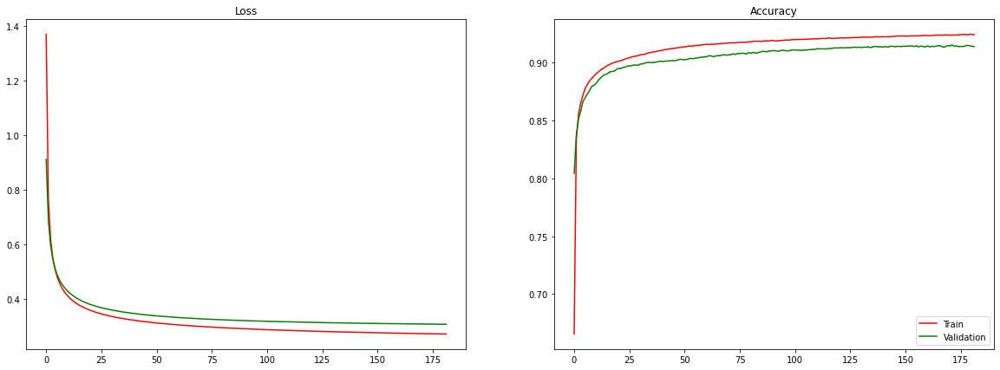

In [18]:
fig, (loss_ax, acc_ax) = plt.subplots(1, 2, figsize=(20,7))

loss_ax.set_title('Loss')
loss_ax.plot(cnn_baseline_model_train.history['loss'], '-r', label='Train')
loss_ax.plot(cnn_baseline_model_train.history['val_loss'], '-g', label='Validation')

acc_ax.set_title('Accuracy')
acc_ax.plot(cnn_baseline_model_train.history['accuracy'], '-r', label='Train')
acc_ax.plot(cnn_baseline_model_train.history['val_accuracy'], '-g', label='Validation')

plt.legend(loc=4)
plt.show()

Now let's load the best model for the validation data and evaluate it on the test set:

In [19]:
cnn_baseline_model.load_weights('cnn_baseline_best.h5')
loss, acc = cnn_baseline_model.evaluate(ds_test)
print('Accuracy: {}'.format(acc))

79/79 [==============================] - 0s 5ms/step - loss: 0.2770 - accuracy: 0.9219
Accuracy: 0.9218999743461609


#### Number of Filters

Now let's study the impact of the number of filters in a Convolutional Layer, which as mentioned can be changed using the *filters* parameter when instancing a new Conv2D layer. We will build a model just like the baseline, but adding a 2 Dimensional Convolutional layer just before flattening it.

"The number of filters is the number of neurons, since each neuron performs a different convolution on the input to the layer (more precisely, the neurons' input weights form convolution kernels).

A feature map is the result of applying a filter (thus, you have as many feature maps as filters), and its size is a result of window/kernel size of your filter and stride." [Source](https://stackoverflow.com/a/36243662/11501135)

Tested number of filters:
* 16
* 32
* 64
* 128

In [20]:
filters = [16, 32, 64, 128]
#filters = [16, 32]
histories = []
test_accuracies = []

for filter in filters:
  # Definition
  cur_cnn_model = tf.keras.Sequential(name='cnn_variable_filters_' + str(filter))
  cur_cnn_model.add(tf.keras.layers.Input(mnist_info.features['image'].shape)) # Input
  cur_cnn_model.add(tf.keras.layers.Conv2D(filters=filter, kernel_size=4, activation='relu', padding='same', name='convolution')) # Layer we will be testing
  cur_cnn_model.add(tf.keras.layers.Flatten(name='flatten'))
  cur_cnn_model.add(tf.keras.layers.Dense(mnist_info.features['label'].num_classes, activation='softmax', name='output')) # Output
  
  cur_cnn_model.compile(loss='sparse_categorical_crossentropy', optimizer='sgd', metrics=['accuracy'])

  # Stopping Callbacks
  earlystop = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=50, verbose=1)
  checkpoint = tf.keras.callbacks.ModelCheckpoint('cnn_variable_filters_' + str(filter) + '.h5', monitor='val_accuracy', verbose=1, save_best_only=True)

  histories += [cur_cnn_model.fit(ds_train, validation_data=ds_val, callbacks=[earlystop,checkpoint], epochs=no_epochs, batch_size=128)]

  test_accuracies += [cur_cnn_model.evaluate(ds_val)]

Epoch 1/1000
    397/Unknown - 3s 9ms/step - loss: 0.8059 - accuracy: 0.7981
Epoch 00001: val_accuracy improved from -inf to 0.88100, saving model to cnn_variable_filters_16.h5
399/399 [==============================] - 4s 10ms/step - loss: 0.8045 - accuracy: 0.7984 - val_loss: 0.4144 - val_accuracy: 0.8810
Epoch 2/1000
395/399 [============================>.] - ETA: 0s - loss: 0.3551 - accuracy: 0.8988
Epoch 00002: val_accuracy improved from 0.88100 to 0.89511, saving model to cnn_variable_filters_16.h5
399/399 [==============================] - 4s 10ms/step - loss: 0.3545 - accuracy: 0.8989 - val_loss: 0.3649 - val_accuracy: 0.8951
Epoch 3/1000
397/399 [============================>.] - ETA: 0s - loss: 0.3216 - accuracy: 0.9080
Epoch 00003: val_accuracy improved from 0.89511 to 0.90533, saving model to cnn_variable_filters_16.h5
399/399 [==============================] - 4s 10ms/step - loss: 0.3218 - accuracy: 0.9080 - val_loss: 0.3357 - val_accuracy: 0.9053
Epoch 4/1000
399/399 [===

Epoch 53/1000
396/399 [============================>.] - ETA: 0s - loss: 0.0659 - accuracy: 0.9827
Epoch 00053: val_accuracy did not improve from 0.97456
399/399 [==============================] - 4s 9ms/step - loss: 0.0658 - accuracy: 0.9827 - val_loss: 0.0907 - val_accuracy: 0.9738
Epoch 54/1000
396/399 [============================>.] - ETA: 0s - loss: 0.0649 - accuracy: 0.9826
Epoch 00054: val_accuracy did not improve from 0.97456
399/399 [==============================] - 4s 9ms/step - loss: 0.0648 - accuracy: 0.9827 - val_loss: 0.0910 - val_accuracy: 0.9731
Epoch 55/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0635 - accuracy: 0.9832
Epoch 00055: val_accuracy improved from 0.97456 to 0.97489, saving model to cnn_variable_filters_16.h5
399/399 [==============================] - 4s 9ms/step - loss: 0.0637 - accuracy: 0.9832 - val_loss: 0.0881 - val_accuracy: 0.9749
Epoch 56/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0628 - accuracy: 0.983

397/399 [============================>.] - ETA: 0s - loss: 0.0344 - accuracy: 0.9910
Epoch 00108: val_accuracy did not improve from 0.97933
399/399 [==============================] - 4s 9ms/step - loss: 0.0346 - accuracy: 0.9910 - val_loss: 0.0715 - val_accuracy: 0.9787
Epoch 109/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0341 - accuracy: 0.9912
Epoch 00109: val_accuracy did not improve from 0.97933
399/399 [==============================] - 4s 9ms/step - loss: 0.0342 - accuracy: 0.9911 - val_loss: 0.0710 - val_accuracy: 0.9788
Epoch 110/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0339 - accuracy: 0.9912
Epoch 00110: val_accuracy did not improve from 0.97933
399/399 [==============================] - 4s 9ms/step - loss: 0.0339 - accuracy: 0.9912 - val_loss: 0.0717 - val_accuracy: 0.9786
Epoch 111/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0335 - accuracy: 0.9914
Epoch 00111: val_accuracy did not improve from 0.97933
39

Epoch 136/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0272 - accuracy: 0.9932
Epoch 00136: val_accuracy did not improve from 0.98022
399/399 [==============================] - 4s 10ms/step - loss: 0.0274 - accuracy: 0.9931 - val_loss: 0.0691 - val_accuracy: 0.9790
Epoch 137/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0272 - accuracy: 0.9934
Epoch 00137: val_accuracy improved from 0.98022 to 0.98044, saving model to cnn_variable_filters_16.h5
399/399 [==============================] - 4s 10ms/step - loss: 0.0272 - accuracy: 0.9935 - val_loss: 0.0670 - val_accuracy: 0.9804
Epoch 138/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0269 - accuracy: 0.9936
Epoch 00138: val_accuracy did not improve from 0.98044
399/399 [==============================] - 4s 10ms/step - loss: 0.0269 - accuracy: 0.9936 - val_loss: 0.0682 - val_accuracy: 0.9799
Epoch 139/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0267 - accuracy

Epoch 164/1000
394/399 [============================>.] - ETA: 0s - loss: 0.0222 - accuracy: 0.9950
Epoch 00164: val_accuracy did not improve from 0.98100
399/399 [==============================] - 4s 10ms/step - loss: 0.0222 - accuracy: 0.9950 - val_loss: 0.0666 - val_accuracy: 0.9806
Epoch 165/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0220 - accuracy: 0.9950
Epoch 00165: val_accuracy did not improve from 0.98100
399/399 [==============================] - 4s 10ms/step - loss: 0.0220 - accuracy: 0.9950 - val_loss: 0.0670 - val_accuracy: 0.9807
Epoch 166/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0219 - accuracy: 0.9951
Epoch 00166: val_accuracy did not improve from 0.98100
399/399 [==============================] - 4s 10ms/step - loss: 0.0219 - accuracy: 0.9951 - val_loss: 0.0668 - val_accuracy: 0.9804
Epoch 167/1000
395/399 [============================>.] - ETA: 0s - loss: 0.0219 - accuracy: 0.9952
Epoch 00167: val_accuracy improved from

Epoch 192/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0184 - accuracy: 0.9962
Epoch 00192: val_accuracy did not improve from 0.98167
399/399 [==============================] - 4s 9ms/step - loss: 0.0184 - accuracy: 0.9962 - val_loss: 0.0663 - val_accuracy: 0.9808
Epoch 193/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0182 - accuracy: 0.9963
Epoch 00193: val_accuracy did not improve from 0.98167
399/399 [==============================] - 4s 9ms/step - loss: 0.0182 - accuracy: 0.9963 - val_loss: 0.0657 - val_accuracy: 0.9807
Epoch 194/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0181 - accuracy: 0.9963
Epoch 00194: val_accuracy did not improve from 0.98167
399/399 [==============================] - 4s 10ms/step - loss: 0.0181 - accuracy: 0.9964 - val_loss: 0.0682 - val_accuracy: 0.9809
Epoch 195/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0180 - accuracy: 0.9964
Epoch 00195: val_accuracy did not improve

Epoch 221/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0153 - accuracy: 0.9969
Epoch 00221: val_accuracy did not improve from 0.98167
399/399 [==============================] - 4s 10ms/step - loss: 0.0153 - accuracy: 0.9969 - val_loss: 0.0660 - val_accuracy: 0.9810
Epoch 222/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0152 - accuracy: 0.9971
Epoch 00222: val_accuracy did not improve from 0.98167
399/399 [==============================] - 4s 9ms/step - loss: 0.0152 - accuracy: 0.9971 - val_loss: 0.0675 - val_accuracy: 0.9808
Epoch 223/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0150 - accuracy: 0.9972
Epoch 00223: val_accuracy did not improve from 0.98167
399/399 [==============================] - 4s 9ms/step - loss: 0.0150 - accuracy: 0.9973 - val_loss: 0.0656 - val_accuracy: 0.9807
Epoch 224/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0149 - accuracy: 0.9973
Epoch 00224: val_accuracy did not improve

Epoch 250/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0129 - accuracy: 0.9979
Epoch 00250: val_accuracy did not improve from 0.98222
399/399 [==============================] - 4s 9ms/step - loss: 0.0129 - accuracy: 0.9979 - val_loss: 0.0672 - val_accuracy: 0.9818
Epoch 251/1000
394/399 [============================>.] - ETA: 0s - loss: 0.0127 - accuracy: 0.9979
Epoch 00251: val_accuracy did not improve from 0.98222
399/399 [==============================] - 4s 9ms/step - loss: 0.0127 - accuracy: 0.9979 - val_loss: 0.0677 - val_accuracy: 0.9814
Epoch 252/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0126 - accuracy: 0.9980
Epoch 00252: val_accuracy did not improve from 0.98222
399/399 [==============================] - 4s 9ms/step - loss: 0.0126 - accuracy: 0.9980 - val_loss: 0.0668 - val_accuracy: 0.9812
Epoch 253/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0126 - accuracy: 0.9978
Epoch 00253: val_accuracy did not improve 

Epoch 00278: early stopping
71/71 [==============================] - 0s 3ms/step - loss: 0.0670 - accuracy: 0.9814
Epoch 1/1000
    397/Unknown - 5s 14ms/step - loss: 0.7172 - accuracy: 0.8286
Epoch 00001: val_accuracy improved from -inf to 0.88456, saving model to cnn_variable_filters_32.h5
399/399 [==============================] - 6s 15ms/step - loss: 0.7157 - accuracy: 0.8289 - val_loss: 0.4006 - val_accuracy: 0.8846
Epoch 2/1000
396/399 [============================>.] - ETA: 0s - loss: 0.3540 - accuracy: 0.8995
Epoch 00002: val_accuracy improved from 0.88456 to 0.89489, saving model to cnn_variable_filters_32.h5
399/399 [==============================] - 6s 15ms/step - loss: 0.3538 - accuracy: 0.8995 - val_loss: 0.3663 - val_accuracy: 0.8949
Epoch 3/1000
397/399 [============================>.] - ETA: 0s - loss: 0.3253 - accuracy: 0.9069
Epoch 00003: val_accuracy improved from 0.89489 to 0.90111, saving model to cnn_variable_filters_32.h5
399/399 [==============================] 

Epoch 26/1000
397/399 [============================>.] - ETA: 0s - loss: 0.1276 - accuracy: 0.9660
Epoch 00026: val_accuracy improved from 0.95789 to 0.96089, saving model to cnn_variable_filters_32.h5
399/399 [==============================] - 6s 15ms/step - loss: 0.1275 - accuracy: 0.9661 - val_loss: 0.1470 - val_accuracy: 0.9609
Epoch 27/1000
397/399 [============================>.] - ETA: 0s - loss: 0.1223 - accuracy: 0.9671
Epoch 00027: val_accuracy improved from 0.96089 to 0.96111, saving model to cnn_variable_filters_32.h5
399/399 [==============================] - 6s 15ms/step - loss: 0.1223 - accuracy: 0.9672 - val_loss: 0.1404 - val_accuracy: 0.9611
Epoch 28/1000
397/399 [============================>.] - ETA: 0s - loss: 0.1173 - accuracy: 0.9687
Epoch 00028: val_accuracy improved from 0.96111 to 0.96244, saving model to cnn_variable_filters_32.h5
399/399 [==============================] - 6s 15ms/step - loss: 0.1173 - accuracy: 0.9687 - val_loss: 0.1359 - val_accuracy: 0.962

Epoch 80/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0431 - accuracy: 0.9886
Epoch 00080: val_accuracy did not improve from 0.97811
399/399 [==============================] - 6s 15ms/step - loss: 0.0432 - accuracy: 0.9886 - val_loss: 0.0733 - val_accuracy: 0.9781
Epoch 81/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0426 - accuracy: 0.9889
Epoch 00081: val_accuracy did not improve from 0.97811
399/399 [==============================] - 6s 15ms/step - loss: 0.0426 - accuracy: 0.9889 - val_loss: 0.0723 - val_accuracy: 0.9777
Epoch 82/1000
396/399 [============================>.] - ETA: 0s - loss: 0.0422 - accuracy: 0.9890
Epoch 00082: val_accuracy did not improve from 0.97811
399/399 [==============================] - 6s 15ms/step - loss: 0.0423 - accuracy: 0.9890 - val_loss: 0.0742 - val_accuracy: 0.9773
Epoch 83/1000
395/399 [============================>.] - ETA: 0s - loss: 0.0418 - accuracy: 0.9894
Epoch 00083: val_accuracy did not improve f

Epoch 136/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0262 - accuracy: 0.9936
Epoch 00136: val_accuracy did not improve from 0.98056
399/399 [==============================] - 6s 15ms/step - loss: 0.0262 - accuracy: 0.9936 - val_loss: 0.0660 - val_accuracy: 0.9799
Epoch 137/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0261 - accuracy: 0.9936
Epoch 00137: val_accuracy did not improve from 0.98056
399/399 [==============================] - 6s 15ms/step - loss: 0.0261 - accuracy: 0.9936 - val_loss: 0.0655 - val_accuracy: 0.9803
Epoch 138/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0261 - accuracy: 0.9937
Epoch 00138: val_accuracy did not improve from 0.98056
399/399 [==============================] - 6s 15ms/step - loss: 0.0260 - accuracy: 0.9938 - val_loss: 0.0664 - val_accuracy: 0.9804
Epoch 139/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0257 - accuracy: 0.9937
Epoch 00139: val_accuracy did not impro

397/399 [============================>.] - ETA: 0s - loss: 0.0214 - accuracy: 0.9953
Epoch 00164: val_accuracy did not improve from 0.98144
399/399 [==============================] - 6s 15ms/step - loss: 0.0215 - accuracy: 0.9953 - val_loss: 0.0669 - val_accuracy: 0.9799
Epoch 165/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0213 - accuracy: 0.9951
Epoch 00165: val_accuracy did not improve from 0.98144
399/399 [==============================] - 6s 15ms/step - loss: 0.0214 - accuracy: 0.9951 - val_loss: 0.0645 - val_accuracy: 0.9809
Epoch 166/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0212 - accuracy: 0.9951
Epoch 00166: val_accuracy did not improve from 0.98144
399/399 [==============================] - 6s 15ms/step - loss: 0.0211 - accuracy: 0.9952 - val_loss: 0.0654 - val_accuracy: 0.9809
Epoch 167/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0209 - accuracy: 0.9954
Epoch 00167: val_accuracy did not improve from 0.98144

Epoch 193/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0176 - accuracy: 0.9963
Epoch 00193: val_accuracy did not improve from 0.98144
399/399 [==============================] - 7s 16ms/step - loss: 0.0176 - accuracy: 0.9963 - val_loss: 0.0659 - val_accuracy: 0.9810
Epoch 194/1000
396/399 [============================>.] - ETA: 0s - loss: 0.0175 - accuracy: 0.9962
Epoch 00194: val_accuracy did not improve from 0.98144
399/399 [==============================] - 6s 16ms/step - loss: 0.0175 - accuracy: 0.9962 - val_loss: 0.0668 - val_accuracy: 0.9804
Epoch 195/1000
396/399 [============================>.] - ETA: 0s - loss: 0.0173 - accuracy: 0.9966
Epoch 00195: val_accuracy did not improve from 0.98144
399/399 [==============================] - 7s 17ms/step - loss: 0.0174 - accuracy: 0.9966 - val_loss: 0.0664 - val_accuracy: 0.9801
Epoch 196/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0172 - accuracy: 0.9965
Epoch 00196: val_accuracy did not impro

Epoch 15/1000
397/399 [============================>.] - ETA: 0s - loss: 0.2047 - accuracy: 0.9436
Epoch 00015: val_accuracy improved from 0.93433 to 0.93711, saving model to cnn_variable_filters_64.h5
399/399 [==============================] - 12s 30ms/step - loss: 0.2048 - accuracy: 0.9435 - val_loss: 0.2259 - val_accuracy: 0.9371
Epoch 16/1000
397/399 [============================>.] - ETA: 0s - loss: 0.1948 - accuracy: 0.9459
Epoch 00016: val_accuracy improved from 0.93711 to 0.94322, saving model to cnn_variable_filters_64.h5
399/399 [==============================] - 13s 32ms/step - loss: 0.1949 - accuracy: 0.9459 - val_loss: 0.2094 - val_accuracy: 0.9432
Epoch 17/1000
397/399 [============================>.] - ETA: 0s - loss: 0.1850 - accuracy: 0.9483
Epoch 00017: val_accuracy improved from 0.94322 to 0.94489, saving model to cnn_variable_filters_64.h5
399/399 [==============================] - 12s 30ms/step - loss: 0.1849 - accuracy: 0.9483 - val_loss: 0.2015 - val_accuracy: 0.

397/399 [============================>.] - ETA: 0s - loss: 0.0794 - accuracy: 0.9790
Epoch 00040: val_accuracy improved from 0.97100 to 0.97111, saving model to cnn_variable_filters_64.h5
399/399 [==============================] - 13s 32ms/step - loss: 0.0795 - accuracy: 0.9790 - val_loss: 0.1038 - val_accuracy: 0.9711
Epoch 41/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0775 - accuracy: 0.9792
Epoch 00041: val_accuracy did not improve from 0.97111
399/399 [==============================] - 12s 30ms/step - loss: 0.0775 - accuracy: 0.9793 - val_loss: 0.1002 - val_accuracy: 0.9709
Epoch 42/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0759 - accuracy: 0.9795
Epoch 00042: val_accuracy improved from 0.97111 to 0.97244, saving model to cnn_variable_filters_64.h5
399/399 [==============================] - 12s 31ms/step - loss: 0.0758 - accuracy: 0.9795 - val_loss: 0.0973 - val_accuracy: 0.9724
Epoch 43/1000
397/399 [============================>.] - 

Epoch 67/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0504 - accuracy: 0.9863
Epoch 00067: val_accuracy did not improve from 0.97767
399/399 [==============================] - 12s 30ms/step - loss: 0.0504 - accuracy: 0.9863 - val_loss: 0.0794 - val_accuracy: 0.9773
Epoch 68/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0496 - accuracy: 0.9869
Epoch 00068: val_accuracy did not improve from 0.97767
399/399 [==============================] - 12s 30ms/step - loss: 0.0497 - accuracy: 0.9869 - val_loss: 0.0798 - val_accuracy: 0.9763
Epoch 69/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0492 - accuracy: 0.9872
Epoch 00069: val_accuracy did not improve from 0.97767
399/399 [==============================] - 12s 30ms/step - loss: 0.0492 - accuracy: 0.9871 - val_loss: 0.0772 - val_accuracy: 0.9771
Epoch 70/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0484 - accuracy: 0.9872
Epoch 00070: val_accuracy improved from 

Epoch 95/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0369 - accuracy: 0.9901
Epoch 00095: val_accuracy did not improve from 0.97911
399/399 [==============================] - 12s 31ms/step - loss: 0.0369 - accuracy: 0.9902 - val_loss: 0.0713 - val_accuracy: 0.9784
Epoch 96/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0365 - accuracy: 0.9904
Epoch 00096: val_accuracy did not improve from 0.97911
399/399 [==============================] - 13s 33ms/step - loss: 0.0365 - accuracy: 0.9904 - val_loss: 0.0721 - val_accuracy: 0.9778
Epoch 97/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0362 - accuracy: 0.9906
Epoch 00097: val_accuracy did not improve from 0.97911
399/399 [==============================] - 12s 31ms/step - loss: 0.0362 - accuracy: 0.9905 - val_loss: 0.0708 - val_accuracy: 0.9784
Epoch 98/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0358 - accuracy: 0.9907
Epoch 00098: val_accuracy did not improv

399/399 [==============================] - ETA: 0s - loss: 0.0233 - accuracy: 0.9947
Epoch 00151: val_accuracy did not improve from 0.98044
399/399 [==============================] - 14s 34ms/step - loss: 0.0233 - accuracy: 0.9947 - val_loss: 0.0678 - val_accuracy: 0.9794
Epoch 152/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0230 - accuracy: 0.9946
Epoch 00152: val_accuracy did not improve from 0.98044
399/399 [==============================] - 13s 32ms/step - loss: 0.0230 - accuracy: 0.9946 - val_loss: 0.0662 - val_accuracy: 0.9798
Epoch 153/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0229 - accuracy: 0.9947
Epoch 00153: val_accuracy did not improve from 0.98044
399/399 [==============================] - 13s 32ms/step - loss: 0.0229 - accuracy: 0.9947 - val_loss: 0.0673 - val_accuracy: 0.9797
Epoch 154/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0227 - accuracy: 0.9949
Epoch 00154: val_accuracy did not improve from 0.98

Epoch 179/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0191 - accuracy: 0.9959
Epoch 00179: val_accuracy did not improve from 0.98100
399/399 [==============================] - 12s 31ms/step - loss: 0.0191 - accuracy: 0.9959 - val_loss: 0.0663 - val_accuracy: 0.9806
Epoch 180/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0188 - accuracy: 0.9962
Epoch 00180: val_accuracy did not improve from 0.98100
399/399 [==============================] - 12s 31ms/step - loss: 0.0188 - accuracy: 0.9962 - val_loss: 0.0663 - val_accuracy: 0.9804
Epoch 181/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0188 - accuracy: 0.9962
Epoch 00181: val_accuracy did not improve from 0.98100
399/399 [==============================] - 12s 30ms/step - loss: 0.0188 - accuracy: 0.9962 - val_loss: 0.0665 - val_accuracy: 0.9801
Epoch 182/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0186 - accuracy: 0.9962
Epoch 00182: val_accuracy did not im

397/399 [============================>.] - ETA: 0s - loss: 0.0133 - accuracy: 0.9977
Epoch 00235: val_accuracy did not improve from 0.98144
399/399 [==============================] - 12s 31ms/step - loss: 0.0133 - accuracy: 0.9977 - val_loss: 0.0687 - val_accuracy: 0.9802
Epoch 236/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0131 - accuracy: 0.9977
Epoch 00236: val_accuracy did not improve from 0.98144
399/399 [==============================] - 12s 31ms/step - loss: 0.0132 - accuracy: 0.9977 - val_loss: 0.0668 - val_accuracy: 0.9810
Epoch 237/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0131 - accuracy: 0.9976 ETA: 0s - l
Epoch 00237: val_accuracy did not improve from 0.98144
399/399 [==============================] - 12s 31ms/step - loss: 0.0131 - accuracy: 0.9976 - val_loss: 0.0677 - val_accuracy: 0.9804
Epoch 238/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0131 - accuracy: 0.9979
Epoch 00238: val_accuracy did not impro

Epoch 292/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0096 - accuracy: 0.9987
Epoch 00292: val_accuracy did not improve from 0.98167
399/399 [==============================] - 12s 31ms/step - loss: 0.0096 - accuracy: 0.9987 - val_loss: 0.0695 - val_accuracy: 0.9814
Epoch 293/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0095 - accuracy: 0.9989
Epoch 00293: val_accuracy did not improve from 0.98167
399/399 [==============================] - 12s 30ms/step - loss: 0.0095 - accuracy: 0.9989 - val_loss: 0.0701 - val_accuracy: 0.9807
Epoch 294/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0094 - accuracy: 0.9990
Epoch 00294: val_accuracy did not improve from 0.98167
399/399 [==============================] - 12s 30ms/step - loss: 0.0095 - accuracy: 0.9990 - val_loss: 0.0694 - val_accuracy: 0.9808
Epoch 295/1000
397/399 [============================>.] - ETA: 0s - loss: 0.0094 - accuracy: 0.9989
Epoch 00295: val_accuracy did not im

Epoch 15/1000
398/399 [============================>.] - ETA: 0s - loss: 0.2073 - accuracy: 0.9423
Epoch 00015: val_accuracy improved from 0.93456 to 0.93911, saving model to cnn_variable_filters_128.h5
399/399 [==============================] - 22s 56ms/step - loss: 0.2072 - accuracy: 0.9423 - val_loss: 0.2245 - val_accuracy: 0.9391
Epoch 16/1000
398/399 [============================>.] - ETA: 0s - loss: 0.1970 - accuracy: 0.9456
Epoch 00016: val_accuracy improved from 0.93911 to 0.94267, saving model to cnn_variable_filters_128.h5
399/399 [==============================] - 22s 55ms/step - loss: 0.1970 - accuracy: 0.9456 - val_loss: 0.2146 - val_accuracy: 0.9427
Epoch 17/1000
398/399 [============================>.] - ETA: 0s - loss: 0.1873 - accuracy: 0.9486
Epoch 00017: val_accuracy improved from 0.94267 to 0.94322, saving model to cnn_variable_filters_128.h5
399/399 [==============================] - 22s 55ms/step - loss: 0.1872 - accuracy: 0.9486 - val_loss: 0.2083 - val_accuracy:

Epoch 40/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0771 - accuracy: 0.9799
Epoch 00040: val_accuracy did not improve from 0.97156
399/399 [==============================] - 24s 59ms/step - loss: 0.0771 - accuracy: 0.9799 - val_loss: 0.0986 - val_accuracy: 0.9710
Epoch 41/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0751 - accuracy: 0.9803
Epoch 00041: val_accuracy did not improve from 0.97156
399/399 [==============================] - 23s 58ms/step - loss: 0.0753 - accuracy: 0.9802 - val_loss: 0.0986 - val_accuracy: 0.9714
Epoch 42/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0739 - accuracy: 0.9805
Epoch 00042: val_accuracy improved from 0.97156 to 0.97289, saving model to cnn_variable_filters_128.h5
399/399 [==============================] - 22s 56ms/step - loss: 0.0739 - accuracy: 0.9805 - val_loss: 0.0962 - val_accuracy: 0.9729
Epoch 43/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0720 - accuracy

398/399 [============================>.] - ETA: 0s - loss: 0.0356 - accuracy: 0.9908
Epoch 00095: val_accuracy did not improve from 0.97956
399/399 [==============================] - 22s 55ms/step - loss: 0.0356 - accuracy: 0.9908 - val_loss: 0.0711 - val_accuracy: 0.9783
Epoch 96/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0353 - accuracy: 0.9909
Epoch 00096: val_accuracy did not improve from 0.97956
399/399 [==============================] - 21s 52ms/step - loss: 0.0353 - accuracy: 0.9909 - val_loss: 0.0697 - val_accuracy: 0.9791
Epoch 97/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0349 - accuracy: 0.9911
Epoch 00097: val_accuracy did not improve from 0.97956
399/399 [==============================] - 21s 52ms/step - loss: 0.0349 - accuracy: 0.9911 - val_loss: 0.0693 - val_accuracy: 0.9792
Epoch 98/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0346 - accuracy: 0.9912
Epoch 00098: val_accuracy improved from 0.97956 to 0.9

Epoch 123/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0278 - accuracy: 0.9930
Epoch 00123: val_accuracy did not improve from 0.98078
399/399 [==============================] - 25s 63ms/step - loss: 0.0278 - accuracy: 0.9930 - val_loss: 0.0667 - val_accuracy: 0.9803
Epoch 124/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0275 - accuracy: 0.9934
Epoch 00124: val_accuracy did not improve from 0.98078
399/399 [==============================] - 25s 62ms/step - loss: 0.0275 - accuracy: 0.9934 - val_loss: 0.0661 - val_accuracy: 0.9801
Epoch 125/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0272 - accuracy: 0.9933
Epoch 00125: val_accuracy did not improve from 0.98078
399/399 [==============================] - 25s 63ms/step - loss: 0.0272 - accuracy: 0.9934 - val_loss: 0.0668 - val_accuracy: 0.9801
Epoch 126/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0271 - accuracy: 0.9936
Epoch 00126: val_accuracy did not im

398/399 [============================>.] - ETA: 0s - loss: 0.0183 - accuracy: 0.9961
Epoch 00179: val_accuracy did not improve from 0.98167
399/399 [==============================] - 25s 63ms/step - loss: 0.0183 - accuracy: 0.9961 - val_loss: 0.0648 - val_accuracy: 0.9808
Epoch 180/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0180 - accuracy: 0.9963
Epoch 00180: val_accuracy did not improve from 0.98167
399/399 [==============================] - 25s 63ms/step - loss: 0.0180 - accuracy: 0.9963 - val_loss: 0.0658 - val_accuracy: 0.9809
Epoch 181/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0179 - accuracy: 0.9963
Epoch 00181: val_accuracy did not improve from 0.98167
399/399 [==============================] - 26s 65ms/step - loss: 0.0180 - accuracy: 0.9963 - val_loss: 0.0652 - val_accuracy: 0.9802
Epoch 182/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0179 - accuracy: 0.9964
Epoch 00182: val_accuracy did not improve from 0.98

Epoch 207/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0151 - accuracy: 0.9971
Epoch 00207: val_accuracy did not improve from 0.98200
399/399 [==============================] - 25s 63ms/step - loss: 0.0151 - accuracy: 0.9971 - val_loss: 0.0648 - val_accuracy: 0.9809
Epoch 208/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0149 - accuracy: 0.9973
Epoch 00208: val_accuracy did not improve from 0.98200
399/399 [==============================] - 25s 63ms/step - loss: 0.0149 - accuracy: 0.9973 - val_loss: 0.0653 - val_accuracy: 0.9819
Epoch 209/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0148 - accuracy: 0.9973
Epoch 00209: val_accuracy did not improve from 0.98200
399/399 [==============================] - 25s 63ms/step - loss: 0.0148 - accuracy: 0.9973 - val_loss: 0.0647 - val_accuracy: 0.9813
Epoch 210/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0148 - accuracy: 0.9972
Epoch 00210: val_accuracy improved f

Epoch 3/1000
398/399 [============================>.] - ETA: 0s - loss: 0.3225 - accuracy: 0.9077
Epoch 00003: val_accuracy improved from 0.89811 to 0.90500, saving model to cnn_variable_filters_256.h5
399/399 [==============================] - 40s 101ms/step - loss: 0.3225 - accuracy: 0.9077 - val_loss: 0.3334 - val_accuracy: 0.9050
Epoch 4/1000
398/399 [============================>.] - ETA: 0s - loss: 0.3059 - accuracy: 0.9119
Epoch 00004: val_accuracy improved from 0.90500 to 0.90600, saving model to cnn_variable_filters_256.h5
399/399 [==============================] - 40s 101ms/step - loss: 0.3059 - accuracy: 0.9119 - val_loss: 0.3239 - val_accuracy: 0.9060
Epoch 5/1000
398/399 [============================>.] - ETA: 0s - loss: 0.2949 - accuracy: 0.9155
Epoch 00005: val_accuracy improved from 0.90600 to 0.90944, saving model to cnn_variable_filters_256.h5
399/399 [==============================] - 40s 101ms/step - loss: 0.2948 - accuracy: 0.9154 - val_loss: 0.3159 - val_accuracy:

Epoch 28/1000
398/399 [============================>.] - ETA: 0s - loss: 0.1106 - accuracy: 0.9705
Epoch 00028: val_accuracy improved from 0.96222 to 0.96511, saving model to cnn_variable_filters_256.h5
399/399 [==============================] - 40s 101ms/step - loss: 0.1106 - accuracy: 0.9705 - val_loss: 0.1283 - val_accuracy: 0.9651
Epoch 29/1000
398/399 [============================>.] - ETA: 0s - loss: 0.1066 - accuracy: 0.9718
Epoch 00029: val_accuracy did not improve from 0.96511
399/399 [==============================] - 40s 100ms/step - loss: 0.1065 - accuracy: 0.9718 - val_loss: 0.1266 - val_accuracy: 0.9650
Epoch 30/1000
398/399 [============================>.] - ETA: 0s - loss: 0.1025 - accuracy: 0.9731
Epoch 00030: val_accuracy improved from 0.96511 to 0.96656, saving model to cnn_variable_filters_256.h5
399/399 [==============================] - 40s 101ms/step - loss: 0.1027 - accuracy: 0.9731 - val_loss: 0.1208 - val_accuracy: 0.9666
Epoch 31/1000
398/399 [===============

Epoch 54/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0593 - accuracy: 0.9842
Epoch 00054: val_accuracy improved from 0.97544 to 0.97589, saving model to cnn_variable_filters_256.h5
399/399 [==============================] - 41s 103ms/step - loss: 0.0593 - accuracy: 0.9842 - val_loss: 0.0853 - val_accuracy: 0.9759
Epoch 55/1000
399/399 [==============================] - ETA: 0s - loss: 0.0584 - accuracy: 0.9845
Epoch 00055: val_accuracy did not improve from 0.97589
399/399 [==============================] - 40s 101ms/step - loss: 0.0584 - accuracy: 0.9845 - val_loss: 0.0835 - val_accuracy: 0.9757
Epoch 56/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0577 - accuracy: 0.9850
Epoch 00056: val_accuracy did not improve from 0.97589
399/399 [==============================] - 40s 100ms/step - loss: 0.0576 - accuracy: 0.9850 - val_loss: 0.0820 - val_accuracy: 0.9759
Epoch 57/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0567 - accur

Epoch 81/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0417 - accuracy: 0.9890
Epoch 00081: val_accuracy did not improve from 0.97911
399/399 [==============================] - 40s 100ms/step - loss: 0.0417 - accuracy: 0.9890 - val_loss: 0.0724 - val_accuracy: 0.9787
Epoch 82/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0413 - accuracy: 0.9891
Epoch 00082: val_accuracy did not improve from 0.97911
399/399 [==============================] - 40s 100ms/step - loss: 0.0413 - accuracy: 0.9892 - val_loss: 0.0711 - val_accuracy: 0.9789
Epoch 83/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0409 - accuracy: 0.9892 ETA: 1s - l
Epoch 00083: val_accuracy did not improve from 0.97911
399/399 [==============================] - 40s 100ms/step - loss: 0.0409 - accuracy: 0.9892 - val_loss: 0.0726 - val_accuracy: 0.9787
Epoch 84/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0404 - accuracy: 0.9892
Epoch 00084: val_accuracy

Epoch 109/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0317 - accuracy: 0.9920
Epoch 00109: val_accuracy did not improve from 0.97978
399/399 [==============================] - 40s 100ms/step - loss: 0.0318 - accuracy: 0.9920 - val_loss: 0.0692 - val_accuracy: 0.9788
Epoch 110/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0314 - accuracy: 0.9917
Epoch 00110: val_accuracy did not improve from 0.97978
399/399 [==============================] - 40s 100ms/step - loss: 0.0314 - accuracy: 0.9917 - val_loss: 0.0702 - val_accuracy: 0.9789
Epoch 111/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0311 - accuracy: 0.9919
Epoch 00111: val_accuracy improved from 0.97978 to 0.98022, saving model to cnn_variable_filters_256.h5
399/399 [==============================] - 40s 100ms/step - loss: 0.0311 - accuracy: 0.9919 - val_loss: 0.0676 - val_accuracy: 0.9802
Epoch 112/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0308 - a

398/399 [============================>.] - ETA: 0s - loss: 0.0251 - accuracy: 0.9939
Epoch 00137: val_accuracy did not improve from 0.98067
399/399 [==============================] - 42s 104ms/step - loss: 0.0251 - accuracy: 0.9939 - val_loss: 0.0661 - val_accuracy: 0.9801
Epoch 138/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0251 - accuracy: 0.9939
Epoch 00138: val_accuracy did not improve from 0.98067
399/399 [==============================] - 42s 105ms/step - loss: 0.0251 - accuracy: 0.9939 - val_loss: 0.0670 - val_accuracy: 0.9797
Epoch 139/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0248 - accuracy: 0.9939
Epoch 00139: val_accuracy improved from 0.98067 to 0.98078, saving model to cnn_variable_filters_256.h5
399/399 [==============================] - 41s 103ms/step - loss: 0.0249 - accuracy: 0.9939 - val_loss: 0.0647 - val_accuracy: 0.9808
Epoch 140/1000
399/399 [==============================] - ETA: 0s - loss: 0.0247 - accuracy: 0.9940

Epoch 165/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0204 - accuracy: 0.9955
Epoch 00165: val_accuracy did not improve from 0.98089
399/399 [==============================] - 42s 106ms/step - loss: 0.0204 - accuracy: 0.9955 - val_loss: 0.0651 - val_accuracy: 0.9807
Epoch 166/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0204 - accuracy: 0.9956
Epoch 00166: val_accuracy did not improve from 0.98089
399/399 [==============================] - 42s 105ms/step - loss: 0.0204 - accuracy: 0.9956 - val_loss: 0.0653 - val_accuracy: 0.9804
Epoch 167/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0202 - accuracy: 0.9955 ETA: 0s - loss: 0.0203 - accura
Epoch 00167: val_accuracy did not improve from 0.98089
399/399 [==============================] - 42s 106ms/step - loss: 0.0202 - accuracy: 0.9955 - val_loss: 0.0653 - val_accuracy: 0.9803
Epoch 168/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0200 - accuracy: 0.9955
E

Epoch 193/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0168 - accuracy: 0.9965
Epoch 00193: val_accuracy did not improve from 0.98144
399/399 [==============================] - 40s 100ms/step - loss: 0.0168 - accuracy: 0.9965 - val_loss: 0.0651 - val_accuracy: 0.9813
Epoch 194/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0167 - accuracy: 0.9966
Epoch 00194: val_accuracy improved from 0.98144 to 0.98167, saving model to cnn_variable_filters_256.h5
399/399 [==============================] - 40s 100ms/step - loss: 0.0167 - accuracy: 0.9966 - val_loss: 0.0647 - val_accuracy: 0.9817
Epoch 195/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0166 - accuracy: 0.9967
Epoch 00195: val_accuracy did not improve from 0.98167
399/399 [==============================] - 40s 100ms/step - loss: 0.0166 - accuracy: 0.9967 - val_loss: 0.0654 - val_accuracy: 0.9807
Epoch 196/1000
398/399 [============================>.] - ETA: 0s - loss: 0.0165 - a

KeyboardInterrupt: 

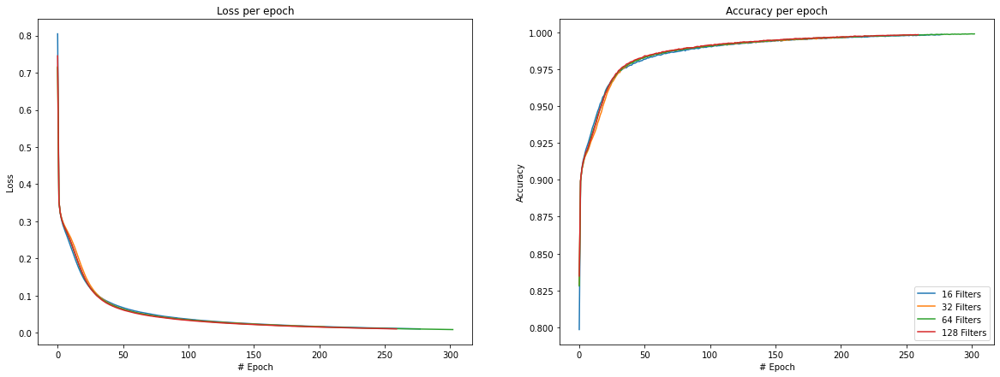

<ipython-input-40-ea673176a3b0>:26: MatplotlibDeprecationWarning: The 'basex' parameter of __init__() has been renamed 'base' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  loss_ax.set_xscale('log', basex=2)
<ipython-input-40-ea673176a3b0>:33: MatplotlibDeprecationWarning: The 'basex' parameter of __init__() has been renamed 'base' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  acc_ax.set_xscale('log', basex=2)


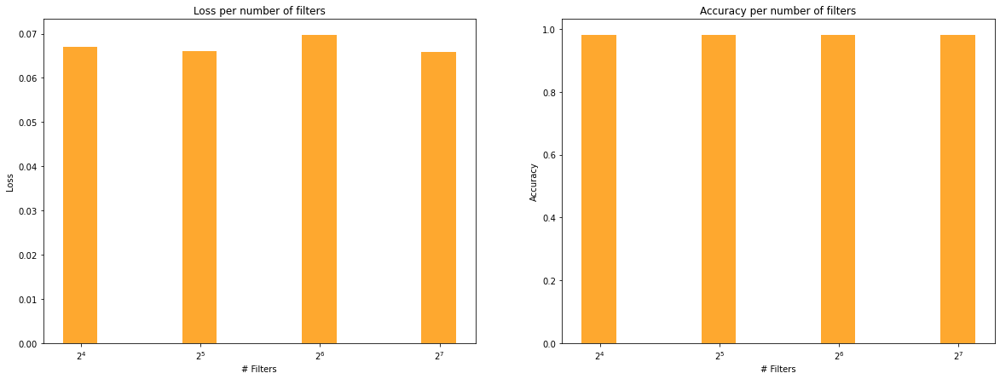

In [40]:
# Evaluation
# Train 
fig, (loss_ax, acc_ax) = plt.subplots(1, 2, figsize=(20,7))

loss_ax.set_title('Loss per epoch')
for i in range(0, len(filters)):
  loss_ax.plot(histories[i].history['loss'], label='' + str(filters[i]) + ' Filters')
loss_ax.set(xlabel='# Epoch', ylabel='Loss')

acc_ax.set_title('Accuracy per epoch')
for i in range(0, len(filters)):
  acc_ax.plot(histories[i].history['accuracy'], label='' + str(filters[i]) + ' Filters')
acc_ax.set(xlabel='# Epoch', ylabel='Accuracy')

plt.legend(loc=4)
plt.show()


fig, (loss_ax, acc_ax) = plt.subplots(1, 2, figsize=(20,7))

[1.6, 3.2, 6.4, 12.8]

loss_ax.set_title('Loss per number of filters')
loss_ax.bar(filters, [i[0] for i in test_accuracies], width=[3.2, 6.4, 12.8, 25.6], color='#fea82f')
loss_ax.set(xlabel='# Filters', ylabel='Loss')
loss_ax.set_xscale('log', basex=2)
loss_ax.set_xticks(filters)
loss_ax.tick_params(axis='x', which='minor', bottom=False)

acc_ax.set_title('Accuracy per number of filters')
acc_ax.bar(filters, [i[1] for i in test_accuracies], width=[3.2, 6.4, 12.8, 25.6], color='#fea82f')
acc_ax.set(xlabel='# Filters', ylabel='Accuracy')
acc_ax.set_xscale('log', basex=2)
acc_ax.set_xticks(filters)
acc_ax.tick_params(axis='x', which='minor', bottom=False)

plt.show()

Finally, we can evaluate each model on the test set, which the model has never "seen".

In [11]:
filters = [16, 32, 64, 128]

for filter in filters:
  cur_cnn_model = tf.keras.Sequential(name='cnn_variable_filters_' + str(filter))
  cur_cnn_model.add(tf.keras.layers.Input(mnist_info.features['image'].shape)) # Input
  cur_cnn_model.add(tf.keras.layers.Conv2D(filters=filter, kernel_size=4, activation='relu', padding='same', name='convolution')) # Layer we will be testing
  cur_cnn_model.add(tf.keras.layers.Flatten(name='flatten'))
  cur_cnn_model.add(tf.keras.layers.Dense(mnist_info.features['label'].num_classes, activation='softmax', name='output')) # Output

  cur_cnn_model.compile(loss='sparse_categorical_crossentropy', optimizer='sgd', metrics=['accuracy'])

  cur_cnn_model.load_weights('cnn_variable_filters_' + str(filter) + '.h5')

  loss, acc = cur_cnn_model.evaluate(ds_test)
  print('Test accuracy for ' + str(filter) + ' filters: {}'.format(acc))

79/79 [==============================] - 1s 7ms/step - loss: 0.0540 - accuracy: 0.9838
Test accuracy for 16 filters: 0.9837999939918518
79/79 [==============================] - 0s 5ms/step - loss: 0.0519 - accuracy: 0.9837
Test accuracy for 32 filters: 0.9836999773979187
79/79 [==============================] - 1s 8ms/step - loss: 0.0576 - accuracy: 0.9819
Test accuracy for 64 filters: 0.9818999767303467
79/79 [==============================] - 1s 15ms/step - loss: 0.0544 - accuracy: 0.9839
Test accuracy for 128 filters: 0.9839000105857849


#### Pooling vs. No Pooling

Let's study the impact between having or not having pooling layers, as well as a few different out-of-the-box pooling layers provided by Keras. Much like in the previous section, we will merely be adding a Pooling layer to the baseline model before flattening.

Pooling layers provide an approach to down sampling feature maps by summarizing the presence of features in patches of the feature map. Two common pooling methods are average pooling and max pooling that summarize the average presence of a feature and the most activated presence of a feature respectively. [Source](https://machinelearningmastery.com/pooling-layers-for-convolutional-neural-networks/)

Tested Pooling methods:
* None
* MaxPooling
* AveragePooling

In [14]:
pools = [
         None,
         tf.keras.layers.MaxPooling2D(pool_size=2, name='max'),
         tf.keras.layers.AveragePooling2D(pool_size=2, name='avg')
]
histories = []
test_accuracies = []

for pool in pools:
  name = pool.name if pool else "none"
  
  # Definition
  cur_cnn_model = tf.keras.Sequential(name='cnn_variable_pools_' + name)
  cur_cnn_model.add(tf.keras.layers.Input(mnist_info.features['image'].shape)) # Input
  if pool:
    cur_cnn_model.add(pool)
  cur_cnn_model.add(tf.keras.layers.Flatten(name='flatten'))
  cur_cnn_model.add(tf.keras.layers.Dense(mnist_info.features['label'].num_classes, activation='softmax', name='output')) # Output
  
  cur_cnn_model.compile(loss='sparse_categorical_crossentropy', optimizer='sgd', metrics=['accuracy'])

  # Stopping Callbacks
  earlystop = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=20, verbose=1)
  checkpoint = tf.keras.callbacks.ModelCheckpoint('cnn_variable_pools_' + name + '.h5', monitor='val_accuracy', verbose=1, save_best_only=True)

  histories += [cur_cnn_model.fit(ds_train, validation_data=ds_val, callbacks=[earlystop,checkpoint], epochs=no_epochs, batch_size=128)]

  test_accuracies += [cur_cnn_model.evaluate(ds_val)]

Epoch 1/500
    352/Unknown - 0s 505us/step - loss: 1.3775 - accuracy: 0.6872
Epoch 00001: val_accuracy improved from -inf to 0.81189, saving model to cnn_variable_pools_none.h5
399/399 [==============================] - 1s 3ms/step - loss: 1.3237 - accuracy: 0.7024 - val_loss: 0.9036 - val_accuracy: 0.8119
Epoch 2/500
307/399 [======================>.......] - ETA: 0s - loss: 0.7799 - accuracy: 0.8346
Epoch 00002: val_accuracy improved from 0.81189 to 0.84022, saving model to cnn_variable_pools_none.h5
399/399 [==============================] - 0s 694us/step - loss: 0.7605 - accuracy: 0.8351 - val_loss: 0.6867 - val_accuracy: 0.8402
Epoch 3/500
322/399 [=======================>......] - ETA: 0s - loss: 0.6260 - accuracy: 0.8547
Epoch 00003: val_accuracy improved from 0.84022 to 0.85333, saving model to cnn_variable_pools_none.h5
399/399 [==============================] - 0s 643us/step - loss: 0.6201 - accuracy: 0.8548 - val_loss: 0.5974 - val_accuracy: 0.8533
Epoch 4/500
326/399 [====

Epoch 26/500
381/399 [===========================>..] - ETA: 0s - loss: 0.3470 - accuracy: 0.9042
Epoch 00026: val_accuracy improved from 0.89400 to 0.89444, saving model to cnn_variable_pools_none.h5
399/399 [==============================] - 0s 696us/step - loss: 0.3463 - accuracy: 0.9045 - val_loss: 0.3702 - val_accuracy: 0.8944
Epoch 27/500
310/399 [======================>.......] - ETA: 0s - loss: 0.3421 - accuracy: 0.9050
Epoch 00027: val_accuracy improved from 0.89444 to 0.89511, saving model to cnn_variable_pools_none.h5
399/399 [==============================] - 0s 635us/step - loss: 0.3441 - accuracy: 0.9050 - val_loss: 0.3684 - val_accuracy: 0.8951
Epoch 28/500
392/399 [============================>.] - ETA: 0s - loss: 0.3415 - accuracy: 0.9057
Epoch 00028: val_accuracy improved from 0.89511 to 0.89578, saving model to cnn_variable_pools_none.h5
399/399 [==============================] - 0s 704us/step - loss: 0.3421 - accuracy: 0.9053 - val_loss: 0.3663 - val_accuracy: 0.895

Epoch 52/500
397/399 [============================>.] - ETA: 0s - loss: 0.3126 - accuracy: 0.9131
Epoch 00052: val_accuracy improved from 0.90322 to 0.90356, saving model to cnn_variable_pools_none.h5
399/399 [==============================] - 0s 670us/step - loss: 0.3120 - accuracy: 0.9134 - val_loss: 0.3389 - val_accuracy: 0.9036
Epoch 53/500
322/399 [=======================>......] - ETA: 0s - loss: 0.3112 - accuracy: 0.9130
Epoch 00053: val_accuracy did not improve from 0.90356
399/399 [==============================] - 0s 622us/step - loss: 0.3113 - accuracy: 0.9132 - val_loss: 0.3380 - val_accuracy: 0.9033
Epoch 54/500
372/399 [==========================>...] - ETA: 0s - loss: 0.3097 - accuracy: 0.9136
Epoch 00054: val_accuracy did not improve from 0.90356
399/399 [==============================] - 0s 687us/step - loss: 0.3105 - accuracy: 0.9137 - val_loss: 0.3375 - val_accuracy: 0.9033
Epoch 55/500
398/399 [============================>.] - ETA: 0s - loss: 0.3100 - accuracy: 0.9

353/399 [=========================>....] - ETA: 0s - loss: 0.2873 - accuracy: 0.9201
Epoch 00105: val_accuracy did not improve from 0.91133
399/399 [==============================] - 0s 586us/step - loss: 0.2870 - accuracy: 0.9201 - val_loss: 0.3177 - val_accuracy: 0.9112
Epoch 106/500
332/399 [=======================>......] - ETA: 0s - loss: 0.2865 - accuracy: 0.9195
Epoch 00106: val_accuracy did not improve from 0.91133
399/399 [==============================] - 0s 641us/step - loss: 0.2867 - accuracy: 0.9201 - val_loss: 0.3175 - val_accuracy: 0.9112
Epoch 107/500
345/399 [========================>.....] - ETA: 0s - loss: 0.2878 - accuracy: 0.9205
Epoch 00107: val_accuracy did not improve from 0.91133
399/399 [==============================] - 0s 737us/step - loss: 0.2864 - accuracy: 0.9204 - val_loss: 0.3175 - val_accuracy: 0.9110
Epoch 108/500
387/399 [============================>.] - ETA: 0s - loss: 0.2862 - accuracy: 0.9205
Epoch 00108: val_accuracy did not improve from 0.91133

Epoch 133/500
333/399 [========================>.....] - ETA: 0s - loss: 0.2786 - accuracy: 0.9224
Epoch 00133: val_accuracy improved from 0.91300 to 0.91344, saving model to cnn_variable_pools_none.h5
399/399 [==============================] - 0s 630us/step - loss: 0.2801 - accuracy: 0.9221 - val_loss: 0.3126 - val_accuracy: 0.9134
Epoch 134/500
338/399 [========================>.....] - ETA: 0s - loss: 0.2786 - accuracy: 0.9221
Epoch 00134: val_accuracy did not improve from 0.91344
399/399 [==============================] - 0s 561us/step - loss: 0.2799 - accuracy: 0.9220 - val_loss: 0.3127 - val_accuracy: 0.9126
Epoch 135/500
328/399 [=======================>......] - ETA: 0s - loss: 0.2809 - accuracy: 0.9222
Epoch 00135: val_accuracy did not improve from 0.91344
399/399 [==============================] - 0s 600us/step - loss: 0.2797 - accuracy: 0.9222 - val_loss: 0.3123 - val_accuracy: 0.9131
Epoch 136/500
347/399 [=========================>....] - ETA: 0s - loss: 0.2790 - accuracy:

Epoch 161/500
347/399 [=========================>....] - ETA: 0s - loss: 0.2744 - accuracy: 0.9233
Epoch 00161: val_accuracy did not improve from 0.91467
399/399 [==============================] - 0s 574us/step - loss: 0.2750 - accuracy: 0.9234 - val_loss: 0.3091 - val_accuracy: 0.9143
Epoch 162/500
366/399 [==========================>...] - ETA: 0s - loss: 0.2740 - accuracy: 0.9245
Epoch 00162: val_accuracy did not improve from 0.91467
399/399 [==============================] - 0s 588us/step - loss: 0.2749 - accuracy: 0.9239 - val_loss: 0.3092 - val_accuracy: 0.9141
Epoch 163/500
338/399 [========================>.....] - ETA: 0s - loss: 0.2720 - accuracy: 0.9243
Epoch 00163: val_accuracy did not improve from 0.91467
399/399 [==============================] - 0s 612us/step - loss: 0.2748 - accuracy: 0.9236 - val_loss: 0.3086 - val_accuracy: 0.9142
Epoch 164/500
360/399 [==========================>...] - ETA: 0s - loss: 0.2748 - accuracy: 0.9240
Epoch 00164: val_accuracy did not improv

Epoch 189/500
352/399 [=========================>....] - ETA: 0s - loss: 0.2733 - accuracy: 0.9244
Epoch 00189: val_accuracy did not improve from 0.91544
399/399 [==============================] - 0s 562us/step - loss: 0.2711 - accuracy: 0.9248 - val_loss: 0.3062 - val_accuracy: 0.9147
Epoch 190/500
336/399 [========================>.....] - ETA: 0s - loss: 0.2706 - accuracy: 0.9248
Epoch 00190: val_accuracy did not improve from 0.91544
399/399 [==============================] - 0s 634us/step - loss: 0.2709 - accuracy: 0.9246 - val_loss: 0.3062 - val_accuracy: 0.9147
Epoch 191/500
345/399 [========================>.....] - ETA: 0s - loss: 0.2723 - accuracy: 0.9254
Epoch 00191: val_accuracy did not improve from 0.91544
399/399 [==============================] - 0s 614us/step - loss: 0.2708 - accuracy: 0.9249 - val_loss: 0.3061 - val_accuracy: 0.9150
Epoch 192/500
324/399 [=======================>......] - ETA: 0s - loss: 0.2709 - accuracy: 0.9245
Epoch 00192: val_accuracy did not improv

Epoch 18/500
387/399 [============================>.] - ETA: 0s - loss: 0.4548 - accuracy: 0.8778
Epoch 00018: val_accuracy improved from 0.87178 to 0.87244, saving model to cnn_variable_pools_max.h5
399/399 [==============================] - 1s 3ms/step - loss: 0.4555 - accuracy: 0.8778 - val_loss: 0.4709 - val_accuracy: 0.8724
Epoch 19/500
375/399 [===========================>..] - ETA: 0s - loss: 0.4503 - accuracy: 0.8783
Epoch 00019: val_accuracy improved from 0.87244 to 0.87422, saving model to cnn_variable_pools_max.h5
399/399 [==============================] - 1s 2ms/step - loss: 0.4493 - accuracy: 0.8787 - val_loss: 0.4649 - val_accuracy: 0.8742
Epoch 20/500
395/399 [============================>.] - ETA: 0s - loss: 0.4434 - accuracy: 0.8798
Epoch 00020: val_accuracy did not improve from 0.87422
399/399 [==============================] - 1s 2ms/step - loss: 0.4435 - accuracy: 0.8798 - val_loss: 0.4596 - val_accuracy: 0.8739
Epoch 21/500
389/399 [============================>.] 

399/399 [==============================] - 1s 3ms/step - loss: 0.3775 - accuracy: 0.8935 - val_loss: 0.3971 - val_accuracy: 0.8854
Epoch 44/500
394/399 [============================>.] - ETA: 0s - loss: 0.3763 - accuracy: 0.8937
Epoch 00044: val_accuracy improved from 0.88544 to 0.88556, saving model to cnn_variable_pools_max.h5
399/399 [==============================] - 1s 3ms/step - loss: 0.3760 - accuracy: 0.8938 - val_loss: 0.3957 - val_accuracy: 0.8856
Epoch 45/500
378/399 [===========================>..] - ETA: 0s - loss: 0.3730 - accuracy: 0.8947
Epoch 00045: val_accuracy improved from 0.88556 to 0.88578, saving model to cnn_variable_pools_max.h5
399/399 [==============================] - 1s 3ms/step - loss: 0.3745 - accuracy: 0.8942 - val_loss: 0.3943 - val_accuracy: 0.8858
Epoch 46/500
399/399 [==============================] - ETA: 0s - loss: 0.3731 - accuracy: 0.8946
Epoch 00046: val_accuracy improved from 0.88578 to 0.88633, saving model to cnn_variable_pools_max.h5
399/399

Epoch 96/500
394/399 [============================>.] - ETA: 0s - loss: 0.3341 - accuracy: 0.9035
Epoch 00096: val_accuracy did not improve from 0.89589
399/399 [==============================] - 1s 2ms/step - loss: 0.3346 - accuracy: 0.9032 - val_loss: 0.3558 - val_accuracy: 0.8959
Epoch 97/500
394/399 [============================>.] - ETA: 0s - loss: 0.3333 - accuracy: 0.9035
Epoch 00097: val_accuracy did not improve from 0.89589
399/399 [==============================] - 1s 2ms/step - loss: 0.3341 - accuracy: 0.9033 - val_loss: 0.3553 - val_accuracy: 0.8954
Epoch 98/500
381/399 [===========================>..] - ETA: 0s - loss: 0.3339 - accuracy: 0.9035
Epoch 00098: val_accuracy did not improve from 0.89589
399/399 [==============================] - 1s 2ms/step - loss: 0.3337 - accuracy: 0.9035 - val_loss: 0.3550 - val_accuracy: 0.8958
Epoch 99/500
392/399 [============================>.] - ETA: 0s - loss: 0.3332 - accuracy: 0.9040
Epoch 00099: val_accuracy improved from 0.89589 to

Epoch 151/500
391/399 [============================>.] - ETA: 0s - loss: 0.3180 - accuracy: 0.9075
Epoch 00151: val_accuracy did not improve from 0.89978
399/399 [==============================] - 1s 2ms/step - loss: 0.3175 - accuracy: 0.9078 - val_loss: 0.3395 - val_accuracy: 0.8996
Epoch 152/500
386/399 [============================>.] - ETA: 0s - loss: 0.3168 - accuracy: 0.9077
Epoch 00152: val_accuracy improved from 0.89978 to 0.90011, saving model to cnn_variable_pools_max.h5
399/399 [==============================] - 1s 3ms/step - loss: 0.3173 - accuracy: 0.9077 - val_loss: 0.3393 - val_accuracy: 0.9001
Epoch 153/500
382/399 [===========================>..] - ETA: 0s - loss: 0.3176 - accuracy: 0.9080
Epoch 00153: val_accuracy improved from 0.90011 to 0.90033, saving model to cnn_variable_pools_max.h5
399/399 [==============================] - 1s 3ms/step - loss: 0.3171 - accuracy: 0.9080 - val_loss: 0.3391 - val_accuracy: 0.9003
Epoch 154/500
391/399 [============================

Epoch 206/500
375/399 [===========================>..] - ETA: 0s - loss: 0.3088 - accuracy: 0.9105
Epoch 00206: val_accuracy did not improve from 0.90367
399/399 [==============================] - 1s 3ms/step - loss: 0.3080 - accuracy: 0.9104 - val_loss: 0.3307 - val_accuracy: 0.9033
Epoch 207/500
376/399 [===========================>..] - ETA: 0s - loss: 0.3086 - accuracy: 0.9103
Epoch 00207: val_accuracy did not improve from 0.90367
399/399 [==============================] - 1s 3ms/step - loss: 0.3079 - accuracy: 0.9106 - val_loss: 0.3305 - val_accuracy: 0.9037
Epoch 208/500
379/399 [===========================>..] - ETA: 0s - loss: 0.3081 - accuracy: 0.9101
Epoch 00208: val_accuracy improved from 0.90367 to 0.90389, saving model to cnn_variable_pools_max.h5
399/399 [==============================] - 1s 2ms/step - loss: 0.3077 - accuracy: 0.9104 - val_loss: 0.3304 - val_accuracy: 0.9039
Epoch 209/500
390/399 [============================>.] - ETA: 0s - loss: 0.3077 - accuracy: 0.9104

377/399 [===========================>..] - ETA: 0s - loss: 0.5598 - accuracy: 0.8695
Epoch 00015: val_accuracy improved from 0.86022 to 0.86167, saving model to cnn_variable_pools_avg.h5
399/399 [==============================] - 0s 906us/step - loss: 0.5585 - accuracy: 0.8698 - val_loss: 0.5705 - val_accuracy: 0.8617
Epoch 16/500
372/399 [==========================>...] - ETA: 0s - loss: 0.5454 - accuracy: 0.8713
Epoch 00016: val_accuracy improved from 0.86167 to 0.86356, saving model to cnn_variable_pools_avg.h5
399/399 [==============================] - 0s 930us/step - loss: 0.5462 - accuracy: 0.8707 - val_loss: 0.5593 - val_accuracy: 0.8636
Epoch 17/500
369/399 [==========================>...] - ETA: 0s - loss: 0.5358 - accuracy: 0.8716
Epoch 00017: val_accuracy improved from 0.86356 to 0.86544, saving model to cnn_variable_pools_avg.h5
399/399 [==============================] - 0s 943us/step - loss: 0.5352 - accuracy: 0.8720 - val_loss: 0.5491 - val_accuracy: 0.8654
Epoch 18/500
3

Epoch 40/500
380/399 [===========================>..] - ETA: 0s - loss: 0.4213 - accuracy: 0.8892
Epoch 00040: val_accuracy did not improve from 0.88189
399/399 [==============================] - 0s 904us/step - loss: 0.4212 - accuracy: 0.8893 - val_loss: 0.4417 - val_accuracy: 0.8819
Epoch 41/500
389/399 [============================>.] - ETA: 0s - loss: 0.4190 - accuracy: 0.8897
Epoch 00041: val_accuracy improved from 0.88189 to 0.88256, saving model to cnn_variable_pools_avg.h5
399/399 [==============================] - 0s 982us/step - loss: 0.4188 - accuracy: 0.8895 - val_loss: 0.4394 - val_accuracy: 0.8826
Epoch 42/500
378/399 [===========================>..] - ETA: 0s - loss: 0.4177 - accuracy: 0.8894
Epoch 00042: val_accuracy improved from 0.88256 to 0.88289, saving model to cnn_variable_pools_avg.h5
399/399 [==============================] - 0s 902us/step - loss: 0.4164 - accuracy: 0.8899 - val_loss: 0.4372 - val_accuracy: 0.8829
Epoch 43/500
390/399 [==========================

Epoch 92/500
383/399 [===========================>..] - ETA: 0s - loss: 0.3572 - accuracy: 0.9016
Epoch 00092: val_accuracy improved from 0.89344 to 0.89367, saving model to cnn_variable_pools_avg.h5
399/399 [==============================] - 0s 896us/step - loss: 0.3578 - accuracy: 0.9015 - val_loss: 0.3808 - val_accuracy: 0.8937
Epoch 93/500
357/399 [=========================>....] - ETA: 0s - loss: 0.3571 - accuracy: 0.9016
Epoch 00093: val_accuracy did not improve from 0.89367
399/399 [==============================] - 0s 915us/step - loss: 0.3571 - accuracy: 0.9016 - val_loss: 0.3802 - val_accuracy: 0.8937
Epoch 94/500
335/399 [========================>.....] - ETA: 0s - loss: 0.3568 - accuracy: 0.9014
Epoch 00094: val_accuracy improved from 0.89367 to 0.89389, saving model to cnn_variable_pools_avg.h5
399/399 [==============================] - 0s 961us/step - loss: 0.3565 - accuracy: 0.9018 - val_loss: 0.3796 - val_accuracy: 0.8939
Epoch 95/500
374/399 [==========================

Epoch 119/500
390/399 [============================>.] - ETA: 0s - loss: 0.3438 - accuracy: 0.9043
Epoch 00119: val_accuracy improved from 0.89667 to 0.89678, saving model to cnn_variable_pools_avg.h5
399/399 [==============================] - 0s 890us/step - loss: 0.3439 - accuracy: 0.9043 - val_loss: 0.3673 - val_accuracy: 0.8968
Epoch 120/500
398/399 [============================>.] - ETA: 0s - loss: 0.3434 - accuracy: 0.9044
Epoch 00120: val_accuracy improved from 0.89678 to 0.89689, saving model to cnn_variable_pools_avg.h5
399/399 [==============================] - 0s 886us/step - loss: 0.3434 - accuracy: 0.9045 - val_loss: 0.3669 - val_accuracy: 0.8969
Epoch 121/500
385/399 [===========================>..] - ETA: 0s - loss: 0.3438 - accuracy: 0.9043
Epoch 00121: val_accuracy improved from 0.89689 to 0.89700, saving model to cnn_variable_pools_avg.h5
399/399 [==============================] - 0s 896us/step - loss: 0.3430 - accuracy: 0.9044 - val_loss: 0.3665 - val_accuracy: 0.897

Epoch 146/500
377/399 [===========================>..] - ETA: 0s - loss: 0.3337 - accuracy: 0.9065
Epoch 00146: val_accuracy did not improve from 0.89833
399/399 [==============================] - 0s 995us/step - loss: 0.3342 - accuracy: 0.9062 - val_loss: 0.3581 - val_accuracy: 0.8983
Epoch 147/500
341/399 [========================>.....] - ETA: 0s - loss: 0.3340 - accuracy: 0.9064
Epoch 00147: val_accuracy improved from 0.89833 to 0.89856, saving model to cnn_variable_pools_avg.h5
399/399 [==============================] - 0s 972us/step - loss: 0.3339 - accuracy: 0.9065 - val_loss: 0.3577 - val_accuracy: 0.8986
Epoch 148/500
343/399 [========================>.....] - ETA: 0s - loss: 0.3316 - accuracy: 0.9062
Epoch 00148: val_accuracy improved from 0.89856 to 0.89867, saving model to cnn_variable_pools_avg.h5
399/399 [==============================] - 0s 926us/step - loss: 0.3336 - accuracy: 0.9064 - val_loss: 0.3574 - val_accuracy: 0.8987
Epoch 149/500
351/399 [======================

Epoch 174/500
373/399 [===========================>..] - ETA: 0s - loss: 0.3276 - accuracy: 0.9079
Epoch 00174: val_accuracy did not improve from 0.89944
399/399 [==============================] - 0s 868us/step - loss: 0.3268 - accuracy: 0.9082 - val_loss: 0.3510 - val_accuracy: 0.8994
Epoch 175/500
349/399 [=========================>....] - ETA: 0s - loss: 0.3255 - accuracy: 0.9088
Epoch 00175: val_accuracy improved from 0.89944 to 0.89956, saving model to cnn_variable_pools_avg.h5
399/399 [==============================] - 0s 964us/step - loss: 0.3266 - accuracy: 0.9085 - val_loss: 0.3508 - val_accuracy: 0.8996
Epoch 176/500
381/399 [===========================>..] - ETA: 0s - loss: 0.3248 - accuracy: 0.9090
Epoch 00176: val_accuracy did not improve from 0.89956
399/399 [==============================] - 0s 871us/step - loss: 0.3263 - accuracy: 0.9085 - val_loss: 0.3505 - val_accuracy: 0.8992
Epoch 177/500
373/399 [===========================>..] - ETA: 0s - loss: 0.3261 - accuracy: 

Epoch 202/500
391/399 [============================>.] - ETA: 0s - loss: 0.3211 - accuracy: 0.9096
Epoch 00202: val_accuracy did not improve from 0.90056
399/399 [==============================] - 0s 860us/step - loss: 0.3210 - accuracy: 0.9097 - val_loss: 0.3455 - val_accuracy: 0.9004
Epoch 203/500
367/399 [==========================>...] - ETA: 0s - loss: 0.3191 - accuracy: 0.9103
Epoch 00203: val_accuracy did not improve from 0.90056
399/399 [==============================] - 0s 894us/step - loss: 0.3209 - accuracy: 0.9097 - val_loss: 0.3453 - val_accuracy: 0.9006
Epoch 204/500
392/399 [============================>.] - ETA: 0s - loss: 0.3209 - accuracy: 0.9096
Epoch 00204: val_accuracy did not improve from 0.90056
399/399 [==============================] - 0s 861us/step - loss: 0.3207 - accuracy: 0.9097 - val_loss: 0.3451 - val_accuracy: 0.9004
Epoch 205/500
385/399 [===========================>..] - ETA: 0s - loss: 0.3212 - accuracy: 0.9099
Epoch 00205: val_accuracy improved from 

Epoch 257/500
359/399 [=========================>....] - ETA: 0s - loss: 0.3151 - accuracy: 0.9112
Epoch 00257: val_accuracy did not improve from 0.90344
399/399 [==============================] - 0s 942us/step - loss: 0.3127 - accuracy: 0.9119 - val_loss: 0.3376 - val_accuracy: 0.9032
Epoch 258/500
394/399 [============================>.] - ETA: 0s - loss: 0.3121 - accuracy: 0.9121
Epoch 00258: val_accuracy did not improve from 0.90344
399/399 [==============================] - 0s 958us/step - loss: 0.3126 - accuracy: 0.9120 - val_loss: 0.3375 - val_accuracy: 0.9033
Epoch 259/500
396/399 [============================>.] - ETA: 0s - loss: 0.3124 - accuracy: 0.9122
Epoch 00259: val_accuracy did not improve from 0.90344
399/399 [==============================] - 0s 957us/step - loss: 0.3125 - accuracy: 0.9121 - val_loss: 0.3374 - val_accuracy: 0.9032
Epoch 260/500
332/399 [=======================>......] - ETA: 0s - loss: 0.3144 - accuracy: 0.9121
Epoch 00260: val_accuracy did not improv

399/399 [==============================] - 0s 936us/step - loss: 0.3096 - accuracy: 0.9127 - val_loss: 0.3347 - val_accuracy: 0.9048
Epoch 285/500
361/399 [==========================>...] - ETA: 0s - loss: 0.3111 - accuracy: 0.9125
Epoch 00285: val_accuracy improved from 0.90478 to 0.90500, saving model to cnn_variable_pools_avg.h5
399/399 [==============================] - 0s 943us/step - loss: 0.3095 - accuracy: 0.9127 - val_loss: 0.3346 - val_accuracy: 0.9050
Epoch 286/500
382/399 [===========================>..] - ETA: 0s - loss: 0.3101 - accuracy: 0.9126
Epoch 00286: val_accuracy did not improve from 0.90500
399/399 [==============================] - 0s 904us/step - loss: 0.3093 - accuracy: 0.9128 - val_loss: 0.3345 - val_accuracy: 0.9044
Epoch 287/500
347/399 [=========================>....] - ETA: 0s - loss: 0.3087 - accuracy: 0.9132
Epoch 00287: val_accuracy did not improve from 0.90500
399/399 [==============================] - 0s 926us/step - loss: 0.3092 - accuracy: 0.9128 -

Epoch 313/500
338/399 [========================>.....] - ETA: 0s - loss: 0.3057 - accuracy: 0.9136
Epoch 00313: val_accuracy did not improve from 0.90556
399/399 [==============================] - 0s 830us/step - loss: 0.3067 - accuracy: 0.9136 - val_loss: 0.3320 - val_accuracy: 0.9054
Epoch 314/500
384/399 [===========================>..] - ETA: 0s - loss: 0.3060 - accuracy: 0.9138
Epoch 00314: val_accuracy did not improve from 0.90556
399/399 [==============================] - 0s 880us/step - loss: 0.3066 - accuracy: 0.9135 - val_loss: 0.3320 - val_accuracy: 0.9054
Epoch 315/500
313/399 [======================>.......] - ETA: 0s - loss: 0.3071 - accuracy: 0.9135
Epoch 00315: val_accuracy did not improve from 0.90556
399/399 [==============================] - 0s 857us/step - loss: 0.3065 - accuracy: 0.9135 - val_loss: 0.3319 - val_accuracy: 0.9054
Epoch 316/500
329/399 [=======================>......] - ETA: 0s - loss: 0.3048 - accuracy: 0.9139
Epoch 00316: val_accuracy did not improv

Epoch 369/500
377/399 [===========================>..] - ETA: 0s - loss: 0.3014 - accuracy: 0.9146
Epoch 00369: val_accuracy improved from 0.90689 to 0.90700, saving model to cnn_variable_pools_avg.h5
399/399 [==============================] - 0s 897us/step - loss: 0.3021 - accuracy: 0.9146 - val_loss: 0.3279 - val_accuracy: 0.9070
Epoch 370/500
370/399 [==========================>...] - ETA: 0s - loss: 0.3021 - accuracy: 0.9145
Epoch 00370: val_accuracy did not improve from 0.90700
399/399 [==============================] - 0s 941us/step - loss: 0.3020 - accuracy: 0.9146 - val_loss: 0.3277 - val_accuracy: 0.9070
Epoch 371/500
384/399 [===========================>..] - ETA: 0s - loss: 0.3007 - accuracy: 0.9147
Epoch 00371: val_accuracy did not improve from 0.90700
399/399 [==============================] - 0s 891us/step - loss: 0.3019 - accuracy: 0.9145 - val_loss: 0.3277 - val_accuracy: 0.9069
Epoch 372/500
394/399 [============================>.] - ETA: 0s - loss: 0.3017 - accuracy: 

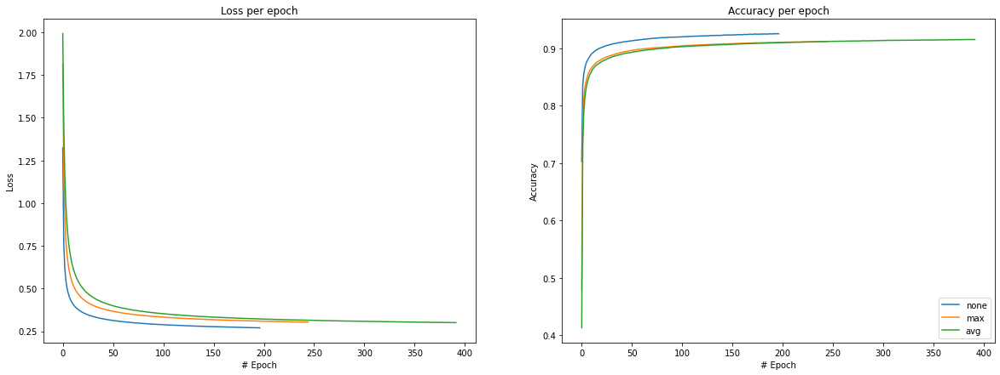

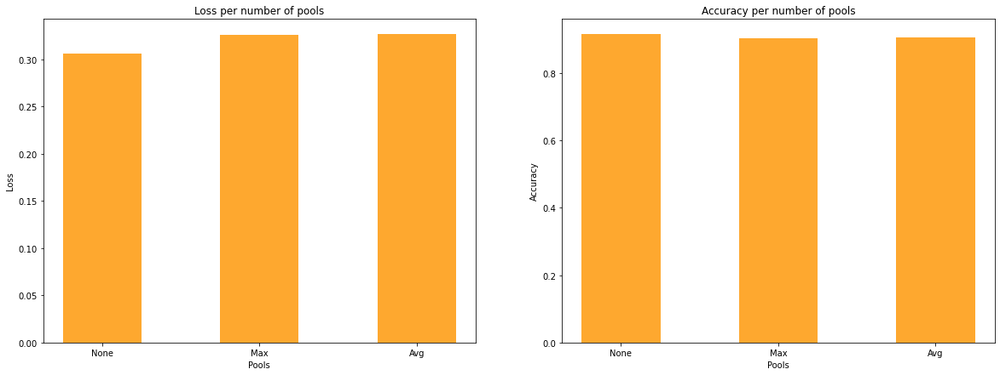

In [15]:
# Evaluation
# Train 
fig, (loss_ax, acc_ax) = plt.subplots(1, 2, figsize=(20,7))

loss_ax.set_title('Loss per epoch')
for i in range(0, len(pools)):
  name = pools[i].name if pools[i] else "none"
  loss_ax.plot(histories[i].history['loss'], label=name)
loss_ax.set(xlabel='# Epoch', ylabel='Loss')

acc_ax.set_title('Accuracy per epoch')
for i in range(0, len(pools)):
  name = pools[i].name if pools[i] else "none"
  acc_ax.plot(histories[i].history['accuracy'], label=name)
acc_ax.set(xlabel='# Epoch', ylabel='Accuracy')

plt.legend(loc=4)
plt.show()


fig, (loss_ax, acc_ax) = plt.subplots(1, 2, figsize=(20,7))

loss_ax.set_title('Loss per number of pools')
loss_ax.bar(["None", "Max", "Avg"], [i[0] for i in test_accuracies], width=0.5, color='#fea82f')
loss_ax.set(xlabel='Pools', ylabel='Loss')

acc_ax.set_title('Accuracy per number of pools')
acc_ax.bar(["None", "Max", "Avg"], [i[1] for i in test_accuracies], width=0.5, color='#fea82f')
acc_ax.set(xlabel='Pools', ylabel='Accuracy')

plt.show()

Finally, we can evaluate each model on the test set, which the model has never "seen".

In [16]:
for pool in pools:
  # Definition
  cur_cnn_model = tf.keras.Sequential(name='cnn_variable_filters_' + str(filter))
  cur_cnn_model.add(tf.keras.layers.Input(mnist_info.features['image'].shape)) # Input
  if pool:
    cur_cnn_model.add(pool)
  cur_cnn_model.add(tf.keras.layers.Flatten(name='flatten'))
  cur_cnn_model.add(tf.keras.layers.Dense(mnist_info.features['label'].num_classes, activation='softmax', name='output')) # Output
  
  cur_cnn_model.compile(loss='sparse_categorical_crossentropy', optimizer='sgd', metrics=['accuracy'])

  name = pool.name if pool else "none"
  cur_cnn_model.load_weights('cnn_variable_pools_' + name + '.h5')

  loss, acc = cur_cnn_model.evaluate(ds_test)
  print('Test accuracy for ' + name + ' pool: {}'.format(acc))

79/79 [==============================] - 0s 586us/step - loss: 0.2765 - accuracy: 0.9224
Test accuracy for none pool: 0.9223999977111816
79/79 [==============================] - 0s 2ms/step - loss: 0.2971 - accuracy: 0.9153
Test accuracy for max pool: 0.9153000116348267
      1/Unknown - 0s 0s/step - loss: 0.2669 - accuracy: 0.9219WARNING:tensorflow:Callbacks method `on_test_batch_end` is slow compared to the batch time (batch time: 0.0000s vs `on_test_batch_end` time: 0.0010s). Check your callbacks.


79/79 [==============================] - 0s 800us/step - loss: 0.2941 - accuracy: 0.9173
Test accuracy for avg pool: 0.9172999858856201


#### Number of Convolutional layers

Unlike the number of filters, each convolutional layer repeats a new conv operation.

"This layer creates a convolution kernel that is convolved with the layer input to produce a tensor of outputs." Keras API Doc

Tested number of layers:
* 1
* 2
* 4
* 8
* 16

In [17]:
nlayers = [
         1,
         2,
         4,
         8
]
#nlayers = [1, 2]
histories = []
test_accuracies = []

for n in nlayers:
  # Definition
  cur_cnn_model = tf.keras.Sequential(name='cnn_variable_nlayers_' + str(n))
  cur_cnn_model.add(tf.keras.layers.Input(mnist_info.features['image'].shape)) # Input
  for i in range(n):
    cur_cnn_model.add(tf.keras.layers.Conv2D(filters=32, kernel_size=4, activation='relu', padding='same', name='convolution' + str(i)))
  cur_cnn_model.add(tf.keras.layers.Flatten(name='flatten'))
  cur_cnn_model.add(tf.keras.layers.Dense(mnist_info.features['label'].num_classes, activation='softmax', name='output')) # Output
  
  cur_cnn_model.compile(loss='sparse_categorical_crossentropy', optimizer='sgd', metrics=['accuracy'])

  # Stopping Callbacks
  earlystop = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=20, verbose=1)
  name = pool.name if pool else "none"
  checkpoint = tf.keras.callbacks.ModelCheckpoint('cnn_variable_nlayers_' + str(n) + '.h5', monitor='val_accuracy', verbose=1, save_best_only=True)

  histories += [cur_cnn_model.fit(ds_train, validation_data=ds_val, callbacks=[earlystop,checkpoint], epochs=no_epochs, batch_size=128)]

  test_accuracies += [cur_cnn_model.evaluate(ds_val)]

Epoch 1/500
    399/Unknown - 6s 14ms/step - loss: 0.7421 - accuracy: 0.8257
Epoch 00001: val_accuracy improved from -inf to 0.88078, saving model to cnn_variable_nlayers_1.h5
399/399 [==============================] - 6s 16ms/step - loss: 0.7421 - accuracy: 0.8257 - val_loss: 0.4112 - val_accuracy: 0.8808
Epoch 2/500
398/399 [============================>.] - ETA: 0s - loss: 0.3536 - accuracy: 0.8987
Epoch 00002: val_accuracy improved from 0.88078 to 0.89011, saving model to cnn_variable_nlayers_1.h5
399/399 [==============================] - 6s 15ms/step - loss: 0.3535 - accuracy: 0.8987 - val_loss: 0.3743 - val_accuracy: 0.8901
Epoch 3/500
395/399 [============================>.] - ETA: 0s - loss: 0.3232 - accuracy: 0.9070
Epoch 00003: val_accuracy improved from 0.89011 to 0.90589, saving model to cnn_variable_nlayers_1.h5
399/399 [==============================] - 6s 15ms/step - loss: 0.3233 - accuracy: 0.9069 - val_loss: 0.3364 - val_accuracy: 0.9059
Epoch 4/500
396/399 [=========

Epoch 27/500
395/399 [============================>.] - ETA: 0s - loss: 0.1192 - accuracy: 0.9686
Epoch 00027: val_accuracy improved from 0.96056 to 0.96211, saving model to cnn_variable_nlayers_1.h5
399/399 [==============================] - 6s 15ms/step - loss: 0.1189 - accuracy: 0.9686 - val_loss: 0.1371 - val_accuracy: 0.9621
Epoch 28/500
398/399 [============================>.] - ETA: 0s - loss: 0.1144 - accuracy: 0.9693
Epoch 00028: val_accuracy improved from 0.96211 to 0.96422, saving model to cnn_variable_nlayers_1.h5
399/399 [==============================] - 6s 15ms/step - loss: 0.1144 - accuracy: 0.9693 - val_loss: 0.1345 - val_accuracy: 0.9642
Epoch 29/500
398/399 [============================>.] - ETA: 0s - loss: 0.1102 - accuracy: 0.9712
Epoch 00029: val_accuracy improved from 0.96422 to 0.96533, saving model to cnn_variable_nlayers_1.h5
399/399 [==============================] - 6s 15ms/step - loss: 0.1102 - accuracy: 0.9712 - val_loss: 0.1273 - val_accuracy: 0.9653
Epoc

Epoch 81/500
394/399 [============================>.] - ETA: 0s - loss: 0.0431 - accuracy: 0.9887
Epoch 00081: val_accuracy did not improve from 0.97889
399/399 [==============================] - 6s 15ms/step - loss: 0.0433 - accuracy: 0.9886 - val_loss: 0.0733 - val_accuracy: 0.9778
Epoch 82/500
398/399 [============================>.] - ETA: 0s - loss: 0.0428 - accuracy: 0.9889 ETA: 0s - loss: 0.0429 - accuracy: 0.98
Epoch 00082: val_accuracy did not improve from 0.97889
399/399 [==============================] - 6s 15ms/step - loss: 0.0428 - accuracy: 0.9889 - val_loss: 0.0729 - val_accuracy: 0.9784
Epoch 83/500
397/399 [============================>.] - ETA: 0s - loss: 0.0426 - accuracy: 0.9888
Epoch 00083: val_accuracy did not improve from 0.97889
399/399 [==============================] - 6s 15ms/step - loss: 0.0425 - accuracy: 0.9888 - val_loss: 0.0743 - val_accuracy: 0.9787
Epoch 84/500
398/399 [============================>.] - ETA: 0s - loss: 0.0420 - accuracy: 0.9889
Epoch 0

Epoch 00109: early stopping
71/71 [==============================] - 0s 5ms/step - loss: 0.0690 - accuracy: 0.9790
Epoch 1/500
    398/Unknown - 36s 91ms/step - loss: 0.6630 - accuracy: 0.8165
Epoch 00001: val_accuracy improved from -inf to 0.87767, saving model to cnn_variable_nlayers_2.h5
399/399 [==============================] - 37s 93ms/step - loss: 0.6625 - accuracy: 0.8167 - val_loss: 0.4061 - val_accuracy: 0.8777
Epoch 2/500
398/399 [============================>.] - ETA: 0s - loss: 0.3493 - accuracy: 0.8963
Epoch 00002: val_accuracy improved from 0.87767 to 0.90178, saving model to cnn_variable_nlayers_2.h5
399/399 [==============================] - 37s 92ms/step - loss: 0.3493 - accuracy: 0.8964 - val_loss: 0.3405 - val_accuracy: 0.9018
Epoch 3/500
398/399 [============================>.] - ETA: 0s - loss: 0.3156 - accuracy: 0.9092
Epoch 00003: val_accuracy did not improve from 0.90178
399/399 [==============================] - 37s 92ms/step - loss: 0.3155 - accuracy: 0.9092 

Epoch 54/500
398/399 [============================>.] - ETA: 0s - loss: 0.0214 - accuracy: 0.9938
Epoch 00054: val_accuracy improved from 0.98244 to 0.98300, saving model to cnn_variable_nlayers_2.h5
399/399 [==============================] - 38s 94ms/step - loss: 0.0213 - accuracy: 0.9938 - val_loss: 0.0663 - val_accuracy: 0.9830
Epoch 55/500
398/399 [============================>.] - ETA: 0s - loss: 0.0210 - accuracy: 0.9941
Epoch 00055: val_accuracy did not improve from 0.98300
399/399 [==============================] - 37s 94ms/step - loss: 0.0209 - accuracy: 0.9941 - val_loss: 0.0666 - val_accuracy: 0.9812
Epoch 56/500
398/399 [============================>.] - ETA: 0s - loss: 0.0204 - accuracy: 0.9941 ETA: 0s - loss: 0.0204 - accura
Epoch 00056: val_accuracy did not improve from 0.98300
399/399 [==============================] - 37s 93ms/step - loss: 0.0204 - accuracy: 0.9941 - val_loss: 0.0654 - val_accuracy: 0.9813
Epoch 57/500
398/399 [============================>.] - ETA: 0s

Epoch 16/500
399/399 [==============================] - ETA: 0s - loss: 0.0306 - accuracy: 0.9904
Epoch 00016: val_accuracy did not improve from 0.98178
399/399 [==============================] - 97s 244ms/step - loss: 0.0306 - accuracy: 0.9904 - val_loss: 0.0819 - val_accuracy: 0.9756
Epoch 17/500
399/399 [==============================] - ETA: 0s - loss: 0.0292 - accuracy: 0.9911
Epoch 00017: val_accuracy did not improve from 0.98178
399/399 [==============================] - 100s 251ms/step - loss: 0.0292 - accuracy: 0.9911 - val_loss: 0.0633 - val_accuracy: 0.9818
Epoch 18/500
399/399 [==============================] - ETA: 0s - loss: 0.0260 - accuracy: 0.9919
Epoch 00018: val_accuracy did not improve from 0.98178
399/399 [==============================] - 103s 258ms/step - loss: 0.0260 - accuracy: 0.9919 - val_loss: 0.0639 - val_accuracy: 0.9813
Epoch 19/500
399/399 [==============================] - ETA: 0s - loss: 0.0260 - accuracy: 0.9920
Epoch 00019: val_accuracy improved from

Epoch 71/500
399/399 [==============================] - ETA: 0s - loss: 2.6519e-04 - accuracy: 1.0000
Epoch 00071: val_accuracy did not improve from 0.98600
399/399 [==============================] - 97s 244ms/step - loss: 2.6519e-04 - accuracy: 1.0000 - val_loss: 0.1078 - val_accuracy: 0.9847
Epoch 72/500
399/399 [==============================] - ETA: 0s - loss: 3.2334e-04 - accuracy: 1.0000
Epoch 00072: val_accuracy did not improve from 0.98600
399/399 [==============================] - 99s 248ms/step - loss: 3.2334e-04 - accuracy: 1.0000 - val_loss: 0.1081 - val_accuracy: 0.9848
Epoch 73/500
399/399 [==============================] - ETA: 0s - loss: 2.2560e-04 - accuracy: 1.0000
Epoch 00073: val_accuracy did not improve from 0.98600
399/399 [==============================] - 98s 246ms/step - loss: 2.2560e-04 - accuracy: 1.0000 - val_loss: 0.1085 - val_accuracy: 0.9844
Epoch 74/500
399/399 [==============================] - ETA: 0s - loss: 2.1113e-04 - accuracy: 1.0000
Epoch 00074: 

Epoch 23/500
399/399 [==============================] - ETA: 0s - loss: 0.0072 - accuracy: 0.9976
Epoch 00023: val_accuracy did not improve from 0.98544
399/399 [==============================] - 237s 594ms/step - loss: 0.0072 - accuracy: 0.9976 - val_loss: 0.0831 - val_accuracy: 0.9839
Epoch 24/500
399/399 [==============================] - ETA: 0s - loss: 0.0045 - accuracy: 0.9985
Epoch 00024: val_accuracy did not improve from 0.98544
399/399 [==============================] - 243s 610ms/step - loss: 0.0045 - accuracy: 0.9985 - val_loss: 0.0813 - val_accuracy: 0.9842
Epoch 25/500
399/399 [==============================] - ETA: 0s - loss: 0.0042 - accuracy: 0.9986
Epoch 00025: val_accuracy did not improve from 0.98544
399/399 [==============================] - 241s 603ms/step - loss: 0.0042 - accuracy: 0.9986 - val_loss: 0.0832 - val_accuracy: 0.9851
Epoch 26/500
399/399 [==============================] - ETA: 0s - loss: 0.0030 - accuracy: 0.9992
Epoch 00026: val_accuracy did not impr

Epoch 51/500
399/399 [==============================] - ETA: 0s - loss: 2.8317e-05 - accuracy: 1.0000
Epoch 00051: val_accuracy did not improve from 0.98622
399/399 [==============================] - 230s 575ms/step - loss: 2.8317e-05 - accuracy: 1.0000 - val_loss: 0.1139 - val_accuracy: 0.9851
Epoch 00051: early stopping
71/71 [==============================] - 5s 71ms/step - loss: 0.1139 - accuracy: 0.9851
Epoch 1/500
     13/Unknown - 15s 1s/step - loss: 2.3026 - accuracy: 0.1004

KeyboardInterrupt: 

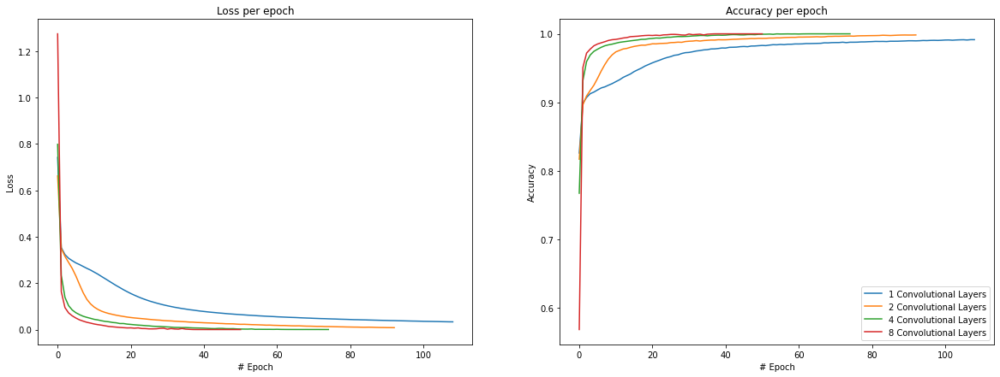

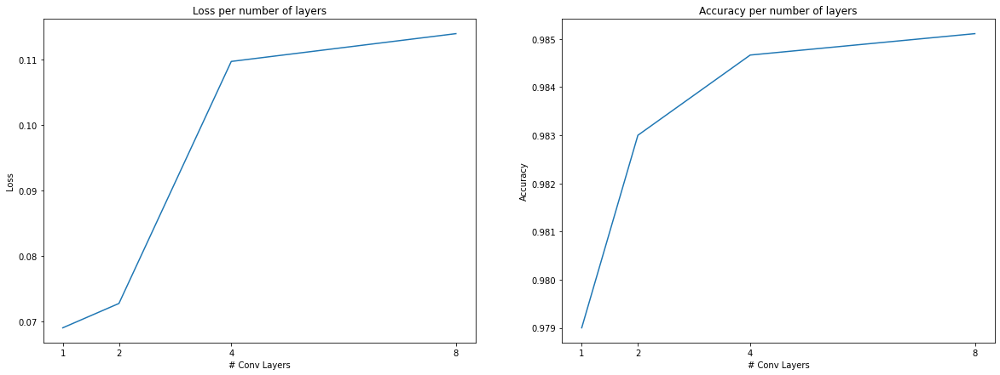

In [20]:
nlayers = [
         1,
         2,
         4,
         8
]
# Evaluation
# Train 
fig, (loss_ax, acc_ax) = plt.subplots(1, 2, figsize=(20,7))

loss_ax.set_title('Loss per epoch')
for i in range(0, len(nlayers)):
  loss_ax.plot(histories[i].history['loss'], label=str(nlayers[i]) + " Convolutional Layers")
loss_ax.set(xlabel='# Epoch', ylabel='Loss')

acc_ax.set_title('Accuracy per epoch')
for i in range(0, len(nlayers)):
  acc_ax.plot(histories[i].history['accuracy'], label=str(nlayers[i]) + " Convolutional Layers")
acc_ax.set(xlabel='# Epoch', ylabel='Accuracy')

plt.legend(loc=4)
plt.show()


fig, (loss_ax, acc_ax) = plt.subplots(1, 2, figsize=(20,7))

loss_ax.set_title('Loss per number of layers')
loss_ax.plot(nlayers, [i[0] for i in test_accuracies])
loss_ax.set(xlabel='# Conv Layers', ylabel='Loss')
loss_ax.set_xticks(nlayers)
loss_ax.tick_params(axis='x', which='minor', bottom=False)

acc_ax.set_title('Accuracy per number of layers')
acc_ax.plot(nlayers, [i[1] for i in test_accuracies])
acc_ax.set(xlabel='# Conv Layers', ylabel='Accuracy')
acc_ax.set_xticks(nlayers)
acc_ax.tick_params(axis='x', which='minor', bottom=False)

plt.show()

Finally, we can evaluate each model on the test set, which the model has never "seen".

In [19]:
for n in nlayers:
  # Definition
  cur_cnn_model = tf.keras.Sequential(name='cnn_variable_filters_' + str(filter))
  cur_cnn_model.add(tf.keras.layers.Input(mnist_info.features['image'].shape)) # Input
  for i in range(n):
    cur_cnn_model.add(tf.keras.layers.Conv2D(filters=32, kernel_size=4, activation='relu', padding='same', name='convolution' + str(i)))
  cur_cnn_model.add(tf.keras.layers.Flatten(name='flatten'))
  cur_cnn_model.add(tf.keras.layers.Dense(mnist_info.features['label'].num_classes, activation='softmax', name='output')) # Output
  
  cur_cnn_model.compile(loss='sparse_categorical_crossentropy', optimizer='sgd', metrics=['accuracy'])

  cur_cnn_model.load_weights('cnn_variable_nlayers_' + str(n) + '.h5')

  loss, acc = cur_cnn_model.evaluate(ds_test)
  print('Test accuracy for ' + str(n) + ' Conv Layers: {}'.format(acc))

79/79 [==============================] - 0s 5ms/step - loss: 0.0562 - accuracy: 0.9836
Test accuracy for 1 Conv Layers: 0.9836000204086304
79/79 [==============================] - 1s 15ms/step - loss: 0.0569 - accuracy: 0.9852
Test accuracy for 2 Conv Layers: 0.9851999878883362
79/79 [==============================] - 3s 33ms/step - loss: 0.0736 - accuracy: 0.9862
Test accuracy for 4 Conv Layers: 0.9861999750137329
79/79 [==============================] - 5s 68ms/step - loss: 0.0674 - accuracy: 0.9874
Test accuracy for 8 Conv Layers: 0.9873999953269958


#### Dense Layer before the output

Studying the impact of having a fully connected layer before the network output

"Dense implements the operation: output = activation(dot(input, kernel) + bias) where activation is the element-wise activation function passed as the activation argument, kernel is a weights matrix created by the layer, and bias is a bias vector created by the layer (only applicable if use_bias is True). These are all attributes of Dense." Keras API Doc

In [13]:
bools = [True, False]
histories = []
test_accuracies = []
no_epochs = 500

for b in bools:
  # Definition
  cur_cnn_model = tf.keras.Sequential(name='cnn_variable_dense_' + str(b))
  cur_cnn_model.add(tf.keras.layers.Input(mnist_info.features['image'].shape)) # Input
  cur_cnn_model.add(tf.keras.layers.Flatten(name='flatten'))
  if b:
    cur_cnn_model.add(tf.keras.layers.Dense(256))
  cur_cnn_model.add(tf.keras.layers.Dense(mnist_info.features['label'].num_classes, activation='softmax', name='output')) # Output
  
  cur_cnn_model.compile(loss='sparse_categorical_crossentropy', optimizer='sgd', metrics=['accuracy'])

  # Stopping Callbacks
  earlystop = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=20, verbose=1)
  checkpoint = tf.keras.callbacks.ModelCheckpoint('cnn_variable_dense_' + str(b) + '.h5', monitor='val_accuracy', verbose=1, save_best_only=True)

  histories += [cur_cnn_model.fit(ds_train, validation_data=ds_val, callbacks=[earlystop,checkpoint], epochs=no_epochs, batch_size=128)]

  test_accuracies += [cur_cnn_model.evaluate(ds_val)]

Epoch 1/500
    376/Unknown - 0s 1ms/step - loss: 0.9760 - accuracy: 0.7705
Epoch 00001: val_accuracy improved from -inf to 0.84633, saving model to cnn_variable_dense_True.h5
399/399 [==============================] - 2s 4ms/step - loss: 0.9550 - accuracy: 0.7751 - val_loss: 0.6051 - val_accuracy: 0.8463
Epoch 2/500
373/399 [===========================>..] - ETA: 0s - loss: 0.5129 - accuracy: 0.8689
Epoch 00002: val_accuracy improved from 0.84633 to 0.86689, saving model to cnn_variable_dense_True.h5
399/399 [==============================] - 1s 1ms/step - loss: 0.5092 - accuracy: 0.8695 - val_loss: 0.4804 - val_accuracy: 0.8669
Epoch 3/500
346/399 [=========================>....] - ETA: 0s - loss: 0.4343 - accuracy: 0.8823
Epoch 00003: val_accuracy improved from 0.86689 to 0.87978, saving model to cnn_variable_dense_True.h5
399/399 [==============================] - 0s 1ms/step - loss: 0.4300 - accuracy: 0.8843 - val_loss: 0.4320 - val_accuracy: 0.8798
Epoch 4/500
392/399 [==========

375/399 [===========================>..] - ETA: 0s - loss: 0.2827 - accuracy: 0.9202
Epoch 00026: val_accuracy improved from 0.91056 to 0.91078, saving model to cnn_variable_dense_True.h5
399/399 [==============================] - 1s 1ms/step - loss: 0.2825 - accuracy: 0.9205 - val_loss: 0.3172 - val_accuracy: 0.9108
Epoch 27/500
389/399 [============================>.] - ETA: 0s - loss: 0.2808 - accuracy: 0.9213
Epoch 00027: val_accuracy did not improve from 0.91078
399/399 [==============================] - 0s 1ms/step - loss: 0.2812 - accuracy: 0.9212 - val_loss: 0.3169 - val_accuracy: 0.9104
Epoch 28/500
394/399 [============================>.] - ETA: 0s - loss: 0.2801 - accuracy: 0.9218
Epoch 00028: val_accuracy did not improve from 0.91078
399/399 [==============================] - 0s 1ms/step - loss: 0.2801 - accuracy: 0.9217 - val_loss: 0.3172 - val_accuracy: 0.9107
Epoch 29/500
383/399 [===========================>..] - ETA: 0s - loss: 0.2795 - accuracy: 0.9220
Epoch 00029: va

366/399 [==========================>...] - ETA: 0s - loss: 0.2652 - accuracy: 0.9259
Epoch 00053: val_accuracy did not improve from 0.91622
399/399 [==============================] - 1s 1ms/step - loss: 0.2629 - accuracy: 0.9265 - val_loss: 0.3054 - val_accuracy: 0.9150
Epoch 54/500
387/399 [============================>.] - ETA: 0s - loss: 0.2618 - accuracy: 0.9269
Epoch 00054: val_accuracy did not improve from 0.91622
399/399 [==============================] - 0s 1ms/step - loss: 0.2624 - accuracy: 0.9267 - val_loss: 0.3057 - val_accuracy: 0.9154
Epoch 55/500
394/399 [============================>.] - ETA: 0s - loss: 0.2623 - accuracy: 0.9270
Epoch 00055: val_accuracy did not improve from 0.91622
399/399 [==============================] - 0s 1ms/step - loss: 0.2620 - accuracy: 0.9270 - val_loss: 0.3058 - val_accuracy: 0.9153
Epoch 56/500
370/399 [==========================>...] - ETA: 0s - loss: 0.2624 - accuracy: 0.9277
Epoch 00056: val_accuracy improved from 0.91622 to 0.91667, sav

360/399 [==========================>...] - ETA: 0s - loss: 0.2532 - accuracy: 0.9300
Epoch 00081: val_accuracy did not improve from 0.91956
399/399 [==============================] - 1s 1ms/step - loss: 0.2531 - accuracy: 0.9296 - val_loss: 0.3015 - val_accuracy: 0.9179
Epoch 82/500
395/399 [============================>.] - ETA: 0s - loss: 0.2533 - accuracy: 0.9299
Epoch 00082: val_accuracy did not improve from 0.91956
399/399 [==============================] - 1s 1ms/step - loss: 0.2530 - accuracy: 0.9299 - val_loss: 0.3005 - val_accuracy: 0.9192
Epoch 83/500
387/399 [============================>.] - ETA: 0s - loss: 0.2523 - accuracy: 0.9300
Epoch 00083: val_accuracy did not improve from 0.91956
399/399 [==============================] - 1s 1ms/step - loss: 0.2527 - accuracy: 0.9299 - val_loss: 0.3013 - val_accuracy: 0.9191
Epoch 84/500
362/399 [==========================>...] - ETA: 0s - loss: 0.2522 - accuracy: 0.9297
Epoch 00084: val_accuracy did not improve from 0.91956
399/399 

Epoch 4/500
319/399 [======================>.......] - ETA: 0s - loss: 0.5572 - accuracy: 0.8635
Epoch 00004: val_accuracy improved from 0.85122 to 0.85900, saving model to cnn_variable_dense_False.h5
399/399 [==============================] - 0s 628us/step - loss: 0.5499 - accuracy: 0.8649 - val_loss: 0.5465 - val_accuracy: 0.8590
Epoch 5/500
399/399 [==============================] - ETA: 0s - loss: 0.5081 - accuracy: 0.8714
Epoch 00005: val_accuracy improved from 0.85900 to 0.86444, saving model to cnn_variable_dense_False.h5
399/399 [==============================] - 0s 664us/step - loss: 0.5081 - accuracy: 0.8714 - val_loss: 0.5134 - val_accuracy: 0.8644
Epoch 6/500
309/399 [======================>.......] - ETA: 0s - loss: 0.4810 - accuracy: 0.8765
Epoch 00006: val_accuracy improved from 0.86444 to 0.86767, saving model to cnn_variable_dense_False.h5
399/399 [==============================] - 0s 639us/step - loss: 0.4795 - accuracy: 0.8766 - val_loss: 0.4900 - val_accuracy: 0.867

Epoch 29/500
307/399 [======================>.......] - ETA: 0s - loss: 0.3374 - accuracy: 0.9068
Epoch 00029: val_accuracy did not improve from 0.89744
399/399 [==============================] - 0s 634us/step - loss: 0.3385 - accuracy: 0.9064 - val_loss: 0.3651 - val_accuracy: 0.8973
Epoch 30/500
382/399 [===========================>..] - ETA: 0s - loss: 0.3362 - accuracy: 0.9070
Epoch 00030: val_accuracy improved from 0.89744 to 0.89822, saving model to cnn_variable_dense_False.h5
399/399 [==============================] - 0s 685us/step - loss: 0.3367 - accuracy: 0.9068 - val_loss: 0.3635 - val_accuracy: 0.8982
Epoch 31/500
300/399 [=====================>........] - ETA: 0s - loss: 0.3326 - accuracy: 0.9085
Epoch 00031: val_accuracy improved from 0.89822 to 0.89889, saving model to cnn_variable_dense_False.h5
399/399 [==============================] - 0s 669us/step - loss: 0.3350 - accuracy: 0.9073 - val_loss: 0.3619 - val_accuracy: 0.8989
Epoch 32/500
303/399 [=====================>

Epoch 00055: val_accuracy improved from 0.90300 to 0.90367, saving model to cnn_variable_dense_False.h5
399/399 [==============================] - 0s 637us/step - loss: 0.3085 - accuracy: 0.9148 - val_loss: 0.3384 - val_accuracy: 0.9037
Epoch 56/500
384/399 [===========================>..] - ETA: 0s - loss: 0.3078 - accuracy: 0.9148
Epoch 00056: val_accuracy did not improve from 0.90367
399/399 [==============================] - 0s 654us/step - loss: 0.3078 - accuracy: 0.9150 - val_loss: 0.3377 - val_accuracy: 0.9037
Epoch 57/500
399/399 [==============================] - ETA: 0s - loss: 0.3070 - accuracy: 0.9152
Epoch 00057: val_accuracy improved from 0.90367 to 0.90456, saving model to cnn_variable_dense_False.h5
399/399 [==============================] - 0s 674us/step - loss: 0.3070 - accuracy: 0.9152 - val_loss: 0.3369 - val_accuracy: 0.9046
Epoch 58/500
389/399 [============================>.] - ETA: 0s - loss: 0.3075 - accuracy: 0.9153
Epoch 00058: val_accuracy did not improve fr

Epoch 82/500
321/399 [=======================>......] - ETA: 0s - loss: 0.2969 - accuracy: 0.9174
Epoch 00082: val_accuracy did not improve from 0.90833
399/399 [==============================] - 0s 609us/step - loss: 0.2938 - accuracy: 0.9185 - val_loss: 0.3259 - val_accuracy: 0.9080
Epoch 83/500
304/399 [=====================>........] - ETA: 0s - loss: 0.2912 - accuracy: 0.9188
Epoch 00083: val_accuracy did not improve from 0.90833
399/399 [==============================] - 0s 644us/step - loss: 0.2934 - accuracy: 0.9186 - val_loss: 0.3256 - val_accuracy: 0.9081
Epoch 84/500
399/399 [==============================] - ETA: 0s - loss: 0.2930 - accuracy: 0.9187
Epoch 00084: val_accuracy improved from 0.90833 to 0.90856, saving model to cnn_variable_dense_False.h5
399/399 [==============================] - 0s 665us/step - loss: 0.2930 - accuracy: 0.9187 - val_loss: 0.3254 - val_accuracy: 0.9086
Epoch 85/500
307/399 [======================>.......] - ETA: 0s - loss: 0.2935 - accuracy: 0.

309/399 [======================>.......] - ETA: 0s - loss: 0.2863 - accuracy: 0.9207
Epoch 00109: val_accuracy did not improve from 0.91067
399/399 [==============================] - 0s 617us/step - loss: 0.2847 - accuracy: 0.9205 - val_loss: 0.3191 - val_accuracy: 0.9102
Epoch 110/500
324/399 [=======================>......] - ETA: 0s - loss: 0.2849 - accuracy: 0.9207
Epoch 00110: val_accuracy improved from 0.91067 to 0.91111, saving model to cnn_variable_dense_False.h5
399/399 [==============================] - 0s 627us/step - loss: 0.2845 - accuracy: 0.9206 - val_loss: 0.3187 - val_accuracy: 0.9111
Epoch 111/500
310/399 [======================>.......] - ETA: 0s - loss: 0.2836 - accuracy: 0.9207
Epoch 00111: val_accuracy did not improve from 0.91111
399/399 [==============================] - 0s 619us/step - loss: 0.2842 - accuracy: 0.9208 - val_loss: 0.3187 - val_accuracy: 0.9108
Epoch 112/500
317/399 [======================>.......] - ETA: 0s - loss: 0.2820 - accuracy: 0.9217
Epoch

319/399 [======================>.......] - ETA: 0s - loss: 0.2756 - accuracy: 0.9231
Epoch 00136: val_accuracy did not improve from 0.91300
399/399 [==============================] - 0s 614us/step - loss: 0.2785 - accuracy: 0.9226 - val_loss: 0.3144 - val_accuracy: 0.9128
Epoch 137/500
314/399 [======================>.......] - ETA: 0s - loss: 0.2783 - accuracy: 0.9222
Epoch 00137: val_accuracy improved from 0.91300 to 0.91322, saving model to cnn_variable_dense_False.h5
399/399 [==============================] - 0s 642us/step - loss: 0.2783 - accuracy: 0.9224 - val_loss: 0.3142 - val_accuracy: 0.9132
Epoch 138/500
309/399 [======================>.......] - ETA: 0s - loss: 0.2727 - accuracy: 0.9235
Epoch 00138: val_accuracy did not improve from 0.91322
399/399 [==============================] - 0s 624us/step - loss: 0.2781 - accuracy: 0.9226 - val_loss: 0.3141 - val_accuracy: 0.9130
Epoch 139/500
314/399 [======================>.......] - ETA: 0s - loss: 0.2786 - accuracy: 0.9220
Epoch

Epoch 164/500
314/399 [======================>.......] - ETA: 0s - loss: 0.2705 - accuracy: 0.9255
Epoch 00164: val_accuracy improved from 0.91433 to 0.91456, saving model to cnn_variable_dense_False.h5
399/399 [==============================] - 0s 634us/step - loss: 0.2735 - accuracy: 0.9239 - val_loss: 0.3111 - val_accuracy: 0.9146
Epoch 165/500
303/399 [=====================>........] - ETA: 0s - loss: 0.2709 - accuracy: 0.9249
Epoch 00165: val_accuracy did not improve from 0.91456
399/399 [==============================] - 0s 624us/step - loss: 0.2734 - accuracy: 0.9240 - val_loss: 0.3113 - val_accuracy: 0.9134
Epoch 166/500
322/399 [=======================>......] - ETA: 0s - loss: 0.2696 - accuracy: 0.9250
Epoch 00166: val_accuracy did not improve from 0.91456
399/399 [==============================] - 0s 604us/step - loss: 0.2733 - accuracy: 0.9238 - val_loss: 0.3110 - val_accuracy: 0.9141
Epoch 167/500
305/399 [=====================>........] - ETA: 0s - loss: 0.2744 - accuracy

308/399 [======================>.......] - ETA: 0s - loss: 0.2707 - accuracy: 0.9248
Epoch 00192: val_accuracy did not improve from 0.91500
399/399 [==============================] - 0s 632us/step - loss: 0.2697 - accuracy: 0.9251 - val_loss: 0.3088 - val_accuracy: 0.9147
Epoch 193/500
392/399 [============================>.] - ETA: 0s - loss: 0.2695 - accuracy: 0.9252
Epoch 00193: val_accuracy did not improve from 0.91500
399/399 [==============================] - 0s 647us/step - loss: 0.2696 - accuracy: 0.9251 - val_loss: 0.3088 - val_accuracy: 0.9148
Epoch 194/500
308/399 [======================>.......] - ETA: 0s - loss: 0.2694 - accuracy: 0.9254
Epoch 00194: val_accuracy improved from 0.91500 to 0.91522, saving model to cnn_variable_dense_False.h5
399/399 [==============================] - 0s 647us/step - loss: 0.2694 - accuracy: 0.9251 - val_loss: 0.3084 - val_accuracy: 0.9152
Epoch 195/500
389/399 [============================>.] - ETA: 0s - loss: 0.2698 - accuracy: 0.9250
Epoch

316/399 [======================>.......] - ETA: 0s - loss: 0.2684 - accuracy: 0.9260
Epoch 00220: val_accuracy did not improve from 0.91589
399/399 [==============================] - 0s 609us/step - loss: 0.2665 - accuracy: 0.9261 - val_loss: 0.3067 - val_accuracy: 0.9157
Epoch 221/500
318/399 [======================>.......] - ETA: 0s - loss: 0.2666 - accuracy: 0.9255
Epoch 00221: val_accuracy did not improve from 0.91589
399/399 [==============================] - 0s 607us/step - loss: 0.2664 - accuracy: 0.9261 - val_loss: 0.3068 - val_accuracy: 0.9159
Epoch 222/500
311/399 [======================>.......] - ETA: 0s - loss: 0.2697 - accuracy: 0.9252
Epoch 00222: val_accuracy did not improve from 0.91589
399/399 [==============================] - 0s 617us/step - loss: 0.2663 - accuracy: 0.9261 - val_loss: 0.3067 - val_accuracy: 0.9157
Epoch 223/500
324/399 [=======================>......] - ETA: 0s - loss: 0.2666 - accuracy: 0.9261
Epoch 00223: val_accuracy improved from 0.91589 to 0.9

Epoch 248/500
398/399 [============================>.] - ETA: 0s - loss: 0.2639 - accuracy: 0.9268
Epoch 00248: val_accuracy did not improve from 0.91700
399/399 [==============================] - 0s 644us/step - loss: 0.2639 - accuracy: 0.9268 - val_loss: 0.3055 - val_accuracy: 0.9167
Epoch 249/500
303/399 [=====================>........] - ETA: 0s - loss: 0.2657 - accuracy: 0.9258
Epoch 00249: val_accuracy improved from 0.91700 to 0.91711, saving model to cnn_variable_dense_False.h5
399/399 [==============================] - 0s 654us/step - loss: 0.2638 - accuracy: 0.9267 - val_loss: 0.3051 - val_accuracy: 0.9171
Epoch 250/500
378/399 [===========================>..] - ETA: 0s - loss: 0.2638 - accuracy: 0.9269
Epoch 00250: val_accuracy did not improve from 0.91711
399/399 [==============================] - 0s 667us/step - loss: 0.2637 - accuracy: 0.9266 - val_loss: 0.3052 - val_accuracy: 0.9169
Epoch 251/500
302/399 [=====================>........] - ETA: 0s - loss: 0.2620 - accuracy

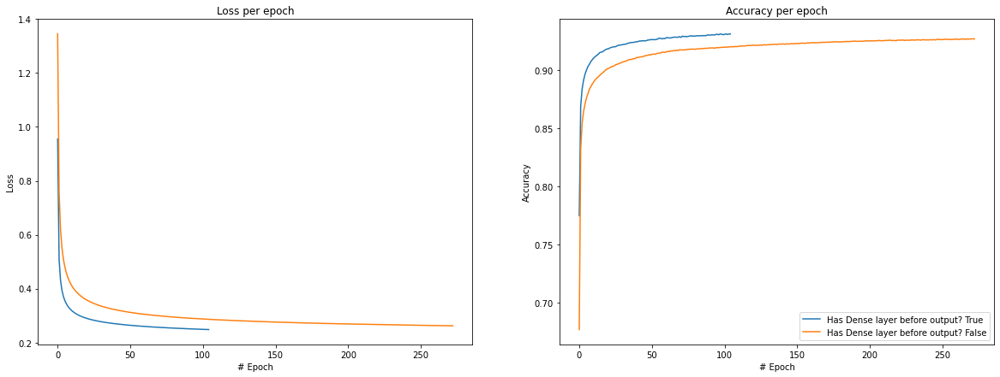

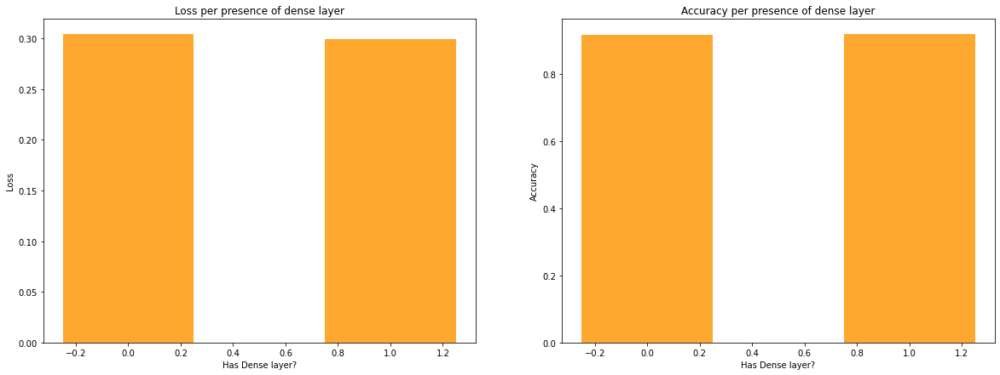

In [14]:
# Evaluation
# Train 
fig, (loss_ax, acc_ax) = plt.subplots(1, 2, figsize=(20,7))

loss_ax.set_title('Loss per epoch')
for i in range(0, len(bools)):
  loss_ax.plot(histories[i].history['loss'], label="Has Dense layer before output? " + str(bools[i]))
loss_ax.set(xlabel='# Epoch', ylabel='Loss')

acc_ax.set_title('Accuracy per epoch')
for i in range(0, len(bools)):
  acc_ax.plot(histories[i].history['accuracy'], label="Has Dense layer before output? " + str(bools[i]))
acc_ax.set(xlabel='# Epoch', ylabel='Accuracy')

plt.legend(loc=4)
plt.show()


fig, (loss_ax, acc_ax) = plt.subplots(1, 2, figsize=(20,7))

loss_ax.set_title('Loss per presence of dense layer')
loss_ax.bar(bools, [i[0] for i in test_accuracies], width=0.5, color='#fea82f')
loss_ax.set(xlabel='Has Dense layer?', ylabel='Loss')

acc_ax.set_title('Accuracy per presence of dense layer')
acc_ax.bar(bools, [i[1] for i in test_accuracies], width=0.5, color='#fea82f')
acc_ax.set(xlabel='Has Dense layer?', ylabel='Accuracy')

plt.show()

Finally, we can evaluate each model on the test set, which the model has never "seen".

In [16]:
for b in bools:
  # Definition
  cur_cnn_model = tf.keras.Sequential(name='cnn_variable_dense_' + str(b))
  cur_cnn_model.add(tf.keras.layers.Input(mnist_info.features['image'].shape)) # Input
  cur_cnn_model.add(tf.keras.layers.Flatten(name='flatten'))
  if b:
    cur_cnn_model.add(tf.keras.layers.Dense(256))
  cur_cnn_model.add(tf.keras.layers.Dense(mnist_info.features['label'].num_classes, activation='softmax', name='output')) # Output
  
  cur_cnn_model.compile(loss='sparse_categorical_crossentropy', optimizer='sgd', metrics=['accuracy'])

  cur_cnn_model.load_weights('cnn_variable_dense_' + str(b) + '.h5')

  loss, acc = cur_cnn_model.evaluate(ds_test)
  print('Test accuracy for Dense=' + str(b) + ': {}'.format(acc))

79/79 [==============================] - 0s 5ms/step - loss: 0.2702 - accuracy: 0.9245
Test accuracy for Dense=True: 0.9244999885559082
79/79 [==============================] - 0s 456us/step - loss: 0.2726 - accuracy: 0.9224
Test accuracy for Dense=False: 0.9223999977111816


#### Dropout

In this scenario, we will be applying regularization to the weights, as well as a different approach to regularization: dropout. The idea behind dropout is to disable a percentage of randomly selected neurons during each step of the training phase, in order to avoid overfitting. In [Keras](https://www.tensorflow.org/api_docs/python/tf/keras), we can apply dropout directly to some layers by defining the corresponding parameters, or by using the [Dropout](https://www.tensorflow.org/api_docs/python/tf/keras/layers/Dropout) layer and stating the percentage of neurons to disable. We will be evaluating the difference between having no dropout, a dropout rate of 0.25 and a dropout of rate of 0.5.

In [17]:
dropout = [0, 0.25, 0.5]
histories = []
test_accuracies = []

for d in dropout:
  # Definition
  cur_cnn_model = tf.keras.Sequential(name='cnn_variable_dropout_' + str(d))
  cur_cnn_model.add(tf.keras.layers.Input(mnist_info.features['image'].shape)) # Input
  cur_cnn_model.add(tf.keras.layers.Conv2D(filters=32, kernel_size=4, activation='relu', padding='same', name='convolution' + str(i)))
  cur_cnn_model.add(tf.keras.layers.Flatten(name='flatten'))
  cur_cnn_model.add(tf.keras.layers.Dropout(d, name='dropout'))
  cur_cnn_model.add(tf.keras.layers.Dense(mnist_info.features['label'].num_classes, activation='softmax', name='output')) # Output
  
  cur_cnn_model.compile(loss='sparse_categorical_crossentropy', optimizer='sgd', metrics=['accuracy'])

  # Stopping Callbacks
  earlystop = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=20, verbose=1)
  checkpoint = tf.keras.callbacks.ModelCheckpoint('cnn_variable_dropout_' + str(d) + '.h5', monitor='val_accuracy', verbose=1, save_best_only=True)

  histories += [cur_cnn_model.fit(ds_train, validation_data=ds_val, callbacks=[earlystop,checkpoint], epochs=no_epochs, batch_size=128)]

  test_accuracies += [cur_cnn_model.evaluate(ds_val)]

Epoch 1/500
    397/Unknown - 12s 30ms/step - loss: 0.7097 - accuracy: 0.8295
Epoch 00001: val_accuracy improved from -inf to 0.88267, saving model to cnn_variable_dropout_0.h5
399/399 [==============================] - 13s 31ms/step - loss: 0.7084 - accuracy: 0.8298 - val_loss: 0.4059 - val_accuracy: 0.8827
Epoch 2/500
397/399 [============================>.] - ETA: 0s - loss: 0.3506 - accuracy: 0.8997
Epoch 00002: val_accuracy improved from 0.88267 to 0.89656, saving model to cnn_variable_dropout_0.h5
399/399 [==============================] - 13s 32ms/step - loss: 0.3509 - accuracy: 0.8996 - val_loss: 0.3590 - val_accuracy: 0.8966
Epoch 3/500
397/399 [============================>.] - ETA: 0s - loss: 0.3208 - accuracy: 0.9073
Epoch 00003: val_accuracy improved from 0.89656 to 0.90111, saving model to cnn_variable_dropout_0.h5
399/399 [==============================] - 13s 32ms/step - loss: 0.3211 - accuracy: 0.9072 - val_loss: 0.3397 - val_accuracy: 0.9011
Epoch 4/500
398/399 [=====

Epoch 26/500
397/399 [============================>.] - ETA: 0s - loss: 0.1271 - accuracy: 0.9661
Epoch 00026: val_accuracy improved from 0.95911 to 0.95956, saving model to cnn_variable_dropout_0.h5
399/399 [==============================] - 13s 32ms/step - loss: 0.1271 - accuracy: 0.9661 - val_loss: 0.1468 - val_accuracy: 0.9596
Epoch 27/500
399/399 [==============================] - ETA: 0s - loss: 0.1223 - accuracy: 0.9675
Epoch 00027: val_accuracy improved from 0.95956 to 0.96211, saving model to cnn_variable_dropout_0.h5
399/399 [==============================] - 13s 33ms/step - loss: 0.1223 - accuracy: 0.9675 - val_loss: 0.1424 - val_accuracy: 0.9621
Epoch 28/500
397/399 [============================>.] - ETA: 0s - loss: 0.1179 - accuracy: 0.9688
Epoch 00028: val_accuracy did not improve from 0.96211
399/399 [==============================] - 13s 32ms/step - loss: 0.1178 - accuracy: 0.9688 - val_loss: 0.1408 - val_accuracy: 0.9604
Epoch 29/500
397/399 [==========================

Epoch 52/500
397/399 [============================>.] - ETA: 0s - loss: 0.0653 - accuracy: 0.9826
Epoch 00052: val_accuracy did not improve from 0.97422
399/399 [==============================] - 13s 32ms/step - loss: 0.0654 - accuracy: 0.9826 - val_loss: 0.0897 - val_accuracy: 0.9740
Epoch 53/500
397/399 [============================>.] - ETA: 0s - loss: 0.0644 - accuracy: 0.9825
Epoch 00053: val_accuracy did not improve from 0.97422
399/399 [==============================] - 13s 32ms/step - loss: 0.0643 - accuracy: 0.9825 - val_loss: 0.0885 - val_accuracy: 0.9739
Epoch 54/500
397/399 [============================>.] - ETA: 0s - loss: 0.0632 - accuracy: 0.9836
Epoch 00054: val_accuracy did not improve from 0.97422
399/399 [==============================] - 13s 32ms/step - loss: 0.0631 - accuracy: 0.9836 - val_loss: 0.0885 - val_accuracy: 0.9734
Epoch 55/500
397/399 [============================>.] - ETA: 0s - loss: 0.0620 - accuracy: 0.9833 ETA: 0s - loss: 0.0622 - ac
Epoch 00055: val

Epoch 80/500
398/399 [============================>.] - ETA: 0s - loss: 0.0449 - accuracy: 0.9878
Epoch 00080: val_accuracy did not improve from 0.97733
399/399 [==============================] - 13s 32ms/step - loss: 0.0449 - accuracy: 0.9878 - val_loss: 0.0754 - val_accuracy: 0.9771
Epoch 81/500
399/399 [==============================] - ETA: 0s - loss: 0.0443 - accuracy: 0.9882
Epoch 00081: val_accuracy did not improve from 0.97733
399/399 [==============================] - 13s 32ms/step - loss: 0.0443 - accuracy: 0.9882 - val_loss: 0.0762 - val_accuracy: 0.9769
Epoch 82/500
397/399 [============================>.] - ETA: 0s - loss: 0.0440 - accuracy: 0.9885
Epoch 00082: val_accuracy improved from 0.97733 to 0.97778, saving model to cnn_variable_dropout_0.h5
399/399 [==============================] - 13s 32ms/step - loss: 0.0440 - accuracy: 0.9885 - val_loss: 0.0749 - val_accuracy: 0.9778
Epoch 83/500
397/399 [============================>.] - ETA: 0s - loss: 0.0435 - accuracy: 0.98

398/399 [============================>.] - ETA: 0s - loss: 0.0347 - accuracy: 0.9907
Epoch 00107: val_accuracy improved from 0.97867 to 0.97922, saving model to cnn_variable_dropout_0.h5
399/399 [==============================] - 13s 33ms/step - loss: 0.0347 - accuracy: 0.9907 - val_loss: 0.0697 - val_accuracy: 0.9792
Epoch 108/500
398/399 [============================>.] - ETA: 0s - loss: 0.0344 - accuracy: 0.9910 ETA: 0s - loss: 0.0344 - accuracy: 
Epoch 00108: val_accuracy improved from 0.97922 to 0.97933, saving model to cnn_variable_dropout_0.h5
399/399 [==============================] - 13s 33ms/step - loss: 0.0344 - accuracy: 0.9911 - val_loss: 0.0691 - val_accuracy: 0.9793
Epoch 109/500
398/399 [============================>.] - ETA: 0s - loss: 0.0341 - accuracy: 0.9910
Epoch 00109: val_accuracy did not improve from 0.97933
399/399 [==============================] - 14s 35ms/step - loss: 0.0340 - accuracy: 0.9910 - val_loss: 0.0711 - val_accuracy: 0.9786
Epoch 110/500
397/399 [

Epoch 135/500
398/399 [============================>.] - ETA: 0s - loss: 0.0277 - accuracy: 0.9930
Epoch 00135: val_accuracy did not improve from 0.97967
399/399 [==============================] - 13s 32ms/step - loss: 0.0278 - accuracy: 0.9930 - val_loss: 0.0695 - val_accuracy: 0.9791
Epoch 136/500
397/399 [============================>.] - ETA: 0s - loss: 0.0276 - accuracy: 0.9932
Epoch 00136: val_accuracy did not improve from 0.97967
399/399 [==============================] - 13s 32ms/step - loss: 0.0275 - accuracy: 0.9933 - val_loss: 0.0679 - val_accuracy: 0.9791
Epoch 137/500
399/399 [==============================] - ETA: 0s - loss: 0.0274 - accuracy: 0.9932
Epoch 00137: val_accuracy did not improve from 0.97967
399/399 [==============================] - 13s 32ms/step - loss: 0.0274 - accuracy: 0.9932 - val_loss: 0.0681 - val_accuracy: 0.9793
Epoch 138/500
397/399 [============================>.] - ETA: 0s - loss: 0.0272 - accuracy: 0.9933
Epoch 00138: val_accuracy did not improv

Epoch 163/500
397/399 [============================>.] - ETA: 0s - loss: 0.0228 - accuracy: 0.9948
Epoch 00163: val_accuracy did not improve from 0.98022
399/399 [==============================] - 13s 31ms/step - loss: 0.0228 - accuracy: 0.9948 - val_loss: 0.0672 - val_accuracy: 0.9793
Epoch 164/500
397/399 [============================>.] - ETA: 0s - loss: 0.0226 - accuracy: 0.9946
Epoch 00164: val_accuracy did not improve from 0.98022
399/399 [==============================] - 13s 31ms/step - loss: 0.0227 - accuracy: 0.9946 - val_loss: 0.0673 - val_accuracy: 0.9794
Epoch 165/500
397/399 [============================>.] - ETA: 0s - loss: 0.0226 - accuracy: 0.9946
Epoch 00165: val_accuracy did not improve from 0.98022
399/399 [==============================] - 13s 31ms/step - loss: 0.0226 - accuracy: 0.9946 - val_loss: 0.0668 - val_accuracy: 0.9796
Epoch 166/500
397/399 [============================>.] - ETA: 0s - loss: 0.0223 - accuracy: 0.9948
Epoch 00166: val_accuracy did not improv

Epoch 2/500
399/399 [==============================] - ETA: 0s - loss: 0.3650 - accuracy: 0.8943
Epoch 00002: val_accuracy improved from 0.87878 to 0.89722, saving model to cnn_variable_dropout_0.25.h5
399/399 [==============================] - 13s 32ms/step - loss: 0.3650 - accuracy: 0.8943 - val_loss: 0.3599 - val_accuracy: 0.8972
Epoch 3/500
397/399 [============================>.] - ETA: 0s - loss: 0.3356 - accuracy: 0.9036
Epoch 00003: val_accuracy improved from 0.89722 to 0.90111, saving model to cnn_variable_dropout_0.25.h5
399/399 [==============================] - 13s 33ms/step - loss: 0.3355 - accuracy: 0.9036 - val_loss: 0.3476 - val_accuracy: 0.9011
Epoch 4/500
397/399 [============================>.] - ETA: 0s - loss: 0.3175 - accuracy: 0.9077
Epoch 00004: val_accuracy improved from 0.90111 to 0.90378, saving model to cnn_variable_dropout_0.25.h5
399/399 [==============================] - 13s 32ms/step - loss: 0.3174 - accuracy: 0.9077 - val_loss: 0.3290 - val_accuracy: 0.

Epoch 27/500
397/399 [============================>.] - ETA: 0s - loss: 0.1243 - accuracy: 0.9656 ETA: 0s - loss: 0.1238 
Epoch 00027: val_accuracy improved from 0.96033 to 0.96178, saving model to cnn_variable_dropout_0.25.h5
399/399 [==============================] - 13s 32ms/step - loss: 0.1245 - accuracy: 0.9654 - val_loss: 0.1362 - val_accuracy: 0.9618
Epoch 28/500
397/399 [============================>.] - ETA: 0s - loss: 0.1198 - accuracy: 0.9675
Epoch 00028: val_accuracy did not improve from 0.96178
399/399 [==============================] - 13s 32ms/step - loss: 0.1198 - accuracy: 0.9675 - val_loss: 0.1344 - val_accuracy: 0.9612
Epoch 29/500
397/399 [============================>.] - ETA: 0s - loss: 0.1156 - accuracy: 0.9686
Epoch 00029: val_accuracy improved from 0.96178 to 0.96544, saving model to cnn_variable_dropout_0.25.h5
399/399 [==============================] - 13s 32ms/step - loss: 0.1155 - accuracy: 0.9685 - val_loss: 0.1279 - val_accuracy: 0.9654
Epoch 30/500
399/3

397/399 [============================>.] - ETA: 0s - loss: 0.0707 - accuracy: 0.9798 ETA: 2s
Epoch 00053: val_accuracy did not improve from 0.97456
399/399 [==============================] - 13s 32ms/step - loss: 0.0707 - accuracy: 0.9798 - val_loss: 0.0865 - val_accuracy: 0.9744
Epoch 54/500
397/399 [============================>.] - ETA: 0s - loss: 0.0692 - accuracy: 0.9808
Epoch 00054: val_accuracy improved from 0.97456 to 0.97567, saving model to cnn_variable_dropout_0.25.h5
399/399 [==============================] - 13s 33ms/step - loss: 0.0692 - accuracy: 0.9808 - val_loss: 0.0852 - val_accuracy: 0.9757
Epoch 55/500
399/399 [==============================] - ETA: 0s - loss: 0.0678 - accuracy: 0.9810
Epoch 00055: val_accuracy did not improve from 0.97567
399/399 [==============================] - 13s 31ms/step - loss: 0.0678 - accuracy: 0.9810 - val_loss: 0.0850 - val_accuracy: 0.9749
Epoch 56/500
397/399 [============================>.] - ETA: 0s - loss: 0.0669 - accuracy: 0.9813

Epoch 80/500
398/399 [============================>.] - ETA: 0s - loss: 0.0521 - accuracy: 0.9852 ETA:  - ETA: 0s - loss: 0.0521 - accuracy: 
Epoch 00080: val_accuracy did not improve from 0.97844
399/399 [==============================] - 13s 33ms/step - loss: 0.0520 - accuracy: 0.9853 - val_loss: 0.0733 - val_accuracy: 0.9776
Epoch 81/500
397/399 [============================>.] - ETA: 0s - loss: 0.0520 - accuracy: 0.9846
Epoch 00081: val_accuracy did not improve from 0.97844
399/399 [==============================] - 12s 31ms/step - loss: 0.0519 - accuracy: 0.9846 - val_loss: 0.0731 - val_accuracy: 0.9776
Epoch 82/500
399/399 [==============================] - ETA: 0s - loss: 0.0511 - accuracy: 0.9856
Epoch 00082: val_accuracy did not improve from 0.97844
399/399 [==============================] - 13s 32ms/step - loss: 0.0511 - accuracy: 0.9856 - val_loss: 0.0728 - val_accuracy: 0.9781
Epoch 83/500
399/399 [==============================] - ETA: 0s - loss: 0.0509 - accuracy: 0.9856


Epoch 108/500
398/399 [============================>.] - ETA: 0s - loss: 0.0416 - accuracy: 0.9880
Epoch 00108: val_accuracy did not improve from 0.98033
399/399 [==============================] - 13s 33ms/step - loss: 0.0416 - accuracy: 0.9880 - val_loss: 0.0672 - val_accuracy: 0.9798
Epoch 109/500
399/399 [==============================] - ETA: 0s - loss: 0.0413 - accuracy: 0.9875
Epoch 00109: val_accuracy did not improve from 0.98033
399/399 [==============================] - 13s 33ms/step - loss: 0.0413 - accuracy: 0.9875 - val_loss: 0.0671 - val_accuracy: 0.9801
Epoch 110/500
399/399 [==============================] - ETA: 0s - loss: 0.0413 - accuracy: 0.9884
Epoch 00110: val_accuracy did not improve from 0.98033
399/399 [==============================] - 13s 32ms/step - loss: 0.0413 - accuracy: 0.9884 - val_loss: 0.0676 - val_accuracy: 0.9791
Epoch 111/500
397/399 [============================>.] - ETA: 0s - loss: 0.0408 - accuracy: 0.9881
Epoch 00111: val_accuracy did not improv

398/399 [============================>.] - ETA: 0s - loss: 0.0346 - accuracy: 0.9899
Epoch 00136: val_accuracy did not improve from 0.98133
399/399 [==============================] - 13s 32ms/step - loss: 0.0347 - accuracy: 0.9898 - val_loss: 0.0650 - val_accuracy: 0.9799
Epoch 137/500
397/399 [============================>.] - ETA: 0s - loss: 0.0354 - accuracy: 0.9896
Epoch 00137: val_accuracy did not improve from 0.98133
399/399 [==============================] - 13s 32ms/step - loss: 0.0353 - accuracy: 0.9897 - val_loss: 0.0640 - val_accuracy: 0.9810
Epoch 138/500
397/399 [============================>.] - ETA: 0s - loss: 0.0341 - accuracy: 0.9903
Epoch 00138: val_accuracy did not improve from 0.98133
399/399 [==============================] - 13s 32ms/step - loss: 0.0341 - accuracy: 0.9903 - val_loss: 0.0641 - val_accuracy: 0.9802
Epoch 139/500
399/399 [==============================] - ETA: 0s - loss: 0.0342 - accuracy: 0.9905
Epoch 00139: val_accuracy did not improve from 0.98133

397/399 [============================>.] - ETA: 0s - loss: 0.0293 - accuracy: 0.9916 ETA: 0s - loss: 0.0295 - accu
Epoch 00164: val_accuracy did not improve from 0.98167
399/399 [==============================] - 13s 32ms/step - loss: 0.0293 - accuracy: 0.9916 - val_loss: 0.0619 - val_accuracy: 0.9802
Epoch 165/500
397/399 [============================>.] - ETA: 0s - loss: 0.0301 - accuracy: 0.99 - ETA: 0s - loss: 0.0300 - accuracy: 0.9911
Epoch 00165: val_accuracy did not improve from 0.98167
399/399 [==============================] - 13s 32ms/step - loss: 0.0299 - accuracy: 0.9911 - val_loss: 0.0628 - val_accuracy: 0.9811
Epoch 166/500
399/399 [==============================] - ETA: 0s - loss: 0.0302 - accuracy: 0.9912
Epoch 00166: val_accuracy did not improve from 0.98167
399/399 [==============================] - 13s 32ms/step - loss: 0.0302 - accuracy: 0.9912 - val_loss: 0.0633 - val_accuracy: 0.9808
Epoch 00166: early stopping
71/71 [==============================] - 0s 5ms/step 

Epoch 23/500
399/399 [==============================] - ETA: 0s - loss: 0.1398 - accuracy: 0.9612
Epoch 00023: val_accuracy improved from 0.95889 to 0.96022, saving model to cnn_variable_dropout_0.5.h5
399/399 [==============================] - 13s 32ms/step - loss: 0.1398 - accuracy: 0.9612 - val_loss: 0.1440 - val_accuracy: 0.9602
Epoch 24/500
399/399 [==============================] - ETA: 0s - loss: 0.1355 - accuracy: 0.9617
Epoch 00024: val_accuracy improved from 0.96022 to 0.96089, saving model to cnn_variable_dropout_0.5.h5
399/399 [==============================] - 13s 32ms/step - loss: 0.1355 - accuracy: 0.9617 - val_loss: 0.1396 - val_accuracy: 0.9609
Epoch 25/500
397/399 [============================>.] - ETA: 0s - loss: 0.1313 - accuracy: 0.9636
Epoch 00025: val_accuracy improved from 0.96089 to 0.96189, saving model to cnn_variable_dropout_0.5.h5
399/399 [==============================] - 13s 33ms/step - loss: 0.1312 - accuracy: 0.9636 - val_loss: 0.1374 - val_accuracy: 0.

Epoch 48/500
397/399 [============================>.] - ETA: 0s - loss: 0.0816 - accuracy: 0.9767
Epoch 00048: val_accuracy did not improve from 0.97433
399/399 [==============================] - 13s 33ms/step - loss: 0.0817 - accuracy: 0.9766 - val_loss: 0.0908 - val_accuracy: 0.9734
Epoch 49/500
397/399 [============================>.] - ETA: 0s - loss: 0.0804 - accuracy: 0.9769
Epoch 00049: val_accuracy improved from 0.97433 to 0.97456, saving model to cnn_variable_dropout_0.5.h5
399/399 [==============================] - 13s 34ms/step - loss: 0.0805 - accuracy: 0.9768 - val_loss: 0.0895 - val_accuracy: 0.9746
Epoch 50/500
397/399 [============================>.] - ETA: 0s - loss: 0.0796 - accuracy: 0.9766
Epoch 00050: val_accuracy improved from 0.97456 to 0.97478, saving model to cnn_variable_dropout_0.5.h5
399/399 [==============================] - 13s 33ms/step - loss: 0.0797 - accuracy: 0.9766 - val_loss: 0.0883 - val_accuracy: 0.9748
Epoch 51/500
399/399 [======================

Epoch 75/500
399/399 [==============================] - ETA: 0s - loss: 0.0628 - accuracy: 0.9821
Epoch 00075: val_accuracy did not improve from 0.97833
399/399 [==============================] - 15s 38ms/step - loss: 0.0628 - accuracy: 0.9821 - val_loss: 0.0765 - val_accuracy: 0.9776
Epoch 76/500
399/399 [==============================] - ETA: 0s - loss: 0.0618 - accuracy: 0.9819
Epoch 00076: val_accuracy improved from 0.97833 to 0.97844, saving model to cnn_variable_dropout_0.5.h5
399/399 [==============================] - 15s 37ms/step - loss: 0.0618 - accuracy: 0.9819 - val_loss: 0.0750 - val_accuracy: 0.9784
Epoch 77/500
399/399 [==============================] - ETA: 0s - loss: 0.0619 - accuracy: 0.9821
Epoch 00077: val_accuracy did not improve from 0.97844
399/399 [==============================] - 14s 34ms/step - loss: 0.0619 - accuracy: 0.9821 - val_loss: 0.0757 - val_accuracy: 0.9778
Epoch 78/500
399/399 [==============================] - ETA: 0s - loss: 0.0609 - accuracy: 0.

Epoch 103/500
399/399 [==============================] - ETA: 0s - loss: 0.0525 - accuracy: 0.9845
Epoch 00103: val_accuracy improved from 0.97967 to 0.97989, saving model to cnn_variable_dropout_0.5.h5
399/399 [==============================] - 17s 43ms/step - loss: 0.0525 - accuracy: 0.9845 - val_loss: 0.0693 - val_accuracy: 0.9799
Epoch 104/500
397/399 [============================>.] - ETA: 0s - loss: 0.0506 - accuracy: 0.9851
Epoch 00104: val_accuracy did not improve from 0.97989
399/399 [==============================] - 13s 34ms/step - loss: 0.0506 - accuracy: 0.9851 - val_loss: 0.0691 - val_accuracy: 0.9793
Epoch 105/500
397/399 [============================>.] - ETA: 0s - loss: 0.0519 - accuracy: 0.9847
Epoch 00105: val_accuracy did not improve from 0.97989
399/399 [==============================] - 13s 32ms/step - loss: 0.0519 - accuracy: 0.9846 - val_loss: 0.0696 - val_accuracy: 0.9787
Epoch 106/500
397/399 [============================>.] - ETA: 0s - loss: 0.0505 - accuracy

Epoch 131/500
398/399 [============================>.] - ETA: 0s - loss: 0.0456 - accuracy: 0.9861
Epoch 00131: val_accuracy did not improve from 0.98144
399/399 [==============================] - 13s 33ms/step - loss: 0.0456 - accuracy: 0.9861 - val_loss: 0.0662 - val_accuracy: 0.9807
Epoch 132/500
397/399 [============================>.] - ETA: 0s - loss: 0.0456 - accuracy: 0.9863
Epoch 00132: val_accuracy did not improve from 0.98144
399/399 [==============================] - 13s 33ms/step - loss: 0.0455 - accuracy: 0.9863 - val_loss: 0.0651 - val_accuracy: 0.9811
Epoch 133/500
399/399 [==============================] - ETA: 0s - loss: 0.0458 - accuracy: 0.9857
Epoch 00133: val_accuracy did not improve from 0.98144
399/399 [==============================] - 13s 32ms/step - loss: 0.0458 - accuracy: 0.9857 - val_loss: 0.0653 - val_accuracy: 0.9810
Epoch 134/500
397/399 [============================>.] - ETA: 0s - loss: 0.0456 - accuracy: 0.9863
Epoch 00134: val_accuracy did not improv

397/399 [============================>.] - ETA: 0s - loss: 0.0405 - accuracy: 0.9874
Epoch 00159: val_accuracy improved from 0.98200 to 0.98211, saving model to cnn_variable_dropout_0.5.h5
399/399 [==============================] - 13s 32ms/step - loss: 0.0404 - accuracy: 0.9875 - val_loss: 0.0631 - val_accuracy: 0.9821
Epoch 160/500
397/399 [============================>.] - ETA: 0s - loss: 0.0408 - accuracy: 0.9875
Epoch 00160: val_accuracy did not improve from 0.98211
399/399 [==============================] - 13s 31ms/step - loss: 0.0408 - accuracy: 0.9875 - val_loss: 0.0631 - val_accuracy: 0.9818
Epoch 161/500
397/399 [============================>.] - ETA: 0s - loss: 0.0407 - accuracy: 0.9876
Epoch 00161: val_accuracy did not improve from 0.98211
399/399 [==============================] - 13s 32ms/step - loss: 0.0406 - accuracy: 0.9876 - val_loss: 0.0631 - val_accuracy: 0.9812
Epoch 162/500
397/399 [============================>.] - ETA: 0s - loss: 0.0399 - accuracy: 0.9883
Epoch

Epoch 187/500
397/399 [============================>.] - ETA: 0s - loss: 0.0371 - accuracy: 0.9883
Epoch 00187: val_accuracy did not improve from 0.98233
399/399 [==============================] - 13s 32ms/step - loss: 0.0372 - accuracy: 0.9883 - val_loss: 0.0613 - val_accuracy: 0.9822
Epoch 188/500
397/399 [============================>.] - ETA: 0s - loss: 0.0370 - accuracy: 0.9890
Epoch 00188: val_accuracy did not improve from 0.98233
399/399 [==============================] - 12s 31ms/step - loss: 0.0369 - accuracy: 0.9890 - val_loss: 0.0610 - val_accuracy: 0.9818
Epoch 189/500
397/399 [============================>.] - ETA: 0s - loss: 0.0354 - accuracy: 0.9894
Epoch 00189: val_accuracy did not improve from 0.98233
399/399 [==============================] - 13s 31ms/step - loss: 0.0355 - accuracy: 0.9894 - val_loss: 0.0622 - val_accuracy: 0.9818
Epoch 190/500
397/399 [============================>.] - ETA: 0s - loss: 0.0362 - accuracy: 0.9894
Epoch 00190: val_accuracy did not improv

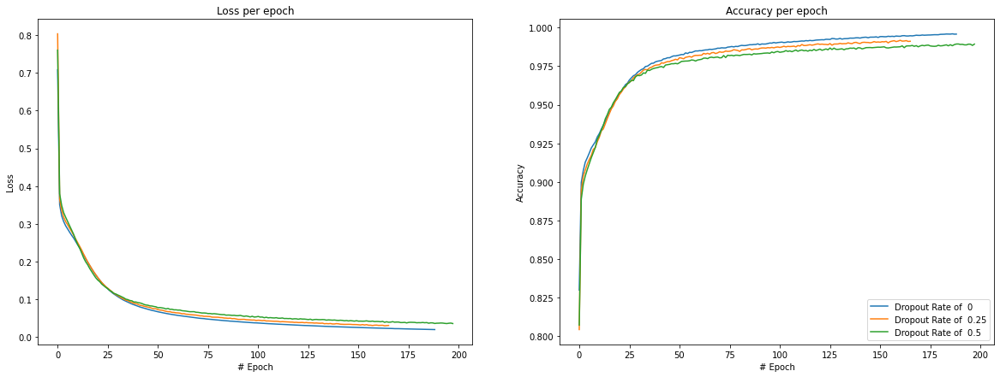

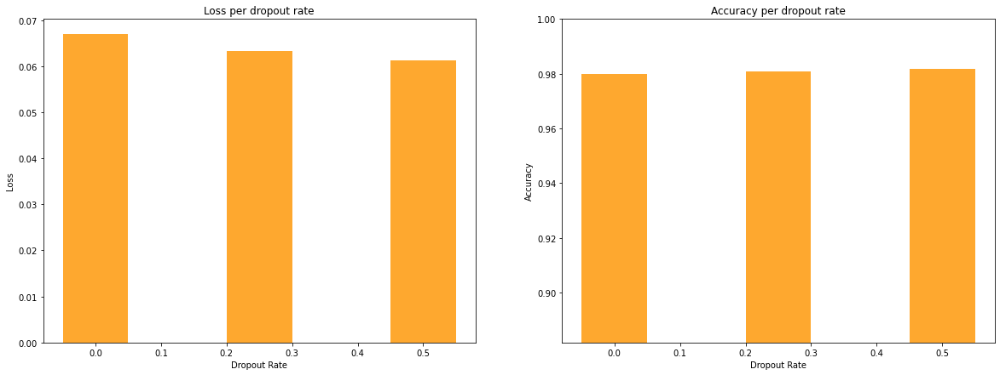

In [20]:
# Evaluation
# Train 
fig, (loss_ax, acc_ax) = plt.subplots(1, 2, figsize=(20,7))

loss_ax.set_title('Loss per epoch')
for i in range(0, len(dropout)):
  loss_ax.plot(histories[i].history['loss'], label="Dropout Rate of  " + str(dropout[i]))
loss_ax.set(xlabel='# Epoch', ylabel='Loss')

acc_ax.set_title('Accuracy per epoch')
for i in range(0, len(dropout)):
  acc_ax.plot(histories[i].history['accuracy'], label="Dropout Rate of  " + str(dropout[i]))
acc_ax.set(xlabel='# Epoch', ylabel='Accuracy')

plt.legend(loc=4)
plt.show()


fig, (loss_ax, acc_ax) = plt.subplots(1, 2, figsize=(20,7))

loss_ax.set_title('Loss per dropout rate')
loss_ax.bar(dropout, [i[0] for i in test_accuracies], width=0.1, color='#fea82f')
loss_ax.set(xlabel='Dropout Rate', ylabel='Loss')

acc_ax.set_title('Accuracy per dropout rate')
acc_ax.bar(dropout, [i[1] for i in test_accuracies], width=0.1, color='#fea82f')
acc_ax.set(xlabel='Dropout Rate', ylabel='Accuracy')
acc_ax.set_ylim([0.9 * min([i[1] for i in test_accuracies]), 1])

plt.show()

Finally, we can evaluate each model on the test set, which the model has never "seen".

In [19]:
for d in dropout:
  # Definition
  cur_cnn_model = tf.keras.Sequential(name='cnn_variable_dropout_' + str(d))
  cur_cnn_model.add(tf.keras.layers.Input(mnist_info.features['image'].shape)) # Input
  cur_cnn_model.add(tf.keras.layers.Conv2D(filters=32, kernel_size=4, activation='relu', padding='same', name='convolution' + str(i)))
  cur_cnn_model.add(tf.keras.layers.Flatten(name='flatten'))
  cur_cnn_model.add(tf.keras.layers.Dropout(d, name='dropout'))
  cur_cnn_model.add(tf.keras.layers.Dense(mnist_info.features['label'].num_classes, activation='softmax', name='output')) # Output
  
  cur_cnn_model.compile(loss='sparse_categorical_crossentropy', optimizer='sgd', metrics=['accuracy'])

  cur_cnn_model.load_weights('cnn_variable_dropout_' + str(d) + '.h5')

  loss, acc = cur_cnn_model.evaluate(ds_test)
  print('Test accuracy for Dropout=' + str(d) + ': {}'.format(acc))

79/79 [==============================] - 0s 5ms/step - loss: 0.0542 - accuracy: 0.9836
Test accuracy for Dropout=0: 0.9836000204086304
79/79 [==============================] - 0s 5ms/step - loss: 0.0503 - accuracy: 0.9843
Test accuracy for Dropout=0.25: 0.9843000173568726
79/79 [==============================] - 0s 5ms/step - loss: 0.0489 - accuracy: 0.9846
Test accuracy for Dropout=0.5: 0.9846000075340271


### Grid Search for Best Model

In [ ]:
filters = [16, 32, 64, 128, 256]
pools = [
         None,
         tf.keras.layers.MaxPooling2D(pool_size=2, name='max'),
         tf.keras.layers.AveragePooling2D(pool_size=2, name='avg')
]
nlayers = [1, 2, 4, 8, 16]
bools = [True, False]
dropout = [0, 0.25, 0.5]

histories = []
test_accuracies = []
model = []
model_names = []

for filter in filters:
  for pool in pools:
    poolname = pool.name if pool else "none"
    for n in nlayers:
      for b in bools:
        for d in dropout:
          # Definition
          cur_cnn_model = tf.keras.Sequential(name='cnn_combo_' + str(filter) + '_' + str(poolname) + '_' + str(n) + '_' + str(b) + '_' + str(d))
          
          cur_cnn_model.add(tf.keras.layers.Input(mnist_info.features['image'].shape)) # Input

          # // Layer combinations we are testing // #

          # Number of Filters in first conv layer
          cur_cnn_model.add(tf.keras.layers.Conv2D(filters=filter, kernel_size=4, activation='relu', padding='same'))

          # Changing pooling operation
          if pool:
            cur_cnn_model.add(pool)

          # Changing number of conv layers
          for i in range(n):
            cur_cnn_model.add(tf.keras.layers.Conv2D(filters=32, kernel_size=4, activation='relu', padding='same'))

          # Adding Dropout
          cur_cnn_model.add(tf.keras.layers.Dropout(d))

          cur_cnn_model.add(tf.keras.layers.Flatten(input_shape=(28, 28))) # Flatten

          # Adding a Dense Layer before output
          if b:
            cnn_baseline_model.add(tf.keras.layers.Dense(256))
          
          cur_cnn_model.add(tf.keras.layers.Dense(mnist_info.features['label'].num_classes, activation='softmax', name='output')) #Output

          cur_cnn_model.compile(loss='sparse_categorical_crossentropy', optimizer='sgd', metrics=['accuracy'])

          # Stopping Callbacks
          earlystop = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=50, verbose=1)
          checkpoint = tf.keras.callbacks.ModelCheckpoint('cnn_combo_' + str(filter) + '_' + str(poolname) + '_' + str(n) + '_' + str(b) + '_' + str(d) + '.h5', monitor='val_accuracy', verbose=1, save_best_only=True)

          histories += [cur_cnn_model.fit(ds_train, validation_data=ds_val, callbacks=[earlystop,checkpoint], epochs=no_epochs, batch_size=128)]

          test_accuracies += [cur_cnn_model.evaluate(ds_val)]

          model += [cur_cnn_model]
          model_names += ['nfilters_' + str(filter) + '_poolingtype_' + str(poolname) + '_convlayers_' + str(n) + '_hasdense_' + str(b) + '_dropout_' + str(d)]

In [ ]:
# Evaluation
# Train 
fig, (loss_ax, acc_ax) = plt.subplots(1, 2, figsize=(20,7))

total_combinatios = len(filters) * len(pools) * len(nlayers) * len(bools) * len(dropout)

loss_ax.set_title('Loss per epoch')
for i in range(0, total_combinations):
  loss_ax.plot(histories[i].history['loss'], label='' + str(model_names[i]))
loss_ax.set(xlabel='# Epoch', ylabel='Loss')

acc_ax.set_title('Accuracy per epoch')
for i in range(0, len(arr)):
  acc_ax.plot(histories[i].history['accuracy'], label='' + str(model_names[i]))
acc_ax.set(xlabel='# Epoch', ylabel='Accuracy')

plt.legend(loc=4)
plt.show()


fig, (loss_ax, acc_ax) = plt.subplots(1, 2, figsize=(20,7))

loss_ax.set_title('Loss per number of hidden layers')
loss_ax.plot(model_names, [i[0] for i in test_accuracies])
loss_ax.set(xlabel='Model', ylabel='Loss')

acc_ax.set_title('Accuracy per number of hidden layers')
acc_ax.plot(model_names, [i[1] for i in test_accuracies])
acc_ax.set(xlabel='Model', ylabel='Accuracy')

plt.legend(loc=4)
plt.show()